In [2]:
import sys
sys.path.append("/auto/homes/fav25/jax/")

import jax.numpy as np
# import autograd.numpy
# import numpy as np

from SC_IPFP.sde_solvers import solve_sde_RK
from SC_IPFP.utils import log_kde_pdf_per_point, silvermans_rule

from jax.config import config
from jax import jit, grad, random
from jax.experimental import optimizers
from jax.experimental import stax
from jax.experimental.stax import Dense, Relu, LogSoftmax, Sigmoid, Tanh
import numpy.random as npr
import jax
from tqdm.notebook import tqdm



import itertools
from functools import partial
# np = jax.numpy
import matplotlib.pyplot as plt
# np = autograd.numpy

/auto/homes/fav25/jax/jax/lib/xla_bridge.py:116: UserWarning: No GPU/TPU found, falling back to CPU.
  warnings.warn('No GPU/TPU found, falling back to CPU.')


In [3]:
# X = np.arange(500).reshape(50, 10) * 1.0

# theta = np.eye(10,10) * 1.0

# def f(theta, X):
#     out = X.dot(theta)
#     return out

# def divergence(f, theta_, X_):

#     def my_div(f_):
#         jac = jax.jacrev(f_, 1)
#         return lambda t, x_: np.trace(jac(t, x_))

#     div  = ((jax.vmap(my_div(f), in_axes=(None, 0)) (theta_, X_ )))
#     return div
    
# print(divergence(f, theta, X).shape)

In [4]:
class cIPFP(object):
    
    def __init__(self, X_0, X_1, weights=[100], batch_size=None,  rng = jax.random.PRNGKey(100), rng_b = jax.random.PRNGKey(10), 
                nrng = npr.RandomState(0), number_time_steps=16, sde_solver=solve_sde_RK, sigma_sq=1, 
                step_size = 0.001, num_epochs = 10, momentum_mass = 0.9, create_network=None):
        
        self.sde_solver = sde_solver
        
        self.number_time_steps = number_time_steps
        self.dt = 1.0 / number_time_steps
        
        
        self.batch_size_f = X_0.shape[0] if batch_size is None else batch_size
        self.batch_size_b = X_1.shape[0] if batch_size is None else batch_size
        
        
        self.X_0 = X_0
        self.X_1 = X_1
        
        self.H_0 = silvermans_rule(X_0)
        self.H_1 = silvermans_rule(X_1)
        
        _, self.dim = self.X_0.shape
        
        create_net = self.create_network if  create_network is None else create_network
        
        self.b_forward_init, self.b_forward = create_net(
            self.dim, weights
        )
        self.b_backward_init, self.b_backward = create_net(
            self.dim, weights
        )
        
        self.sigma = (lambda X,t: sigma_sq)
        
        self.rng = rng
        self.rng_b = rng_b
        self.nrng = nrng
        
        self.opt_init_f, self.opt_update_f, self.get_params_f = (
            optimizers.adam(step_size) #, mass=momentum_mass)
        )
        
        self.opt_init_b, self.opt_update_b, self.get_params_b = (
            optimizers.adam(step_size) #, mass=momentum_mass)
        )
        
        num_complete_batches_f, leftover_f = divmod(self.X_0.shape[0], self.batch_size_f)
        self.num_batches_f = num_complete_batches_f + bool(leftover_f)
                                               
        num_complete_batches_b, leftover_b = divmod(self.X_1.shape[0], self.batch_size_b)
        self.num_batches_b = num_complete_batches_b + bool(leftover_b)
        
        self.theta_f = None
        self.theta_b = None
        
        self.b_backward_ = jax.vmap(self.b_backward, in_axes=(None, 0))
        self.b_forward_ = jax.vmap(self.b_forward, in_axes=(None, 0))
        
        self.b_backward_s =  lambda theta, x: np.squeeze(self.b_backward(x, theta))
        self.b_forward_s = lambda theta, x: np.squeeze(self.b_forward(x, theta))
        
        self.div_backward_ = jax.vmap(partial(self.divergence, self.b_backward), in_axes=(None, 0))
        self.div_forward_ = jax.vmap(partial(self.divergence, self.b_forward), in_axes=(None, 0))
        
        self.first_iter_fac = 0.0
        
    @staticmethod
    def divergence(f, theta_, X_):

        def my_div(f_):
            jac = jax.jacrev(f_, 1)
            return lambda t, x_: np.trace(jac(t, x_))

        div  = ((jax.vmap(my_div(f), in_axes=(None, 0)) (theta_, X_ )))
        return div
    
    @staticmethod
    def create_network(dim, weights):
        
        model  = []
        for weight in weights:
            model.append(
                Dense(weight)
            )
                        
            model.append(
                Relu
            )
            
        
        model.append(Dense(dim))
    
        init_random_params, predict = stax.serial(
           *model
        )
        return init_random_params, predict
    
    def data_stream(self, forward=True):
        rng = self.nrng
        X = self.X_0 if forward else self.X_1
        
        batch_size = self.batch_size_f if forward else self.batch_size_b
        num_batches = self.num_batches_f if forward else self.num_batches_b
        
        num_train = self.X_0.shape[0] if forward else self.X_1.shape[0]
        while True:
            perm = rng.permutation(num_train)
            for i in range(num_batches):
                batch_idx = perm[i * batch_size:(i + 1) * batch_size]
                yield X[batch_idx] 
        
#     @partial(jit, static_argnums=(0,3))
    def loss_for_trajectory(self, Xt, theta, W, forwards):
        n_, *_ = Xt.shape
        
        if not forwards : Xt = Xt[: , ::-1, :]
        
        if forwards:
            b_minus  = self.b_backward_(self.theta_b, Xt) 
            b_plus = self.b_forward_(theta, Xt)
            div = self.div_backward_(self.theta_b, Xt) 
        else:
            b_minus  = self.b_backward_(theta, Xt)
            b_plus = self.b_forward_(self.theta_f, Xt) * self.first_iter_fac 
            div = -self.div_forward_(self.theta_f, Xt) * self.first_iter_fac 
        
        sign = 1.0 if forwards else -1.0
        
        time_integral = (sign *  (b_plus - b_minus))**2 * self.dt 
        out =  0.5 * time_integral.sum(axis=(1,2)) - (div.sum(axis=(1)) *  self.dt )

        return out

#     @partial(jit, static_argnums=(0,6,7,8,9,10,11))
    def inner_loss_jit(self, theta, batch,  
                       batch_terminal_empirical,
                       H,  forwards):
        
        b = (
            self.b_forward if forwards else (lambda X, theta: -self.b_backward(X, theta))
        )
        
        t, Xt, *W = self.sde_solver(
            alfa=b, beta=self.sigma, dt=self.dt, X0=batch,
            N= self.number_time_steps, theta=theta
        )
        Ht = silvermans_rule(Xt[:,-1,:])
        cross_entropy = -log_kde_pdf_per_point(Xt[:,-1,:], batch_terminal_empirical, H) 
        entropy = -log_kde_pdf_per_point(Xt[:,-1,:], Xt[:,-1,:], Ht) *  0
        main_term = self.loss_for_trajectory(Xt, theta, W, forwards)

        J = np.mean(main_term + cross_entropy - entropy)
        J = np.squeeze(J)
        return J
    
    def inner_loss(self, theta, batch, forwards=True):
                       
        batch_terminal_empirical = next(self.data_stream(forward=not(forwards)))
    
        H = self.H_1 if forwards else self.H_0
        return self.inner_loss_jit(
            theta, batch,
            batch_terminal_empirical, H ,  forwards
        )

#     @partial(jit, static_argnums=(0,1, 4))
    def update(self, i, opt_state, batch, forwards=True):

        get_params = self.get_params_f if forwards else self.get_params_b
        params = get_params(opt_state)
        
        gradient = grad(self.inner_loss)(params, batch, forwards)
    
        opt_update  = self.opt_update_f if forwards else self.opt_update_b
        return opt_update(i, gradient, opt_state)

    def fit(self, IPFP_iterations=10, sub_iterations=10, plot=False):     
        
        _, init_params_f = self.b_forward_init(self.rng, (-1, self.dim))                                             
        opt_state_f = self.opt_init_f(init_params_f)
        
        _, init_params_b = self.b_backward_init(self.rng_b, (-1, self.dim))                                               
        opt_state_b = self.opt_init_b(init_params_b)
        
        batches_f = self.data_stream(forward=True)
        batches_b = self.data_stream(forward=False)
        
        loss_f, loss_b = [], []
        
        self.theta_f = self.get_params_f(opt_state_f)
        self.theta_b = self.get_params_b(opt_state_b)
        
        if plot: self.plot_trajectories()
        
        self.first_iter_fac = 0.0
        for i in tqdm(range(IPFP_iterations)):

            itercount = itertools.count()

            for k in range(sub_iterations):
                for _ in range(self.num_batches_b):
                    batch_b =  next(batches_b)
                    opt_state_b  = self.update(
                        next(itercount), opt_state_b, batch_b, False
                    )

                params_b = self.get_params_b(opt_state_b)
                lossb = self.inner_loss(params_b, batch_b, False)
                print(f"loss b {lossb}")
            loss_b.append(lossb)

            self.theta_b = params_b
            self.first_iter_fac = 1.0

            itercount = itertools.count()

            for k in range(sub_iterations):
                for _ in range(self.num_batches_f):
                    batch_f =  next(batches_f)
                    opt_state_f = self.update(
                        next(itercount), opt_state_f, batch_f, True
                    )
                params_f = self.get_params_f(opt_state_f)
                lossf = self.inner_loss(params_f, batch_f, True)
                print(f"loss f {lossf}")
            loss_f.append(lossf)


            self.theta_f = params_f

            self.loss_f = loss_f
            self.loss_b = loss_b
            if plot: self.plot_trajectories()

        
        plt.plot(range(IPFP_iterations), loss_f, "g")
        plt.show()
        plt.plot(range(IPFP_iterations), loss_b, "b")
        plt.show()
        
    def plot_trajectories(self):
        bb = lambda X, theta: -self.b_backward(X, theta)
        t, Xts = c.sde_solver(
            X0=self.X_0,dt=self.dt,  theta=self.theta_f,
            beta=self.sigma, alfa=self.b_forward, N=self.number_time_steps
        )
        t_, Xts_ = c.sde_solver(
            X0=self.X_1, dt=self.dt,  theta=self.theta_b,
            beta=self.sigma, alfa=bb, N=self.number_time_steps
        )
        
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

        tt = axs[1].get_xticks()
        axs[1].set_xticks(tt.flatten() )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.1f}'.format((x)), tt))[::-1])

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.flatten(), Xts[i,...].flatten(), 'b', alpha=0.03,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.flatten(), Xts_[i,...].flatten(), 'r', alpha=0.03, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)

        plt.show()    
    
    #     @partial(jit, static_argnums=(0,2))
    def transport_batch(self, batch_x, forwards):
        theta = self.theta_f if forwards else self.theta_b    
        b = self.b_forward if forwards else  lambda X, theta: -self.b_backward(X, theta)

        t, Xt = self.sde_solver(
            alfa=b, beta=self.sigma, dt=self.dt, 
            X0=batch_x.reshape(-1,self.dim), N=self.number_time_steps, theta=theta
        )

        return Xt[:,-1,:]
            

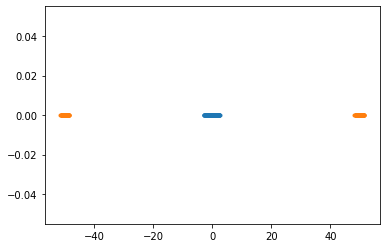

In [5]:
n = 500
n_2 = int(n * 0.5)

X1 = npr.randn(n).reshape(-1,1) - 0
X21 = 0.6 * npr.randn(n_2).reshape(-1,1) + 50
X22 =  0.6 * npr.randn(n_2).reshape(-1,1) -50
X2 = np.concatenate((X21, X22), axis=0)
X1, X2 = X2, X1

plt.plot(X2.flatten(), [0] * n, '.')
plt.plot(X1.flatten(), [0] * n, '.')

In [6]:
c = cIPFP(X1, X2,  number_time_steps=100, batch_size=500 , step_size = 0.001, weights=[20,20,20], rng = jax.random.PRNGKey(100))

In [7]:
# _, init_params_f = c.b_forward_init(c.rng, (-1, c.dim))                                             
# opt_state_f = c.opt_init_f(init_params_f)


# c.theta_f = c.get_params_f(opt_state_f)
# c.theta_b = c.get_params_f(opt_state_f) 


# c.inner_loss(c.theta_f, next(c.data_stream()), forwards=True);

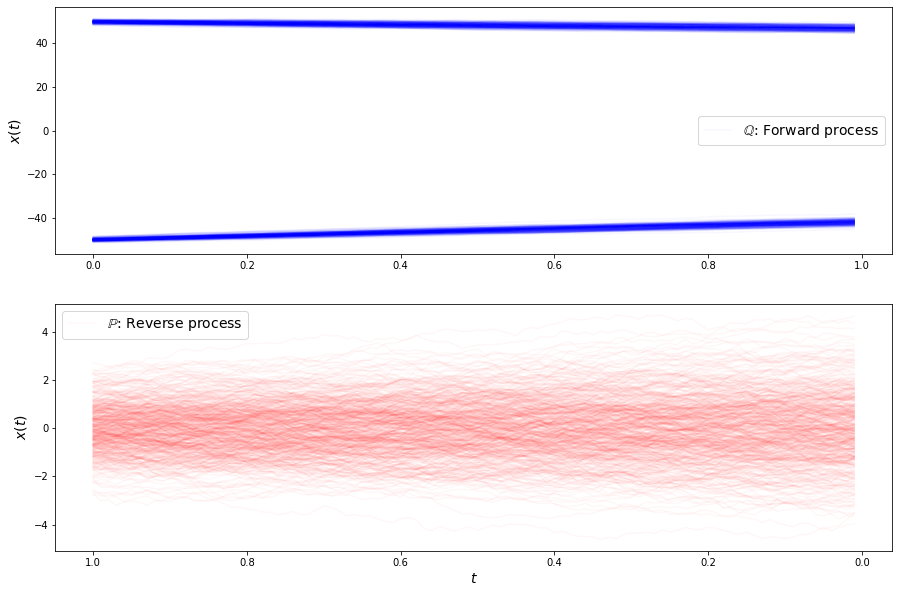

loss b 12.668253898620605
loss b 12.661691665649414
loss b 12.663155555725098
loss b 12.667176246643066
loss b 12.64999008178711
loss b 12.676380157470703
loss b 12.661572456359863
loss b 12.668042182922363
loss b 12.669733047485352
loss b 12.66053581237793
loss b 12.655134201049805
loss b 12.670029640197754
loss b 12.661742210388184
loss b 12.674654006958008
loss b 12.66057300567627
loss b 12.657242774963379
loss b 12.642521858215332
loss b 12.671828269958496
loss b 12.680853843688965
loss b 12.671327590942383
loss b 12.658035278320312
loss b 12.660273551940918
loss f 18447.40234375
loss f 18080.595703125
loss f 17668.306640625
loss f 17304.126953125
loss f 17039.23828125
loss f 16781.66796875
loss f 16468.7109375
loss f 16229.5419921875
loss f 16045.845703125
loss f 15651.505859375
loss f 15383.607421875
loss f 15120.2197265625
loss f 14836.5859375
loss f 14548.5986328125
loss f 14261.3916015625
loss f 13923.724609375
loss f 13681.869140625
loss f 13320.1513671875
loss f 13072.125976

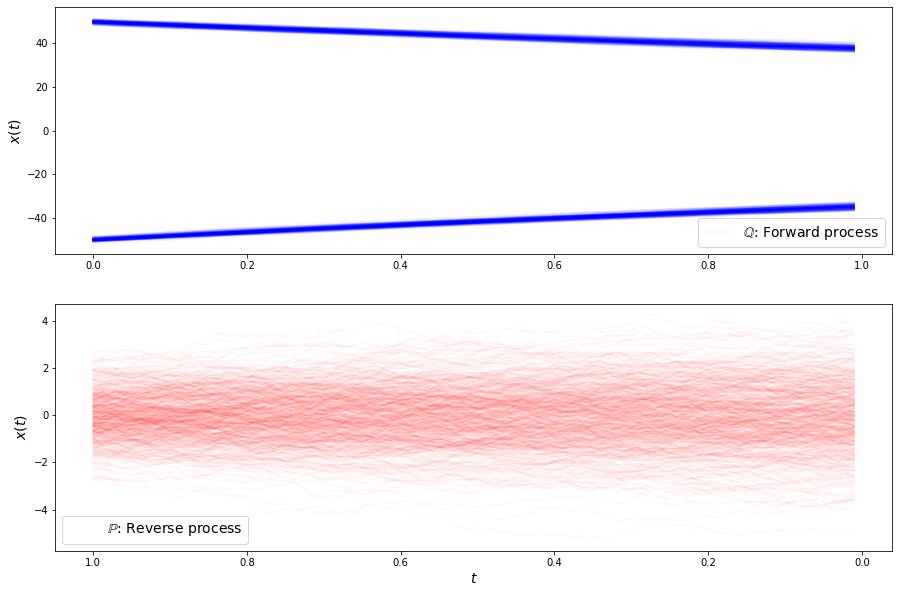

loss b 12.332364082336426
loss b 12.33315372467041
loss b 12.316567420959473
loss b 12.322321891784668
loss b 12.318708419799805
loss b 12.300873756408691
loss b 12.309418678283691
loss b 12.310151100158691
loss b 12.292576789855957
loss b 12.26605224609375
loss b 12.289990425109863
loss b 12.281126022338867
loss b 12.293224334716797
loss b 12.271145820617676
loss b 12.286191940307617
loss b 12.261713027954102
loss b 12.27334976196289
loss b 12.27517032623291
loss b 12.259978294372559
loss b 12.251287460327148
loss b 12.237419128417969
loss b 12.253860473632812
loss f 11624.6806640625
loss f 11305.880859375
loss f 10948.1435546875
loss f 10658.40625
loss f 10397.7490234375
loss f 10158.345703125
loss f 9909.2685546875
loss f 9707.9150390625
loss f 9508.26171875
loss f 9258.7744140625
loss f 9052.3369140625
loss f 8883.134765625
loss f 8670.3759765625
loss f 8511.14453125
loss f 8302.2548828125
loss f 8153.31982421875
loss f 7936.3583984375
loss f 7816.9794921875
loss f 7617.54345703125

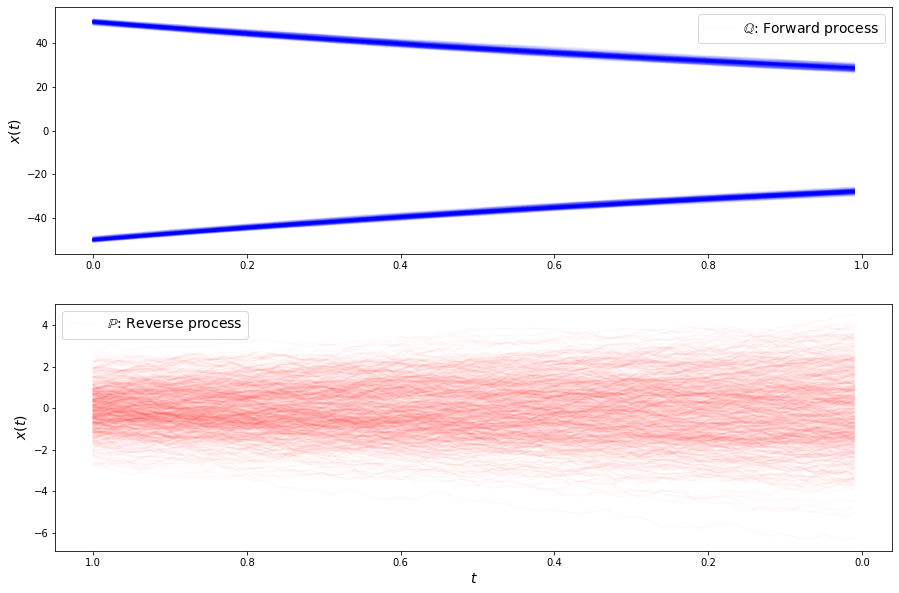

loss b 12.054360389709473
loss b 12.050703048706055
loss b 12.027693748474121
loss b 12.023167610168457
loss b 12.001651763916016
loss b 12.00523567199707
loss b 11.98708438873291
loss b 11.977776527404785
loss b 11.9752197265625
loss b 11.969958305358887
loss b 11.968584060668945
loss b 11.964887619018555
loss b 11.96516227722168
loss b 11.95734977722168
loss b 11.930603981018066
loss b 11.92662239074707
loss b 11.923622131347656
loss b 11.90287971496582
loss b 11.911088943481445
loss b 11.868380546569824
loss b 11.878273963928223
loss b 11.865961074829102
loss f 6776.07470703125
loss f 6527.02294921875
loss f 6370.35009765625
loss f 6193.4462890625
loss f 6074.12353515625
loss f 5932.0341796875
loss f 5843.38623046875
loss f 5679.87939453125
loss f 5554.7373046875
loss f 5479.50927734375
loss f 5336.0283203125
loss f 5272.01025390625
loss f 5140.72802734375
loss f 5043.65576171875
loss f 4924.41748046875
loss f 4836.38525390625
loss f 4751.70947265625
loss f 4640.00634765625
loss f 4

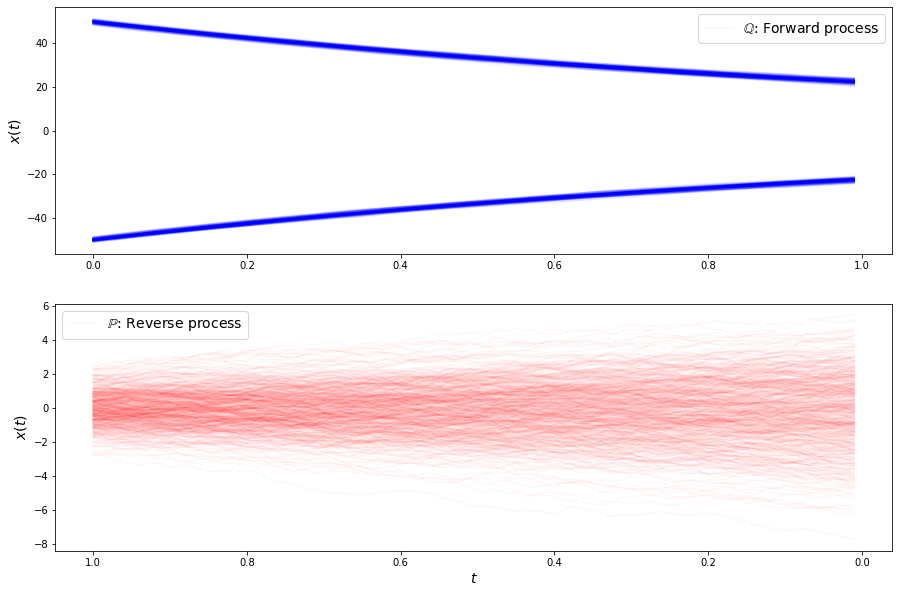

loss b 11.741352081298828
loss b 11.733905792236328
loss b 11.69910717010498
loss b 11.691800117492676
loss b 11.673996925354004
loss b 11.65861988067627
loss b 11.657939910888672
loss b 11.626923561096191
loss b 11.604333877563477
loss b 11.59404182434082
loss b 11.574636459350586
loss b 11.550085067749023
loss b 11.544185638427734
loss b 11.552266120910645
loss b 11.516034126281738
loss b 11.525270462036133
loss b 11.524410247802734
loss b 11.511992454528809
loss b 11.4959716796875
loss b 11.495939254760742
loss b 11.483962059020996
loss b 11.460393905639648
loss f 4099.9169921875
loss f 3966.288818359375
loss f 3859.93017578125
loss f 3783.56982421875
loss f 3732.476806640625
loss f 3638.235107421875
loss f 3565.499755859375
loss f 3499.745849609375
loss f 3433.743408203125
loss f 3380.600341796875
loss f 3305.942626953125
loss f 3259.340087890625
loss f 3186.157958984375
loss f 3153.30859375
loss f 3108.009033203125
loss f 3026.952880859375
loss f 2970.626953125
loss f 2938.5090332

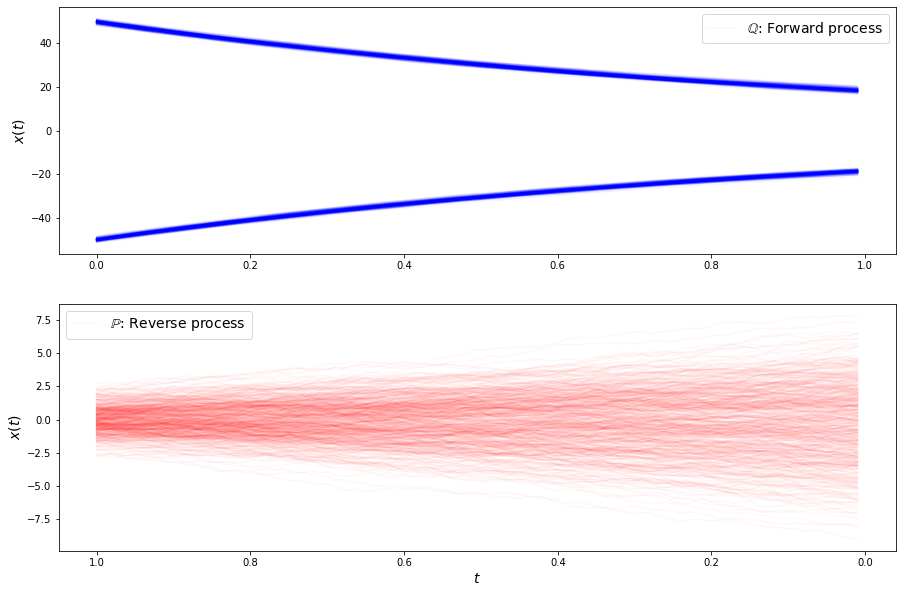

loss b 11.309965133666992
loss b 11.260515213012695
loss b 11.221264839172363
loss b 11.222955703735352
loss b 11.207446098327637
loss b 11.170577049255371
loss b 11.180603981018066
loss b 11.151286125183105
loss b 11.153162002563477
loss b 11.120424270629883
loss b 11.09579086303711
loss b 11.108731269836426
loss b 11.082683563232422
loss b 11.054342269897461
loss b 11.07260799407959
loss b 11.074361801147461
loss b 11.07750415802002
loss b 11.006134986877441
loss b 11.056220054626465
loss b 11.043856620788574
loss b 10.981096267700195
loss b 11.030308723449707
loss f 2616.577392578125
loss f 2540.92529296875
loss f 2490.2138671875
loss f 2435.64501953125
loss f 2394.850830078125
loss f 2349.009521484375
loss f 2327.166259765625
loss f 2255.010009765625
loss f 2230.410400390625
loss f 2205.64990234375
loss f 2160.99365234375
loss f 2132.949462890625
loss f 2093.707763671875
loss f 2069.33544921875
loss f 2026.8807373046875
loss f 1993.033935546875
loss f 1967.6177978515625
loss f 1932

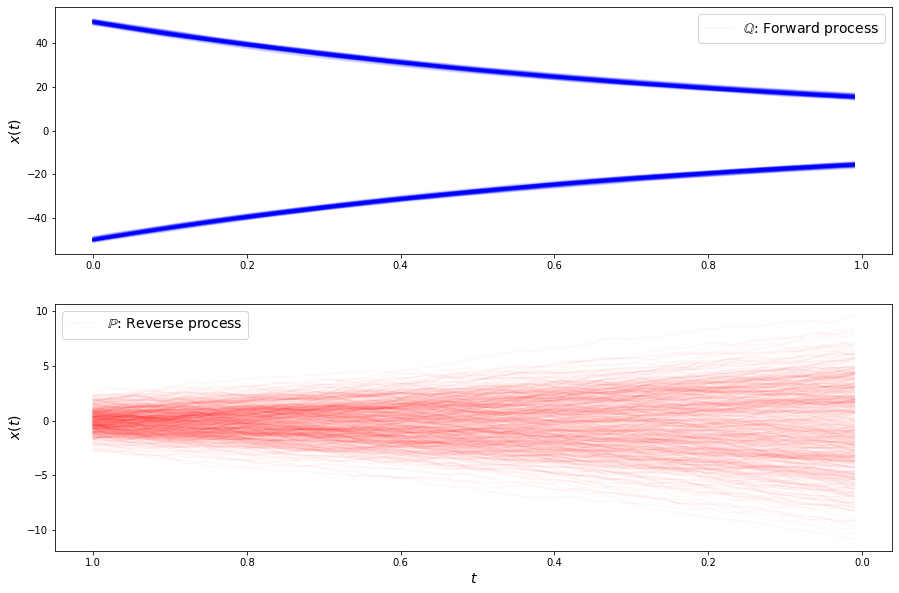

loss b 10.765000343322754
loss b 10.78298568725586
loss b 10.75261402130127
loss b 10.723489761352539
loss b 10.672192573547363
loss b 10.687588691711426
loss b 10.656824111938477
loss b 10.647936820983887
loss b 10.636696815490723
loss b 10.644222259521484
loss b 10.620655059814453
loss b 10.594743728637695
loss b 10.61510181427002
loss b 10.62282657623291
loss b 10.583244323730469
loss b 10.573311805725098
loss b 10.554189682006836
loss b 10.56438159942627
loss b 10.520649909973145
loss b 10.55482292175293
loss b 10.557868003845215
loss b 10.521697998046875
loss f 1762.2396240234375
loss f 1716.479248046875
loss f 1672.7801513671875
loss f 1648.227783203125
loss f 1616.141357421875
loss f 1601.7003173828125
loss f 1557.2022705078125
loss f 1540.7822265625
loss f 1526.5484619140625
loss f 1495.08740234375
loss f 1471.9654541015625
loss f 1457.425537109375
loss f 1431.674072265625
loss f 1405.5966796875
loss f 1395.4554443359375
loss f 1366.72509765625
loss f 1346.1611328125
loss f 133

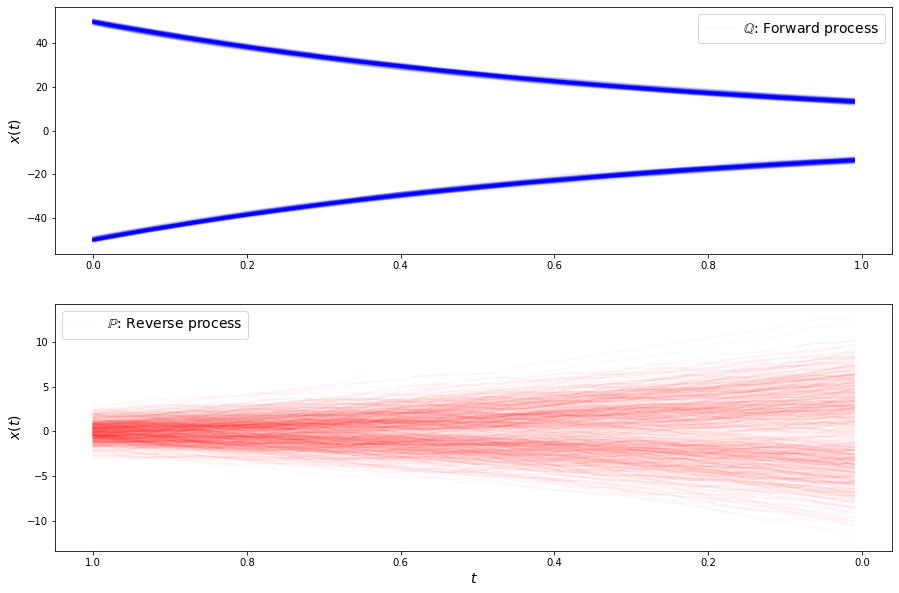

loss b 10.294879913330078
loss b 10.31795597076416
loss b 10.241731643676758
loss b 10.173978805541992
loss b 10.207568168640137
loss b 10.162293434143066
loss b 10.150824546813965
loss b 10.184661865234375
loss b 10.160659790039062
loss b 10.157870292663574
loss b 10.1361722946167
loss b 10.12904167175293
loss b 10.182570457458496
loss b 10.204500198364258
loss b 10.172018051147461
loss b 10.153236389160156
loss b 10.17287826538086
loss b 10.187545776367188
loss b 10.132002830505371
loss b 10.20623779296875
loss b 10.134531021118164
loss b 10.181652069091797
loss f 1235.981201171875
loss f 1198.739501953125
loss f 1182.4154052734375
loss f 1161.0035400390625
loss f 1136.8153076171875
loss f 1124.1390380859375
loss f 1096.901611328125
loss f 1091.4698486328125
loss f 1072.6094970703125
loss f 1071.1385498046875
loss f 1043.33154296875
loss f 1030.314453125
loss f 1017.9767456054688
loss f 1009.1032104492188
loss f 983.4412841796875
loss f 985.8665161132812
loss f 979.3324584960938
loss

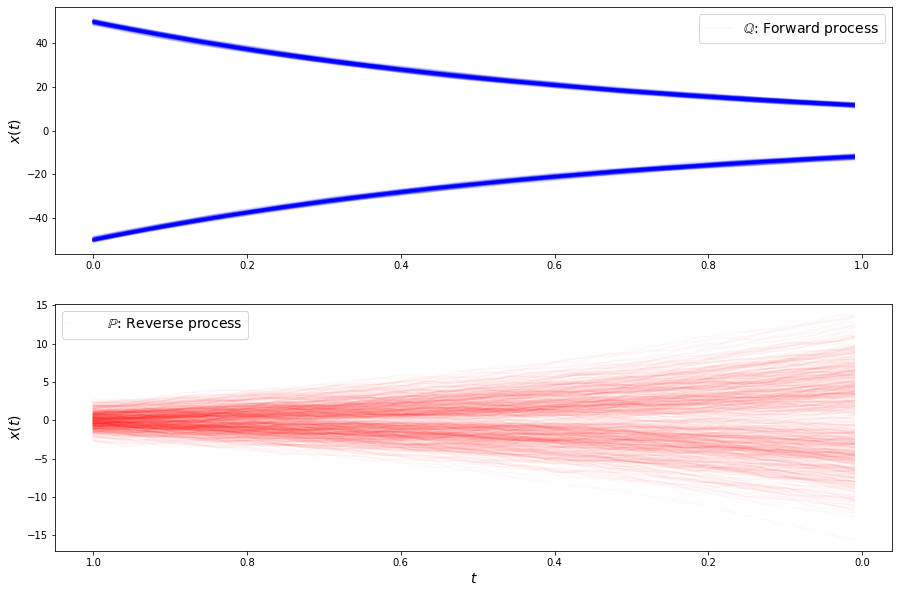

loss b 9.849834442138672
loss b 9.863898277282715
loss b 9.837085723876953
loss b 9.830690383911133
loss b 9.826971054077148
loss b 9.821348190307617
loss b 9.783663749694824
loss b 9.75927734375
loss b 9.77553653717041
loss b 9.702861785888672
loss b 9.788350105285645
loss b 9.768068313598633
loss b 9.78016185760498
loss b 9.78298568725586
loss b 9.83298397064209
loss b 9.802067756652832
loss b 9.767308235168457
loss b 9.802851676940918
loss b 9.804903984069824
loss b 9.821535110473633
loss b 9.781721115112305
loss b 9.778461456298828
loss f 886.5139770507812
loss f 863.3345336914062
loss f 844.1432495117188
loss f 828.7341918945312
loss f 821.2041015625
loss f 815.9190673828125
loss f 798.419189453125
loss f 787.8682250976562
loss f 777.6473388671875
loss f 769.9088745117188
loss f 767.2713012695312
loss f 749.1975708007812
loss f 743.811279296875
loss f 727.4921264648438
loss f 723.0978393554688
loss f 715.0789184570312
loss f 708.98828125
loss f 701.3756713867188
loss f 682.5868530

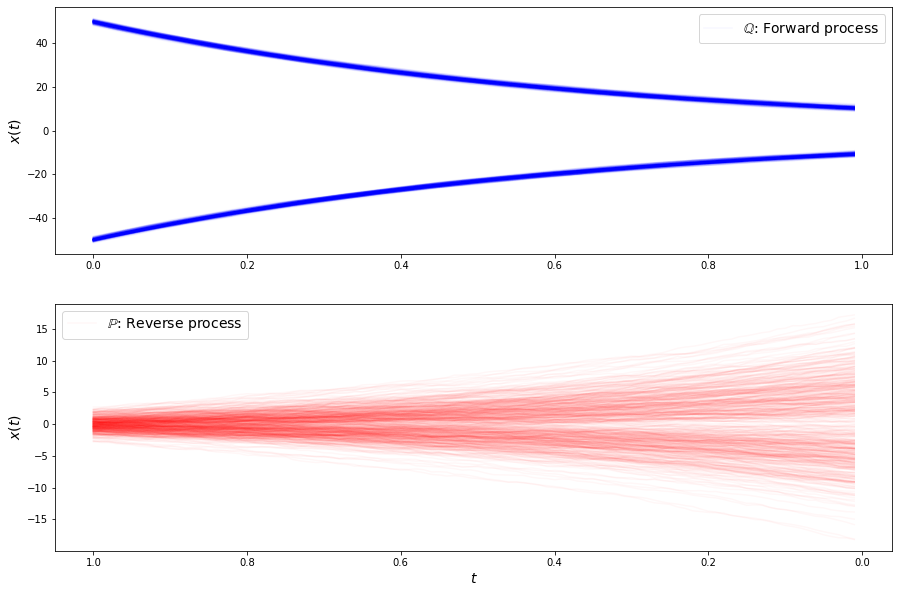

loss b 9.456328392028809
loss b 9.487525939941406
loss b 9.467243194580078
loss b 9.455089569091797
loss b 9.436107635498047
loss b 9.434574127197266
loss b 9.39680004119873
loss b 9.428044319152832
loss b 9.457812309265137
loss b 9.38971996307373
loss b 9.394351959228516
loss b 9.395532608032227
loss b 9.332818984985352
loss b 9.417423248291016
loss b 9.398700714111328
loss b 9.427413940429688
loss b 9.362204551696777
loss b 9.437771797180176
loss b 9.458142280578613
loss b 9.45695686340332
loss b 9.454093933105469
loss b 9.460107803344727
loss f 639.4346923828125
loss f 641.9198608398438
loss f 630.81201171875
loss f 618.3711547851562
loss f 605.1046142578125
loss f 597.6240844726562
loss f 600.0839233398438
loss f 587.6416015625
loss f 586.4708862304688
loss f 574.3515625
loss f 561.778564453125
loss f 562.5596313476562
loss f 557.4774780273438
loss f 548.068603515625
loss f 538.3751831054688
loss f 534.825439453125
loss f 530.9478759765625
loss f 515.2971801757812
loss f 516.612182

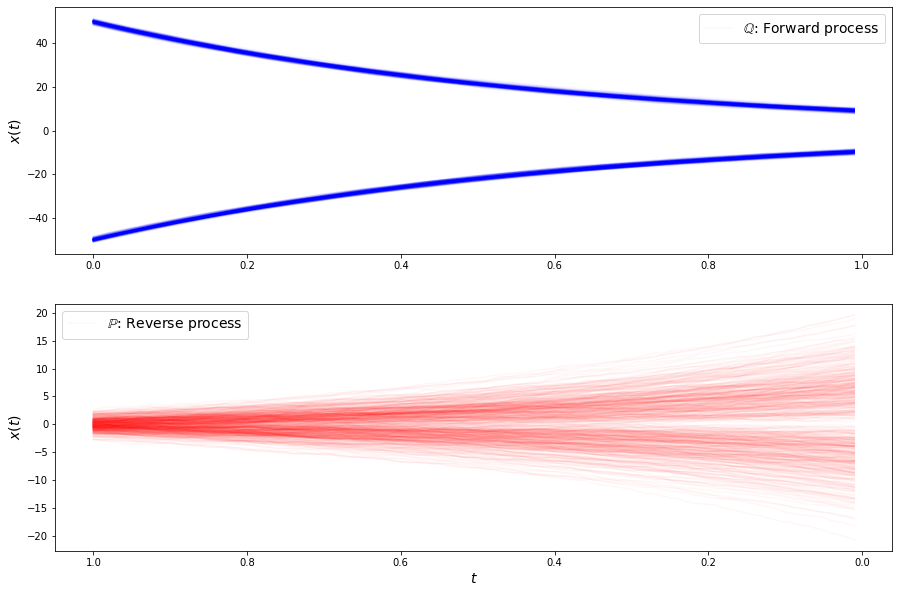

loss b 9.171051979064941
loss b 9.109572410583496
loss b 9.121831893920898
loss b 9.092226028442383
loss b 9.125712394714355
loss b 9.113953590393066
loss b 9.126131057739258
loss b 9.11974811553955
loss b 9.014644622802734
loss b 9.0734224319458
loss b 9.112678527832031
loss b 9.081823348999023
loss b 9.119017601013184
loss b 9.089906692504883
loss b 9.033153533935547
loss b 9.069225311279297
loss b 9.047521591186523
loss b 8.969533920288086
loss b 9.108135223388672
loss b 9.054567337036133
loss b 9.174568176269531
loss b 9.045787811279297
loss f 491.2854919433594
loss f 479.4276428222656
loss f 469.0782165527344
loss f 470.22998046875
loss f 455.4379577636719
loss f 458.6375732421875
loss f 452.1517333984375
loss f 442.1788024902344
loss f 436.72747802734375
loss f 437.7409362792969
loss f 436.11090087890625
loss f 422.4767150878906
loss f 420.2444763183594
loss f 414.9307556152344
loss f 412.7983093261719
loss f 413.64910888671875
loss f 402.16314697265625
loss f 399.97735595703125


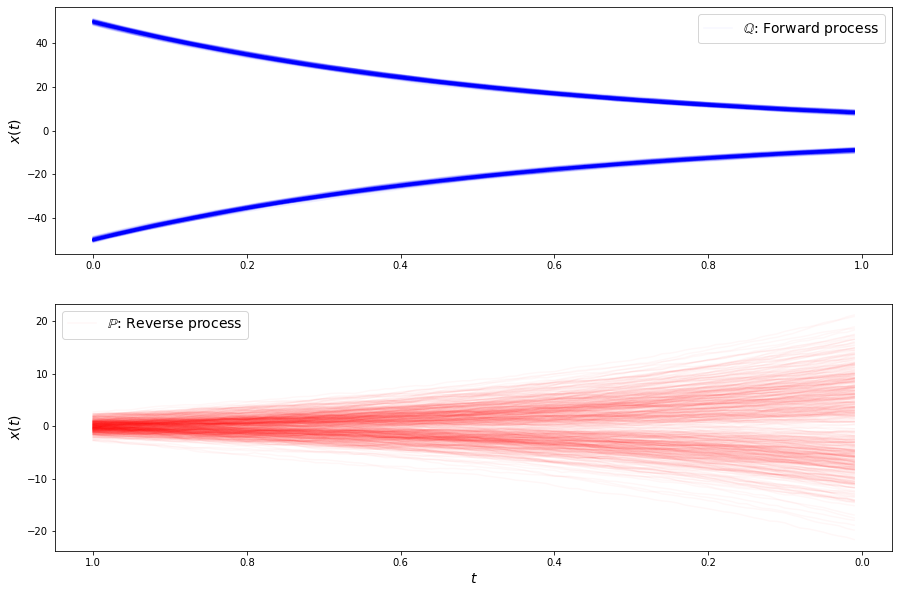

loss b 8.861783027648926
loss b 8.787604331970215
loss b 8.81065559387207
loss b 8.778976440429688
loss b 8.78325366973877
loss b 8.703594207763672
loss b 8.741975784301758
loss b 8.719822883605957
loss b 8.764067649841309
loss b 8.701810836791992
loss b 8.691091537475586
loss b 8.697216987609863
loss b 8.712318420410156
loss b 8.678609848022461
loss b 8.769841194152832
loss b 8.783014297485352
loss b 8.788606643676758
loss b 8.70986557006836
loss b 8.777140617370605
loss b 8.703539848327637
loss b 8.739982604980469
loss b 8.775564193725586
loss f 377.65850830078125
loss f 373.4003601074219
loss f 363.87762451171875
loss f 360.6039733886719
loss f 355.77740478515625
loss f 352.2685546875
loss f 353.49456787109375
loss f 348.5735778808594
loss f 339.13714599609375
loss f 338.19256591796875
loss f 331.2113952636719
loss f 328.1249084472656
loss f 325.5107116699219
loss f 327.926513671875
loss f 325.5904541015625
loss f 319.6654968261719
loss f 324.1554870605469
loss f 319.9300537109375
l

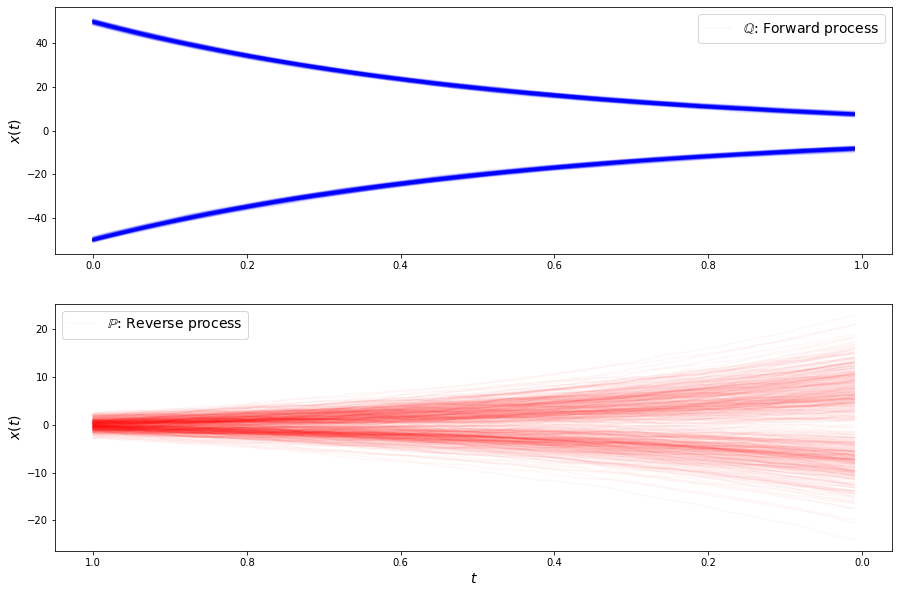

loss b 8.478517532348633
loss b 8.541447639465332
loss b 8.439456939697266
loss b 8.438915252685547
loss b 8.435261726379395
loss b 8.438057899475098
loss b 8.436253547668457
loss b 8.400824546813965
loss b 8.440670013427734
loss b 8.39693832397461
loss b 8.401867866516113
loss b 8.453306198120117
loss b 8.424816131591797
loss b 8.515497207641602
loss b 8.382773399353027
loss b 8.434678077697754
loss b 8.333011627197266
loss b 8.372896194458008
loss b 8.41413402557373
loss b 8.42394733428955
loss b 8.412291526794434
loss b 8.397075653076172
loss f 292.8348083496094
loss f 294.1034240722656
loss f 287.58306884765625
loss f 287.1270446777344
loss f 281.6708068847656
loss f 276.2717590332031
loss f 280.1639099121094
loss f 272.5464782714844
loss f 274.8954772949219
loss f 270.2062072753906
loss f 265.1963195800781
loss f 262.1701354980469
loss f 259.96978759765625
loss f 260.56707763671875
loss f 256.02154541015625
loss f 257.7019958496094
loss f 252.3284149169922
loss f 252.3807678222656

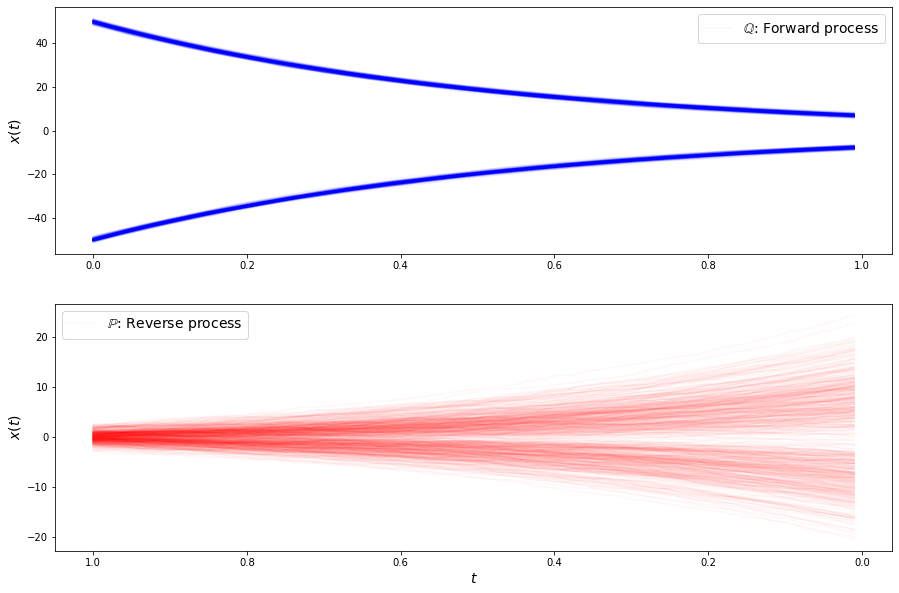

loss b 8.101028442382812
loss b 8.177751541137695
loss b 8.069780349731445
loss b 8.233410835266113
loss b 8.19828987121582
loss b 8.039507865905762
loss b 8.188614845275879
loss b 8.074477195739746
loss b 8.11826229095459
loss b 8.137554168701172
loss b 8.045889854431152
loss b 8.17015552520752
loss b 8.093259811401367
loss b 8.063740730285645
loss b 8.117602348327637
loss b 8.155426979064941
loss b 8.150528907775879
loss b 8.07081413269043
loss b 8.17827033996582
loss b 8.196981430053711
loss b 8.066043853759766
loss b 8.081009864807129
loss f 237.4132843017578
loss f 233.46359252929688
loss f 228.1089324951172
loss f 227.37388610839844
loss f 225.8302459716797
loss f 222.0061492919922
loss f 219.39056396484375
loss f 222.6702423095703
loss f 222.2296142578125
loss f 216.58709716796875
loss f 215.0836181640625
loss f 209.48104858398438
loss f 212.44589233398438
loss f 210.9505615234375
loss f 207.21908569335938
loss f 202.86489868164062
loss f 204.63150024414062
loss f 202.8922271728

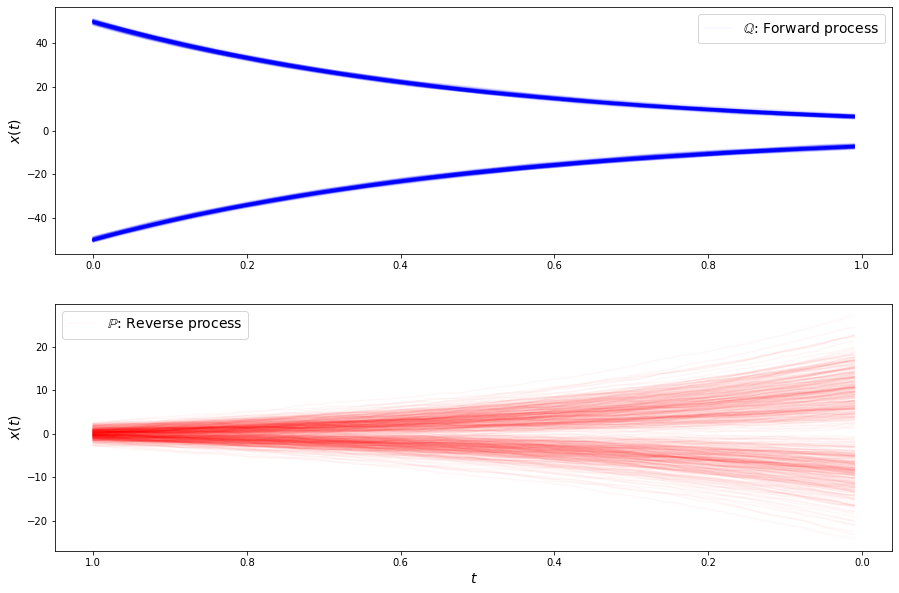

loss b 7.953923225402832
loss b 7.826212406158447
loss b 7.85972785949707
loss b 7.964011192321777
loss b 7.821753978729248
loss b 7.812748432159424
loss b 7.909654140472412
loss b 7.855451583862305
loss b 7.770620346069336
loss b 7.8052802085876465
loss b 7.803718090057373
loss b 7.847242832183838
loss b 7.865992546081543
loss b 7.810451030731201
loss b 7.829136371612549
loss b 7.860774040222168
loss b 7.96106481552124
loss b 7.7793288230896
loss b 7.856895446777344
loss b 7.8035888671875
loss b 7.821473121643066
loss b 7.870243549346924
loss f 196.25311279296875
loss f 191.2508544921875
loss f 191.00804138183594
loss f 187.84547424316406
loss f 187.61843872070312
loss f 184.30685424804688
loss f 184.23670959472656
loss f 179.8697967529297
loss f 179.70230102539062
loss f 180.9908447265625
loss f 175.66696166992188
loss f 173.40223693847656
loss f 174.40713500976562
loss f 173.92430114746094
loss f 168.7059783935547
loss f 168.86927795410156
loss f 173.39434814453125
loss f 166.114547

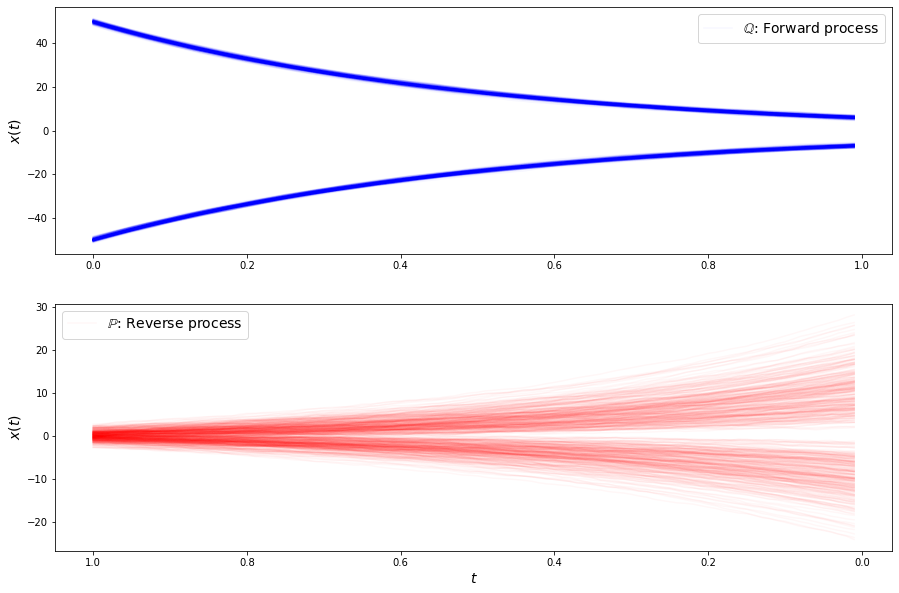

loss b 7.6750569343566895
loss b 7.657283782958984
loss b 7.589641094207764
loss b 7.626588344573975
loss b 7.512979507446289
loss b 7.647068977355957
loss b 7.495059967041016
loss b 7.513934135437012
loss b 7.5761566162109375
loss b 7.546485900878906
loss b 7.638208389282227
loss b 7.604607105255127
loss b 7.528072357177734
loss b 7.63016414642334
loss b 7.535357475280762
loss b 7.531489372253418
loss b 7.600502967834473
loss b 7.577445983886719
loss b 7.621105194091797
loss b 7.548137187957764
loss b 7.585917949676514
loss b 7.509571075439453
loss f 159.05078125
loss f 157.4590606689453
loss f 157.73773193359375
loss f 156.23648071289062
loss f 152.8152313232422
loss f 152.47955322265625
loss f 151.22984313964844
loss f 149.66525268554688
loss f 147.38491821289062
loss f 149.03379821777344
loss f 144.04544067382812
loss f 146.0011444091797
loss f 143.75753784179688
loss f 145.59315490722656
loss f 139.79946899414062
loss f 141.8675079345703
loss f 138.8792266845703
loss f 141.3015899

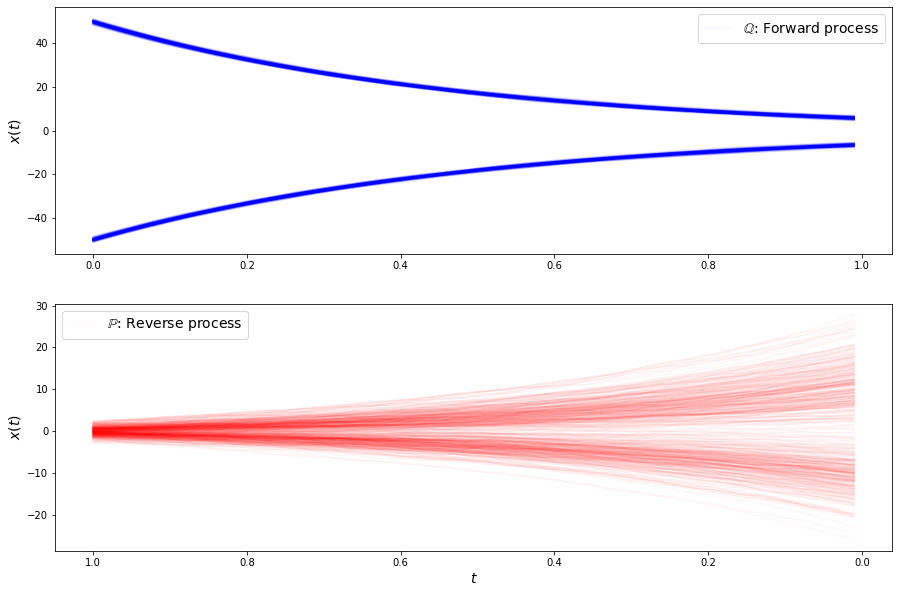

loss b 7.412071704864502
loss b 7.368969440460205
loss b 7.300519943237305
loss b 7.468170642852783
loss b 7.407205104827881
loss b 7.339818477630615
loss b 7.353396892547607
loss b 7.371146202087402
loss b 7.3375349044799805
loss b 7.3380866050720215
loss b 7.238877296447754
loss b 7.3939290046691895
loss b 7.269768714904785
loss b 7.305289268493652
loss b 7.390940189361572
loss b 7.342237949371338
loss b 7.366827964782715
loss b 7.342075824737549
loss b 7.381206035614014
loss b 7.2438530921936035
loss b 7.330286026000977
loss b 7.312856197357178
loss f 135.7476348876953
loss f 130.19760131835938
loss f 130.05873107910156
loss f 130.56138610839844
loss f 130.91014099121094
loss f 128.3726348876953
loss f 126.29867553710938
loss f 126.66345977783203
loss f 125.8883056640625
loss f 120.385986328125
loss f 121.464599609375
loss f 124.38548278808594
loss f 124.17587280273438
loss f 122.09009552001953
loss f 120.44849395751953
loss f 120.5110092163086
loss f 121.30924987792969
loss f 117.6

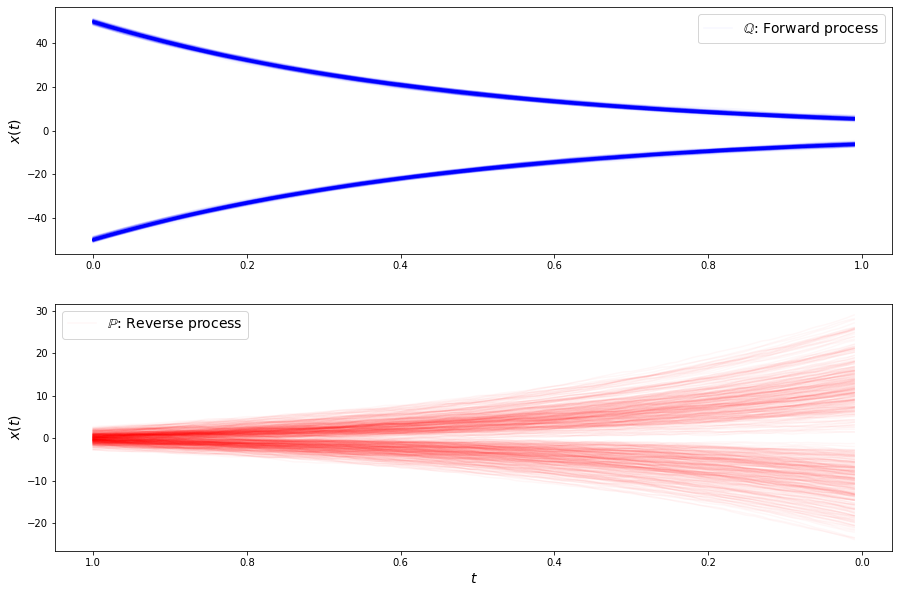

loss b 7.116164207458496
loss b 7.250486850738525
loss b 7.198789119720459
loss b 7.223998069763184
loss b 7.050467491149902
loss b 7.097401142120361
loss b 7.114192962646484
loss b 7.129458904266357
loss b 7.085335731506348
loss b 7.132959842681885
loss b 7.057982921600342
loss b 7.000292778015137
loss b 7.056426525115967
loss b 7.148575305938721
loss b 7.186302185058594
loss b 7.095217227935791
loss b 7.065067768096924
loss b 7.08646821975708
loss b 7.163224220275879
loss b 7.140283107757568
loss b 7.018829822540283
loss b 7.143446922302246
loss f 112.92910766601562
loss f 113.92371368408203
loss f 110.1818618774414
loss f 112.91590118408203
loss f 109.1282730102539
loss f 111.56719970703125
loss f 108.74173736572266
loss f 105.84308624267578
loss f 106.89004516601562
loss f 106.9356460571289
loss f 104.17074584960938
loss f 104.0804443359375
loss f 106.24361419677734
loss f 101.89961242675781
loss f 103.5768051147461
loss f 102.83728790283203
loss f 99.74836730957031
loss f 103.0030

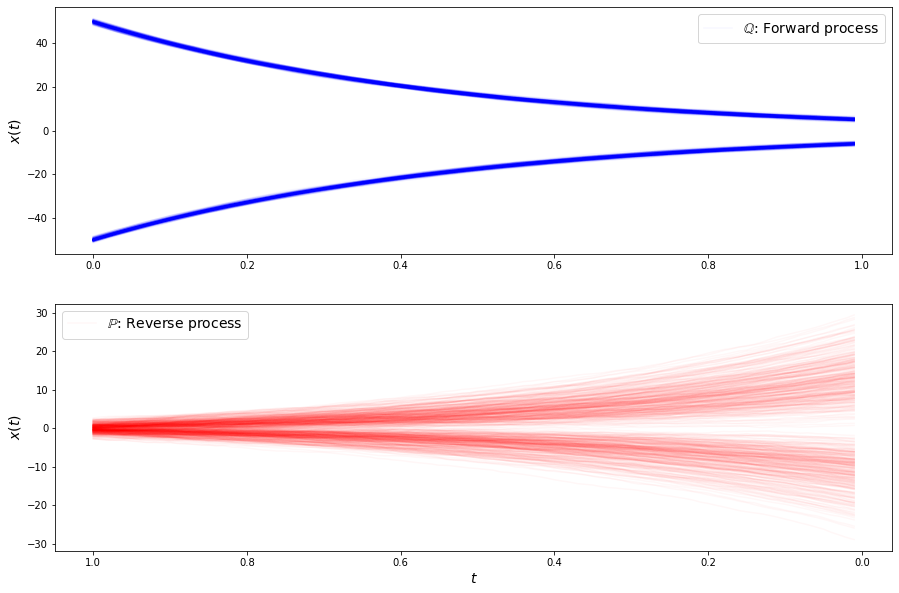

loss b 6.925020694732666
loss b 6.984827995300293
loss b 6.987711429595947
loss b 6.974521636962891
loss b 6.864458084106445
loss b 6.94852876663208
loss b 6.8360443115234375
loss b 6.939709663391113
loss b 6.933396816253662
loss b 6.826724052429199
loss b 6.917446613311768
loss b 6.870152473449707
loss b 6.868812084197998
loss b 6.953918933868408
loss b 6.895835876464844
loss b 6.912814140319824
loss b 6.9425740242004395
loss b 6.915738105773926
loss b 6.851517200469971
loss b 6.816948890686035
loss b 6.910852909088135
loss b 6.801866054534912
loss f 97.31819152832031
loss f 96.34552001953125
loss f 97.49823760986328
loss f 96.44242858886719
loss f 95.37873840332031
loss f 92.82614135742188
loss f 93.81392669677734
loss f 93.74584197998047
loss f 91.24862670898438
loss f 91.03656005859375
loss f 91.45149230957031
loss f 91.38985443115234
loss f 86.01949310302734
loss f 89.22635650634766
loss f 89.08356475830078
loss f 89.69080352783203
loss f 87.84600830078125
loss f 88.36779022216797

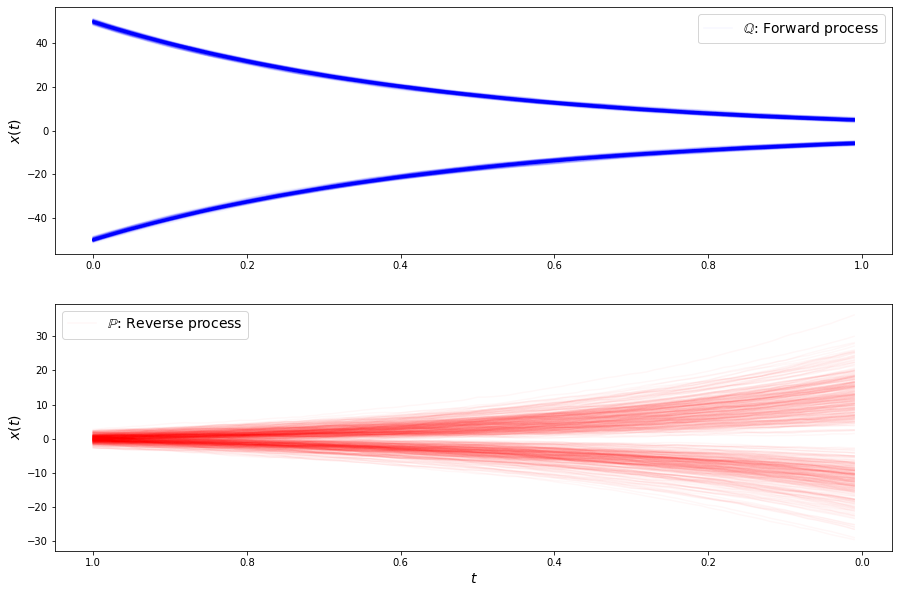

loss b 6.832019805908203
loss b 6.8104329109191895
loss b 6.757710933685303
loss b 6.770449161529541
loss b 6.763679027557373
loss b 6.679913520812988
loss b 6.777377128601074
loss b 6.7325334548950195
loss b 6.701910972595215
loss b 6.667037487030029
loss b 6.68381404876709
loss b 6.684012413024902
loss b 6.729522228240967
loss b 6.797598361968994
loss b 6.767399787902832
loss b 6.694224834442139
loss b 6.696650981903076
loss b 6.725170135498047
loss b 6.6308512687683105
loss b 6.701679229736328
loss b 6.691176891326904
loss b 6.762314796447754
loss f 82.97550201416016
loss f 82.08393096923828
loss f 80.678466796875
loss f 80.64043426513672
loss f 82.49327850341797
loss f 81.47067260742188
loss f 79.88043212890625
loss f 80.45848846435547
loss f 79.86463928222656
loss f 76.23896026611328
loss f 77.89064025878906
loss f 79.04743957519531
loss f 78.10043334960938
loss f 78.69417572021484
loss f 77.2130126953125
loss f 78.4547348022461
loss f 75.4476547241211
loss f 76.38089752197266
los

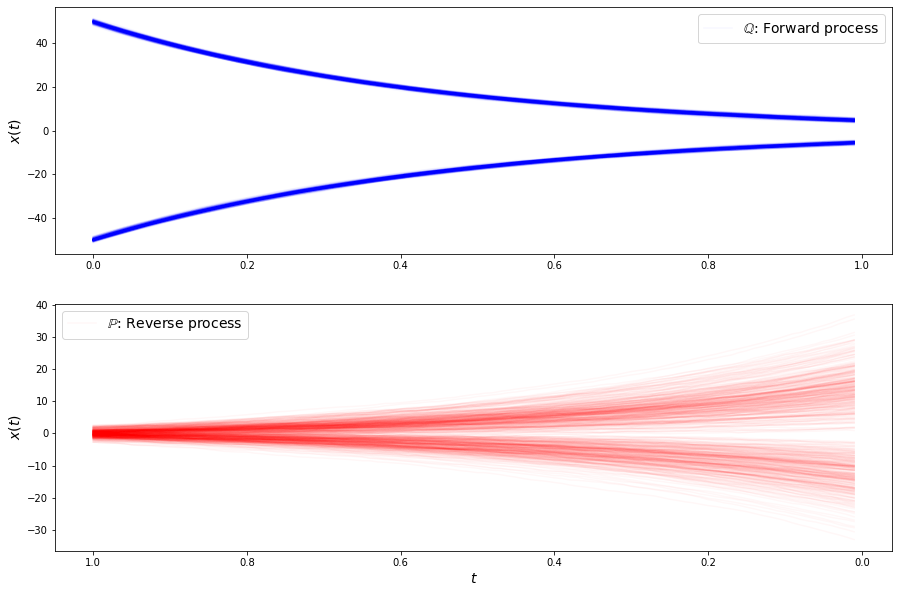

loss b 6.4800567626953125
loss b 6.593286037445068
loss b 6.558227062225342
loss b 6.498811721801758
loss b 6.550264835357666
loss b 6.556899547576904
loss b 6.564774990081787
loss b 6.500699520111084
loss b 6.574507236480713
loss b 6.595179080963135
loss b 6.560577392578125
loss b 6.600460052490234
loss b 6.537363529205322
loss b 6.499354839324951
loss b 6.6219329833984375
loss b 6.4958930015563965
loss b 6.42057991027832
loss b 6.553277492523193
loss b 6.519418716430664
loss b 6.534043788909912
loss b 6.483778953552246
loss b 6.533766269683838
loss f 73.94898986816406
loss f 71.82972717285156
loss f 70.80322265625
loss f 71.14007568359375
loss f 70.78287506103516
loss f 69.9238052368164
loss f 72.02413177490234
loss f 70.17436218261719
loss f 69.62753295898438
loss f 70.1934585571289
loss f 68.21691131591797
loss f 66.38168334960938
loss f 69.18687438964844
loss f 66.13059997558594
loss f 66.01747131347656
loss f 68.34872436523438
loss f 67.08493041992188
loss f 68.4014892578125
loss

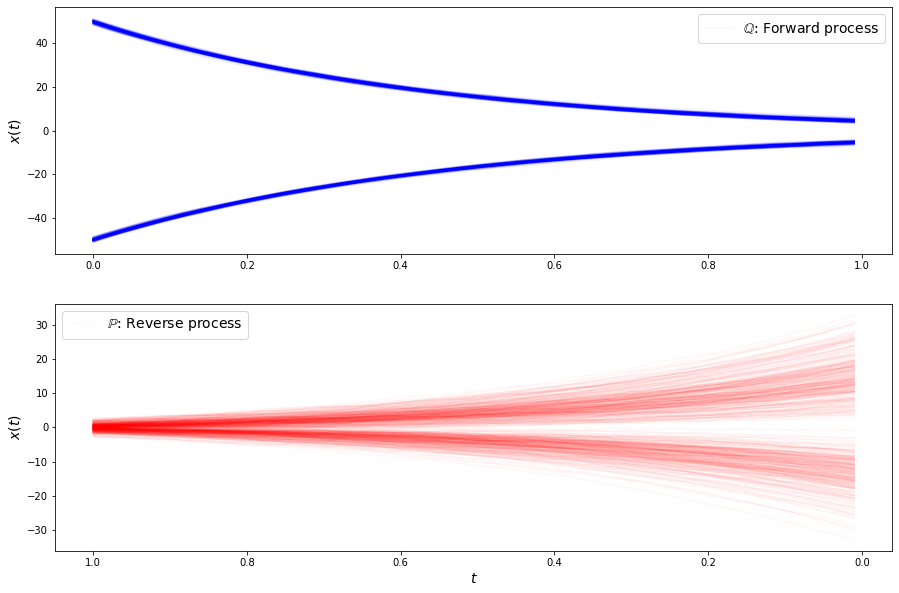

loss b 6.306832790374756
loss b 6.318984031677246
loss b 6.340756893157959
loss b 6.27593994140625
loss b 6.373465061187744
loss b 6.368377208709717
loss b 6.405672073364258
loss b 6.325758934020996
loss b 6.3806281089782715
loss b 6.394039154052734
loss b 6.278900146484375
loss b 6.329686164855957
loss b 6.347170829772949
loss b 6.3547234535217285
loss b 6.456039905548096
loss b 6.357879161834717
loss b 6.346715927124023
loss b 6.357751369476318
loss b 6.375458717346191
loss b 6.445320129394531
loss b 6.238302707672119
loss b 6.358328342437744
loss f 64.70838928222656
loss f 65.21324157714844
loss f 63.93810272216797
loss f 62.794334411621094
loss f 61.440242767333984
loss f 62.422481536865234
loss f 62.74382781982422
loss f 62.07218551635742
loss f 62.506256103515625
loss f 60.44843292236328
loss f 61.19972610473633
loss f 61.214073181152344
loss f 60.49585723876953
loss f 61.168479919433594
loss f 59.28534698486328
loss f 59.217655181884766
loss f 58.214942932128906
loss f 58.493690

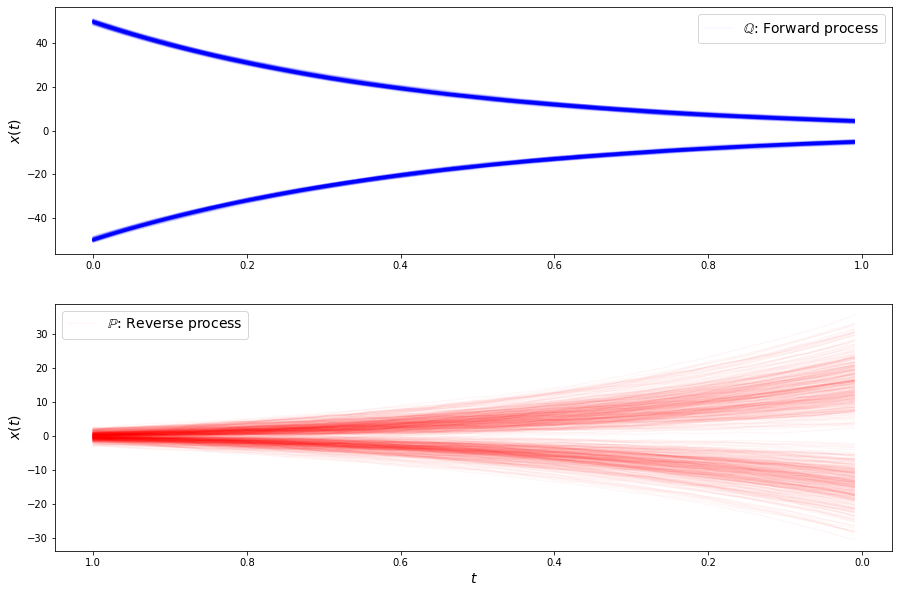

loss b 6.162332534790039
loss b 6.241764068603516
loss b 6.193138122558594
loss b 6.244098663330078
loss b 6.150679111480713
loss b 6.224886417388916
loss b 6.157744884490967
loss b 6.240210056304932
loss b 6.174808025360107
loss b 6.0918660163879395
loss b 6.157787799835205
loss b 6.2223591804504395
loss b 6.19759464263916
loss b 6.304070949554443
loss b 6.228826999664307
loss b 6.270425796508789
loss b 6.152898788452148
loss b 6.222461700439453
loss b 6.181708812713623
loss b 6.159709453582764
loss b 6.154489040374756
loss b 6.275579452514648
loss f 55.325496673583984
loss f 56.09247970581055
loss f 54.36835861206055
loss f 56.00148010253906
loss f 55.68677520751953
loss f 54.398582458496094
loss f 55.17272186279297
loss f 53.94660949707031
loss f 54.298702239990234
loss f 52.687198638916016
loss f 53.674686431884766
loss f 52.716468811035156
loss f 53.20671844482422
loss f 54.484764099121094
loss f 52.75126266479492
loss f 54.410545349121094
loss f 52.711490631103516
loss f 52.63166

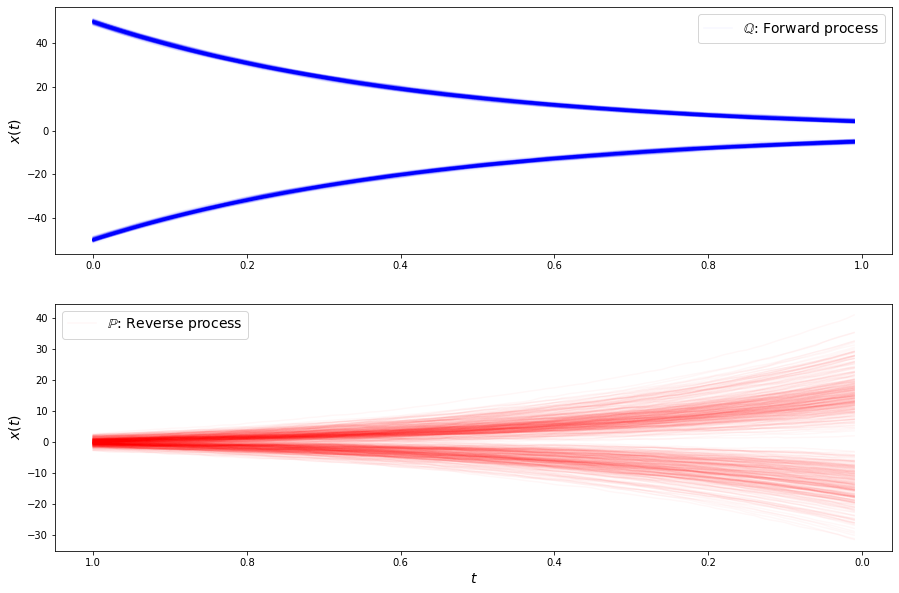

loss b 6.06612491607666
loss b 6.073269367218018
loss b 6.117359161376953
loss b 6.038773059844971
loss b 6.1199049949646
loss b 6.125229835510254
loss b 6.052446365356445
loss b 6.109195709228516
loss b 6.040903091430664
loss b 6.090240001678467
loss b 6.088232040405273
loss b 6.123386859893799
loss b 6.05620813369751
loss b 6.045196056365967
loss b 5.9932661056518555
loss b 5.968779563903809
loss b 6.016643047332764
loss b 6.035425662994385
loss b 6.040060043334961
loss b 6.012763023376465
loss b 6.020310878753662
loss b 6.013357639312744
loss f 52.27543258666992
loss f 49.546382904052734
loss f 48.96805953979492
loss f 50.3436393737793
loss f 49.853328704833984
loss f 50.063270568847656
loss f 49.07418441772461
loss f 48.512081146240234
loss f 48.39839172363281
loss f 48.640777587890625
loss f 47.881649017333984
loss f 46.88896942138672
loss f 47.909976959228516
loss f 49.298370361328125
loss f 47.754032135009766
loss f 46.925392150878906
loss f 46.8393440246582
loss f 45.6318168640

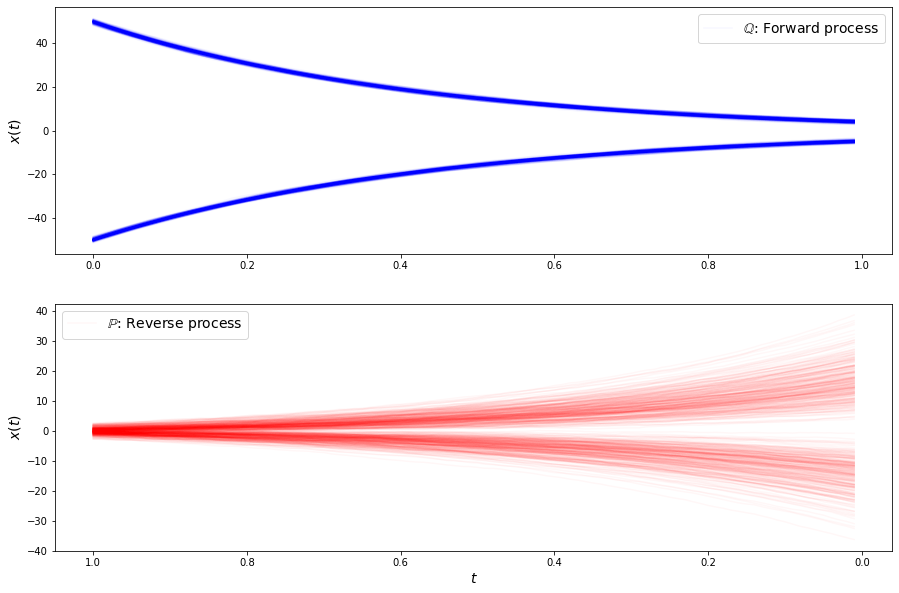

loss b 5.885485649108887
loss b 5.965299129486084
loss b 6.000117301940918
loss b 5.907868385314941
loss b 5.928037166595459
loss b 5.922566890716553
loss b 5.98167085647583
loss b 5.8780717849731445
loss b 5.844776630401611
loss b 5.953217506408691
loss b 5.9353108406066895
loss b 5.975459098815918
loss b 5.869168281555176
loss b 5.96639347076416
loss b 5.8790059089660645
loss b 5.919320583343506
loss b 5.960237503051758
loss b 5.947157859802246
loss b 5.844971179962158
loss b 5.92997932434082
loss b 5.9203290939331055
loss b 5.92682409286499
loss f 46.59114456176758
loss f 45.43514633178711
loss f 46.09746551513672
loss f 45.748313903808594
loss f 46.669952392578125
loss f 43.323360443115234
loss f 42.977622985839844
loss f 42.79013442993164
loss f 43.509700775146484
loss f 42.906551361083984
loss f 44.13845443725586
loss f 43.33377456665039
loss f 43.16365432739258
loss f 42.5799446105957
loss f 43.94847869873047
loss f 42.87209701538086
loss f 42.65418243408203
loss f 42.4051017761

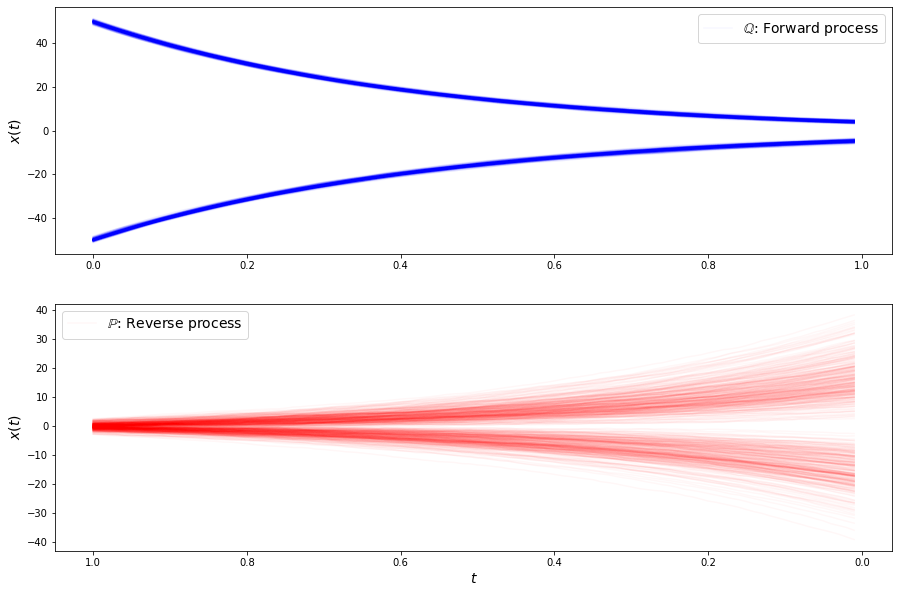

loss b 5.783387184143066
loss b 5.823910713195801
loss b 5.76131010055542
loss b 5.79266881942749
loss b 5.776916980743408
loss b 5.843021869659424
loss b 5.750563144683838
loss b 5.707573890686035
loss b 5.898539066314697
loss b 5.802300930023193
loss b 5.806140899658203
loss b 5.861347675323486
loss b 5.750743865966797
loss b 5.826164722442627
loss b 5.803630352020264
loss b 5.65823221206665
loss b 5.713412761688232
loss b 5.783314228057861
loss b 5.77897310256958
loss b 5.686738014221191
loss b 5.735160827636719
loss b 5.793349266052246
loss f 43.23838424682617
loss f 40.40081787109375
loss f 37.64253616333008
loss f 39.53486251831055
loss f 39.90275955200195
loss f 39.8665657043457
loss f 39.90074920654297
loss f 39.68187713623047
loss f 39.40238571166992
loss f 39.98793411254883
loss f 38.45394515991211
loss f 38.60844802856445
loss f 40.039127349853516
loss f 39.45363998413086
loss f 38.71126174926758
loss f 38.722110748291016
loss f 38.82643127441406
loss f 38.676387786865234
lo

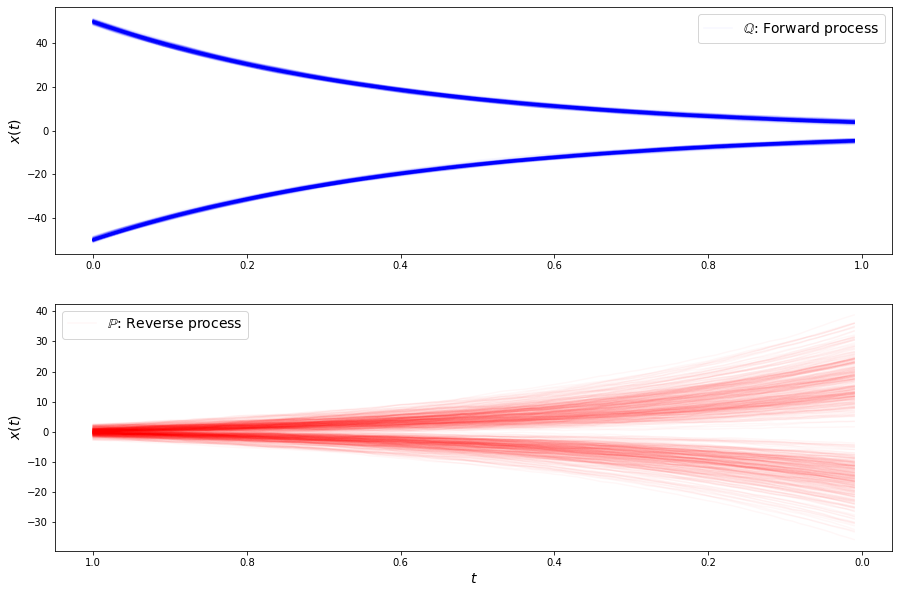

loss b 5.704253196716309
loss b 5.754815101623535
loss b 5.7418437004089355
loss b 5.658409595489502
loss b 5.663362979888916
loss b 5.5922465324401855
loss b 5.675267219543457
loss b 5.6352458000183105
loss b 5.621597766876221
loss b 5.661104679107666
loss b 5.5616912841796875
loss b 5.679754734039307
loss b 5.727686882019043
loss b 5.695267677307129
loss b 5.588187217712402
loss b 5.635919570922852
loss b 5.679783821105957
loss b 5.637592792510986
loss b 5.679288864135742
loss b 5.659352779388428
loss b 5.569131851196289
loss b 5.761221885681152
loss f 36.24603271484375
loss f 36.22550582885742
loss f 37.54446029663086
loss f 37.08304977416992
loss f 37.377174377441406
loss f 35.3256950378418
loss f 35.728111267089844
loss f 34.509910583496094
loss f 35.339927673339844
loss f 35.941349029541016
loss f 36.40511703491211
loss f 35.49263381958008
loss f 35.749446868896484
loss f 34.93053436279297
loss f 35.30166244506836
loss f 34.03519821166992
loss f 35.41584777832031
loss f 34.584785

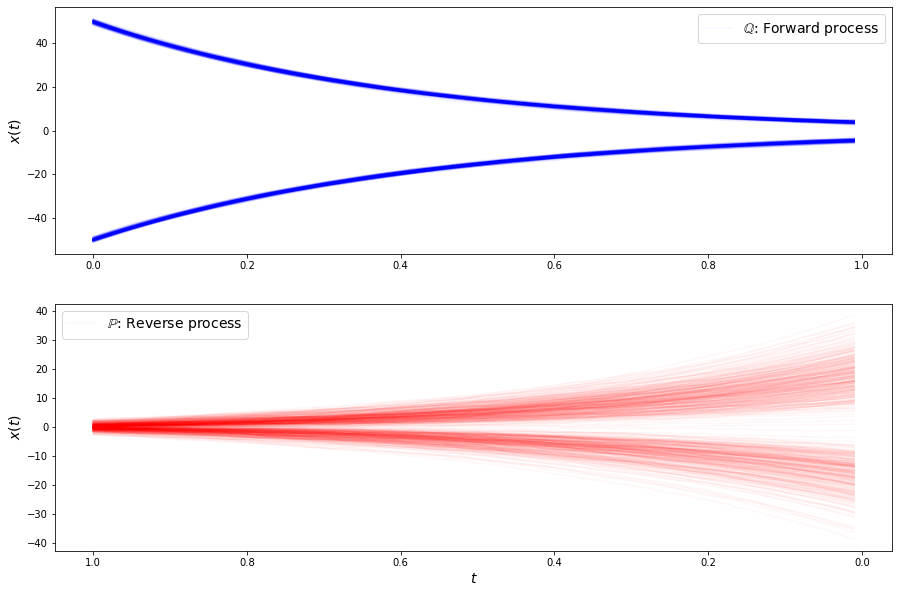

loss b 5.493235111236572
loss b 5.628307342529297
loss b 5.61557149887085
loss b 5.533037185668945
loss b 5.559450626373291
loss b 5.5277018547058105
loss b 5.553417682647705
loss b 5.57358980178833
loss b 5.479626655578613
loss b 5.656527042388916
loss b 5.564359188079834
loss b 5.601494789123535
loss b 5.445253849029541
loss b 5.452882289886475
loss b 5.503860950469971
loss b 5.477790355682373
loss b 5.505395889282227
loss b 5.499906063079834
loss b 5.5375213623046875
loss b 5.46457576751709
loss b 5.524335861206055
loss b 5.528022289276123
loss f 32.3265495300293
loss f 34.57725524902344
loss f 33.14407730102539
loss f 32.322303771972656
loss f 33.46630096435547
loss f 33.78889465332031
loss f 33.56293869018555
loss f 32.76930236816406
loss f 33.801048278808594
loss f 33.58803939819336
loss f 32.97035217285156
loss f 32.37846374511719
loss f 32.07512283325195
loss f 33.05668640136719
loss f 30.605974197387695
loss f 32.51765060424805
loss f 31.568946838378906
loss f 32.4734764099121

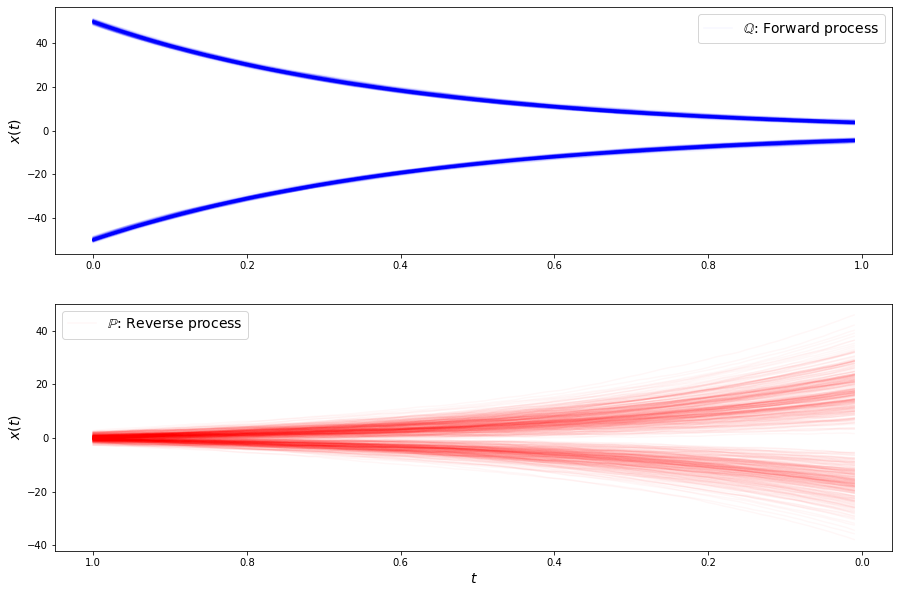

loss b 5.4589152336120605
loss b 5.479013919830322
loss b 5.41171932220459
loss b 5.449956893920898
loss b 5.452925205230713
loss b 5.458515644073486
loss b 5.425148963928223
loss b 5.420723915100098
loss b 5.402696132659912
loss b 5.456600189208984
loss b 5.3406901359558105
loss b 5.409018039703369
loss b 5.387643337249756
loss b 5.4132080078125
loss b 5.386475086212158
loss b 5.4468841552734375
loss b 5.502371788024902
loss b 5.416534423828125
loss b 5.482440948486328
loss b 5.396858215332031
loss b 5.32159423828125
loss b 5.472549915313721
loss f 31.540834426879883
loss f 30.316587448120117
loss f 30.314584732055664
loss f 30.5251407623291
loss f 30.30318260192871
loss f 30.101011276245117
loss f 29.863895416259766
loss f 30.444541931152344
loss f 30.135055541992188
loss f 30.43536376953125
loss f 28.08281135559082
loss f 29.764984130859375
loss f 30.126787185668945
loss f 28.891889572143555
loss f 29.79964256286621
loss f 28.963720321655273
loss f 29.08870506286621
loss f 29.374416

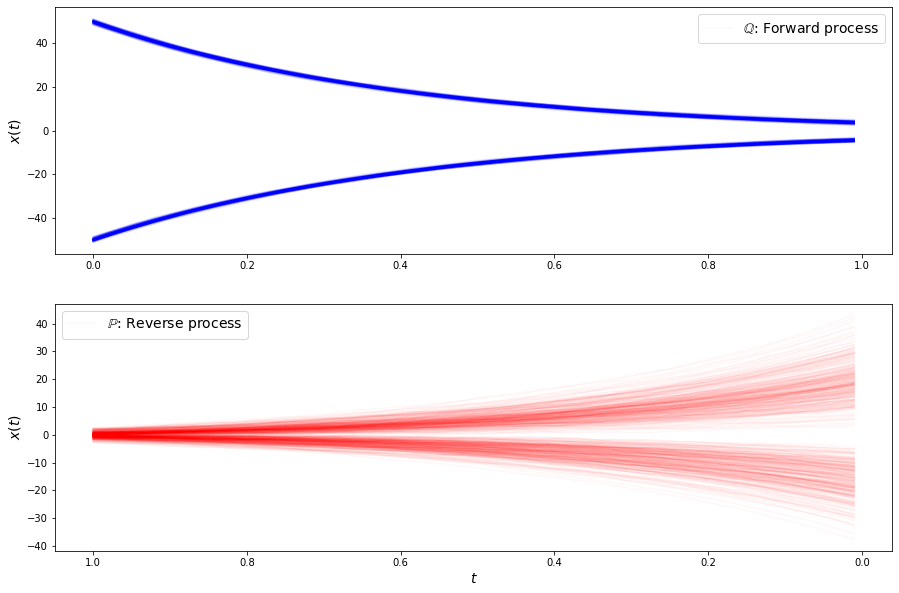

loss b 5.335628986358643
loss b 5.261113166809082
loss b 5.308396339416504
loss b 5.377431869506836
loss b 5.331556797027588
loss b 5.362462043762207
loss b 5.3479437828063965
loss b 5.277337074279785
loss b 5.466343879699707
loss b 5.415146350860596
loss b 5.385824203491211
loss b 5.3733673095703125
loss b 5.264716625213623
loss b 5.315577030181885
loss b 5.386682987213135
loss b 5.3205766677856445
loss b 5.372081279754639
loss b 5.368081092834473
loss b 5.497941017150879
loss b 5.274507999420166
loss b 5.403425693511963
loss b 5.365034580230713
loss f 28.17546272277832
loss f 27.583412170410156
loss f 28.116512298583984
loss f 28.83443832397461
loss f 29.079463958740234
loss f 27.032360076904297
loss f 28.60313606262207
loss f 27.31632423400879
loss f 27.096147537231445
loss f 28.335018157958984
loss f 28.14322853088379
loss f 27.438751220703125
loss f 27.133363723754883
loss f 26.94023895263672
loss f 27.589866638183594
loss f 27.491792678833008
loss f 27.271560668945312
loss f 26.4

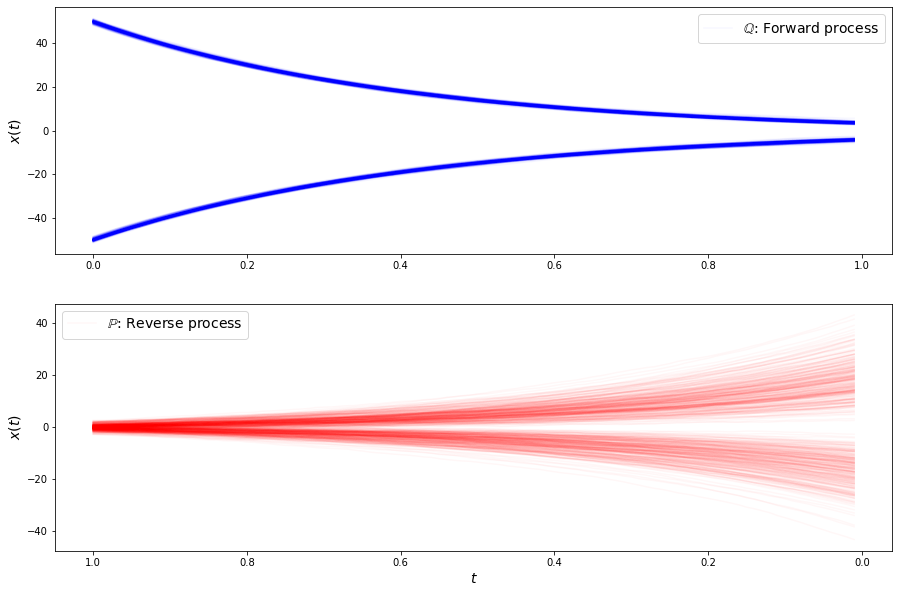

loss b 5.173117637634277
loss b 5.365081787109375
loss b 5.241390228271484
loss b 5.2364325523376465
loss b 5.279973983764648
loss b 5.220621585845947
loss b 5.255649089813232
loss b 5.179612159729004
loss b 5.2038350105285645
loss b 5.306211471557617
loss b 5.230154991149902
loss b 5.184368133544922
loss b 5.2840375900268555
loss b 5.256140232086182
loss b 5.324187278747559
loss b 5.367642402648926
loss b 5.2832489013671875
loss b 5.233279228210449
loss b 5.311161041259766
loss b 5.310087203979492
loss b 5.315586090087891
loss b 5.2817912101745605
loss f 26.662607192993164
loss f 27.10972023010254
loss f 26.519901275634766
loss f 25.8787841796875
loss f 26.370595932006836
loss f 25.38364028930664
loss f 26.642005920410156
loss f 25.83681869506836
loss f 26.845592498779297
loss f 24.97002410888672
loss f 26.09482765197754
loss f 25.66299819946289
loss f 25.02810287475586
loss f 25.819787979125977
loss f 25.2992000579834
loss f 25.139184951782227
loss f 24.67693519592285
loss f 24.80635

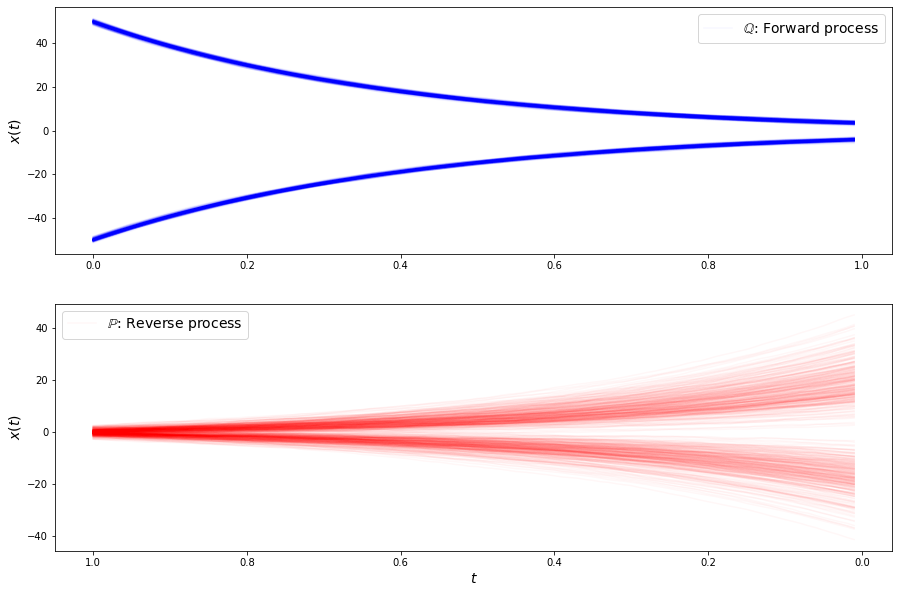

loss b 5.1451096534729
loss b 5.152283668518066
loss b 5.230956077575684
loss b 5.189980506896973
loss b 5.1670379638671875
loss b 5.0999860763549805
loss b 5.174604892730713
loss b 5.204861640930176
loss b 5.169774055480957
loss b 5.152010440826416
loss b 5.157862663269043
loss b 5.145482063293457
loss b 5.183990955352783
loss b 5.14768123626709
loss b 5.095269680023193
loss b 5.093571186065674
loss b 5.131270408630371
loss b 5.126796722412109
loss b 5.265700340270996
loss b 5.227083206176758
loss b 5.161671161651611
loss b 5.181361675262451
loss f 23.285022735595703
loss f 24.65784454345703
loss f 23.834375381469727
loss f 23.998083114624023
loss f 23.331228256225586
loss f 23.77206039428711
loss f 25.248170852661133
loss f 23.894100189208984
loss f 22.902908325195312
loss f 23.812868118286133
loss f 22.88665199279785
loss f 22.76827621459961
loss f 22.52022361755371
loss f 23.84293556213379
loss f 22.480680465698242
loss f 22.947832107543945
loss f 22.817285537719727
loss f 23.30342

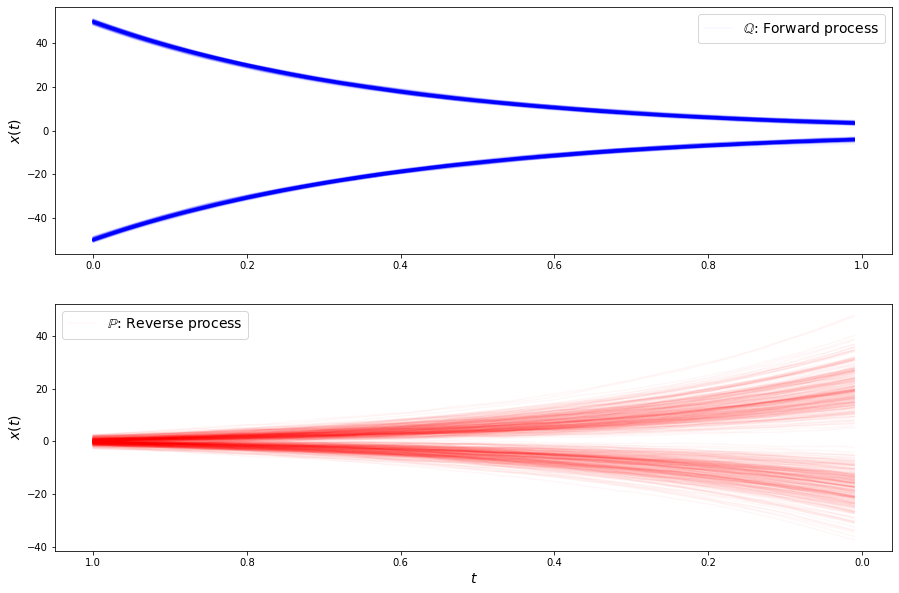

loss b 5.1689910888671875
loss b 5.045558929443359
loss b 5.157266139984131
loss b 5.1567702293396
loss b 5.036825180053711
loss b 5.086322784423828
loss b 5.1055684089660645
loss b 4.980086803436279
loss b 5.110993385314941
loss b 5.086606979370117
loss b 5.056035995483398
loss b 5.054328918457031
loss b 5.083848476409912
loss b 5.160237789154053
loss b 5.125601291656494
loss b 5.120417594909668
loss b 5.10806131362915
loss b 5.108872413635254
loss b 5.1087470054626465
loss b 5.106470108032227
loss b 5.1606903076171875
loss b 5.003945827484131
loss f 23.741289138793945
loss f 22.856063842773438
loss f 22.63534164428711
loss f 22.5579891204834
loss f 22.235492706298828
loss f 21.931123733520508
loss f 22.668373107910156
loss f 21.996929168701172
loss f 22.12285614013672
loss f 22.090484619140625
loss f 20.653120040893555
loss f 21.92308807373047
loss f 21.233449935913086
loss f 22.553972244262695
loss f 22.534971237182617
loss f 20.78276824951172
loss f 22.13397216796875
loss f 21.3366

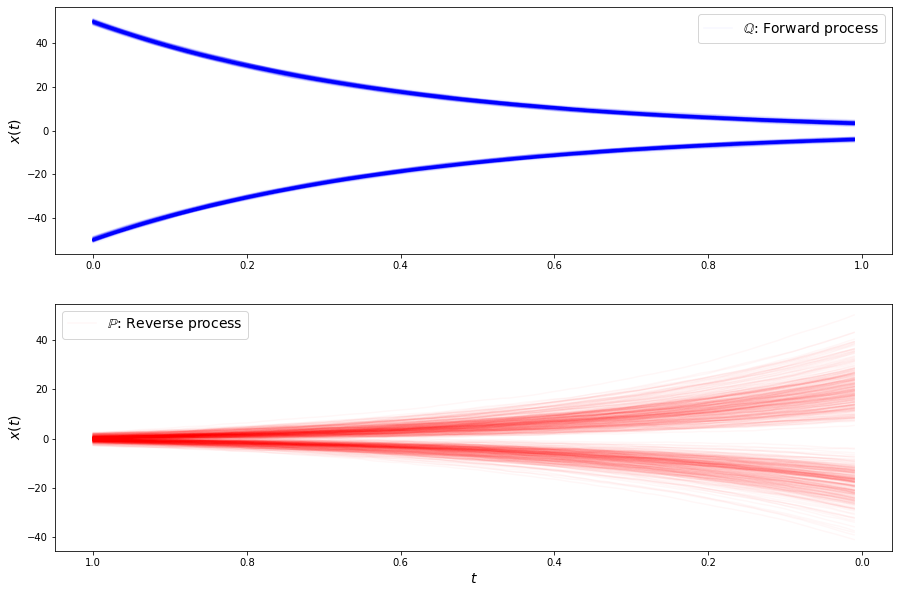

loss b 5.005715847015381
loss b 5.024379730224609
loss b 5.016461372375488
loss b 4.903741836547852
loss b 5.0739359855651855
loss b 4.922577381134033
loss b 5.0743489265441895
loss b 5.077656269073486
loss b 5.012663841247559
loss b 4.949724197387695
loss b 5.040931701660156
loss b 4.933208465576172
loss b 5.077054023742676
loss b 4.948147773742676
loss b 5.031363487243652
loss b 4.957563877105713
loss b 5.062036037445068
loss b 5.054394721984863
loss b 4.988491058349609
loss b 4.944619178771973
loss b 5.060461044311523
loss b 4.990198612213135
loss f 21.035987854003906
loss f 21.31423568725586
loss f 21.889612197875977
loss f 21.629150390625
loss f 20.383604049682617
loss f 20.96564483642578
loss f 20.390960693359375
loss f 19.77216339111328
loss f 21.27460479736328
loss f 20.749248504638672
loss f 20.802825927734375
loss f 19.133338928222656
loss f 20.976985931396484
loss f 20.112667083740234
loss f 21.110767364501953
loss f 21.089496612548828
loss f 21.06788444519043
loss f 19.8426

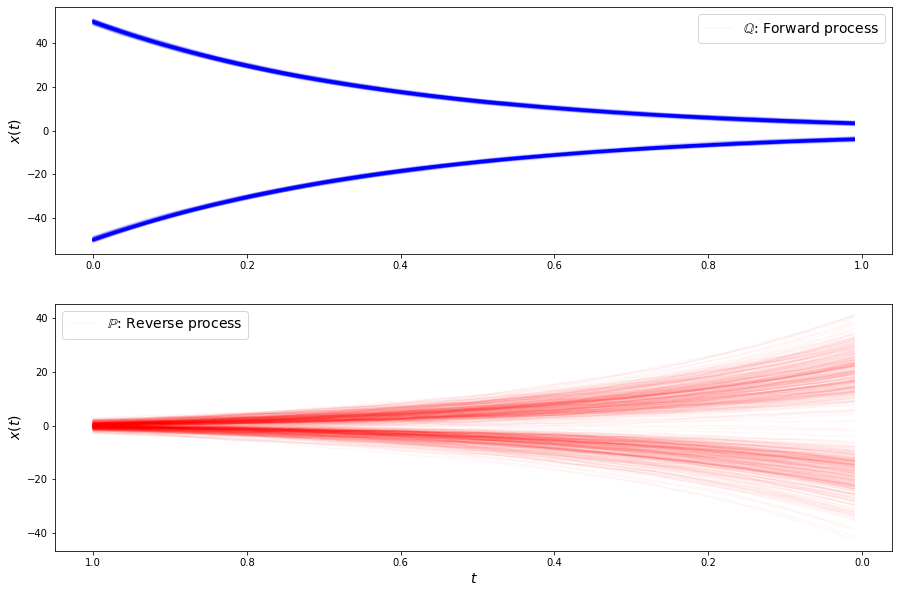

loss b 4.985836029052734
loss b 4.873855113983154
loss b 4.949541091918945
loss b 4.981943130493164
loss b 4.978298187255859
loss b 4.901086330413818
loss b 4.914113998413086
loss b 4.927908420562744
loss b 4.9272308349609375
loss b 4.933593273162842
loss b 4.901578903198242
loss b 4.859588146209717
loss b 4.984354019165039
loss b 4.849340438842773
loss b 4.9231791496276855
loss b 4.904420852661133
loss b 4.90175199508667
loss b 5.004847526550293
loss b 4.806681156158447
loss b 4.966787815093994
loss b 4.864364147186279
loss b 4.976322174072266
loss f 19.678897857666016
loss f 19.208349227905273
loss f 19.671159744262695
loss f 19.617563247680664
loss f 18.857633590698242
loss f 19.070356369018555
loss f 19.739770889282227
loss f 19.330293655395508
loss f 19.70549201965332
loss f 19.517379760742188
loss f 18.847572326660156
loss f 18.653589248657227
loss f 19.000757217407227
loss f 18.42212677001953
loss f 19.31574821472168
loss f 19.008424758911133
loss f 19.65104866027832
loss f 18.1

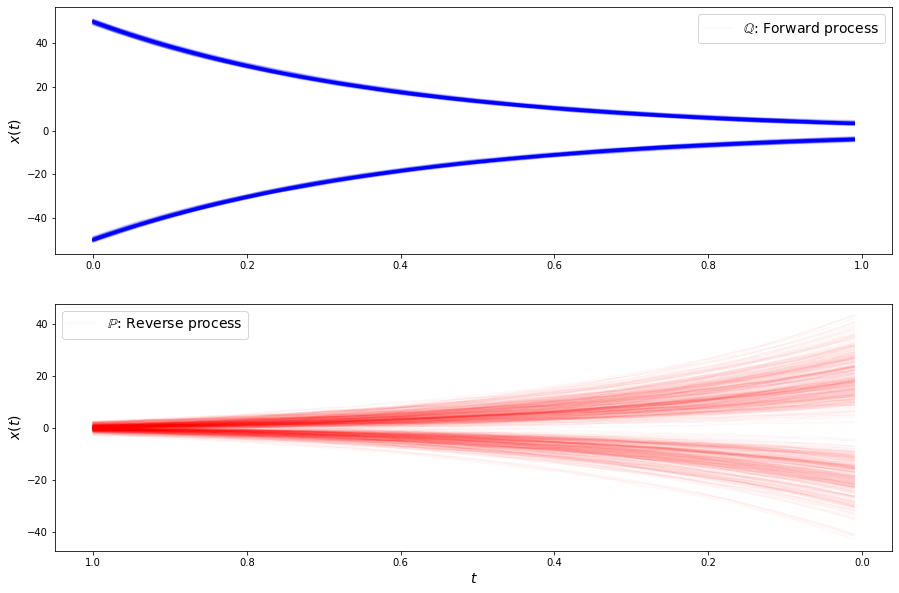

loss b 4.844486236572266
loss b 4.839261531829834
loss b 4.860147953033447
loss b 4.918521881103516
loss b 4.879191875457764
loss b 4.91532039642334
loss b 4.795934200286865
loss b 4.800222396850586
loss b 4.838870048522949
loss b 4.9464640617370605
loss b 4.684908866882324
loss b 4.7734856605529785
loss b 4.817138195037842
loss b 4.8019118309021
loss b 4.934507369995117
loss b 5.008678913116455
loss b 4.887125492095947
loss b 4.896296501159668
loss b 4.855056285858154
loss b 4.82044792175293
loss b 4.818721771240234
loss b 4.854300022125244
loss f 18.561687469482422
loss f 18.674503326416016
loss f 17.67156410217285
loss f 18.742769241333008
loss f 17.95750617980957
loss f 17.795631408691406
loss f 17.41036033630371
loss f 18.27332878112793
loss f 18.91532325744629
loss f 17.59882354736328
loss f 18.086734771728516
loss f 17.09855842590332
loss f 17.174306869506836
loss f 18.04865837097168
loss f 17.771703720092773
loss f 17.610103607177734
loss f 17.743255615234375
loss f 18.33504486

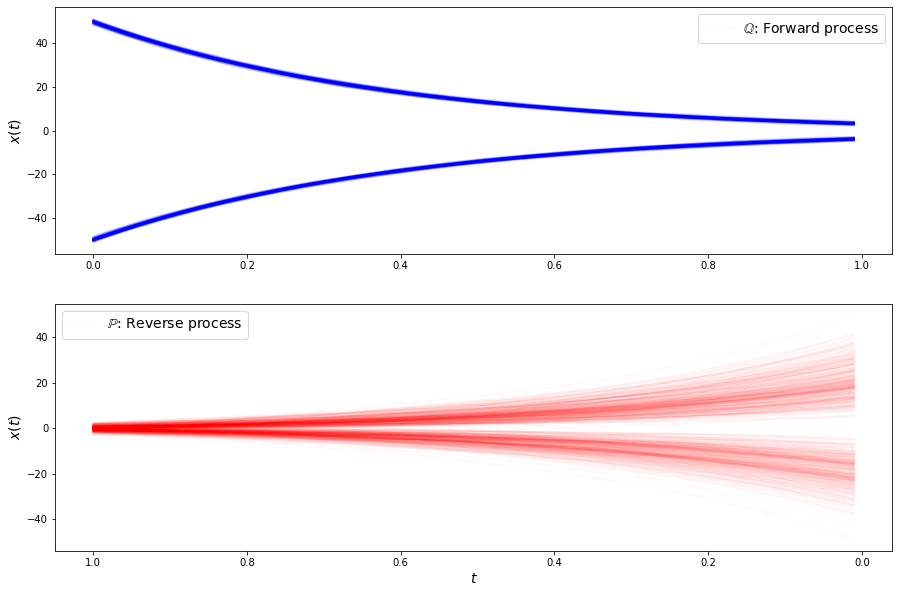

loss b 4.740018367767334
loss b 4.8152666091918945
loss b 4.739952564239502
loss b 4.778148174285889
loss b 4.796113014221191
loss b 4.816408157348633
loss b 4.830824851989746
loss b 4.801644802093506
loss b 4.813755512237549
loss b 4.816764831542969
loss b 4.780102729797363
loss b 4.847060680389404
loss b 4.790831565856934
loss b 4.754194736480713
loss b 4.8749613761901855
loss b 4.812102794647217
loss b 4.777279853820801
loss b 4.790618419647217
loss b 4.687699794769287
loss b 4.807627201080322
loss b 4.796651363372803
loss b 4.780109405517578
loss f 17.044761657714844
loss f 17.307558059692383
loss f 17.13290023803711
loss f 17.716691970825195
loss f 17.027183532714844
loss f 17.213176727294922
loss f 17.29248046875
loss f 16.334131240844727
loss f 16.680469512939453
loss f 16.680492401123047
loss f 16.753524780273438
loss f 16.949115753173828
loss f 17.0531005859375
loss f 16.72989845275879
loss f 16.944480895996094
loss f 17.045000076293945
loss f 16.799089431762695
loss f 17.0923

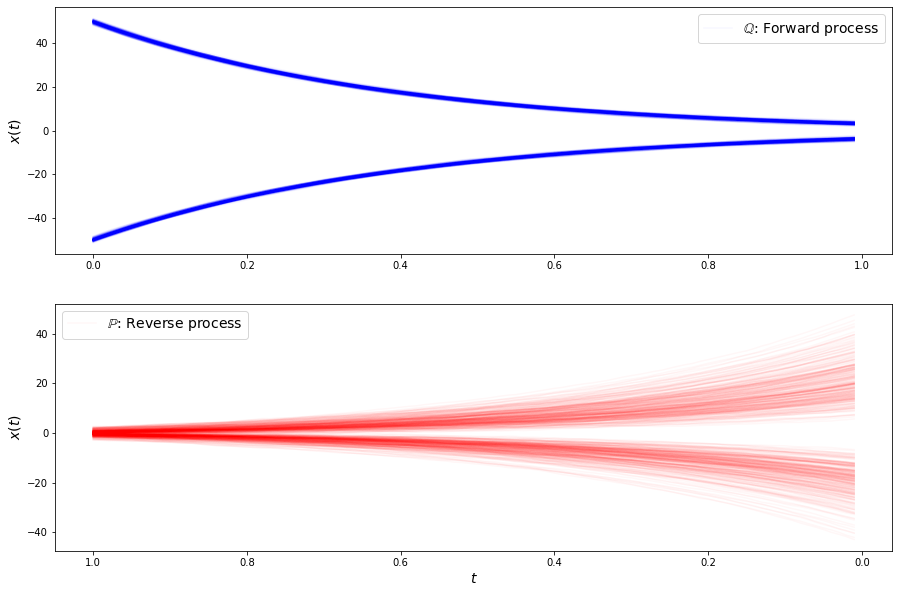

loss b 4.7374091148376465
loss b 4.738345146179199
loss b 4.729244232177734
loss b 4.699020862579346
loss b 4.707414627075195
loss b 4.742310047149658
loss b 4.7127790451049805
loss b 4.741189956665039
loss b 4.771615028381348
loss b 4.648507595062256
loss b 4.747021198272705
loss b 4.651575088500977
loss b 4.788273811340332
loss b 4.630469799041748
loss b 4.718657970428467
loss b 4.734766006469727
loss b 4.714834690093994
loss b 4.729945182800293
loss b 4.660475730895996
loss b 4.726919174194336
loss b 4.744463920593262
loss b 4.704195976257324
loss f 16.89603042602539
loss f 16.415828704833984
loss f 16.241880416870117
loss f 16.30855369567871
loss f 15.756027221679688
loss f 16.51222038269043
loss f 16.25176429748535
loss f 16.707656860351562
loss f 15.980734825134277
loss f 15.613701820373535
loss f 16.505508422851562
loss f 15.569225311279297
loss f 16.15329360961914
loss f 16.062522888183594
loss f 16.000688552856445
loss f 15.794211387634277
loss f 16.0933837890625
loss f 15.294

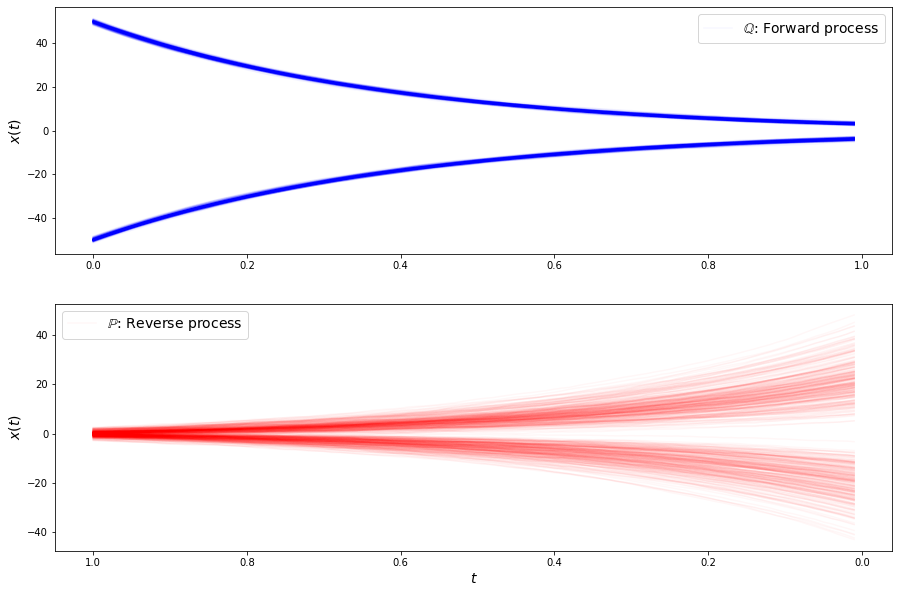

loss b 4.537189483642578
loss b 4.563121795654297
loss b 4.598930835723877
loss b 4.565307140350342
loss b 4.586989879608154
loss b 4.6843342781066895
loss b 4.614745140075684
loss b 4.6445393562316895
loss b 4.776533126831055
loss b 4.684082508087158
loss b 4.712911128997803
loss b 4.715216636657715
loss b 4.527895927429199
loss b 4.5644049644470215
loss b 4.660822868347168
loss b 4.5816569328308105
loss b 4.646453380584717
loss b 4.602179050445557
loss b 4.654961585998535
loss b 4.650032043457031
loss b 4.4980058670043945
loss b 4.748466491699219
loss f 15.581774711608887
loss f 15.285799980163574
loss f 15.869217872619629
loss f 15.452943801879883
loss f 15.933295249938965
loss f 15.326152801513672
loss f 15.433382034301758
loss f 14.978768348693848
loss f 15.149738311767578
loss f 15.038713455200195
loss f 14.825819969177246
loss f 14.865132331848145
loss f 15.725168228149414
loss f 14.969829559326172
loss f 14.999075889587402
loss f 14.913820266723633
loss f 15.185107231140137
los

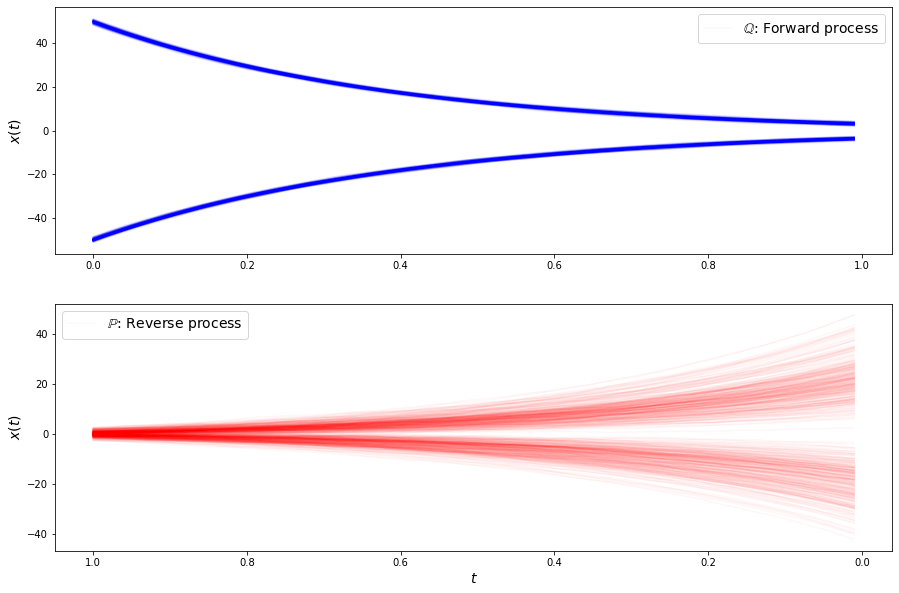

loss b 4.662007808685303
loss b 4.661275386810303
loss b 4.5024285316467285
loss b 4.630119800567627
loss b 4.537978172302246
loss b 4.702589988708496
loss b 4.590806007385254
loss b 4.528962135314941
loss b 4.648155689239502
loss b 4.5065741539001465
loss b 4.517383575439453
loss b 4.629044532775879
loss b 4.589187145233154
loss b 4.594606876373291
loss b 4.597646236419678
loss b 4.615616321563721
loss b 4.592260837554932
loss b 4.510678291320801
loss b 4.633803844451904
loss b 4.608640193939209
loss b 4.580338001251221
loss b 4.436221599578857
loss f 14.298165321350098
loss f 15.226369857788086
loss f 14.6683931350708
loss f 15.427460670471191
loss f 15.294300079345703
loss f 14.695128440856934
loss f 14.347007751464844
loss f 15.27254581451416
loss f 14.419522285461426
loss f 14.373246192932129
loss f 14.589835166931152
loss f 14.080099105834961
loss f 14.137795448303223
loss f 14.952454566955566
loss f 14.726232528686523
loss f 14.237278938293457
loss f 14.14809513092041
loss f 14.

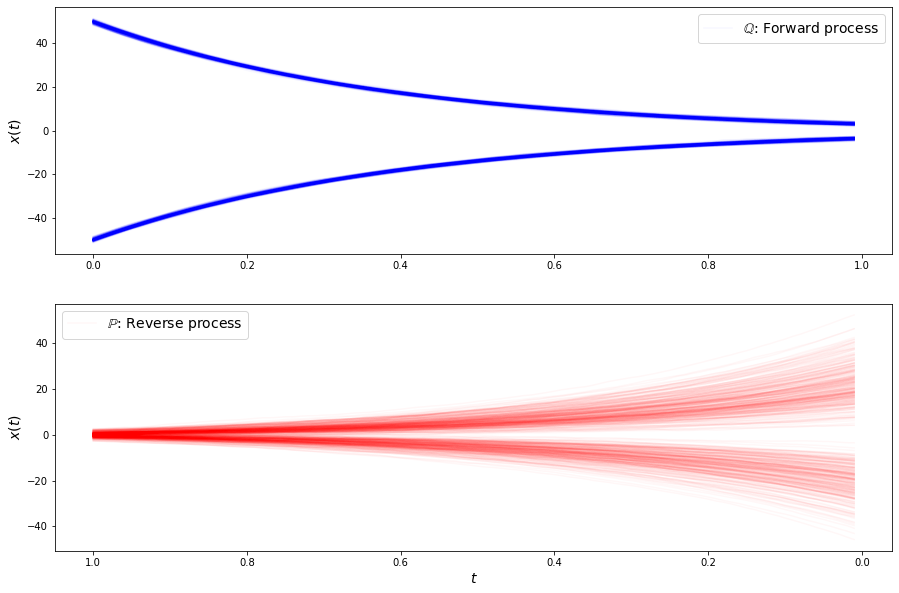

loss b 4.552393436431885
loss b 4.535818576812744
loss b 4.471035003662109
loss b 4.5346879959106445
loss b 4.505606651306152
loss b 4.5269060134887695
loss b 4.552919864654541
loss b 4.4707865715026855
loss b 4.565378665924072
loss b 4.579066276550293
loss b 4.546144008636475
loss b 4.513070106506348
loss b 4.436301231384277
loss b 4.569657802581787
loss b 4.5649919509887695
loss b 4.5746750831604
loss b 4.572132110595703
loss b 4.514387130737305
loss b 4.517782211303711
loss b 4.503149509429932
loss b 4.51364278793335
loss b 4.506378173828125
loss f 14.265941619873047
loss f 13.93331241607666
loss f 13.992534637451172
loss f 13.943209648132324
loss f 13.975916862487793
loss f 13.339613914489746
loss f 14.042336463928223
loss f 13.70067024230957
loss f 13.881722450256348
loss f 13.587677955627441
loss f 14.50107192993164
loss f 13.602920532226562
loss f 14.258952140808105
loss f 13.310358047485352
loss f 13.096589088439941
loss f 14.08449935913086
loss f 13.480024337768555
loss f 13.6

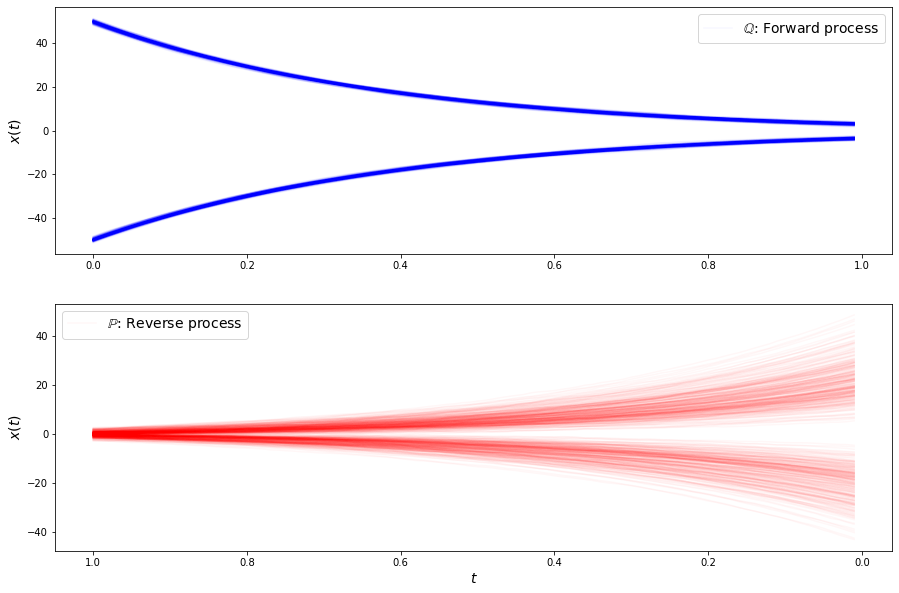

loss b 4.4618401527404785
loss b 4.551938056945801
loss b 4.525014877319336
loss b 4.451608657836914
loss b 4.538727283477783
loss b 4.549300670623779
loss b 4.457206726074219
loss b 4.399257659912109
loss b 4.518223762512207
loss b 4.510447025299072
loss b 4.458304405212402
loss b 4.501999378204346
loss b 4.3623127937316895
loss b 4.512393474578857
loss b 4.371988773345947
loss b 4.3463850021362305
loss b 4.486665725708008
loss b 4.5078959465026855
loss b 4.432242393493652
loss b 4.435591697692871
loss b 4.533745765686035
loss b 4.4756293296813965
loss f 13.08922004699707
loss f 13.262921333312988
loss f 13.367942810058594
loss f 13.504219055175781
loss f 12.794713973999023
loss f 13.446503639221191
loss f 12.586265563964844
loss f 13.227051734924316
loss f 12.751625061035156
loss f 13.22198486328125
loss f 13.316045761108398
loss f 13.560766220092773
loss f 13.089223861694336
loss f 13.233161926269531
loss f 12.813638687133789
loss f 13.849184036254883
loss f 12.866809844970703
loss 

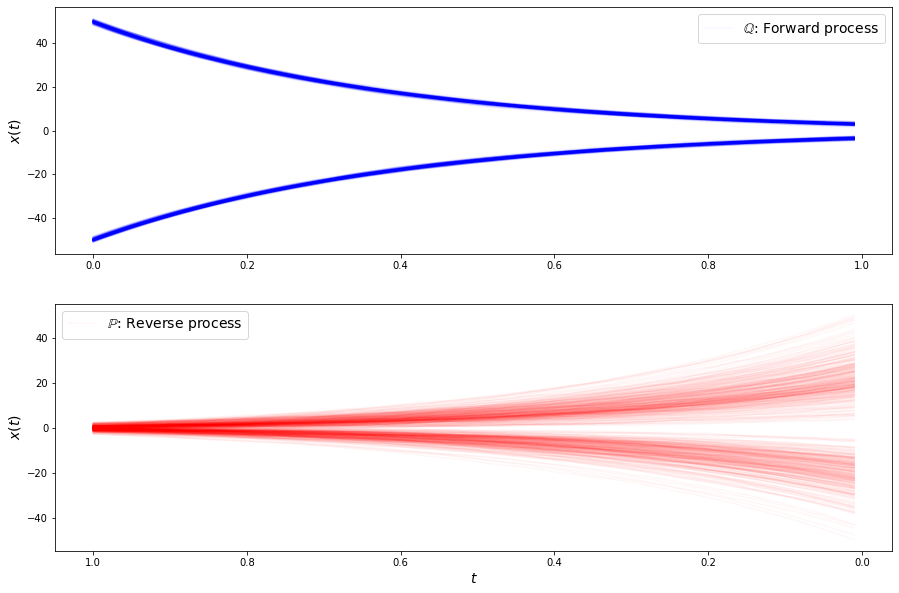

loss b 4.466567039489746
loss b 4.466121196746826
loss b 4.383718013763428
loss b 4.35522985458374
loss b 4.455894947052002
loss b 4.429545879364014
loss b 4.277780055999756
loss b 4.301878452301025
loss b 4.403511047363281
loss b 4.39250373840332
loss b 4.3388848304748535
loss b 4.371952056884766
loss b 4.454592227935791
loss b 4.2951788902282715
loss b 4.458388805389404
loss b 4.336569786071777
loss b 4.385684013366699
loss b 4.360164165496826
loss b 4.405261993408203
loss b 4.5354180335998535
loss b 4.479648113250732
loss b 4.483980178833008
loss f 12.84365177154541
loss f 13.367121696472168
loss f 12.50562572479248
loss f 12.64747428894043
loss f 12.85002613067627
loss f 12.748848915100098
loss f 12.470770835876465
loss f 12.736448287963867
loss f 12.63951587677002
loss f 12.923101425170898
loss f 12.324324607849121
loss f 12.01289176940918
loss f 13.103017807006836
loss f 12.757902145385742
loss f 12.646567344665527
loss f 12.761541366577148
loss f 12.387594223022461
loss f 12.513

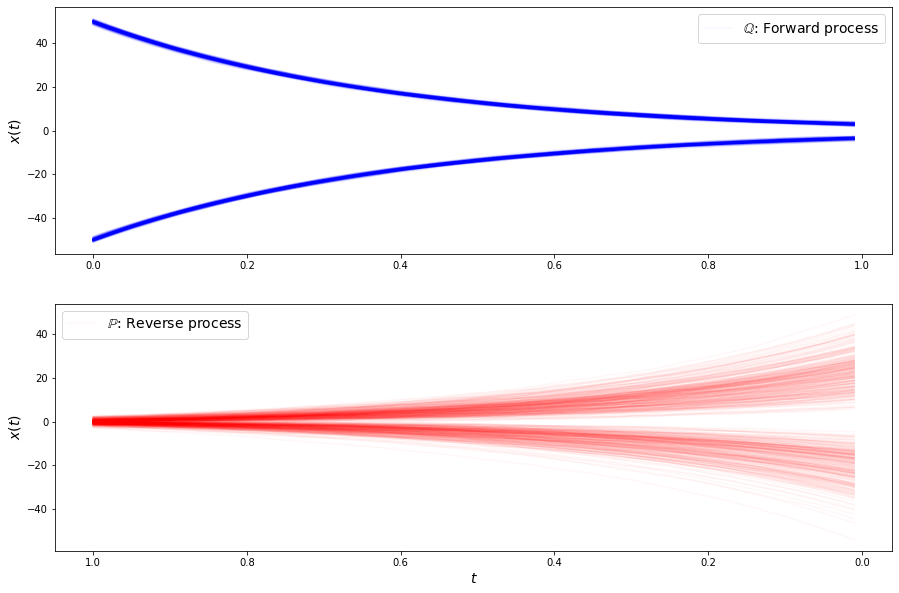

loss b 4.381441116333008
loss b 4.421652793884277
loss b 4.442798614501953
loss b 4.342021942138672
loss b 4.337336540222168
loss b 4.376554489135742
loss b 4.375585079193115
loss b 4.396561622619629
loss b 4.3849711418151855
loss b 4.446276664733887
loss b 4.422510623931885
loss b 4.3910017013549805
loss b 4.30386209487915
loss b 4.347550392150879
loss b 4.349038124084473
loss b 4.4787750244140625
loss b 4.302477836608887
loss b 4.436253070831299
loss b 4.373714923858643
loss b 4.387555122375488
loss b 4.361102104187012
loss b 4.400040626525879
loss f 12.54012393951416
loss f 12.674283981323242
loss f 12.766885757446289
loss f 11.667156219482422
loss f 12.215085983276367
loss f 12.288054466247559
loss f 12.385698318481445
loss f 12.009867668151855
loss f 12.23540210723877
loss f 12.428135871887207
loss f 13.071492195129395
loss f 11.827983856201172
loss f 12.7072172164917
loss f 12.428956031799316
loss f 11.911643981933594
loss f 11.946980476379395
loss f 11.804612159729004
loss f 11.

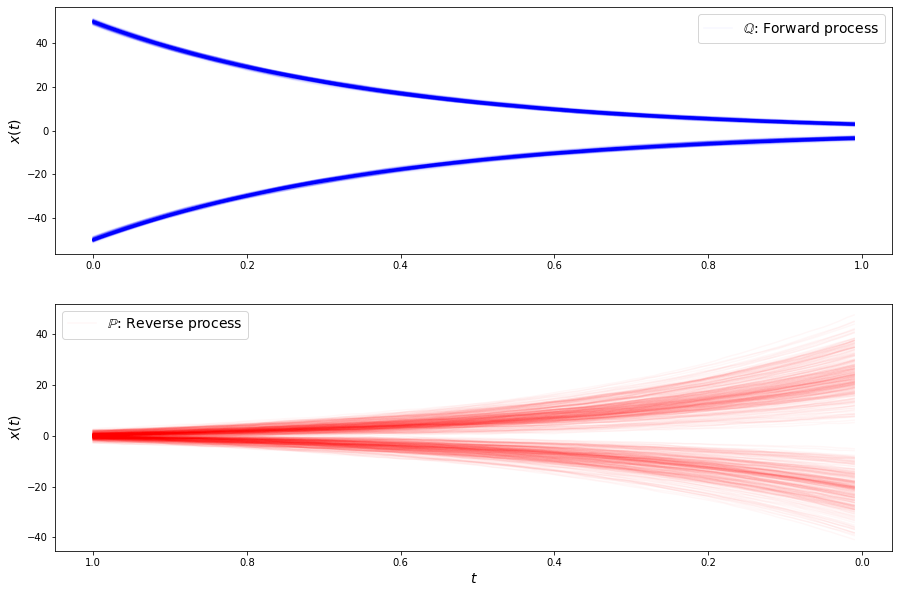

loss b 4.2769951820373535
loss b 4.208070278167725
loss b 4.294208526611328
loss b 4.353890895843506
loss b 4.277431011199951
loss b 4.367674827575684
loss b 4.328067302703857
loss b 4.312264919281006
loss b 4.312255859375
loss b 4.299260139465332
loss b 4.35667610168457
loss b 4.290821075439453
loss b 4.373456001281738
loss b 4.222445964813232
loss b 4.3198981285095215
loss b 4.315497875213623
loss b 4.278472423553467
loss b 4.225765228271484
loss b 4.340900897979736
loss b 4.280506134033203
loss b 4.262800216674805
loss b 4.25582218170166
loss f 11.556659698486328
loss f 11.783479690551758
loss f 11.777739524841309
loss f 12.286256790161133
loss f 11.669544219970703
loss f 11.801128387451172
loss f 11.854150772094727
loss f 11.427658081054688
loss f 11.938790321350098
loss f 12.224448204040527
loss f 11.608444213867188
loss f 11.79294204711914
loss f 11.775184631347656
loss f 11.58179759979248
loss f 11.727567672729492
loss f 11.378286361694336
loss f 11.799453735351562
loss f 11.436

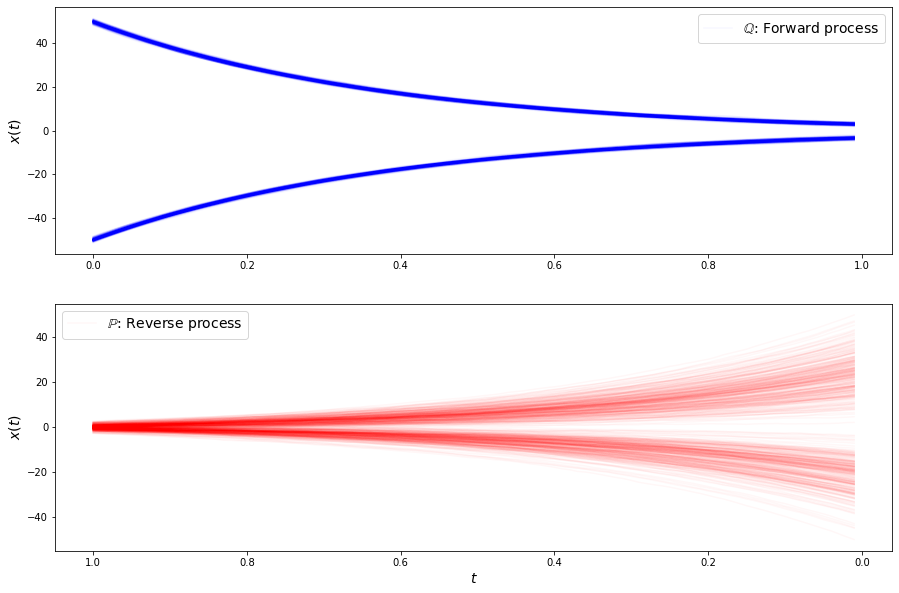

loss b 4.2978105545043945
loss b 4.324531078338623
loss b 4.268486022949219
loss b 4.218166828155518
loss b 4.224126815795898
loss b 4.304551124572754
loss b 4.283679962158203
loss b 4.21581506729126
loss b 4.3069634437561035
loss b 4.205815315246582
loss b 4.220507621765137
loss b 4.206377029418945
loss b 4.346505165100098
loss b 4.296381950378418
loss b 4.342981338500977
loss b 4.218529224395752
loss b 4.16499137878418
loss b 4.286485195159912
loss b 4.304224967956543
loss b 4.263701438903809
loss b 4.210404396057129
loss b 4.205379009246826
loss f 12.239479064941406
loss f 11.391474723815918
loss f 11.416647911071777
loss f 11.515494346618652
loss f 11.37725830078125
loss f 11.453330039978027
loss f 11.477359771728516
loss f 11.317289352416992
loss f 10.703304290771484
loss f 11.225443840026855
loss f 11.42460823059082
loss f 11.16622257232666
loss f 11.6943941116333
loss f 11.54854679107666
loss f 11.066123962402344
loss f 11.192666053771973
loss f 11.124221801757812
loss f 11.8414

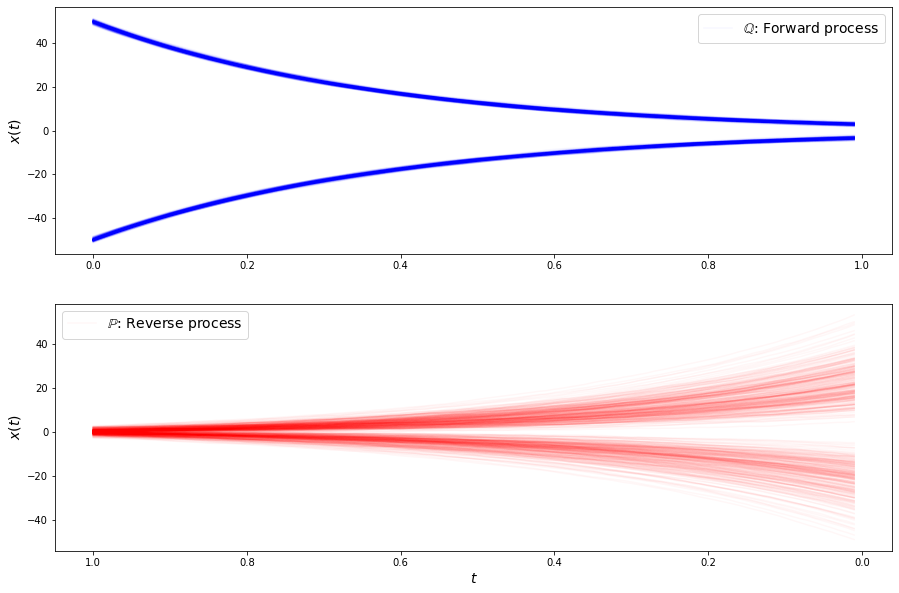

loss b 4.194127082824707
loss b 4.252260208129883
loss b 4.232722282409668
loss b 4.239168167114258
loss b 4.317773818969727
loss b 4.265411853790283
loss b 4.204608917236328
loss b 4.288852214813232
loss b 4.213644981384277
loss b 4.085365295410156
loss b 4.1031813621521
loss b 4.215559959411621
loss b 4.242681980133057
loss b 4.158117294311523
loss b 4.301633834838867
loss b 4.336275100708008
loss b 4.20767068862915
loss b 4.204380035400391
loss b 4.2336344718933105
loss b 4.201065540313721
loss b 4.255564212799072
loss b 4.235573768615723
loss f 11.163982391357422
loss f 11.004697799682617
loss f 11.28105354309082
loss f 11.20462703704834
loss f 11.206084251403809
loss f 11.228062629699707
loss f 11.109891891479492
loss f 10.755780220031738
loss f 10.42142391204834
loss f 11.004667282104492
loss f 11.09693431854248
loss f 10.484917640686035
loss f 10.89911937713623
loss f 11.0759916305542
loss f 10.789090156555176
loss f 10.928664207458496
loss f 10.86571216583252
loss f 10.91648292

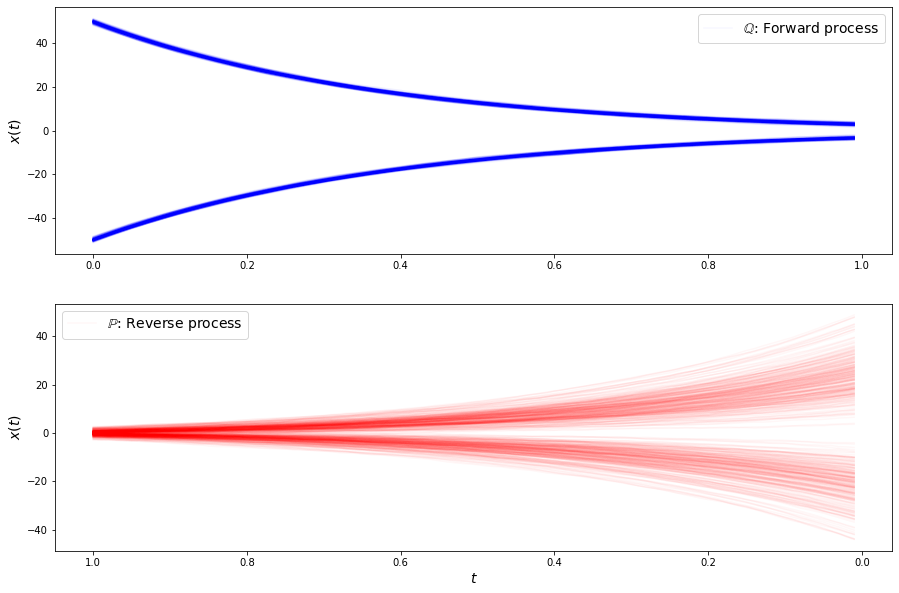

loss b 4.183051586151123
loss b 4.150949001312256
loss b 4.072060585021973
loss b 4.213388919830322
loss b 4.088198184967041
loss b 4.215577125549316
loss b 4.137983798980713
loss b 4.1598968505859375
loss b 4.135671138763428
loss b 4.172863483428955
loss b 4.0521721839904785
loss b 4.193051338195801
loss b 4.264924049377441
loss b 4.153512477874756
loss b 4.1182684898376465
loss b 4.148966312408447
loss b 4.118833065032959
loss b 4.208440780639648
loss b 4.1531596183776855
loss b 4.191806793212891
loss b 4.221022605895996
loss b 4.159238338470459
loss f 10.604836463928223
loss f 10.908489227294922
loss f 10.605976104736328
loss f 10.898333549499512
loss f 10.674178123474121
loss f 10.497451782226562
loss f 10.556539535522461
loss f 10.768597602844238
loss f 10.66577434539795
loss f 10.346488952636719
loss f 10.150749206542969
loss f 10.641785621643066
loss f 10.398595809936523
loss f 10.199350357055664
loss f 10.495570182800293
loss f 10.57188606262207
loss f 10.70740795135498
loss f 

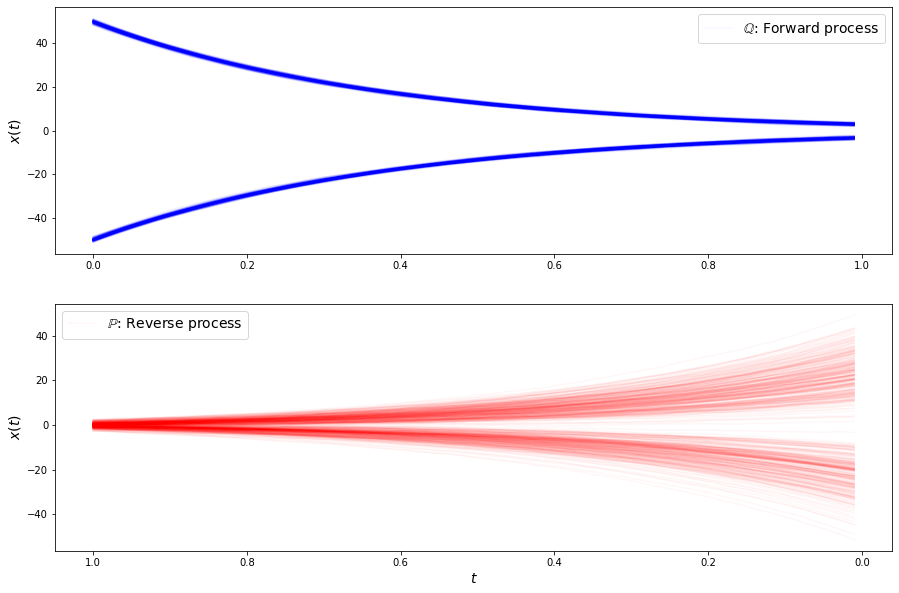

loss b 4.1349711418151855
loss b 4.032671928405762
loss b 4.037026405334473
loss b 4.157516956329346
loss b 4.150600910186768
loss b 4.175511837005615
loss b 4.079537391662598
loss b 3.978942632675171
loss b 4.142259120941162
loss b 4.050007343292236
loss b 4.128739356994629
loss b 4.001322269439697
loss b 4.18827486038208
loss b 4.0930609703063965
loss b 4.06706428527832
loss b 4.148569107055664
loss b 4.073796272277832
loss b 4.129845142364502
loss b 4.041877269744873
loss b 4.083377361297607
loss b 4.125819206237793
loss b 4.144719123840332
loss f 10.806878089904785
loss f 10.481568336486816
loss f 10.307502746582031
loss f 10.054149627685547
loss f 10.587865829467773
loss f 10.422648429870605
loss f 10.500290870666504
loss f 10.177942276000977
loss f 10.301941871643066
loss f 10.402249336242676
loss f 10.194441795349121
loss f 10.048678398132324
loss f 10.025768280029297
loss f 10.343299865722656
loss f 10.192955017089844
loss f 10.2252836227417
loss f 10.12941837310791
loss f 10.4

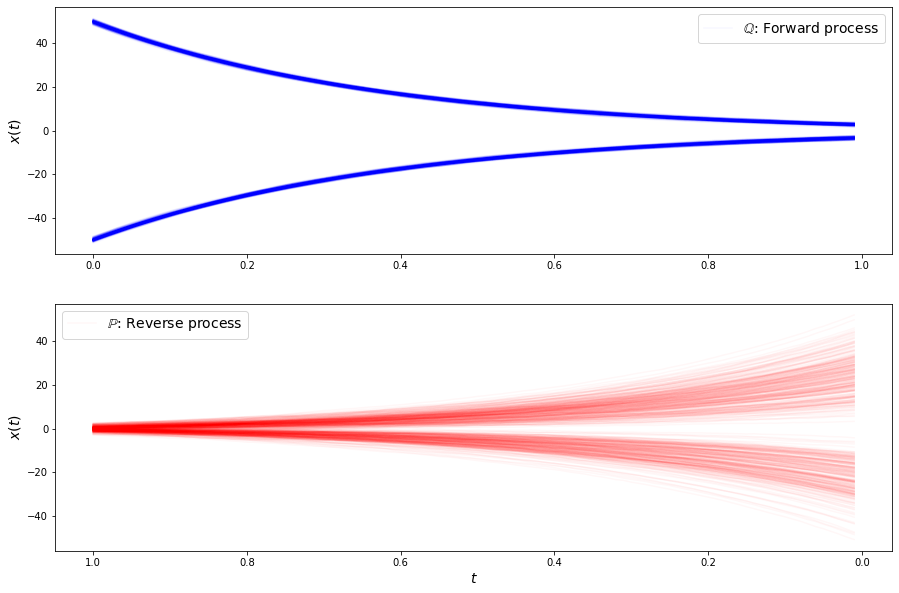

loss b 4.150864601135254
loss b 4.1101460456848145
loss b 4.120527267456055
loss b 4.108645439147949
loss b 4.08156156539917
loss b 4.149873733520508
loss b 4.120223522186279
loss b 4.135864734649658
loss b 4.023346424102783
loss b 4.12078332901001
loss b 4.182001113891602
loss b 4.034427165985107
loss b 4.123415946960449
loss b 3.9927120208740234
loss b 3.976547956466675
loss b 4.06036376953125
loss b 4.041508674621582
loss b 4.103405952453613
loss b 4.034893989562988
loss b 4.11130428314209
loss b 4.0579047203063965
loss b 4.2436370849609375
loss f 10.245597839355469
loss f 10.001152038574219
loss f 9.920244216918945
loss f 9.841940879821777
loss f 9.63210391998291
loss f 9.799603462219238
loss f 9.832747459411621
loss f 9.891674995422363
loss f 9.9685697555542
loss f 10.146907806396484
loss f 10.11788272857666
loss f 9.814226150512695
loss f 9.962273597717285
loss f 9.774235725402832
loss f 9.785318374633789
loss f 10.522791862487793
loss f 9.881239891052246
loss f 10.21892166137695

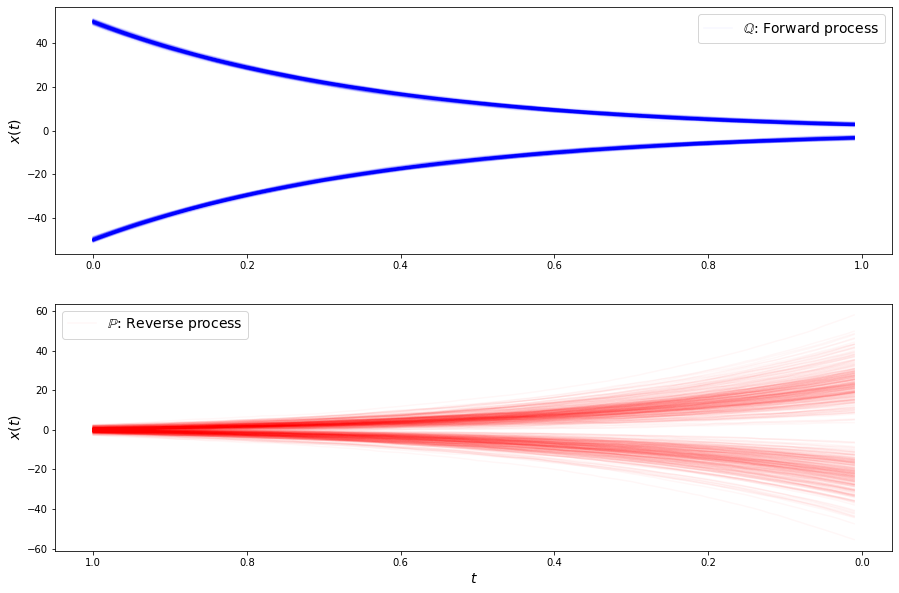

loss b 4.019172668457031
loss b 4.009710788726807
loss b 4.0963287353515625
loss b 4.096560955047607
loss b 4.185971736907959
loss b 4.066208362579346
loss b 4.021603107452393
loss b 4.077676296234131
loss b 4.115880966186523
loss b 4.049386024475098
loss b 4.012437343597412
loss b 3.981802463531494
loss b 4.043562412261963
loss b 4.021492958068848
loss b 4.1103081703186035
loss b 4.020294666290283
loss b 3.964890956878662
loss b 4.033873558044434
loss b 4.101489067077637
loss b 4.104353427886963
loss b 3.9137163162231445
loss b 3.9480040073394775
loss f 10.179927825927734
loss f 9.837614059448242
loss f 9.896552085876465
loss f 9.692110061645508
loss f 9.636384010314941
loss f 9.672003746032715
loss f 10.031352043151855
loss f 9.655552864074707
loss f 9.400531768798828
loss f 9.679594039916992
loss f 9.706879615783691
loss f 9.36683177947998
loss f 9.400705337524414
loss f 9.820721626281738
loss f 9.613969802856445
loss f 9.503188133239746
loss f 9.895406723022461
loss f 9.40085220336

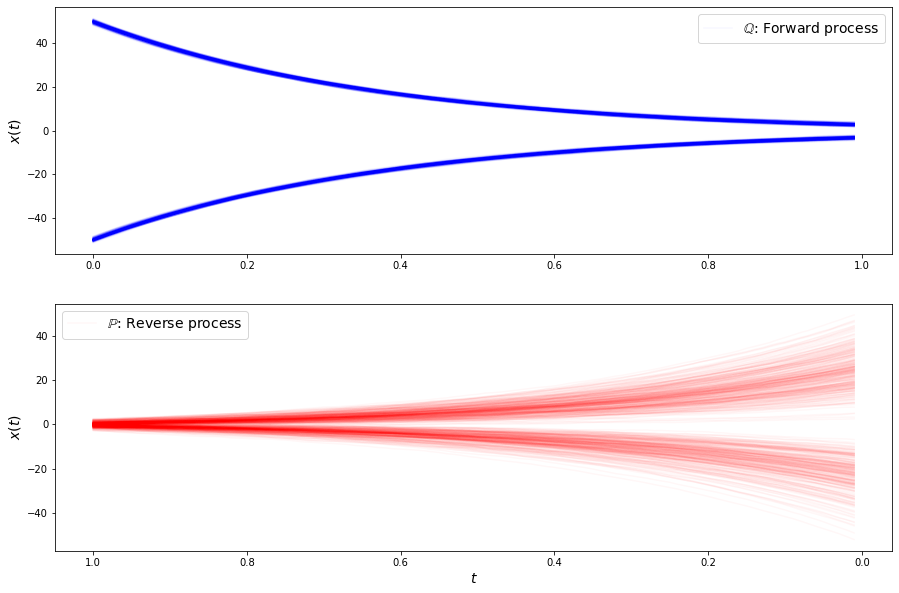

loss b 4.012240886688232
loss b 3.926886796951294
loss b 3.9657413959503174
loss b 3.9223172664642334
loss b 4.039740085601807
loss b 3.9661712646484375
loss b 4.03484582901001
loss b 4.037563800811768
loss b 4.043966770172119
loss b 4.001033782958984
loss b 3.9817898273468018
loss b 3.9833755493164062
loss b 4.114422798156738
loss b 4.033122539520264
loss b 3.9514546394348145
loss b 4.007469654083252
loss b 3.9846346378326416
loss b 3.9123480319976807
loss b 4.059427738189697
loss b 3.94071888923645
loss b 4.036773681640625
loss b 3.9971532821655273
loss f 9.145000457763672
loss f 9.523974418640137
loss f 9.757142066955566
loss f 9.3533935546875
loss f 9.14747142791748
loss f 9.552536964416504
loss f 9.376998901367188
loss f 9.27943229675293
loss f 9.713934898376465
loss f 9.28738784790039
loss f 9.953514099121094
loss f 9.882190704345703
loss f 9.592124938964844
loss f 9.536093711853027
loss f 9.052918434143066
loss f 9.115278244018555
loss f 9.342900276184082
loss f 9.05651378631591

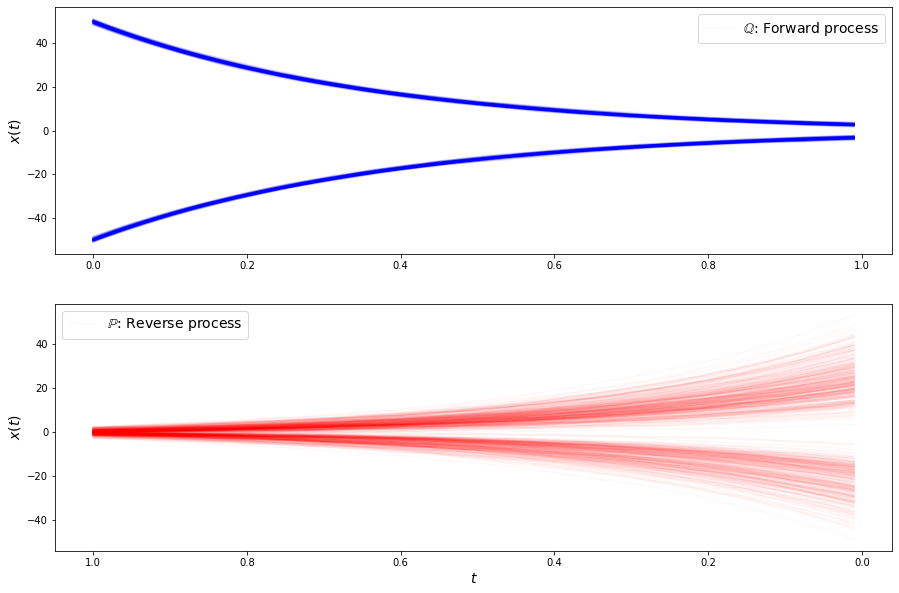

loss b 3.889430522918701
loss b 3.9818055629730225
loss b 3.924294948577881
loss b 3.947889804840088
loss b 3.920957326889038
loss b 3.9440600872039795
loss b 3.983902931213379
loss b 3.936283588409424
loss b 3.937250852584839
loss b 3.8899707794189453
loss b 4.031854152679443
loss b 3.9013671875
loss b 3.9399373531341553
loss b 4.071706295013428
loss b 3.991347074508667
loss b 3.869785785675049
loss b 4.0105061531066895
loss b 4.0195112228393555
loss b 3.9408998489379883
loss b 3.925675392150879
loss b 3.938819408416748
loss b 3.991708517074585
loss f 9.603504180908203
loss f 9.332681655883789
loss f 9.404269218444824
loss f 9.52165412902832
loss f 8.9757661819458
loss f 8.91408634185791
loss f 8.66221809387207
loss f 9.10700798034668
loss f 8.88144588470459
loss f 8.868288040161133
loss f 9.25127124786377
loss f 9.485840797424316
loss f 9.126312255859375
loss f 9.040360450744629
loss f 8.926716804504395
loss f 9.059761047363281
loss f 9.073569297790527
loss f 9.108141899108887
loss f

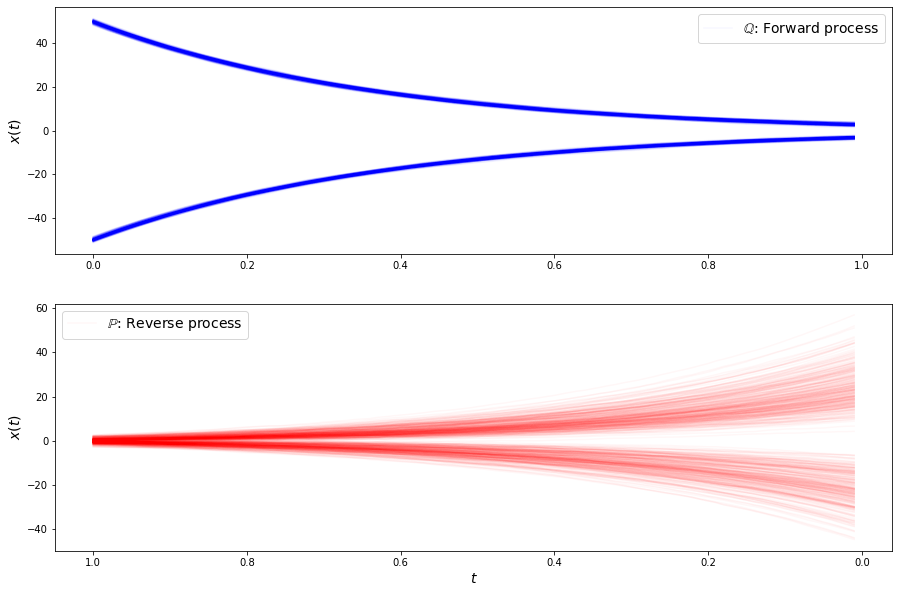

loss b 3.902704954147339
loss b 3.860793352127075
loss b 3.9167864322662354
loss b 3.8275845050811768
loss b 3.9772980213165283
loss b 3.917717456817627
loss b 3.974064826965332
loss b 3.896669864654541
loss b 3.99004864692688
loss b 3.931826591491699
loss b 3.8708200454711914
loss b 3.941850185394287
loss b 3.954524040222168
loss b 3.8633673191070557
loss b 3.893474578857422
loss b 3.8427999019622803
loss b 3.9228832721710205
loss b 3.9602715969085693
loss b 3.9368767738342285
loss b 3.899768590927124
loss b 3.8981640338897705
loss b 3.8538994789123535
loss f 9.015803337097168
loss f 9.058889389038086
loss f 8.383257865905762
loss f 9.060155868530273
loss f 8.87249755859375
loss f 9.066615104675293
loss f 8.754095077514648
loss f 8.879378318786621
loss f 9.17327880859375
loss f 8.935232162475586
loss f 8.60306167602539
loss f 8.971579551696777
loss f 8.808011054992676
loss f 8.814953804016113
loss f 8.995444297790527
loss f 8.775870323181152
loss f 9.115751266479492
loss f 9.082344055

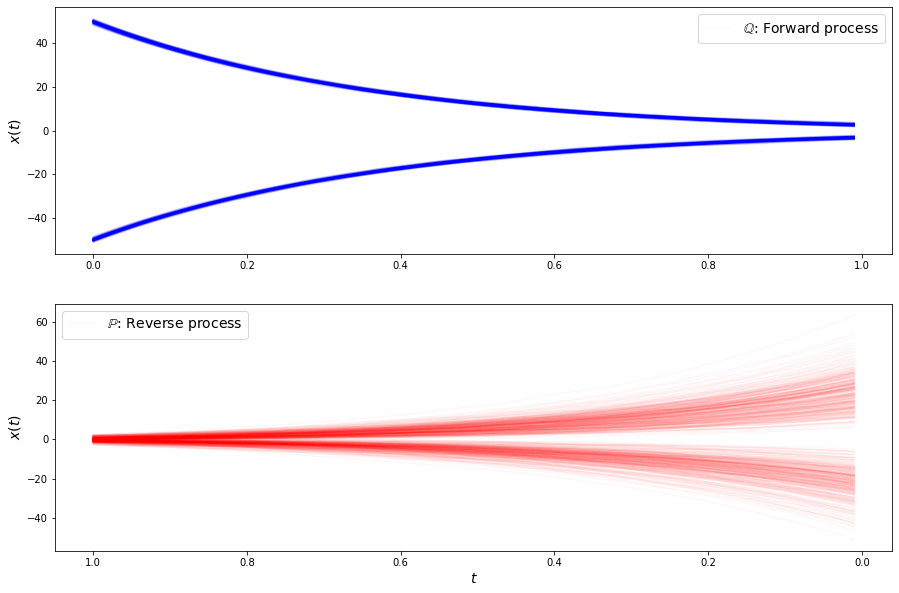

loss b 3.8549931049346924
loss b 3.916476249694824
loss b 3.9264867305755615
loss b 3.886014938354492
loss b 3.9687604904174805
loss b 3.837428092956543
loss b 3.9159607887268066
loss b 3.847379684448242
loss b 3.832731008529663
loss b 3.8807294368743896
loss b 3.8038275241851807
loss b 3.830723524093628
loss b 3.9543232917785645
loss b 3.8911404609680176
loss b 3.8942224979400635
loss b 3.872772455215454
loss b 3.8300650119781494
loss b 3.9717965126037598
loss b 3.8580119609832764
loss b 3.9093523025512695
loss b 3.8040120601654053
loss b 3.8835065364837646
loss f 8.773015022277832
loss f 8.92199993133545
loss f 9.267802238464355
loss f 8.720914840698242
loss f 8.943550109863281
loss f 8.81937026977539
loss f 8.783533096313477
loss f 8.667683601379395
loss f 8.72110366821289
loss f 8.88090705871582
loss f 8.606027603149414
loss f 8.929595947265625
loss f 8.896320343017578
loss f 8.944405555725098
loss f 8.74094009399414
loss f 8.76498031616211
loss f 8.874728202819824
loss f 8.6440925

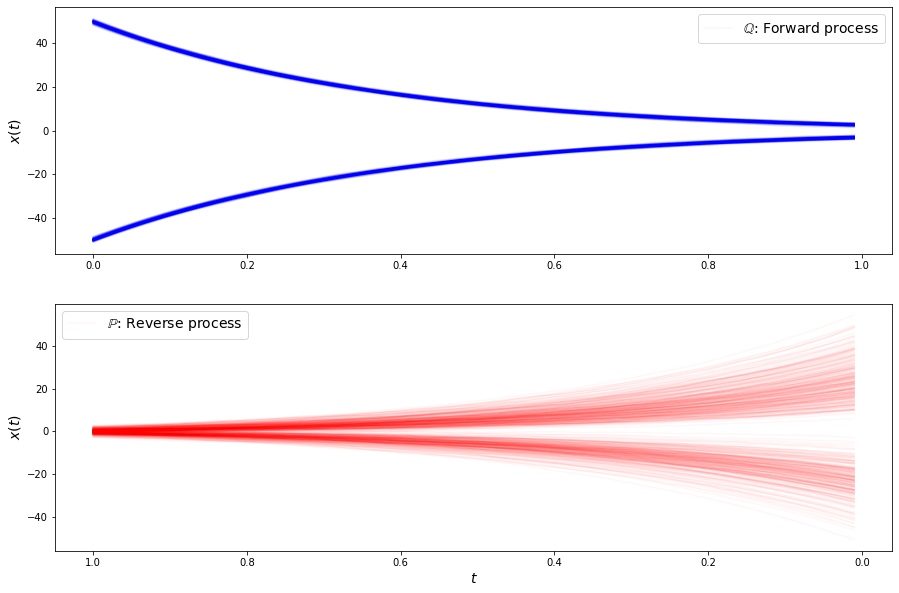

loss b 3.9187886714935303
loss b 3.9174909591674805
loss b 3.8537418842315674
loss b 3.760727643966675
loss b 3.8890302181243896
loss b 3.9109654426574707
loss b 3.7977969646453857
loss b 3.9097909927368164
loss b 3.8683865070343018
loss b 3.7604856491088867
loss b 3.8569486141204834
loss b 3.8034770488739014
loss b 3.9329380989074707
loss b 3.836641788482666
loss b 3.786715030670166
loss b 3.788104772567749
loss b 3.8550260066986084
loss b 3.768082618713379
loss b 3.763115882873535
loss b 3.896056652069092
loss b 3.9778010845184326
loss b 3.874582290649414
loss f 8.917914390563965
loss f 8.553524017333984
loss f 8.8632173538208
loss f 8.548824310302734
loss f 8.350984573364258
loss f 8.995537757873535
loss f 8.47764778137207
loss f 8.660972595214844
loss f 8.295991897583008
loss f 8.227556228637695
loss f 8.777084350585938
loss f 8.452367782592773
loss f 8.563838005065918
loss f 8.687186241149902
loss f 8.626952171325684
loss f 8.448944091796875
loss f 8.399641990661621
loss f 8.85458

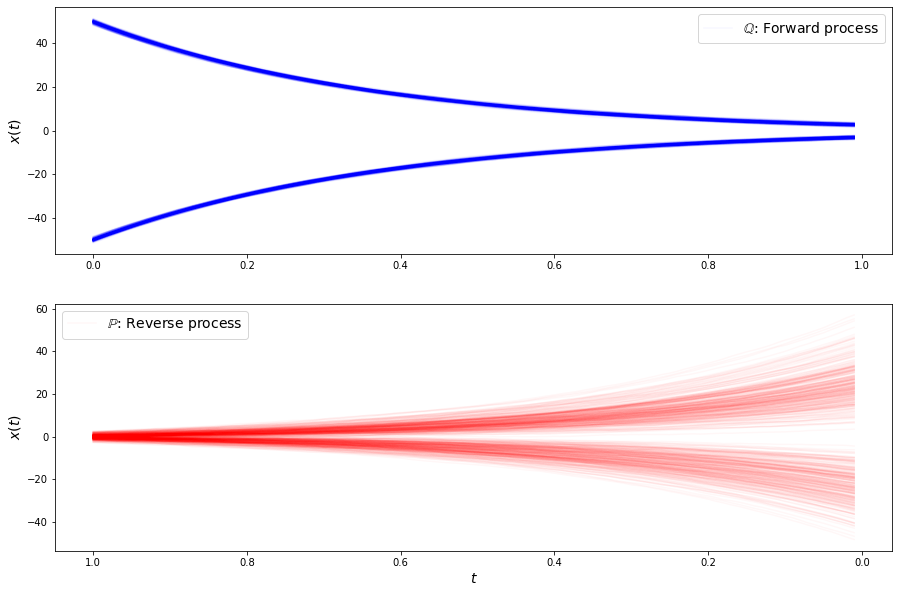

loss b 3.890522003173828
loss b 3.9240589141845703
loss b 3.8347361087799072
loss b 3.8214094638824463
loss b 3.7758572101593018
loss b 3.8066084384918213
loss b 3.8952014446258545
loss b 3.749413251876831
loss b 3.855417013168335
loss b 3.902524948120117
loss b 3.7544009685516357
loss b 3.769843101501465
loss b 3.7478995323181152
loss b 3.787081480026245
loss b 3.778826951980591
loss b 3.7641661167144775
loss b 3.7904536724090576
loss b 3.854475498199463
loss b 3.9573256969451904
loss b 3.7894935607910156
loss b 3.752460479736328
loss b 3.8040966987609863
loss f 8.414756774902344
loss f 8.050511360168457
loss f 8.442899703979492
loss f 8.289530754089355
loss f 8.366874694824219
loss f 8.508711814880371
loss f 8.581104278564453
loss f 8.231343269348145
loss f 8.53485107421875
loss f 8.363863945007324
loss f 8.273263931274414
loss f 8.459747314453125
loss f 8.197493553161621
loss f 8.40089225769043
loss f 8.28495979309082
loss f 8.181336402893066
loss f 8.457099914550781
loss f 8.339723

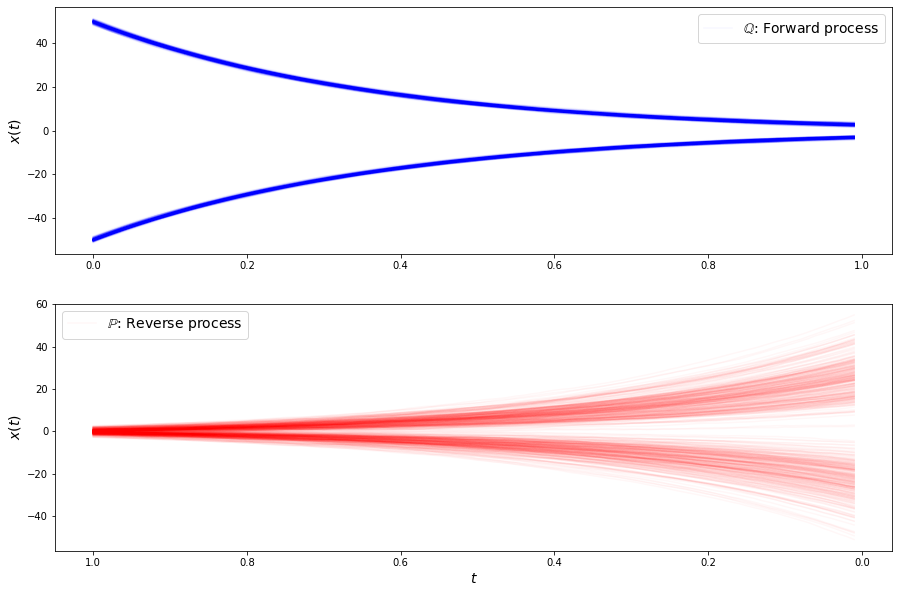

loss b 3.6839914321899414
loss b 3.6459240913391113
loss b 3.7957406044006348
loss b 3.748321056365967
loss b 3.737061023712158
loss b 3.7920584678649902
loss b 3.7952754497528076
loss b 3.7742438316345215
loss b 3.7099335193634033
loss b 3.905893087387085
loss b 3.757988929748535
loss b 3.833357095718384
loss b 3.7271361351013184
loss b 3.6591382026672363
loss b 3.737602710723877
loss b 3.8015565872192383
loss b 3.7749454975128174
loss b 3.8213417530059814
loss b 3.8432939052581787
loss b 3.7667555809020996
loss b 3.7956955432891846
loss b 3.8089072704315186
loss f 8.044293403625488
loss f 8.093445777893066
loss f 8.412646293640137
loss f 7.92266321182251
loss f 8.433673858642578
loss f 8.081035614013672
loss f 8.305730819702148
loss f 8.3506441116333
loss f 8.227856636047363
loss f 8.512554168701172
loss f 8.056984901428223
loss f 8.325539588928223
loss f 8.106086730957031
loss f 8.399889945983887
loss f 8.0333833694458
loss f 8.294687271118164
loss f 8.152599334716797
loss f 8.26826

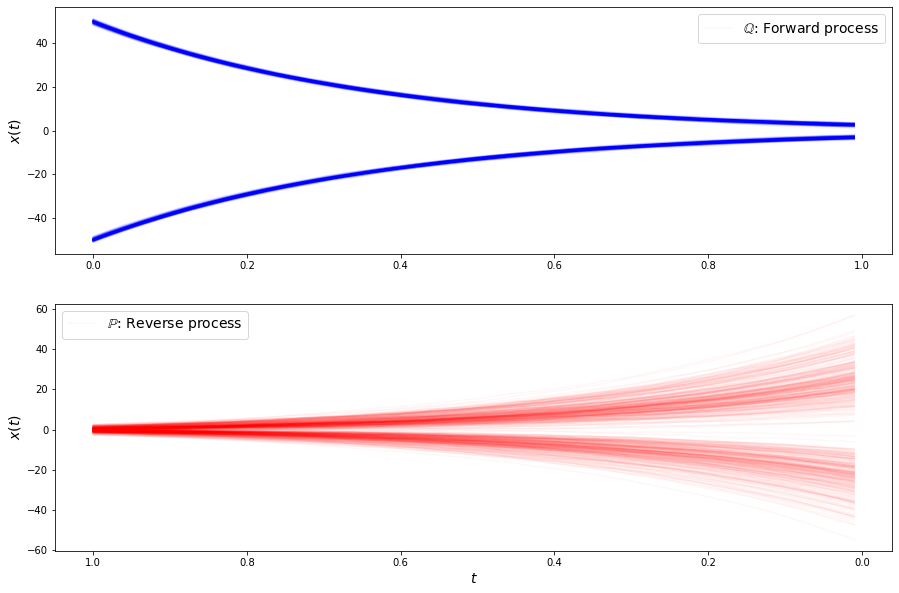

loss b 3.719723701477051
loss b 3.78267765045166
loss b 3.7397565841674805
loss b 3.86316180229187
loss b 3.7031733989715576
loss b 3.7333145141601562
loss b 3.79056453704834
loss b 3.685883045196533
loss b 3.790271043777466
loss b 3.7792623043060303
loss b 3.567089080810547
loss b 3.6450085639953613
loss b 3.652862071990967
loss b 3.77181339263916
loss b 3.768683910369873
loss b 3.675440549850464
loss b 3.657104969024658
loss b 3.6633388996124268
loss b 3.7826106548309326
loss b 3.7004475593566895
loss b 3.724829912185669
loss b 3.637155532836914
loss f 8.176826477050781
loss f 7.998597621917725
loss f 8.135921478271484
loss f 8.300293922424316
loss f 8.23921012878418
loss f 8.065303802490234
loss f 8.42361831665039
loss f 8.757699966430664
loss f 8.329333305358887
loss f 8.010931015014648
loss f 8.157570838928223
loss f 8.204756736755371
loss f 8.11725902557373
loss f 8.136585235595703
loss f 8.208608627319336
loss f 7.953213214874268
loss f 7.996204853057861
loss f 8.331188201904297

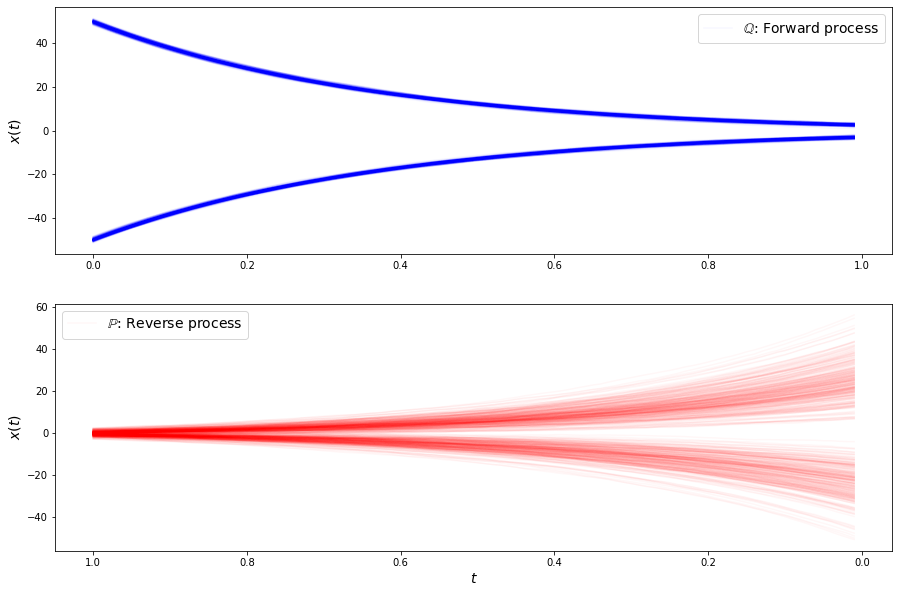

loss b 3.671928882598877
loss b 3.6725330352783203
loss b 3.738900661468506
loss b 3.7002313137054443
loss b 3.69826340675354
loss b 3.796957015991211
loss b 3.6840054988861084
loss b 3.722416400909424
loss b 3.789390802383423
loss b 3.7434589862823486
loss b 3.6471188068389893
loss b 3.7388734817504883
loss b 3.68467378616333
loss b 3.753866195678711
loss b 3.7299418449401855
loss b 3.706617832183838
loss b 3.639883041381836
loss b 3.7155168056488037
loss b 3.7035534381866455
loss b 3.7384965419769287
loss b 3.658025026321411
loss b 3.735264539718628
loss f 7.814723014831543
loss f 7.97027063369751
loss f 8.174153327941895
loss f 8.14609432220459
loss f 7.9535651206970215
loss f 7.919682025909424
loss f 8.225217819213867
loss f 7.796422004699707
loss f 7.811215877532959
loss f 8.19512939453125
loss f 8.192113876342773
loss f 8.068451881408691
loss f 7.773158550262451
loss f 7.753866195678711
loss f 7.879241943359375
loss f 8.159031867980957
loss f 7.886228084564209
loss f 7.9901394844

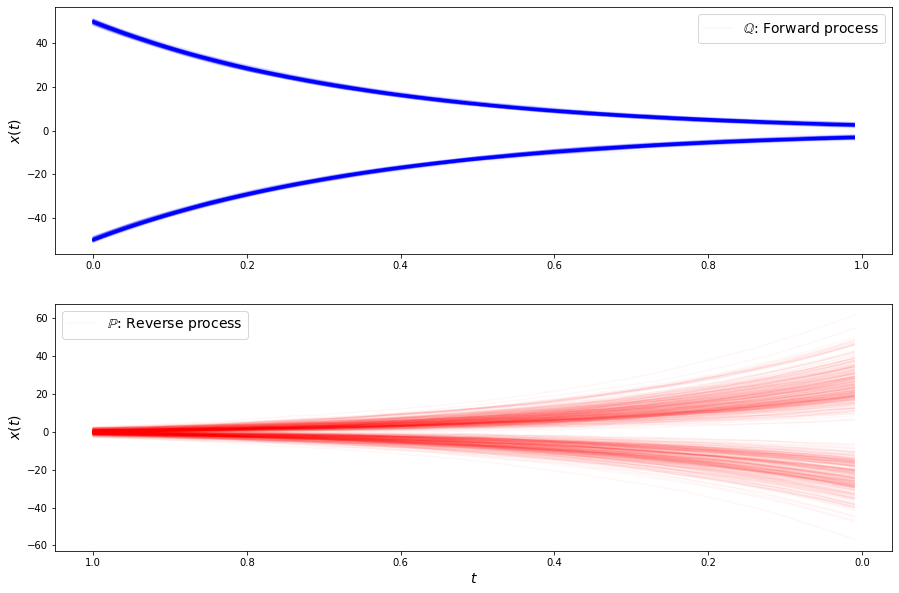

loss b 3.776073932647705
loss b 3.609295606613159
loss b 3.6781420707702637
loss b 3.693180561065674
loss b 3.703373432159424
loss b 3.664858341217041
loss b 3.7465460300445557
loss b 3.6695139408111572
loss b 3.6514649391174316
loss b 3.5709879398345947
loss b 3.7092597484588623
loss b 3.5938022136688232
loss b 3.5564401149749756
loss b 3.6965858936309814
loss b 3.6767988204956055
loss b 3.677277088165283
loss b 3.6145522594451904
loss b 3.778549909591675
loss b 3.633867025375366
loss b 3.8360118865966797
loss b 3.662708044052124
loss b 3.6275510787963867
loss f 7.941085338592529
loss f 7.854586124420166
loss f 7.688965320587158
loss f 7.87604284286499
loss f 7.962824821472168
loss f 7.753872871398926
loss f 7.682500839233398
loss f 7.8599629402160645
loss f 7.696022987365723
loss f 7.77121639251709
loss f 7.798238277435303
loss f 7.830784797668457
loss f 7.74600076675415
loss f 7.960653305053711
loss f 7.970075607299805
loss f 7.860055923461914
loss f 7.851807117462158
loss f 8.16117

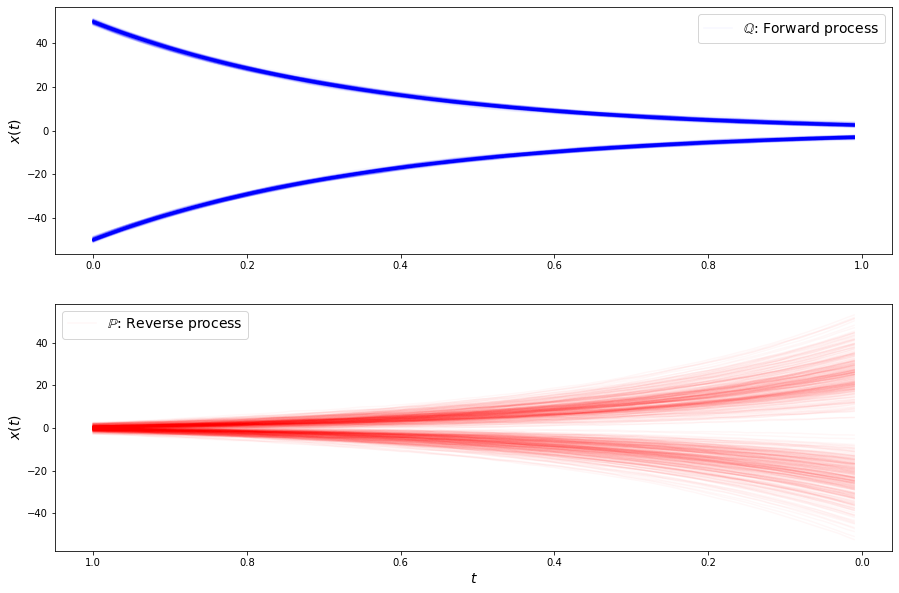

loss b 3.6956255435943604
loss b 3.684335470199585
loss b 3.5860939025878906
loss b 3.6332082748413086
loss b 3.647474527359009
loss b 3.673511028289795
loss b 3.6567111015319824
loss b 3.651684522628784
loss b 3.7190968990325928
loss b 3.744163751602173
loss b 3.7079381942749023
loss b 3.6221261024475098
loss b 3.7122015953063965
loss b 3.647643804550171
loss b 3.650315523147583
loss b 3.5574960708618164
loss b 3.6174817085266113
loss b 3.5743589401245117
loss b 3.6629505157470703
loss b 3.524153470993042
loss b 3.6734631061553955
loss b 3.655416488647461
loss f 7.71097993850708
loss f 7.844703197479248
loss f 7.781887054443359
loss f 7.687004089355469
loss f 7.580146789550781
loss f 7.619841575622559
loss f 8.018803596496582
loss f 7.882036209106445
loss f 7.324791431427002
loss f 7.5648088455200195
loss f 8.089001655578613
loss f 7.753690719604492
loss f 7.901739120483398
loss f 7.430825233459473
loss f 7.690001964569092
loss f 7.8853631019592285
loss f 7.391275882720947
loss f 7.78

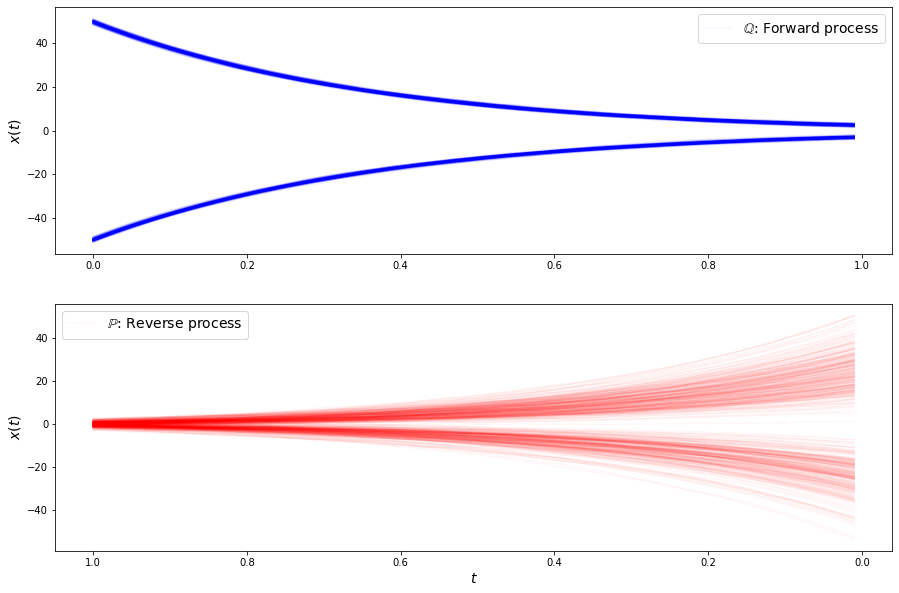

loss b 3.5974910259246826
loss b 3.6857941150665283
loss b 3.5527284145355225
loss b 3.600170612335205
loss b 3.6819374561309814
loss b 3.553811550140381
loss b 3.5939080715179443
loss b 3.6246724128723145
loss b 3.64233136177063
loss b 3.6412479877471924
loss b 3.6260364055633545
loss b 3.654050588607788
loss b 3.4670569896698
loss b 3.6735422611236572
loss b 3.6668925285339355
loss b 3.622527837753296
loss b 3.627530813217163
loss b 3.7514824867248535
loss b 3.730212926864624
loss b 3.646244525909424
loss b 3.5759623050689697
loss b 3.628457546234131
loss f 7.439489841461182
loss f 7.502488136291504
loss f 7.733922958374023
loss f 7.4337849617004395
loss f 7.749874114990234
loss f 7.74744176864624
loss f 7.280154228210449
loss f 7.564596652984619
loss f 7.415626049041748
loss f 7.767821788787842
loss f 7.424932479858398
loss f 7.496667861938477
loss f 7.528340816497803
loss f 7.359224319458008
loss f 7.497436046600342
loss f 7.814267158508301
loss f 7.607021808624268
loss f 7.5774435

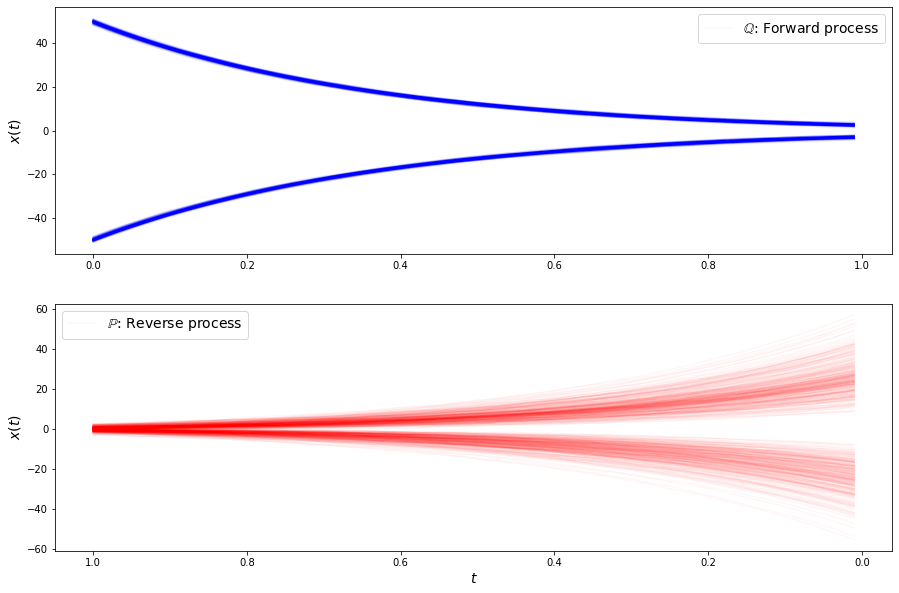

loss b 3.5945494174957275
loss b 3.5758087635040283
loss b 3.706415891647339
loss b 3.6286282539367676
loss b 3.6306869983673096
loss b 3.55061936378479
loss b 3.5675389766693115
loss b 3.521228075027466
loss b 3.5632402896881104
loss b 3.6625890731811523
loss b 3.477611541748047
loss b 3.605916976928711
loss b 3.5630359649658203
loss b 3.6349759101867676
loss b 3.5959692001342773
loss b 3.624030113220215
loss b 3.6189329624176025
loss b 3.5646591186523438
loss b 3.5158531665802
loss b 3.597899913787842
loss b 3.6588022708892822
loss b 3.628031015396118
loss f 7.4160356521606445
loss f 7.261257171630859
loss f 7.459508895874023
loss f 7.740191459655762
loss f 7.522751331329346
loss f 7.586299896240234
loss f 7.706206798553467
loss f 7.545835971832275
loss f 7.6421217918396
loss f 7.514082908630371
loss f 7.687312126159668
loss f 7.446348190307617
loss f 7.332805156707764
loss f 7.509404182434082
loss f 7.660916805267334
loss f 7.600437164306641
loss f 7.603053092956543
loss f 7.4339141

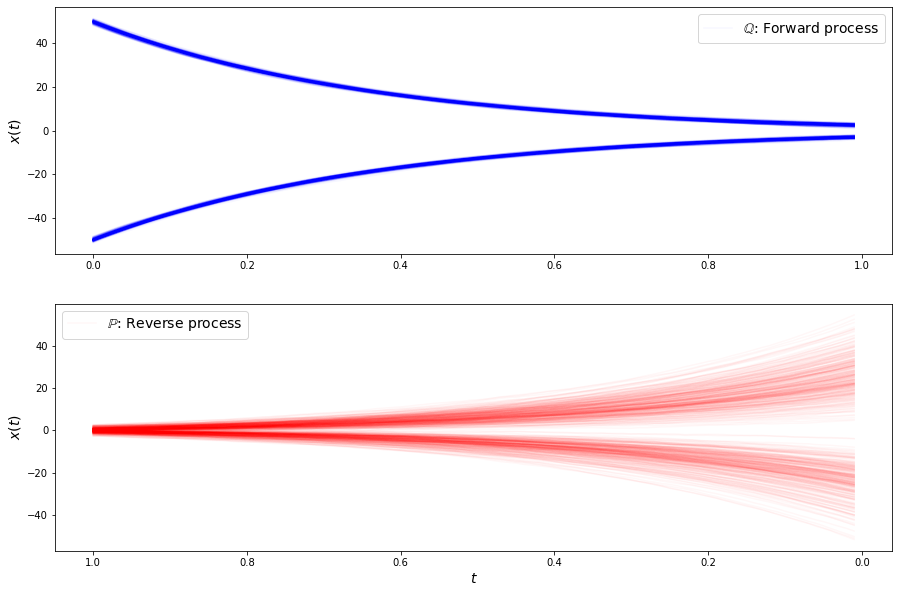

loss b 3.50502347946167
loss b 3.5714190006256104
loss b 3.504404067993164
loss b 3.5640175342559814
loss b 3.511720657348633
loss b 3.593766212463379
loss b 3.554853916168213
loss b 3.5465052127838135
loss b 3.6240150928497314
loss b 3.5093696117401123
loss b 3.532212257385254
loss b 3.4545040130615234
loss b 3.6124210357666016
loss b 3.4897141456604004
loss b 3.573134660720825
loss b 3.550232410430908
loss b 3.5694284439086914
loss b 3.519144296646118
loss b 3.581373453140259
loss b 3.570054054260254
loss b 3.5256340503692627
loss b 3.5985264778137207
loss f 7.394363880157471
loss f 7.547709941864014
loss f 7.233525276184082
loss f 7.593218803405762
loss f 7.436233043670654
loss f 7.466297626495361
loss f 7.454313278198242
loss f 7.3135271072387695
loss f 7.266695976257324
loss f 7.291591167449951
loss f 7.399023056030273
loss f 7.363577842712402
loss f 7.153794765472412
loss f 7.3691511154174805
loss f 7.42956018447876
loss f 7.470640182495117
loss f 7.478426933288574
loss f 7.33818

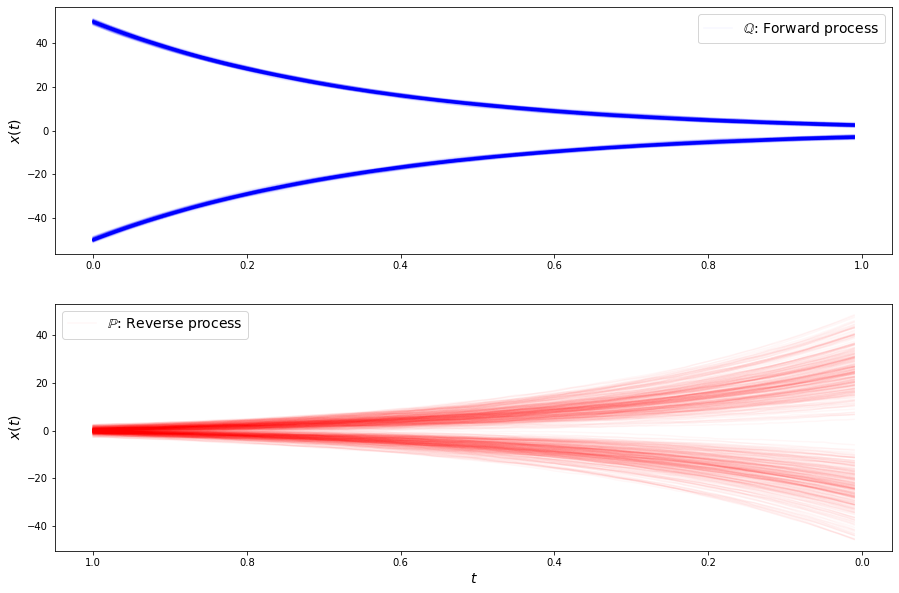

loss b 3.574242115020752
loss b 3.4954802989959717
loss b 3.6016652584075928
loss b 3.5790975093841553
loss b 3.5239696502685547
loss b 3.589768886566162
loss b 3.5500781536102295
loss b 3.488982915878296
loss b 3.551424264907837
loss b 3.5820014476776123
loss b 3.4885783195495605
loss b 3.4961655139923096
loss b 3.492151975631714
loss b 3.4745004177093506
loss b 3.4333274364471436
loss b 3.5015084743499756
loss b 3.5068390369415283
loss b 3.490055799484253
loss b 3.5175979137420654
loss b 3.477074146270752
loss b 3.5911388397216797
loss b 3.4339213371276855
loss f 7.1368303298950195
loss f 7.255232810974121
loss f 7.349520206451416
loss f 7.3559250831604
loss f 7.162360191345215
loss f 7.203272819519043
loss f 7.2293901443481445
loss f 7.36115837097168
loss f 7.313645362854004
loss f 7.340512275695801
loss f 7.332894802093506
loss f 7.166264533996582
loss f 7.518259525299072
loss f 7.418099880218506
loss f 7.352040767669678
loss f 7.180543422698975
loss f 7.207552433013916
loss f 7.30

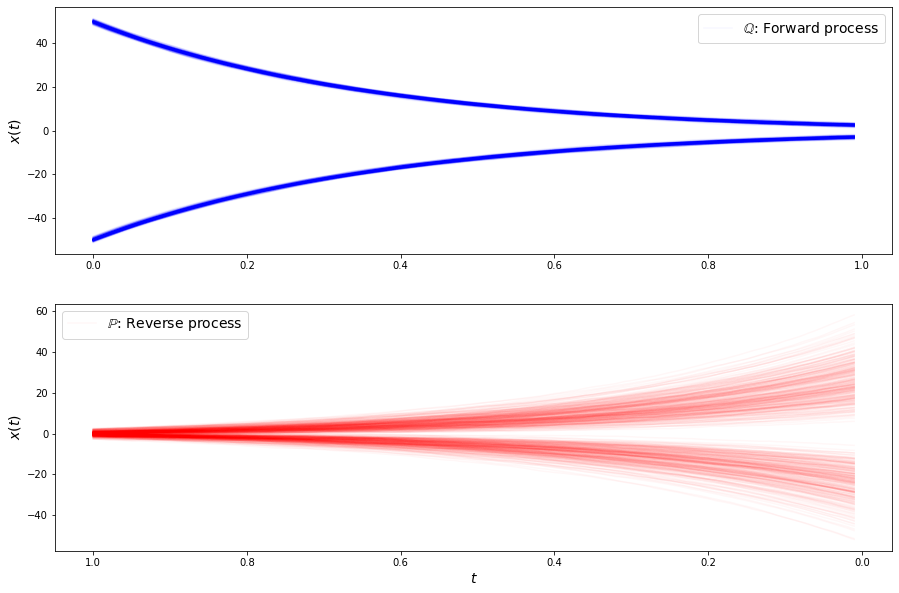

loss b 3.5922482013702393
loss b 3.559349536895752
loss b 3.404874563217163
loss b 3.4279634952545166
loss b 3.570207357406616
loss b 3.5076687335968018
loss b 3.4656639099121094
loss b 3.482283592224121
loss b 3.464860200881958
loss b 3.558546543121338
loss b 3.4460582733154297
loss b 3.57153058052063
loss b 3.48362135887146
loss b 3.532625913619995
loss b 3.5137884616851807
loss b 3.462635040283203
loss b 3.464322090148926
loss b 3.4700405597686768
loss b 3.599263906478882
loss b 3.594240427017212
loss b 3.4309256076812744
loss b 3.4853808879852295
loss f 7.092187881469727
loss f 7.183777332305908
loss f 7.5371928215026855
loss f 7.176174163818359
loss f 7.196231365203857
loss f 7.142173767089844
loss f 7.178411960601807
loss f 6.921757221221924
loss f 7.266441822052002
loss f 7.568558216094971
loss f 6.911564826965332
loss f 7.182068824768066
loss f 7.18806266784668
loss f 7.146390914916992
loss f 7.189967155456543
loss f 6.920444965362549
loss f 6.9675140380859375
loss f 7.38461494

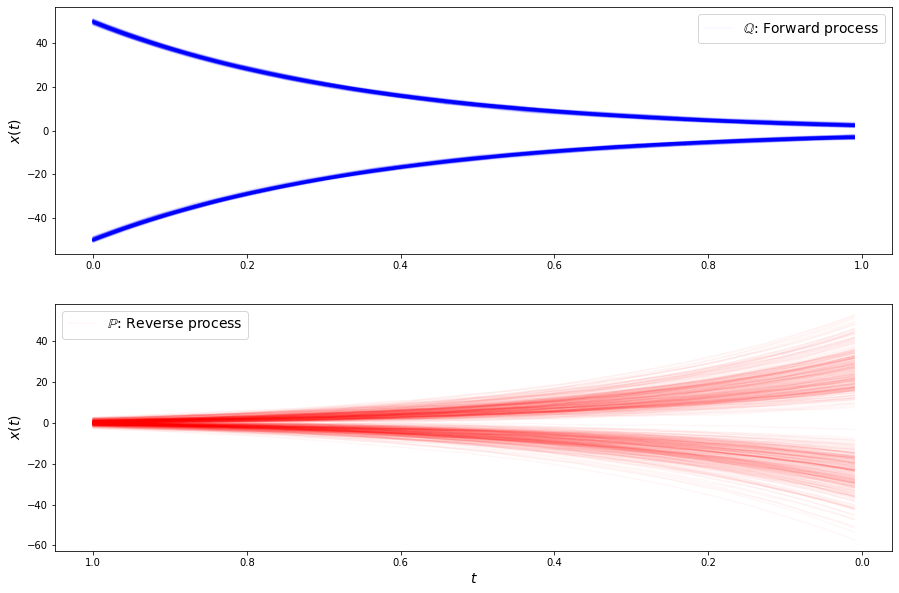

loss b 3.508838653564453
loss b 3.502078056335449
loss b 3.504897117614746
loss b 3.495525598526001
loss b 3.476916551589966
loss b 3.393022060394287
loss b 3.463782548904419
loss b 3.5385327339172363
loss b 3.4946436882019043
loss b 3.465456008911133
loss b 3.5094339847564697
loss b 3.4229226112365723
loss b 3.5707874298095703
loss b 3.4795455932617188
loss b 3.5161399841308594
loss b 3.4201149940490723
loss b 3.4599714279174805
loss b 3.4831795692443848
loss b 3.4481654167175293
loss b 3.507564067840576
loss b 3.4742050170898438
loss b 3.4627435207366943
loss f 7.188088893890381
loss f 7.039995193481445
loss f 6.920273780822754
loss f 6.705855846405029
loss f 7.008623123168945
loss f 7.074693202972412
loss f 7.142183780670166
loss f 7.094895362854004
loss f 6.95967435836792
loss f 7.148046016693115
loss f 7.03912878036499
loss f 6.947281837463379
loss f 7.01908016204834
loss f 7.124899387359619
loss f 7.079157829284668
loss f 7.1037068367004395
loss f 7.208374500274658
loss f 7.15131

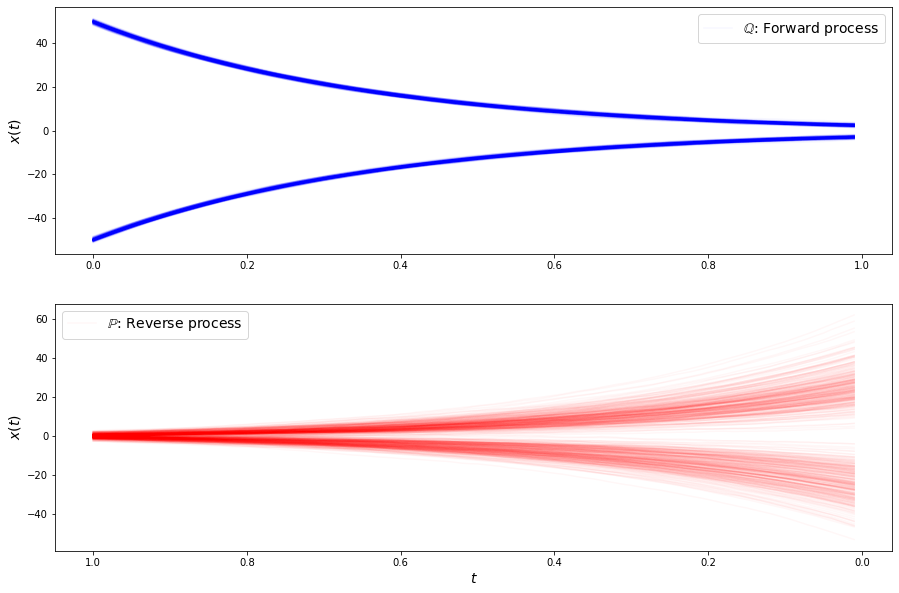

loss b 3.433603048324585
loss b 3.539743185043335
loss b 3.460297107696533
loss b 3.5067338943481445
loss b 3.4807276725769043
loss b 3.3893704414367676
loss b 3.465254306793213
loss b 3.4792592525482178
loss b 3.399785041809082
loss b 3.472111940383911
loss b 3.563190460205078
loss b 3.500392436981201
loss b 3.402526617050171
loss b 3.5304315090179443
loss b 3.422367572784424
loss b 3.4831724166870117
loss b 3.4250617027282715
loss b 3.4534385204315186
loss b 3.542344570159912
loss b 3.417008399963379
loss b 3.4773404598236084
loss b 3.456780433654785
loss f 7.01190710067749
loss f 6.72556209564209
loss f 6.901954650878906
loss f 6.787075996398926
loss f 7.020368576049805
loss f 7.159038066864014
loss f 6.8889899253845215
loss f 7.039562702178955
loss f 6.831172943115234
loss f 7.223020076751709
loss f 6.961043834686279
loss f 6.871009826660156
loss f 7.2332763671875
loss f 7.095002174377441
loss f 7.062784194946289
loss f 7.208512783050537
loss f 7.098934173583984
loss f 6.8673791885

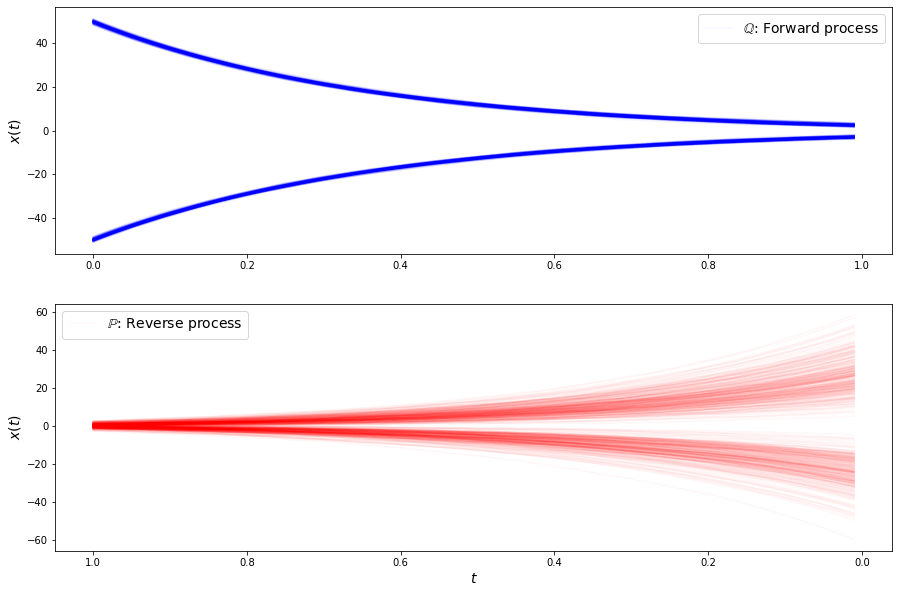

loss b 3.435513734817505
loss b 3.4161593914031982
loss b 3.4591665267944336
loss b 3.407186508178711
loss b 3.5035693645477295
loss b 3.4308979511260986
loss b 3.430694103240967
loss b 3.44755482673645
loss b 3.4092352390289307
loss b 3.4490737915039062
loss b 3.4372940063476562
loss b 3.3901920318603516
loss b 3.4522900581359863
loss b 3.5244221687316895
loss b 3.4924404621124268
loss b 3.471524715423584
loss b 3.474414110183716
loss b 3.415605068206787
loss b 3.5120205879211426
loss b 3.4666426181793213
loss b 3.4213309288024902
loss b 3.4376468658447266
loss f 6.906682968139648
loss f 7.091483116149902
loss f 7.03639030456543
loss f 6.896440029144287
loss f 6.897345066070557
loss f 6.727375030517578
loss f 6.880475044250488
loss f 7.157069206237793
loss f 6.705973148345947
loss f 6.743926048278809
loss f 6.673220157623291
loss f 6.710883617401123
loss f 6.966134071350098
loss f 6.968342304229736
loss f 6.91795015335083
loss f 6.883059501647949
loss f 6.957170009613037
loss f 6.6025

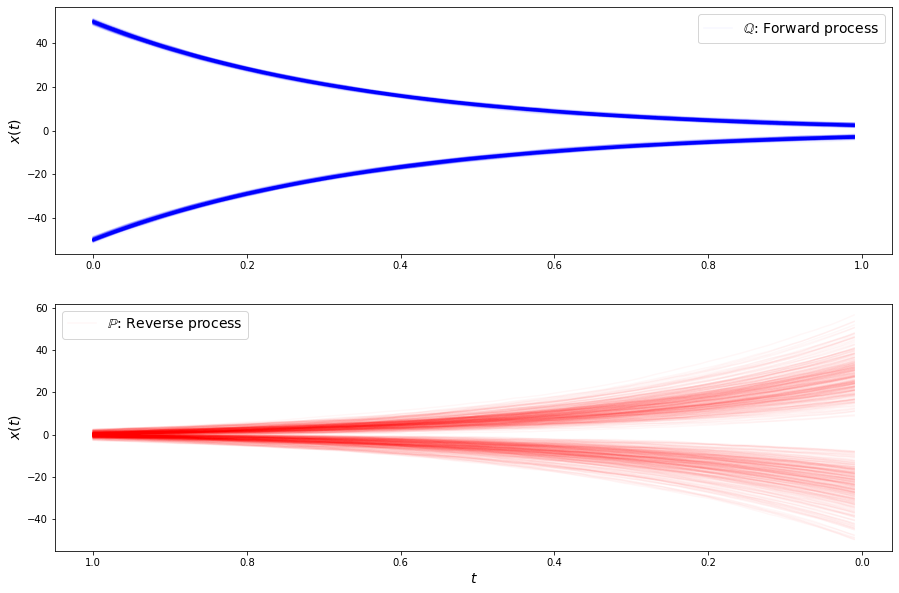

loss b 3.4277541637420654
loss b 3.4769744873046875
loss b 3.406343936920166
loss b 3.385741949081421
loss b 3.4503533840179443
loss b 3.3999080657958984
loss b 3.403252363204956
loss b 3.395970106124878
loss b 3.426481008529663
loss b 3.482245683670044
loss b 3.3688204288482666
loss b 3.2955830097198486
loss b 3.37984299659729
loss b 3.4096856117248535
loss b 3.4043095111846924
loss b 3.4634251594543457
loss b 3.459928035736084
loss b 3.460563898086548
loss b 3.4877960681915283
loss b 3.4449212551116943
loss b 3.4791877269744873
loss b 3.4310483932495117
loss f 6.789821624755859
loss f 6.887572288513184
loss f 6.946865081787109
loss f 6.9476447105407715
loss f 6.997448921203613
loss f 6.982301235198975
loss f 6.892683029174805
loss f 6.982682228088379
loss f 6.844419956207275
loss f 6.874675273895264
loss f 6.944289684295654
loss f 7.017092227935791
loss f 6.772290229797363
loss f 6.755837917327881
loss f 7.015340805053711
loss f 6.814915180206299
loss f 6.771101951599121
loss f 6.696

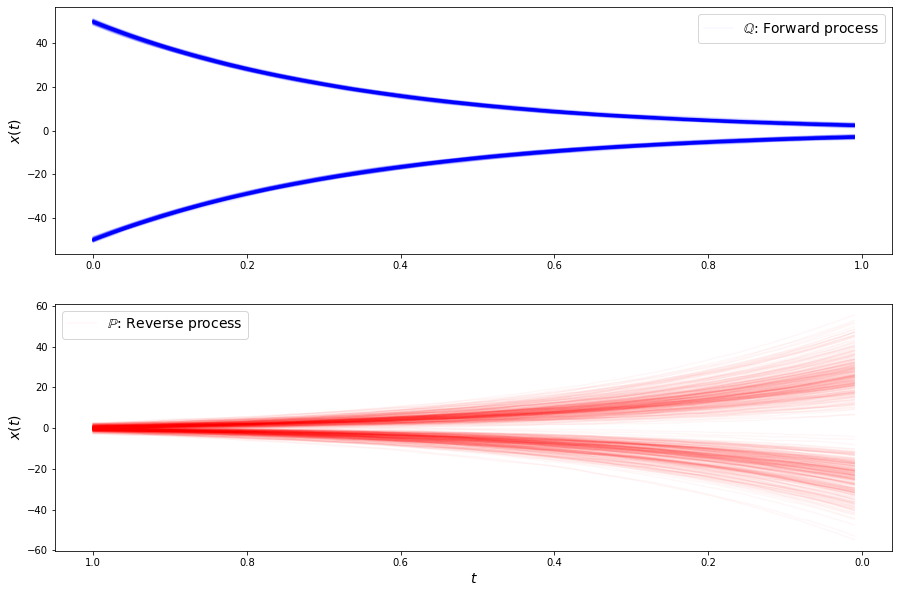

loss b 3.3210091590881348
loss b 3.4245388507843018
loss b 3.368116617202759
loss b 3.3625898361206055
loss b 3.3310115337371826
loss b 3.359196424484253
loss b 3.4291722774505615
loss b 3.3850350379943848
loss b 3.308034896850586
loss b 3.4172704219818115
loss b 3.4128239154815674
loss b 3.351217269897461
loss b 3.367231607437134
loss b 3.3000147342681885
loss b 3.457509994506836
loss b 3.4587974548339844
loss b 3.353835105895996
loss b 3.4274675846099854
loss b 3.355557918548584
loss b 3.2789180278778076
loss b 3.4488813877105713
loss b 3.4784095287323
loss f 6.8209710121154785
loss f 6.776126861572266
loss f 6.869964122772217
loss f 6.748962879180908
loss f 6.807107448577881
loss f 6.824522018432617
loss f 6.952706813812256
loss f 6.715421199798584
loss f 6.792471408843994
loss f 6.754169940948486
loss f 6.8660430908203125
loss f 6.696407794952393
loss f 6.645293235778809
loss f 6.77764368057251
loss f 6.652716636657715
loss f 6.66982364654541
loss f 6.802194118499756
loss f 6.93877

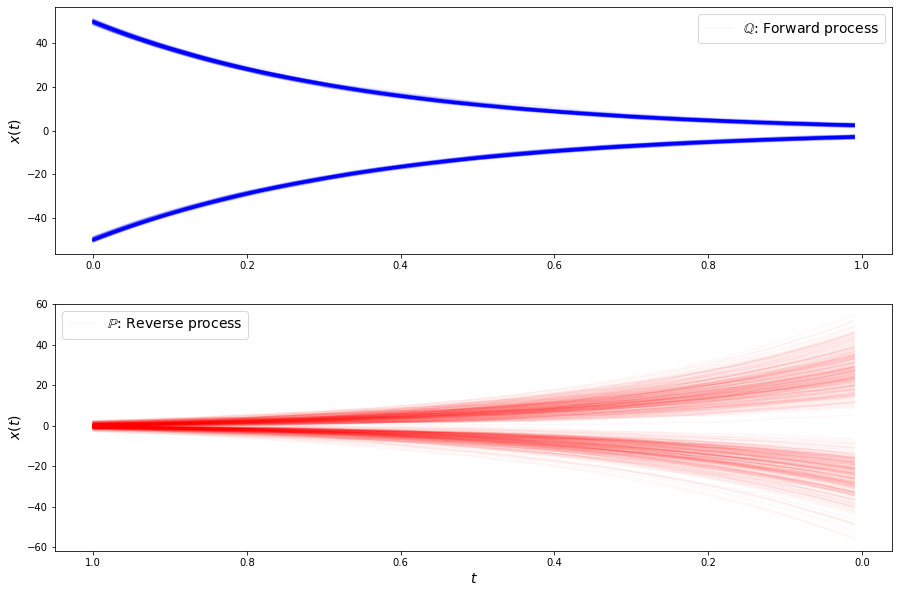

loss b 3.3452095985412598
loss b 3.3555994033813477
loss b 3.3887925148010254
loss b 3.3790574073791504
loss b 3.3935751914978027
loss b 3.4273900985717773
loss b 3.367793083190918
loss b 3.2951087951660156
loss b 3.378500461578369
loss b 3.3886053562164307
loss b 3.3640825748443604
loss b 3.384999990463257
loss b 3.3154590129852295
loss b 3.3286194801330566
loss b 3.304363250732422
loss b 3.3418734073638916
loss b 3.334723711013794
loss b 3.438649892807007
loss b 3.355511426925659
loss b 3.3267436027526855
loss b 3.3635623455047607
loss b 3.379073143005371
loss f 6.635497570037842
loss f 6.6113362312316895
loss f 6.578527927398682
loss f 6.779574871063232
loss f 6.870787143707275
loss f 6.609592914581299
loss f 6.750316143035889
loss f 6.83079719543457
loss f 6.966561794281006
loss f 6.546844482421875
loss f 6.820349216461182
loss f 6.811704158782959
loss f 6.700259208679199
loss f 6.8148322105407715
loss f 6.756499767303467
loss f 6.774679660797119
loss f 6.784159183502197
loss f 6.6

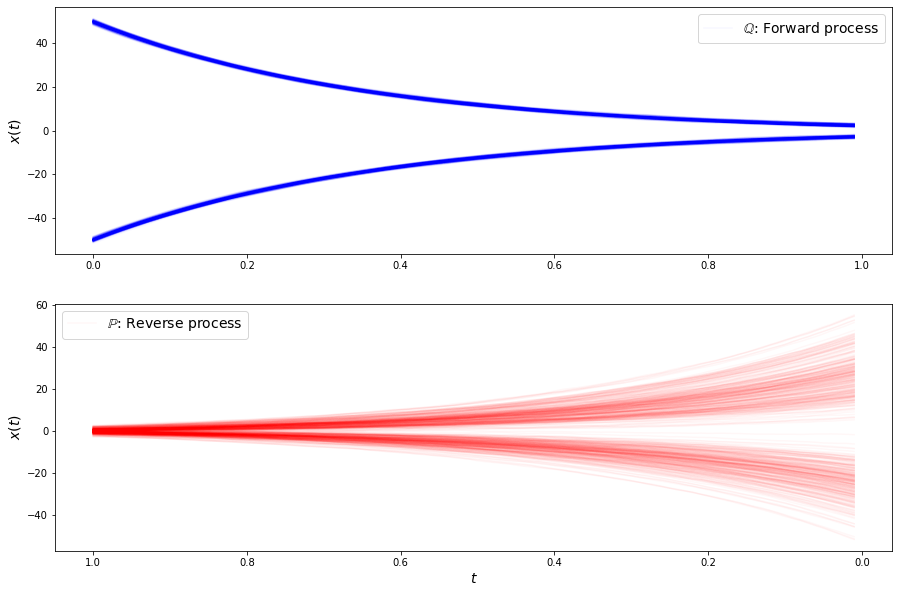

loss b 3.4328649044036865
loss b 3.3181259632110596
loss b 3.438464403152466
loss b 3.332911491394043
loss b 3.381495952606201
loss b 3.2902040481567383
loss b 3.35447096824646
loss b 3.3476459980010986
loss b 3.3405325412750244
loss b 3.3330934047698975
loss b 3.269200563430786
loss b 3.3156280517578125
loss b 3.2599735260009766
loss b 3.3627359867095947
loss b 3.4209084510803223
loss b 3.317431926727295
loss b 3.3834710121154785
loss b 3.3116822242736816
loss b 3.3138206005096436
loss b 3.346364974975586
loss b 3.2705929279327393
loss b 3.3209152221679688
loss f 6.527115821838379
loss f 6.8559980392456055
loss f 6.763912200927734
loss f 6.6808857917785645
loss f 6.608265399932861
loss f 6.618411064147949
loss f 6.7102460861206055
loss f 6.738228797912598
loss f 6.505248546600342
loss f 6.7558770179748535
loss f 6.589465141296387
loss f 6.611262321472168
loss f 6.561296463012695
loss f 6.636542797088623
loss f 6.610570430755615
loss f 6.722617149353027
loss f 6.77669620513916
loss f 6

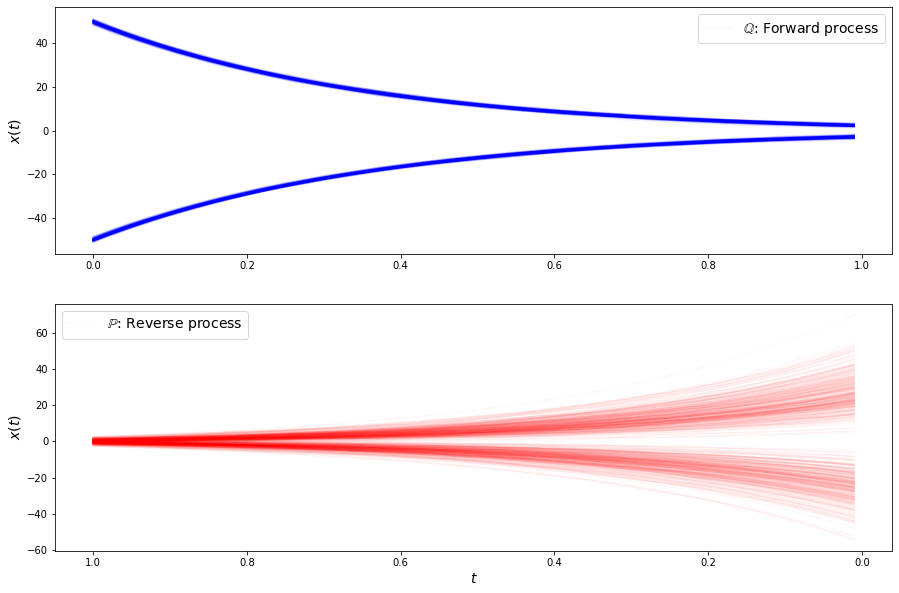

loss b 3.314053535461426
loss b 3.3211090564727783
loss b 3.234551429748535
loss b 3.270279884338379
loss b 3.3585519790649414
loss b 3.2933576107025146
loss b 3.3379321098327637
loss b 3.3339316844940186
loss b 3.307880401611328
loss b 3.1875245571136475
loss b 3.2034478187561035
loss b 3.2778871059417725
loss b 3.2880945205688477
loss b 3.318572521209717
loss b 3.2665085792541504
loss b 3.32391095161438
loss b 3.3113481998443604
loss b 3.3684706687927246
loss b 3.329540252685547
loss b 3.3821394443511963
loss b 3.34604811668396
loss b 3.3381385803222656
loss f 6.713436603546143
loss f 6.731856822967529
loss f 6.829876899719238
loss f 6.705377101898193
loss f 6.452464580535889
loss f 6.686180591583252
loss f 6.541752815246582
loss f 6.674431800842285
loss f 6.4894700050354
loss f 6.471277236938477
loss f 6.512895107269287
loss f 6.655477523803711
loss f 6.47730016708374
loss f 6.487198352813721
loss f 6.539053916931152
loss f 6.74009895324707
loss f 6.562701225280762
loss f 6.69797229

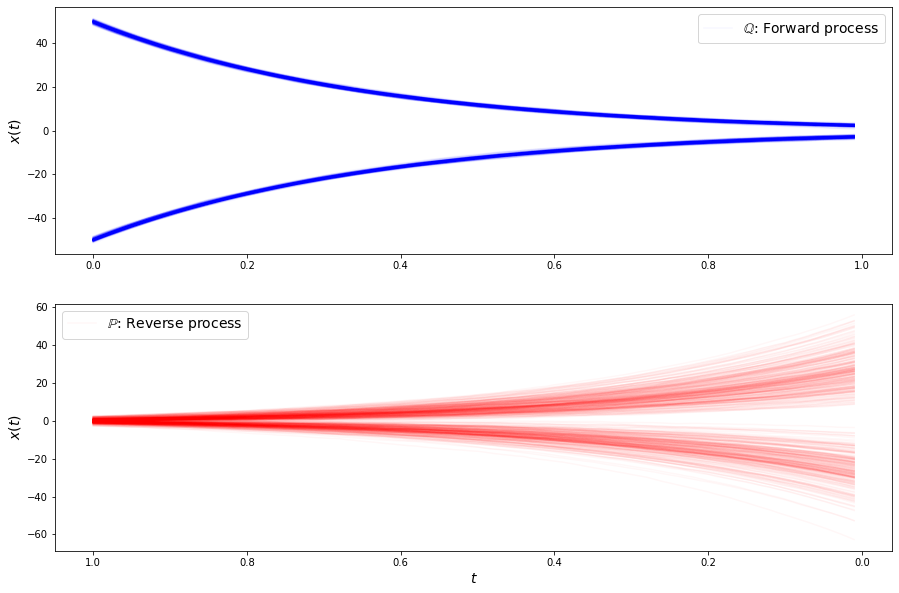

loss b 3.2812845706939697
loss b 3.276074171066284
loss b 3.293320655822754
loss b 3.353607416152954
loss b 3.2356815338134766
loss b 3.293437957763672
loss b 3.2236216068267822
loss b 3.364351511001587
loss b 3.2304065227508545
loss b 3.2465333938598633
loss b 3.3119335174560547
loss b 3.26882004737854
loss b 3.305415391921997
loss b 3.2423877716064453
loss b 3.3022286891937256
loss b 3.2956669330596924
loss b 3.2338502407073975
loss b 3.209494113922119
loss b 3.2860639095306396
loss b 3.393325090408325
loss b 3.286343812942505
loss b 3.232719898223877
loss f 6.535837173461914
loss f 6.599922180175781
loss f 6.560708045959473
loss f 6.586203098297119
loss f 6.491256237030029
loss f 6.5294718742370605
loss f 6.616989612579346
loss f 6.680895805358887
loss f 6.46100378036499
loss f 6.592347145080566
loss f 6.484245300292969
loss f 6.612814903259277
loss f 6.383471965789795
loss f 6.416553020477295
loss f 6.523274898529053
loss f 6.506310939788818
loss f 6.527894020080566
loss f 6.525136

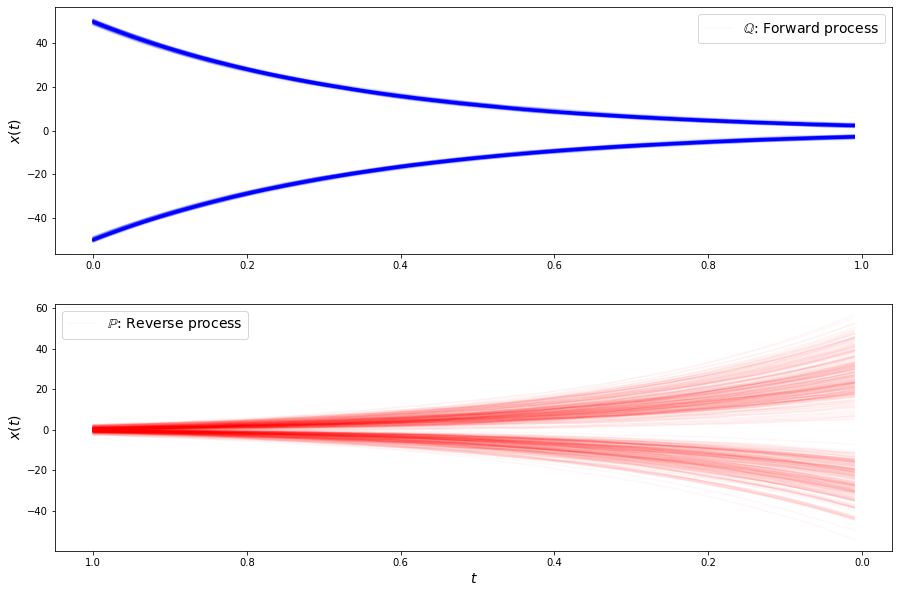

loss b 3.270142078399658
loss b 3.2612171173095703
loss b 3.346745491027832
loss b 3.2347846031188965
loss b 3.2024056911468506
loss b 3.2299654483795166
loss b 3.2952160835266113
loss b 3.2815463542938232
loss b 3.165198802947998
loss b 3.2831509113311768
loss b 3.228898763656616
loss b 3.251655101776123
loss b 3.2728111743927
loss b 3.2989656925201416
loss b 3.2113492488861084
loss b 3.2904629707336426
loss b 3.2951772212982178
loss b 3.31329083442688
loss b 3.3209826946258545
loss b 3.3000245094299316
loss b 3.263568162918091
loss b 3.220182418823242
loss f 6.474348068237305
loss f 6.329354286193848
loss f 6.41064977645874
loss f 6.2064528465271
loss f 6.665013790130615
loss f 6.52318000793457
loss f 6.788066864013672
loss f 6.509136199951172
loss f 6.439853191375732
loss f 6.468006134033203
loss f 6.335236072540283
loss f 6.355047702789307
loss f 6.39935302734375
loss f 6.693652629852295
loss f 6.581876277923584
loss f 6.289330005645752
loss f 6.708529949188232
loss f 6.36922597885

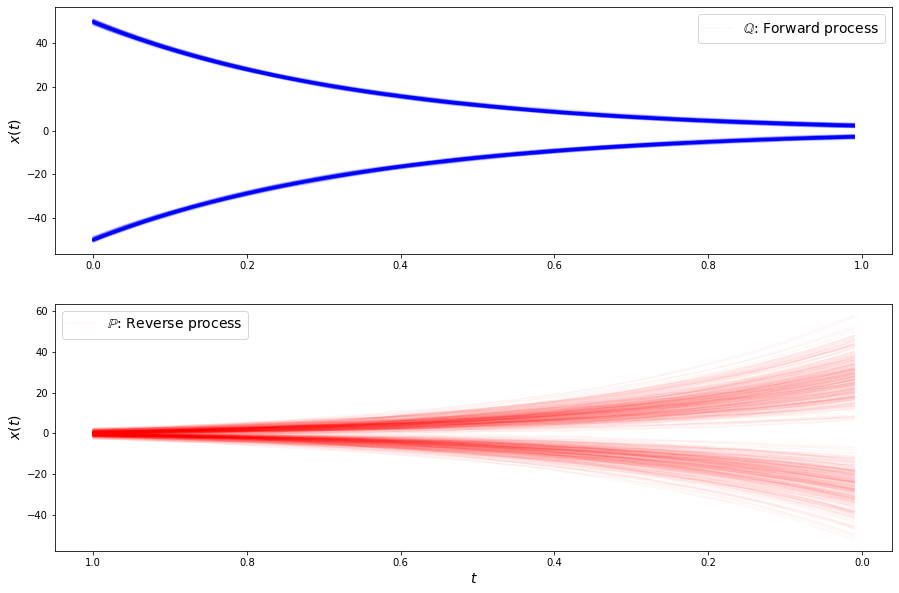

loss b 3.204557180404663
loss b 3.2030277252197266
loss b 3.201192617416382
loss b 3.2416205406188965
loss b 3.3090617656707764
loss b 3.2464098930358887
loss b 3.134456157684326
loss b 3.208033561706543
loss b 3.3444464206695557
loss b 3.241352081298828
loss b 3.1500234603881836
loss b 3.19944429397583
loss b 3.244910478591919
loss b 3.374464988708496
loss b 3.2983005046844482
loss b 3.1984548568725586
loss b 3.25998854637146
loss b 3.200594425201416
loss b 3.2535390853881836
loss b 3.257885456085205
loss b 3.264569044113159
loss b 3.2245118618011475
loss f 6.487600803375244
loss f 6.375943183898926
loss f 6.322735786437988
loss f 6.3670525550842285
loss f 6.255270957946777
loss f 6.308481216430664
loss f 6.381021022796631
loss f 6.399037837982178
loss f 6.339011192321777
loss f 6.336411476135254
loss f 6.458447456359863
loss f 6.390958786010742
loss f 6.458963871002197
loss f 6.410477638244629
loss f 6.406628131866455
loss f 6.364226341247559
loss f 6.4550299644470215
loss f 6.503811

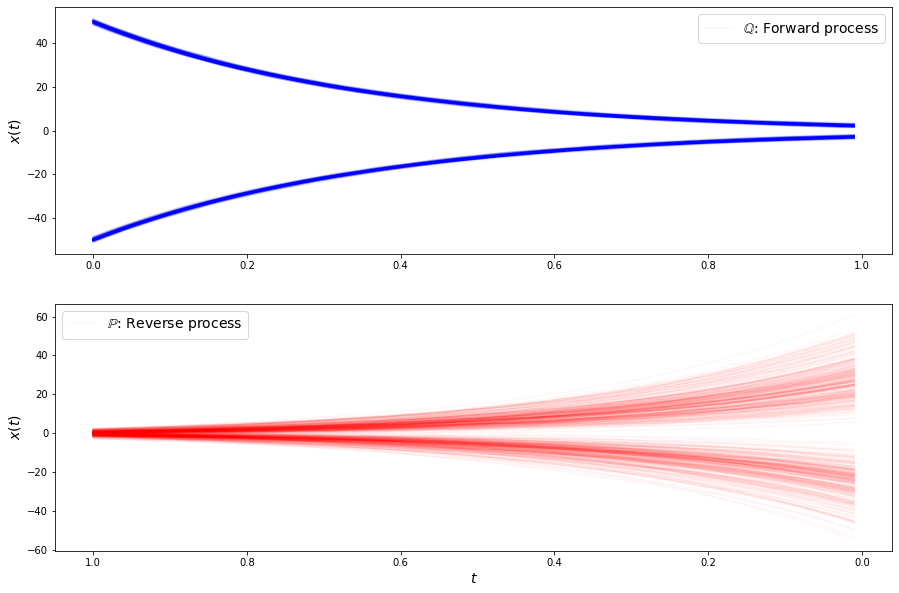

loss b 3.211679697036743
loss b 3.17197847366333
loss b 3.27056884765625
loss b 3.2223870754241943
loss b 3.1637425422668457
loss b 3.207732915878296
loss b 3.1958556175231934
loss b 3.2517800331115723
loss b 3.143118381500244
loss b 3.273071527481079
loss b 3.258554220199585
loss b 3.3081088066101074
loss b 3.195269823074341
loss b 3.189713478088379
loss b 3.2312605381011963
loss b 3.2579874992370605
loss b 3.2349929809570312
loss b 3.1631662845611572
loss b 3.1073529720306396
loss b 3.283651351928711
loss b 3.3216123580932617
loss b 3.191871404647827
loss f 6.342728137969971
loss f 6.530872344970703
loss f 6.236173152923584
loss f 6.450961112976074
loss f 6.107467174530029
loss f 6.289367198944092
loss f 6.3988871574401855
loss f 6.435069561004639
loss f 6.330338001251221
loss f 6.26391077041626
loss f 6.514316082000732
loss f 6.251630783081055
loss f 6.321715354919434
loss f 6.2858500480651855
loss f 6.390956878662109
loss f 6.2808518409729
loss f 6.481348037719727
loss f 6.34290981

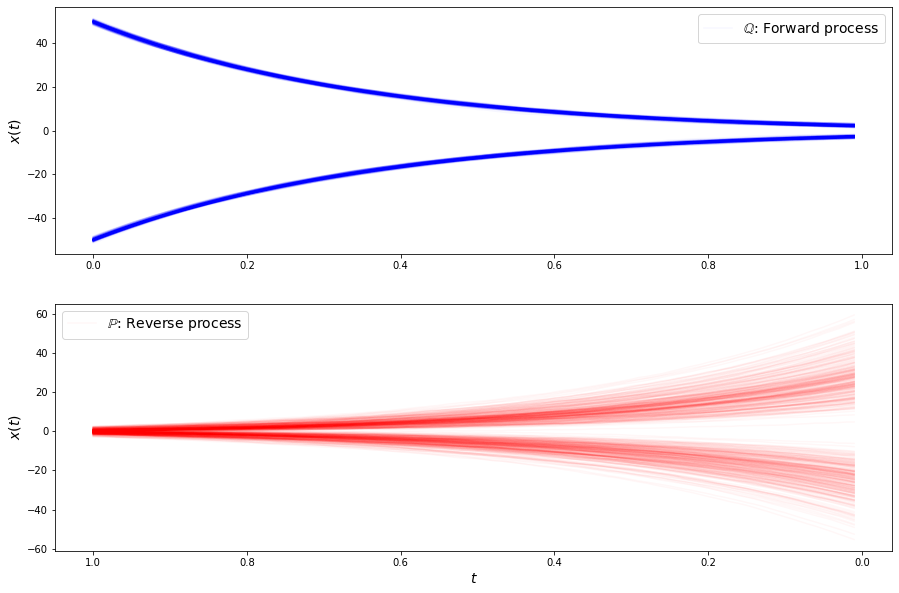

loss b 3.1814770698547363
loss b 3.1765389442443848
loss b 3.1481428146362305
loss b 3.2190101146698
loss b 3.2670745849609375
loss b 3.184678554534912
loss b 3.1325933933258057
loss b 3.2940526008605957
loss b 3.300981044769287
loss b 3.148658275604248
loss b 3.1672139167785645
loss b 3.226402997970581
loss b 3.267672061920166
loss b 3.153960704803467
loss b 3.1658520698547363
loss b 3.252995252609253
loss b 3.199130058288574
loss b 3.2005114555358887
loss b 3.2263879776000977
loss b 3.1384963989257812
loss b 3.275559902191162
loss b 3.2329165935516357
loss f 6.335779190063477
loss f 6.2750701904296875
loss f 6.224784851074219
loss f 6.463991641998291
loss f 6.324500560760498
loss f 6.344432830810547
loss f 6.420803070068359
loss f 6.33226203918457
loss f 6.3207597732543945
loss f 6.282834053039551
loss f 6.359646797180176
loss f 6.397418975830078
loss f 6.301708221435547
loss f 6.423758029937744
loss f 6.344686985015869
loss f 6.395654201507568
loss f 6.378260612487793
loss f 6.17337

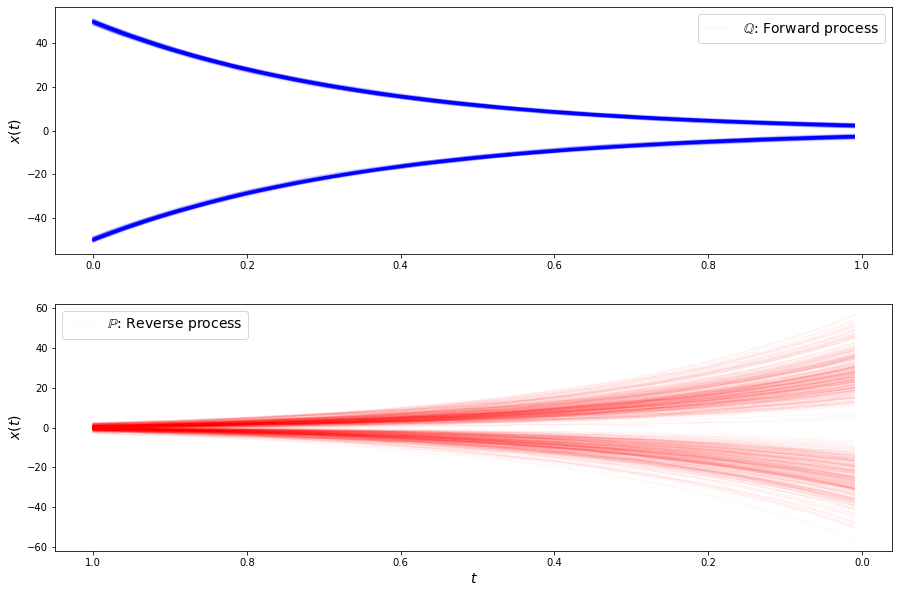

loss b 3.172895669937134
loss b 3.272536277770996
loss b 3.1744132041931152
loss b 3.1666207313537598
loss b 3.2226181030273438
loss b 3.2027170658111572
loss b 3.1044955253601074
loss b 3.1794328689575195
loss b 3.1721954345703125
loss b 3.2143735885620117
loss b 3.161311388015747
loss b 3.1986074447631836
loss b 3.250279426574707
loss b 3.162738561630249
loss b 3.143805503845215
loss b 3.2154035568237305
loss b 3.333172082901001
loss b 3.1234939098358154
loss b 3.152526617050171
loss b 3.116276979446411
loss b 3.2148454189300537
loss b 3.242354154586792
loss f 6.230342388153076
loss f 6.28536319732666
loss f 6.473710060119629
loss f 6.296926975250244
loss f 6.360506057739258
loss f 6.266135215759277
loss f 6.083841800689697
loss f 6.224735736846924
loss f 6.169379234313965
loss f 6.413880825042725
loss f 6.075860977172852
loss f 6.128530025482178
loss f 6.291566848754883
loss f 6.274409770965576
loss f 6.293488025665283
loss f 6.154570579528809
loss f 6.315893173217773
loss f 6.21563

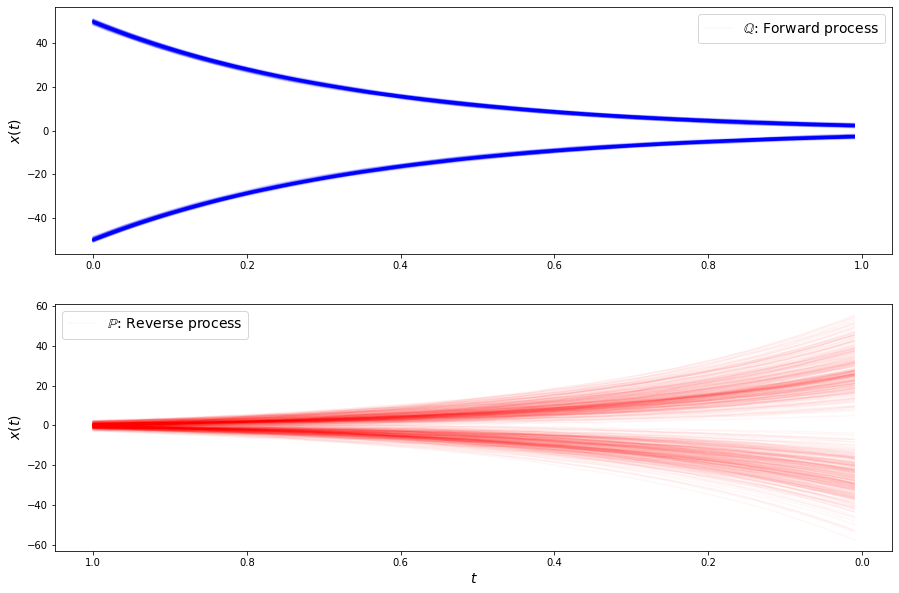

loss b 3.068408250808716
loss b 3.143618106842041
loss b 3.1479570865631104
loss b 3.175753593444824
loss b 3.1200075149536133
loss b 3.1947855949401855
loss b 3.143547534942627
loss b 3.21087646484375
loss b 3.207136392593384
loss b 3.180687189102173
loss b 3.2546205520629883
loss b 3.169719934463501
loss b 3.1908559799194336
loss b 3.1243724822998047
loss b 3.1436827182769775
loss b 3.179619789123535
loss b 3.202880382537842
loss b 3.15950345993042
loss b 3.1604480743408203
loss b 3.1654255390167236
loss b 3.2174785137176514
loss b 3.1675970554351807
loss f 6.146145820617676
loss f 6.306460857391357
loss f 6.162538051605225
loss f 6.3086018562316895
loss f 6.29154109954834
loss f 6.168705940246582
loss f 6.177364826202393
loss f 6.1358442306518555
loss f 6.196579933166504
loss f 6.239538192749023
loss f 6.336000919342041
loss f 6.080904006958008
loss f 6.314077377319336
loss f 6.151732921600342
loss f 6.082262992858887
loss f 6.193993091583252
loss f 6.28715705871582
loss f 6.0122032

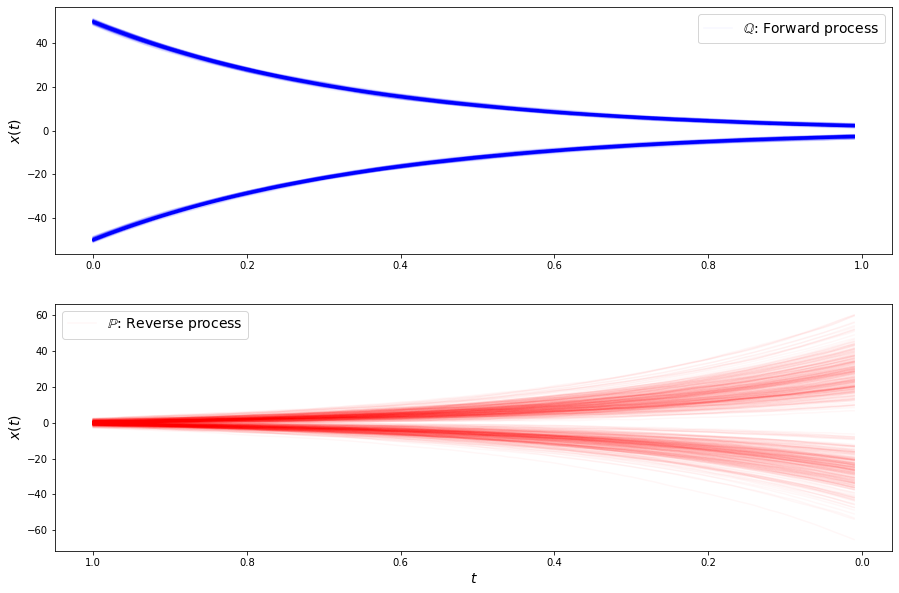

loss b 3.127485990524292
loss b 3.048447847366333
loss b 3.1483750343322754
loss b 3.1481149196624756
loss b 3.035659074783325
loss b 3.058204412460327
loss b 3.182670831680298
loss b 3.1537160873413086
loss b 3.0474634170532227
loss b 3.078697443008423
loss b 3.102621078491211
loss b 3.1542723178863525
loss b 3.1541996002197266
loss b 3.1418569087982178
loss b 3.172402858734131
loss b 3.102583885192871
loss b 3.149420976638794
loss b 3.143946886062622
loss b 3.1555545330047607
loss b 3.1335020065307617
loss b 3.1324119567871094
loss b 3.095776319503784
loss f 6.049817085266113
loss f 6.303348064422607
loss f 6.061885356903076
loss f 6.168242931365967
loss f 6.4265875816345215
loss f 6.035385608673096
loss f 6.103604793548584
loss f 6.206349849700928
loss f 6.235236644744873
loss f 6.144094944000244
loss f 6.09800910949707
loss f 6.155763149261475
loss f 6.29069709777832
loss f 6.181499004364014
loss f 6.068565845489502
loss f 6.110021591186523
loss f 6.095901966094971
loss f 6.0879421

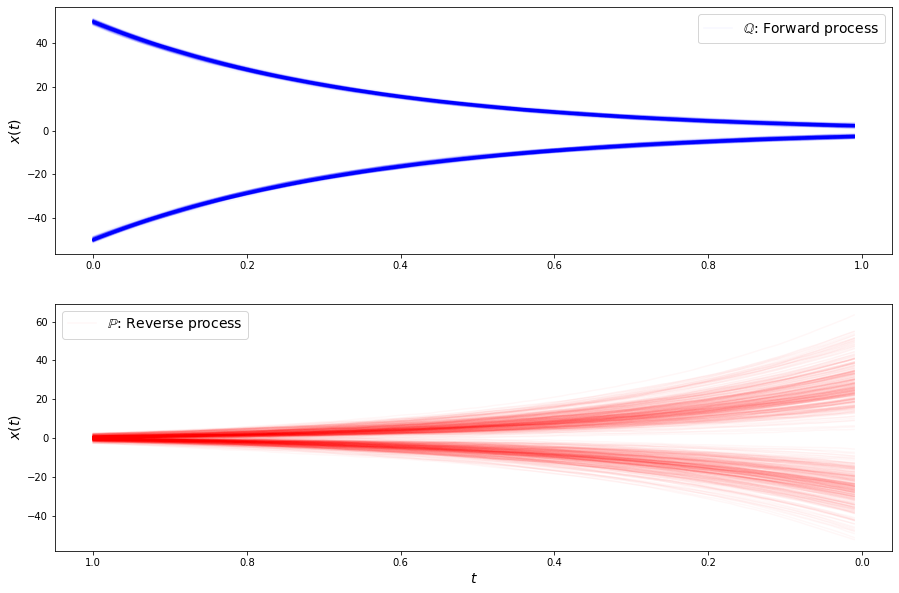

loss b 3.0373973846435547
loss b 3.1667394638061523
loss b 3.162071943283081
loss b 3.204594135284424
loss b 3.200087308883667
loss b 3.132232189178467
loss b 3.126023292541504
loss b 3.006988525390625
loss b 3.1172540187835693
loss b 3.0962135791778564
loss b 3.119093418121338
loss b 3.047358751296997
loss b 3.1077585220336914
loss b 3.1695029735565186
loss b 3.0677576065063477
loss b 3.0735275745391846
loss b 3.1947219371795654
loss b 3.090256929397583
loss b 3.151409387588501
loss b 3.0765984058380127
loss b 3.1345975399017334
loss b 2.9900856018066406
loss f 6.116666316986084
loss f 6.287525177001953
loss f 6.093688011169434
loss f 6.322495937347412
loss f 5.994331359863281
loss f 6.069727420806885
loss f 6.18717098236084
loss f 6.115504264831543
loss f 6.119034767150879
loss f 6.06984806060791
loss f 6.014979362487793
loss f 6.009589195251465
loss f 6.164289951324463
loss f 6.192039489746094
loss f 6.225977897644043
loss f 6.012131214141846
loss f 6.265093803405762
loss f 6.014758

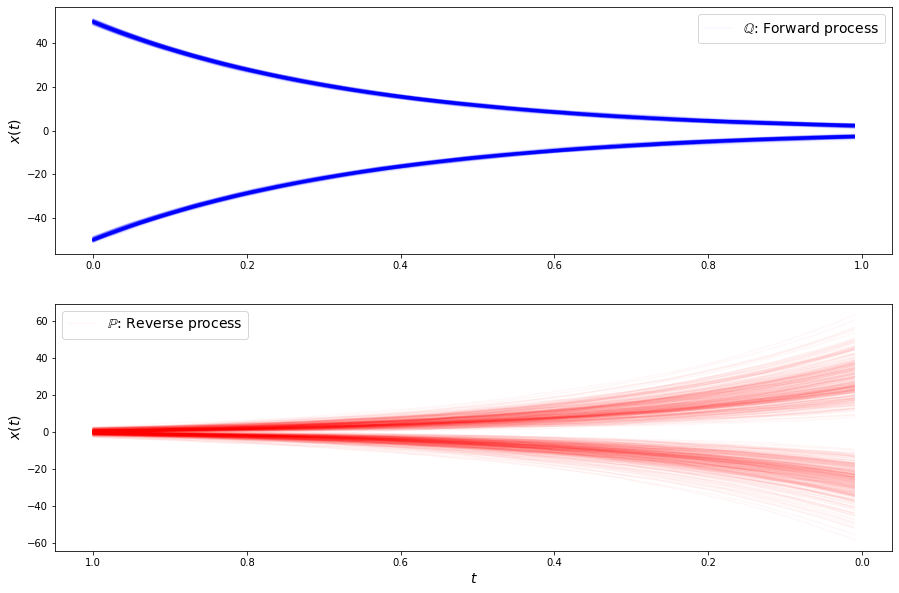

loss b 3.0360350608825684
loss b 3.148768901824951
loss b 3.0896010398864746
loss b 3.1493067741394043
loss b 3.107442617416382
loss b 3.0260009765625
loss b 3.0843732357025146
loss b 3.1507883071899414
loss b 3.0997557640075684
loss b 3.1734554767608643
loss b 3.0618138313293457
loss b 3.133718967437744
loss b 3.1209731101989746
loss b 3.182980537414551
loss b 3.136091709136963
loss b 3.163653612136841
loss b 3.131777048110962
loss b 3.094158887863159
loss b 3.1094133853912354
loss b 3.0890345573425293
loss b 3.0936520099639893
loss b 3.010558605194092
loss f 6.155311584472656
loss f 6.005619049072266
loss f 5.930119514465332
loss f 6.2475810050964355
loss f 5.988583087921143
loss f 6.258349418640137
loss f 6.3354315757751465
loss f 6.124726295471191
loss f 6.108482360839844
loss f 6.043455123901367
loss f 6.1838788986206055
loss f 6.173792362213135
loss f 6.019009113311768
loss f 5.946599960327148
loss f 6.123661041259766
loss f 6.09787130355835
loss f 6.1275153160095215
loss f 6.210

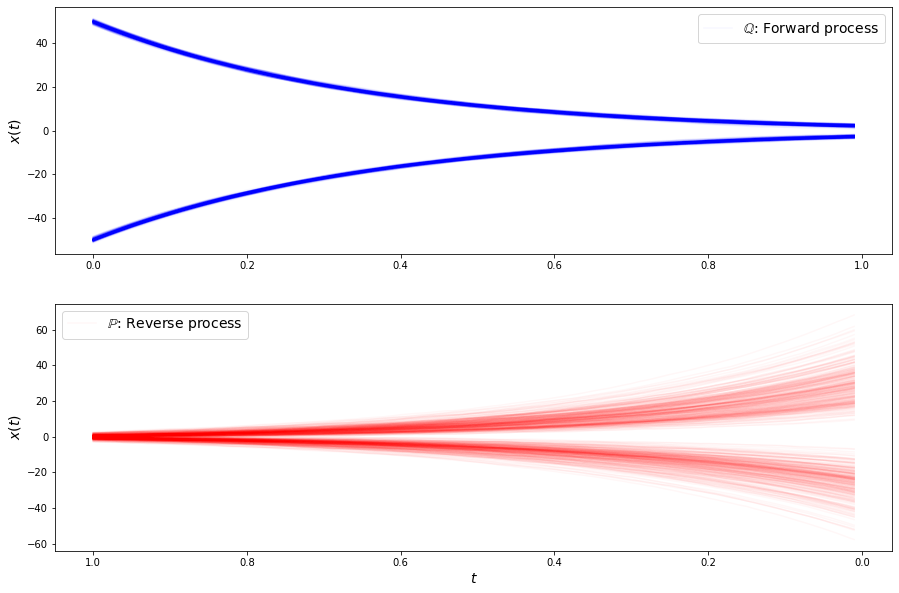

loss b 3.0951218605041504
loss b 3.0936126708984375
loss b 3.0579545497894287
loss b 3.1312060356140137
loss b 3.147165060043335
loss b 3.13614559173584
loss b 3.042072057723999
loss b 2.997947931289673
loss b 3.0250918865203857
loss b 3.1017191410064697
loss b 3.0985770225524902
loss b 2.996917486190796
loss b 3.042306423187256
loss b 3.128591537475586
loss b 2.996016025543213
loss b 3.103701591491699
loss b 3.126744270324707
loss b 2.994858503341675
loss b 3.1179537773132324
loss b 2.9802334308624268
loss b 3.1881039142608643
loss b 3.0094525814056396
loss f 6.0212273597717285
loss f 5.845513820648193
loss f 6.191153526306152
loss f 6.081873893737793
loss f 6.098602771759033
loss f 6.157299041748047
loss f 6.0174880027771
loss f 6.076374053955078
loss f 5.844920635223389
loss f 5.928797721862793
loss f 5.916460990905762
loss f 5.955556869506836
loss f 6.047245025634766
loss f 6.08045768737793
loss f 5.868218898773193
loss f 6.070648193359375
loss f 6.018057346343994
loss f 5.98633289

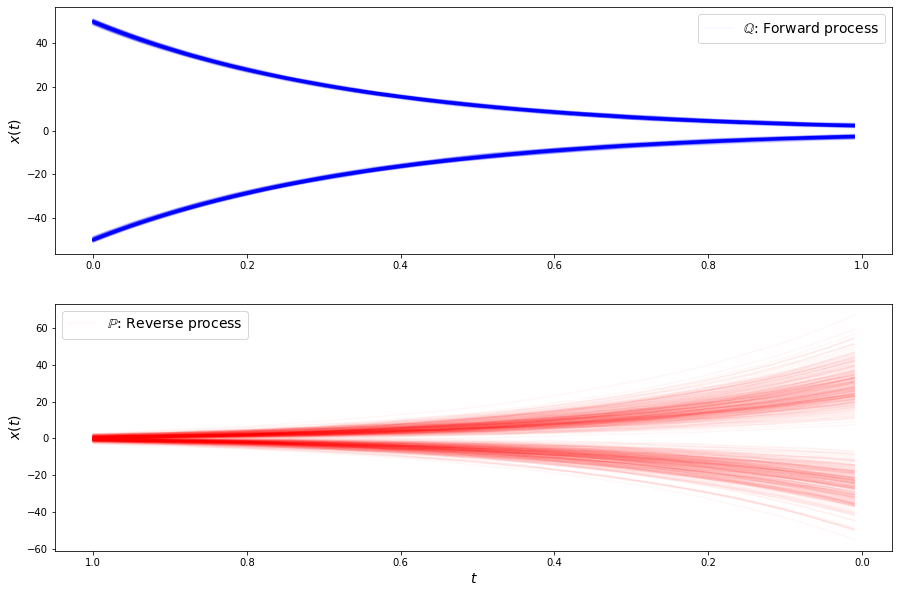

loss b 2.9625256061553955
loss b 3.039638042449951
loss b 2.9394776821136475
loss b 3.016745090484619
loss b 2.998887062072754
loss b 3.0641090869903564
loss b 3.1022415161132812
loss b 3.1053571701049805
loss b 2.954526901245117
loss b 3.098423480987549
loss b 3.093360424041748
loss b 3.0775351524353027
loss b 3.0328257083892822
loss b 3.0821750164031982
loss b 3.1059417724609375
loss b 3.023481607437134
loss b 3.0897934436798096
loss b 3.082724094390869
loss b 3.1019327640533447
loss b 3.0995709896087646
loss b 3.0058724880218506
loss b 3.0988078117370605
loss f 5.948005676269531
loss f 5.998456954956055
loss f 5.969810485839844
loss f 6.041554927825928
loss f 5.978374004364014
loss f 6.076438903808594
loss f 5.934062957763672
loss f 6.1463165283203125
loss f 5.882404804229736
loss f 5.951485633850098
loss f 5.940824031829834
loss f 6.02439022064209
loss f 6.004233360290527
loss f 5.974552631378174
loss f 5.814691066741943
loss f 6.022993087768555
loss f 6.187352180480957
loss f 5.94

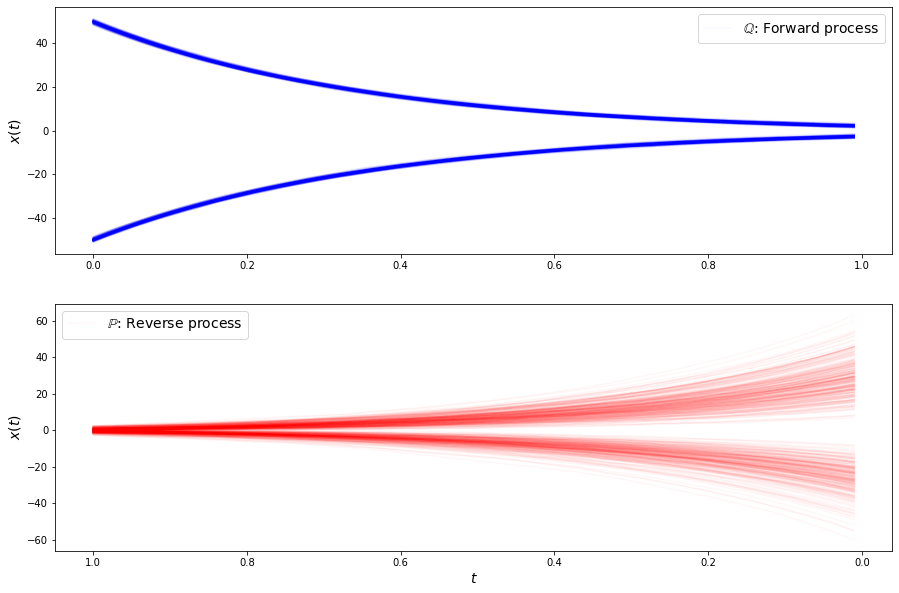

loss b 3.1234569549560547
loss b 2.9684064388275146
loss b 3.037231206893921
loss b 3.1371240615844727
loss b 3.0336310863494873
loss b 3.063608407974243
loss b 3.118013381958008
loss b 2.964853525161743
loss b 3.0121514797210693
loss b 3.042924642562866
loss b 3.007939577102661
loss b 2.9713544845581055
loss b 2.9869675636291504
loss b 3.0053083896636963
loss b 2.958103656768799
loss b 3.0028269290924072
loss b 2.894571304321289
loss b 3.0359740257263184
loss b 3.0197250843048096
loss b 3.0464253425598145
loss b 3.01503849029541
loss b 3.028975009918213
loss f 5.956363201141357
loss f 5.928940296173096
loss f 6.019773960113525
loss f 6.002097129821777
loss f 5.8466339111328125
loss f 5.894696235656738
loss f 5.9434099197387695
loss f 5.994396209716797
loss f 5.863403797149658
loss f 5.820499897003174
loss f 6.08675479888916
loss f 5.996310234069824
loss f 5.909021854400635
loss f 5.85351037979126
loss f 6.020410060882568
loss f 5.897088050842285
loss f 6.0212883949279785
loss f 5.8626

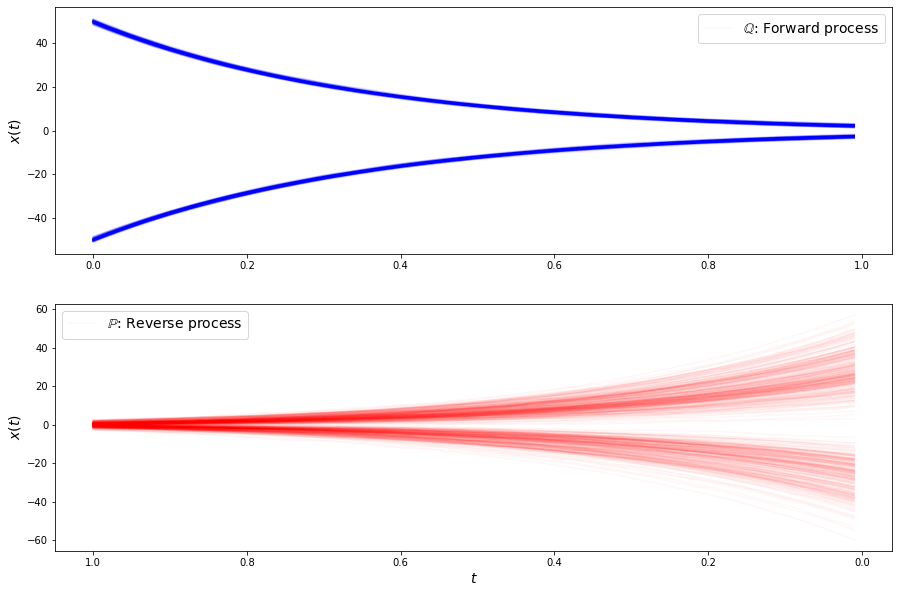

loss b 3.026364326477051
loss b 3.1197235584259033
loss b 2.9603424072265625
loss b 3.025542736053467
loss b 3.007538080215454
loss b 2.9646525382995605
loss b 3.028879404067993
loss b 3.0348260402679443
loss b 2.99629807472229
loss b 3.0446596145629883
loss b 3.0085105895996094
loss b 3.049147367477417
loss b 3.072050094604492
loss b 3.0715956687927246
loss b 2.967393159866333
loss b 3.005282402038574
loss b 3.0234010219573975
loss b 3.051227569580078
loss b 2.9829580783843994
loss b 3.0062625408172607
loss b 2.9808599948883057
loss b 3.0146915912628174
loss f 5.82615852355957
loss f 5.838645935058594
loss f 5.904141902923584
loss f 5.883833885192871
loss f 6.035926818847656
loss f 5.965829849243164
loss f 5.875208854675293
loss f 5.901519775390625
loss f 6.105717182159424
loss f 5.926568984985352
loss f 5.850691795349121
loss f 5.926633834838867
loss f 5.826404571533203
loss f 5.798669338226318
loss f 5.917941093444824
loss f 5.945838928222656
loss f 5.778350830078125
loss f 5.924777

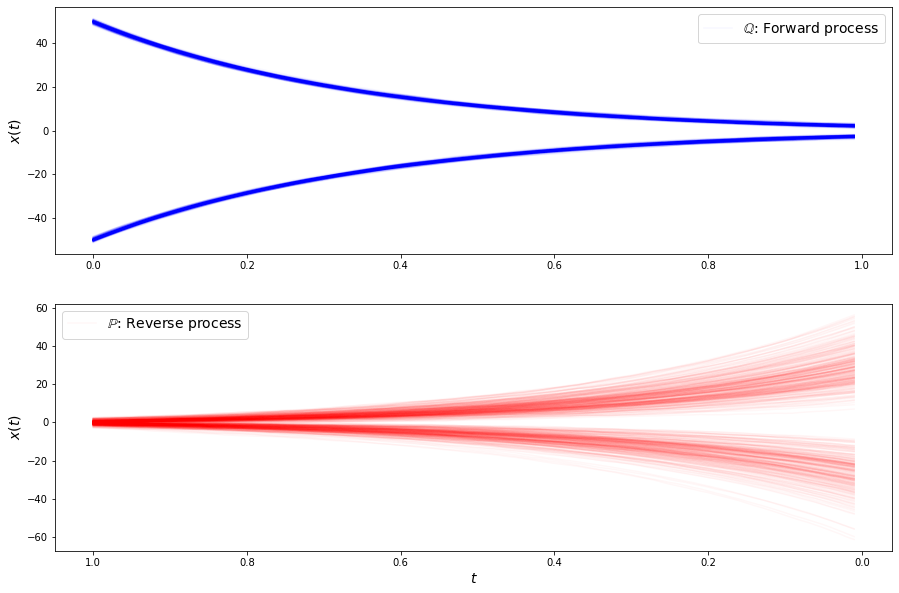

loss b 2.853832721710205
loss b 3.0145037174224854
loss b 3.009429931640625
loss b 2.9823296070098877
loss b 3.0453906059265137
loss b 2.9743080139160156
loss b 2.97440505027771
loss b 3.0727617740631104
loss b 2.927649974822998
loss b 3.015671968460083
loss b 2.977715015411377
loss b 3.0507423877716064
loss b 2.9705820083618164
loss b 2.905806303024292
loss b 2.973313331604004
loss b 3.0291643142700195
loss b 3.075742721557617
loss b 2.9561660289764404
loss b 3.009775400161743
loss b 2.938664436340332
loss b 3.0377509593963623
loss b 3.017888069152832
loss f 5.933503150939941
loss f 5.919517517089844
loss f 5.839921474456787
loss f 6.0213799476623535
loss f 5.8364949226379395
loss f 5.8603949546813965
loss f 5.764338970184326
loss f 6.026961326599121
loss f 5.875328063964844
loss f 5.954573154449463
loss f 5.841339588165283
loss f 5.984310626983643
loss f 5.870406150817871
loss f 5.913102149963379
loss f 5.8349480628967285
loss f 5.802339553833008
loss f 5.753598213195801
loss f 5.793

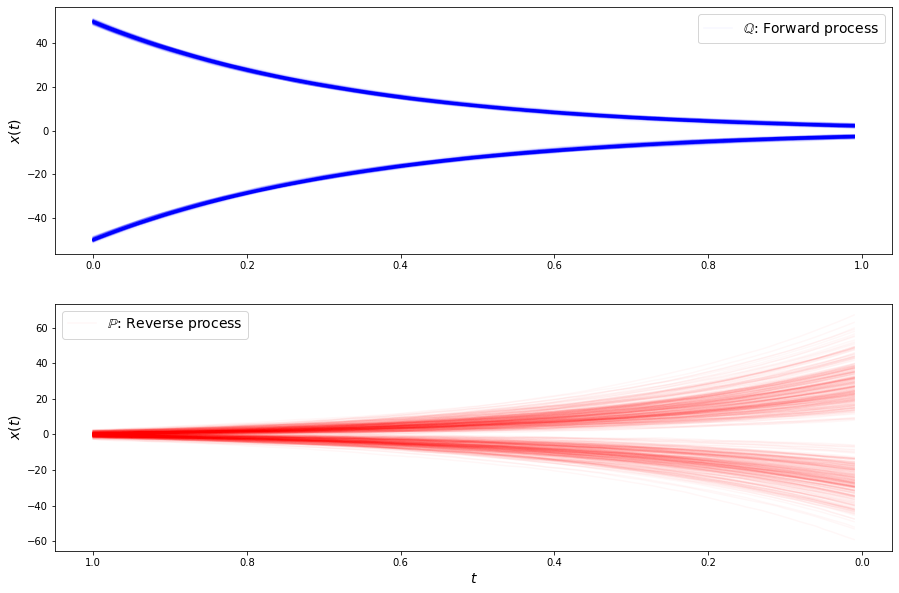

loss b 2.9718706607818604
loss b 2.9510598182678223
loss b 2.9495086669921875
loss b 2.9826583862304688
loss b 3.0009829998016357
loss b 2.9921343326568604
loss b 2.935326099395752
loss b 2.9906415939331055
loss b 3.003504514694214
loss b 2.9490625858306885
loss b 2.9757914543151855
loss b 2.979417085647583
loss b 2.8853931427001953
loss b 3.0242581367492676
loss b 2.9058146476745605
loss b 2.9446370601654053
loss b 3.017998695373535
loss b 2.8841750621795654
loss b 2.94218373298645
loss b 2.977741003036499
loss b 2.931032419204712
loss b 3.0009500980377197
loss f 5.803046226501465
loss f 5.869239330291748
loss f 5.850532531738281
loss f 6.032766819000244
loss f 5.778073787689209
loss f 6.0046892166137695
loss f 5.9337592124938965
loss f 5.759761810302734
loss f 5.757183074951172
loss f 5.813502788543701
loss f 5.779935836791992
loss f 5.842388153076172
loss f 5.808137893676758
loss f 5.94648551940918
loss f 5.919519901275635
loss f 5.872183322906494
loss f 5.831536769866943
loss f 5.7

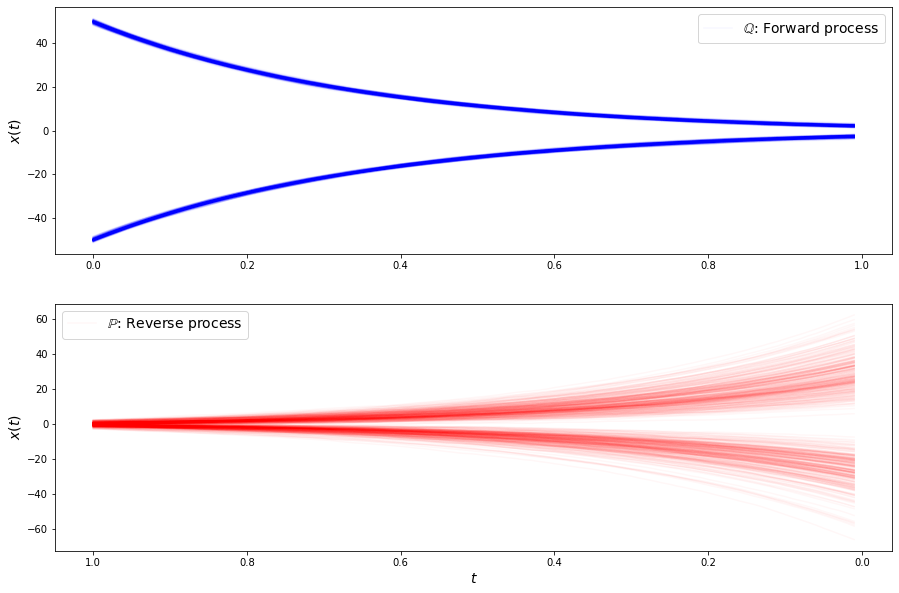

loss b 2.9713945388793945
loss b 2.9821109771728516
loss b 2.884620428085327
loss b 2.9626095294952393
loss b 2.942188024520874
loss b 2.971266031265259
loss b 2.878840923309326
loss b 2.9282479286193848
loss b 3.0347321033477783
loss b 2.987813711166382
loss b 2.8718833923339844
loss b 2.952320098876953
loss b 2.8095459938049316
loss b 2.8601834774017334
loss b 2.9740710258483887
loss b 3.009364604949951
loss b 2.920604944229126
loss b 2.861147165298462
loss b 3.0145719051361084
loss b 2.8521931171417236
loss b 2.984328508377075
loss b 2.9866905212402344
loss f 5.777779579162598
loss f 5.846103191375732
loss f 5.937315940856934
loss f 5.72249698638916
loss f 5.93816614151001
loss f 5.899766445159912
loss f 5.931033134460449
loss f 5.777164936065674
loss f 6.057666778564453
loss f 5.9220099449157715
loss f 5.726532936096191
loss f 5.825250148773193
loss f 5.784242153167725
loss f 5.756842613220215
loss f 5.815803527832031
loss f 5.839086532592773
loss f 5.665627479553223
loss f 5.92541

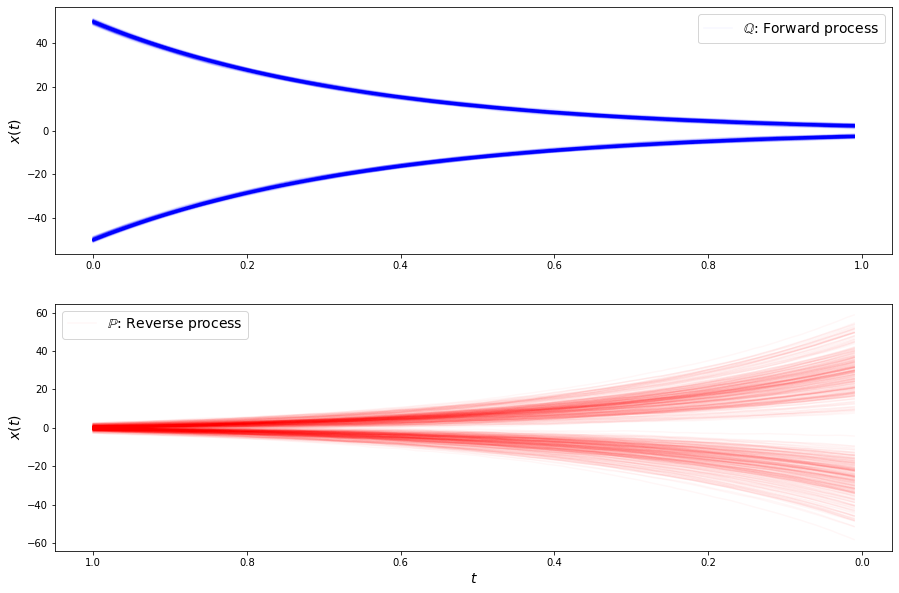

loss b 2.8821635246276855
loss b 2.9083051681518555
loss b 2.8537490367889404
loss b 2.933095693588257
loss b 2.9653408527374268
loss b 2.894512891769409
loss b 2.939974546432495
loss b 2.972665548324585
loss b 2.869880437850952
loss b 2.8700506687164307
loss b 2.9413270950317383
loss b 2.8627243041992188
loss b 2.9321179389953613
loss b 2.9484026432037354
loss b 2.955024480819702
loss b 2.820831298828125
loss b 2.943905830383301
loss b 2.8987269401550293
loss b 3.0463924407958984
loss b 2.8915843963623047
loss b 2.893343925476074
loss b 2.9620444774627686
loss f 6.002814769744873
loss f 5.891504764556885
loss f 5.83502721786499
loss f 5.834375381469727
loss f 5.867752552032471
loss f 5.714633464813232
loss f 5.766238212585449
loss f 5.698328495025635
loss f 5.849607467651367
loss f 5.822227954864502
loss f 5.848709583282471
loss f 5.668412208557129
loss f 5.758806228637695
loss f 5.79371976852417
loss f 5.741508483886719
loss f 5.635743141174316
loss f 5.763144016265869
loss f 5.76120

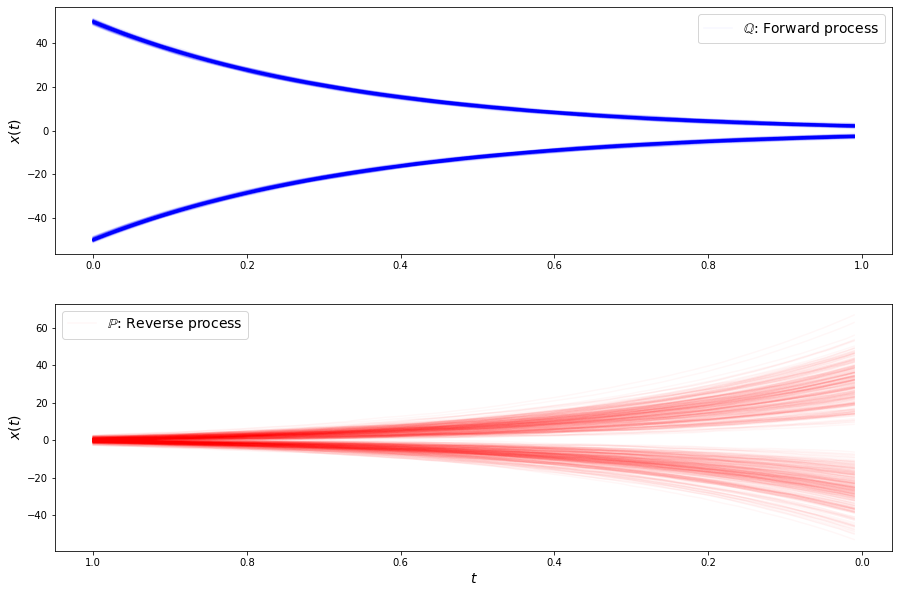

loss b 2.9240100383758545
loss b 2.8821704387664795
loss b 2.862649440765381
loss b 2.8592517375946045
loss b 2.9162933826446533
loss b 2.8979876041412354
loss b 2.81038236618042
loss b 2.9972620010375977
loss b 2.8990530967712402
loss b 2.9376604557037354
loss b 2.8774161338806152
loss b 3.036055088043213
loss b 2.879084587097168
loss b 2.987537384033203
loss b 2.99872088432312
loss b 2.9151875972747803
loss b 3.0122780799865723
loss b 2.8952484130859375
loss b 2.851144313812256
loss b 2.935908555984497
loss b 2.9706544876098633
loss b 2.8597331047058105
loss f 5.836863040924072
loss f 5.765936851501465
loss f 5.827563762664795
loss f 5.767097473144531
loss f 5.75895881652832
loss f 5.717698097229004
loss f 5.728566646575928
loss f 5.831384181976318
loss f 5.804749011993408
loss f 5.736579895019531
loss f 5.749689102172852
loss f 5.780013084411621
loss f 5.604430198669434
loss f 5.67087984085083
loss f 5.764371395111084
loss f 5.729823112487793
loss f 5.677141189575195
loss f 5.645634

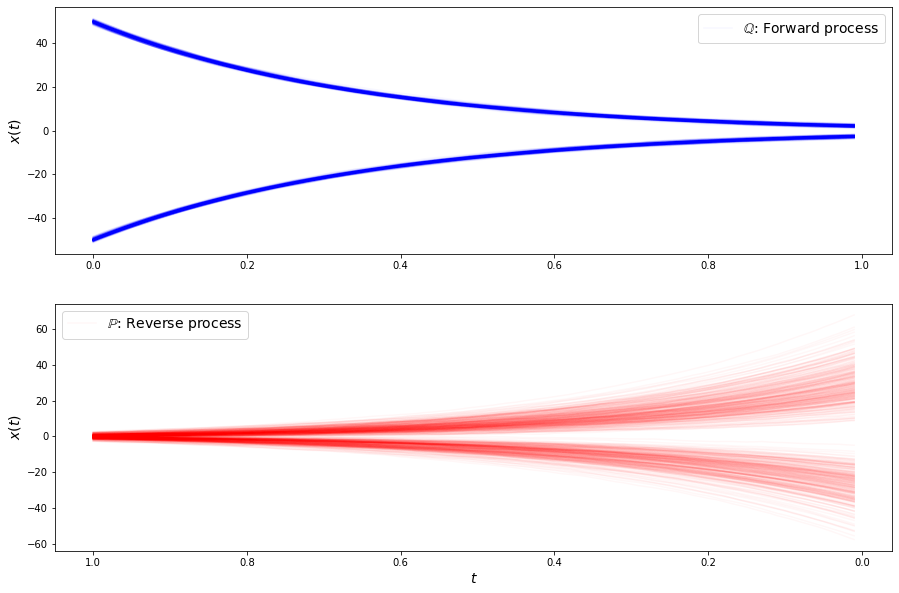

loss b 2.907768487930298
loss b 2.97330904006958
loss b 2.8960280418395996
loss b 2.9132564067840576
loss b 2.8469226360321045
loss b 2.946743965148926
loss b 2.9038631916046143
loss b 3.007746458053589
loss b 2.851605176925659
loss b 2.7863385677337646
loss b 2.8675105571746826
loss b 2.895240068435669
loss b 2.9014370441436768
loss b 2.975938081741333
loss b 2.8526089191436768
loss b 2.8747122287750244
loss b 2.9454147815704346
loss b 2.841291666030884
loss b 2.925849437713623
loss b 2.8771586418151855
loss b 2.9723682403564453
loss b 2.9494309425354004
loss f 5.701272010803223
loss f 5.666561126708984
loss f 5.683627605438232
loss f 5.725884437561035
loss f 5.587324619293213
loss f 5.6976799964904785
loss f 5.758781909942627
loss f 5.801752090454102
loss f 5.784721374511719
loss f 5.798050880432129
loss f 5.778306007385254
loss f 5.646967887878418
loss f 5.722847938537598
loss f 5.711366653442383
loss f 5.642876148223877
loss f 5.850759506225586
loss f 5.6876749992370605
loss f 5.77

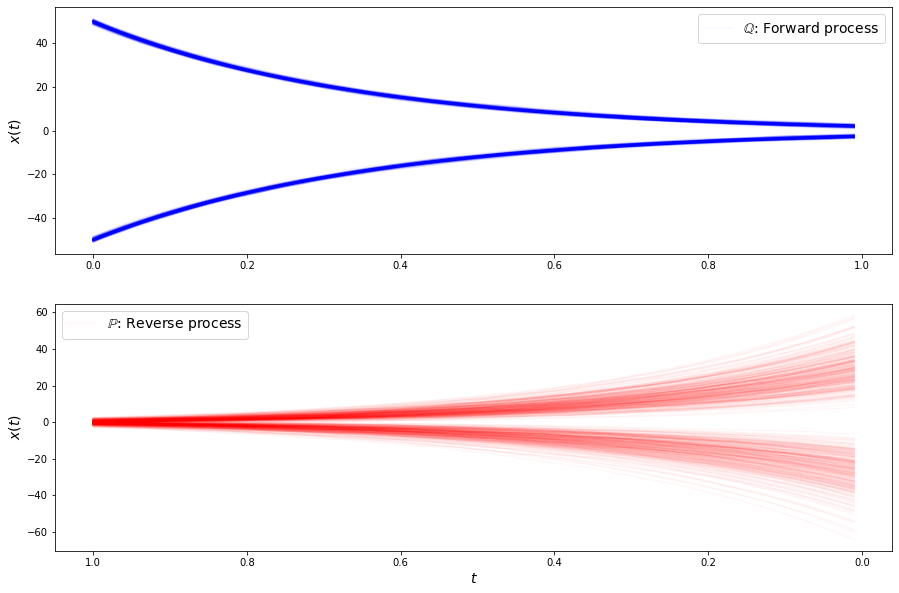

loss b 2.875697612762451
loss b 2.8621654510498047
loss b 2.8877768516540527
loss b 2.9156298637390137
loss b 2.913043975830078
loss b 2.8389344215393066
loss b 2.836794853210449
loss b 2.916889190673828
loss b 2.882742404937744
loss b 2.8632495403289795
loss b 2.8606255054473877
loss b 2.8325440883636475
loss b 2.906918525695801
loss b 2.8398516178131104
loss b 2.802398443222046
loss b 2.922304391860962
loss b 2.9315414428710938
loss b 2.872859001159668
loss b 2.882373571395874
loss b 2.8974244594573975
loss b 2.9036614894866943
loss b 2.897125005722046
loss f 5.617934226989746
loss f 5.665994167327881
loss f 5.560790061950684
loss f 5.655519962310791
loss f 5.712338447570801
loss f 5.635815143585205
loss f 5.688271522521973
loss f 5.748497009277344
loss f 5.687298774719238
loss f 5.721713066101074
loss f 5.690161228179932
loss f 5.5990142822265625
loss f 5.7093682289123535
loss f 5.635256290435791
loss f 5.752828598022461
loss f 5.590020179748535
loss f 5.6599440574646
loss f 5.71781

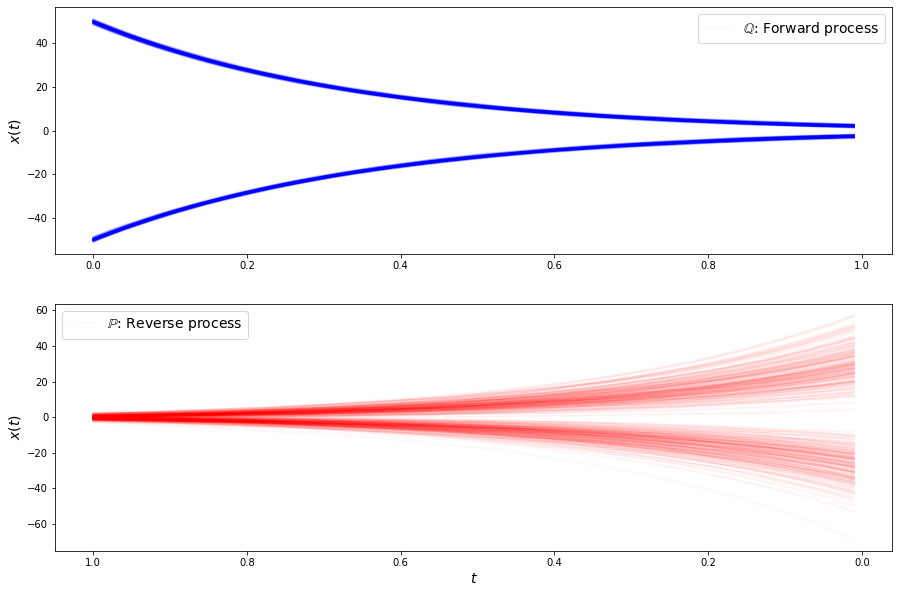

loss b 2.857285261154175
loss b 2.8696489334106445
loss b 2.9104957580566406
loss b 2.819636583328247
loss b 2.81956148147583
loss b 2.8882839679718018
loss b 2.838495969772339
loss b 2.7791619300842285
loss b 2.824831485748291
loss b 2.9558773040771484
loss b 2.9162180423736572
loss b 2.925513982772827
loss b 2.8406500816345215
loss b 2.9478838443756104
loss b 2.7881884574890137
loss b 2.9319138526916504
loss b 2.8193700313568115
loss b 2.8507370948791504
loss b 2.7618119716644287
loss b 2.8740415573120117
loss b 2.8769712448120117
loss b 2.927412986755371
loss f 5.708817958831787
loss f 5.636618137359619
loss f 5.70967960357666
loss f 5.498468399047852
loss f 5.674014091491699
loss f 5.661121845245361
loss f 5.754861831665039
loss f 5.657630920410156
loss f 5.708736896514893
loss f 5.60415506362915
loss f 5.635863304138184
loss f 5.600280284881592
loss f 5.59902286529541
loss f 5.563714981079102
loss f 5.582301139831543
loss f 5.742565155029297
loss f 5.544948101043701
loss f 5.61260

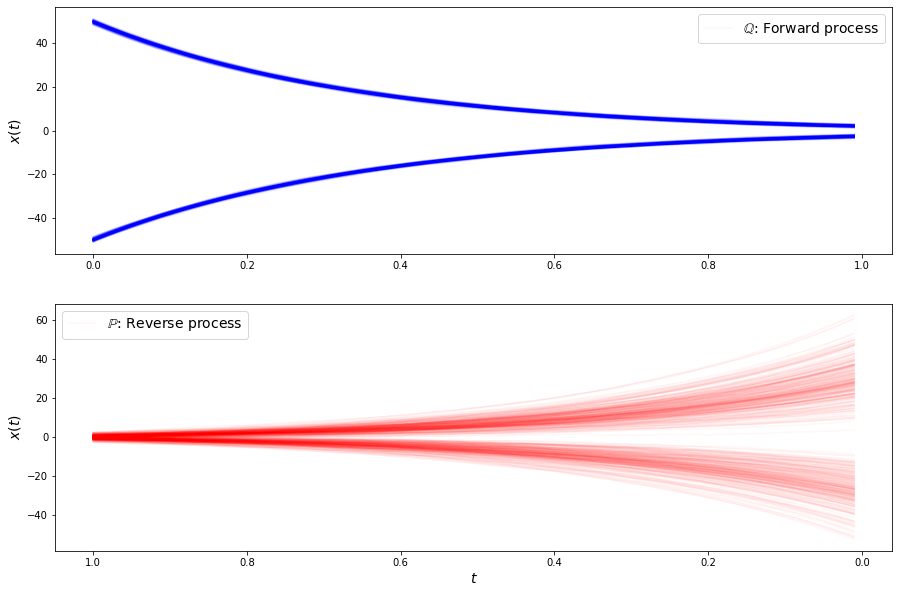

loss b 2.8471755981445312
loss b 2.8557915687561035
loss b 2.822805881500244
loss b 2.9227094650268555
loss b 2.8836147785186768
loss b 2.8683300018310547
loss b 2.808262586593628
loss b 2.80627703666687
loss b 2.7986416816711426
loss b 2.940965175628662
loss b 2.850175619125366
loss b 2.7988688945770264
loss b 2.776247024536133
loss b 2.783242702484131
loss b 2.906670093536377
loss b 2.803558588027954
loss b 2.772542715072632
loss b 2.8133158683776855
loss b 2.799285411834717
loss b 2.89424467086792
loss b 2.880631923675537
loss b 2.808680772781372
loss f 5.6568732261657715
loss f 5.63229513168335
loss f 5.665613651275635
loss f 5.613749980926514
loss f 5.609251499176025
loss f 5.669003009796143
loss f 5.676180839538574
loss f 5.547608852386475
loss f 5.557643890380859
loss f 5.533988952636719
loss f 5.547910690307617
loss f 5.6027607917785645
loss f 5.63516092300415
loss f 5.584970951080322
loss f 5.59895658493042
loss f 5.612569808959961
loss f 5.728308200836182
loss f 5.65154981613

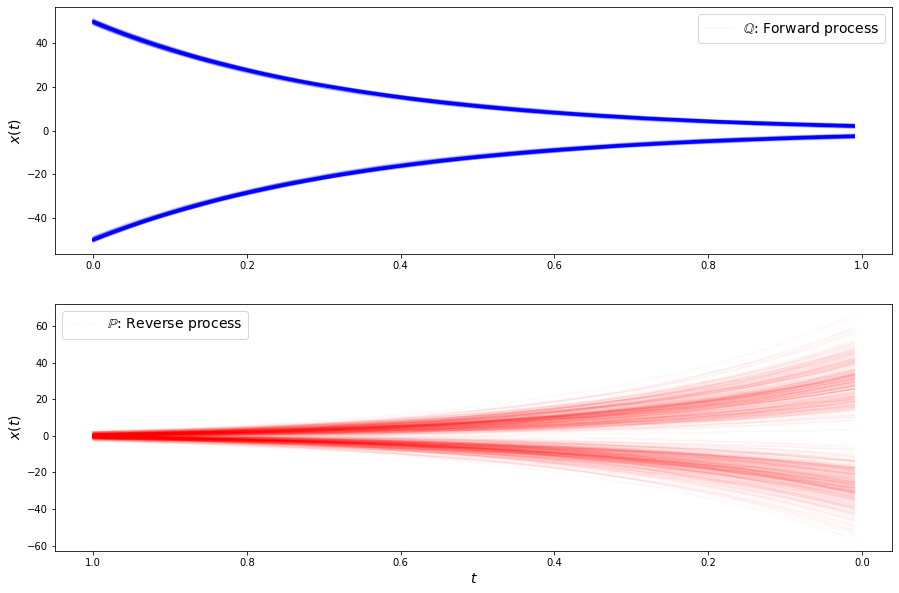

loss b 2.8199853897094727
loss b 2.8182027339935303
loss b 2.798552989959717
loss b 2.8884224891662598
loss b 2.7974400520324707
loss b 2.931981086730957
loss b 3.0101349353790283
loss b 2.788872003555298
loss b 2.818553924560547
loss b 2.8354148864746094
loss b 2.812296152114868
loss b 2.9241185188293457
loss b 2.8488929271698
loss b 2.783639907836914
loss b 2.853747844696045
loss b 2.7965950965881348
loss b 2.889357566833496
loss b 2.9094738960266113
loss b 2.845637798309326
loss b 2.752021551132202
loss b 2.8503577709198
loss b 2.803644895553589
loss f 5.534855365753174
loss f 5.66887903213501
loss f 5.643643856048584
loss f 5.577409267425537
loss f 5.581021785736084
loss f 5.545813083648682
loss f 5.675408363342285
loss f 5.573696136474609
loss f 5.6520867347717285
loss f 5.650424003601074
loss f 5.640615940093994
loss f 5.519853591918945
loss f 5.626232147216797
loss f 5.585918426513672
loss f 5.628578186035156
loss f 5.5900959968566895
loss f 5.642634868621826
loss f 5.6436290740

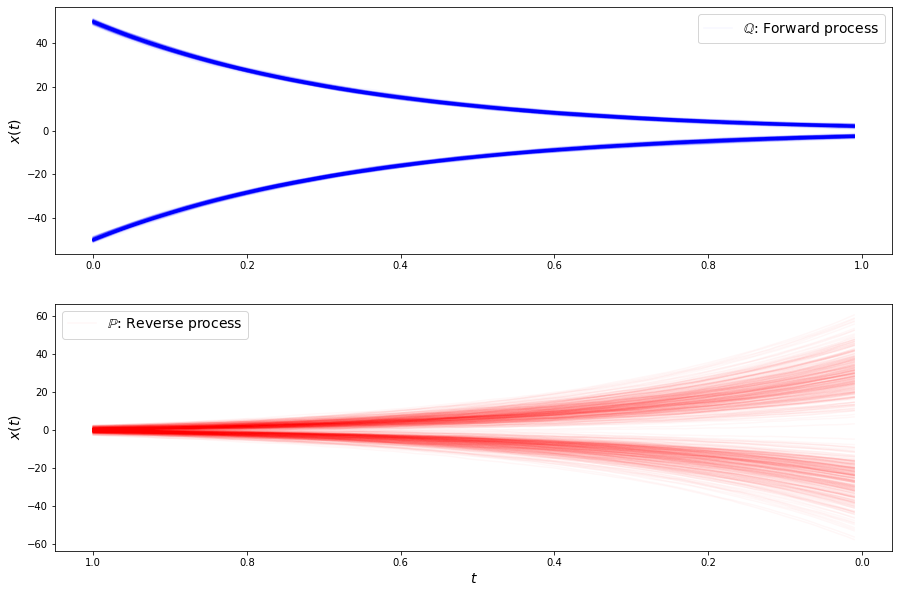

loss b 2.7197654247283936
loss b 2.7969284057617188
loss b 2.8795652389526367
loss b 2.880312919616699
loss b 2.7389285564422607
loss b 2.8182575702667236
loss b 2.82844877243042
loss b 2.829446792602539
loss b 2.786024570465088
loss b 2.7412936687469482
loss b 2.815134048461914
loss b 2.8010802268981934
loss b 2.85235857963562
loss b 2.8405721187591553
loss b 2.8015480041503906
loss b 2.8055362701416016
loss b 2.8998076915740967
loss b 2.8004887104034424
loss b 2.840294361114502
loss b 2.738316059112549
loss b 2.816809892654419
loss b 2.783447504043579
loss f 5.65826416015625
loss f 5.424689769744873
loss f 5.600149631500244
loss f 5.575074672698975
loss f 5.688479900360107
loss f 5.459729194641113
loss f 5.523484230041504
loss f 5.522858142852783
loss f 5.508303165435791
loss f 5.652286052703857
loss f 5.597185134887695
loss f 5.60313081741333
loss f 5.618207931518555
loss f 5.697689533233643
loss f 5.599276065826416
loss f 5.552303791046143
loss f 5.489256858825684
loss f 5.64167976

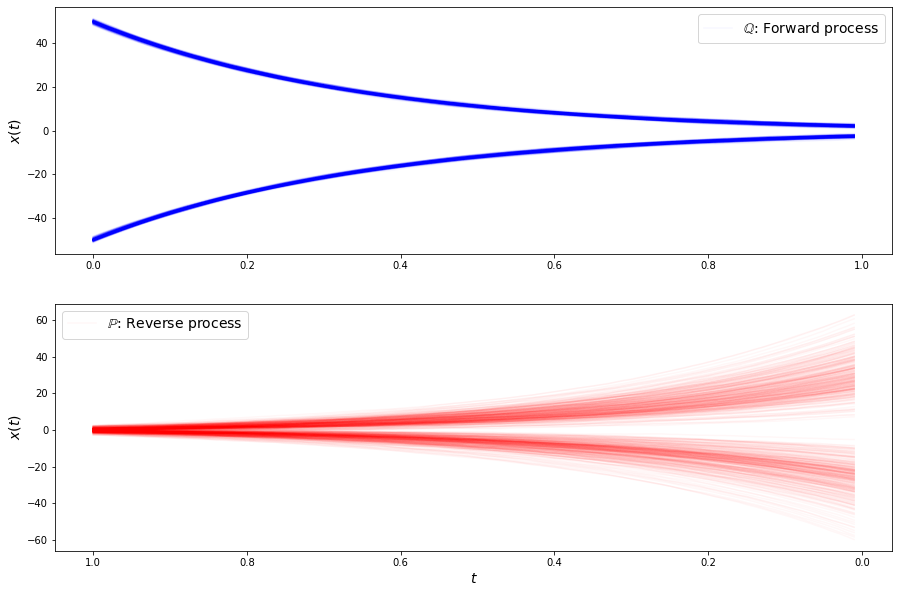

loss b 2.8220858573913574
loss b 2.816736936569214
loss b 2.823807954788208
loss b 2.7669949531555176
loss b 2.726292610168457
loss b 2.743781089782715
loss b 2.754063844680786
loss b 2.8373219966888428
loss b 2.765726089477539
loss b 2.7696444988250732
loss b 2.749041795730591
loss b 2.7594919204711914
loss b 2.7768309116363525
loss b 2.894162893295288
loss b 2.8394250869750977
loss b 2.8815925121307373
loss b 2.760579824447632
loss b 2.7673966884613037
loss b 2.817779541015625
loss b 2.717595100402832
loss b 2.8039917945861816
loss b 2.8151345252990723
loss f 5.604852199554443
loss f 5.496254920959473
loss f 5.5968918800354
loss f 5.589885234832764
loss f 5.502457141876221
loss f 5.519896030426025
loss f 5.725024223327637
loss f 5.4939727783203125
loss f 5.709346771240234
loss f 5.575088977813721
loss f 5.582685947418213
loss f 5.557455062866211
loss f 5.5680317878723145
loss f 5.6007866859436035
loss f 5.599305629730225
loss f 5.492424964904785
loss f 5.6411967277526855
loss f 5.466

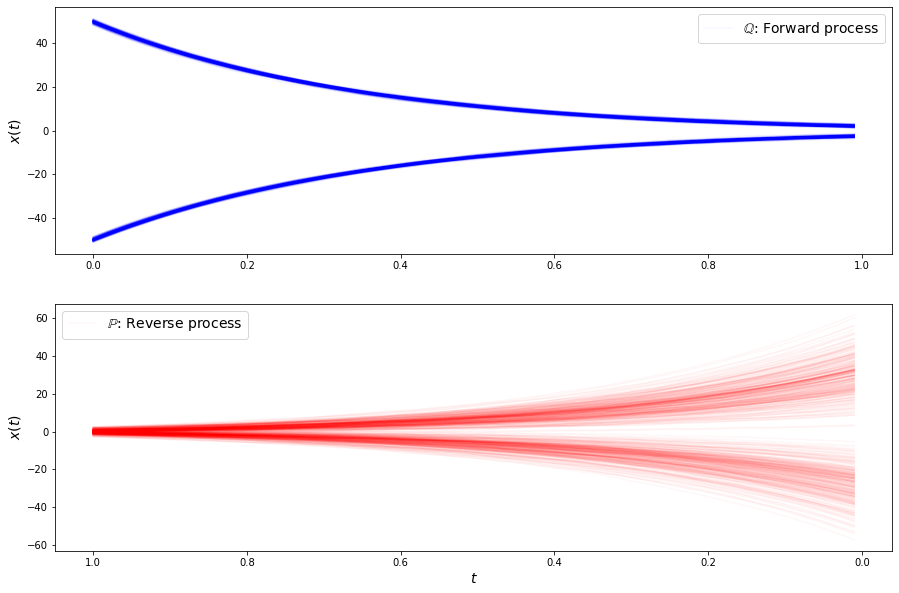

loss b 2.731909990310669
loss b 2.7472150325775146
loss b 2.795696973800659
loss b 2.8078489303588867
loss b 2.7237656116485596
loss b 2.751616954803467
loss b 2.802438735961914
loss b 2.7954928874969482
loss b 2.8098950386047363
loss b 2.827056407928467
loss b 2.883449077606201
loss b 2.7659387588500977
loss b 2.7326102256774902
loss b 2.8367600440979004
loss b 2.8022520542144775
loss b 2.7476913928985596
loss b 2.7137410640716553
loss b 2.8258097171783447
loss b 2.703768253326416
loss b 2.695996046066284
loss b 2.8020780086517334
loss b 2.6764233112335205
loss f 5.480215072631836
loss f 5.554537773132324
loss f 5.543570518493652
loss f 5.633347511291504
loss f 5.524429798126221
loss f 5.509871006011963
loss f 5.534296035766602
loss f 5.521877288818359
loss f 5.519835472106934
loss f 5.577085971832275
loss f 5.636949062347412
loss f 5.554680824279785
loss f 5.60648250579834
loss f 5.567442893981934
loss f 5.5185699462890625
loss f 5.458519458770752
loss f 5.671597957611084
loss f 5.44

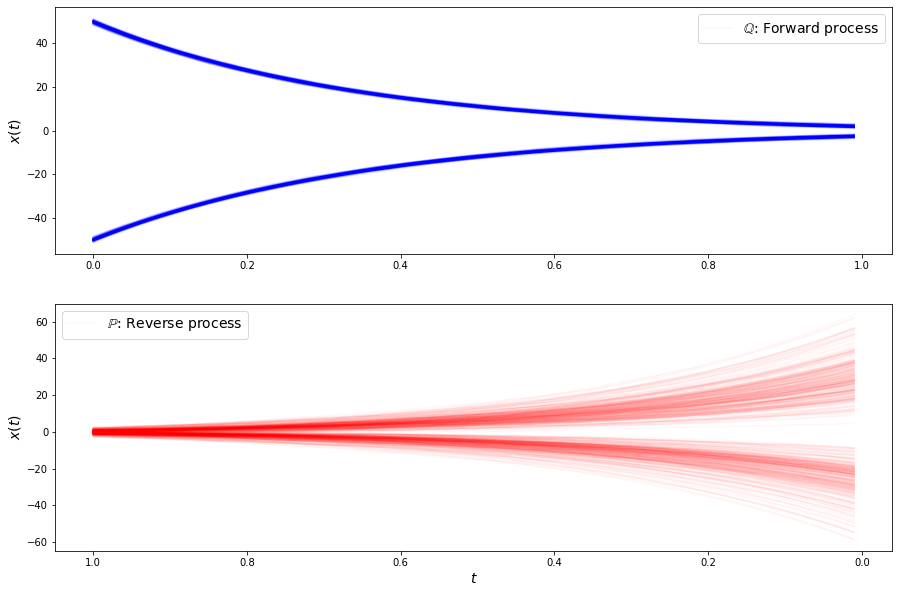

loss b 2.7990050315856934
loss b 2.7983973026275635
loss b 2.6962366104125977
loss b 2.7158091068267822
loss b 2.739777088165283
loss b 2.7077524662017822
loss b 2.712550401687622
loss b 2.8122200965881348
loss b 2.72556209564209
loss b 2.629608631134033
loss b 2.7989718914031982
loss b 2.75402569770813
loss b 2.818089246749878
loss b 2.7933671474456787
loss b 2.66239595413208
loss b 2.8181941509246826
loss b 2.8722920417785645
loss b 2.761042594909668
loss b 2.7168619632720947
loss b 2.814403533935547
loss b 2.8324623107910156
loss b 2.71124005317688
loss f 5.528998374938965
loss f 5.516814231872559
loss f 5.568901538848877
loss f 5.666150093078613
loss f 5.532731056213379
loss f 5.5298686027526855
loss f 5.567122936248779
loss f 5.470893859863281
loss f 5.549217224121094
loss f 5.569554328918457
loss f 5.39941930770874
loss f 5.535461902618408
loss f 5.5008440017700195
loss f 5.43934440612793
loss f 5.536120414733887
loss f 5.429521083831787
loss f 5.516374111175537
loss f 5.39961719

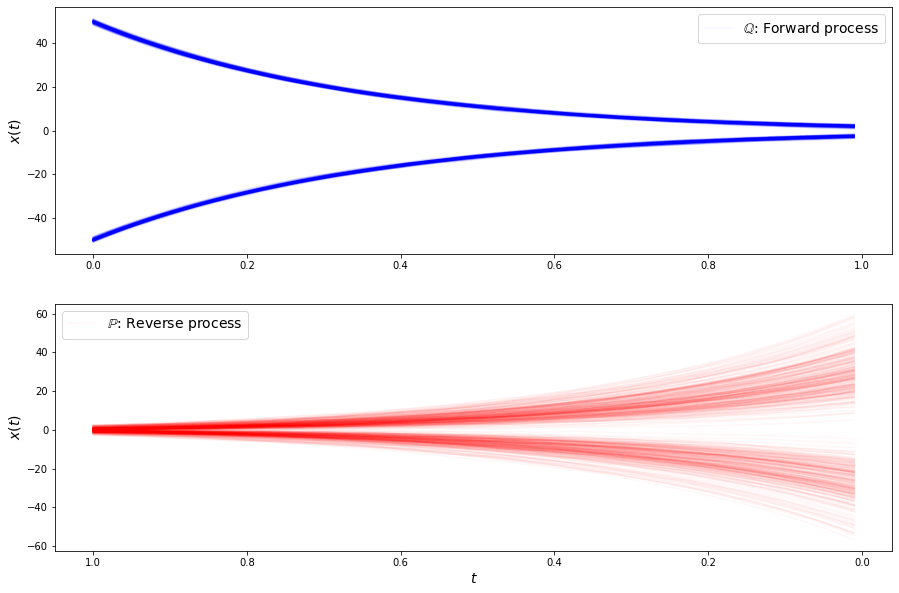

loss b 2.790818691253662
loss b 2.752472400665283
loss b 2.769038438796997
loss b 2.6840693950653076
loss b 2.802980422973633
loss b 2.732027053833008
loss b 2.7397537231445312
loss b 2.672719955444336
loss b 2.8136188983917236
loss b 2.7332839965820312
loss b 2.7123372554779053
loss b 2.684041976928711
loss b 2.658235788345337
loss b 2.7209529876708984
loss b 2.711653470993042
loss b 2.770904064178467
loss b 2.6700539588928223
loss b 2.7447967529296875
loss b 2.7314460277557373
loss b 2.7945783138275146
loss b 2.7020463943481445
loss b 2.6770741939544678
loss f 5.493912220001221
loss f 5.401795864105225
loss f 5.477210998535156
loss f 5.491721153259277
loss f 5.467811107635498
loss f 5.46846342086792
loss f 5.413459300994873
loss f 5.403822898864746
loss f 5.523151874542236
loss f 5.432057857513428
loss f 5.5073466300964355
loss f 5.397645473480225
loss f 5.4941840171813965
loss f 5.422461986541748
loss f 5.471883773803711
loss f 5.410076141357422
loss f 5.504524230957031
loss f 5.459

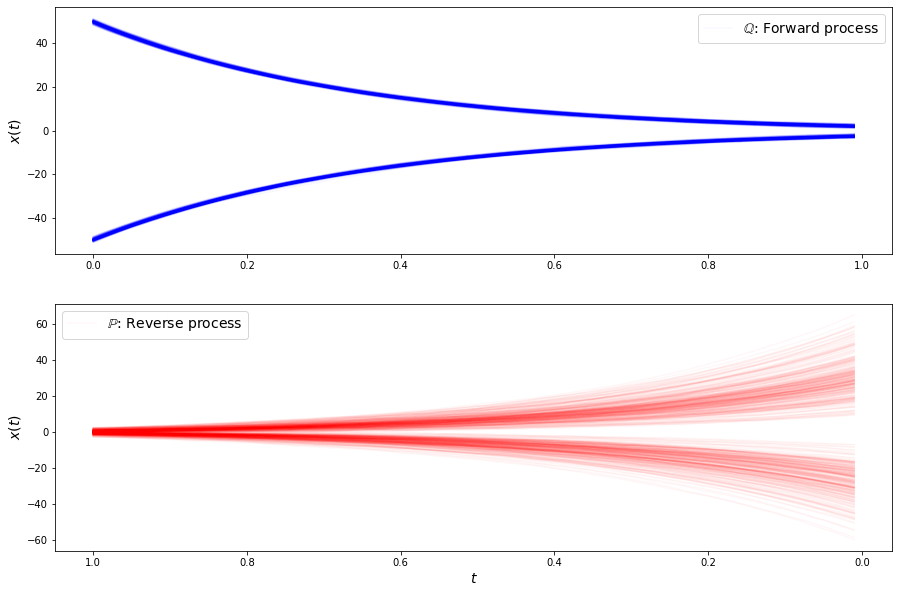

loss b 2.8181698322296143
loss b 2.789992332458496
loss b 2.5993804931640625
loss b 2.6871962547302246
loss b 2.6912925243377686
loss b 2.791440486907959
loss b 2.705693483352661
loss b 2.7669684886932373
loss b 2.813976526260376
loss b 2.6893372535705566
loss b 2.7148687839508057
loss b 2.66849422454834
loss b 2.702033519744873
loss b 2.732217788696289
loss b 2.6767964363098145
loss b 2.7237319946289062
loss b 2.7600624561309814
loss b 2.707526922225952
loss b 2.728671073913574
loss b 2.7126190662384033
loss b 2.703990936279297
loss b 2.7552785873413086
loss f 5.52389669418335
loss f 5.483902931213379
loss f 5.470089912414551
loss f 5.3462748527526855
loss f 5.536822319030762
loss f 5.497486114501953
loss f 5.350367546081543
loss f 5.428884983062744
loss f 5.541079044342041
loss f 5.449407577514648
loss f 5.484911918640137
loss f 5.471790313720703
loss f 5.325869560241699
loss f 5.457655429840088
loss f 5.500821590423584
loss f 5.46126127243042
loss f 5.414238452911377
loss f 5.413228

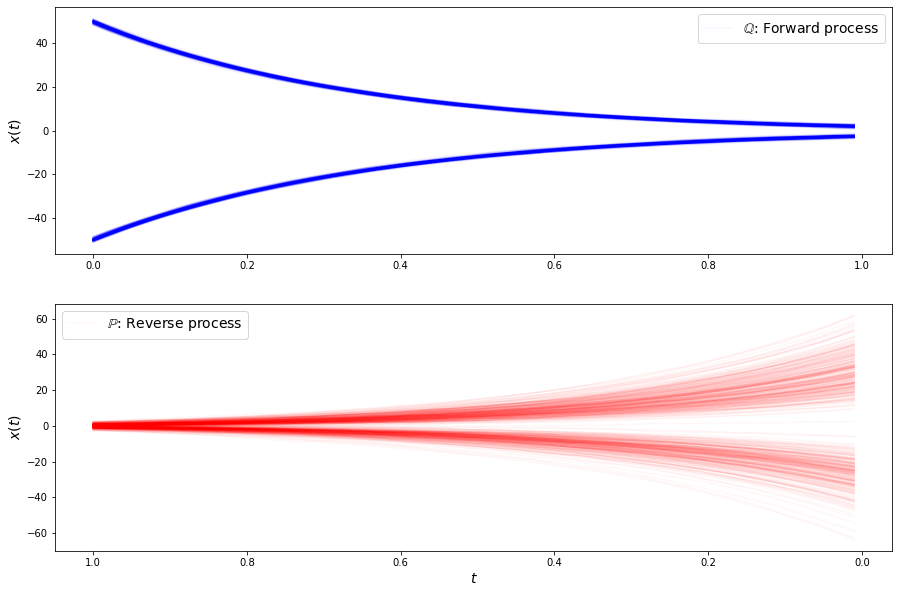

loss b 2.6302847862243652
loss b 2.767426013946533
loss b 2.7699570655822754
loss b 2.8191299438476562
loss b 2.7065484523773193
loss b 2.6204564571380615
loss b 2.652367115020752
loss b 2.6920065879821777
loss b 2.7084457874298096
loss b 2.6184678077697754
loss b 2.8263089656829834
loss b 2.7057225704193115
loss b 2.7689218521118164
loss b 2.6857593059539795
loss b 2.7059807777404785
loss b 2.6398069858551025
loss b 2.724522113800049
loss b 2.7141284942626953
loss b 2.687422513961792
loss b 2.7557201385498047
loss b 2.71773624420166
loss b 2.7442996501922607
loss f 5.395256042480469
loss f 5.436935901641846
loss f 5.502742290496826
loss f 5.409599304199219
loss f 5.443180561065674
loss f 5.542203903198242
loss f 5.432378768920898
loss f 5.366547107696533
loss f 5.404601097106934
loss f 5.495281219482422
loss f 5.487496852874756
loss f 5.500059127807617
loss f 5.484701156616211
loss f 5.4265851974487305
loss f 5.366979122161865
loss f 5.3788161277771
loss f 5.5364670753479
loss f 5.441

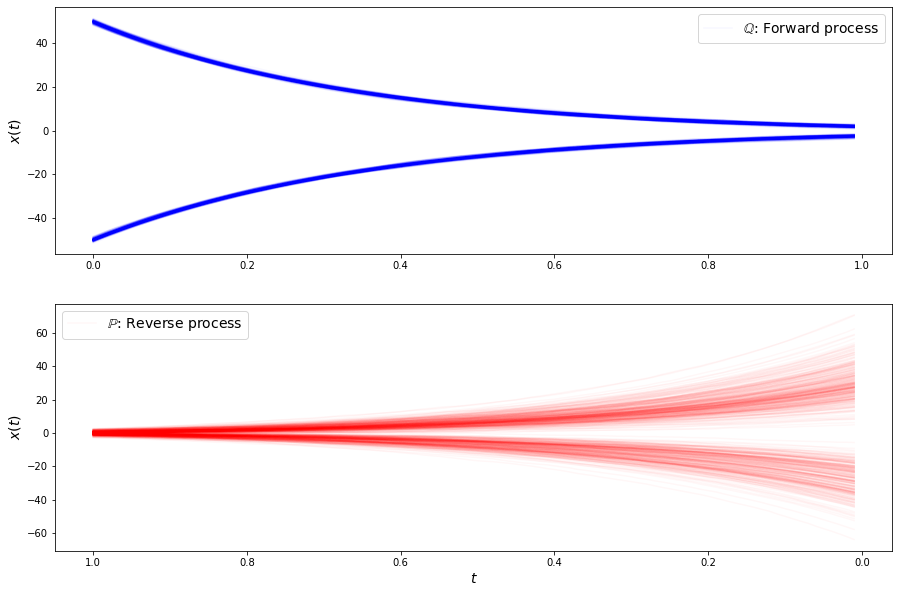

loss b 2.723337173461914
loss b 2.723106861114502
loss b 2.6961655616760254
loss b 2.6752665042877197
loss b 2.730531930923462
loss b 2.7415823936462402
loss b 2.6492984294891357
loss b 2.6886024475097656
loss b 2.7448630332946777
loss b 2.7571725845336914
loss b 2.6960184574127197
loss b 2.6961777210235596
loss b 2.6589725017547607
loss b 2.69228458404541
loss b 2.630743980407715
loss b 2.7535111904144287
loss b 2.6179521083831787
loss b 2.669517993927002
loss b 2.584131956100464
loss b 2.7263598442077637
loss b 2.7911999225616455
loss b 2.658451795578003
loss f 5.386114597320557
loss f 5.442564487457275
loss f 5.372775077819824
loss f 5.43330192565918
loss f 5.4247660636901855
loss f 5.36759614944458
loss f 5.429297924041748
loss f 5.46164608001709
loss f 5.430668830871582
loss f 5.4590067863464355
loss f 5.369654178619385
loss f 5.394331932067871
loss f 5.424939155578613
loss f 5.483004570007324
loss f 5.432397842407227
loss f 5.393057823181152
loss f 5.499591827392578
loss f 5.3730

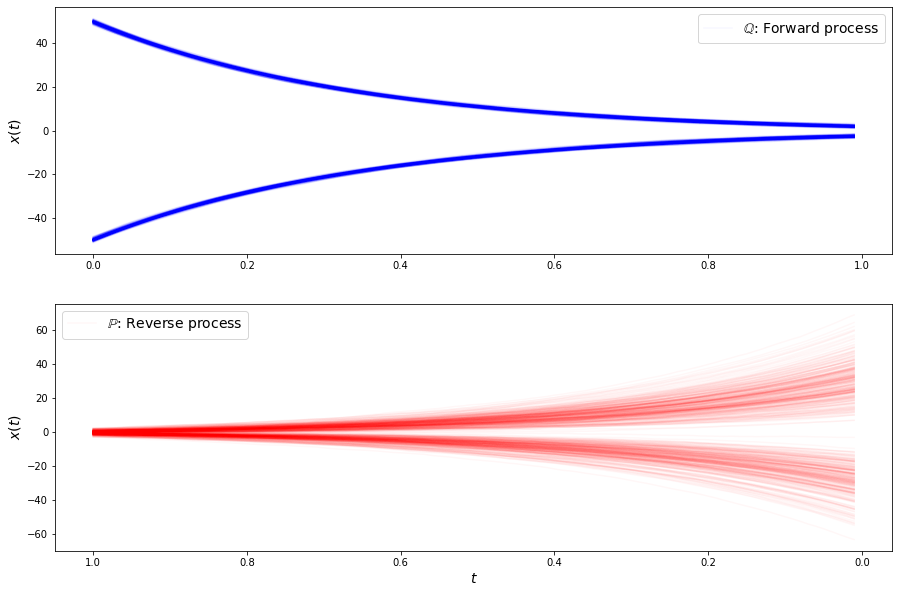

loss b 2.677035331726074
loss b 2.6929984092712402
loss b 2.7763431072235107
loss b 2.71333909034729
loss b 2.7003653049468994
loss b 2.700745105743408
loss b 2.6427054405212402
loss b 2.6773838996887207
loss b 2.734388589859009
loss b 2.5790934562683105
loss b 2.6742255687713623
loss b 2.837958335876465
loss b 2.76404070854187
loss b 2.6872942447662354
loss b 2.644136428833008
loss b 2.6700849533081055
loss b 2.6504967212677
loss b 2.676948308944702
loss b 2.626178503036499
loss b 2.7112345695495605
loss b 2.6545968055725098
loss b 2.6250040531158447
loss f 5.384553909301758
loss f 5.489710807800293
loss f 5.386366844177246
loss f 5.372488021850586
loss f 5.4562153816223145
loss f 5.3763532638549805
loss f 5.397019863128662
loss f 5.372464656829834
loss f 5.422244071960449
loss f 5.4212260246276855
loss f 5.41909646987915
loss f 5.393307685852051
loss f 5.40468692779541
loss f 5.386050224304199
loss f 5.352232456207275
loss f 5.406705379486084
loss f 5.463935852050781
loss f 5.4478487

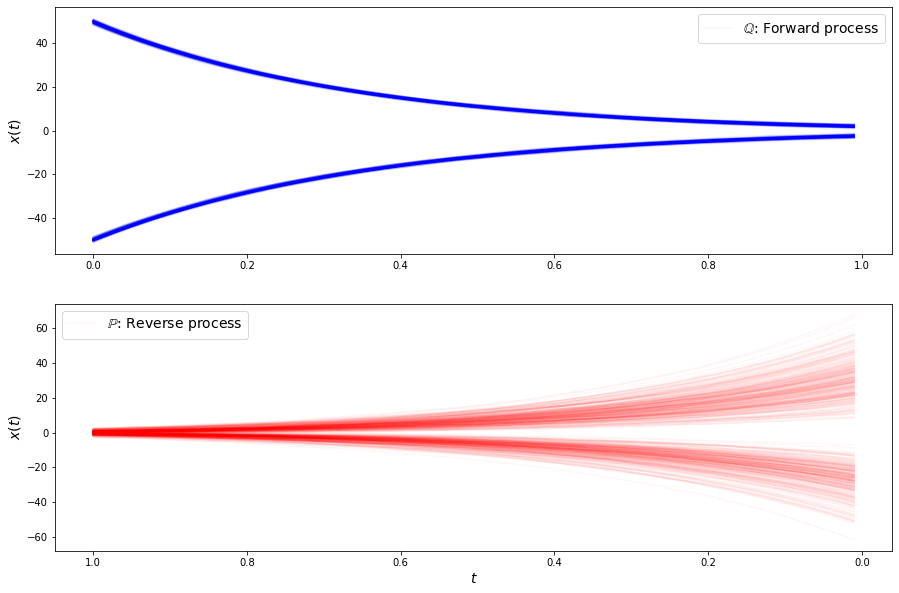

loss b 2.605494737625122
loss b 2.6483190059661865
loss b 2.569401502609253
loss b 2.5754005908966064
loss b 2.6118180751800537
loss b 2.6020729541778564
loss b 2.6108193397521973
loss b 2.5560524463653564
loss b 2.5906693935394287
loss b 2.684061050415039
loss b 2.6800930500030518
loss b 2.670461416244507
loss b 2.652208089828491
loss b 2.7073564529418945
loss b 2.763631582260132
loss b 2.698164463043213
loss b 2.7542977333068848
loss b 2.6767241954803467
loss b 2.7611374855041504
loss b 2.658921480178833
loss b 2.6706244945526123
loss b 2.6898605823516846
loss f 5.311553955078125
loss f 5.359691143035889
loss f 5.421963214874268
loss f 5.336915493011475
loss f 5.434580326080322
loss f 5.323456764221191
loss f 5.450625896453857
loss f 5.442561149597168
loss f 5.3802361488342285
loss f 5.484663486480713
loss f 5.301568984985352
loss f 5.428769111633301
loss f 5.36560583114624
loss f 5.3322248458862305
loss f 5.371223449707031
loss f 5.304808616638184
loss f 5.346133232116699
loss f 5.4

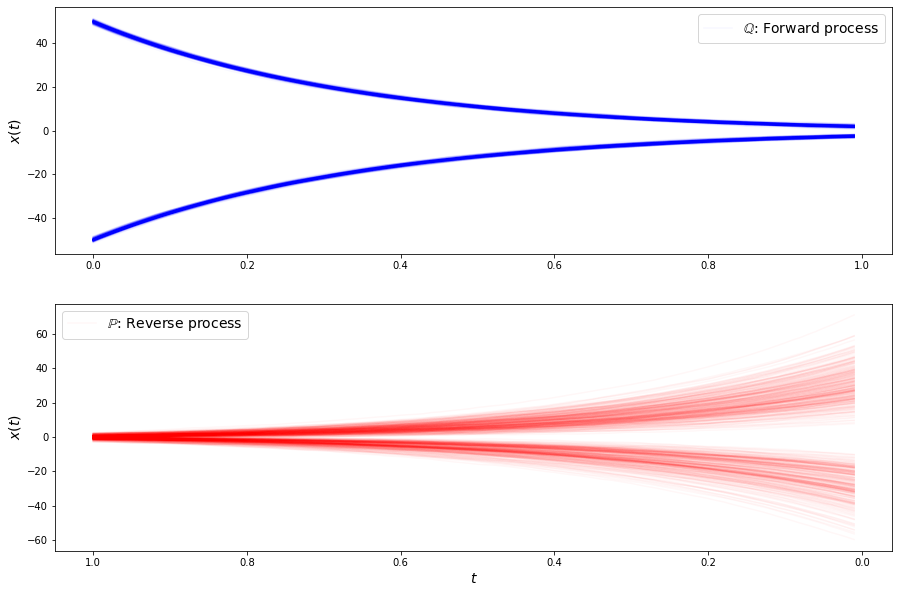

loss b 2.6519112586975098
loss b 2.6439592838287354
loss b 2.650188446044922
loss b 2.6368508338928223
loss b 2.6398465633392334
loss b 2.5583181381225586
loss b 2.7307589054107666
loss b 2.6114625930786133
loss b 2.6289942264556885
loss b 2.66119122505188
loss b 2.613018274307251
loss b 2.5860965251922607
loss b 2.6561100482940674
loss b 2.6261234283447266
loss b 2.656937599182129
loss b 2.6172006130218506
loss b 2.7475569248199463
loss b 2.6708152294158936
loss b 2.590312957763672
loss b 2.642554759979248
loss b 2.664846897125244
loss b 2.721017599105835
loss f 5.352691173553467
loss f 5.3442511558532715
loss f 5.371325969696045
loss f 5.358211994171143
loss f 5.3542680740356445
loss f 5.3097991943359375
loss f 5.294485092163086
loss f 5.39652681350708
loss f 5.332520008087158
loss f 5.402350902557373
loss f 5.435111045837402
loss f 5.249533653259277
loss f 5.3275299072265625
loss f 5.344086647033691
loss f 5.348292827606201
loss f 5.359846591949463
loss f 5.318109035491943
loss f 5.

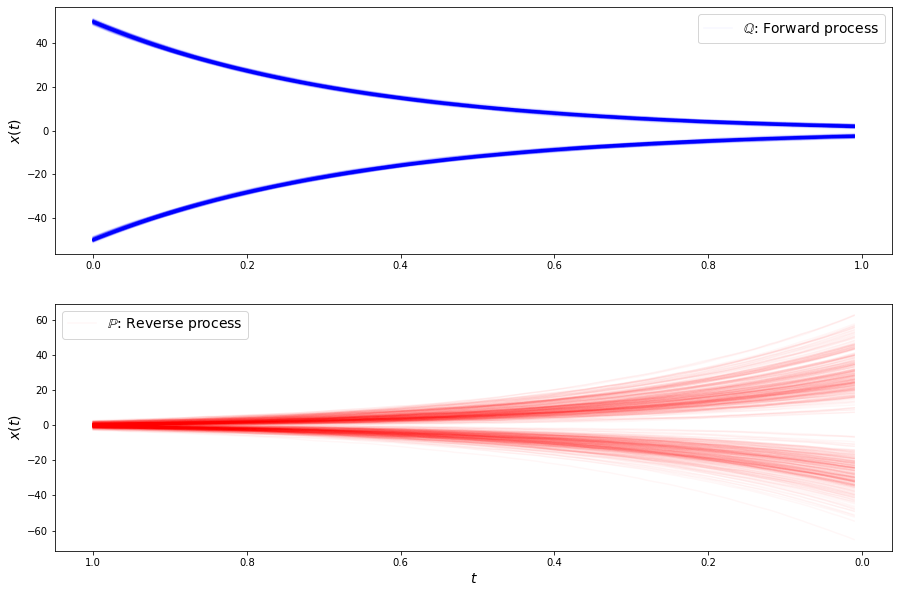

loss b 2.6392464637756348
loss b 2.621072769165039
loss b 2.633739948272705
loss b 2.595836639404297
loss b 2.674731492996216
loss b 2.6509692668914795
loss b 2.6291654109954834
loss b 2.585921049118042
loss b 2.62081241607666
loss b 2.5315845012664795
loss b 2.6757872104644775
loss b 2.684600353240967
loss b 2.608269214630127
loss b 2.601149082183838
loss b 2.7026278972625732
loss b 2.6150805950164795
loss b 2.621006488800049
loss b 2.67681622505188
loss b 2.6169981956481934
loss b 2.6949570178985596
loss b 2.5299036502838135
loss b 2.620979070663452
loss f 5.306923866271973
loss f 5.332056045532227
loss f 5.329957485198975
loss f 5.362080097198486
loss f 5.2637786865234375
loss f 5.286438465118408
loss f 5.308755874633789
loss f 5.252123832702637
loss f 5.370845794677734
loss f 5.350783824920654
loss f 5.373775005340576
loss f 5.3448028564453125
loss f 5.38303804397583
loss f 5.360263824462891
loss f 5.37142276763916
loss f 5.290259838104248
loss f 5.3733086585998535
loss f 5.3055448

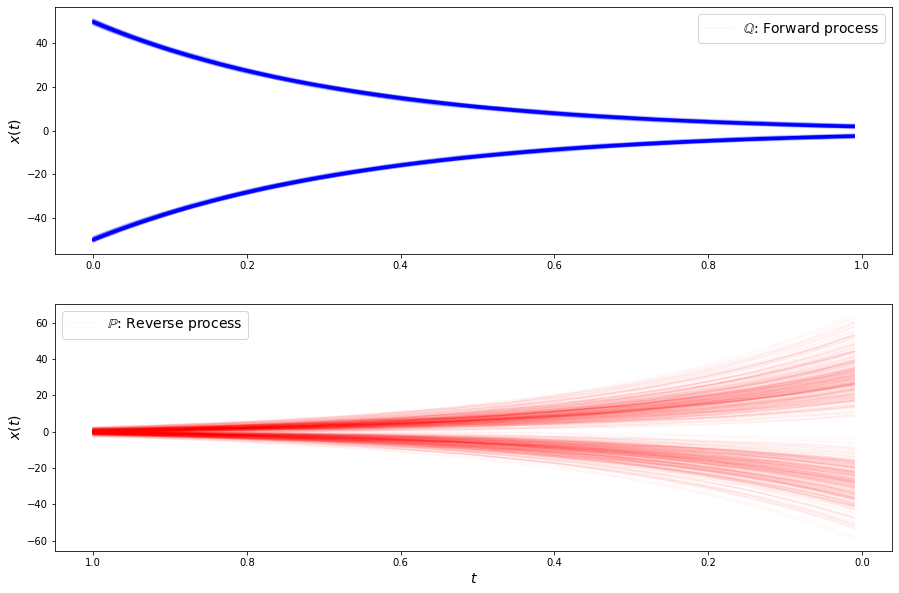

loss b 2.5561647415161133
loss b 2.6246390342712402
loss b 2.621159553527832
loss b 2.6490659713745117
loss b 2.542188882827759
loss b 2.5430071353912354
loss b 2.5463218688964844
loss b 2.545914888381958
loss b 2.5805366039276123
loss b 2.578805685043335
loss b 2.631234884262085
loss b 2.6292686462402344
loss b 2.5999040603637695
loss b 2.6444385051727295
loss b 2.5870354175567627
loss b 2.5984344482421875
loss b 2.5249040126800537
loss b 2.7198801040649414
loss b 2.6279234886169434
loss b 2.590474843978882
loss b 2.6611168384552
loss b 2.5039288997650146
loss f 5.2802510261535645
loss f 5.273248195648193
loss f 5.288005828857422
loss f 5.338641166687012
loss f 5.257950782775879
loss f 5.383741855621338
loss f 5.291665077209473
loss f 5.388160705566406
loss f 5.233710765838623
loss f 5.3283371925354
loss f 5.280268669128418
loss f 5.3685455322265625
loss f 5.317117214202881
loss f 5.289928436279297
loss f 5.322393894195557
loss f 5.316813945770264
loss f 5.228188991546631
loss f 5.283

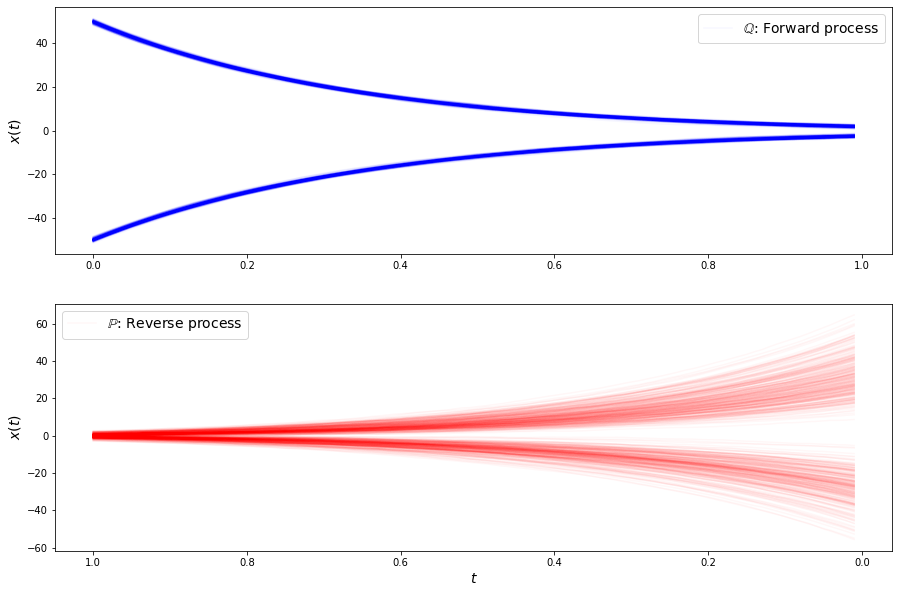

loss b 2.619731903076172
loss b 2.590005397796631
loss b 2.606123924255371
loss b 2.6582562923431396
loss b 2.7122604846954346
loss b 2.695908546447754
loss b 2.527170419692993
loss b 2.5780489444732666
loss b 2.5852928161621094
loss b 2.661504030227661
loss b 2.5678770542144775
loss b 2.719413995742798
loss b 2.573509693145752
loss b 2.5831985473632812
loss b 2.538088083267212
loss b 2.565284013748169
loss b 2.5941107273101807
loss b 2.604180097579956
loss b 2.6197967529296875
loss b 2.549973249435425
loss b 2.650059700012207
loss b 2.598954439163208
loss f 5.304533958435059
loss f 5.268577575683594
loss f 5.354969501495361
loss f 5.3059563636779785
loss f 5.252414703369141
loss f 5.273300647735596
loss f 5.351670265197754
loss f 5.239950180053711
loss f 5.307776927947998
loss f 5.353993892669678
loss f 5.30355978012085
loss f 5.318521976470947
loss f 5.275823593139648
loss f 5.28436279296875
loss f 5.314198970794678
loss f 5.3363213539123535
loss f 5.224281311035156
loss f 5.30092620

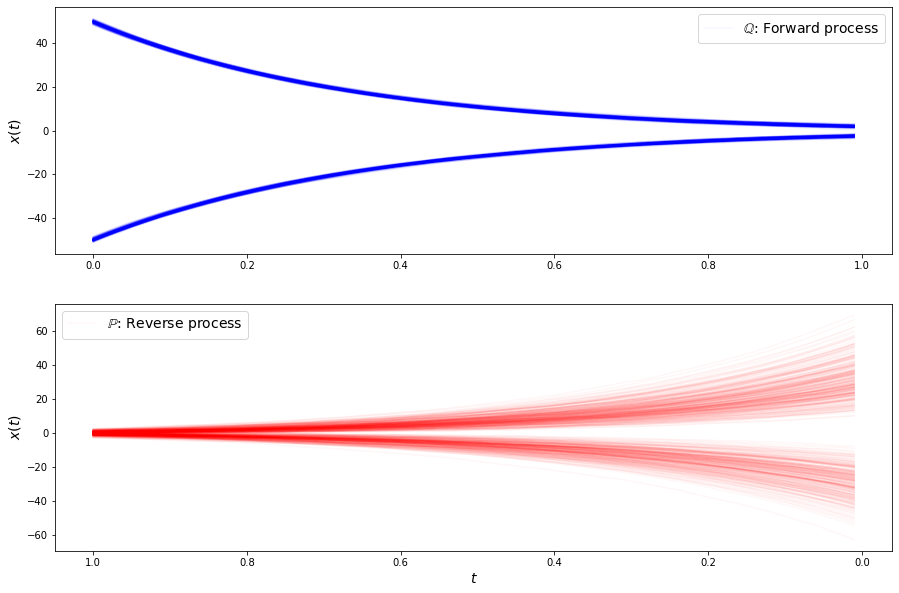

loss b 2.5750765800476074
loss b 2.635967969894409
loss b 2.5855610370635986
loss b 2.565258741378784
loss b 2.5965394973754883
loss b 2.533283233642578
loss b 2.537421464920044
loss b 2.5392191410064697
loss b 2.57013201713562
loss b 2.552778959274292
loss b 2.5193393230438232
loss b 2.5078816413879395
loss b 2.5815985202789307
loss b 2.557180643081665
loss b 2.5569372177124023
loss b 2.5904245376586914
loss b 2.5409905910491943
loss b 2.59710693359375
loss b 2.5439090728759766
loss b 2.5098652839660645
loss b 2.63163685798645
loss b 2.5397579669952393
loss f 5.291162014007568
loss f 5.267044544219971
loss f 5.265221118927002
loss f 5.238326072692871
loss f 5.189287185668945
loss f 5.176119804382324
loss f 5.288032054901123
loss f 5.253202438354492
loss f 5.245517730712891
loss f 5.205794811248779
loss f 5.248105049133301
loss f 5.3373188972473145
loss f 5.3086066246032715
loss f 5.225568771362305
loss f 5.330933094024658
loss f 5.214809894561768
loss f 5.3100409507751465
loss f 5.255

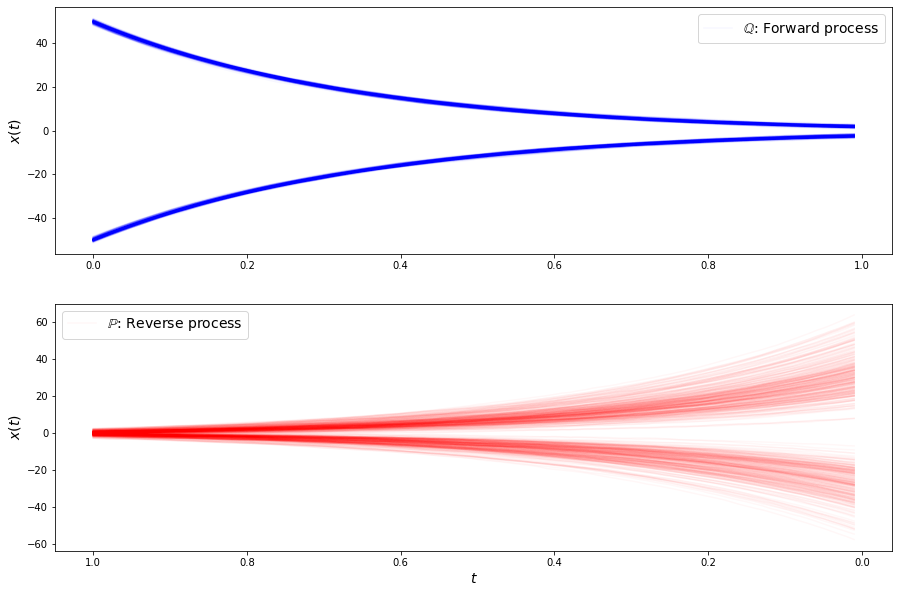

loss b 2.531733512878418
loss b 2.568434953689575
loss b 2.594536542892456
loss b 2.5709433555603027
loss b 2.4604909420013428
loss b 2.543948173522949
loss b 2.4894187450408936
loss b 2.5867919921875
loss b 2.5191400051116943
loss b 2.6280810832977295
loss b 2.4564855098724365
loss b 2.5462253093719482
loss b 2.5527288913726807
loss b 2.499791383743286
loss b 2.5498738288879395
loss b 2.6187541484832764
loss b 2.541673421859741
loss b 2.6383509635925293
loss b 2.5452468395233154
loss b 2.635572910308838
loss b 2.475614070892334
loss b 2.4847373962402344
loss f 5.226941108703613
loss f 5.1265740394592285
loss f 5.25388240814209
loss f 5.273643970489502
loss f 5.175025939941406
loss f 5.252659797668457
loss f 5.298488140106201
loss f 5.253441333770752
loss f 5.24259614944458
loss f 5.163928031921387
loss f 5.192592620849609
loss f 5.236405849456787
loss f 5.280582904815674
loss f 5.095621585845947
loss f 5.276647090911865
loss f 5.239699840545654
loss f 5.2664055824279785
loss f 5.24899

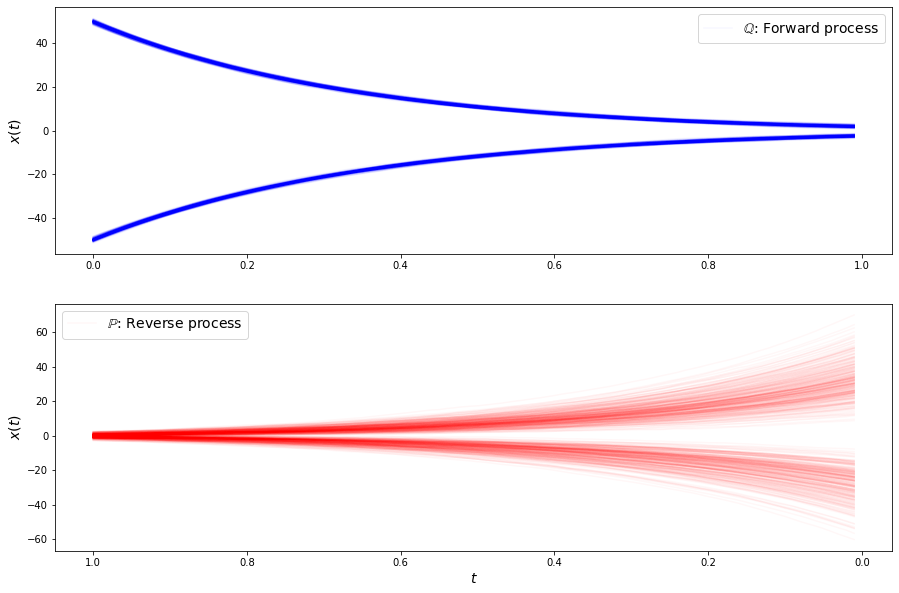

loss b 2.559230089187622
loss b 2.580009937286377
loss b 2.592806100845337
loss b 2.5324504375457764
loss b 2.5215296745300293
loss b 2.536954164505005
loss b 2.553654909133911
loss b 2.6091148853302
loss b 2.4701199531555176
loss b 2.614307403564453
loss b 2.541780948638916
loss b 2.5347681045532227
loss b 2.5827882289886475
loss b 2.576763153076172
loss b 2.5683724880218506
loss b 2.555422067642212
loss b 2.5960960388183594
loss b 2.520484447479248
loss b 2.5254294872283936
loss b 2.5112576484680176
loss b 2.466346263885498
loss b 2.506261110305786
loss f 5.249709129333496
loss f 5.187929153442383
loss f 5.314009189605713
loss f 5.213421821594238
loss f 5.165094375610352
loss f 5.213481903076172
loss f 5.253032207489014
loss f 5.247142791748047
loss f 5.213803291320801
loss f 5.223905086517334
loss f 5.275979518890381
loss f 5.14561128616333
loss f 5.111515045166016
loss f 5.241929054260254
loss f 5.238122940063477
loss f 5.201139450073242
loss f 5.166431903839111
loss f 5.3087306022

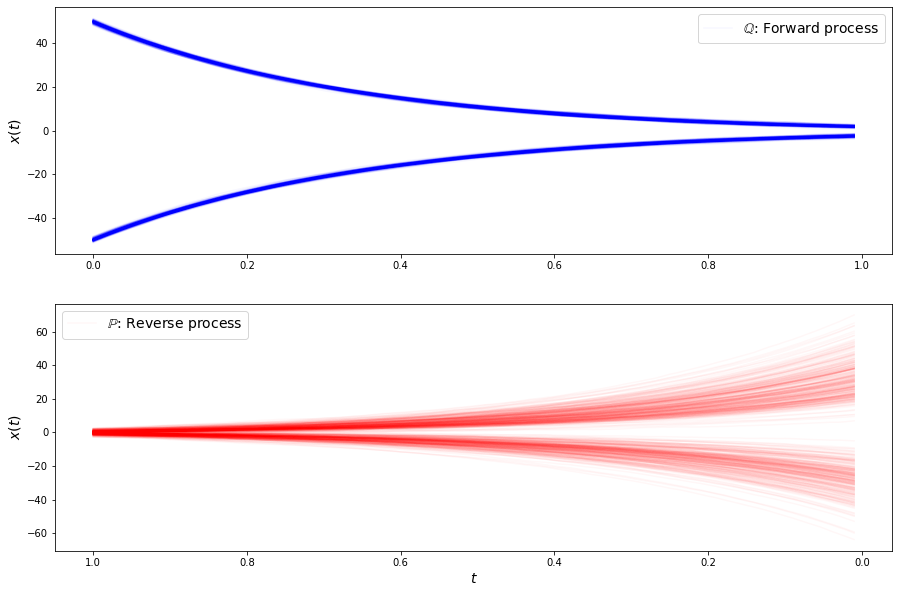

loss b 2.500767230987549
loss b 2.4534637928009033
loss b 2.533750534057617
loss b 2.5306854248046875
loss b 2.525338888168335
loss b 2.5599849224090576
loss b 2.5804593563079834
loss b 2.5427842140197754
loss b 2.5571370124816895
loss b 2.4915075302124023
loss b 2.4661917686462402
loss b 2.5321285724639893
loss b 2.5238993167877197
loss b 2.554487943649292
loss b 2.4462873935699463
loss b 2.529841899871826
loss b 2.5600950717926025
loss b 2.6150355339050293
loss b 2.5130455493927
loss b 2.49696946144104
loss b 2.545886516571045
loss b 2.568882942199707
loss f 5.14267110824585
loss f 5.289392948150635
loss f 5.254317283630371
loss f 5.192088603973389
loss f 5.253296852111816
loss f 5.232806205749512
loss f 5.177481174468994
loss f 5.179647922515869
loss f 5.170726299285889
loss f 5.267499923706055
loss f 5.142951488494873
loss f 5.191379070281982
loss f 5.2383809089660645
loss f 5.177021026611328
loss f 5.215983867645264
loss f 5.128765106201172
loss f 5.17655611038208
loss f 5.1890754

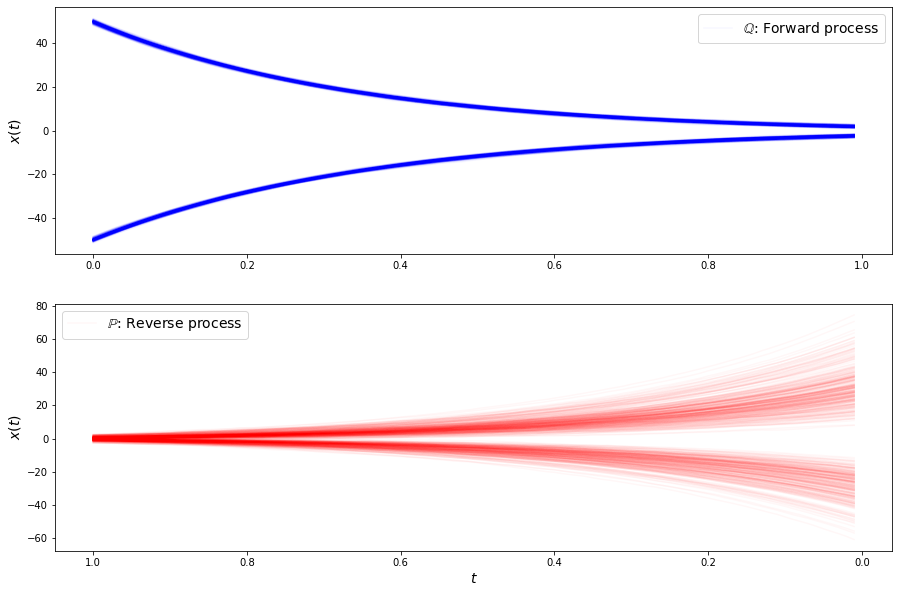

loss b 2.495332717895508
loss b 2.555387496948242
loss b 2.4804329872131348
loss b 2.6108415126800537
loss b 2.5258259773254395
loss b 2.528724431991577
loss b 2.4271349906921387
loss b 2.509258508682251
loss b 2.5915846824645996
loss b 2.5257976055145264
loss b 2.516859769821167
loss b 2.5816075801849365
loss b 2.6139516830444336
loss b 2.4932634830474854
loss b 2.496342897415161
loss b 2.5125765800476074
loss b 2.580239772796631
loss b 2.533966541290283
loss b 2.4489495754241943
loss b 2.4563095569610596
loss b 2.590853691101074
loss b 2.430098056793213
loss f 5.166823863983154
loss f 5.247714042663574
loss f 5.214572906494141
loss f 5.108975887298584
loss f 5.2198991775512695
loss f 5.228264331817627
loss f 5.188370227813721
loss f 5.098556041717529
loss f 5.210635185241699
loss f 5.187273025512695
loss f 5.096438884735107
loss f 5.293832778930664
loss f 5.153841972351074
loss f 5.115703105926514
loss f 5.185722827911377
loss f 5.209370136260986
loss f 5.134028911590576
loss f 5.236

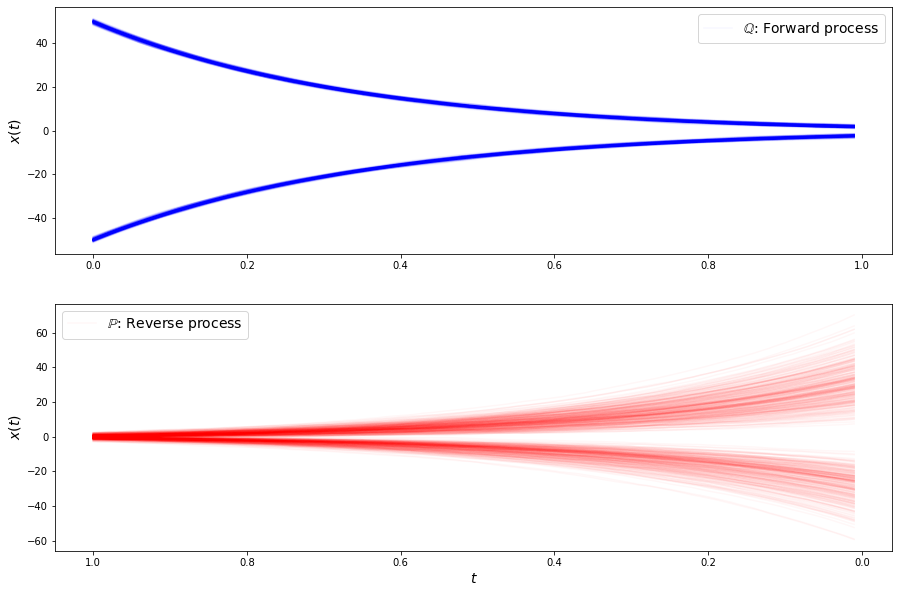

loss b 2.44722843170166
loss b 2.479907751083374
loss b 2.442491054534912
loss b 2.470019578933716
loss b 2.5177600383758545
loss b 2.5611629486083984
loss b 2.496990919113159
loss b 2.4106109142303467
loss b 2.435222864151001
loss b 2.465712547302246
loss b 2.4780101776123047
loss b 2.4851834774017334
loss b 2.532274007797241
loss b 2.5007245540618896
loss b 2.433020830154419
loss b 2.5282955169677734
loss b 2.4873476028442383
loss b 2.4724605083465576
loss b 2.5015604496002197
loss b 2.4810383319854736
loss b 2.5849454402923584
loss b 2.559974193572998
loss f 5.171905517578125
loss f 5.1231207847595215
loss f 5.2298359870910645
loss f 5.148458480834961
loss f 5.221384048461914
loss f 5.195454120635986
loss f 5.193790912628174
loss f 5.225956916809082
loss f 5.188620090484619
loss f 5.192640781402588
loss f 5.253696918487549
loss f 5.110393047332764
loss f 5.111330986022949
loss f 5.130809307098389
loss f 5.163483619689941
loss f 5.174060344696045
loss f 5.171737194061279
loss f 5.138

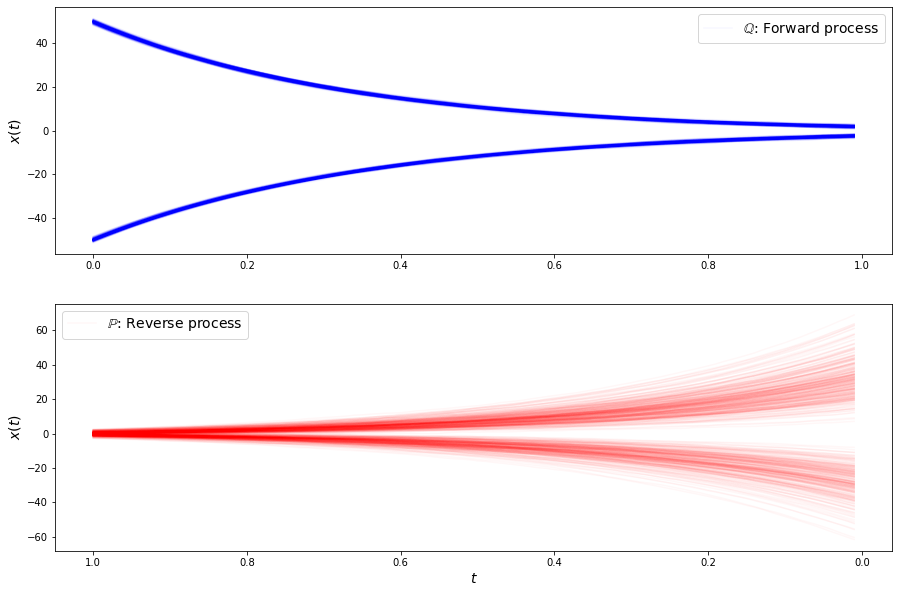

loss b 2.5235230922698975
loss b 2.4936985969543457
loss b 2.4474735260009766
loss b 2.5017309188842773
loss b 2.4557409286499023
loss b 2.4677464962005615
loss b 2.4255104064941406
loss b 2.4587972164154053
loss b 2.5137739181518555
loss b 2.4848010540008545
loss b 2.5070486068725586
loss b 2.427161931991577
loss b 2.493403673171997
loss b 2.5397980213165283
loss b 2.453933000564575
loss b 2.5603079795837402
loss b 2.446016788482666
loss b 2.432887077331543
loss b 2.4343855381011963
loss b 2.4926552772521973
loss b 2.5012032985687256
loss b 2.3802528381347656
loss f 5.12974214553833
loss f 5.08675479888916
loss f 5.169565200805664
loss f 5.157800197601318
loss f 5.108739376068115
loss f 5.141759872436523
loss f 5.1670708656311035
loss f 5.137625217437744
loss f 5.097559928894043
loss f 5.136516094207764
loss f 5.204397201538086
loss f 5.118700981140137
loss f 5.207686901092529
loss f 5.176070213317871
loss f 5.1031365394592285
loss f 5.149899005889893
loss f 5.2056169509887695
loss f 

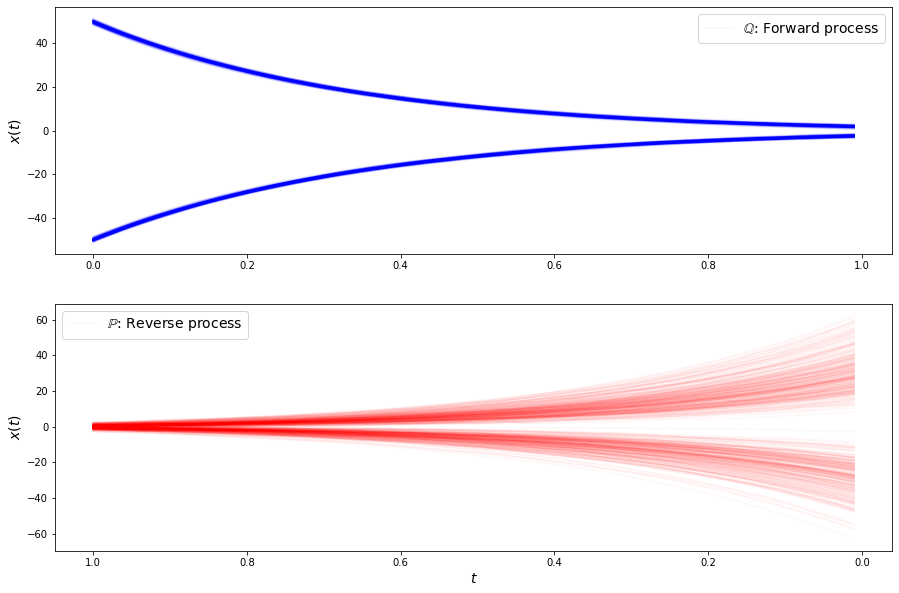

loss b 2.3522324562072754
loss b 2.4267494678497314
loss b 2.513681650161743
loss b 2.4468131065368652
loss b 2.390439748764038
loss b 2.515526533126831
loss b 2.4757189750671387
loss b 2.4428579807281494
loss b 2.5096540451049805
loss b 2.3871407508850098
loss b 2.4230167865753174
loss b 2.4141135215759277
loss b 2.4333112239837646
loss b 2.4715166091918945
loss b 2.4202864170074463
loss b 2.3905460834503174
loss b 2.3797495365142822
loss b 2.47381591796875
loss b 2.4916207790374756
loss b 2.4609479904174805
loss b 2.5184175968170166
loss b 2.4481990337371826
loss f 5.208840370178223
loss f 5.175905227661133
loss f 5.137115001678467
loss f 5.060625076293945
loss f 5.156215190887451
loss f 5.122644901275635
loss f 5.185482025146484
loss f 5.104599475860596
loss f 5.1483154296875
loss f 5.133953094482422
loss f 5.191757678985596
loss f 5.088369846343994
loss f 5.116512775421143
loss f 5.110902786254883
loss f 5.068778038024902
loss f 5.169601917266846
loss f 5.072356224060059
loss f 5.1

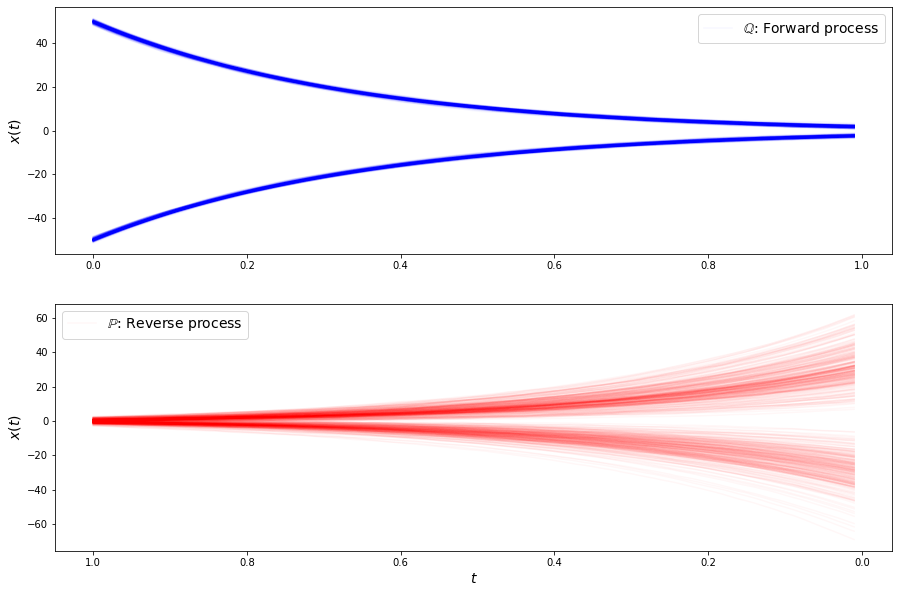

loss b 2.559612274169922
loss b 2.4566867351531982
loss b 2.4918816089630127
loss b 2.419349193572998
loss b 2.5094070434570312
loss b 2.4170455932617188
loss b 2.4602301120758057
loss b 2.5458290576934814
loss b 2.415411949157715
loss b 2.4507198333740234
loss b 2.49345064163208
loss b 2.507946491241455
loss b 2.4805996417999268
loss b 2.541248083114624
loss b 2.465456008911133
loss b 2.409224033355713
loss b 2.3920400142669678
loss b 2.424910068511963
loss b 2.4470558166503906
loss b 2.471254348754883
loss b 2.557164430618286
loss b 2.50773549079895
loss f 5.162519931793213
loss f 5.183441162109375
loss f 5.087631702423096
loss f 5.135097503662109
loss f 5.124814510345459
loss f 5.095890998840332
loss f 5.073605060577393
loss f 5.117259979248047
loss f 5.120150089263916
loss f 5.1362385749816895
loss f 5.1542792320251465
loss f 5.1185832023620605
loss f 5.054173946380615
loss f 5.109203815460205
loss f 5.089310169219971
loss f 5.158642768859863
loss f 5.071206092834473
loss f 5.05698

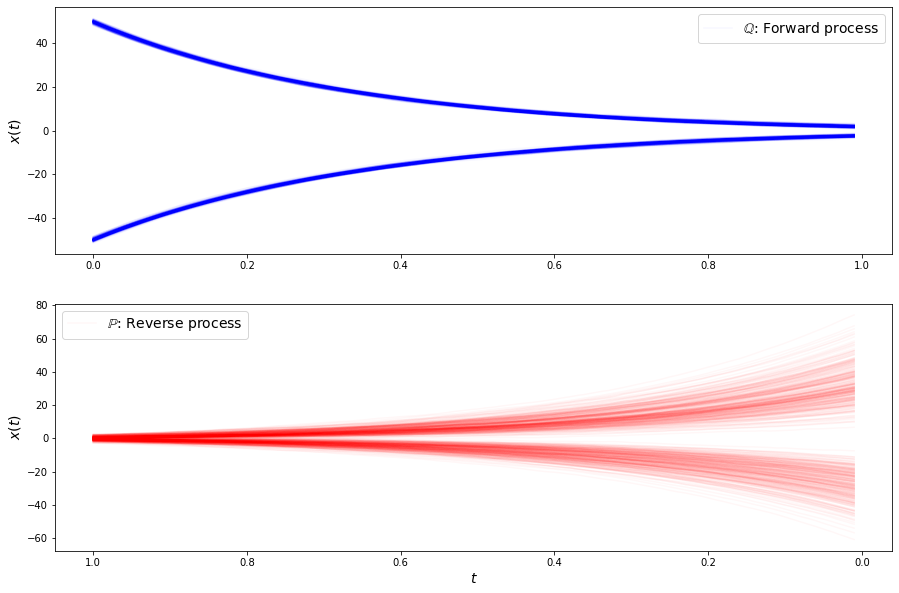

loss b 2.3877627849578857
loss b 2.3725032806396484
loss b 2.4536995887756348
loss b 2.405810594558716
loss b 2.452528953552246
loss b 2.4639947414398193
loss b 2.443026065826416
loss b 2.391657590866089
loss b 2.3274872303009033
loss b 2.455709934234619
loss b 2.386425733566284
loss b 2.3382129669189453
loss b 2.419614553451538
loss b 2.461228609085083
loss b 2.436367988586426
loss b 2.3827414512634277
loss b 2.493159532546997
loss b 2.526906967163086
loss b 2.43523907661438
loss b 2.421292781829834
loss b 2.4305219650268555
loss b 2.4558684825897217
loss f 5.058532238006592
loss f 5.073551177978516
loss f 5.049492835998535
loss f 5.089420318603516
loss f 5.131784915924072
loss f 5.07098388671875
loss f 5.025457859039307
loss f 5.065360069274902
loss f 5.141911506652832
loss f 5.076729774475098
loss f 5.106139183044434
loss f 5.029761791229248
loss f 5.101534366607666
loss f 5.122900009155273
loss f 5.093357563018799
loss f 5.056934833526611
loss f 5.059333801269531
loss f 5.097606182

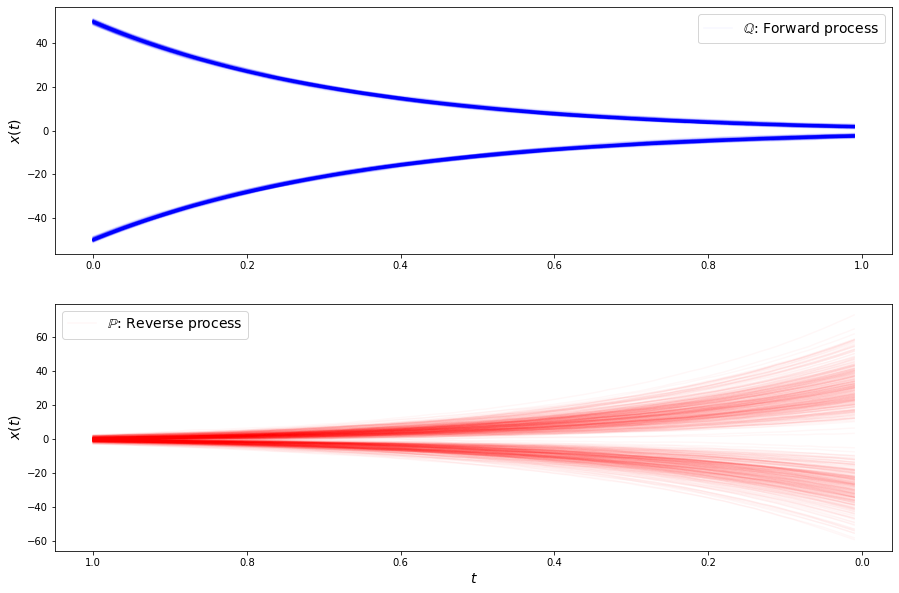

loss b 2.324279308319092
loss b 2.3881278038024902
loss b 2.4280993938446045
loss b 2.314014434814453
loss b 2.3923394680023193
loss b 2.4145925045013428
loss b 2.463160991668701
loss b 2.426912546157837
loss b 2.4494237899780273
loss b 2.3699679374694824
loss b 2.4638755321502686
loss b 2.5000717639923096
loss b 2.4321513175964355
loss b 2.395176649093628
loss b 2.365621566772461
loss b 2.3854429721832275
loss b 2.316622257232666
loss b 2.410595417022705
loss b 2.5140602588653564
loss b 2.3975231647491455
loss b 2.4599385261535645
loss b 2.3697359561920166
loss f 5.092641353607178
loss f 5.1249589920043945
loss f 5.094448089599609
loss f 5.175147533416748
loss f 5.086440086364746
loss f 5.122611045837402
loss f 5.152535438537598
loss f 5.130377769470215
loss f 4.995336055755615
loss f 5.132482051849365
loss f 5.034019947052002
loss f 5.147418975830078
loss f 5.148029327392578
loss f 5.124340534210205
loss f 5.028244972229004
loss f 5.047914028167725
loss f 5.122197151184082
loss f 5.1

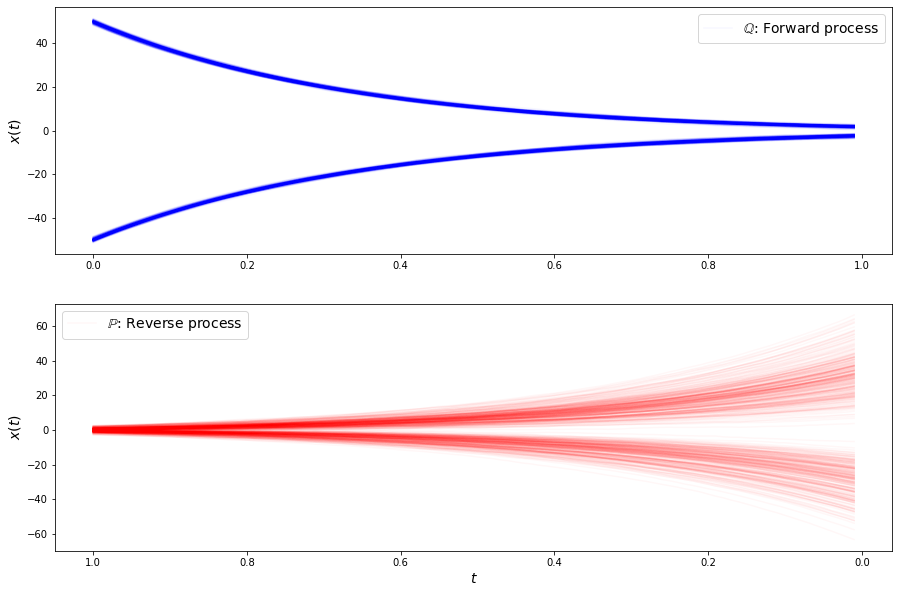

loss b 2.4504005908966064
loss b 2.3055388927459717
loss b 2.4039924144744873
loss b 2.503338575363159
loss b 2.328368663787842
loss b 2.3961644172668457
loss b 2.378709077835083
loss b 2.3739724159240723
loss b 2.406315803527832
loss b 2.3679087162017822
loss b 2.423614978790283
loss b 2.437908411026001
loss b 2.3775041103363037
loss b 2.391447067260742
loss b 2.4168777465820312
loss b 2.429119110107422
loss b 2.3999733924865723
loss b 2.4591782093048096
loss b 2.4139864444732666
loss b 2.3381893634796143
loss b 2.379880905151367
loss b 2.4646999835968018
loss f 5.0582499504089355
loss f 5.052908420562744
loss f 5.095226764678955
loss f 5.069716930389404
loss f 5.093455791473389
loss f 5.0234198570251465
loss f 5.094929218292236
loss f 5.074638843536377
loss f 5.063612937927246
loss f 5.006443023681641
loss f 5.028412818908691
loss f 5.0511322021484375
loss f 5.013434410095215
loss f 5.037651062011719
loss f 5.090412616729736
loss f 5.05335807800293
loss f 5.006217956542969
loss f 5.0

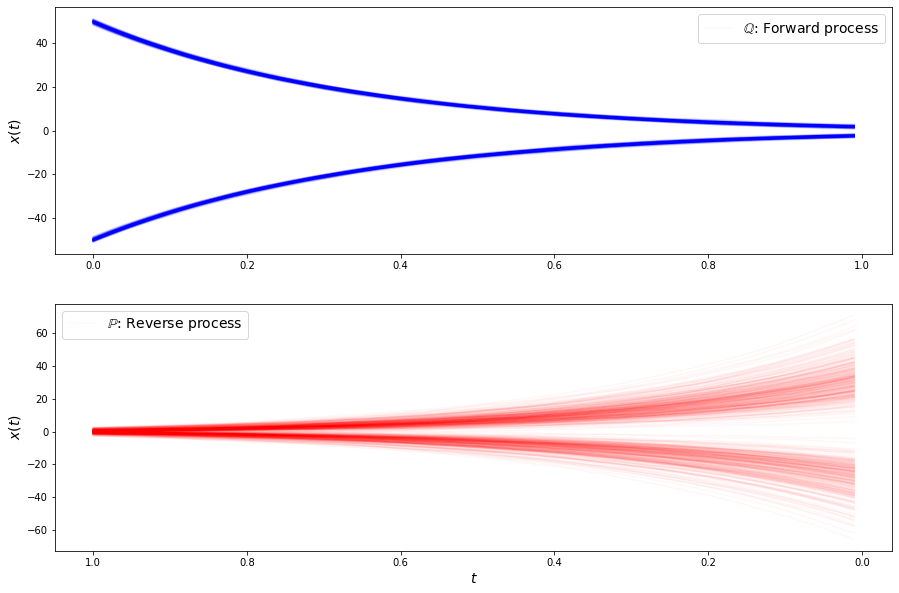

loss b 2.370913505554199
loss b 2.338822841644287
loss b 2.462709426879883
loss b 2.3734259605407715
loss b 2.384627103805542
loss b 2.3587236404418945
loss b 2.365084171295166
loss b 2.3047850131988525
loss b 2.38122296333313
loss b 2.412722587585449
loss b 2.4447286128997803
loss b 2.4205095767974854
loss b 2.332714557647705
loss b 2.3131000995635986
loss b 2.393272638320923
loss b 2.3476645946502686
loss b 2.384340286254883
loss b 2.3313944339752197
loss b 2.3177456855773926
loss b 2.3347108364105225
loss b 2.3865864276885986
loss b 2.3438758850097656
loss f 5.01485013961792
loss f 5.045600891113281
loss f 5.045894145965576
loss f 5.03331184387207
loss f 4.993650913238525
loss f 5.13724946975708
loss f 5.030832290649414
loss f 5.02446985244751
loss f 5.053564071655273
loss f 5.0824666023254395
loss f 5.0674848556518555
loss f 5.001424312591553
loss f 5.119465351104736
loss f 5.068893909454346
loss f 5.073005199432373
loss f 5.019574165344238
loss f 5.1385369300842285
loss f 5.083343

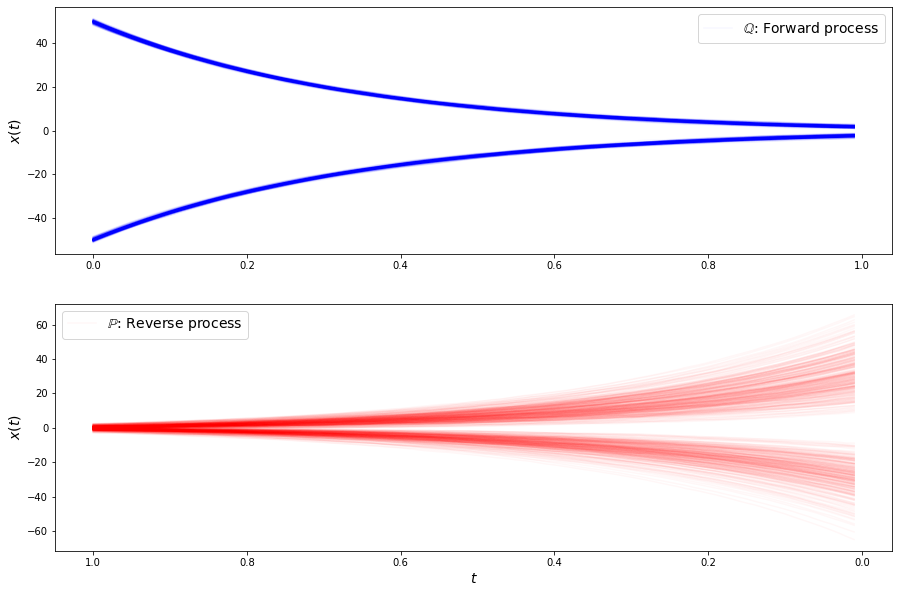

loss b 2.3180418014526367
loss b 2.3399925231933594
loss b 2.3339474201202393
loss b 2.4567439556121826
loss b 2.3027210235595703
loss b 2.425288438796997
loss b 2.2954626083374023
loss b 2.316469430923462
loss b 2.396813154220581
loss b 2.34216046333313
loss b 2.4013500213623047
loss b 2.424088954925537
loss b 2.363293409347534
loss b 2.3110814094543457
loss b 2.3325140476226807
loss b 2.3790955543518066
loss b 2.4063150882720947
loss b 2.3611748218536377
loss b 2.429831027984619
loss b 2.3800079822540283
loss b 2.3682475090026855
loss b 2.3870766162872314
loss f 5.048308372497559
loss f 5.018597602844238
loss f 5.135367393493652
loss f 5.019381046295166
loss f 5.00681209564209
loss f 5.072680950164795
loss f 5.0016770362854
loss f 5.189610004425049
loss f 5.046485900878906
loss f 5.0884504318237305
loss f 5.055005073547363
loss f 5.014770984649658
loss f 5.096817970275879
loss f 4.9586381912231445
loss f 5.014967441558838
loss f 5.018045425415039
loss f 5.005024433135986
loss f 5.021

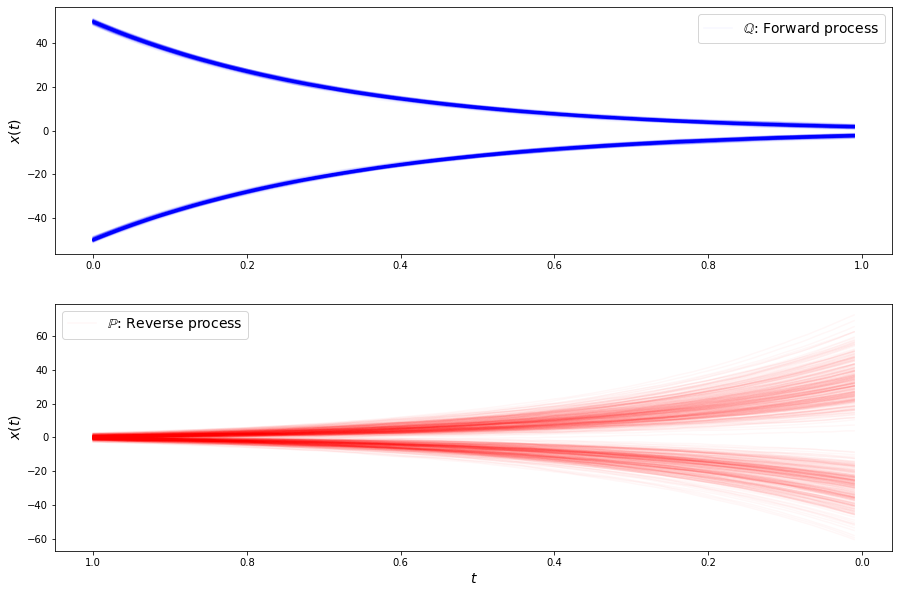

loss b 2.285161018371582
loss b 2.3719382286071777
loss b 2.3998498916625977
loss b 2.3015480041503906
loss b 2.3061139583587646
loss b 2.3724071979522705
loss b 2.268550395965576
loss b 2.309016227722168
loss b 2.3795053958892822
loss b 2.384075164794922
loss b 2.37876033782959
loss b 2.403381586074829
loss b 2.2896029949188232
loss b 2.369616985321045
loss b 2.3162379264831543
loss b 2.4119415283203125
loss b 2.314110040664673
loss b 2.396620988845825
loss b 2.3763532638549805
loss b 2.3723795413970947
loss b 2.4050729274749756
loss b 2.437562942504883
loss f 5.041158199310303
loss f 4.992917537689209
loss f 5.095071792602539
loss f 5.142862796783447
loss f 5.013678073883057
loss f 4.985841274261475
loss f 5.038200378417969
loss f 4.923519134521484
loss f 4.988574981689453
loss f 5.0230841636657715
loss f 4.956803321838379
loss f 5.113220691680908
loss f 5.031228065490723
loss f 4.979540824890137
loss f 5.044235706329346
loss f 5.019031047821045
loss f 4.992802619934082
loss f 5.0129

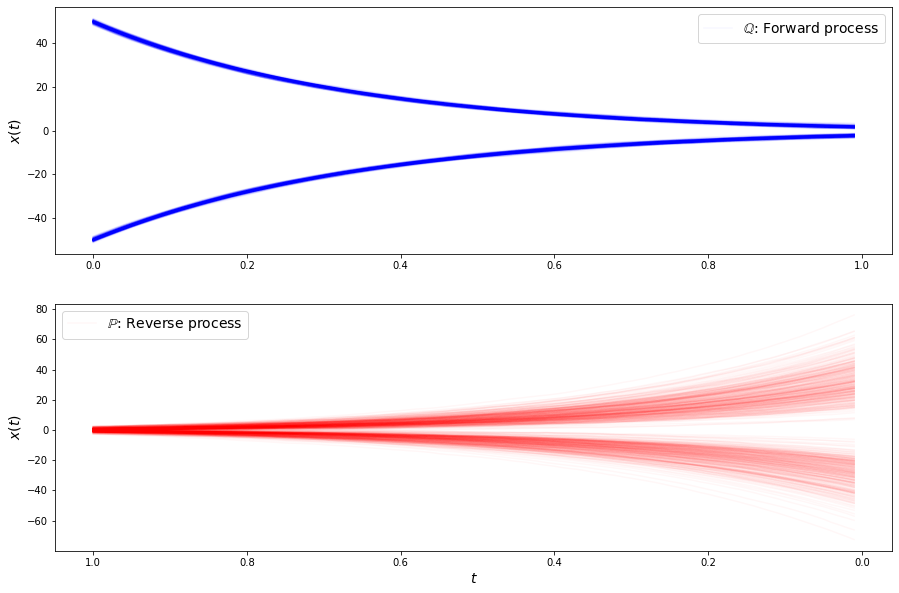

loss b 2.4083263874053955
loss b 2.365257740020752
loss b 2.277142286300659
loss b 2.368701696395874
loss b 2.5084521770477295
loss b 2.3980660438537598
loss b 2.3204829692840576
loss b 2.351381540298462
loss b 2.376701593399048
loss b 2.3771169185638428
loss b 2.3454387187957764
loss b 2.2911078929901123
loss b 2.3195784091949463
loss b 2.254330635070801
loss b 2.2886667251586914
loss b 2.3697285652160645
loss b 2.3491644859313965
loss b 2.316429615020752
loss b 2.270266532897949
loss b 2.327183961868286
loss b 2.2043566703796387
loss b 2.3780593872070312
loss f 5.053300857543945
loss f 4.973546028137207
loss f 5.021612167358398
loss f 5.064609050750732
loss f 5.011653900146484
loss f 5.052012920379639
loss f 5.0247697830200195
loss f 5.03174352645874
loss f 4.994850158691406
loss f 5.02236270904541
loss f 4.998023986816406
loss f 4.967495918273926
loss f 4.988111972808838
loss f 5.065697193145752
loss f 5.045473098754883
loss f 5.000191688537598
loss f 4.897144317626953
loss f 5.0418

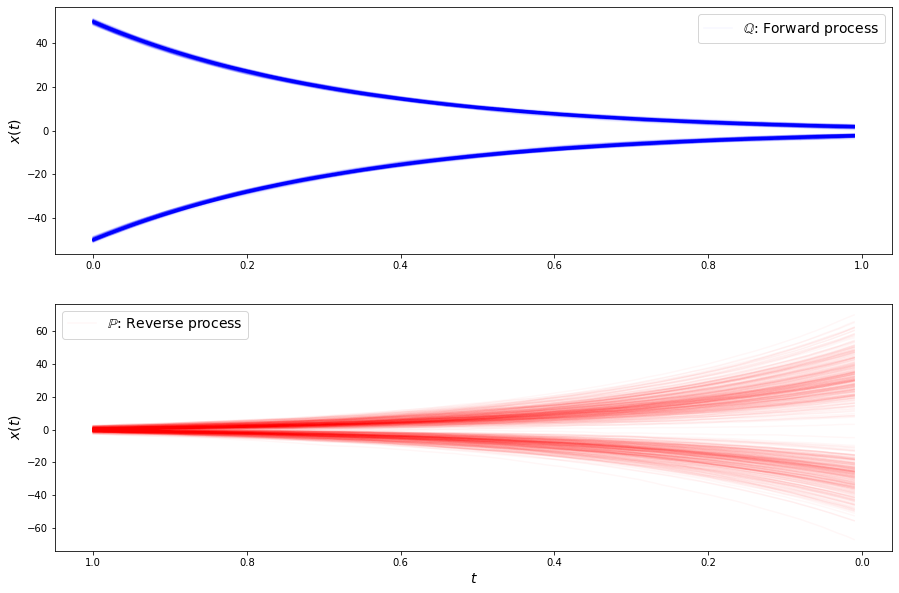

loss b 2.3315393924713135
loss b 2.323620080947876
loss b 2.350735902786255
loss b 2.3002660274505615
loss b 2.2797536849975586
loss b 2.321692943572998
loss b 2.322577953338623
loss b 2.3821496963500977
loss b 2.3827123641967773
loss b 2.4013309478759766
loss b 2.289510488510132
loss b 2.3515465259552
loss b 2.3234968185424805
loss b 2.2802743911743164
loss b 2.372114896774292
loss b 2.1452229022979736
loss b 2.325392484664917
loss b 2.406083106994629
loss b 2.297778606414795
loss b 2.34812593460083
loss b 2.3779380321502686
loss b 2.2462503910064697
loss f 5.020546913146973
loss f 5.045697212219238
loss f 5.0738630294799805
loss f 5.030333995819092
loss f 5.043628215789795
loss f 5.0623602867126465
loss f 5.042835712432861
loss f 4.983303546905518
loss f 4.944855213165283
loss f 4.9901275634765625
loss f 5.005188941955566
loss f 4.995741367340088
loss f 4.991422176361084
loss f 5.065426826477051
loss f 4.99054479598999
loss f 5.023019790649414
loss f 4.9934282302856445
loss f 4.99923

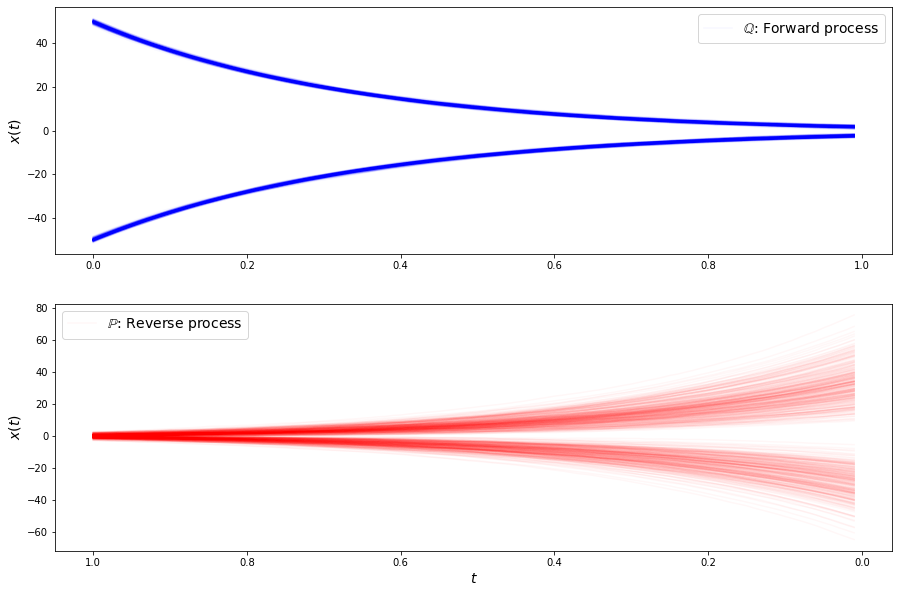

loss b 2.3451390266418457
loss b 2.3331847190856934
loss b 2.377380132675171
loss b 2.205630302429199
loss b 2.369668483734131
loss b 2.3319530487060547
loss b 2.350395441055298
loss b 2.3222079277038574
loss b 2.2062344551086426
loss b 2.4211413860321045
loss b 2.31023907661438
loss b 2.2212979793548584
loss b 2.314232587814331
loss b 2.259162425994873
loss b 2.308412551879883
loss b 2.292360544204712
loss b 2.3733887672424316
loss b 2.2148404121398926
loss b 2.2590317726135254
loss b 2.2363810539245605
loss b 2.304110527038574
loss b 2.2965810298919678
loss f 4.925571918487549
loss f 5.013134956359863
loss f 5.097223281860352
loss f 4.969415187835693
loss f 5.005478858947754
loss f 4.982516288757324
loss f 4.93383264541626
loss f 4.964737892150879
loss f 4.945353031158447
loss f 5.024353981018066
loss f 5.024778842926025
loss f 4.962037563323975
loss f 4.934957027435303
loss f 4.9462432861328125
loss f 5.015735626220703
loss f 5.016489505767822
loss f 4.968092918395996
loss f 5.02880

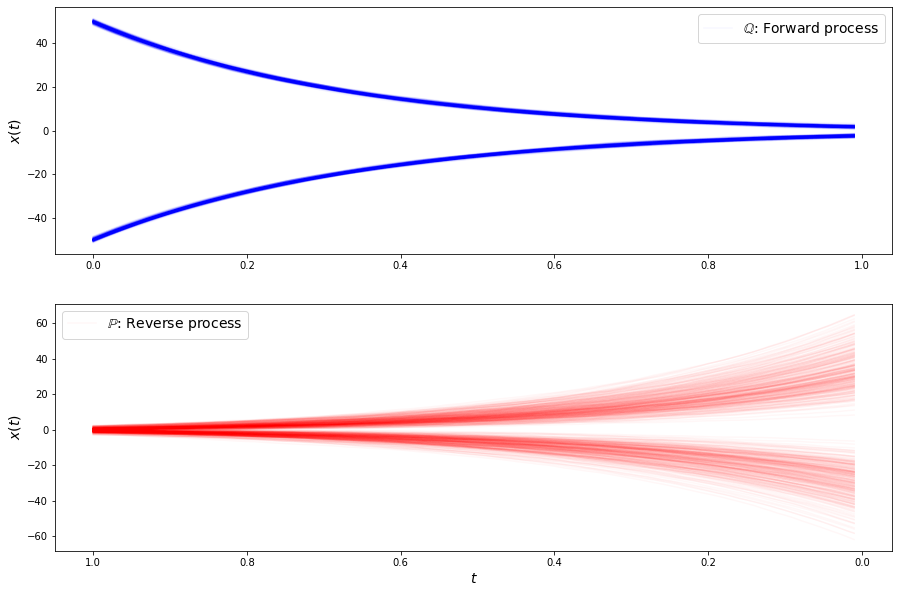

loss b 2.27655291557312
loss b 2.285141944885254
loss b 2.350163459777832
loss b 2.254551410675049
loss b 2.2361690998077393
loss b 2.261697292327881
loss b 2.273118019104004
loss b 2.2941505908966064
loss b 2.276879072189331
loss b 2.218963861465454
loss b 2.1655800342559814
loss b 2.3340940475463867
loss b 2.2332539558410645
loss b 2.2517638206481934
loss b 2.3656020164489746
loss b 2.25871205329895
loss b 2.2934792041778564
loss b 2.348828077316284
loss b 2.3594472408294678
loss b 2.1692891120910645
loss b 2.271730422973633
loss b 2.2600345611572266
loss f 4.992870807647705
loss f 4.922561168670654
loss f 5.049752712249756
loss f 4.970978736877441
loss f 4.961706161499023
loss f 4.908977508544922
loss f 4.9686198234558105
loss f 5.023673057556152
loss f 4.934232711791992
loss f 5.028073787689209
loss f 4.940262317657471
loss f 4.99560546875
loss f 4.967624664306641
loss f 4.97953462600708
loss f 4.892172813415527
loss f 4.950562000274658
loss f 4.902815818786621
loss f 4.96345472335

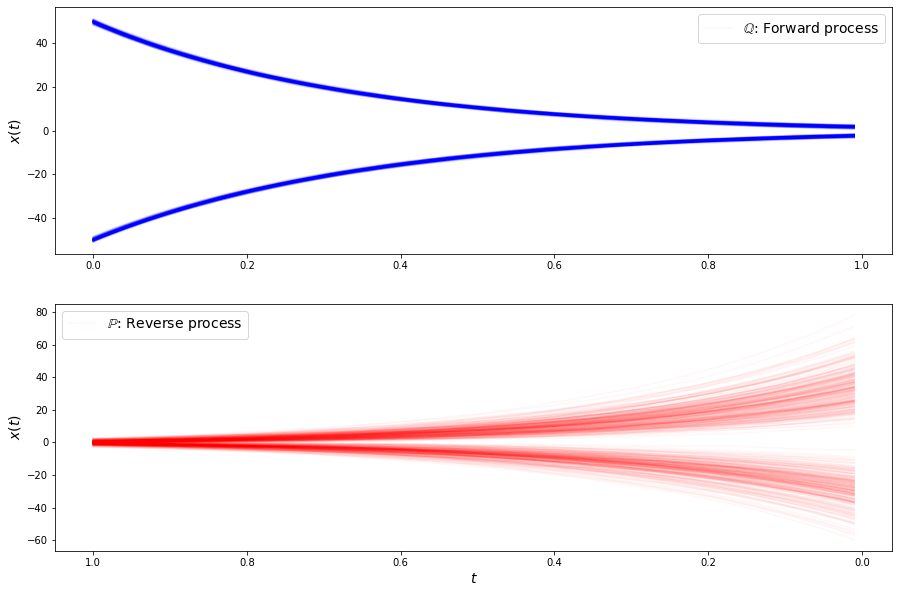

loss b 2.2729744911193848
loss b 2.244624137878418
loss b 2.311816930770874
loss b 2.2702693939208984
loss b 2.298388957977295
loss b 2.382512331008911
loss b 2.266188144683838
loss b 2.255143404006958
loss b 2.1880199909210205
loss b 2.2830355167388916
loss b 2.2722721099853516
loss b 2.325800657272339
loss b 2.26983380317688
loss b 2.212305784225464
loss b 2.242229461669922
loss b 2.2481634616851807
loss b 2.2778358459472656
loss b 2.2718183994293213
loss b 2.237705945968628
loss b 2.2830650806427
loss b 2.37136173248291
loss b 2.3410913944244385
loss f 4.983963966369629
loss f 5.034118175506592
loss f 4.923151969909668
loss f 4.889348983764648
loss f 4.966261386871338
loss f 4.956074237823486
loss f 4.975837230682373
loss f 5.028106212615967
loss f 4.958155155181885
loss f 4.9499101638793945
loss f 4.982339859008789
loss f 4.988241195678711
loss f 4.933872222900391
loss f 4.916369438171387
loss f 5.002188682556152
loss f 4.943770885467529
loss f 4.944900035858154
loss f 4.9785180091

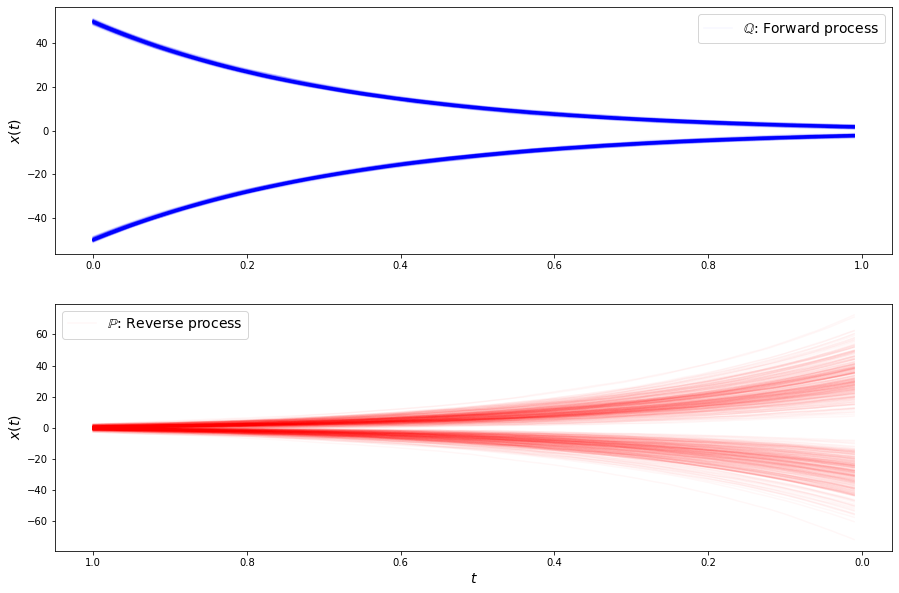

loss b 2.2502329349517822
loss b 2.2633109092712402
loss b 2.2086150646209717
loss b 2.1527209281921387
loss b 2.2637619972229004
loss b 2.2266621589660645
loss b 2.254575490951538
loss b 2.2326009273529053
loss b 2.2632193565368652
loss b 2.2213828563690186
loss b 2.2329747676849365
loss b 2.2186665534973145
loss b 2.2154881954193115
loss b 2.2041447162628174
loss b 2.275684118270874
loss b 2.214250326156616
loss b 2.192225933074951
loss b 2.2333486080169678
loss b 2.2038254737854004
loss b 2.2193877696990967
loss b 2.2938480377197266
loss b 2.3175504207611084
loss f 4.929119110107422
loss f 4.996988773345947
loss f 4.8941497802734375
loss f 4.9461469650268555
loss f 4.910956859588623
loss f 4.894381999969482
loss f 4.950084209442139
loss f 4.953708171844482
loss f 4.882110118865967
loss f 4.963991641998291
loss f 4.947761535644531
loss f 4.970141887664795
loss f 4.909329891204834
loss f 4.889267444610596
loss f 4.927967071533203
loss f 4.946220874786377
loss f 4.985507488250732
loss 

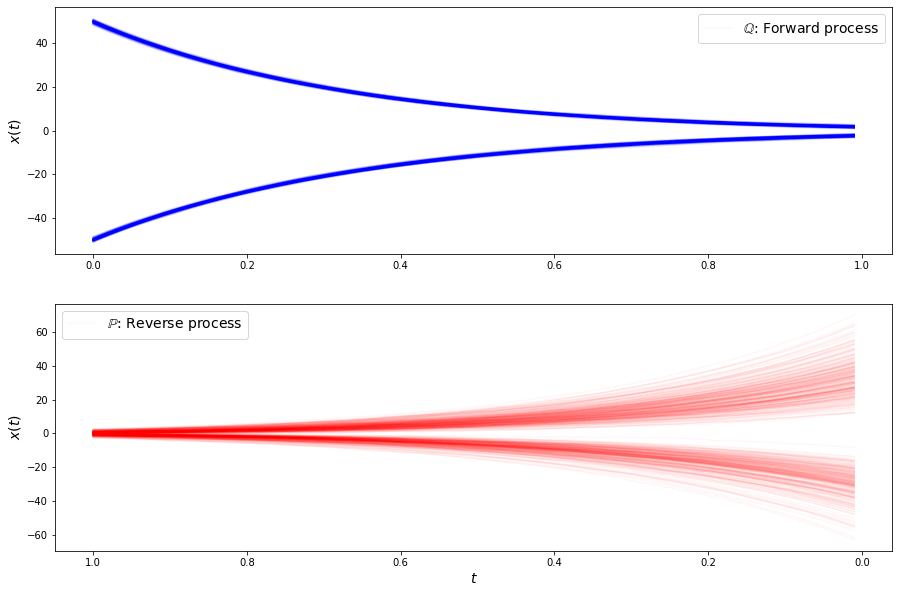

loss b 2.302966356277466
loss b 2.2535922527313232
loss b 2.2488789558410645
loss b 2.2570748329162598
loss b 2.3210418224334717
loss b 2.262784481048584
loss b 2.2132370471954346
loss b 2.170001983642578
loss b 2.2415504455566406
loss b 2.184353828430176
loss b 2.061074733734131
loss b 2.2834293842315674
loss b 2.1789329051971436
loss b 2.3398404121398926
loss b 2.2304940223693848
loss b 2.31455659866333
loss b 2.2944273948669434
loss b 2.2244324684143066
loss b 2.1141130924224854
loss b 2.2877414226531982
loss b 2.2865543365478516
loss b 2.2266671657562256
loss f 4.914796352386475
loss f 4.933063983917236
loss f 4.89953088760376
loss f 4.835527420043945
loss f 4.906001567840576
loss f 4.8839430809021
loss f 4.97811222076416
loss f 4.950258731842041
loss f 4.926403999328613
loss f 4.94323205947876
loss f 4.9798970222473145
loss f 4.936371803283691
loss f 4.933648109436035
loss f 4.883920192718506
loss f 4.905905723571777
loss f 4.902711868286133
loss f 4.929349422454834
loss f 4.87586

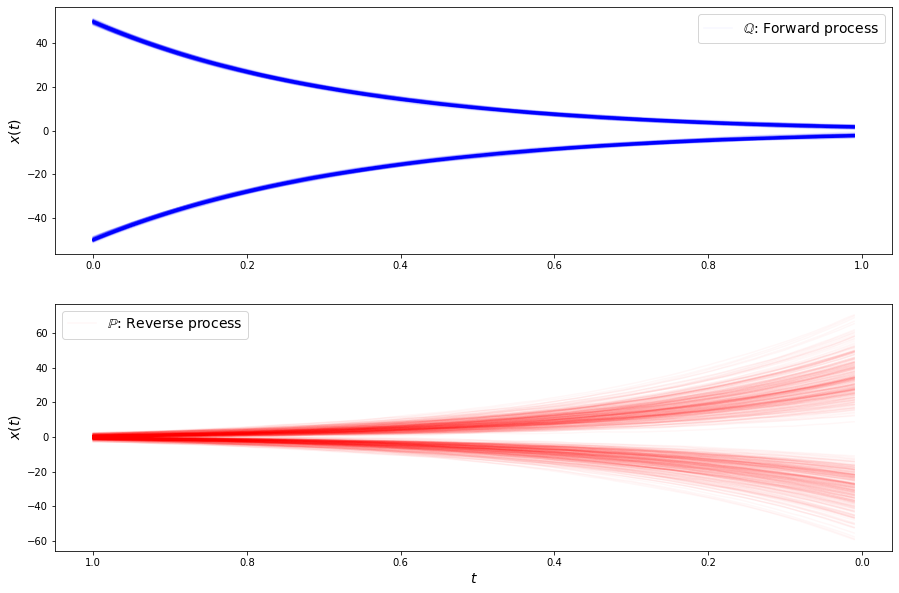

loss b 2.22499942779541
loss b 2.193082094192505
loss b 2.2478904724121094
loss b 2.1896140575408936
loss b 2.1368000507354736
loss b 2.2722949981689453
loss b 2.1905245780944824
loss b 2.1507434844970703
loss b 2.2329747676849365
loss b 2.30324649810791
loss b 2.1959781646728516
loss b 2.30812668800354
loss b 2.155442953109741
loss b 2.2775490283966064
loss b 2.3019158840179443
loss b 2.242694139480591
loss b 2.1642301082611084
loss b 2.1160778999328613
loss b 2.28817081451416
loss b 2.1761250495910645
loss b 2.2888057231903076
loss b 2.225213050842285
loss f 4.961730003356934
loss f 4.949043273925781
loss f 5.003102779388428
loss f 4.916787147521973
loss f 4.935328960418701
loss f 4.932919025421143
loss f 4.864904880523682
loss f 4.929518222808838
loss f 4.852241516113281
loss f 4.90625
loss f 4.886410236358643
loss f 4.9645233154296875
loss f 4.891965866088867
loss f 4.890539646148682
loss f 4.8364949226379395
loss f 4.924304962158203
loss f 4.9213762283325195
loss f 4.8877382278442

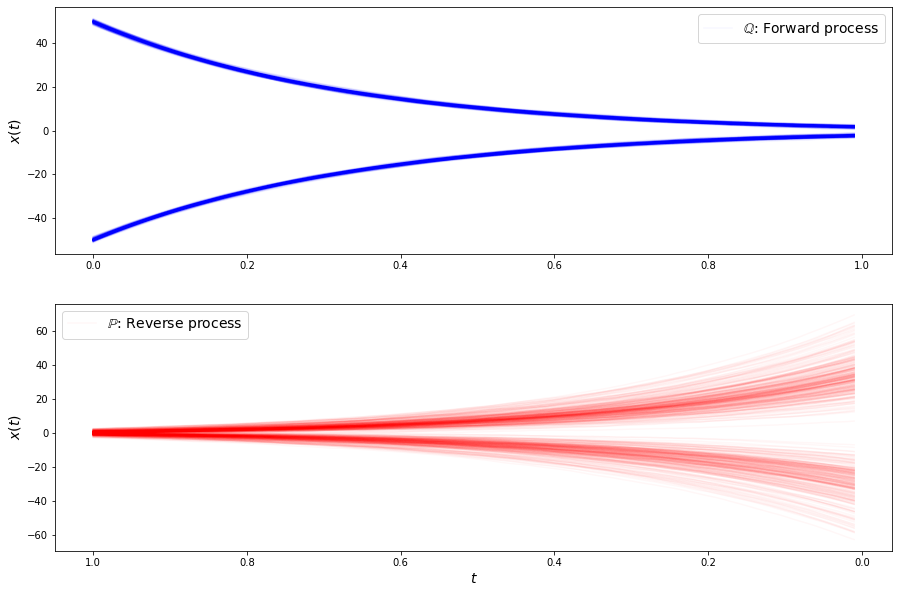

loss b 2.2401959896087646
loss b 2.1648762226104736
loss b 2.1922378540039062
loss b 2.1558310985565186
loss b 2.1226208209991455
loss b 2.228694438934326
loss b 2.159653902053833
loss b 2.142051935195923
loss b 2.2068934440612793
loss b 2.2084505558013916
loss b 2.259812831878662
loss b 2.1532769203186035
loss b 2.1540939807891846
loss b 2.24466609954834
loss b 2.2274587154388428
loss b 2.1507039070129395
loss b 2.240307569503784
loss b 2.1820828914642334
loss b 2.208953857421875
loss b 2.2255125045776367
loss b 2.254434108734131
loss b 2.2390847206115723
loss f 4.863636493682861
loss f 4.996493816375732
loss f 4.8557658195495605
loss f 4.887632369995117
loss f 4.863889217376709
loss f 4.941402912139893
loss f 4.92167854309082
loss f 4.907602310180664
loss f 4.858320236206055
loss f 4.858133792877197
loss f 4.915445327758789
loss f 4.888011455535889
loss f 4.936750411987305
loss f 4.966859817504883
loss f 4.856804847717285
loss f 4.887113094329834
loss f 4.969468116760254
loss f 4.902

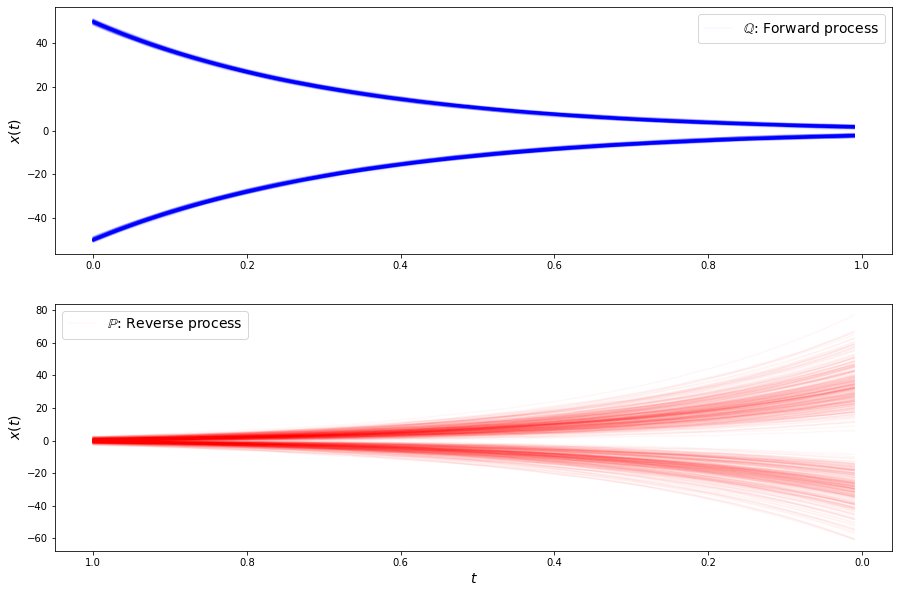

loss b 2.1475749015808105
loss b 2.218209743499756
loss b 2.1740405559539795
loss b 2.171455144882202
loss b 2.2363314628601074
loss b 2.2082200050354004
loss b 2.2412185668945312
loss b 2.223778486251831
loss b 2.1295862197875977
loss b 2.1275737285614014
loss b 2.184511423110962
loss b 2.158128261566162
loss b 2.149552822113037
loss b 2.197793960571289
loss b 2.1514694690704346
loss b 2.2648000717163086
loss b 2.1749155521392822
loss b 2.1307125091552734
loss b 2.2210819721221924
loss b 2.165886640548706
loss b 2.142942428588867
loss b 2.298407554626465
loss f 4.897679805755615
loss f 4.947468280792236
loss f 4.900136947631836
loss f 4.842533111572266
loss f 4.855196475982666
loss f 4.8518829345703125
loss f 4.930657863616943
loss f 4.889450550079346
loss f 4.900302886962891
loss f 4.8953728675842285
loss f 4.934460163116455
loss f 4.848138809204102
loss f 4.855249881744385
loss f 4.880740165710449
loss f 4.847627639770508
loss f 4.863650321960449
loss f 4.862067699432373
loss f 4.91

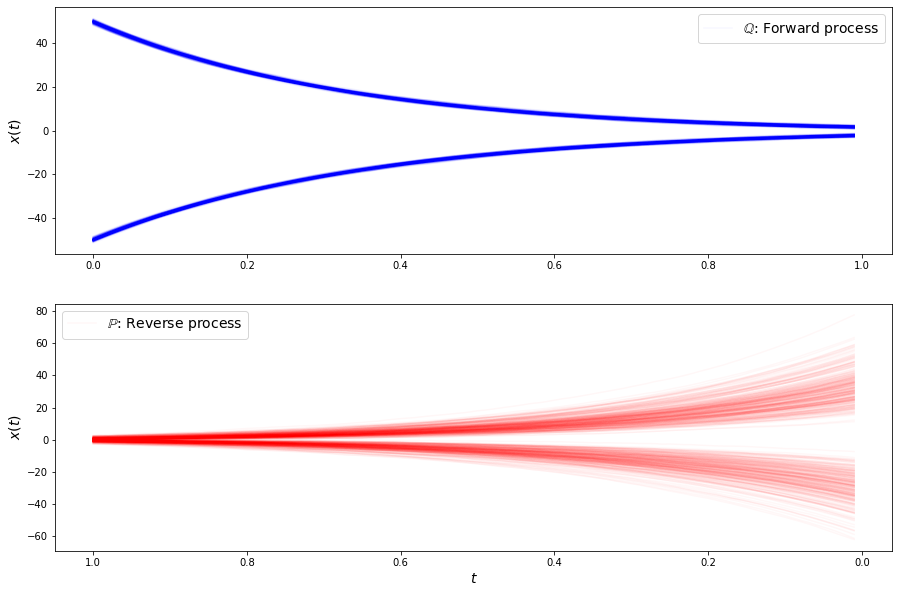

loss b 2.1066689491271973
loss b 2.1226184368133545
loss b 2.2226600646972656
loss b 2.2006919384002686
loss b 2.1277687549591064
loss b 2.1563000679016113
loss b 2.2467422485351562
loss b 2.2264249324798584
loss b 2.126574993133545
loss b 2.1558361053466797
loss b 2.1998794078826904
loss b 2.23773193359375
loss b 2.1176764965057373
loss b 2.1436944007873535
loss b 2.099705457687378
loss b 2.201448440551758
loss b 2.207737922668457
loss b 2.2039153575897217
loss b 2.1429975032806396
loss b 2.0455000400543213
loss b 2.1734871864318848
loss b 2.160862922668457
loss f 4.898996829986572
loss f 4.814793109893799
loss f 4.906571388244629
loss f 4.821715831756592
loss f 4.785754680633545
loss f 4.876492977142334
loss f 4.900654315948486
loss f 4.879483699798584
loss f 4.867034912109375
loss f 4.754700183868408
loss f 4.862488269805908
loss f 4.872206211090088
loss f 4.888148784637451
loss f 4.825528144836426
loss f 4.773240089416504
loss f 4.858230113983154
loss f 4.880019187927246
loss f 4.8

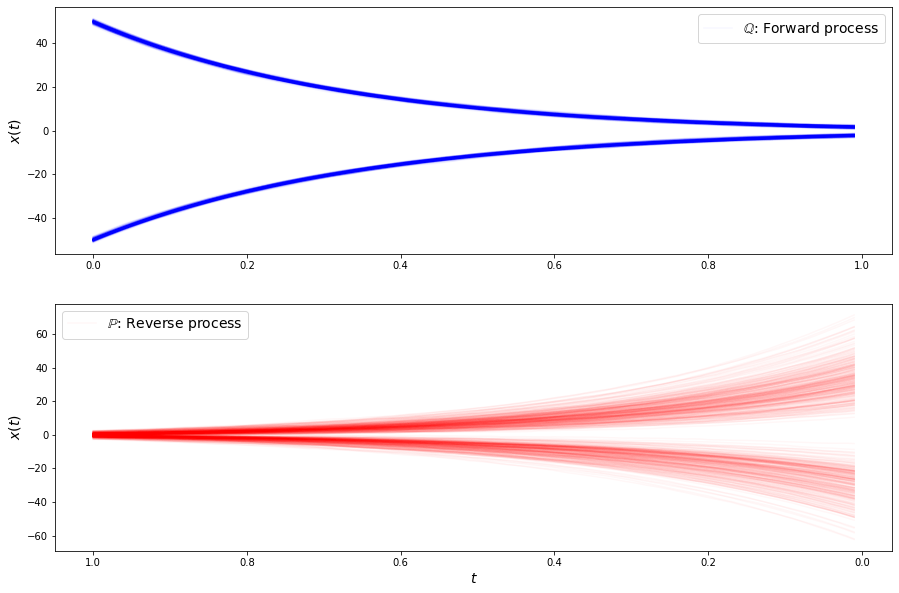

loss b 2.172313928604126
loss b 2.076106071472168
loss b 2.114449977874756
loss b 2.163968086242676
loss b 2.2080295085906982
loss b 2.1580464839935303
loss b 2.2063369750976562
loss b 2.153903007507324
loss b 2.1184580326080322
loss b 2.1836748123168945
loss b 2.204848051071167
loss b 2.084319591522217
loss b 2.2043120861053467
loss b 2.203179359436035
loss b 2.18172550201416
loss b 2.1736838817596436
loss b 2.0948941707611084
loss b 2.113969564437866
loss b 2.1974339485168457
loss b 2.1491570472717285
loss b 2.2112011909484863
loss b 2.086656332015991
loss f 4.863173484802246
loss f 4.818410873413086
loss f 4.787421226501465
loss f 4.845485687255859
loss f 4.8632121086120605
loss f 4.848686218261719
loss f 4.821154594421387
loss f 4.852640151977539
loss f 4.898486137390137
loss f 4.848343372344971
loss f 4.8647284507751465
loss f 4.880108833312988
loss f 4.893019676208496
loss f 4.82896614074707
loss f 4.8470540046691895
loss f 4.874979019165039
loss f 4.875434398651123
loss f 4.8832

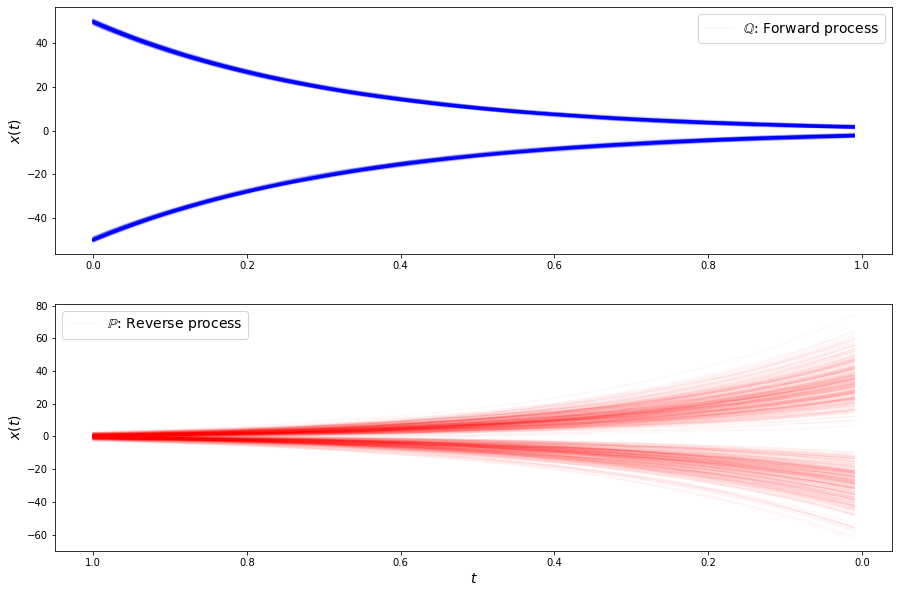

loss b 2.112382411956787
loss b 2.164731025695801
loss b 2.0640745162963867
loss b 2.1024434566497803
loss b 2.0842363834381104
loss b 2.116492986679077
loss b 2.2226994037628174
loss b 2.098449945449829
loss b 2.114908456802368
loss b 2.0940585136413574
loss b 2.138579845428467
loss b 2.0942821502685547
loss b 2.1753885746002197
loss b 2.1012580394744873
loss b 2.1167218685150146
loss b 2.1290230751037598
loss b 2.099801540374756
loss b 2.1842308044433594
loss b 2.047212839126587
loss b 2.224745988845825
loss b 2.1173036098480225
loss b 2.148282051086426
loss f 4.854711532592773
loss f 4.875351905822754
loss f 4.812777996063232
loss f 4.882875919342041
loss f 4.806497573852539
loss f 4.8617401123046875
loss f 4.861960411071777
loss f 4.826389789581299
loss f 4.776679992675781
loss f 4.823713779449463
loss f 4.878975868225098
loss f 4.820909023284912
loss f 4.8431830406188965
loss f 4.858718395233154
loss f 4.829955101013184
loss f 4.81589412689209
loss f 4.783764839172363
loss f 4.747

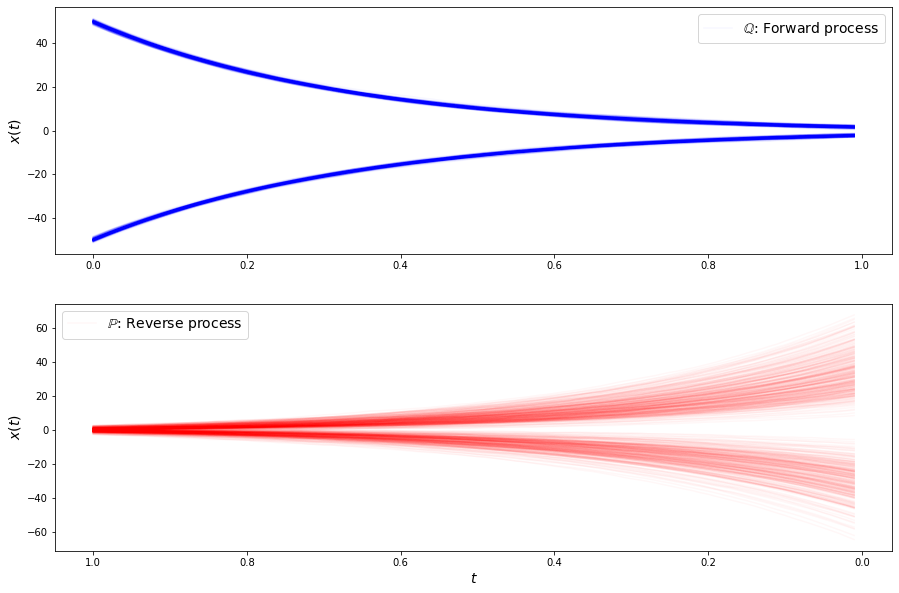

loss b 2.0836551189422607
loss b 2.0455033779144287
loss b 2.1657233238220215
loss b 2.1054329872131348
loss b 2.156589984893799
loss b 2.154998540878296
loss b 2.0944948196411133
loss b 2.082059144973755
loss b 2.131002902984619
loss b 2.165884494781494
loss b 2.1283161640167236
loss b 2.0818307399749756
loss b 2.099989414215088
loss b 2.1332554817199707
loss b 2.1009480953216553
loss b 2.131779193878174
loss b 2.079859495162964
loss b 2.1597325801849365
loss b 2.184035539627075
loss b 2.114807605743408
loss b 2.214155435562134
loss b 2.0868241786956787
loss f 4.85169792175293
loss f 4.86939001083374
loss f 4.825702667236328
loss f 4.841784954071045
loss f 4.896632671356201
loss f 4.818811893463135
loss f 4.8108038902282715
loss f 4.877089023590088
loss f 4.804018497467041
loss f 4.8449296951293945
loss f 4.753475189208984
loss f 4.931126117706299
loss f 4.859180927276611
loss f 4.858399391174316
loss f 4.849874019622803
loss f 4.874792098999023
loss f 4.83586311340332
loss f 4.755739

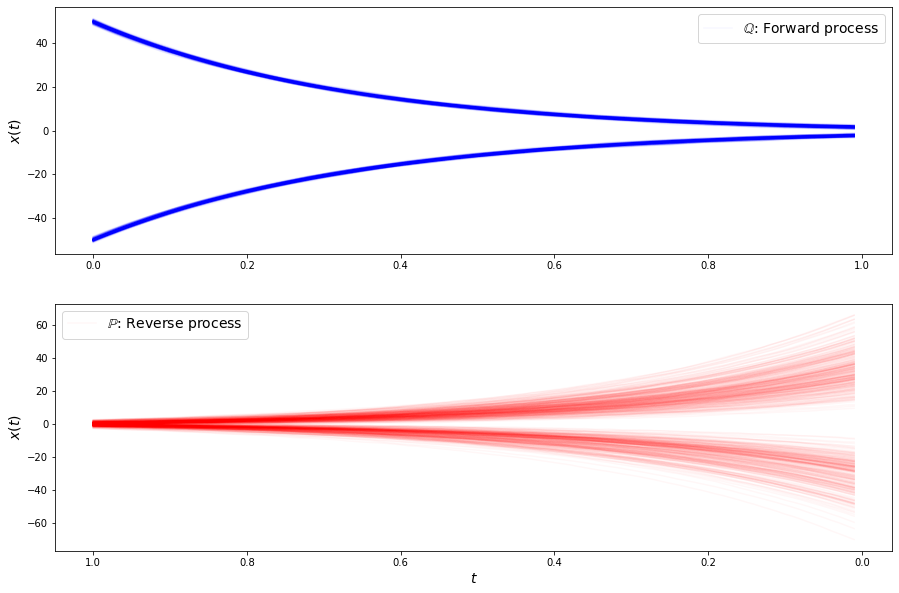

loss b 2.199934244155884
loss b 2.224587917327881
loss b 2.2199289798736572
loss b 2.210503101348877
loss b 2.134676456451416
loss b 2.0901060104370117
loss b 1.9871275424957275
loss b 2.144517421722412
loss b 2.2267959117889404
loss b 2.1261935234069824
loss b 2.2654435634613037
loss b 2.0968844890594482
loss b 2.1214094161987305
loss b 2.151632785797119
loss b 2.0113630294799805
loss b 2.1189661026000977
loss b 2.0346450805664062
loss b 2.0931994915008545
loss b 2.117920160293579
loss b 2.120187997817993
loss b 2.128382921218872
loss b 2.1167356967926025
loss f 4.825223922729492
loss f 4.829359531402588
loss f 4.764034271240234
loss f 4.832428455352783
loss f 4.811377048492432
loss f 4.8783674240112305
loss f 4.802402973175049
loss f 4.86253547668457
loss f 4.834716796875
loss f 4.791927814483643
loss f 4.819208145141602
loss f 4.872350215911865
loss f 4.833633899688721
loss f 4.801912784576416
loss f 4.763782978057861
loss f 4.7655839920043945
loss f 4.796657085418701
loss f 4.80334

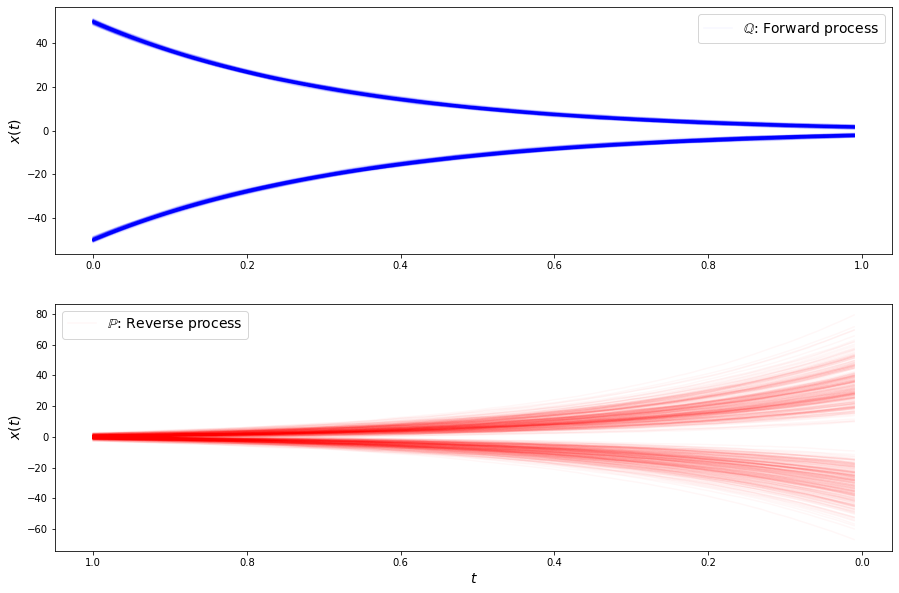

loss b 2.167628765106201
loss b 2.0437376499176025
loss b 2.172492027282715
loss b 2.151721715927124
loss b 2.069338321685791
loss b 2.1146984100341797
loss b 2.074599266052246
loss b 2.0525591373443604
loss b 2.092402935028076
loss b 2.1382720470428467
loss b 2.112549304962158
loss b 2.1034493446350098
loss b 2.147753953933716
loss b 2.0789995193481445
loss b 2.085602045059204
loss b 2.080981731414795
loss b 2.0738134384155273
loss b 2.13668155670166
loss b 2.0310797691345215
loss b 2.1991004943847656
loss b 2.1145002841949463
loss b 2.078622817993164
loss f 4.774468898773193
loss f 4.797471046447754
loss f 4.775701999664307
loss f 4.817944049835205
loss f 4.799821853637695
loss f 4.790730953216553
loss f 4.76846981048584
loss f 4.803121089935303
loss f 4.830530166625977
loss f 4.766529083251953
loss f 4.800114154815674
loss f 4.761509895324707
loss f 4.762792110443115
loss f 4.785313129425049
loss f 4.730769157409668
loss f 4.753347873687744
loss f 4.735065937042236
loss f 4.73825407

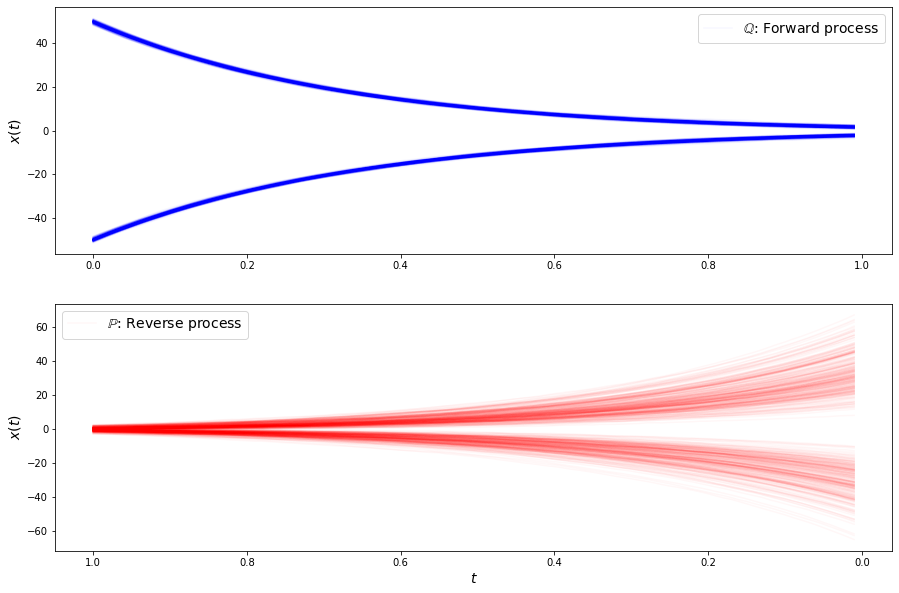

loss b 2.0850770473480225
loss b 2.1167967319488525
loss b 2.0485920906066895
loss b 2.0555317401885986
loss b 2.0610785484313965
loss b 2.037374258041382
loss b 2.1652019023895264
loss b 2.0046231746673584
loss b 2.1219210624694824
loss b 2.016364097595215
loss b 2.0643320083618164
loss b 2.0201761722564697
loss b 2.0286715030670166
loss b 2.072406053543091
loss b 2.0468788146972656
loss b 2.072331666946411
loss b 2.034313201904297
loss b 2.037353515625
loss b 2.120403289794922
loss b 2.081322431564331
loss b 2.0399820804595947
loss b 2.1780240535736084
loss f 4.7370758056640625
loss f 4.739788055419922
loss f 4.804697036743164
loss f 4.773667812347412
loss f 4.763062000274658
loss f 4.734291076660156
loss f 4.828269958496094
loss f 4.7415008544921875
loss f 4.800147533416748
loss f 4.795146942138672
loss f 4.833685874938965
loss f 4.733449459075928
loss f 4.774378776550293
loss f 4.787396430969238
loss f 4.7819719314575195
loss f 4.756256103515625
loss f 4.801548480987549
loss f 4.81

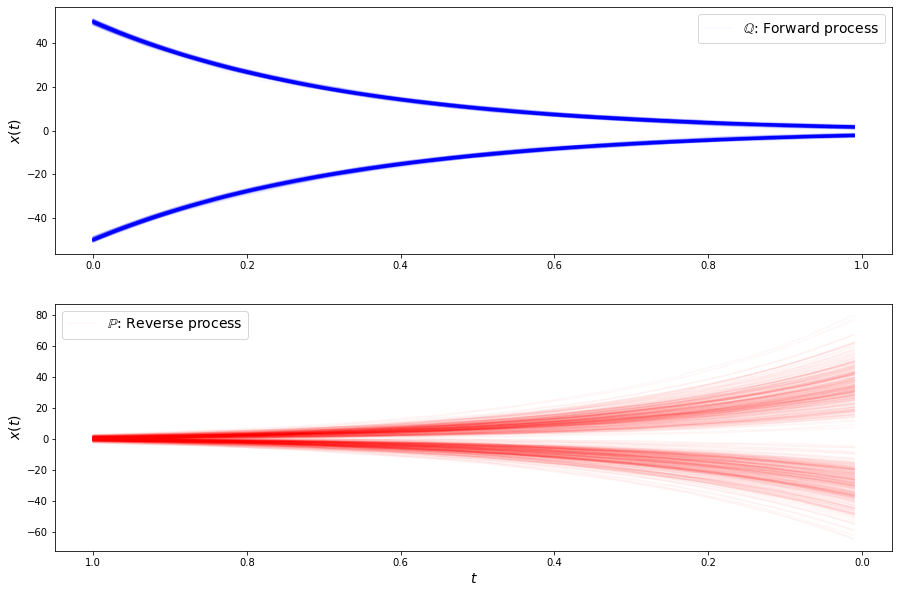

loss b 2.1398274898529053
loss b 1.9770077466964722
loss b 2.0682928562164307
loss b 2.0204970836639404
loss b 2.0117359161376953
loss b 2.1230509281158447
loss b 2.03790283203125
loss b 2.10333251953125
loss b 2.084707260131836
loss b 1.9384535551071167
loss b 2.072303056716919
loss b 2.018437147140503
loss b 1.9653927087783813
loss b 2.112260103225708
loss b 2.0164060592651367
loss b 1.978158950805664
loss b 2.0480430126190186
loss b 2.131519079208374
loss b 2.0395431518554688
loss b 2.1582539081573486
loss b 2.107386350631714
loss b 2.075582265853882
loss f 4.8065900802612305
loss f 4.763123035430908
loss f 4.803911209106445
loss f 4.823237895965576
loss f 4.746578216552734
loss f 4.786340236663818
loss f 4.803699970245361
loss f 4.674474716186523
loss f 4.735456943511963
loss f 4.783122539520264
loss f 4.765778064727783
loss f 4.769660472869873
loss f 4.790251731872559
loss f 4.7465128898620605
loss f 4.699626922607422
loss f 4.72889518737793
loss f 4.730151176452637
loss f 4.82655

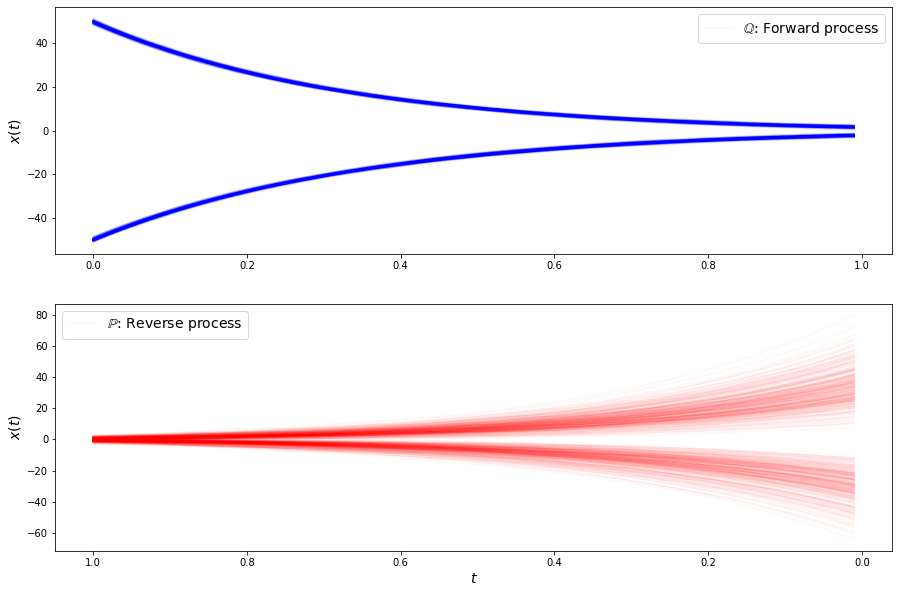

loss b 2.0382819175720215
loss b 1.971738338470459
loss b 2.025883436203003
loss b 2.0147106647491455
loss b 1.9318238496780396
loss b 2.0909085273742676
loss b 2.0974724292755127
loss b 2.0773417949676514
loss b 2.098459482192993
loss b 2.0697147846221924
loss b 1.9126743078231812
loss b 2.087951183319092
loss b 2.1190614700317383
loss b 2.0308003425598145
loss b 2.0515353679656982
loss b 1.954632043838501
loss b 2.0411503314971924
loss b 2.0095577239990234
loss b 1.985458254814148
loss b 2.020129919052124
loss b 2.0525622367858887
loss b 2.0697596073150635
loss f 4.731406211853027
loss f 4.694791793823242
loss f 4.765048503875732
loss f 4.822248935699463
loss f 4.72111701965332
loss f 4.759943962097168
loss f 4.691674709320068
loss f 4.722035884857178
loss f 4.731121063232422
loss f 4.740503787994385
loss f 4.760868549346924
loss f 4.760143280029297
loss f 4.747212886810303
loss f 4.751766204833984
loss f 4.735424041748047
loss f 4.738318920135498
loss f 4.72498893737793
loss f 4.740

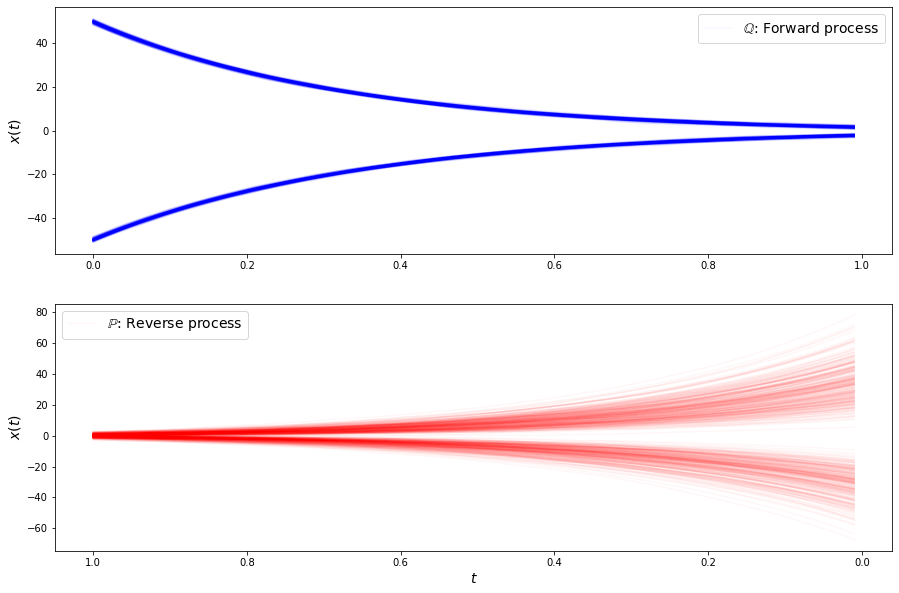

loss b 2.0623130798339844
loss b 1.980171799659729
loss b 2.038114309310913
loss b 2.019958019256592
loss b 2.0243215560913086
loss b 2.053734302520752
loss b 2.056757688522339
loss b 2.0251588821411133
loss b 2.0991575717926025
loss b 2.0770606994628906
loss b 1.986944317817688
loss b 2.1277925968170166
loss b 2.0460519790649414
loss b 1.9487427473068237
loss b 1.9859932661056519
loss b 2.0583763122558594
loss b 2.0370867252349854
loss b 1.9323554039001465
loss b 2.0200343132019043
loss b 2.0792810916900635
loss b 2.040914535522461
loss b 2.0196657180786133
loss f 4.734612464904785
loss f 4.756514072418213
loss f 4.761617183685303
loss f 4.762877941131592
loss f 4.761660099029541
loss f 4.693698883056641
loss f 4.734888076782227
loss f 4.738357067108154
loss f 4.754587173461914
loss f 4.667163848876953
loss f 4.714968681335449
loss f 4.715559959411621
loss f 4.709718227386475
loss f 4.7498064041137695
loss f 4.715760231018066
loss f 4.688415050506592
loss f 4.788013458251953
loss f 4.

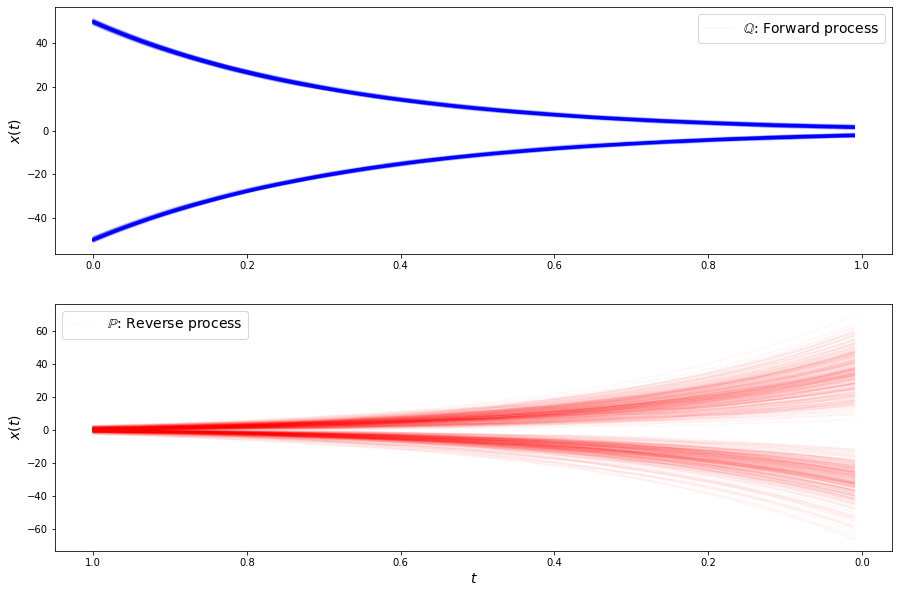

loss b 2.0169289112091064
loss b 2.0511062145233154
loss b 1.9595261812210083
loss b 2.0313775539398193
loss b 1.9820810556411743
loss b 2.0161116123199463
loss b 2.1528775691986084
loss b 2.0661990642547607
loss b 2.0248212814331055
loss b 2.012932538986206
loss b 1.9744616746902466
loss b 1.9716246128082275
loss b 1.9109134674072266
loss b 1.935628890991211
loss b 2.0005667209625244
loss b 2.0467286109924316
loss b 1.9121099710464478
loss b 2.0396533012390137
loss b 2.0749166011810303
loss b 1.9802515506744385
loss b 2.0224602222442627
loss b 1.99144446849823
loss f 4.709731101989746
loss f 4.720794200897217
loss f 4.733033180236816
loss f 4.692489147186279
loss f 4.704744815826416
loss f 4.74540376663208
loss f 4.716648578643799
loss f 4.6803975105285645
loss f 4.682828903198242
loss f 4.764325141906738
loss f 4.722370147705078
loss f 4.75850248336792
loss f 4.676239490509033
loss f 4.6675567626953125
loss f 4.696630001068115
loss f 4.648820877075195
loss f 4.720664978027344
loss f 

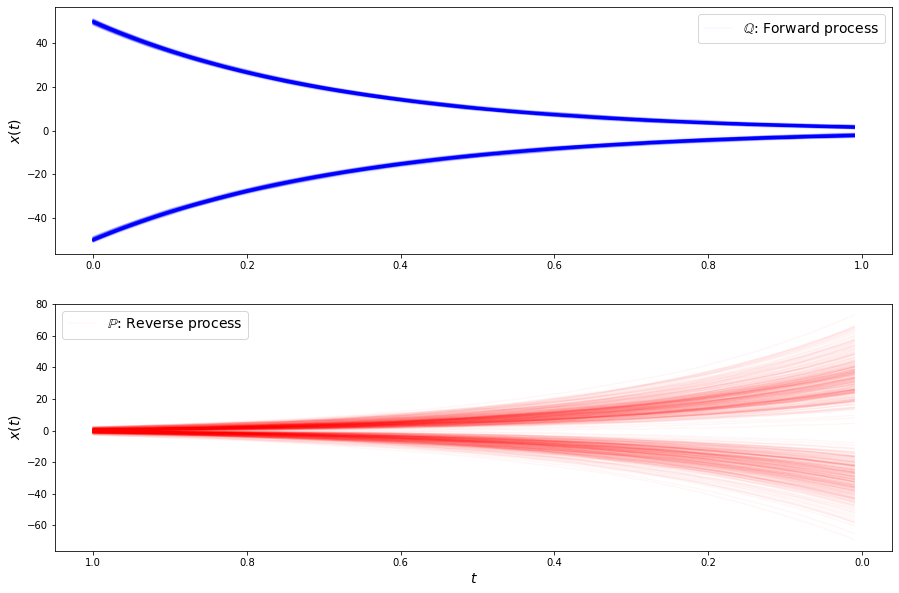

loss b 2.012239933013916
loss b 1.9836397171020508
loss b 1.9937467575073242
loss b 1.9680315256118774
loss b 2.030198097229004
loss b 2.010493755340576
loss b 1.90869140625
loss b 1.97245454788208
loss b 2.0273497104644775
loss b 1.9634312391281128
loss b 1.9760668277740479
loss b 2.0457489490509033
loss b 1.9810190200805664
loss b 1.9768229722976685
loss b 1.9107675552368164
loss b 1.9779024124145508
loss b 1.9234809875488281
loss b 2.0081965923309326
loss b 1.9260071516036987
loss b 1.9555953741073608
loss b 2.0580873489379883
loss b 1.9029065370559692
loss f 4.712315082550049
loss f 4.700493812561035
loss f 4.700198173522949
loss f 4.734260559082031
loss f 4.663474082946777
loss f 4.6594438552856445
loss f 4.708539009094238
loss f 4.720271110534668
loss f 4.694128513336182
loss f 4.674808025360107
loss f 4.707945823669434
loss f 4.670283794403076
loss f 4.636495113372803
loss f 4.71982479095459
loss f 4.692704200744629
loss f 4.7355241775512695
loss f 4.661898136138916
loss f 4.677

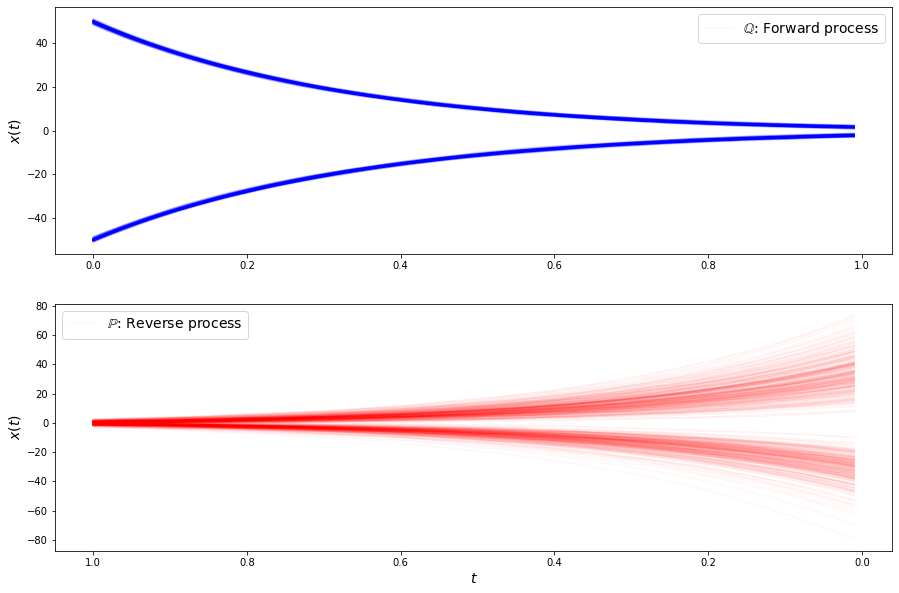

loss b 1.9832987785339355
loss b 1.942042589187622
loss b 1.9822229146957397
loss b 1.956271767616272
loss b 1.9532607793807983
loss b 2.02919340133667
loss b 1.9820609092712402
loss b 2.002837896347046
loss b 1.9566932916641235
loss b 2.051842212677002
loss b 1.962081789970398
loss b 1.9662443399429321
loss b 2.000053882598877
loss b 1.986918568611145
loss b 2.0174577236175537
loss b 1.9765321016311646
loss b 2.075810670852661
loss b 2.0165271759033203
loss b 1.9898813962936401
loss b 1.930803656578064
loss b 1.973973274230957
loss b 2.0283331871032715
loss f 4.706211566925049
loss f 4.682528972625732
loss f 4.748589038848877
loss f 4.731773853302002
loss f 4.7432966232299805
loss f 4.692270278930664
loss f 4.702064037322998
loss f 4.741766929626465
loss f 4.6548662185668945
loss f 4.7286248207092285
loss f 4.632070064544678
loss f 4.681234836578369
loss f 4.714282989501953
loss f 4.708286762237549
loss f 4.675391674041748
loss f 4.6902384757995605
loss f 4.637420177459717
loss f 4.68

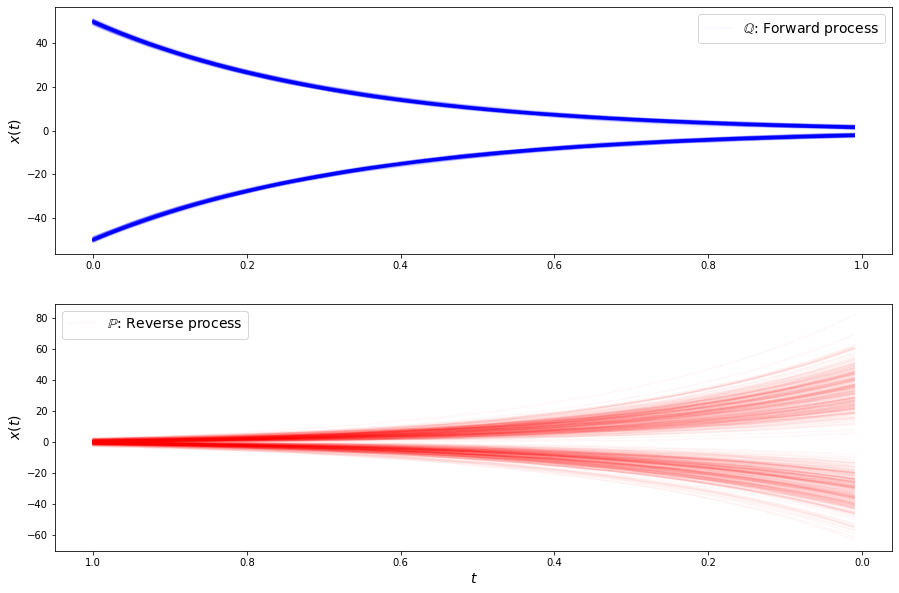

loss b 1.8519892692565918
loss b 2.019599437713623
loss b 1.8521709442138672
loss b 2.0332508087158203
loss b 1.9598946571350098
loss b 1.8832097053527832
loss b 1.904631495475769
loss b 1.9319982528686523
loss b 1.981881856918335
loss b 1.9466404914855957
loss b 1.9753597974777222
loss b 1.936516523361206
loss b 1.9695231914520264
loss b 1.883334994316101
loss b 2.0015172958374023
loss b 1.9170382022857666
loss b 1.9717947244644165
loss b 1.9044017791748047
loss b 1.8121132850646973
loss b 1.9806556701660156
loss b 1.903186321258545
loss b 2.046896457672119
loss f 4.647284030914307
loss f 4.683597087860107
loss f 4.689055442810059
loss f 4.684037208557129
loss f 4.710151195526123
loss f 4.628047466278076
loss f 4.672057151794434
loss f 4.66866397857666
loss f 4.7134480476379395
loss f 4.66654109954834
loss f 4.680751800537109
loss f 4.690605163574219
loss f 4.676886081695557
loss f 4.618680000305176
loss f 4.654642105102539
loss f 4.726583480834961
loss f 4.676772117614746
loss f 4.74

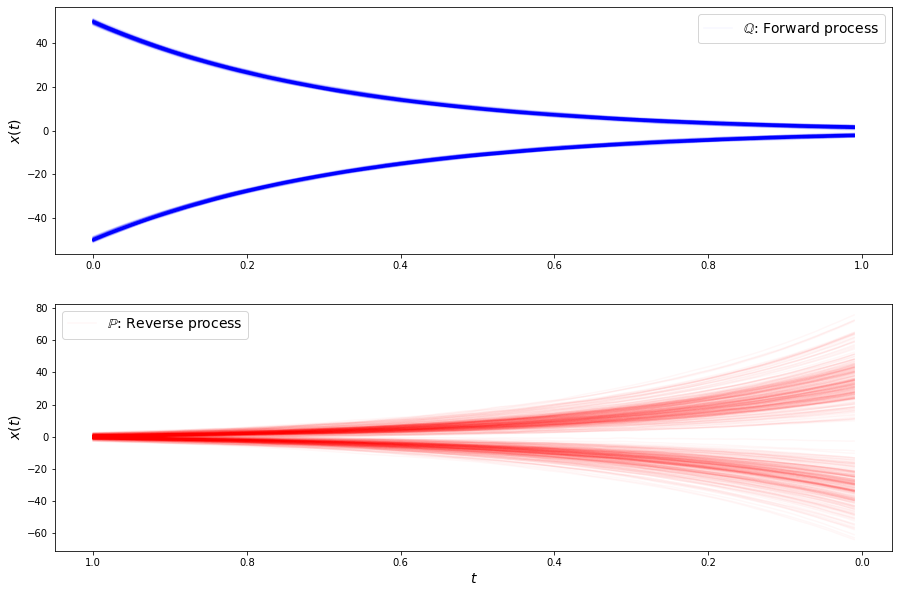

loss b 1.9881620407104492
loss b 1.896601676940918
loss b 1.870339274406433
loss b 1.989149808883667
loss b 1.9729745388031006
loss b 1.9373985528945923
loss b 1.9821584224700928
loss b 1.8954819440841675
loss b 1.975219488143921
loss b 1.9354385137557983
loss b 1.9585695266723633
loss b 1.895796775817871
loss b 1.9409807920455933
loss b 1.9834140539169312
loss b 1.8839343786239624
loss b 2.0346453189849854
loss b 1.9230458736419678
loss b 1.9262992143630981
loss b 1.950735330581665
loss b 1.9197818040847778
loss b 1.9103999137878418
loss b 1.8648980855941772
loss f 4.642269134521484
loss f 4.675533771514893
loss f 4.6548895835876465
loss f 4.637564182281494
loss f 4.665093898773193
loss f 4.680449485778809
loss f 4.624139785766602
loss f 4.620049476623535
loss f 4.652533054351807
loss f 4.658586025238037
loss f 4.673933029174805
loss f 4.636836528778076
loss f 4.730238914489746
loss f 4.7103800773620605
loss f 4.656150817871094
loss f 4.632785797119141
loss f 4.630466461181641
loss f 

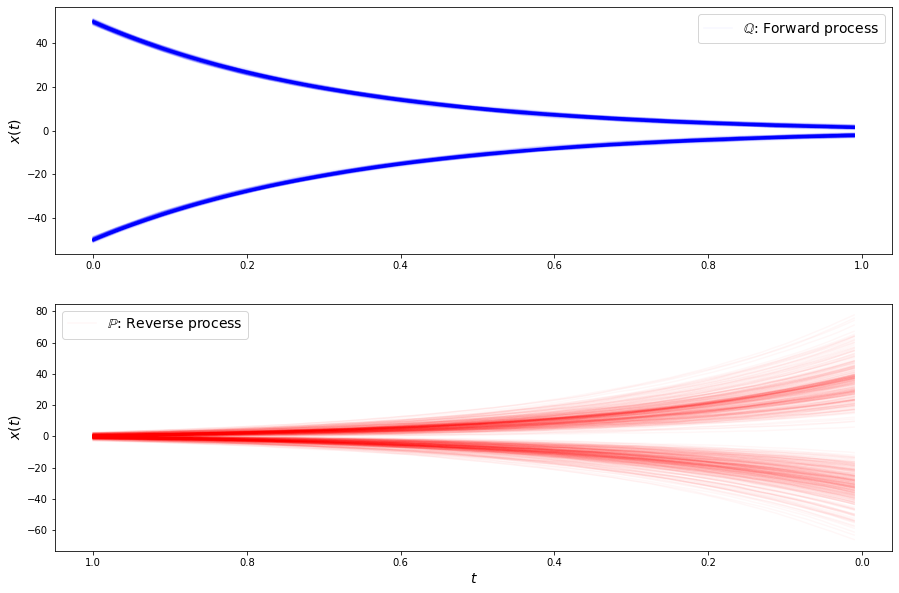

loss b 1.8894044160842896
loss b 1.876027226448059
loss b 1.9023150205612183
loss b 1.893339991569519
loss b 1.8528999090194702
loss b 1.8520549535751343
loss b 1.8544589281082153
loss b 1.8999780416488647
loss b 1.9237016439437866
loss b 1.9704853296279907
loss b 1.954712152481079
loss b 1.7990416288375854
loss b 1.892580270767212
loss b 1.945153832435608
loss b 1.9395149946212769
loss b 1.9424799680709839
loss b 1.939369559288025
loss b 1.927507996559143
loss b 1.8599945306777954
loss b 1.8924082517623901
loss b 1.8253790140151978
loss b 2.013301134109497
loss f 4.629913806915283
loss f 4.630514621734619
loss f 4.670173168182373
loss f 4.652207851409912
loss f 4.630471229553223
loss f 4.652500152587891
loss f 4.6581878662109375
loss f 4.675766944885254
loss f 4.65888786315918
loss f 4.661814212799072
loss f 4.613101005554199
loss f 4.669148921966553
loss f 4.615407943725586
loss f 4.65268611907959
loss f 4.662355899810791
loss f 4.6652350425720215
loss f 4.667859077453613
loss f 4.63

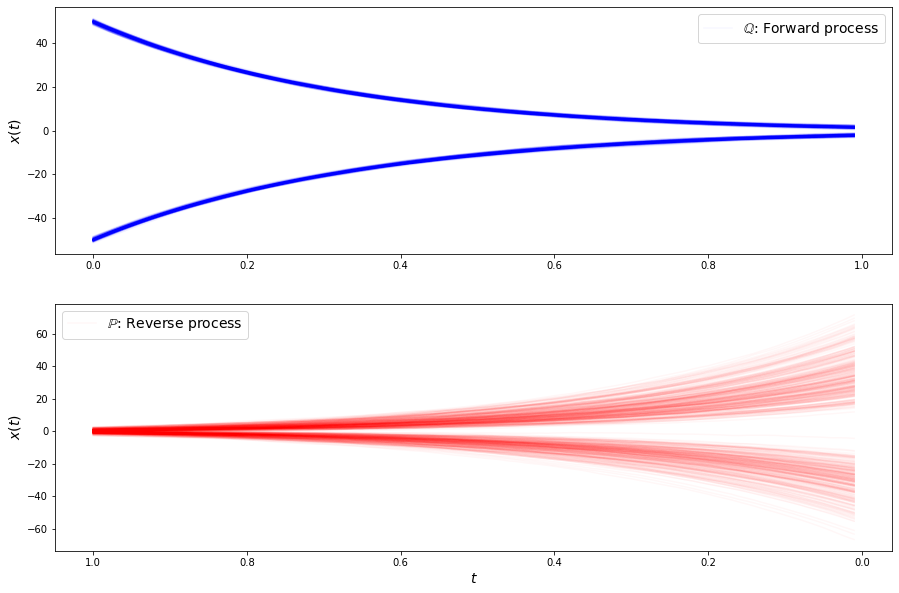

loss b 1.887253999710083
loss b 1.9838260412216187
loss b 1.9127418994903564
loss b 1.923911690711975
loss b 1.9500794410705566
loss b 1.841944694519043
loss b 1.9357801675796509
loss b 1.893120527267456
loss b 1.891838788986206
loss b 1.9143555164337158
loss b 1.8696227073669434
loss b 1.9466990232467651
loss b 1.9815444946289062
loss b 1.8648892641067505
loss b 1.856353521347046
loss b 1.9835715293884277
loss b 1.9156708717346191
loss b 1.9257605075836182
loss b 1.9426449537277222
loss b 1.9042739868164062
loss b 1.9197529554367065
loss b 1.9293245077133179
loss f 4.641482830047607
loss f 4.678131580352783
loss f 4.655797004699707
loss f 4.646230697631836
loss f 4.634331703186035
loss f 4.643226623535156
loss f 4.611728668212891
loss f 4.638657093048096
loss f 4.603392124176025
loss f 4.642910003662109
loss f 4.657652378082275
loss f 4.696407794952393
loss f 4.6155266761779785
loss f 4.631349086761475
loss f 4.576952934265137
loss f 4.627121925354004
loss f 4.661627292633057
loss f 4

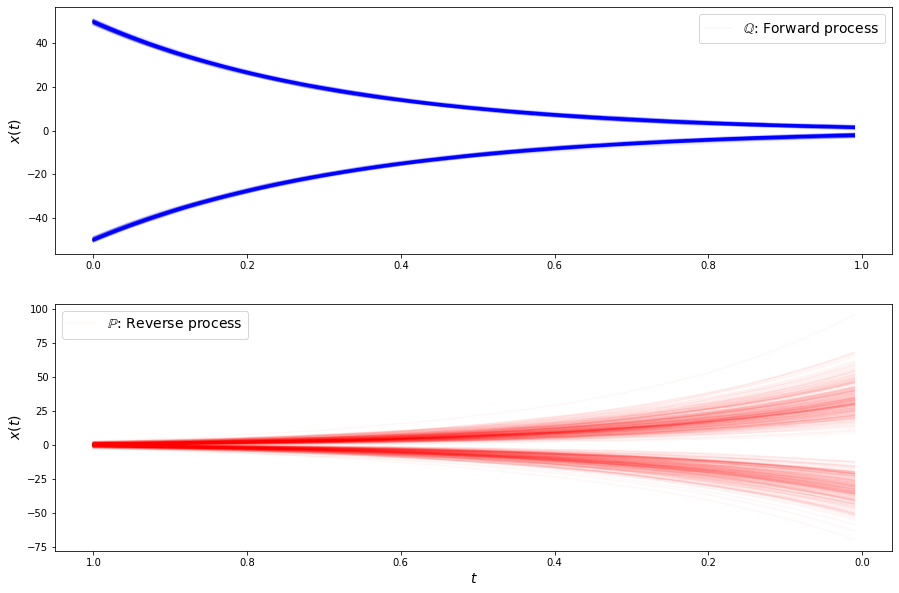

loss b 1.9370564222335815
loss b 1.8219287395477295
loss b 1.9092210531234741
loss b 1.8806025981903076
loss b 1.8825201988220215
loss b 1.9656380414962769
loss b 1.9444770812988281
loss b 1.8299262523651123
loss b 1.893187165260315
loss b 1.9128934144973755
loss b 1.8297364711761475
loss b 1.891357183456421
loss b 1.8923505544662476
loss b 1.8016849756240845
loss b 1.8666678667068481
loss b 1.9235531091690063
loss b 1.8209120035171509
loss b 1.8161180019378662
loss b 1.8395432233810425
loss b 1.8787349462509155
loss b 1.8869744539260864
loss b 1.9645518064498901
loss f 4.560493469238281
loss f 4.6061320304870605
loss f 4.670551776885986
loss f 4.6005940437316895
loss f 4.621128559112549
loss f 4.650912761688232
loss f 4.637081146240234
loss f 4.617321968078613
loss f 4.655760765075684
loss f 4.609617710113525
loss f 4.6473917961120605
loss f 4.660315036773682
loss f 4.606675148010254
loss f 4.651804447174072
loss f 4.625531196594238
loss f 4.635402202606201
loss f 4.621607303619385
lo

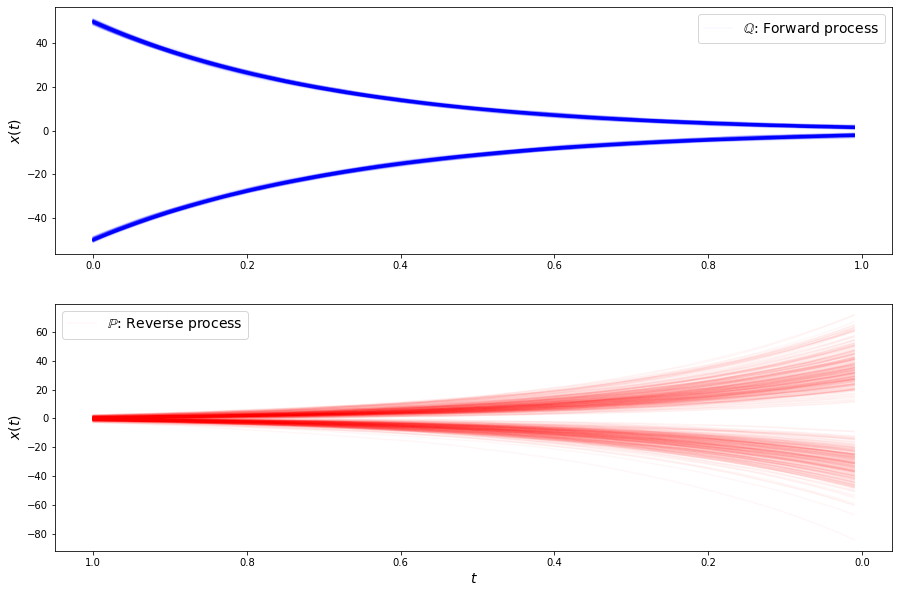

loss b 1.9089717864990234
loss b 1.863630771636963
loss b 1.8406422138214111
loss b 1.9323872327804565
loss b 1.8502355813980103
loss b 1.8997118473052979
loss b 1.8114463090896606
loss b 1.868959665298462
loss b 1.8242206573486328
loss b 1.8478972911834717
loss b 1.8063371181488037
loss b 1.9070827960968018
loss b 1.9529911279678345
loss b 1.8687992095947266
loss b 1.8520102500915527
loss b 1.876238465309143
loss b 1.782959222793579
loss b 1.8661326169967651
loss b 1.9731504917144775
loss b 1.8947415351867676
loss b 1.8537951707839966
loss b 1.8521784543991089
loss f 4.578251361846924
loss f 4.618644714355469
loss f 4.608991622924805
loss f 4.602729797363281
loss f 4.582366943359375
loss f 4.600184917449951
loss f 4.606866836547852
loss f 4.623655796051025
loss f 4.633994102478027
loss f 4.574872970581055
loss f 4.651164531707764
loss f 4.634090423583984
loss f 4.643034934997559
loss f 4.5588226318359375
loss f 4.618368625640869
loss f 4.635696887969971
loss f 4.601901531219482
loss f

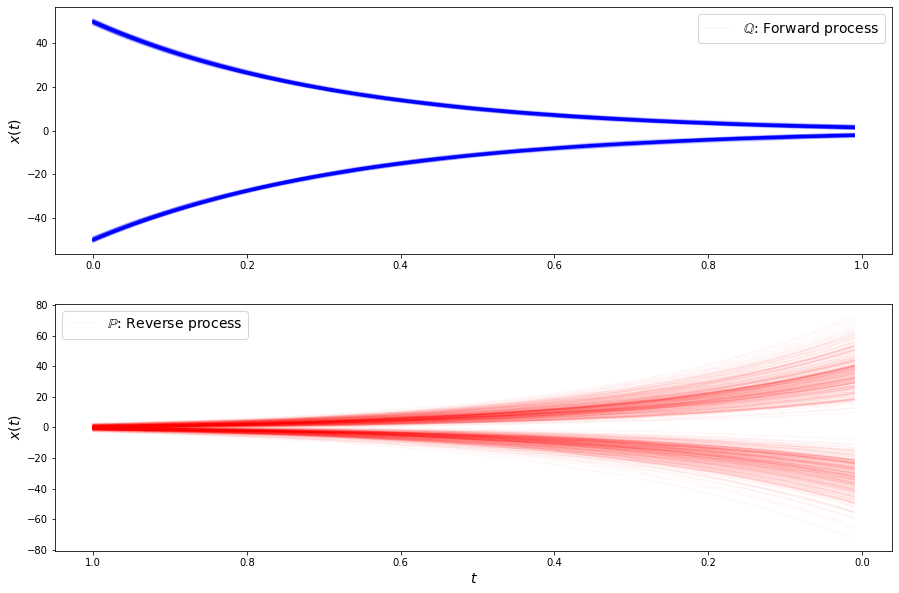

loss b 1.897078037261963
loss b 1.881050705909729
loss b 1.8151443004608154
loss b 1.8397819995880127
loss b 1.8754229545593262
loss b 1.8424816131591797
loss b 1.842719316482544
loss b 1.8559401035308838
loss b 1.8093910217285156
loss b 1.8178730010986328
loss b 1.8021008968353271
loss b 1.9283366203308105
loss b 1.9197412729263306
loss b 1.7638839483261108
loss b 1.838768482208252
loss b 1.8404910564422607
loss b 1.9397640228271484
loss b 1.8597137928009033
loss b 1.917141079902649
loss b 1.746409296989441
loss b 1.8624615669250488
loss b 1.7403969764709473
loss f 4.567549228668213
loss f 4.601775169372559
loss f 4.631360054016113
loss f 4.547797203063965
loss f 4.569347858428955
loss f 4.611532211303711
loss f 4.605493545532227
loss f 4.621915817260742
loss f 4.526338577270508
loss f 4.5961689949035645
loss f 4.648601055145264
loss f 4.601490497589111
loss f 4.6120076179504395
loss f 4.601379871368408
loss f 4.518808841705322
loss f 4.572147846221924
loss f 4.599370956420898
loss f 

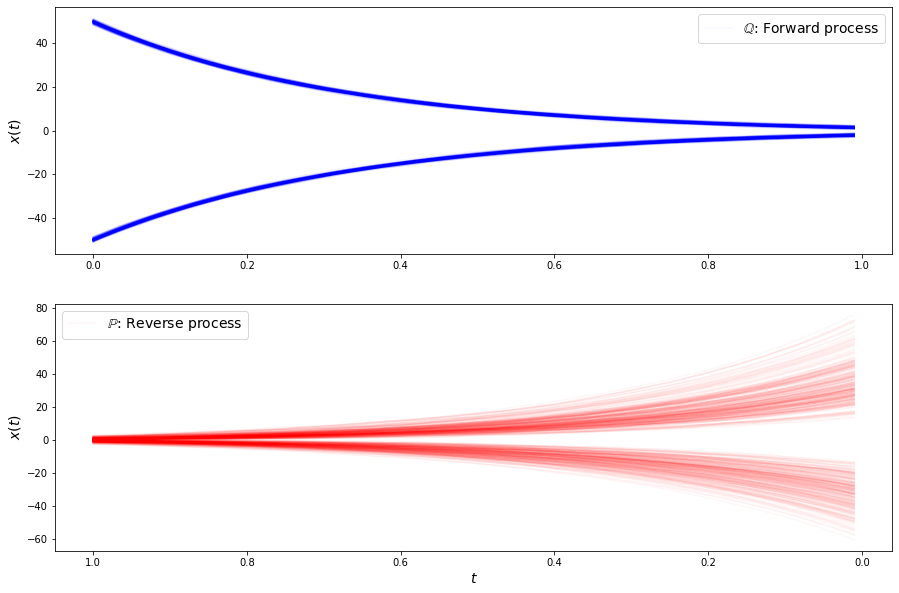

loss b 1.8031595945358276
loss b 1.7942547798156738
loss b 1.830349087715149
loss b 1.8038784265518188
loss b 1.745261549949646
loss b 1.868817925453186
loss b 1.7987197637557983
loss b 1.7914279699325562
loss b 1.9210307598114014
loss b 1.9055145978927612
loss b 1.865697979927063
loss b 1.770864486694336
loss b 1.8272093534469604
loss b 1.8296077251434326
loss b 1.8309231996536255
loss b 1.8258877992630005
loss b 1.9127520322799683
loss b 1.8870480060577393
loss b 1.7833549976348877
loss b 1.8838274478912354
loss b 1.8192012310028076
loss b 1.8227425813674927
loss f 4.665623188018799
loss f 4.532859802246094
loss f 4.526676177978516
loss f 4.59479284286499
loss f 4.662380695343018
loss f 4.620055198669434
loss f 4.5899763107299805
loss f 4.598881721496582
loss f 4.584675312042236
loss f 4.546366214752197
loss f 4.58081579208374
loss f 4.573520183563232
loss f 4.611965179443359
loss f 4.658449172973633
loss f 4.547348976135254
loss f 4.541231155395508
loss f 4.560122489929199
loss f 4.

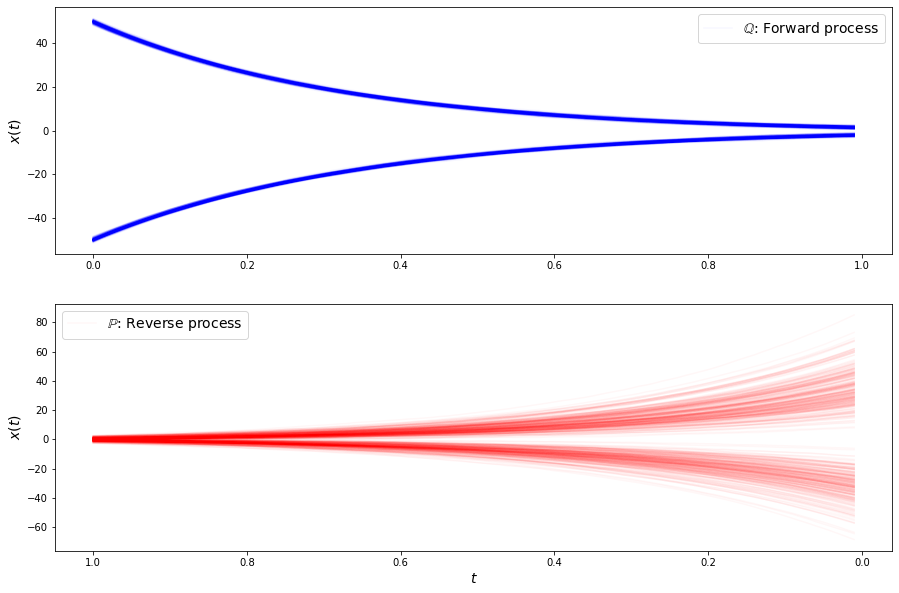

loss b 1.8694442510604858
loss b 1.824046015739441
loss b 1.776495099067688
loss b 1.9240915775299072
loss b 1.8993417024612427
loss b 1.7762362957000732
loss b 1.8624811172485352
loss b 1.7650976181030273
loss b 1.796703815460205
loss b 1.8113032579421997
loss b 1.8179399967193604
loss b 1.8424639701843262
loss b 1.8154507875442505
loss b 1.7825474739074707
loss b 1.7640856504440308
loss b 1.7835992574691772
loss b 1.8458445072174072
loss b 1.7168227434158325
loss b 1.8348335027694702
loss b 1.7745838165283203
loss b 1.7918704748153687
loss b 1.839935541152954
loss f 4.588344097137451
loss f 4.549115180969238
loss f 4.541446208953857
loss f 4.579246997833252
loss f 4.519937992095947
loss f 4.536421775817871
loss f 4.5794548988342285
loss f 4.6184306144714355
loss f 4.549238204956055
loss f 4.577206611633301
loss f 4.506442070007324
loss f 4.530550479888916
loss f 4.568540096282959
loss f 4.604178428649902
loss f 4.590935707092285
loss f 4.585927486419678
loss f 4.583277225494385
loss 

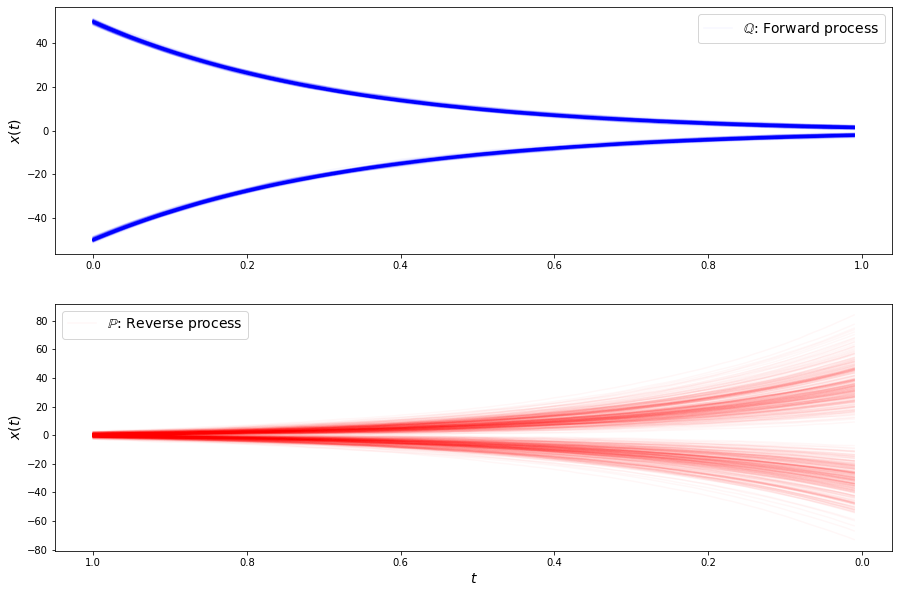

loss b 1.758284091949463
loss b 1.8054075241088867
loss b 1.8661420345306396
loss b 1.822456955909729
loss b 1.7218409776687622
loss b 1.6985905170440674
loss b 1.7900426387786865
loss b 1.7547295093536377
loss b 1.7547882795333862
loss b 1.8590583801269531
loss b 1.8575447797775269
loss b 1.8303738832473755
loss b 1.7656959295272827
loss b 1.7978379726409912
loss b 1.8794424533843994
loss b 1.7816591262817383
loss b 1.80275297164917
loss b 1.7482572793960571
loss b 1.7590243816375732
loss b 1.6838300228118896
loss b 1.751828670501709
loss b 1.8686420917510986
loss f 4.547757148742676
loss f 4.589389801025391
loss f 4.531007289886475
loss f 4.560022830963135
loss f 4.567446231842041
loss f 4.530488967895508
loss f 4.5727667808532715
loss f 4.5156660079956055
loss f 4.590970039367676
loss f 4.570717811584473
loss f 4.5694260597229
loss f 4.592483043670654
loss f 4.563082218170166
loss f 4.561470031738281
loss f 4.596006870269775
loss f 4.570044994354248
loss f 4.523499965667725
loss f 4

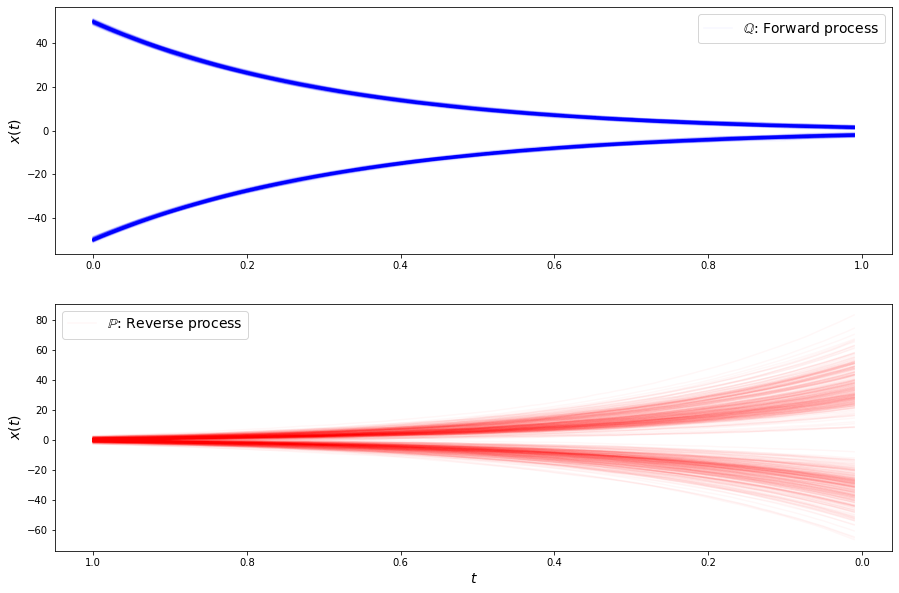

loss b 1.8175740242004395
loss b 1.7384974956512451
loss b 1.7908366918563843
loss b 1.7492570877075195
loss b 1.7911337614059448
loss b 1.7584115266799927
loss b 1.7469969987869263
loss b 1.8389947414398193
loss b 1.777577519416809
loss b 1.7525838613510132
loss b 1.7428512573242188
loss b 1.7946226596832275
loss b 1.7162150144577026
loss b 1.6938692331314087
loss b 1.7790355682373047
loss b 1.7575000524520874
loss b 1.7216434478759766
loss b 1.843554139137268
loss b 1.6375089883804321
loss b 1.7920467853546143
loss b 1.7450653314590454
loss b 1.7281185388565063
loss f 4.519867897033691
loss f 4.530519962310791
loss f 4.53239107131958
loss f 4.500563144683838
loss f 4.581357002258301
loss f 4.5776238441467285
loss f 4.549923419952393
loss f 4.525097846984863
loss f 4.543362140655518
loss f 4.539155006408691
loss f 4.512085914611816
loss f 4.552633762359619
loss f 4.545576572418213
loss f 4.519193172454834
loss f 4.519967079162598
loss f 4.527238368988037
loss f 4.542161464691162
loss 

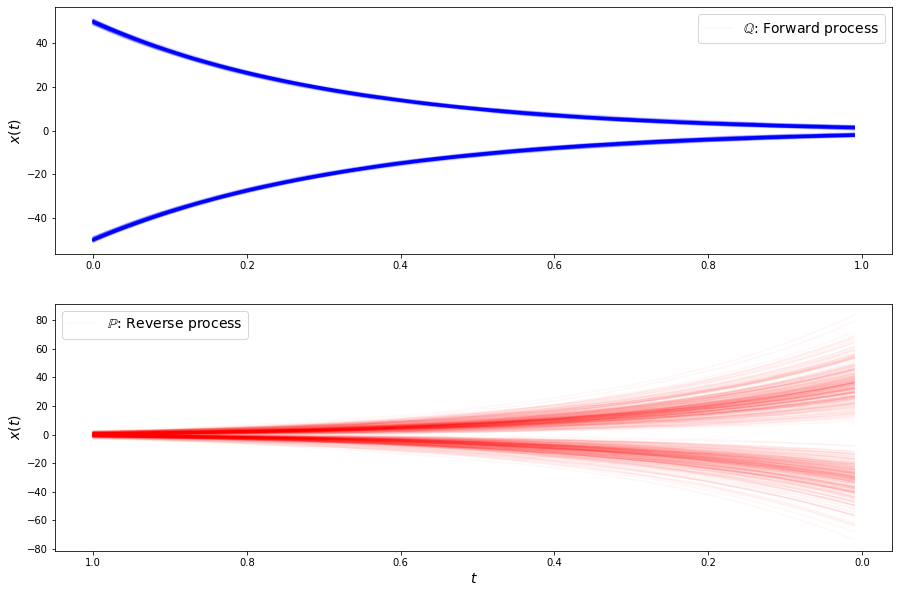

loss b 1.7411353588104248
loss b 1.7510595321655273
loss b 1.7489577531814575
loss b 1.7584511041641235
loss b 1.7180485725402832
loss b 1.7574187517166138
loss b 1.7171552181243896
loss b 1.7522602081298828
loss b 1.8258187770843506
loss b 1.734879970550537
loss b 1.7023168802261353
loss b 1.7876412868499756
loss b 1.7546495199203491
loss b 1.6994459629058838
loss b 1.8198435306549072
loss b 1.7275378704071045
loss b 1.7642133235931396
loss b 1.694769024848938
loss b 1.8155930042266846
loss b 1.6544625759124756
loss b 1.7654914855957031
loss b 1.6636500358581543
loss f 4.5104827880859375
loss f 4.553492069244385
loss f 4.478921413421631
loss f 4.573041915893555
loss f 4.497708320617676
loss f 4.574650764465332
loss f 4.525930881500244
loss f 4.53193998336792
loss f 4.500469207763672
loss f 4.559117794036865
loss f 4.526933670043945
loss f 4.536708831787109
loss f 4.5028181076049805
loss f 4.527784824371338
loss f 4.550375461578369
loss f 4.553237438201904
loss f 4.54993200302124
loss 

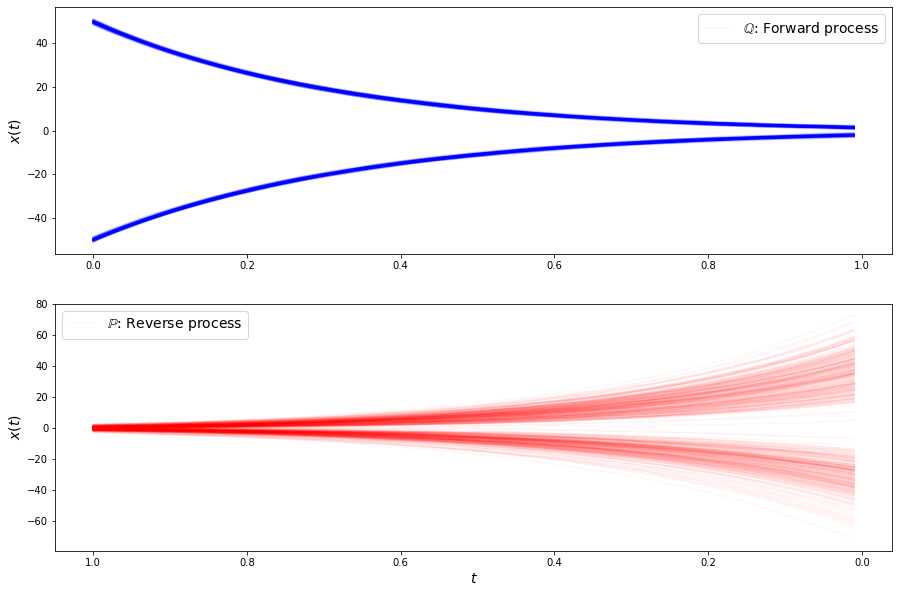

loss b 1.7050164937973022
loss b 1.6778228282928467
loss b 1.7185075283050537
loss b 1.6552280187606812
loss b 1.859307050704956
loss b 1.702422857284546
loss b 1.6520345211029053
loss b 1.681047797203064
loss b 1.7335067987442017
loss b 1.7154496908187866
loss b 1.7573620080947876
loss b 1.6574079990386963
loss b 1.7212607860565186
loss b 1.6630362272262573
loss b 1.7981265783309937
loss b 1.7183557748794556
loss b 1.782246708869934
loss b 1.734724998474121
loss b 1.6890422105789185
loss b 1.6846306324005127
loss b 1.7164952754974365
loss b 1.7040870189666748
loss f 4.520021438598633
loss f 4.536187648773193
loss f 4.4972333908081055
loss f 4.524486541748047
loss f 4.507573127746582
loss f 4.539284706115723
loss f 4.536118030548096
loss f 4.537903308868408
loss f 4.5009565353393555
loss f 4.495006084442139
loss f 4.499932765960693
loss f 4.5076069831848145
loss f 4.498966217041016
loss f 4.4515299797058105
loss f 4.548855781555176
loss f 4.49717903137207
loss f 4.47811222076416
loss f

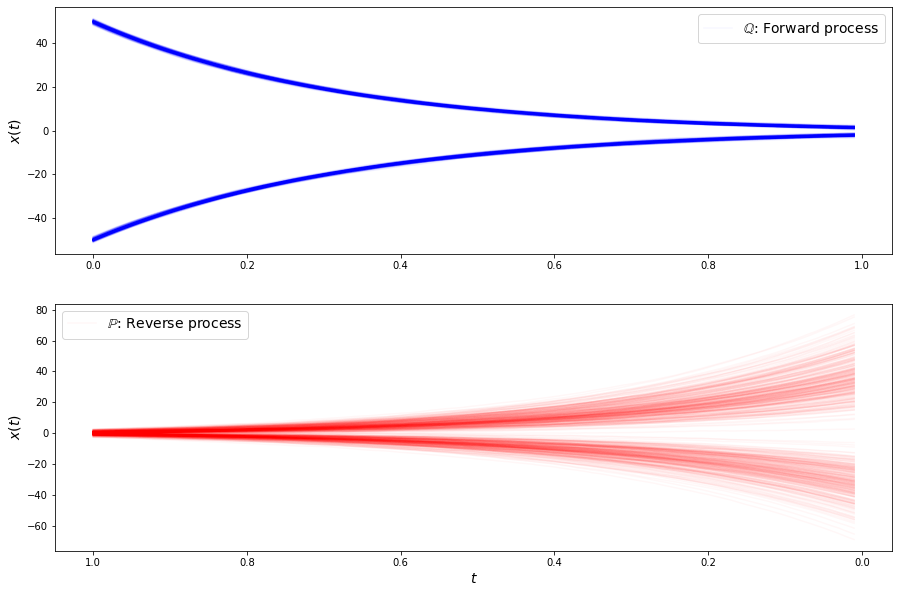

loss b 1.6601332426071167
loss b 1.7220591306686401
loss b 1.663932204246521
loss b 1.7199510335922241
loss b 1.720900535583496
loss b 1.6869148015975952
loss b 1.7845982313156128
loss b 1.7448840141296387
loss b 1.6836910247802734
loss b 1.6937609910964966
loss b 1.713192105293274
loss b 1.7227684259414673
loss b 1.6961437463760376
loss b 1.735187292098999
loss b 1.7013654708862305
loss b 1.7741622924804688
loss b 1.769195556640625
loss b 1.782770037651062
loss b 1.7413389682769775
loss b 1.718524694442749
loss b 1.7126703262329102
loss b 1.74125075340271
loss f 4.567033767700195
loss f 4.472986221313477
loss f 4.5356831550598145
loss f 4.504537582397461
loss f 4.435194969177246
loss f 4.482088565826416
loss f 4.492504119873047
loss f 4.463409900665283
loss f 4.484952926635742
loss f 4.51420783996582
loss f 4.505119800567627
loss f 4.46659517288208
loss f 4.507074356079102
loss f 4.4866719245910645
loss f 4.49002742767334
loss f 4.49245548248291
loss f 4.46895694732666
loss f 4.428331

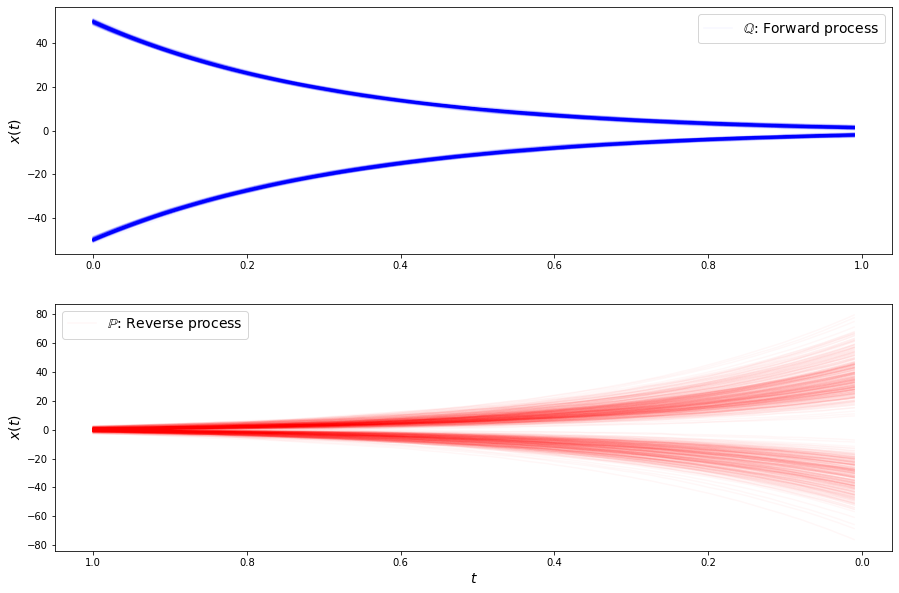

loss b 1.7155545949935913
loss b 1.6781715154647827
loss b 1.6993046998977661
loss b 1.6379168033599854
loss b 1.6465785503387451
loss b 1.686797857284546
loss b 1.7212547063827515
loss b 1.7265914678573608
loss b 1.6437350511550903
loss b 1.6585743427276611
loss b 1.7052992582321167
loss b 1.739925503730774
loss b 1.765753984451294
loss b 1.6612701416015625
loss b 1.7272140979766846
loss b 1.6719719171524048
loss b 1.705722451210022
loss b 1.6744202375411987
loss b 1.715340495109558
loss b 1.700276255607605
loss b 1.7622642517089844
loss b 1.7899397611618042
loss f 4.474192142486572
loss f 4.546604156494141
loss f 4.430349826812744
loss f 4.4810380935668945
loss f 4.482738018035889
loss f 4.487992763519287
loss f 4.4547505378723145
loss f 4.500558853149414
loss f 4.514297008514404
loss f 4.502117156982422
loss f 4.505283355712891
loss f 4.442605018615723
loss f 4.435603141784668
loss f 4.496033668518066
loss f 4.482353210449219
loss f 4.473380088806152
loss f 4.434722423553467
loss f 

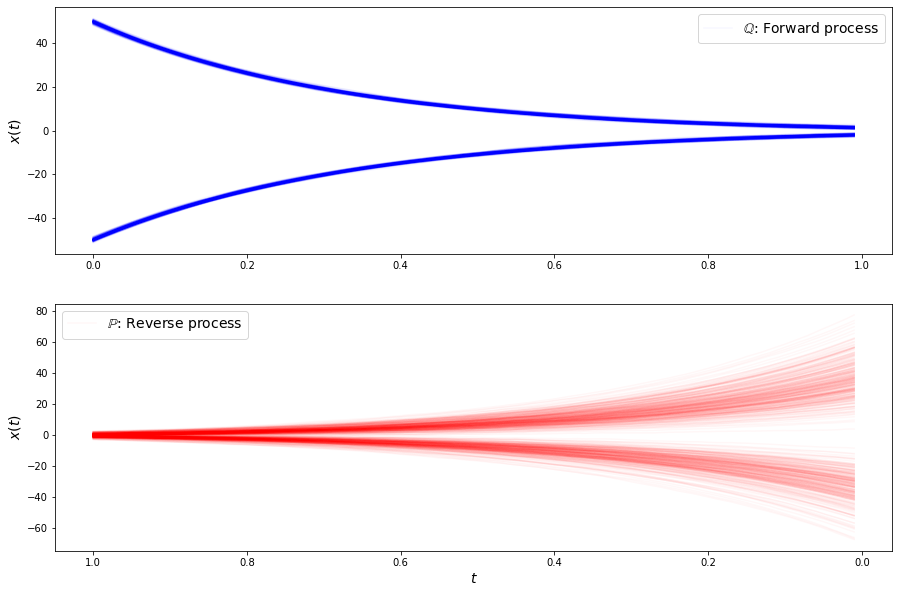

loss b 1.6238816976547241
loss b 1.6807647943496704
loss b 1.7358452081680298
loss b 1.7185817956924438
loss b 1.6742265224456787
loss b 1.6467820405960083
loss b 1.6930365562438965
loss b 1.692613959312439
loss b 1.6588717699050903
loss b 1.659621000289917
loss b 1.7198596000671387
loss b 1.6422184705734253
loss b 1.6752898693084717
loss b 1.684033751487732
loss b 1.6257094144821167
loss b 1.7104264497756958
loss b 1.6946015357971191
loss b 1.6029417514801025
loss b 1.6776227951049805
loss b 1.6658494472503662
loss b 1.6886694431304932
loss b 1.6141479015350342
loss f 4.485071182250977
loss f 4.501582145690918
loss f 4.464840412139893
loss f 4.472095012664795
loss f 4.428005218505859
loss f 4.4602508544921875
loss f 4.48344087600708
loss f 4.492427825927734
loss f 4.457347869873047
loss f 4.437969207763672
loss f 4.415287971496582
loss f 4.375230312347412
loss f 4.49974250793457
loss f 4.45145320892334
loss f 4.4770002365112305
loss f 4.4486260414123535
loss f 4.422959804534912
loss f

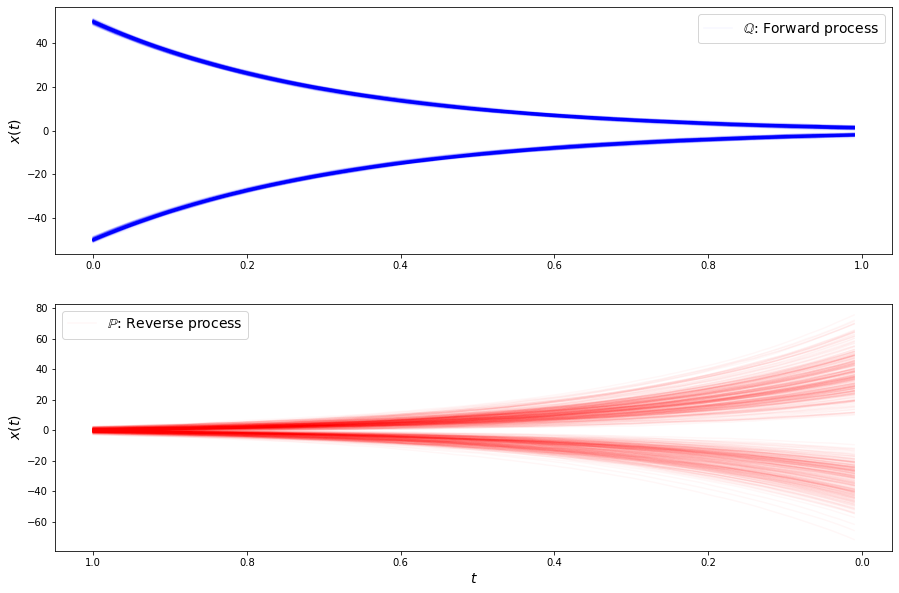

loss b 1.6624112129211426
loss b 1.6941319704055786
loss b 1.5524836778640747
loss b 1.6618075370788574
loss b 1.7461044788360596
loss b 1.6705607175827026
loss b 1.6787679195404053
loss b 1.6530061960220337
loss b 1.6986032724380493
loss b 1.7111358642578125
loss b 1.6946065425872803
loss b 1.5998660326004028
loss b 1.6931027173995972
loss b 1.6751254796981812
loss b 1.778681993484497
loss b 1.7513498067855835
loss b 1.7061625719070435
loss b 1.6666637659072876
loss b 1.707442045211792
loss b 1.6698848009109497
loss b 1.6771820783615112
loss b 1.6105254888534546
loss f 4.47860860824585
loss f 4.469450950622559
loss f 4.424755573272705
loss f 4.492516040802002
loss f 4.4927802085876465
loss f 4.4653096199035645
loss f 4.456684112548828
loss f 4.478006839752197
loss f 4.438785076141357
loss f 4.3963422775268555
loss f 4.439497947692871
loss f 4.42244291305542
loss f 4.466344356536865
loss f 4.424554824829102
loss f 4.492301940917969
loss f 4.436543941497803
loss f 4.434850215911865
loss

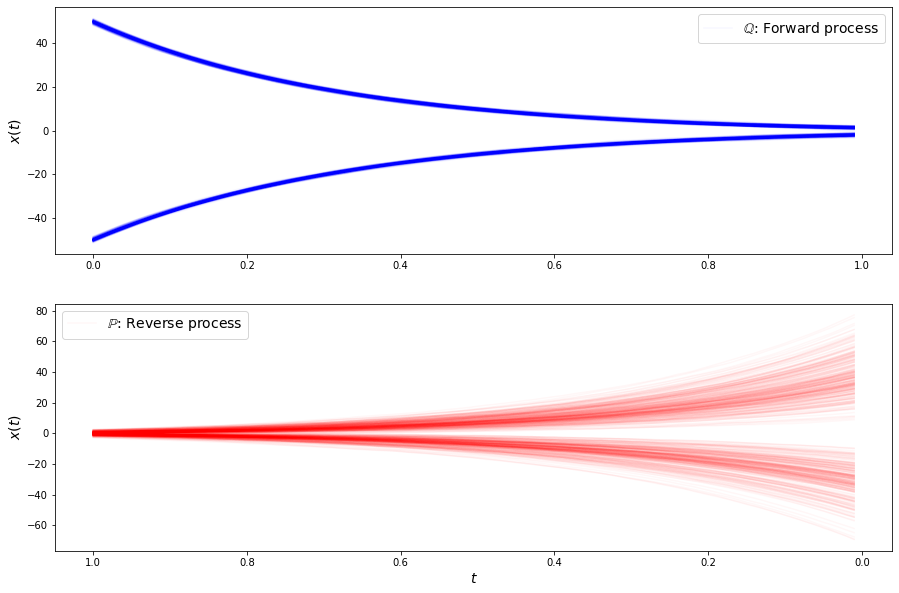

loss b 1.6849005222320557
loss b 1.705612301826477
loss b 1.6986465454101562
loss b 1.676256537437439
loss b 1.6570030450820923
loss b 1.61562979221344
loss b 1.6004124879837036
loss b 1.5948820114135742
loss b 1.65598726272583
loss b 1.5079879760742188
loss b 1.5968166589736938
loss b 1.7226130962371826
loss b 1.6076009273529053
loss b 1.6174269914627075
loss b 1.612375259399414
loss b 1.6270337104797363
loss b 1.674237608909607
loss b 1.666907787322998
loss b 1.6504487991333008
loss b 1.5578399896621704
loss b 1.6307405233383179
loss b 1.7295112609863281
loss f 4.444263935089111
loss f 4.441648483276367
loss f 4.392865180969238
loss f 4.470298767089844
loss f 4.4273152351379395
loss f 4.401893615722656
loss f 4.432243824005127
loss f 4.448030948638916
loss f 4.446842670440674
loss f 4.3807373046875
loss f 4.437008857727051
loss f 4.468122959136963
loss f 4.440147876739502
loss f 4.401922702789307
loss f 4.402192115783691
loss f 4.4190850257873535
loss f 4.408094882965088
loss f 4.435

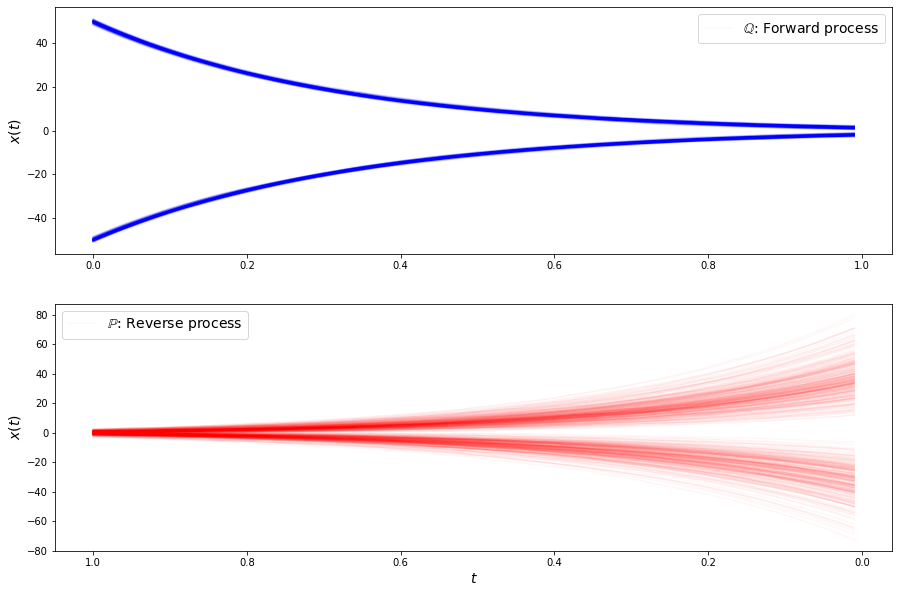

loss b 1.6789462566375732
loss b 1.6687825918197632
loss b 1.5437015295028687
loss b 1.6517804861068726
loss b 1.6746602058410645
loss b 1.6736477613449097
loss b 1.5442699193954468
loss b 1.5330824851989746
loss b 1.6465729475021362
loss b 1.5644652843475342
loss b 1.6336116790771484
loss b 1.6429660320281982
loss b 1.666057825088501
loss b 1.6408058404922485
loss b 1.5481979846954346
loss b 1.692488670349121
loss b 1.5890154838562012
loss b 1.6535295248031616
loss b 1.5930266380310059
loss b 1.6405242681503296
loss b 1.5807678699493408
loss b 1.5854144096374512
loss f 4.44254732131958
loss f 4.43816614151001
loss f 4.375296592712402
loss f 4.398726940155029
loss f 4.415576457977295
loss f 4.421637058258057
loss f 4.417915344238281
loss f 4.423701763153076
loss f 4.453307151794434
loss f 4.415541648864746
loss f 4.44835090637207
loss f 4.368203163146973
loss f 4.427248954772949
loss f 4.369142055511475
loss f 4.4363298416137695
loss f 4.395902156829834
loss f 4.419530868530273
loss f 

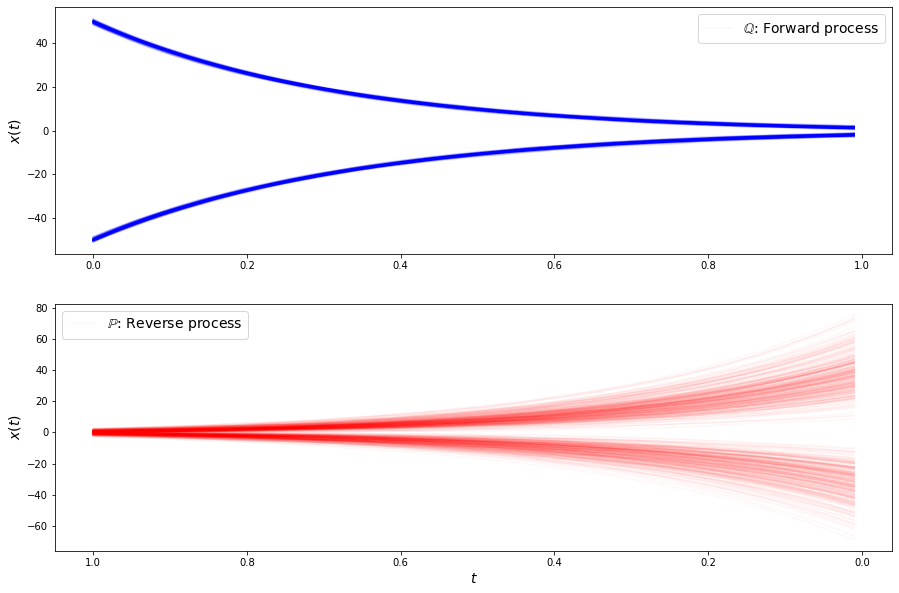

loss b 1.698324203491211
loss b 1.619773268699646
loss b 1.5774425268173218
loss b 1.704975962638855
loss b 1.5585030317306519
loss b 1.613652229309082
loss b 1.6352964639663696
loss b 1.638192057609558
loss b 1.5795814990997314
loss b 1.6544227600097656
loss b 1.4982575178146362
loss b 1.5255595445632935
loss b 1.6367307901382446
loss b 1.6420414447784424
loss b 1.5380624532699585
loss b 1.5205676555633545
loss b 1.6193205118179321
loss b 1.5637634992599487
loss b 1.5639170408248901
loss b 1.6858797073364258
loss b 1.5949805974960327
loss b 1.6301774978637695
loss f 4.414056777954102
loss f 4.412663459777832
loss f 4.421723365783691
loss f 4.405561447143555
loss f 4.382798671722412
loss f 4.446737766265869
loss f 4.42338752746582
loss f 4.399272441864014
loss f 4.3972344398498535
loss f 4.421322822570801
loss f 4.411186218261719
loss f 4.368638038635254
loss f 4.373334884643555
loss f 4.395750999450684
loss f 4.38356876373291
loss f 4.403598785400391
loss f 4.418436050415039
loss f 4.

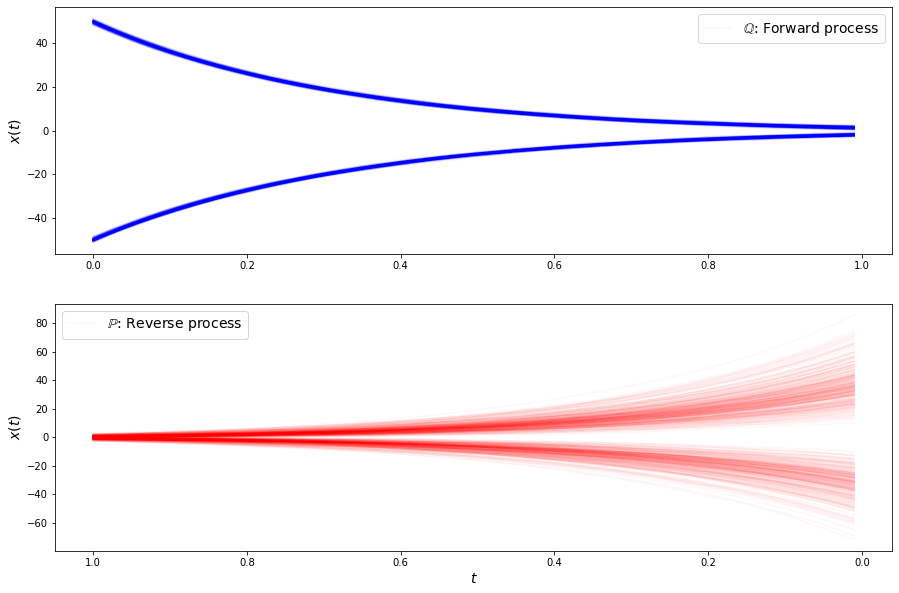

loss b 1.5188947916030884
loss b 1.6616275310516357
loss b 1.6259554624557495
loss b 1.5536195039749146
loss b 1.5675963163375854
loss b 1.6854116916656494
loss b 1.6599537134170532
loss b 1.57856023311615
loss b 1.5605043172836304
loss b 1.5869113206863403
loss b 1.65175199508667
loss b 1.5062217712402344
loss b 1.5512137413024902
loss b 1.5641802549362183
loss b 1.593132734298706
loss b 1.6009955406188965
loss b 1.6103448867797852
loss b 1.6003375053405762
loss b 1.5922532081604004
loss b 1.6929247379302979
loss b 1.6010489463806152
loss b 1.6221044063568115
loss f 4.403172016143799
loss f 4.396297931671143
loss f 4.43380880355835
loss f 4.397626876831055
loss f 4.367316722869873
loss f 4.369222640991211
loss f 4.4042863845825195
loss f 4.359208106994629
loss f 4.415021896362305
loss f 4.333286762237549
loss f 4.35984468460083
loss f 4.3306169509887695
loss f 4.403141975402832
loss f 4.365962028503418
loss f 4.342986106872559
loss f 4.401795864105225
loss f 4.368785858154297
loss f 4

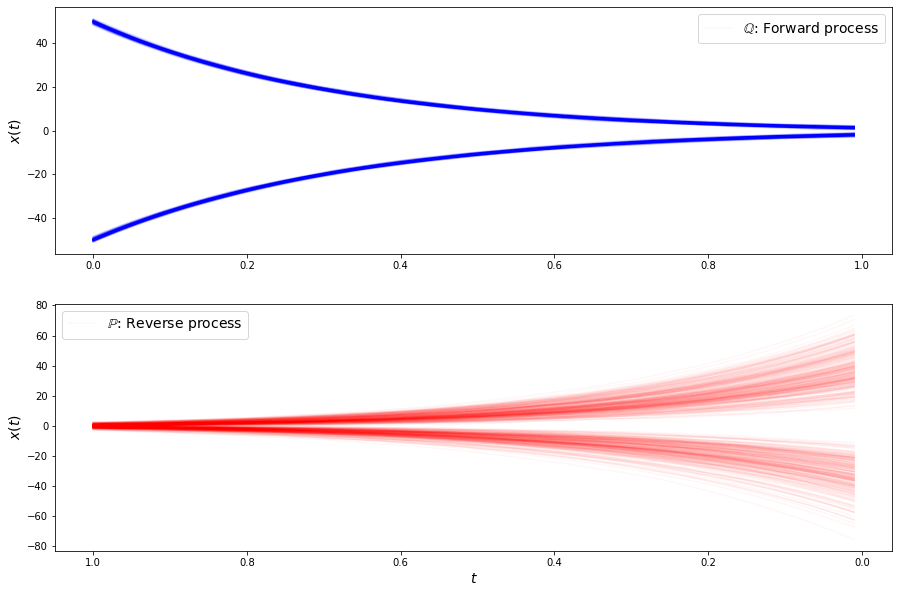

loss b 1.5131380558013916
loss b 1.528193712234497
loss b 1.5138700008392334
loss b 1.5553665161132812
loss b 1.5404715538024902
loss b 1.5971156358718872
loss b 1.5689696073532104
loss b 1.5752679109573364
loss b 1.548796534538269
loss b 1.5713144540786743
loss b 1.5523000955581665
loss b 1.543582797050476
loss b 1.594079852104187
loss b 1.6157127618789673
loss b 1.5527383089065552
loss b 1.550229787826538
loss b 1.6350678205490112
loss b 1.5937482118606567
loss b 1.6170605421066284
loss b 1.4957317113876343
loss b 1.5961425304412842
loss b 1.580863356590271
loss f 4.417030334472656
loss f 4.414578914642334
loss f 4.334773063659668
loss f 4.345466136932373
loss f 4.3973798751831055
loss f 4.377558708190918
loss f 4.33092737197876
loss f 4.388645172119141
loss f 4.367250919342041
loss f 4.376872539520264
loss f 4.335564136505127
loss f 4.367290019989014
loss f 4.360988140106201
loss f 4.357560157775879
loss f 4.395668983459473
loss f 4.334309101104736
loss f 4.3806962966918945
loss f 4

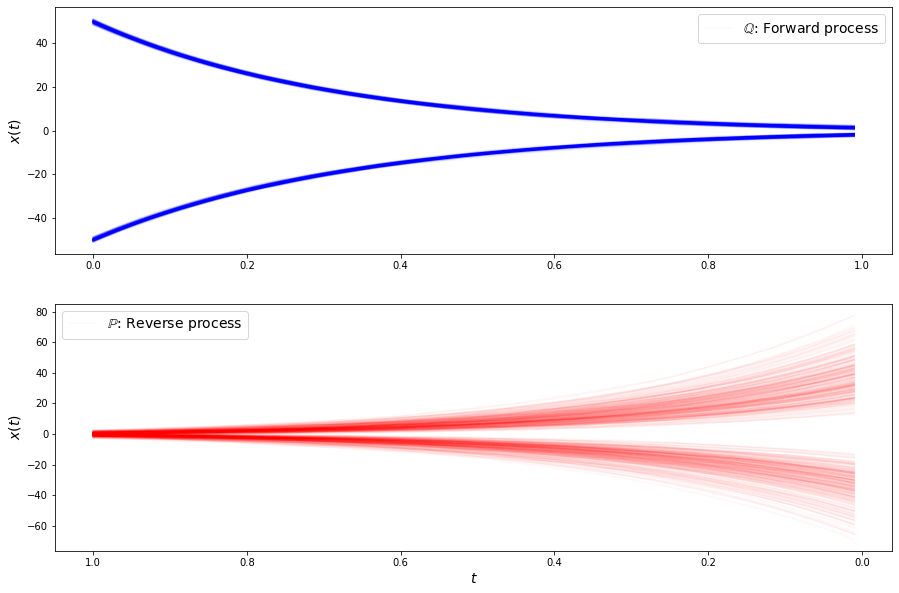

loss b 1.5484278202056885
loss b 1.5906572341918945
loss b 1.5292434692382812
loss b 1.5411347150802612
loss b 1.5330480337142944
loss b 1.4431804418563843
loss b 1.5617314577102661
loss b 1.6555583477020264
loss b 1.6131796836853027
loss b 1.499180793762207
loss b 1.6228790283203125
loss b 1.4815326929092407
loss b 1.5879616737365723
loss b 1.5052098035812378
loss b 1.5855647325515747
loss b 1.5849076509475708
loss b 1.585440754890442
loss b 1.6000510454177856
loss b 1.5153846740722656
loss b 1.500760555267334
loss b 1.507517695426941
loss b 1.5871142148971558
loss f 4.377017021179199
loss f 4.321341037750244
loss f 4.379090309143066
loss f 4.373437881469727
loss f 4.347342014312744
loss f 4.3825788497924805
loss f 4.337693214416504
loss f 4.337907791137695
loss f 4.340514183044434
loss f 4.327967166900635
loss f 4.388280391693115
loss f 4.397120952606201
loss f 4.375656604766846
loss f 4.354155540466309
loss f 4.333453178405762
loss f 4.3375067710876465
loss f 4.3585991859436035
loss

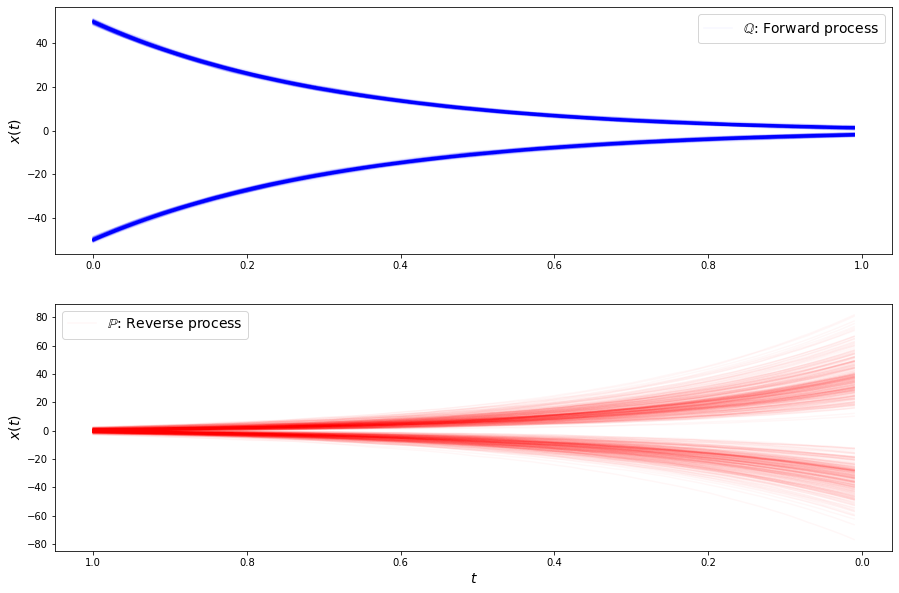

loss b 1.5691312551498413
loss b 1.5839184522628784
loss b 1.5903539657592773
loss b 1.5642197132110596
loss b 1.4827131032943726
loss b 1.4953055381774902
loss b 1.5392332077026367
loss b 1.519858717918396
loss b 1.4740206003189087
loss b 1.583630084991455
loss b 1.4686897993087769
loss b 1.5872548818588257
loss b 1.5122265815734863
loss b 1.5265220403671265
loss b 1.6775157451629639
loss b 1.4697459936141968
loss b 1.5537267923355103
loss b 1.521822452545166
loss b 1.6074763536453247
loss b 1.6193716526031494
loss b 1.4479470252990723
loss b 1.6061300039291382
loss f 4.336956024169922
loss f 4.4282331466674805
loss f 4.345600128173828
loss f 4.36177396774292
loss f 4.390020847320557
loss f 4.330987453460693
loss f 4.324923038482666
loss f 4.301726818084717
loss f 4.336774826049805
loss f 4.354615211486816
loss f 4.298943996429443
loss f 4.286144733428955
loss f 4.358278274536133
loss f 4.323619842529297
loss f 4.321586608886719
loss f 4.350378036499023
loss f 4.344239234924316
loss f

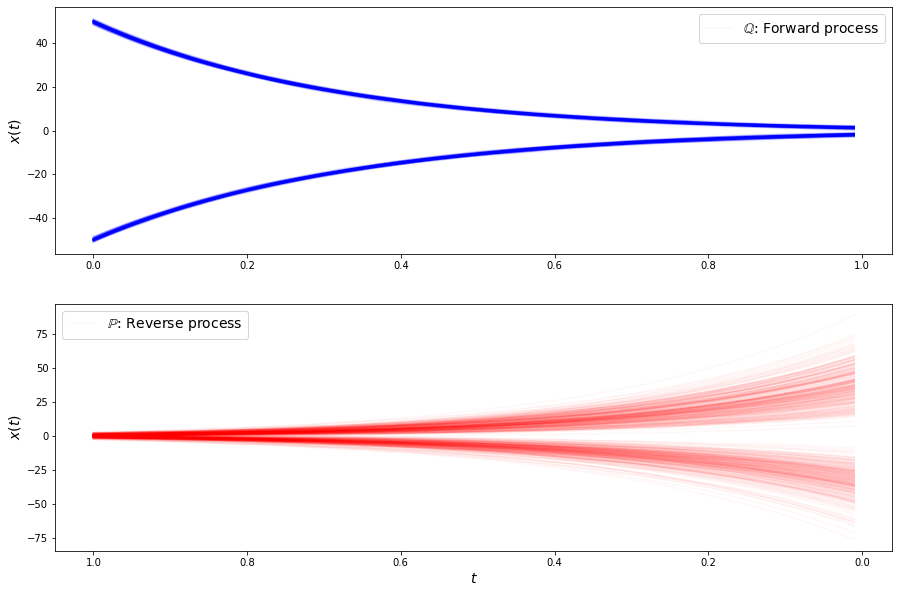

loss b 1.5847547054290771
loss b 1.4877711534500122
loss b 1.541219711303711
loss b 1.5784436464309692
loss b 1.6682347059249878
loss b 1.510940670967102
loss b 1.469496488571167
loss b 1.409669280052185
loss b 1.4816226959228516
loss b 1.5409040451049805
loss b 1.5700383186340332
loss b 1.5358257293701172
loss b 1.5749176740646362
loss b 1.529526948928833
loss b 1.438322901725769
loss b 1.4845192432403564
loss b 1.5482476949691772
loss b 1.4909592866897583
loss b 1.5557056665420532
loss b 1.4452065229415894
loss b 1.5530954599380493
loss b 1.496261477470398
loss f 4.349160671234131
loss f 4.360117435455322
loss f 4.268547058105469
loss f 4.339048862457275
loss f 4.296403884887695
loss f 4.3255109786987305
loss f 4.340745449066162
loss f 4.312252998352051
loss f 4.375911235809326
loss f 4.320491313934326
loss f 4.327723503112793
loss f 4.371852397918701
loss f 4.321393966674805
loss f 4.267005920410156
loss f 4.315340518951416
loss f 4.3121771812438965
loss f 4.314181804656982
loss f 4

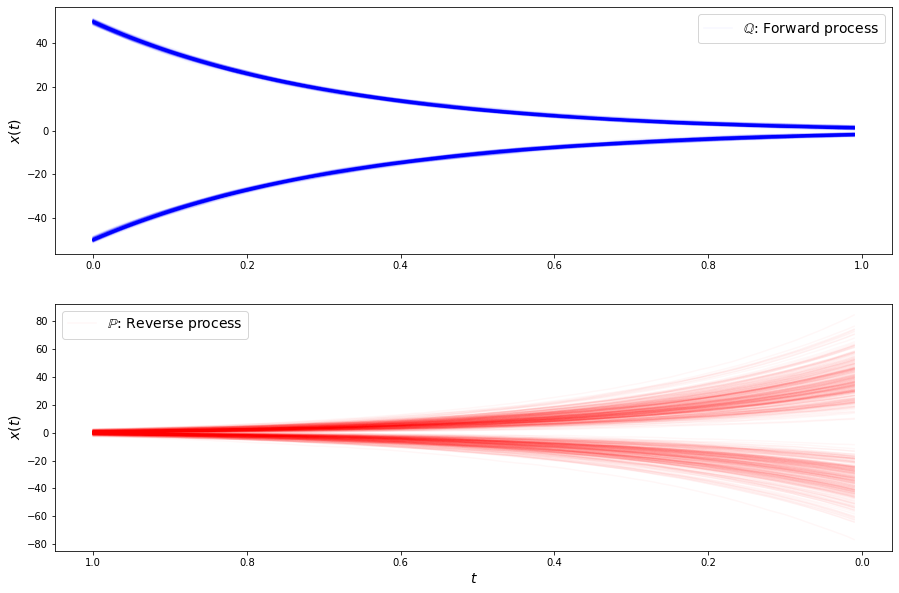

loss b 1.4945005178451538
loss b 1.486132264137268
loss b 1.5235283374786377
loss b 1.468969702720642
loss b 1.4924753904342651
loss b 1.5118460655212402
loss b 1.4653605222702026
loss b 1.5113470554351807
loss b 1.5104091167449951
loss b 1.4820976257324219
loss b 1.5238845348358154
loss b 1.454077959060669
loss b 1.3919697999954224
loss b 1.4490902423858643
loss b 1.5062373876571655
loss b 1.4208581447601318
loss b 1.4731732606887817
loss b 1.4841382503509521
loss b 1.4911648035049438
loss b 1.527154803276062
loss b 1.5192241668701172
loss b 1.5024627447128296
loss f 4.291152000427246
loss f 4.336587905883789
loss f 4.354599952697754
loss f 4.342303276062012
loss f 4.292129993438721
loss f 4.338319301605225
loss f 4.326434135437012
loss f 4.329615116119385
loss f 4.28775691986084
loss f 4.287683486938477
loss f 4.311803817749023
loss f 4.3086256980896
loss f 4.2903242111206055
loss f 4.301136016845703
loss f 4.314645767211914
loss f 4.317854881286621
loss f 4.323789119720459
loss f 4.

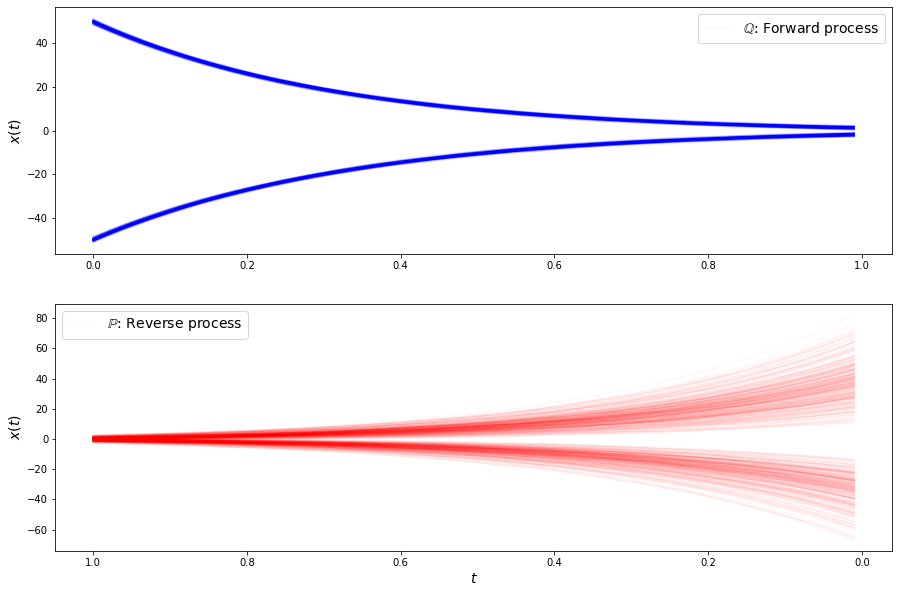

loss b 1.5113264322280884
loss b 1.4650219678878784
loss b 1.443737506866455
loss b 1.4402155876159668
loss b 1.4676862955093384
loss b 1.4709545373916626
loss b 1.4996205568313599
loss b 1.5011675357818604
loss b 1.463944911956787
loss b 1.443946123123169
loss b 1.4583576917648315
loss b 1.4701615571975708
loss b 1.5673410892486572
loss b 1.4658361673355103
loss b 1.4634352922439575
loss b 1.5533725023269653
loss b 1.4999459981918335
loss b 1.4166232347488403
loss b 1.457793951034546
loss b 1.4863032102584839
loss b 1.5272363424301147
loss b 1.5069987773895264
loss f 4.304840087890625
loss f 4.2599873542785645
loss f 4.298354148864746
loss f 4.286078929901123
loss f 4.284539222717285
loss f 4.269586086273193
loss f 4.300556659698486
loss f 4.331646919250488
loss f 4.275681972503662
loss f 4.312507629394531
loss f 4.296614170074463
loss f 4.232274055480957
loss f 4.281264781951904
loss f 4.340695858001709
loss f 4.35172176361084
loss f 4.256921768188477
loss f 4.3150858879089355
loss f

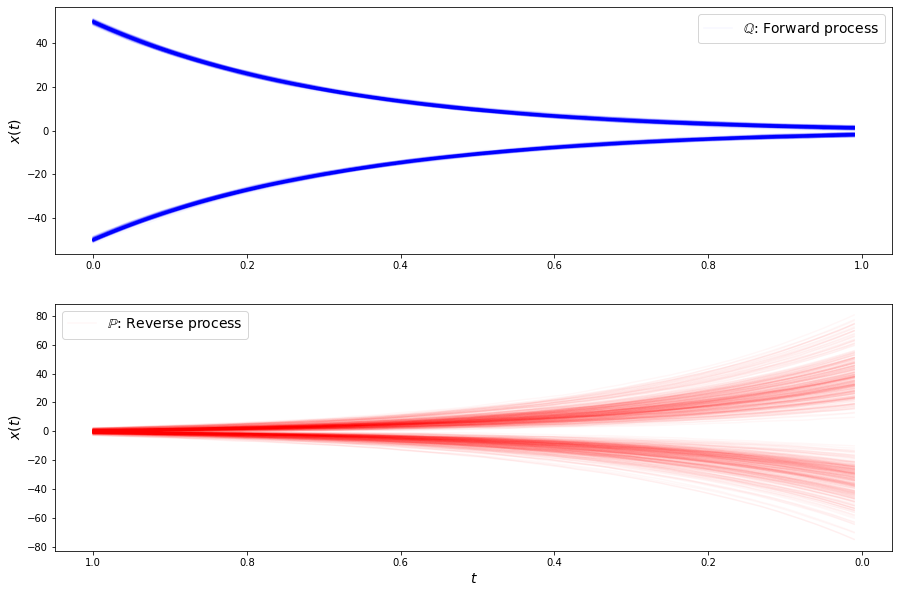

loss b 1.463014006614685
loss b 1.5042680501937866
loss b 1.5490717887878418
loss b 1.431869626045227
loss b 1.4970622062683105
loss b 1.469864845275879
loss b 1.3794485330581665
loss b 1.4972749948501587
loss b 1.4723480939865112
loss b 1.4948381185531616
loss b 1.4613860845565796
loss b 1.3902207612991333
loss b 1.4029662609100342
loss b 1.5343765020370483
loss b 1.4762091636657715
loss b 1.5622862577438354
loss b 1.5564782619476318
loss b 1.4862078428268433
loss b 1.3699982166290283
loss b 1.4440033435821533
loss b 1.4441817998886108
loss b 1.4278124570846558
loss f 4.249908924102783
loss f 4.251081943511963
loss f 4.279730796813965
loss f 4.285034656524658
loss f 4.257511138916016
loss f 4.254000663757324
loss f 4.309624195098877
loss f 4.236234188079834
loss f 4.286795139312744
loss f 4.298749923706055
loss f 4.28044319152832
loss f 4.238969326019287
loss f 4.303504467010498
loss f 4.21931791305542
loss f 4.300705909729004
loss f 4.2675957679748535
loss f 4.2167277336120605
loss f

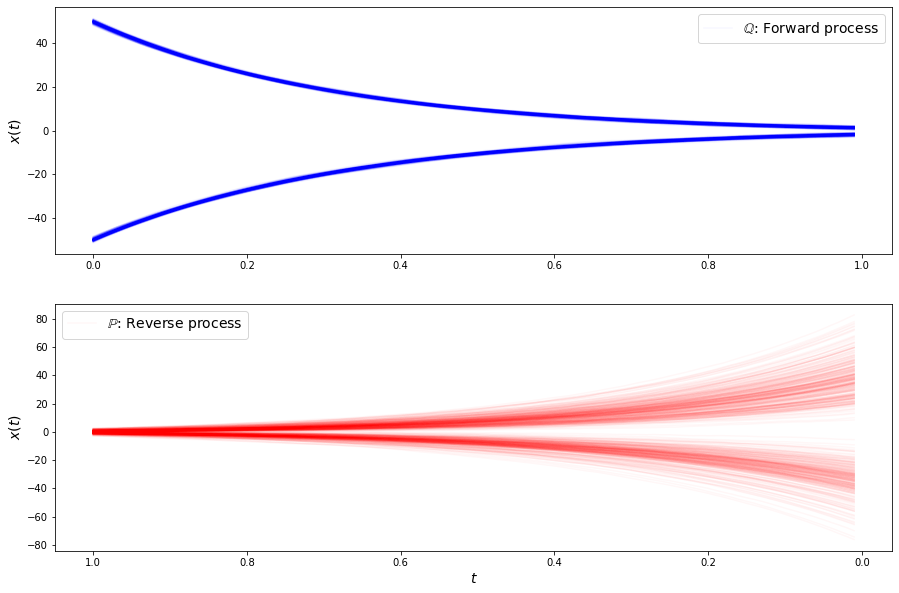

loss b 1.4633891582489014
loss b 1.4662631750106812
loss b 1.4227160215377808
loss b 1.3956568241119385
loss b 1.444037914276123
loss b 1.3805134296417236
loss b 1.4271186590194702
loss b 1.4335185289382935
loss b 1.4628092050552368
loss b 1.409397840499878
loss b 1.4492778778076172
loss b 1.472002625465393
loss b 1.3779231309890747
loss b 1.4492685794830322
loss b 1.4843857288360596
loss b 1.4302304983139038
loss b 1.4124019145965576
loss b 1.4350440502166748
loss b 1.479356050491333
loss b 1.5001335144042969
loss b 1.4833587408065796
loss b 1.4173052310943604
loss f 4.283613681793213
loss f 4.282641887664795
loss f 4.278864860534668
loss f 4.224502086639404
loss f 4.231715202331543
loss f 4.225244998931885
loss f 4.243800163269043
loss f 4.256655216217041
loss f 4.195675373077393
loss f 4.281064510345459
loss f 4.284168720245361
loss f 4.286397457122803
loss f 4.233732223510742
loss f 4.214391708374023
loss f 4.255307197570801
loss f 4.322420120239258
loss f 4.236855983734131
loss f 

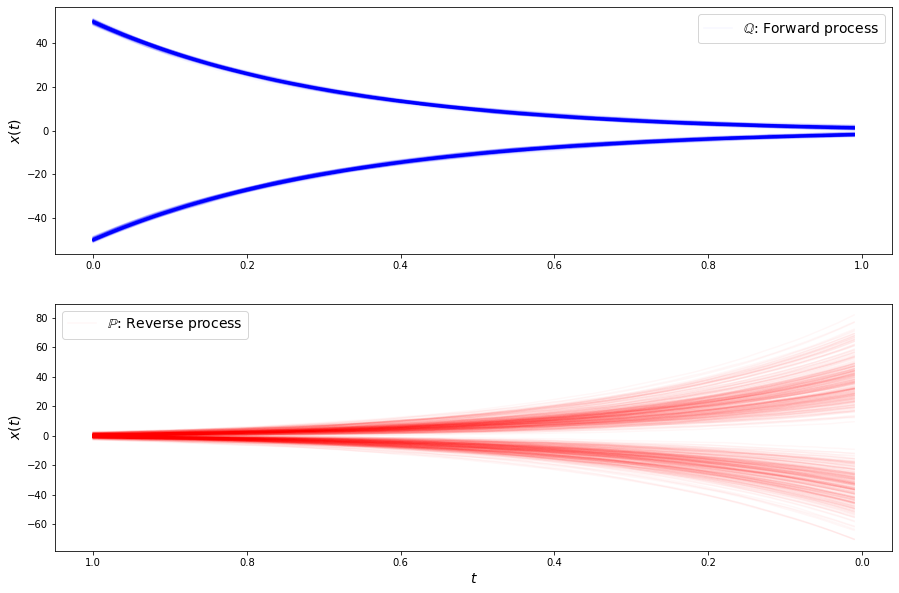

loss b 1.4550226926803589
loss b 1.4424962997436523
loss b 1.4012691974639893
loss b 1.3799904584884644
loss b 1.42449152469635
loss b 1.4441850185394287
loss b 1.405989646911621
loss b 1.52338445186615
loss b 1.4142959117889404
loss b 1.3846372365951538
loss b 1.4568324089050293
loss b 1.5141561031341553
loss b 1.3848298788070679
loss b 1.4039167165756226
loss b 1.3804532289505005
loss b 1.396996021270752
loss b 1.485588788986206
loss b 1.406799554824829
loss b 1.3502918481826782
loss b 1.448395013809204
loss b 1.4471230506896973
loss b 1.4864248037338257
loss f 4.193514823913574
loss f 4.250133991241455
loss f 4.260357856750488
loss f 4.265928268432617
loss f 4.272470951080322
loss f 4.218836784362793
loss f 4.190605640411377
loss f 4.258684158325195
loss f 4.216930866241455
loss f 4.237419128417969
loss f 4.2537760734558105
loss f 4.279821395874023
loss f 4.296414852142334
loss f 4.282961845397949
loss f 4.236264228820801
loss f 4.257557392120361
loss f 4.198161602020264
loss f 4.24

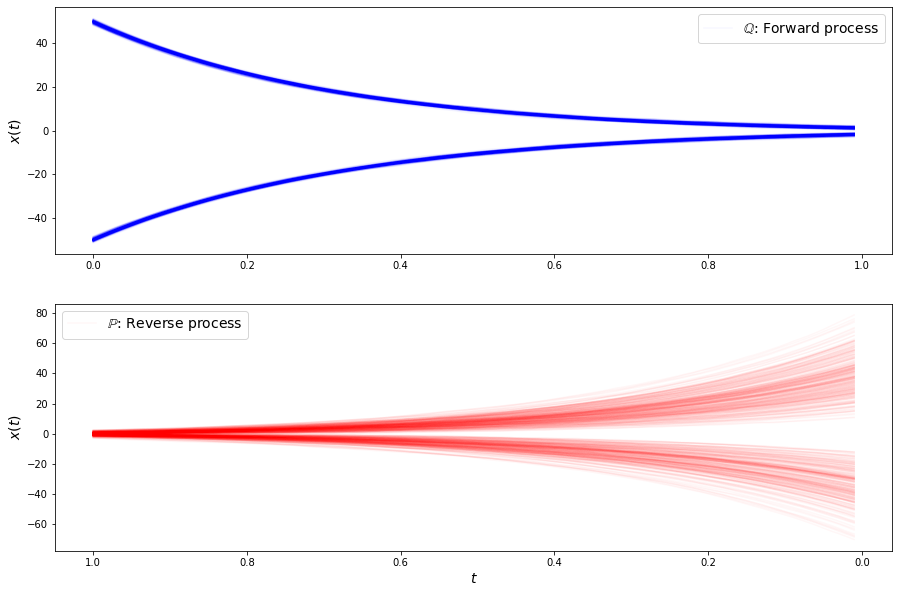

loss b 1.4088209867477417
loss b 1.4433239698410034
loss b 1.3183116912841797
loss b 1.3695683479309082
loss b 1.3484987020492554
loss b 1.4617127180099487
loss b 1.424573540687561
loss b 1.5150971412658691
loss b 1.3805975914001465
loss b 1.3659496307373047
loss b 1.409216284751892
loss b 1.5036200284957886
loss b 1.420937180519104
loss b 1.426670789718628
loss b 1.4761724472045898
loss b 1.4005681276321411
loss b 1.4034502506256104
loss b 1.4288605451583862
loss b 1.3791919946670532
loss b 1.3238322734832764
loss b 1.3885422945022583
loss b 1.3167567253112793
loss f 4.272113800048828
loss f 4.249689102172852
loss f 4.2207794189453125
loss f 4.311962127685547
loss f 4.249911785125732
loss f 4.268843173980713
loss f 4.267049312591553
loss f 4.264641761779785
loss f 4.226593971252441
loss f 4.217154026031494
loss f 4.216667652130127
loss f 4.255622863769531
loss f 4.258660793304443
loss f 4.2219157218933105
loss f 4.1640191078186035
loss f 4.239235877990723
loss f 4.261041164398193
loss

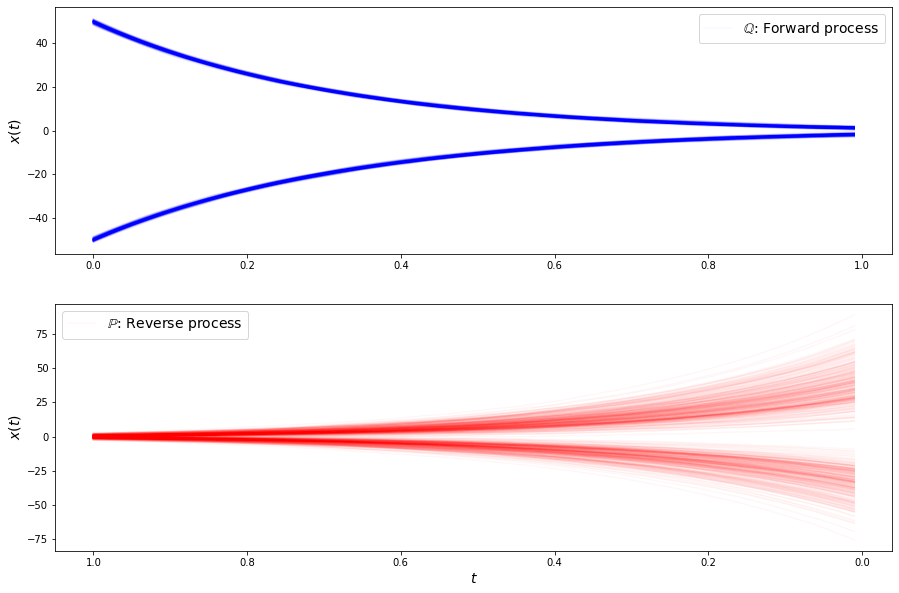

loss b 1.360582947731018
loss b 1.32365083694458
loss b 1.3779220581054688
loss b 1.4340910911560059
loss b 1.4533631801605225
loss b 1.369038701057434
loss b 1.391803503036499
loss b 1.3280837535858154
loss b 1.426842451095581
loss b 1.41487455368042
loss b 1.3600057363510132
loss b 1.3718719482421875
loss b 1.4442312717437744
loss b 1.3952727317810059
loss b 1.3622605800628662
loss b 1.3276437520980835
loss b 1.4409840106964111
loss b 1.3691396713256836
loss b 1.386847734451294
loss b 1.2721327543258667
loss b 1.3260732889175415
loss b 1.3640773296356201
loss f 4.20566987991333
loss f 4.214455604553223
loss f 4.245471000671387
loss f 4.18860387802124
loss f 4.247903823852539
loss f 4.217899322509766
loss f 4.204182147979736
loss f 4.240485191345215
loss f 4.211339473724365
loss f 4.241819858551025
loss f 4.2059807777404785
loss f 4.250584125518799
loss f 4.205307483673096
loss f 4.221388339996338
loss f 4.208744049072266
loss f 4.209442615509033
loss f 4.219203948974609
loss f 4.1848

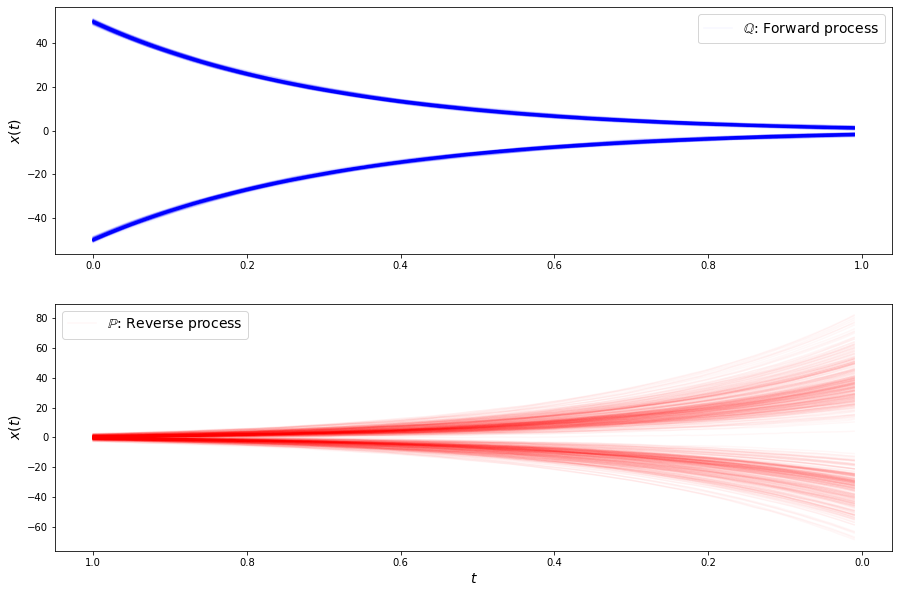

loss b 1.3755407333374023
loss b 1.357643961906433
loss b 1.3405532836914062
loss b 1.3315802812576294
loss b 1.450019359588623
loss b 1.37127685546875
loss b 1.4835127592086792
loss b 1.384037971496582
loss b 1.305856466293335
loss b 1.377185344696045
loss b 1.452337384223938
loss b 1.3188672065734863
loss b 1.4299709796905518
loss b 1.401078701019287
loss b 1.28778874874115
loss b 1.3882217407226562
loss b 1.3745702505111694
loss b 1.3406490087509155
loss b 1.380043864250183
loss b 1.4653774499893188
loss b 1.3826812505722046
loss b 1.3117822408676147
loss f 4.194555282592773
loss f 4.223377227783203
loss f 4.20354700088501
loss f 4.188583850860596
loss f 4.179204940795898
loss f 4.185461044311523
loss f 4.1587958335876465
loss f 4.151291847229004
loss f 4.1786651611328125
loss f 4.160694122314453
loss f 4.189227104187012
loss f 4.161196708679199
loss f 4.198531627655029
loss f 4.189260482788086
loss f 4.22373104095459
loss f 4.1886796951293945
loss f 4.127651691436768
loss f 4.24359

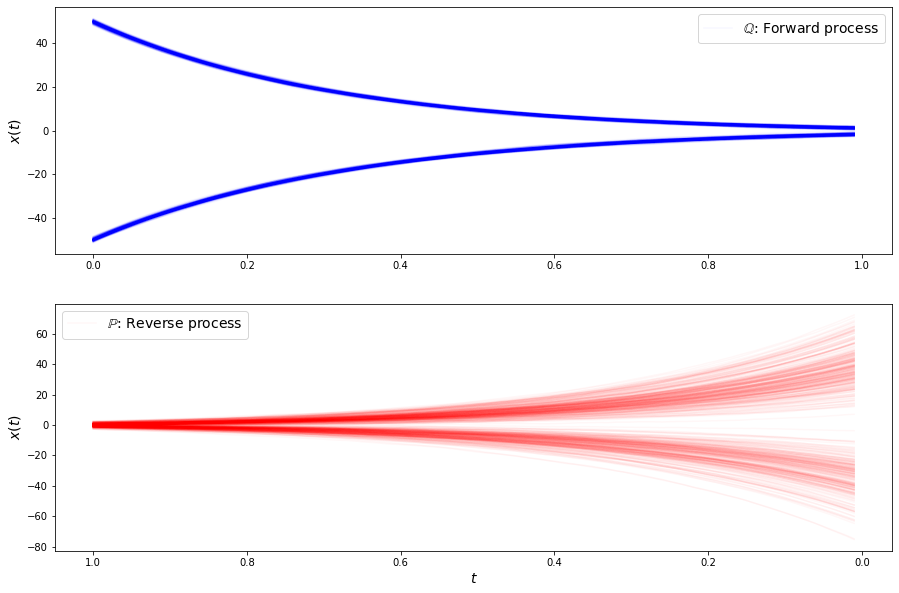

loss b 1.361640453338623
loss b 1.247199296951294
loss b 1.4055659770965576
loss b 1.4375293254852295
loss b 1.2952995300292969
loss b 1.3731039762496948
loss b 1.349671483039856
loss b 1.279359221458435
loss b 1.3110439777374268
loss b 1.2739152908325195
loss b 1.2677384614944458
loss b 1.3595579862594604
loss b 1.3346657752990723
loss b 1.4096132516860962
loss b 1.3833847045898438
loss b 1.3153129816055298
loss b 1.3443080186843872
loss b 1.3160277605056763
loss b 1.4136236906051636
loss b 1.299641489982605
loss b 1.408305048942566
loss b 1.3201557397842407
loss f 4.188942909240723
loss f 4.204475402832031
loss f 4.175409317016602
loss f 4.215272903442383
loss f 4.216494083404541
loss f 4.192943096160889
loss f 4.194118022918701
loss f 4.157581806182861
loss f 4.138419151306152
loss f 4.1553754806518555
loss f 4.143410682678223
loss f 4.168535232543945
loss f 4.18723201751709
loss f 4.140117168426514
loss f 4.152941703796387
loss f 4.192337512969971
loss f 4.181530475616455
loss f 4.

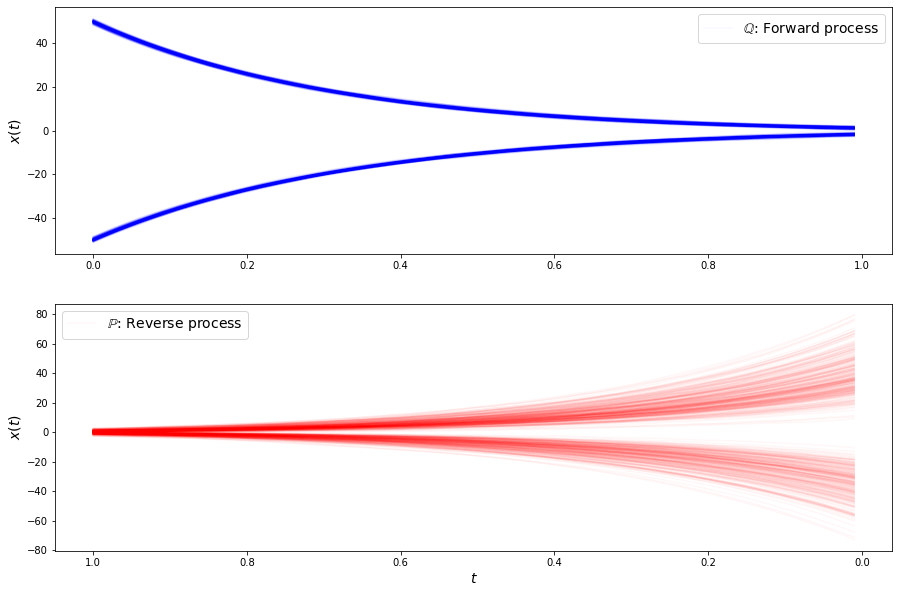

loss b 1.365625262260437
loss b 1.4613230228424072
loss b 1.3281155824661255
loss b 1.3164547681808472
loss b 1.3348733186721802
loss b 1.443994402885437
loss b 1.5187668800354004
loss b 1.5011390447616577
loss b 1.4832682609558105
loss b 1.433661699295044
loss b 1.3428834676742554
loss b 1.321317195892334
loss b 1.334046483039856
loss b 1.3802279233932495
loss b 1.3225477933883667
loss b 1.4053666591644287
loss b 1.3598365783691406
loss b 1.404221534729004
loss b 1.4033946990966797
loss b 1.392536997795105
loss b 1.4200352430343628
loss b 1.3400641679763794
loss f 4.210620403289795
loss f 4.225148677825928
loss f 4.183090686798096
loss f 4.122875690460205
loss f 4.171820640563965
loss f 4.303203582763672
loss f 4.198881149291992
loss f 4.227991104125977
loss f 4.204901695251465
loss f 4.136164665222168
loss f 4.158940315246582
loss f 4.263014793395996
loss f 4.155165195465088
loss f 4.2076005935668945
loss f 4.164249420166016
loss f 4.203382968902588
loss f 4.195723056793213
loss f 4.

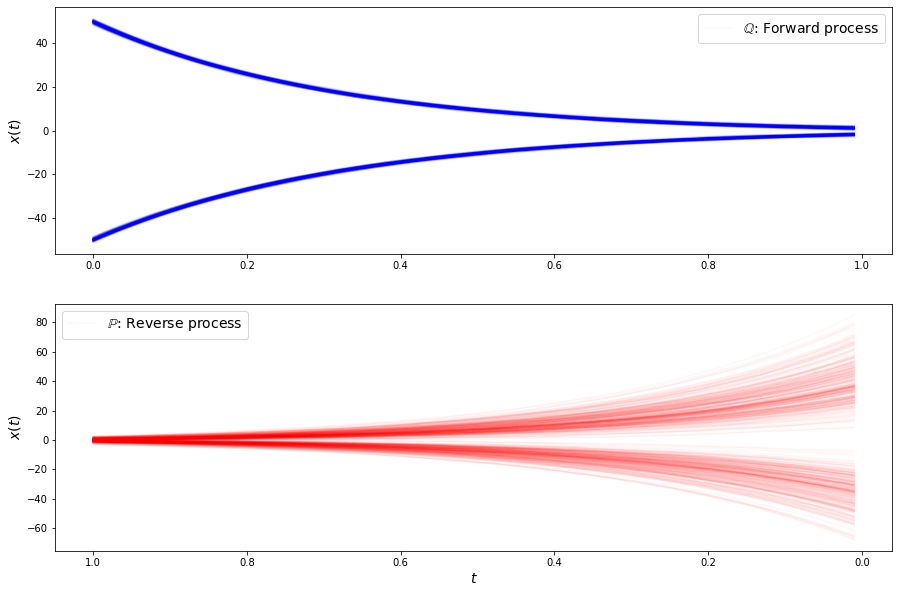

loss b 1.2824267148971558
loss b 1.357483983039856
loss b 1.3862006664276123
loss b 1.3499585390090942
loss b 1.3941609859466553
loss b 1.3937275409698486
loss b 1.305662751197815
loss b 1.3509992361068726
loss b 1.3518718481063843
loss b 1.331436276435852
loss b 1.306562066078186
loss b 1.3765238523483276
loss b 1.3136608600616455
loss b 1.364375352859497
loss b 1.3525238037109375
loss b 1.326238989830017
loss b 1.385443091392517
loss b 1.3581186532974243
loss b 1.4123976230621338
loss b 1.3545821905136108
loss b 1.3244967460632324
loss b 1.3324967622756958
loss f 4.22167444229126
loss f 4.1700286865234375
loss f 4.131431579589844
loss f 4.128989219665527
loss f 4.147884368896484
loss f 4.166189670562744
loss f 4.221121311187744
loss f 4.153039932250977
loss f 4.234629154205322
loss f 4.217299938201904
loss f 4.146702766418457
loss f 4.166472434997559
loss f 4.199314594268799
loss f 4.196327209472656
loss f 4.177317142486572
loss f 4.148754596710205
loss f 4.200858116149902
loss f 4.1

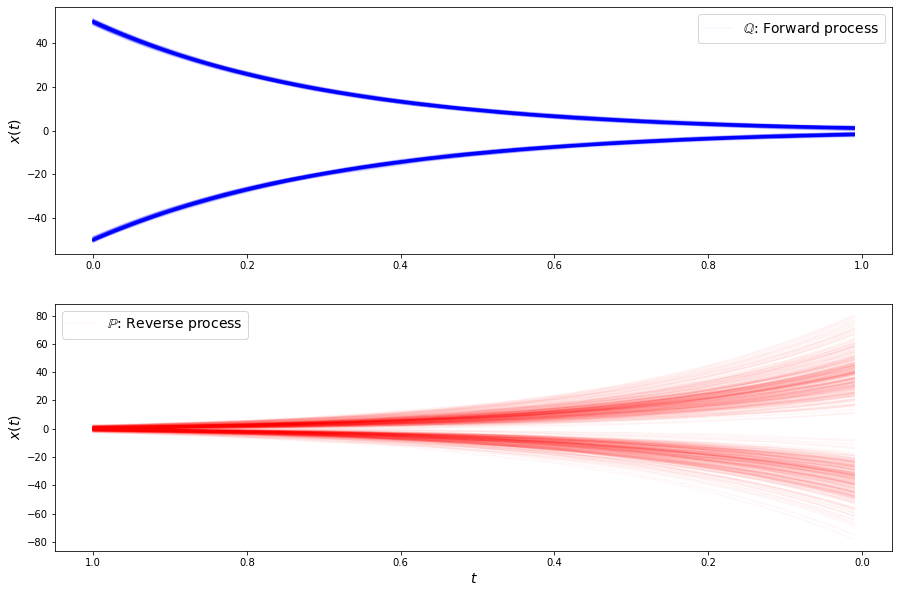

loss b 1.3295491933822632
loss b 1.3393120765686035
loss b 1.3091905117034912
loss b 1.3485233783721924
loss b 1.3415244817733765
loss b 1.3210052251815796
loss b 1.316394567489624
loss b 1.3150819540023804
loss b 1.2503315210342407
loss b 1.293860912322998
loss b 1.2425562143325806
loss b 1.2980618476867676
loss b 1.4037909507751465
loss b 1.2568107843399048
loss b 1.4304258823394775
loss b 1.3087480068206787
loss b 1.2842559814453125
loss b 1.2878483533859253
loss b 1.2635422945022583
loss b 1.2948487997055054
loss b 1.3427602052688599
loss b 1.268221378326416
loss f 4.175727367401123
loss f 4.197761535644531
loss f 4.164883613586426
loss f 4.153082847595215
loss f 4.136473655700684
loss f 4.161667346954346
loss f 4.118146896362305
loss f 4.17020320892334
loss f 4.170528888702393
loss f 4.175124168395996
loss f 4.1449809074401855
loss f 4.169783592224121
loss f 4.144972324371338
loss f 4.1430230140686035
loss f 4.1804118156433105
loss f 4.175665855407715
loss f 4.166472911834717
loss

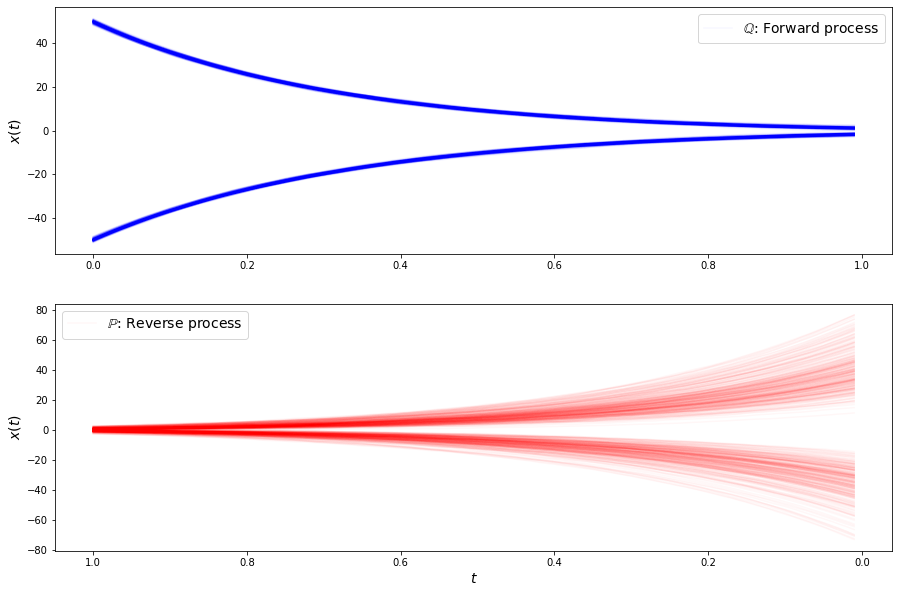

loss b 1.3138043880462646
loss b 1.2126567363739014
loss b 1.2779719829559326
loss b 1.3359277248382568
loss b 1.317762017250061
loss b 1.320155382156372
loss b 1.4020776748657227
loss b 1.3543058633804321
loss b 1.2943263053894043
loss b 1.3319400548934937
loss b 1.239754319190979
loss b 1.240517497062683
loss b 1.2554543018341064
loss b 1.2511987686157227
loss b 1.2579503059387207
loss b 1.3583917617797852
loss b 1.3074079751968384
loss b 1.2734100818634033
loss b 1.3329170942306519
loss b 1.3003854751586914
loss b 1.3217569589614868
loss b 1.2643316984176636
loss f 4.182511329650879
loss f 4.100026607513428
loss f 4.187161445617676
loss f 4.150970935821533
loss f 4.157970905303955
loss f 4.163224220275879
loss f 4.147831439971924
loss f 4.1380839347839355
loss f 4.12406063079834
loss f 4.090760231018066
loss f 4.140688896179199
loss f 4.087647914886475
loss f 4.161390781402588
loss f 4.150655746459961
loss f 4.149232387542725
loss f 4.1454758644104
loss f 4.111432075500488
loss f 4.

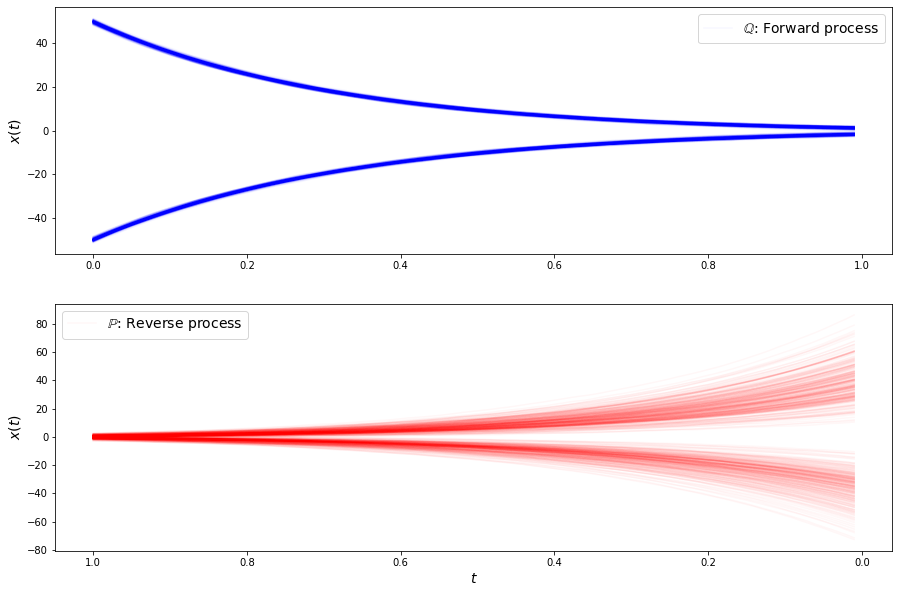

loss b 1.2918047904968262
loss b 1.345338225364685
loss b 1.2649507522583008
loss b 1.2838386297225952
loss b 1.315348505973816
loss b 1.3611177206039429
loss b 1.2441800832748413
loss b 1.2192792892456055
loss b 1.2652132511138916
loss b 1.277640461921692
loss b 1.295573115348816
loss b 1.262383222579956
loss b 1.2985419034957886
loss b 1.2991403341293335
loss b 1.2832649946212769
loss b 1.316144585609436
loss b 1.2952653169631958
loss b 1.244102120399475
loss b 1.2673951387405396
loss b 1.363666296005249
loss b 1.3022671937942505
loss b 1.2701653242111206
loss f 4.137796401977539
loss f 4.098000526428223
loss f 4.104339599609375
loss f 4.13154935836792
loss f 4.14617395401001
loss f 4.123013019561768
loss f 4.14297342300415
loss f 4.163952350616455
loss f 4.112399578094482
loss f 4.10996150970459
loss f 4.141117095947266
loss f 4.1354169845581055
loss f 4.122314929962158
loss f 4.182241439819336
loss f 4.122458457946777
loss f 4.133909225463867
loss f 4.136923313140869
loss f 4.11110

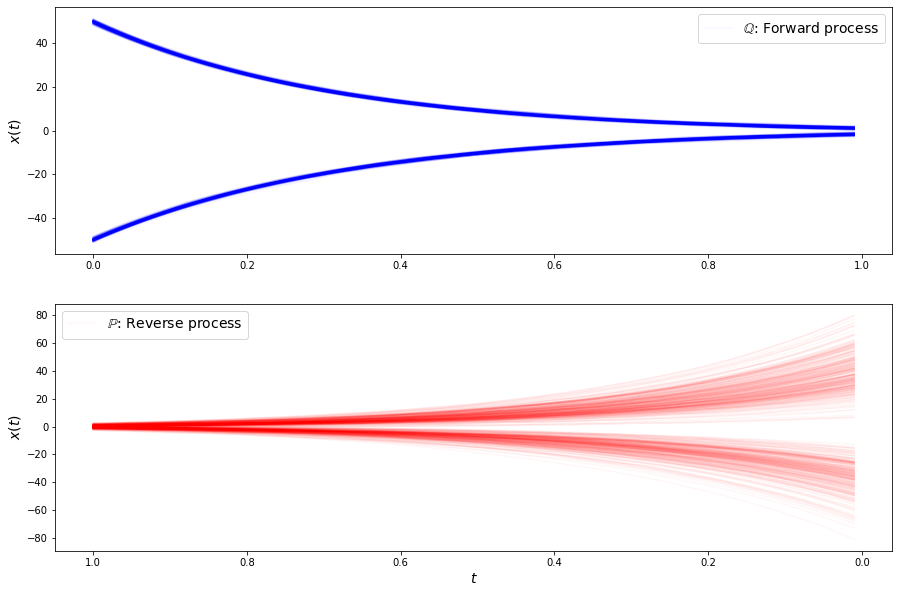

loss b 1.3269927501678467
loss b 1.3319205045700073
loss b 1.2645237445831299
loss b 1.2946937084197998
loss b 1.291725754737854
loss b 1.2189487218856812
loss b 1.2562507390975952
loss b 1.3415805101394653
loss b 1.2923394441604614
loss b 1.3506155014038086
loss b 1.238168716430664
loss b 1.3038800954818726
loss b 1.2495214939117432
loss b 1.2785975933074951
loss b 1.3398979902267456
loss b 1.264322280883789
loss b 1.236860752105713
loss b 1.2403249740600586
loss b 1.2800242900848389
loss b 1.3439680337905884
loss b 1.2413856983184814
loss b 1.3270137310028076
loss f 4.102235794067383
loss f 4.123873710632324
loss f 4.092641830444336
loss f 4.159055233001709
loss f 4.108925819396973
loss f 4.132277965545654
loss f 4.120936870574951
loss f 4.096663475036621
loss f 4.124294281005859
loss f 4.119583606719971
loss f 4.075816631317139
loss f 4.121843338012695
loss f 4.103185176849365
loss f 4.186364650726318
loss f 4.1254119873046875
loss f 4.154847145080566
loss f 4.126593112945557
loss f

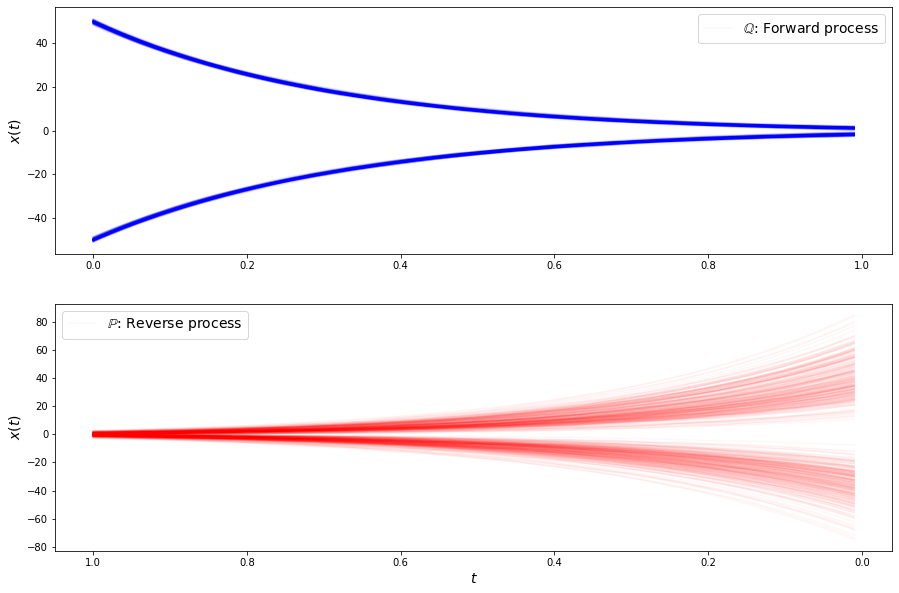

loss b 1.2446733713150024
loss b 1.2961750030517578
loss b 1.2214726209640503
loss b 1.254673957824707
loss b 1.2077727317810059
loss b 1.1692792177200317
loss b 1.2085436582565308
loss b 1.2088547945022583
loss b 1.2544364929199219
loss b 1.280069351196289
loss b 1.1787697076797485
loss b 1.2666252851486206
loss b 1.2067455053329468
loss b 1.2592639923095703
loss b 1.2843347787857056
loss b 1.2188535928726196
loss b 1.2365883588790894
loss b 1.3157010078430176
loss b 1.2244583368301392
loss b 1.2720668315887451
loss b 1.1661036014556885
loss b 1.2684053182601929
loss f 4.114698886871338
loss f 4.084224224090576
loss f 4.105153560638428
loss f 4.135738849639893
loss f 4.061901569366455
loss f 4.116875648498535
loss f 4.099497318267822
loss f 4.116523265838623
loss f 4.099362850189209
loss f 4.10664176940918
loss f 4.132758617401123
loss f 4.113795757293701
loss f 4.1097283363342285
loss f 4.122249603271484
loss f 4.069145202636719
loss f 4.078335285186768
loss f 4.084814548492432
loss 

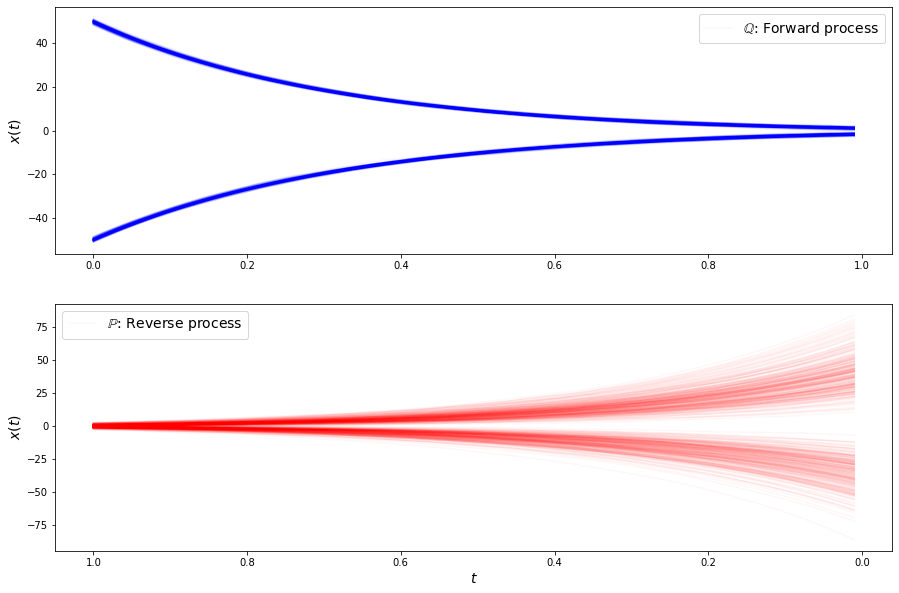

loss b 1.307880163192749
loss b 1.267006516456604
loss b 1.2184944152832031
loss b 1.230965495109558
loss b 1.2439085245132446
loss b 1.224183201789856
loss b 1.2554315328598022
loss b 1.2272368669509888
loss b 1.2542208433151245
loss b 1.2029646635055542
loss b 1.233278751373291
loss b 1.2329585552215576
loss b 1.201303482055664
loss b 1.3161202669143677
loss b 1.2891262769699097
loss b 1.1684637069702148
loss b 1.1851450204849243
loss b 1.3424628973007202
loss b 1.2242276668548584
loss b 1.2930874824523926
loss b 1.2686660289764404
loss b 1.2137562036514282
loss f 4.08730936050415
loss f 4.083279132843018
loss f 4.075430870056152
loss f 4.100654602050781
loss f 4.052951812744141
loss f 4.095543384552002
loss f 4.061448574066162
loss f 4.037908554077148
loss f 4.111763000488281
loss f 4.109814167022705
loss f 4.081386089324951
loss f 4.124965667724609
loss f 4.037387847900391
loss f 4.103785991668701
loss f 4.044476509094238
loss f 4.062208652496338
loss f 4.05526876449585
loss f 4.14

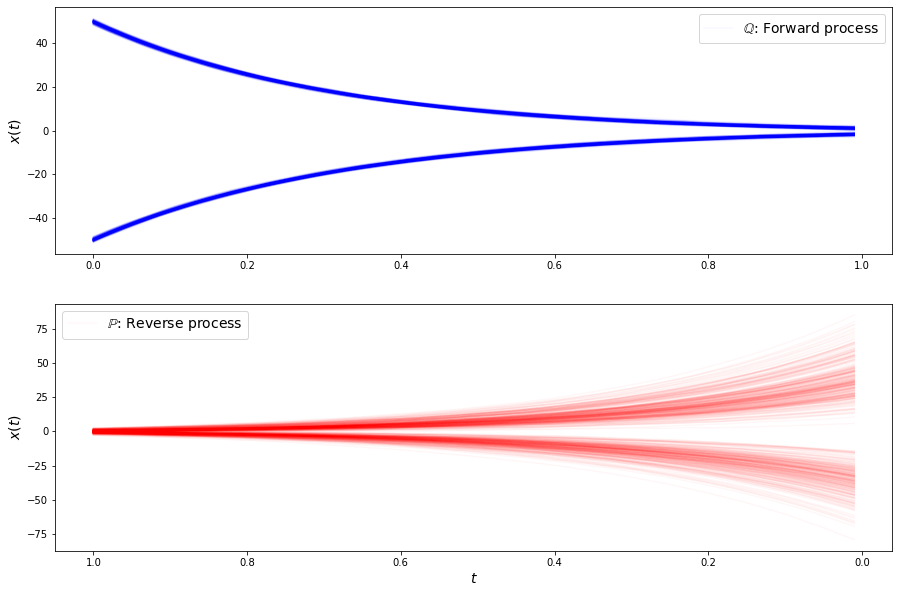

loss b 1.2284067869186401
loss b 1.1889780759811401
loss b 1.352586269378662
loss b 1.202243447303772
loss b 1.2058354616165161
loss b 1.3071191310882568
loss b 1.155696153640747
loss b 1.207207202911377
loss b 1.178732991218567
loss b 1.2434250116348267
loss b 1.22722327709198
loss b 1.1587415933609009
loss b 1.2067023515701294
loss b 1.2232065200805664
loss b 1.2143845558166504
loss b 1.1926662921905518
loss b 1.2185484170913696
loss b 1.2211823463439941
loss b 1.1870039701461792
loss b 1.2438567876815796
loss b 1.2117747068405151
loss b 1.238065481185913
loss f 4.0530924797058105
loss f 4.09463357925415
loss f 4.047802448272705
loss f 4.075930118560791
loss f 4.077901363372803
loss f 4.092751979827881
loss f 4.0776214599609375
loss f 4.056338787078857
loss f 4.094574451446533
loss f 4.0536909103393555
loss f 4.022772789001465
loss f 4.043757438659668
loss f 4.059295654296875
loss f 4.063693523406982
loss f 4.088257789611816
loss f 4.085718154907227
loss f 4.066503047943115
loss f 4.

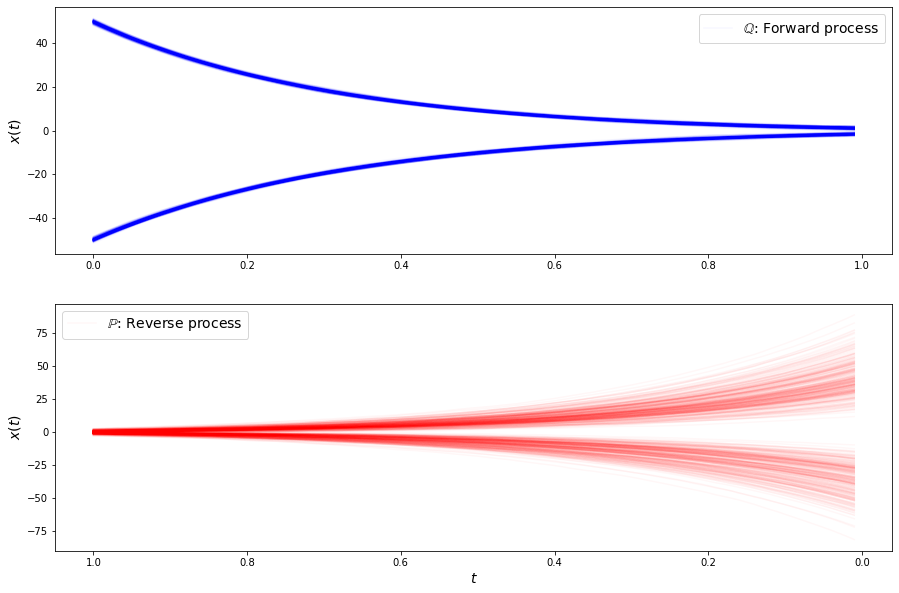

loss b 1.2489511966705322
loss b 1.2219794988632202
loss b 1.1520529985427856
loss b 1.173967957496643
loss b 1.1056561470031738
loss b 1.1629801988601685
loss b 1.167691707611084
loss b 1.1470733880996704
loss b 1.1625049114227295
loss b 1.1304315328598022
loss b 1.2232345342636108
loss b 1.2320913076400757
loss b 1.1797945499420166
loss b 1.1738072633743286
loss b 1.2283586263656616
loss b 1.2162156105041504
loss b 1.2341108322143555
loss b 1.2469422817230225
loss b 1.1819007396697998
loss b 1.285024881362915
loss b 1.180567979812622
loss b 1.1832863092422485
loss f 4.040647506713867
loss f 4.075933933258057
loss f 4.072835922241211
loss f 4.066788196563721
loss f 4.0925469398498535
loss f 4.082219123840332
loss f 4.0832366943359375
loss f 4.039600372314453
loss f 4.065804958343506
loss f 4.122807502746582
loss f 4.091280460357666
loss f 4.0333380699157715
loss f 4.040839672088623
loss f 4.09031867980957
loss f 4.053833484649658
loss f 4.045084476470947
loss f 4.032022476196289
loss 

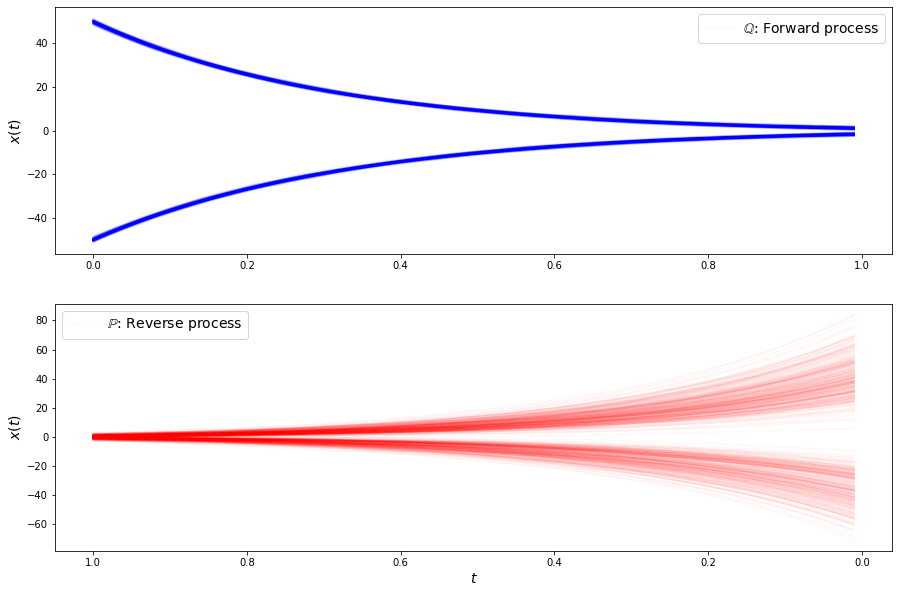

loss b 1.2190284729003906
loss b 1.1341737508773804
loss b 1.1624996662139893
loss b 1.2129887342453003
loss b 1.2005352973937988
loss b 1.1472501754760742
loss b 1.1859233379364014
loss b 1.253476858139038
loss b 1.1387581825256348
loss b 1.1346529722213745
loss b 1.141668677330017
loss b 1.2057536840438843
loss b 1.1884942054748535
loss b 1.2180582284927368
loss b 1.1296253204345703
loss b 1.2143597602844238
loss b 1.2254695892333984
loss b 1.112550973892212
loss b 1.2289865016937256
loss b 1.0725724697113037
loss b 1.1612526178359985
loss b 1.1551674604415894
loss f 4.063929080963135
loss f 4.086880207061768
loss f 4.0916619300842285
loss f 4.054341793060303
loss f 4.010419845581055
loss f 4.027943134307861
loss f 4.032678127288818
loss f 4.04370641708374
loss f 4.032271862030029
loss f 4.07234001159668
loss f 4.038421630859375
loss f 4.038215637207031
loss f 4.048360824584961
loss f 4.0240478515625
loss f 4.032390117645264
loss f 4.05765438079834
loss f 4.052445888519287
loss f 4.0

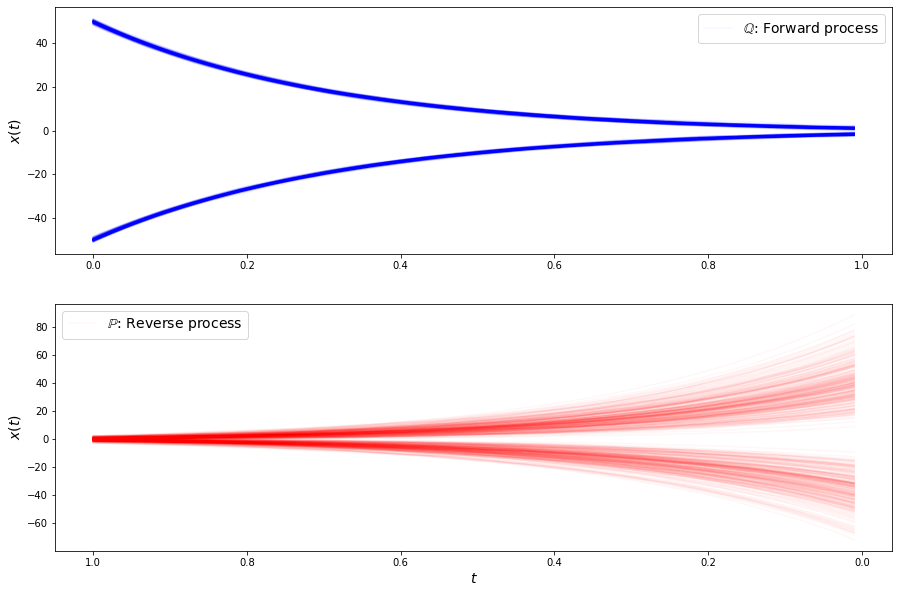

loss b 1.192735195159912
loss b 1.1637802124023438
loss b 1.1489297151565552
loss b 1.2376172542572021
loss b 1.1637471914291382
loss b 1.1890957355499268
loss b 1.17689049243927
loss b 1.269910454750061
loss b 1.1572972536087036
loss b 1.2164487838745117
loss b 1.1047075986862183
loss b 1.182334542274475
loss b 1.1365035772323608
loss b 1.1467632055282593
loss b 1.068090558052063
loss b 1.2564547061920166
loss b 1.2287739515304565
loss b 1.1852056980133057
loss b 1.1768261194229126
loss b 1.1052501201629639
loss b 1.1951383352279663
loss b 1.1064972877502441
loss f 4.005928993225098
loss f 4.039709568023682
loss f 4.025211334228516
loss f 4.025797367095947
loss f 4.024923324584961
loss f 4.015138626098633
loss f 4.045428276062012
loss f 4.016361236572266
loss f 4.022762775421143
loss f 4.020616054534912
loss f 4.058025360107422
loss f 4.022001266479492
loss f 4.02902364730835
loss f 4.002066612243652
loss f 4.044641494750977
loss f 4.050901889801025
loss f 4.025904178619385
loss f 4.0

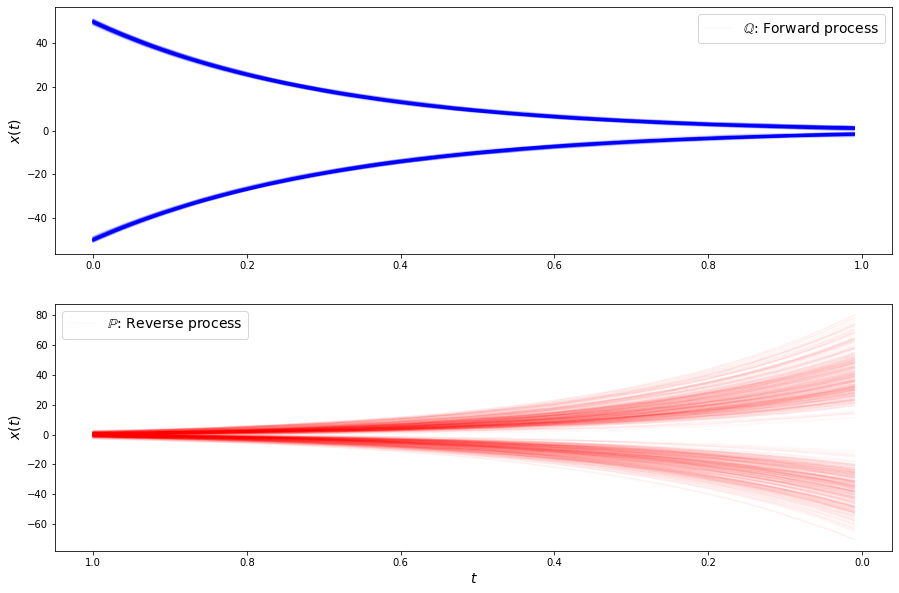

loss b 1.1934994459152222
loss b 1.1687582731246948
loss b 1.14358389377594
loss b 1.1589752435684204
loss b 1.202767252922058
loss b 1.2584885358810425
loss b 1.1039336919784546
loss b 1.1290907859802246
loss b 1.1873222589492798
loss b 1.117061972618103
loss b 1.120497703552246
loss b 1.108575701713562
loss b 1.1979413032531738
loss b 1.1729767322540283
loss b 1.1324729919433594
loss b 1.1590373516082764
loss b 1.063639521598816
loss b 1.1426732540130615
loss b 1.160759449005127
loss b 1.2313852310180664
loss b 1.1648952960968018
loss b 1.160770297050476
loss f 4.007566452026367
loss f 3.99355411529541
loss f 4.004793643951416
loss f 4.024783134460449
loss f 3.9709928035736084
loss f 4.049427509307861
loss f 3.974649429321289
loss f 4.044375419616699
loss f 4.042591571807861
loss f 4.021203517913818
loss f 3.9659953117370605
loss f 4.02686071395874
loss f 4.024218559265137
loss f 3.9606289863586426
loss f 3.9915716648101807
loss f 3.990917682647705
loss f 3.9461326599121094
loss f 4.

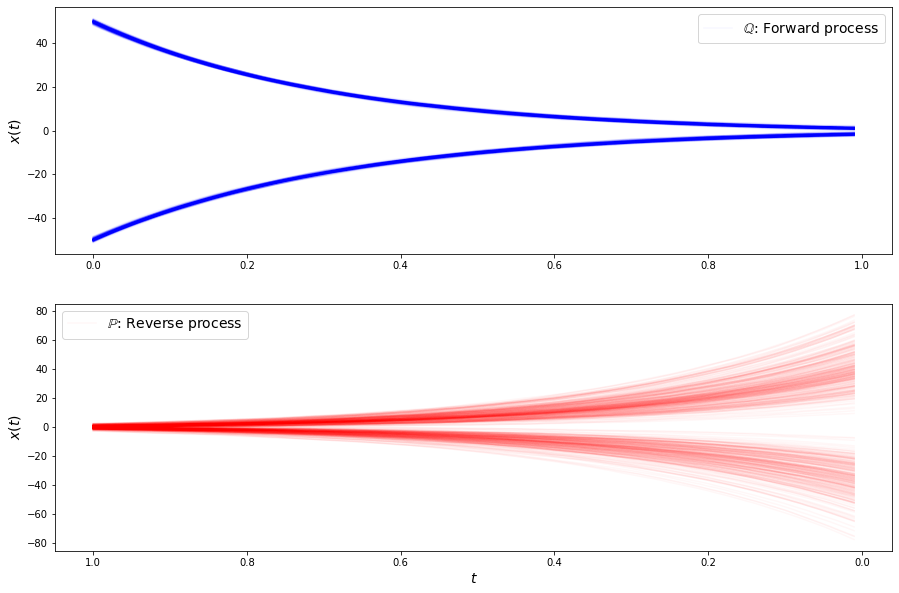

loss b 1.2263996601104736
loss b 1.182763695716858
loss b 1.1105283498764038
loss b 1.2017077207565308
loss b 1.1430305242538452
loss b 1.1901240348815918
loss b 1.0316863059997559
loss b 1.1672192811965942
loss b 1.283784031867981
loss b 1.151257872581482
loss b 1.1111960411071777
loss b 1.1172614097595215
loss b 1.2350482940673828
loss b 1.2225295305252075
loss b 1.0664632320404053
loss b 1.1402400732040405
loss b 1.1407387256622314
loss b 1.155468225479126
loss b 1.0995122194290161
loss b 1.096104621887207
loss b 1.187777042388916
loss b 1.1028287410736084
loss f 4.007509708404541
loss f 4.041537761688232
loss f 4.002813339233398
loss f 3.9742019176483154
loss f 3.967090606689453
loss f 4.0052714347839355
loss f 3.989748001098633
loss f 3.9786760807037354
loss f 3.958357334136963
loss f 3.9721477031707764
loss f 3.9652979373931885
loss f 3.9752044677734375
loss f 3.9670987129211426
loss f 3.9682154655456543
loss f 3.9719786643981934
loss f 3.9559988975524902
loss f 3.963920116424560

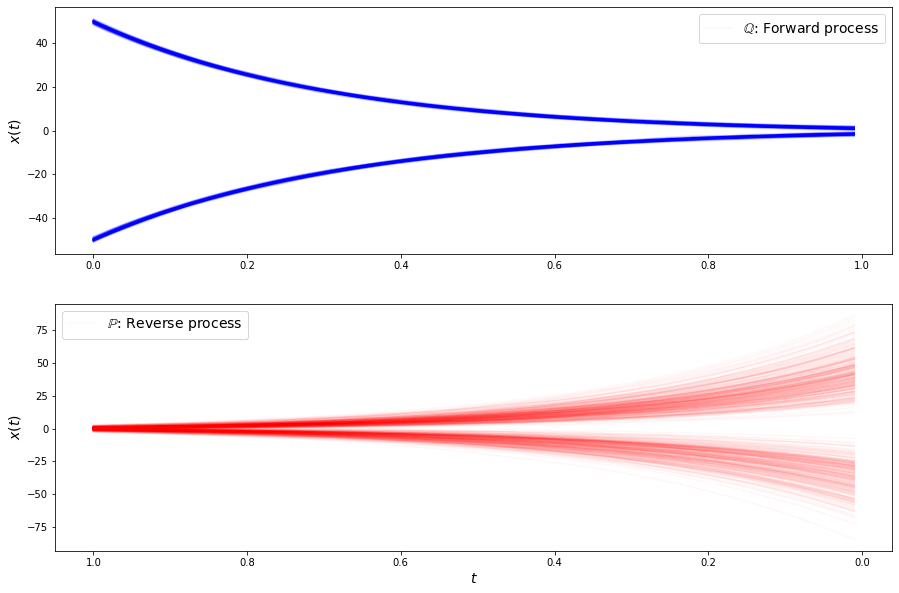

loss b 1.0464324951171875
loss b 1.0949474573135376
loss b 1.1727752685546875
loss b 1.0768373012542725
loss b 1.065243124961853
loss b 1.1371127367019653
loss b 1.139750361442566
loss b 1.1459827423095703
loss b 1.108086347579956
loss b 1.1818550825119019
loss b 1.170230746269226
loss b 1.0902270078659058
loss b 1.1926435232162476
loss b 1.1078767776489258
loss b 1.1421458721160889
loss b 1.125245213508606
loss b 1.1504477262496948
loss b 1.1476662158966064
loss b 1.232313871383667
loss b 1.129443883895874
loss b 1.0558266639709473
loss b 1.122307538986206
loss f 4.02336311340332
loss f 4.001031875610352
loss f 3.973961591720581
loss f 3.991594076156616
loss f 3.9658350944519043
loss f 4.013628959655762
loss f 3.9627017974853516
loss f 3.9830539226531982
loss f 3.9651973247528076
loss f 3.969996213912964
loss f 3.9982941150665283
loss f 4.004302501678467
loss f 4.004987716674805
loss f 3.9839789867401123
loss f 3.9321365356445312
loss f 3.950634717941284
loss f 3.9942870140075684
loss

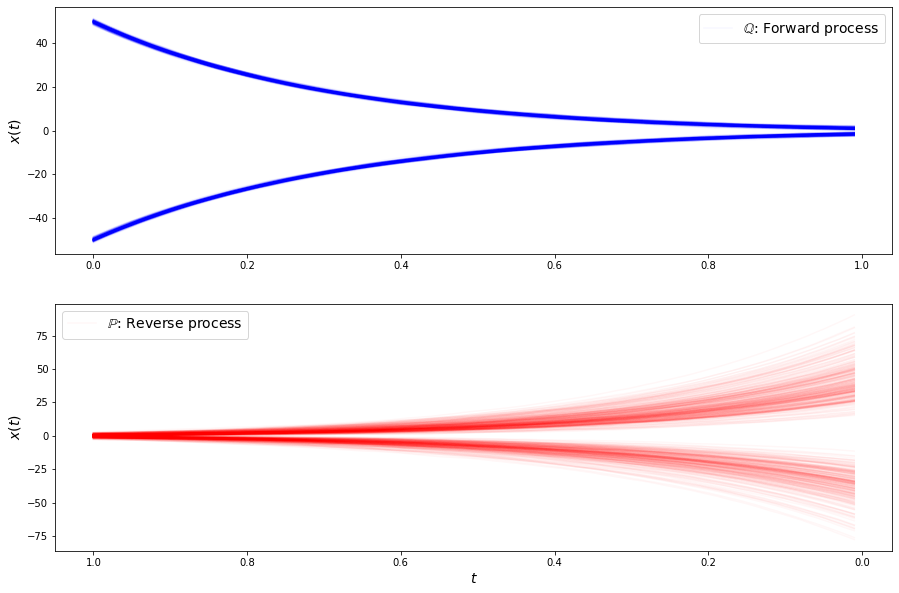

loss b 1.0672613382339478
loss b 1.1112372875213623
loss b 1.157841444015503
loss b 1.2131917476654053
loss b 1.0188665390014648
loss b 1.1342498064041138
loss b 1.1213979721069336
loss b 1.101696252822876
loss b 1.0880705118179321
loss b 1.1617779731750488
loss b 1.0962605476379395
loss b 1.059132695198059
loss b 1.1036794185638428
loss b 1.1228572130203247
loss b 1.1114710569381714
loss b 1.119191288948059
loss b 1.1221323013305664
loss b 1.0444504022598267
loss b 1.0789580345153809
loss b 1.1238242387771606
loss b 1.1365032196044922
loss b 1.0717304944992065
loss f 3.976161003112793
loss f 4.002950668334961
loss f 3.992889881134033
loss f 3.991560459136963
loss f 3.931062698364258
loss f 3.9903855323791504
loss f 4.002707481384277
loss f 3.9604976177215576
loss f 3.9777510166168213
loss f 3.919614553451538
loss f 3.8985683917999268
loss f 3.983260154724121
loss f 3.9629909992218018
loss f 3.9575700759887695
loss f 3.9297924041748047
loss f 3.9153823852539062
loss f 3.989990949630737

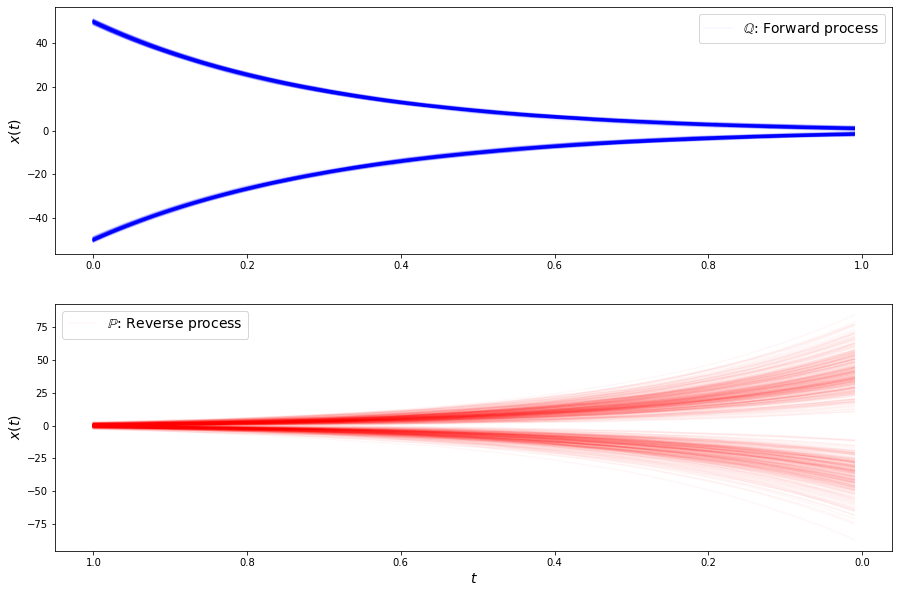

loss b 1.1041125059127808
loss b 1.1665079593658447
loss b 1.0914777517318726
loss b 1.0284998416900635
loss b 1.0814627408981323
loss b 1.0509719848632812
loss b 1.090389370918274
loss b 1.072269082069397
loss b 1.117853045463562
loss b 1.0833265781402588
loss b 1.0279732942581177
loss b 1.1035442352294922
loss b 1.1317569017410278
loss b 1.0709117650985718
loss b 1.1360787153244019
loss b 1.108001470565796
loss b 1.123505711555481
loss b 1.0702956914901733
loss b 1.0898323059082031
loss b 1.0744647979736328
loss b 1.0728803873062134
loss b 1.0926170349121094
loss f 3.971949338912964
loss f 3.9659032821655273
loss f 3.9802534580230713
loss f 3.934242010116577
loss f 3.974433422088623
loss f 3.9574053287506104
loss f 3.9393250942230225
loss f 3.9631996154785156
loss f 3.9438650608062744
loss f 3.888392925262451
loss f 3.955662965774536
loss f 3.9392356872558594
loss f 3.9653618335723877
loss f 3.9428954124450684
loss f 3.936455726623535
loss f 3.950355291366577
loss f 3.930078506469726

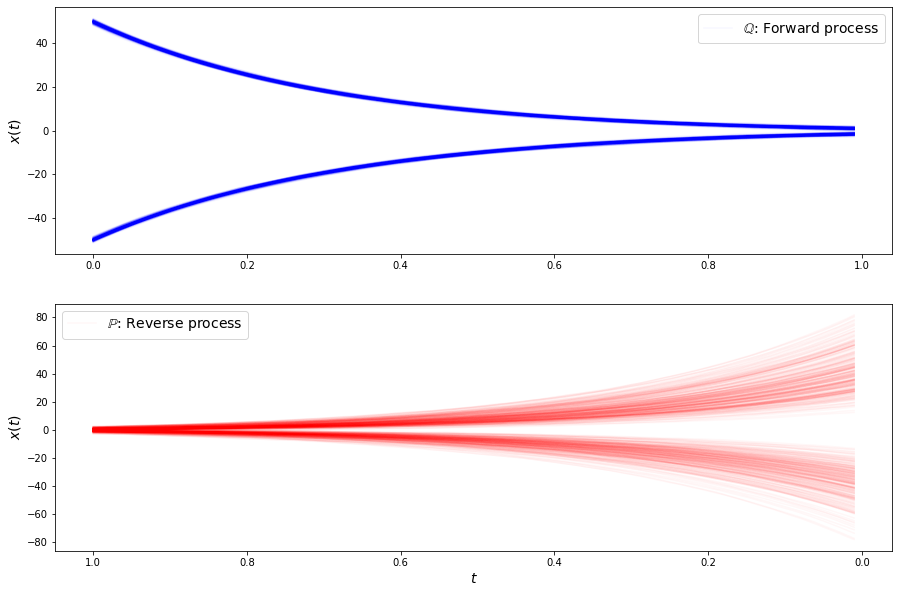

loss b 1.0650484561920166
loss b 1.0020464658737183
loss b 1.0801326036453247
loss b 1.07183837890625
loss b 1.0006835460662842
loss b 0.9281309843063354
loss b 1.1018965244293213
loss b 1.0583232641220093
loss b 1.0059590339660645
loss b 1.0777486562728882
loss b 1.1342337131500244
loss b 1.1382055282592773
loss b 1.0701910257339478
loss b 1.0593230724334717
loss b 1.1053452491760254
loss b 0.9849212169647217
loss b 1.0681012868881226
loss b 1.0674494504928589
loss b 1.086193323135376
loss b 1.065181016921997
loss b 1.0635024309158325
loss b 1.1575795412063599
loss f 3.901907444000244
loss f 3.953141927719116
loss f 3.920095920562744
loss f 3.943737030029297
loss f 3.934697389602661
loss f 3.955646276473999
loss f 3.918147087097168
loss f 3.9614806175231934
loss f 3.9070777893066406
loss f 3.952493190765381
loss f 3.9795033931732178
loss f 3.8933024406433105
loss f 3.9489054679870605
loss f 3.9331235885620117
loss f 3.9662187099456787
loss f 3.9278008937835693
loss f 3.96943998336792


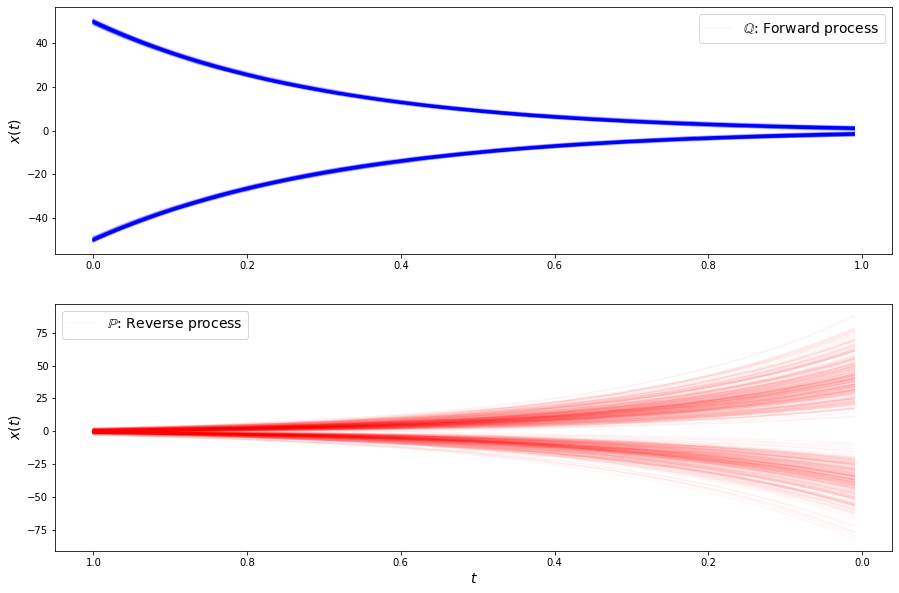

loss b 1.0474491119384766
loss b 1.0769098997116089
loss b 1.1148622035980225
loss b 1.05974280834198
loss b 1.0441006422042847
loss b 1.0366439819335938
loss b 1.1292362213134766
loss b 1.0808354616165161
loss b 1.0269968509674072
loss b 1.038590669631958
loss b 1.052533507347107
loss b 1.0313818454742432
loss b 1.13082754611969
loss b 1.05825674533844
loss b 1.1191602945327759
loss b 1.0896785259246826
loss b 1.0770469903945923
loss b 1.1030035018920898
loss b 1.062106966972351
loss b 1.0402969121932983
loss b 1.0238100290298462
loss b 1.0433892011642456
loss f 3.933779239654541
loss f 3.913769245147705
loss f 3.9374654293060303
loss f 3.9146549701690674
loss f 3.940747022628784
loss f 3.9065659046173096
loss f 3.916705846786499
loss f 3.945796012878418
loss f 3.9361374378204346
loss f 3.881960391998291
loss f 3.9325153827667236
loss f 3.912564277648926
loss f 3.9028232097625732
loss f 3.9362220764160156
loss f 3.922548294067383
loss f 3.9165890216827393
loss f 3.8976995944976807
los

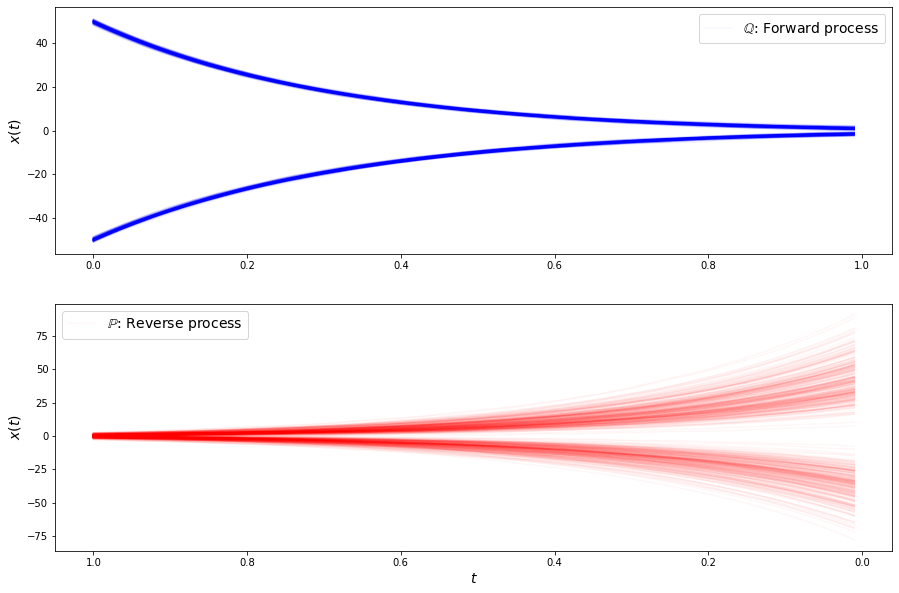

loss b 1.0119678974151611
loss b 1.0240145921707153
loss b 1.0278066396713257
loss b 1.0506218671798706
loss b 1.049338459968567
loss b 1.0468032360076904
loss b 1.0755116939544678
loss b 1.0164809226989746
loss b 0.989477276802063
loss b 1.0616689920425415
loss b 1.0906364917755127
loss b 1.0433205366134644
loss b 1.0968483686447144
loss b 1.0710066556930542
loss b 1.1128562688827515
loss b 1.0416709184646606
loss b 0.9692988991737366
loss b 1.043032169342041
loss b 0.9738733768463135
loss b 1.0841182470321655
loss b 1.1509510278701782
loss b 1.011981725692749
loss f 3.9027469158172607
loss f 3.8956806659698486
loss f 3.9025490283966064
loss f 3.891258955001831
loss f 3.9347445964813232
loss f 3.8946688175201416
loss f 3.8867568969726562
loss f 3.8816909790039062
loss f 3.941511392593384
loss f 3.88246750831604
loss f 3.856293201446533
loss f 3.9594383239746094
loss f 3.9084930419921875
loss f 3.886650562286377
loss f 3.911412000656128
loss f 3.8886382579803467
loss f 3.88240218162536

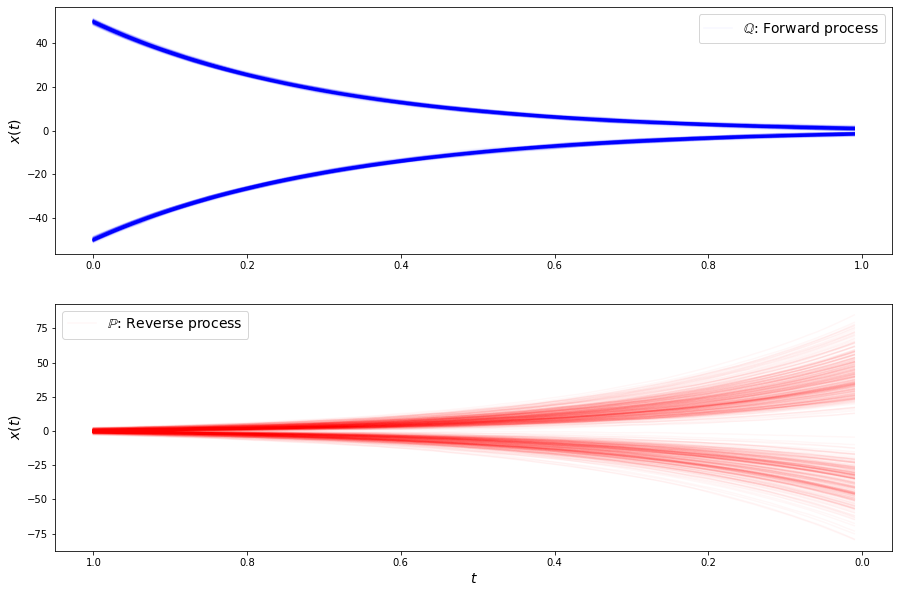

loss b 1.00726318359375
loss b 1.0460841655731201
loss b 0.9688320159912109
loss b 1.1238071918487549
loss b 1.0662699937820435
loss b 1.0284122228622437
loss b 1.0100878477096558
loss b 0.9777704477310181
loss b 1.0655485391616821
loss b 1.0958850383758545
loss b 0.9816343784332275
loss b 1.1119163036346436
loss b 1.0142490863800049
loss b 0.9870527386665344
loss b 0.9976418018341064
loss b 1.1051744222640991
loss b 1.0301865339279175
loss b 1.002697229385376
loss b 1.048236608505249
loss b 1.1353344917297363
loss b 1.0594439506530762
loss b 1.042561411857605
loss f 3.9327893257141113
loss f 3.9003260135650635
loss f 3.8752455711364746
loss f 3.866610527038574
loss f 3.867591142654419
loss f 3.9221489429473877
loss f 3.870384931564331
loss f 3.9073894023895264
loss f 3.8699848651885986
loss f 3.8824610710144043
loss f 3.8893918991088867
loss f 3.9062414169311523
loss f 3.8720901012420654
loss f 3.85068941116333
loss f 3.8621692657470703
loss f 3.893470525741577
loss f 3.89587211608886

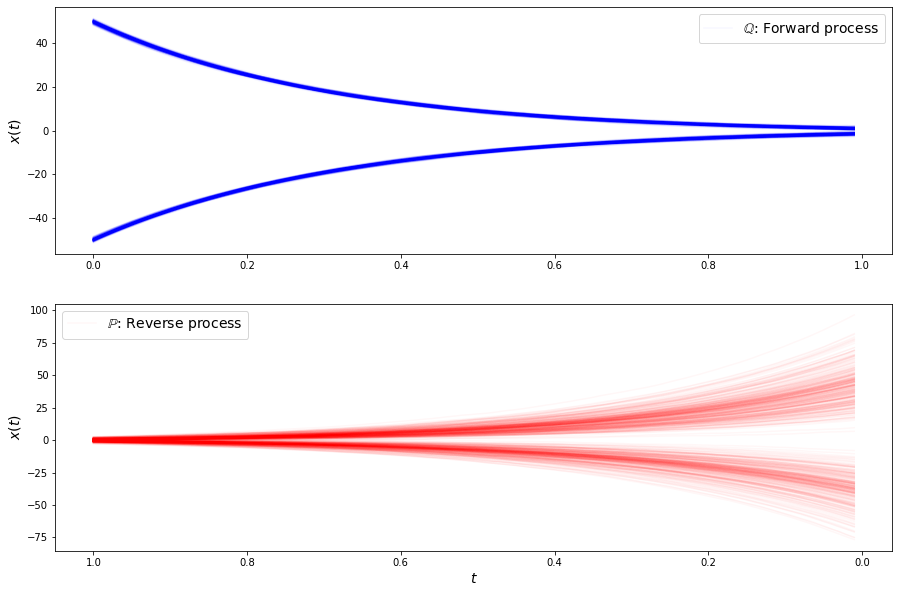

loss b 1.097029209136963
loss b 0.9711922407150269
loss b 1.0017096996307373
loss b 1.007434606552124
loss b 1.119444489479065
loss b 1.0199137926101685
loss b 0.9993321895599365
loss b 1.0075788497924805
loss b 0.9588258862495422
loss b 0.9338781237602234
loss b 1.0189114809036255
loss b 1.004469394683838
loss b 1.1112167835235596
loss b 0.940860390663147
loss b 1.0233955383300781
loss b 1.0101159811019897
loss b 1.0274361371994019
loss b 1.0553909540176392
loss b 1.0032711029052734
loss b 1.0285323858261108
loss b 0.9371863603591919
loss b 1.061423659324646
loss f 3.8609390258789062
loss f 3.911731004714966
loss f 3.8897464275360107
loss f 3.869797468185425
loss f 3.909848928451538
loss f 3.8882930278778076
loss f 3.8682665824890137
loss f 3.8201560974121094
loss f 3.9263668060302734
loss f 3.8837223052978516
loss f 3.8974244594573975
loss f 3.8655669689178467
loss f 3.885084390640259
loss f 3.8291659355163574
loss f 3.883114814758301
loss f 3.8921144008636475
loss f 3.92540264129638

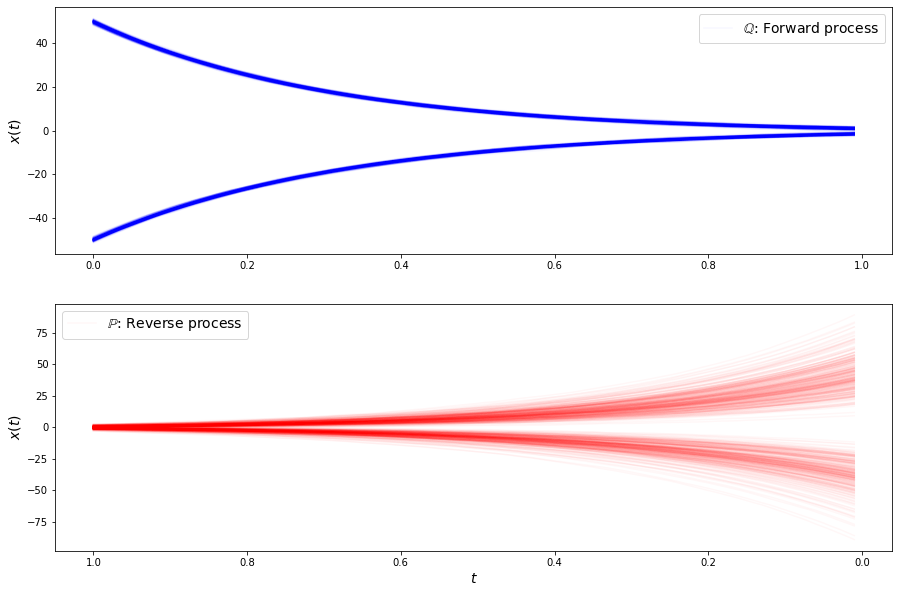

loss b 0.967396080493927
loss b 1.0427342653274536
loss b 0.9227092862129211
loss b 0.9830228090286255
loss b 0.9171042442321777
loss b 0.9596235156059265
loss b 1.0692092180252075
loss b 1.075442910194397
loss b 0.920217752456665
loss b 1.0721545219421387
loss b 1.0259414911270142
loss b 0.9951610565185547
loss b 1.0305454730987549
loss b 0.9832589626312256
loss b 0.9355177879333496
loss b 0.9845863580703735
loss b 0.9744966626167297
loss b 0.9920241236686707
loss b 0.9765182733535767
loss b 1.0402278900146484
loss b 1.006616234779358
loss b 1.0290745496749878
loss f 3.87933611869812
loss f 3.922811508178711
loss f 3.8671460151672363
loss f 3.8779184818267822
loss f 3.8940820693969727
loss f 3.8648884296417236
loss f 3.8487093448638916
loss f 3.8701171875
loss f 3.8634145259857178
loss f 3.8744640350341797
loss f 3.8409996032714844
loss f 3.8857858180999756
loss f 3.879927158355713
loss f 3.830012559890747
loss f 3.8286986351013184
loss f 3.8597030639648438
loss f 3.8486692905426025
l

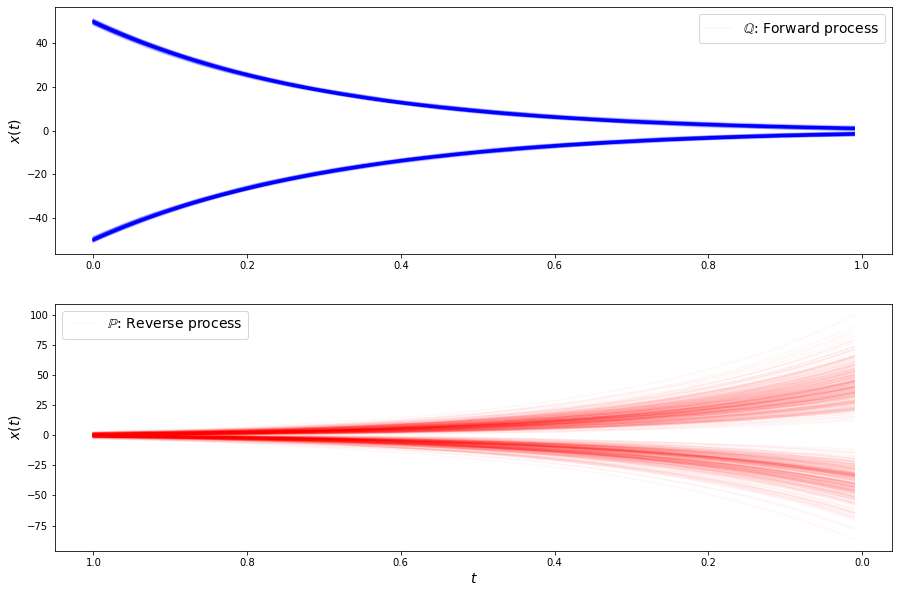

loss b 0.9965882301330566
loss b 1.0192794799804688
loss b 1.0363552570343018
loss b 1.0628327131271362
loss b 1.0256242752075195
loss b 1.0144838094711304
loss b 0.8995040655136108
loss b 1.039244294166565
loss b 1.0162163972854614
loss b 0.9721556901931763
loss b 0.9842433929443359
loss b 0.9707180261611938
loss b 0.9785833954811096
loss b 0.9861118197441101
loss b 0.981637179851532
loss b 0.96125727891922
loss b 0.9446370005607605
loss b 0.9943433403968811
loss b 0.9951030611991882
loss b 0.9793041348457336
loss b 0.9650022983551025
loss b 1.0003176927566528
loss f 3.864562511444092
loss f 3.8277015686035156
loss f 3.8710920810699463
loss f 3.8893654346466064
loss f 3.8486244678497314
loss f 3.854642391204834
loss f 3.826162099838257
loss f 3.8431758880615234
loss f 3.885030746459961
loss f 3.8458895683288574
loss f 3.847827196121216
loss f 3.8481669425964355
loss f 3.8529233932495117
loss f 3.8386809825897217
loss f 3.866375207901001
loss f 3.818988561630249
loss f 3.83999538421630

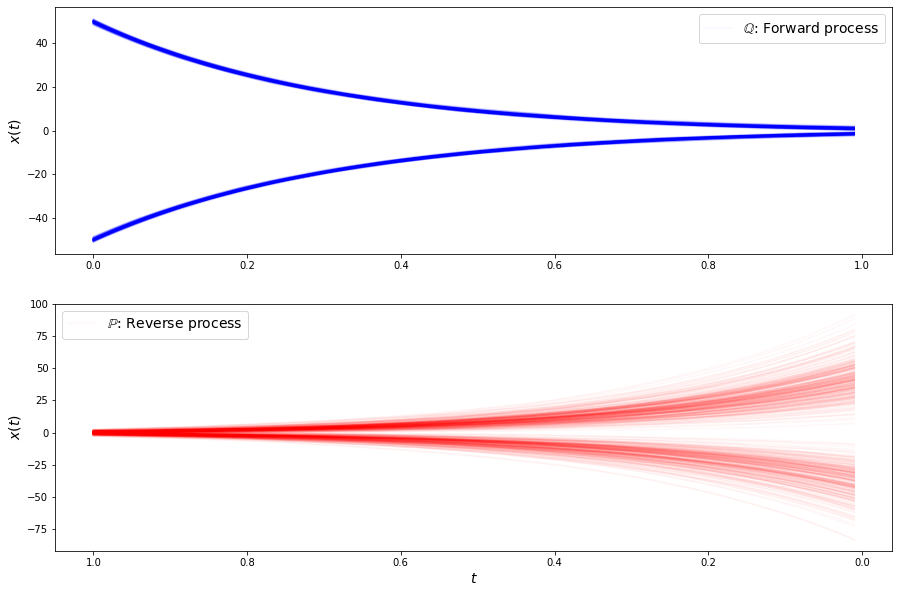

loss b 0.9557178616523743
loss b 0.9567635655403137
loss b 0.9121360182762146
loss b 0.9812898635864258
loss b 0.9774431586265564
loss b 0.9548202157020569
loss b 0.9514456391334534
loss b 0.9985494017601013
loss b 1.0126999616622925
loss b 1.0085841417312622
loss b 0.9729542136192322
loss b 1.0858937501907349
loss b 0.9571354389190674
loss b 1.0393215417861938
loss b 0.9238489866256714
loss b 1.0143640041351318
loss b 0.9780893921852112
loss b 0.9855422377586365
loss b 1.014121413230896
loss b 1.0033622980117798
loss b 0.854851245880127
loss b 0.9585498571395874
loss f 3.829629898071289
loss f 3.857266426086426
loss f 3.8731729984283447
loss f 3.803478479385376
loss f 3.8295719623565674
loss f 3.81734299659729
loss f 3.8356728553771973
loss f 3.8691654205322266
loss f 3.8298165798187256
loss f 3.82991099357605
loss f 3.825427293777466
loss f 3.8128163814544678
loss f 3.7938849925994873
loss f 3.8791983127593994
loss f 3.852144718170166
loss f 3.850459575653076
loss f 3.858932971954345

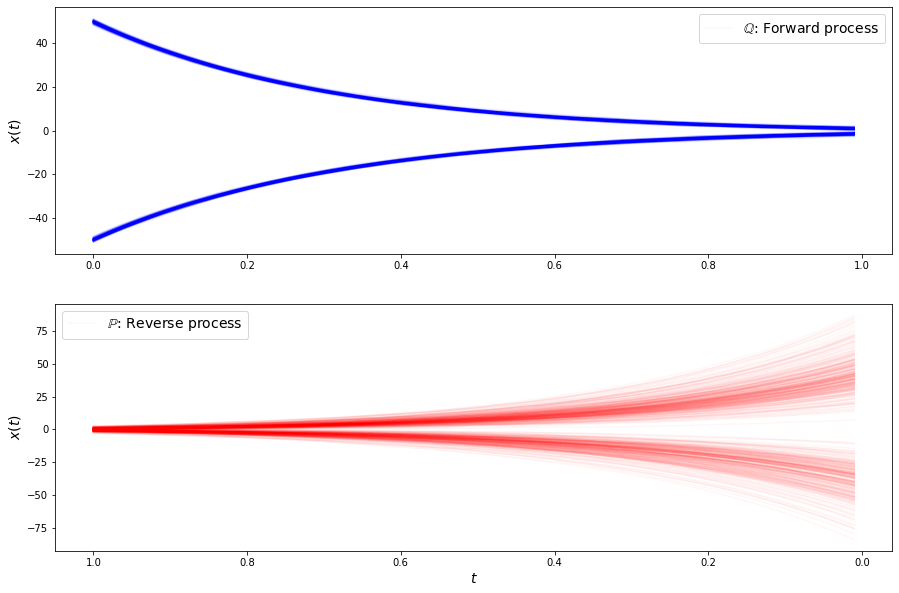

loss b 0.9938902258872986
loss b 0.8873170614242554
loss b 1.0226433277130127
loss b 0.9604269862174988
loss b 0.9561842679977417
loss b 0.9149488806724548
loss b 1.0169732570648193
loss b 0.9495678544044495
loss b 0.9466960430145264
loss b 0.9494904279708862
loss b 0.9909406304359436
loss b 0.8930001854896545
loss b 0.9688538908958435
loss b 0.9928361177444458
loss b 0.8989458680152893
loss b 0.9443296194076538
loss b 1.0418272018432617
loss b 0.9319120049476624
loss b 0.916988730430603
loss b 0.9185214042663574
loss b 1.0147912502288818
loss b 0.9311712384223938
loss f 3.8382349014282227
loss f 3.799579381942749
loss f 3.8233230113983154
loss f 3.785202980041504
loss f 3.841914176940918
loss f 3.814213514328003
loss f 3.857161521911621
loss f 3.7834393978118896
loss f 3.812483549118042
loss f 3.808772087097168
loss f 3.844978094100952
loss f 3.816182851791382
loss f 3.837073802947998
loss f 3.832200050354004
loss f 3.8123209476470947
loss f 3.807502031326294
loss f 3.8083086013793945

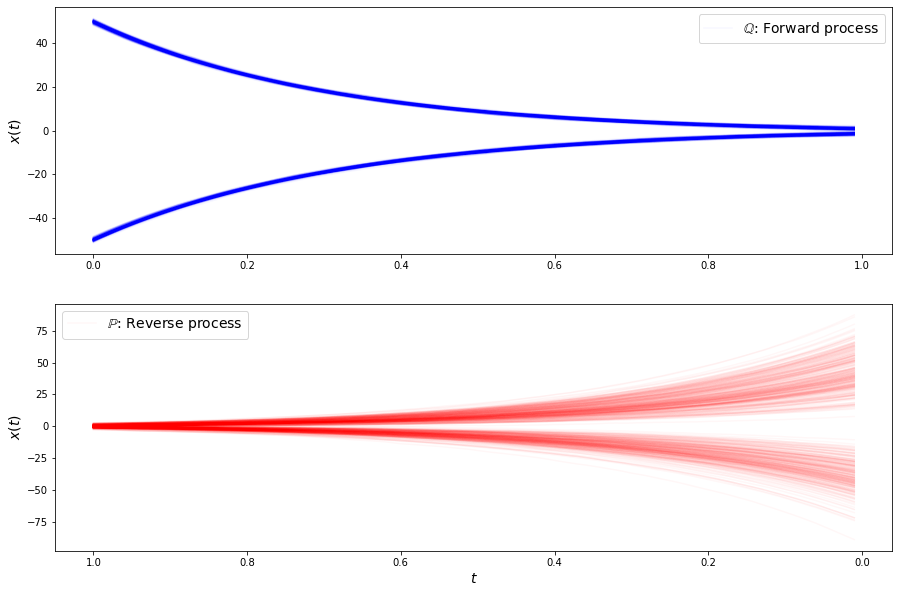

loss b 0.922062873840332
loss b 0.9882560968399048
loss b 0.9293115735054016
loss b 0.972969651222229
loss b 0.8990750908851624
loss b 0.9486006498336792
loss b 0.9456028938293457
loss b 0.8699242472648621
loss b 0.9578766226768494
loss b 1.0168352127075195
loss b 1.0009715557098389
loss b 0.9847229719161987
loss b 0.9534122347831726
loss b 0.946130096912384
loss b 0.8743817210197449
loss b 1.0092859268188477
loss b 0.9199099540710449
loss b 0.9077014327049255
loss b 0.9835966229438782
loss b 0.9617156386375427
loss b 0.9953025579452515
loss b 0.9685361981391907
loss f 3.8105900287628174
loss f 3.803332567214966
loss f 3.8245627880096436
loss f 3.788100481033325
loss f 3.842005968093872
loss f 3.854809045791626
loss f 3.8385891914367676
loss f 3.8177719116210938
loss f 3.835984706878662
loss f 3.8008837699890137
loss f 3.840571403503418
loss f 3.79536509513855
loss f 3.8127241134643555
loss f 3.785676956176758
loss f 3.808034896850586
loss f 3.817061185836792
loss f 3.8145129680633545


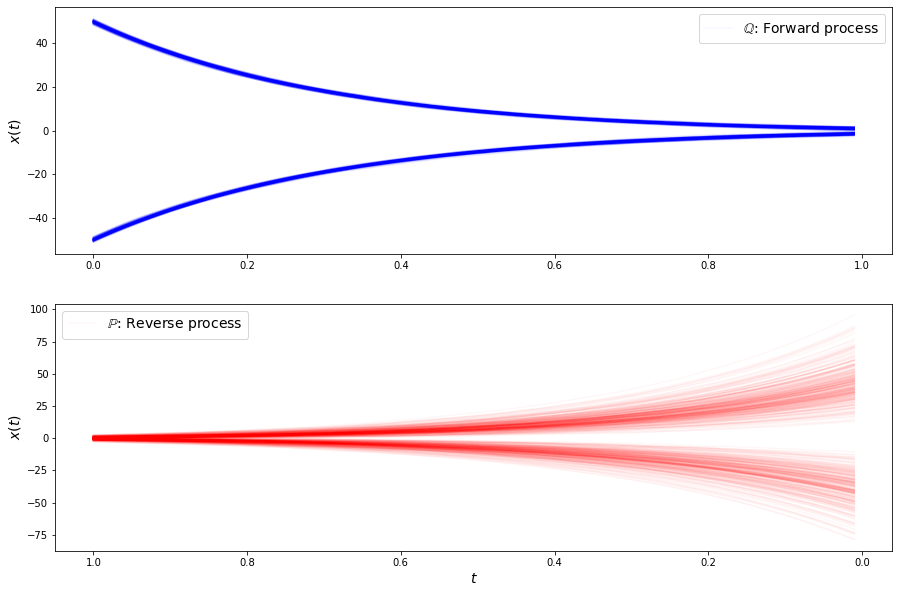

loss b 0.905762791633606
loss b 0.9273892045021057
loss b 0.9732807278633118
loss b 0.9065617918968201
loss b 0.8661850094795227
loss b 0.992154598236084
loss b 0.9052249789237976
loss b 0.9520263671875
loss b 0.9525133967399597
loss b 0.9284418821334839
loss b 0.9108286499977112
loss b 0.8991919755935669
loss b 0.979901134967804
loss b 0.9688589572906494
loss b 0.9050800204277039
loss b 0.925290048122406
loss b 0.9244337677955627
loss b 0.8973124027252197
loss b 0.9181316494941711
loss b 0.851070761680603
loss b 0.9461792707443237
loss b 0.9415463209152222
loss f 3.807588815689087
loss f 3.8185384273529053
loss f 3.791085958480835
loss f 3.759113311767578
loss f 3.842097043991089
loss f 3.7508599758148193
loss f 3.797805070877075
loss f 3.8214850425720215
loss f 3.749077558517456
loss f 3.8438780307769775
loss f 3.8229753971099854
loss f 3.8306870460510254
loss f 3.7968075275421143
loss f 3.817110061645508
loss f 3.795501947402954
loss f 3.815099000930786
loss f 3.791855573654175
loss

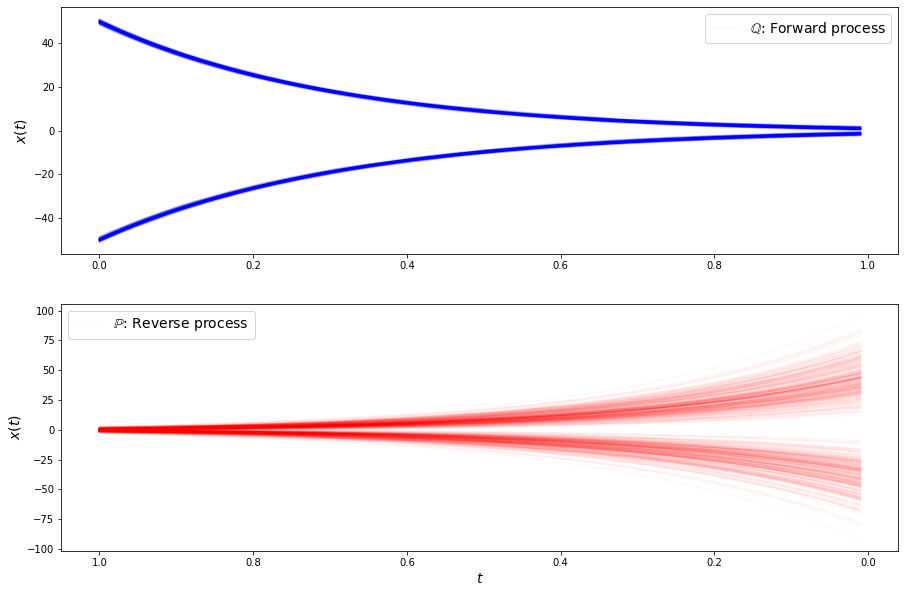

loss b 0.9378674030303955
loss b 0.903552234172821
loss b 0.9656623005867004
loss b 0.9789528250694275
loss b 0.9050167202949524
loss b 0.9938992261886597
loss b 0.9065727591514587
loss b 0.9091230034828186
loss b 0.9435412287712097
loss b 0.896316647529602
loss b 0.9181954860687256
loss b 0.8659964203834534
loss b 0.9656545519828796
loss b 0.8909473419189453
loss b 1.0086357593536377
loss b 1.0367369651794434
loss b 0.9263749718666077
loss b 0.8885418772697449
loss b 0.9360781311988831
loss b 0.9341151118278503
loss b 0.9288473725318909
loss b 1.003490924835205
loss f 3.833251953125
loss f 3.790802240371704
loss f 3.802854061126709
loss f 3.8099865913391113
loss f 3.7774128913879395
loss f 3.8152103424072266
loss f 3.81005859375
loss f 3.811732292175293
loss f 3.840780019760132
loss f 3.7767298221588135
loss f 3.827606439590454
loss f 3.794750452041626
loss f 3.795766830444336
loss f 3.8062732219696045
loss f 3.8129444122314453
loss f 3.795243740081787
loss f 3.790369749069214
loss f 

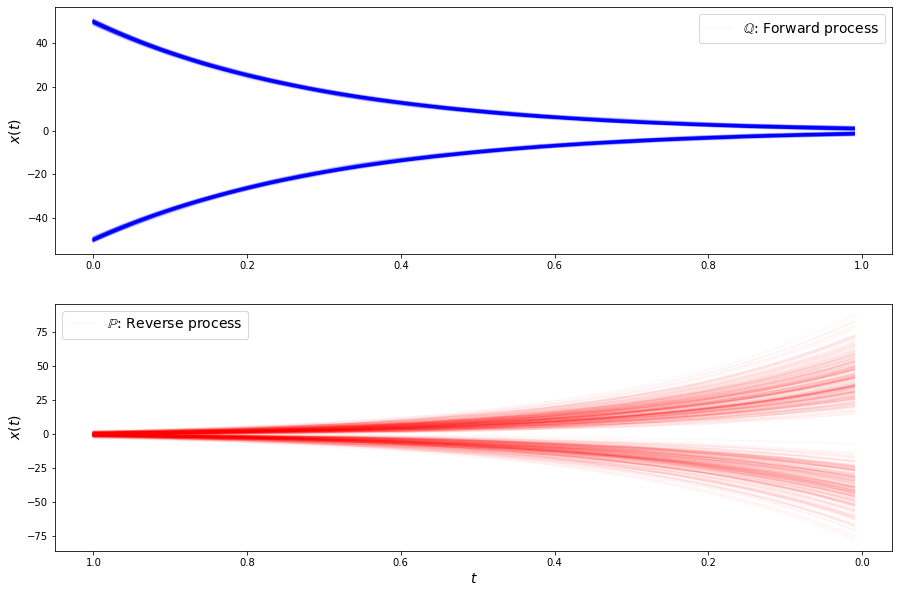

loss b 0.9098995327949524
loss b 0.911117434501648
loss b 0.9795129895210266
loss b 0.9963739514350891
loss b 0.9860137104988098
loss b 0.9107978940010071
loss b 0.9606131315231323
loss b 0.9696833491325378
loss b 0.8335041999816895
loss b 0.9487494826316833
loss b 0.8889381289482117
loss b 0.8716561198234558
loss b 0.9446589946746826
loss b 0.9050636291503906
loss b 0.8649113774299622
loss b 0.9946198463439941
loss b 0.9107047319412231
loss b 0.9207562208175659
loss b 0.9479771256446838
loss b 0.9777658581733704
loss b 0.9435321688652039
loss b 0.9051800966262817
loss f 3.7938623428344727
loss f 3.8076224327087402
loss f 3.809579849243164
loss f 3.7883002758026123
loss f 3.7561240196228027
loss f 3.8089826107025146
loss f 3.7678356170654297
loss f 3.816077470779419
loss f 3.8105826377868652
loss f 3.7880353927612305
loss f 3.784010887145996
loss f 3.779292345046997
loss f 3.764514923095703
loss f 3.765446901321411
loss f 3.7689051628112793
loss f 3.7989723682403564
loss f 3.7512104511

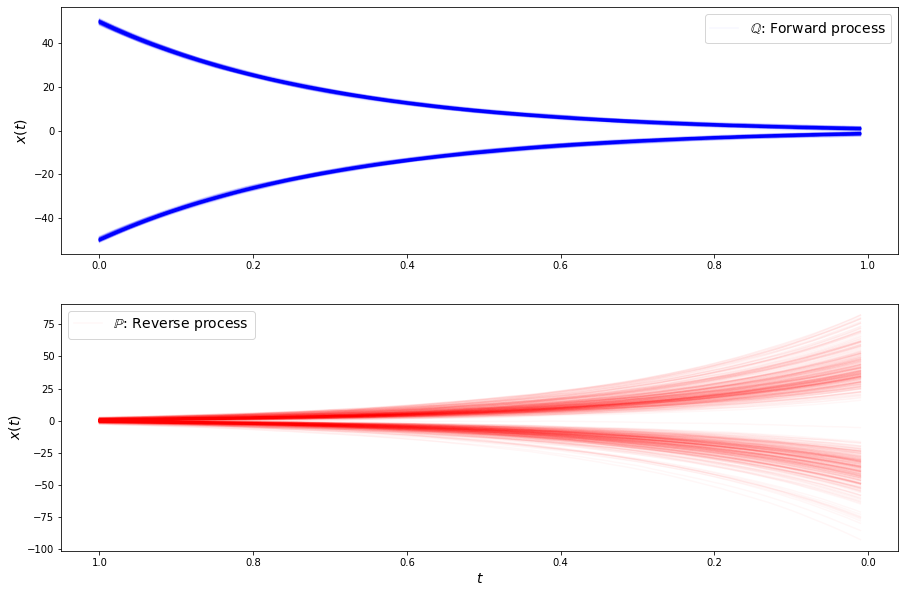

loss b 0.9206770062446594
loss b 0.8272989988327026
loss b 0.9471539855003357
loss b 0.8013327121734619
loss b 0.952052116394043
loss b 0.9132961630821228
loss b 0.9433386325836182
loss b 0.8946601152420044
loss b 0.8308793902397156
loss b 0.8819237351417542
loss b 0.9183921217918396
loss b 0.8365588188171387
loss b 0.892075777053833
loss b 0.9574219584465027
loss b 0.8487633466720581
loss b 0.8270696401596069
loss b 0.9536716341972351
loss b 1.011187195777893
loss b 0.798122763633728
loss b 0.7983179092407227
loss b 0.8874351978302002
loss b 0.8987829089164734
loss f 3.7523305416107178
loss f 3.7643890380859375
loss f 3.7327194213867188
loss f 3.7544729709625244
loss f 3.770857095718384
loss f 3.795492172241211
loss f 3.761467933654785
loss f 3.7503087520599365
loss f 3.8069567680358887
loss f 3.7673871517181396
loss f 3.789321184158325
loss f 3.770587205886841
loss f 3.7718265056610107
loss f 3.753037929534912
loss f 3.7765207290649414
loss f 3.75459885597229
loss f 3.770981550216675

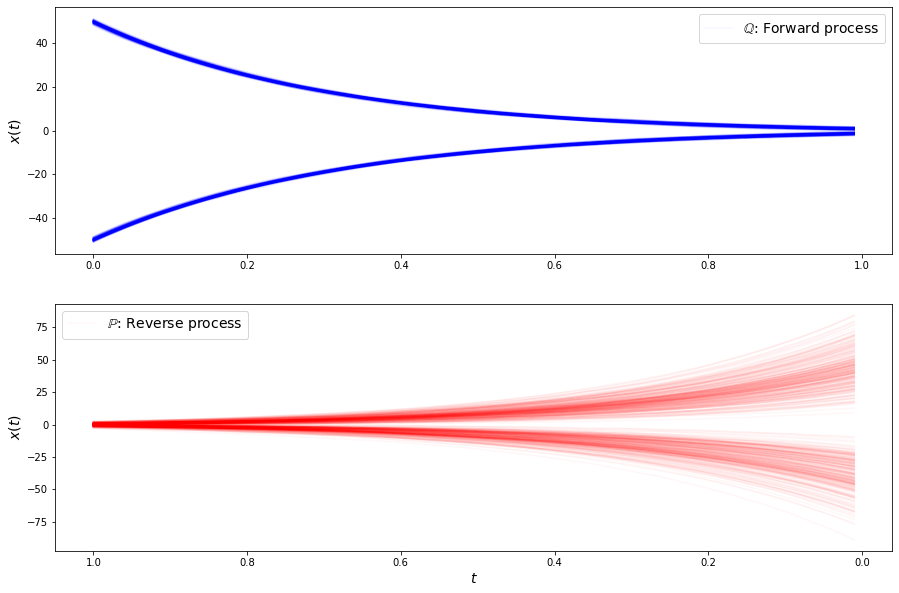

loss b 0.905684769153595
loss b 0.8758297562599182
loss b 0.889248251914978
loss b 0.9114532470703125
loss b 0.9369031190872192
loss b 0.8426541686058044
loss b 0.9205032587051392
loss b 0.9186393022537231
loss b 0.8467068076133728
loss b 0.8399131298065186
loss b 0.906490683555603
loss b 0.8916223645210266
loss b 0.8224237561225891
loss b 0.8374686241149902
loss b 0.8604780435562134
loss b 0.9516231417655945
loss b 0.7935354709625244
loss b 0.872084379196167
loss b 0.9164131283760071
loss b 0.9493755102157593
loss b 0.871568500995636
loss b 0.8637133836746216
loss f 3.7221121788024902
loss f 3.769711494445801
loss f 3.7699384689331055
loss f 3.747612476348877
loss f 3.742870569229126
loss f 3.695826768875122
loss f 3.7608859539031982
loss f 3.741041660308838
loss f 3.7241692543029785
loss f 3.7388224601745605
loss f 3.7690250873565674
loss f 3.747546434402466
loss f 3.7197933197021484
loss f 3.706108570098877
loss f 3.770390510559082
loss f 3.7563230991363525
loss f 3.704406499862671


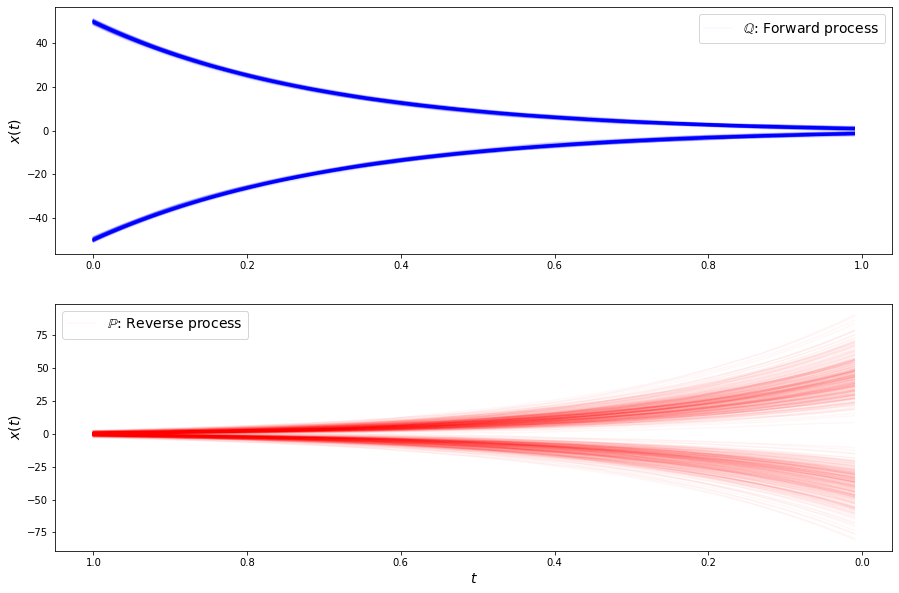

loss b 0.8297401070594788
loss b 0.7938888669013977
loss b 0.8867411613464355
loss b 0.8756089806556702
loss b 0.8865785598754883
loss b 0.9765955209732056
loss b 0.9993866682052612
loss b 0.9120487570762634
loss b 0.8404430150985718
loss b 0.8653446435928345
loss b 0.9734563827514648
loss b 0.8553605079650879
loss b 0.8725176453590393
loss b 0.8434985280036926
loss b 0.8406962752342224
loss b 0.9165802597999573
loss b 0.9185885787010193
loss b 0.8541726469993591
loss b 0.8507986068725586
loss b 0.8233873248100281
loss b 0.8617075085639954
loss b 0.8522631525993347
loss f 3.801203489303589
loss f 3.6911144256591797
loss f 3.707566976547241
loss f 3.7100412845611572
loss f 3.7290234565734863
loss f 3.7329671382904053
loss f 3.7322304248809814
loss f 3.7312119007110596
loss f 3.7702016830444336
loss f 3.780439615249634
loss f 3.717957019805908
loss f 3.7561228275299072
loss f 3.7160120010375977
loss f 3.729560613632202
loss f 3.7152466773986816
loss f 3.7804319858551025
loss f 3.72338151

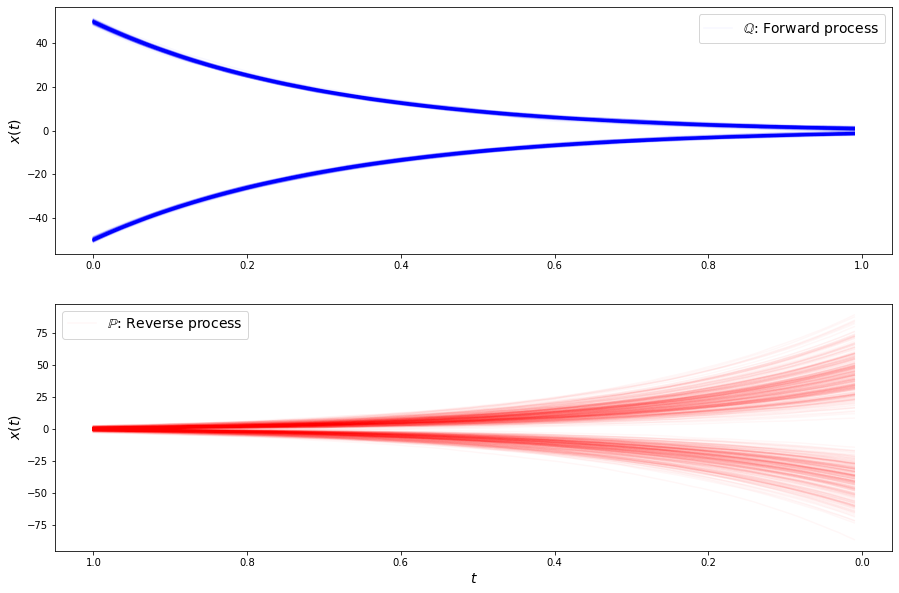

loss b 0.8510956764221191
loss b 0.8702306151390076
loss b 0.9528257250785828
loss b 0.912401020526886
loss b 0.8878187537193298
loss b 0.8465065360069275
loss b 0.8386562466621399
loss b 0.8931881189346313
loss b 0.8214557766914368
loss b 0.7185626029968262
loss b 0.844609797000885
loss b 0.8697148561477661
loss b 0.8878971934318542
loss b 0.8638748526573181
loss b 0.8252073526382446
loss b 0.8127909898757935
loss b 0.8811231851577759
loss b 0.8445563912391663
loss b 0.8125583529472351
loss b 0.8500466346740723
loss b 0.8169218897819519
loss b 0.8392364978790283
loss f 3.7407119274139404
loss f 3.7459638118743896
loss f 3.7307546138763428
loss f 3.7670083045959473
loss f 3.685731887817383
loss f 3.7279610633850098
loss f 3.7408039569854736
loss f 3.701366424560547
loss f 3.7017481327056885
loss f 3.733346462249756
loss f 3.7185304164886475
loss f 3.69728684425354
loss f 3.749248743057251
loss f 3.7210214138031006
loss f 3.7241427898406982
loss f 3.76543927192688
loss f 3.7397155761718

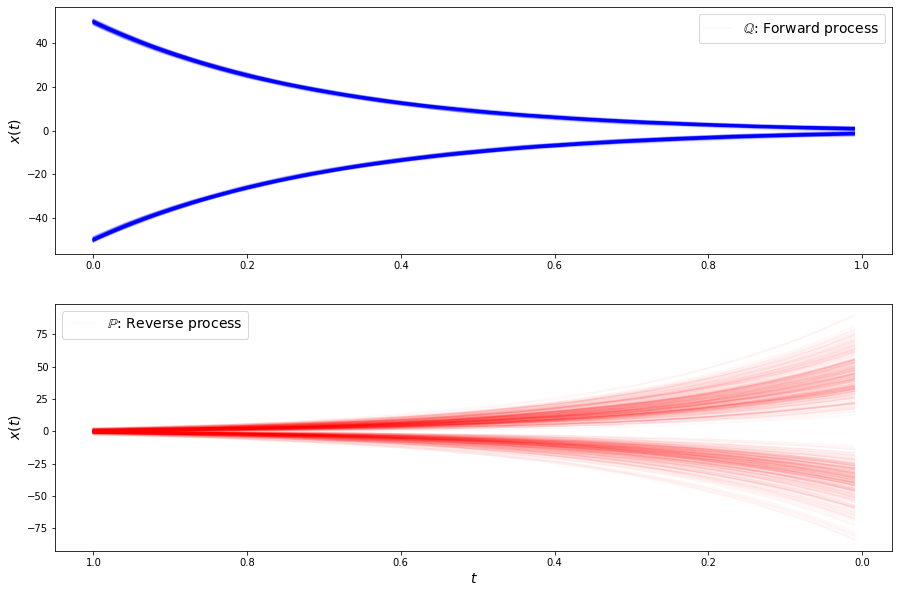

loss b 0.832014799118042
loss b 0.8054068684577942
loss b 0.8280863761901855
loss b 0.7659168839454651
loss b 0.8643737435340881
loss b 0.8432912230491638
loss b 0.9331151247024536
loss b 0.8946422934532166
loss b 0.8510229587554932
loss b 0.7615640163421631
loss b 0.8589839935302734
loss b 0.7545725107192993
loss b 0.8529085516929626
loss b 0.8641024827957153
loss b 0.8602085113525391
loss b 0.862659752368927
loss b 0.8945145606994629
loss b 0.8961801528930664
loss b 0.8699794411659241
loss b 0.8521453142166138
loss b 0.7939320206642151
loss b 0.8792222738265991
loss f 3.739633083343506
loss f 3.711012840270996
loss f 3.7359724044799805
loss f 3.713092088699341
loss f 3.716351270675659
loss f 3.768085241317749
loss f 3.7278404235839844
loss f 3.709484338760376
loss f 3.7273426055908203
loss f 3.702178478240967
loss f 3.7065069675445557
loss f 3.681168556213379
loss f 3.713275671005249
loss f 3.710270404815674
loss f 3.663759469985962
loss f 3.672642469406128
loss f 3.696962833404541
l

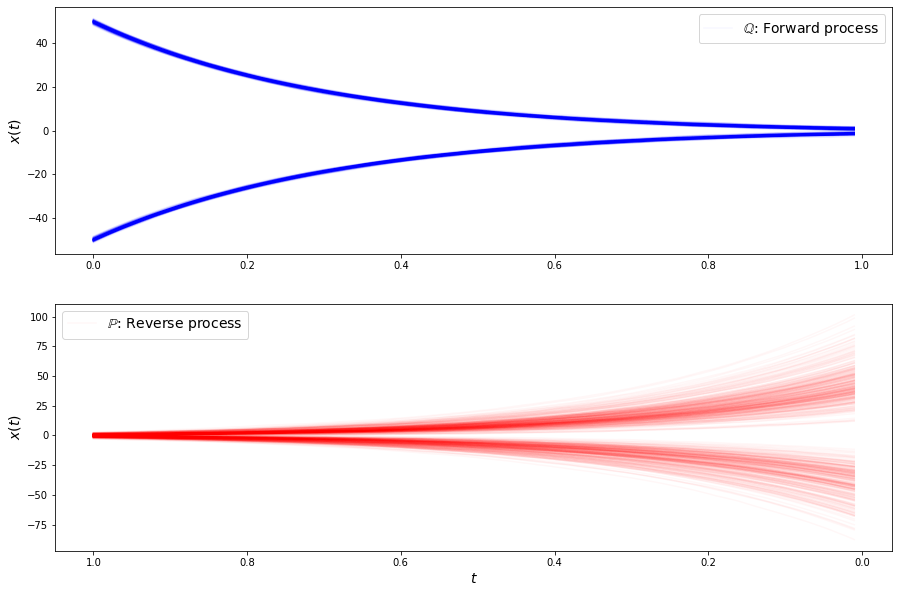

loss b 0.8054323792457581
loss b 0.7768551111221313
loss b 0.8657503724098206
loss b 0.8150055408477783
loss b 0.8410214781761169
loss b 0.8197603821754456
loss b 0.8317404389381409
loss b 0.9163165092468262
loss b 0.8480129837989807
loss b 0.8117709755897522
loss b 0.8002001047134399
loss b 0.8577388525009155
loss b 0.7882999777793884
loss b 0.86885666847229
loss b 0.7818931341171265
loss b 0.8858729600906372
loss b 0.798895001411438
loss b 0.8942974805831909
loss b 0.7769849300384521
loss b 0.8452739119529724
loss b 0.7891620993614197
loss b 0.8892776370048523
loss f 3.7182204723358154
loss f 3.709800958633423
loss f 3.723936080932617
loss f 3.703094244003296
loss f 3.6696112155914307
loss f 3.6643896102905273
loss f 3.6848485469818115
loss f 3.7136380672454834
loss f 3.6848011016845703
loss f 3.6671576499938965
loss f 3.706563949584961
loss f 3.696483612060547
loss f 3.668539047241211
loss f 3.724778413772583
loss f 3.702003002166748
loss f 3.702388286590576
loss f 3.677903413772583

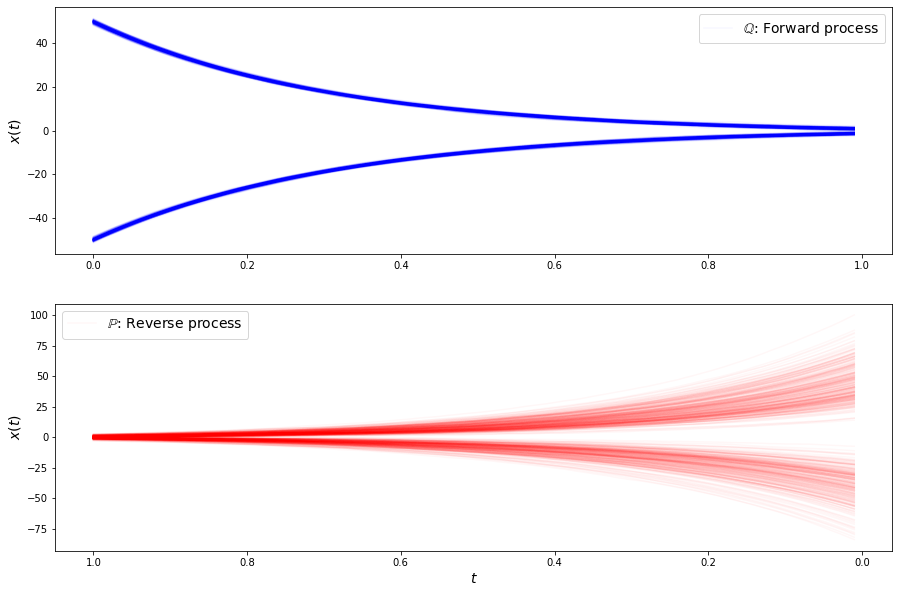

loss b 0.919964075088501
loss b 0.854100227355957
loss b 0.8478816747665405
loss b 0.8417148590087891
loss b 0.8443299531936646
loss b 0.8580717444419861
loss b 0.8591052889823914
loss b 0.8137186169624329
loss b 0.801308274269104
loss b 0.8423917293548584
loss b 0.8773614764213562
loss b 0.8130077719688416
loss b 0.8076736330986023
loss b 0.8653027415275574
loss b 0.7985203266143799
loss b 0.8639957308769226
loss b 0.7930939793586731
loss b 0.8622667789459229
loss b 0.7730609774589539
loss b 0.8051727414131165
loss b 0.7632648944854736
loss b 0.7872787117958069
loss f 3.695671558380127
loss f 3.6966283321380615
loss f 3.6808667182922363
loss f 3.685939073562622
loss f 3.6681034564971924
loss f 3.7408297061920166
loss f 3.7132699489593506
loss f 3.6497490406036377
loss f 3.6858935356140137
loss f 3.694305658340454
loss f 3.7115345001220703
loss f 3.649632453918457
loss f 3.666708469390869
loss f 3.7051312923431396
loss f 3.698301315307617
loss f 3.723254442214966
loss f 3.7154815196990

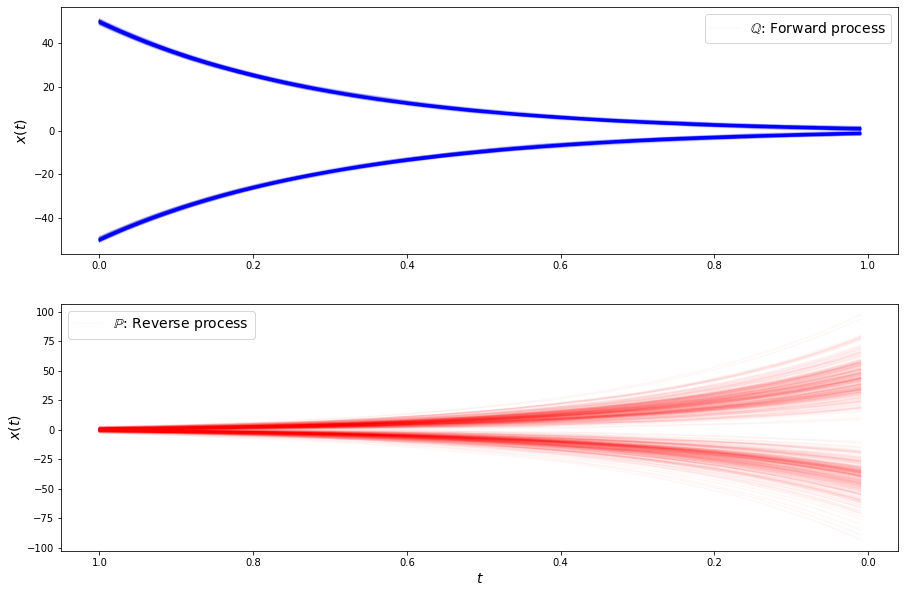

loss b 0.8350334167480469
loss b 0.829071581363678
loss b 0.8261812329292297
loss b 0.8094449043273926
loss b 0.8232333660125732
loss b 0.8375668525695801
loss b 0.8520541787147522
loss b 0.8868336081504822
loss b 0.908839762210846
loss b 0.8083101511001587
loss b 0.8320006132125854
loss b 0.8321842551231384
loss b 0.9074851870536804
loss b 0.8162187933921814
loss b 0.8111177682876587
loss b 0.7827378511428833
loss b 0.8245729207992554
loss b 0.7688827514648438
loss b 0.8198307752609253
loss b 0.8055974841117859
loss b 0.8599764108657837
loss b 0.7786866426467896
loss f 3.6219615936279297
loss f 3.6699557304382324
loss f 3.696610450744629
loss f 3.705203056335449
loss f 3.6900084018707275
loss f 3.6657378673553467
loss f 3.6696126461029053
loss f 3.693855047225952
loss f 3.662254571914673
loss f 3.6491892337799072
loss f 3.6603899002075195
loss f 3.722944974899292
loss f 3.6989541053771973
loss f 3.675405979156494
loss f 3.658963441848755
loss f 3.6586673259735107
loss f 3.693243503570

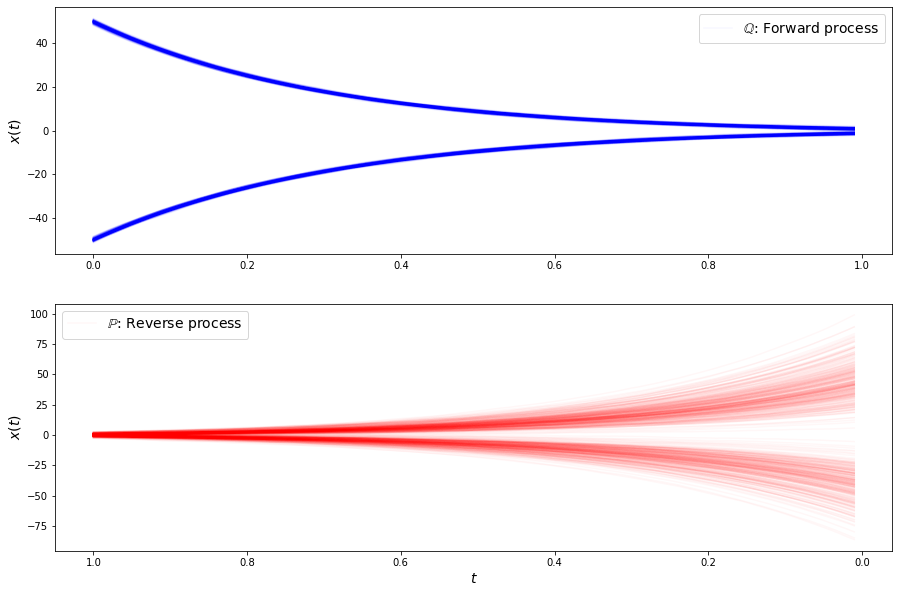

loss b 0.8396041393280029
loss b 0.8744681477546692
loss b 0.7563375234603882
loss b 0.7566266655921936
loss b 0.8159403800964355
loss b 0.8284556269645691
loss b 0.849509596824646
loss b 0.8559951782226562
loss b 0.8439281582832336
loss b 0.7869860529899597
loss b 0.7403116226196289
loss b 0.7866692543029785
loss b 0.7400588989257812
loss b 0.8039237856864929
loss b 0.6846041679382324
loss b 0.7244547605514526
loss b 0.7833060026168823
loss b 0.8209995031356812
loss b 0.8081026077270508
loss b 0.8077108263969421
loss b 0.8155221939086914
loss b 0.8332333564758301
loss f 3.6875197887420654
loss f 3.675823926925659
loss f 3.6663215160369873
loss f 3.663832902908325
loss f 3.679931163787842
loss f 3.6519925594329834
loss f 3.640620470046997
loss f 3.6669716835021973
loss f 3.727407455444336
loss f 3.6601555347442627
loss f 3.7197508811950684
loss f 3.6542038917541504
loss f 3.6522672176361084
loss f 3.6342806816101074
loss f 3.6376235485076904
loss f 3.663861036300659
loss f 3.6229963302

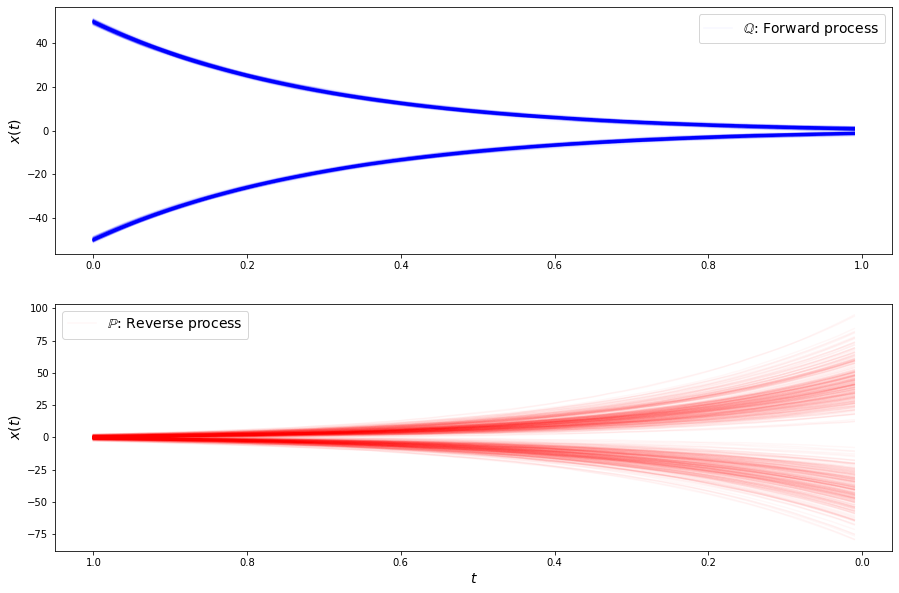

loss b 0.8062509298324585
loss b 0.7503923773765564
loss b 0.83977872133255
loss b 0.7685304880142212
loss b 0.7991335988044739
loss b 0.8352532386779785
loss b 0.8108226656913757
loss b 0.8300524950027466
loss b 0.7565563917160034
loss b 0.7942050099372864
loss b 0.8404508829116821
loss b 0.8074193596839905
loss b 0.7575392723083496
loss b 0.8501744866371155
loss b 0.7748127579689026
loss b 0.7544286251068115
loss b 0.7499499917030334
loss b 0.7692309021949768
loss b 0.8803455233573914
loss b 0.7731224894523621
loss b 0.7966020107269287
loss b 0.7449705004692078
loss f 3.650721311569214
loss f 3.673034906387329
loss f 3.696410894393921
loss f 3.6275219917297363
loss f 3.678356885910034
loss f 3.661720037460327
loss f 3.647327184677124
loss f 3.6668808460235596
loss f 3.663780927658081
loss f 3.6813230514526367
loss f 3.64186692237854
loss f 3.637957811355591
loss f 3.657541513442993
loss f 3.6666605472564697
loss f 3.658573865890503
loss f 3.667187452316284
loss f 3.6733195781707764
l

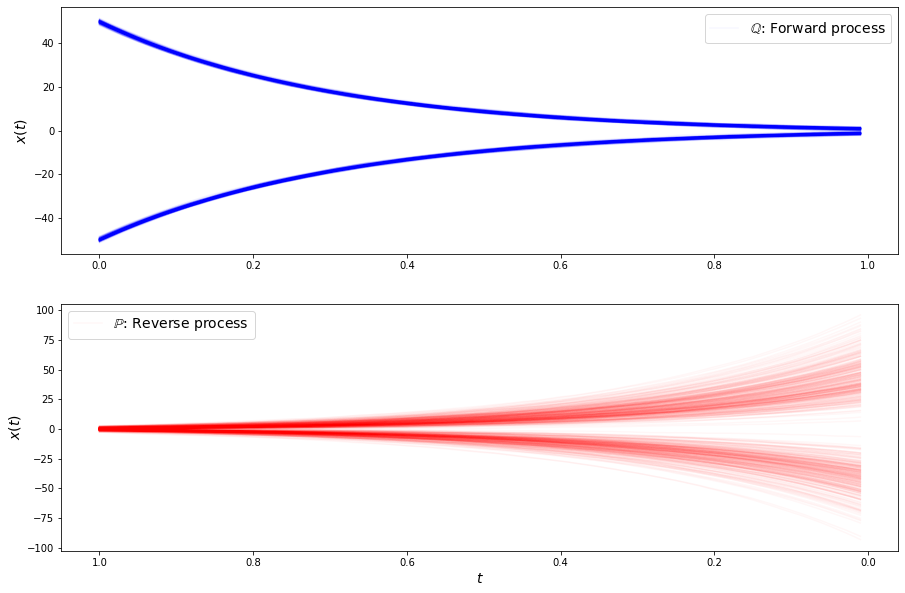

loss b 0.9094150066375732
loss b 0.7691928744316101
loss b 0.8834682106971741
loss b 0.8197794556617737
loss b 0.7850319147109985
loss b 0.8165443539619446
loss b 0.8224363923072815
loss b 0.7663589715957642
loss b 0.8641675114631653
loss b 0.887735903263092
loss b 0.7852593064308167
loss b 0.7552266716957092
loss b 0.8688533306121826
loss b 0.8952438831329346
loss b 0.955040693283081
loss b 0.9369350075721741
loss b 0.8534850478172302
loss b 0.821503758430481
loss b 0.8250579237937927
loss b 0.8028273582458496
loss b 0.9157893657684326
loss b 0.8709926605224609
loss f 3.679884433746338
loss f 3.6685125827789307
loss f 3.631425619125366
loss f 3.648073434829712
loss f 3.6797778606414795
loss f 3.679115056991577
loss f 3.6498911380767822
loss f 3.6416385173797607
loss f 3.6615569591522217
loss f 3.700711727142334
loss f 3.6432323455810547
loss f 3.651540994644165
loss f 3.686572551727295
loss f 3.674154043197632
loss f 3.6703855991363525
loss f 3.6504688262939453
loss f 3.65605330467224

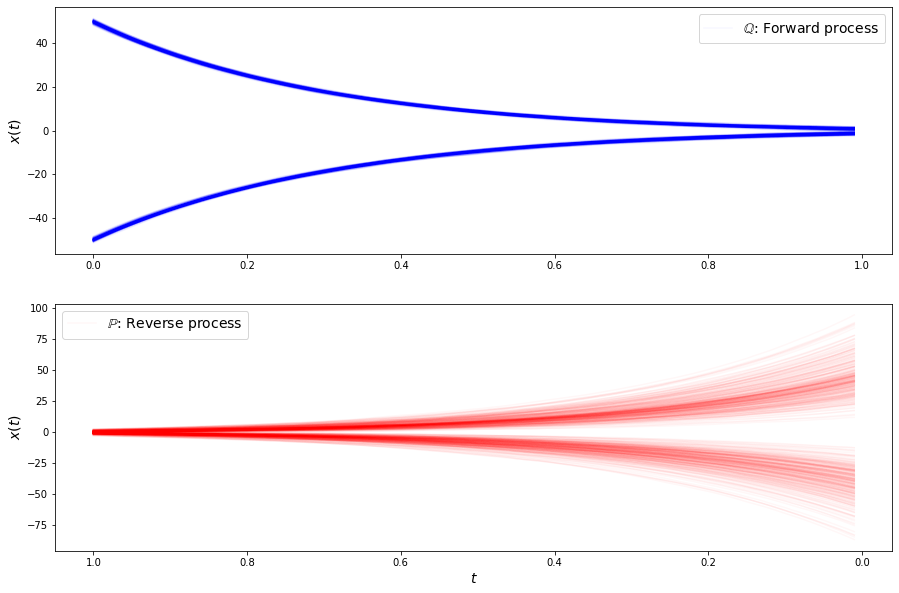

loss b 0.8585075736045837
loss b 0.8494032025337219
loss b 0.8360394239425659
loss b 0.8070055246353149
loss b 0.7987114787101746
loss b 0.7516222596168518
loss b 0.8022086024284363
loss b 0.7089244723320007
loss b 0.8284571766853333
loss b 0.798570454120636
loss b 0.9047136306762695
loss b 0.7899976372718811
loss b 0.7933529019355774
loss b 0.8318301439285278
loss b 0.8015462160110474
loss b 0.7526729106903076
loss b 0.8335060477256775
loss b 0.7890169024467468
loss b 0.7488194704055786
loss b 0.8349639773368835
loss b 0.7716529369354248
loss b 0.8686705231666565
loss f 3.6678872108459473
loss f 3.6380972862243652
loss f 3.6701197624206543
loss f 3.6602730751037598
loss f 3.6513094902038574
loss f 3.6664819717407227
loss f 3.634955406188965
loss f 3.6502575874328613
loss f 3.6425015926361084
loss f 3.659424066543579
loss f 3.615030527114868
loss f 3.6404221057891846
loss f 3.641115427017212
loss f 3.6283209323883057
loss f 3.6373250484466553
loss f 3.6683614253997803
loss f 3.64424753

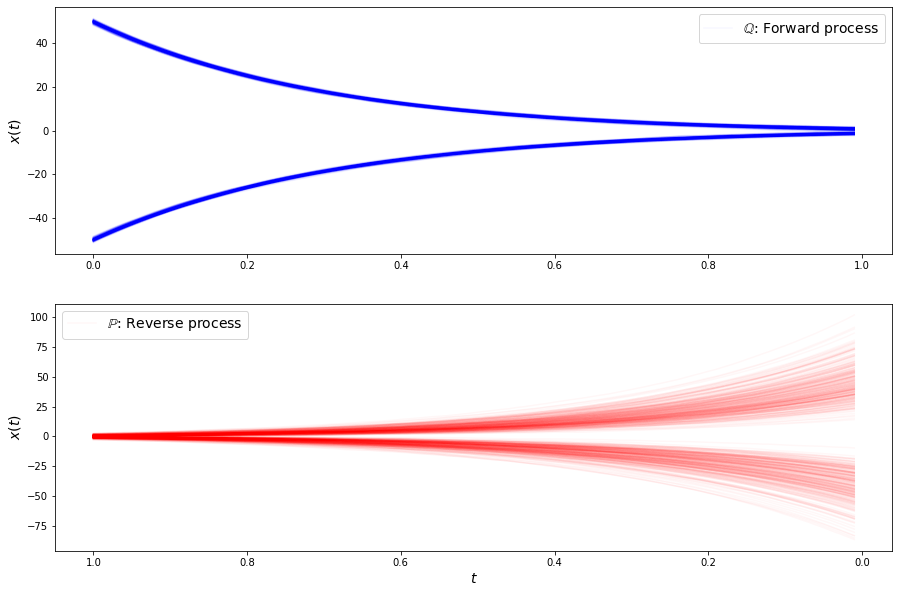

loss b 0.7661536335945129
loss b 0.9314383268356323
loss b 0.7837326526641846
loss b 0.7984042167663574
loss b 0.8350367546081543
loss b 0.9136106371879578
loss b 0.7373993992805481
loss b 0.8273820877075195
loss b 0.7369211316108704
loss b 0.9090137481689453
loss b 0.7940203547477722
loss b 0.8539835214614868
loss b 0.7929189205169678
loss b 0.8205896019935608
loss b 0.8618471026420593
loss b 0.7477548122406006
loss b 0.8175990581512451
loss b 0.7892356514930725
loss b 0.7828632593154907
loss b 0.7299904227256775
loss b 0.8408682346343994
loss b 0.7426078915596008
loss f 3.6404285430908203
loss f 3.6357266902923584
loss f 3.691666603088379
loss f 3.6422359943389893
loss f 3.6546530723571777
loss f 3.6317410469055176
loss f 3.6506197452545166
loss f 3.6707189083099365
loss f 3.6154873371124268
loss f 3.6394739151000977
loss f 3.6171884536743164
loss f 3.601428985595703
loss f 3.6549184322357178
loss f 3.619100332260132
loss f 3.662532091140747
loss f 3.6298394203186035
loss f 3.6393442

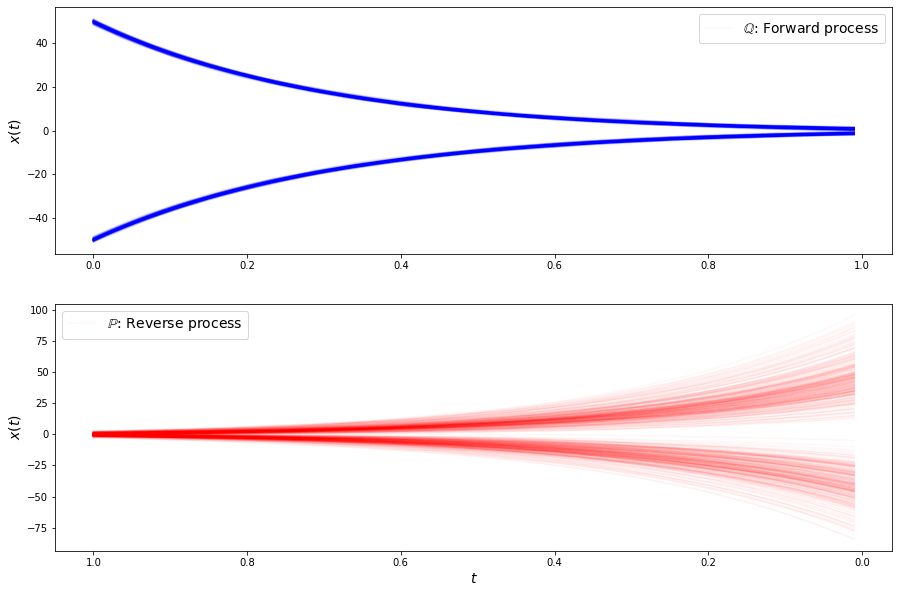

loss b 0.7632418870925903
loss b 0.8612285256385803
loss b 0.7776565551757812
loss b 0.7693547606468201
loss b 0.8351962566375732
loss b 0.8243595361709595
loss b 0.8559439182281494
loss b 0.7784961462020874
loss b 0.7852109670639038
loss b 0.7831241488456726
loss b 0.7801055908203125
loss b 0.8117021322250366
loss b 0.7762943506240845
loss b 0.8429080247879028
loss b 0.8145645260810852
loss b 0.7852532863616943
loss b 0.8059148192405701
loss b 0.7855244278907776
loss b 0.8555431365966797
loss b 0.8047417402267456
loss b 0.7464774250984192
loss b 0.7354739308357239
loss f 3.6266274452209473
loss f 3.607823610305786
loss f 3.6091649532318115
loss f 3.6189260482788086
loss f 3.6161012649536133
loss f 3.650602340698242
loss f 3.613219738006592
loss f 3.643125534057617
loss f 3.600672960281372
loss f 3.6082088947296143
loss f 3.587268590927124
loss f 3.646637439727783
loss f 3.5968503952026367
loss f 3.606436252593994
loss f 3.630645990371704
loss f 3.628185749053955
loss f 3.6156027317047

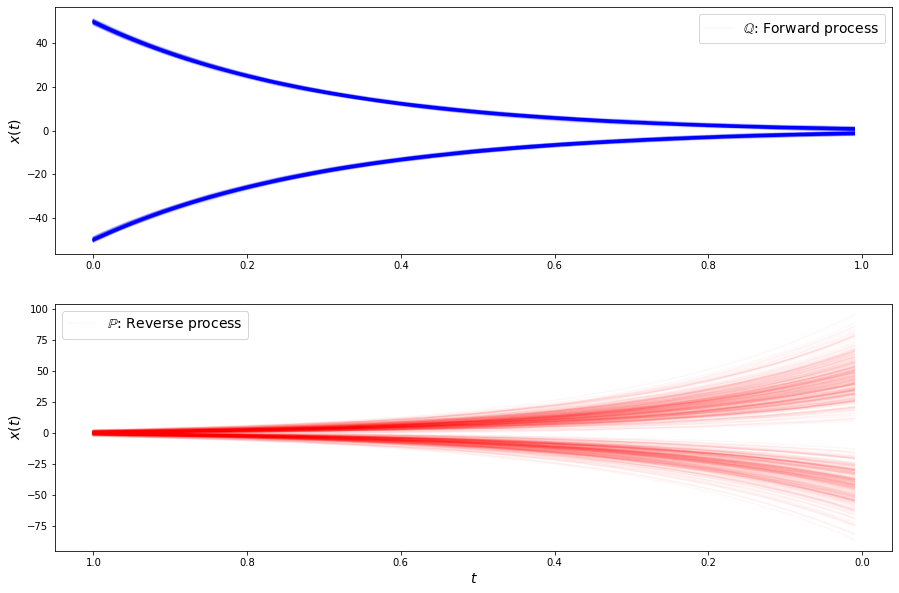

loss b 0.8671700358390808
loss b 0.8225907683372498
loss b 0.745703399181366
loss b 0.7769988179206848
loss b 0.7264379858970642
loss b 0.7732986807823181
loss b 0.6975514888763428
loss b 0.6968797445297241
loss b 0.7422018647193909
loss b 0.7365113496780396
loss b 0.7993934750556946
loss b 0.8186711072921753
loss b 0.8239870667457581
loss b 0.7377375960350037
loss b 0.8995533585548401
loss b 0.7403273582458496
loss b 0.7841702699661255
loss b 0.701890766620636
loss b 0.8016952276229858
loss b 0.7667202353477478
loss b 0.796565055847168
loss b 0.7844811081886292
loss f 3.6166279315948486
loss f 3.6032443046569824
loss f 3.628635883331299
loss f 3.623061180114746
loss f 3.6412808895111084
loss f 3.5864005088806152
loss f 3.5954415798187256
loss f 3.620542049407959
loss f 3.5991458892822266
loss f 3.5964832305908203
loss f 3.6129329204559326
loss f 3.5891871452331543
loss f 3.619797945022583
loss f 3.6055469512939453
loss f 3.6281509399414062
loss f 3.602368116378784
loss f 3.59055447578

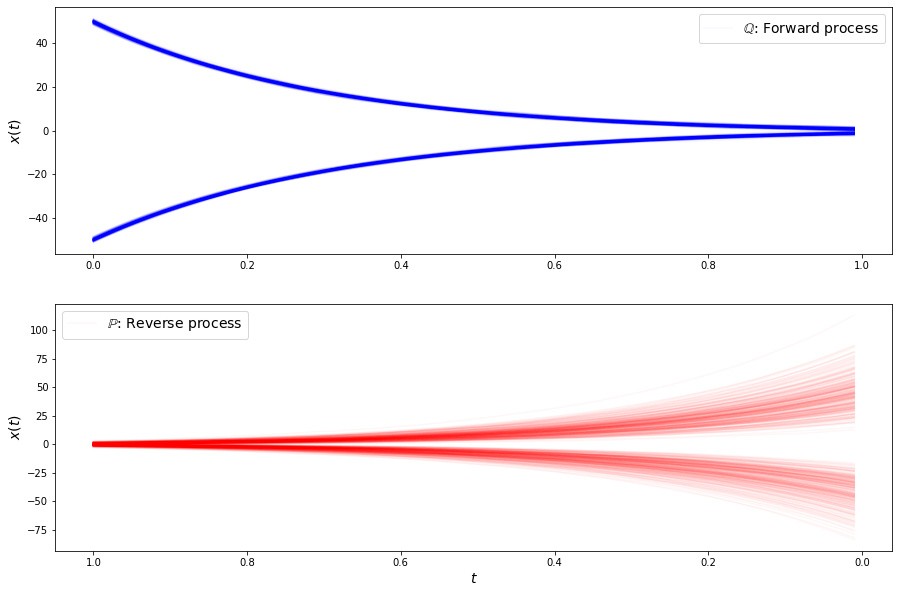

loss b 0.8496346473693848
loss b 0.7684548497200012
loss b 0.7618080973625183
loss b 0.7609524726867676
loss b 0.7585260272026062
loss b 0.7661606073379517
loss b 0.7472550272941589
loss b 0.7715013027191162
loss b 0.7238245010375977
loss b 0.748886227607727
loss b 0.8002691268920898
loss b 0.753346860408783
loss b 0.754387617111206
loss b 0.7990562319755554
loss b 0.7749000191688538
loss b 0.7482790350914001
loss b 0.7810013890266418
loss b 0.7748412489891052
loss b 0.7234665155410767
loss b 0.687424898147583
loss b 0.7648738622665405
loss b 0.7560874223709106
loss f 3.6103034019470215
loss f 3.6096508502960205
loss f 3.653830051422119
loss f 3.6187474727630615
loss f 3.5891826152801514
loss f 3.5896854400634766
loss f 3.615443229675293
loss f 3.626938581466675
loss f 3.584528923034668
loss f 3.6060450077056885
loss f 3.6238341331481934
loss f 3.6083950996398926
loss f 3.568145513534546
loss f 3.6159884929656982
loss f 3.616767406463623
loss f 3.6088714599609375
loss f 3.6160356998443

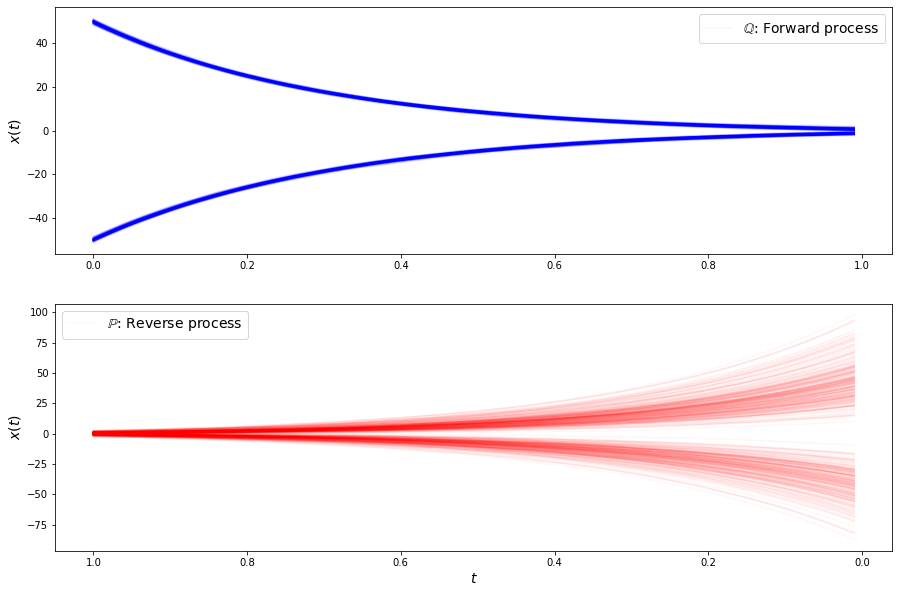

loss b 0.7587029933929443
loss b 0.723972737789154
loss b 0.7435978651046753
loss b 0.7448343634605408
loss b 0.8219049572944641
loss b 0.8014881014823914
loss b 0.8620888590812683
loss b 0.6228731870651245
loss b 0.7376239895820618
loss b 0.728823721408844
loss b 0.811690628528595
loss b 0.7950157523155212
loss b 0.7997981309890747
loss b 0.7377111911773682
loss b 0.7830376625061035
loss b 0.7641760110855103
loss b 0.7653506994247437
loss b 0.7224106192588806
loss b 0.7400081157684326
loss b 0.7607966661453247
loss b 0.7754276990890503
loss b 0.8223481178283691
loss f 3.590118885040283
loss f 3.587810516357422
loss f 3.6096513271331787
loss f 3.6540045738220215
loss f 3.5863611698150635
loss f 3.603362560272217
loss f 3.5767602920532227
loss f 3.6047990322113037
loss f 3.5991690158843994
loss f 3.585684061050415
loss f 3.6369788646698
loss f 3.5920095443725586
loss f 3.559922933578491
loss f 3.5960628986358643
loss f 3.6015448570251465
loss f 3.602177143096924
loss f 3.550647497177124

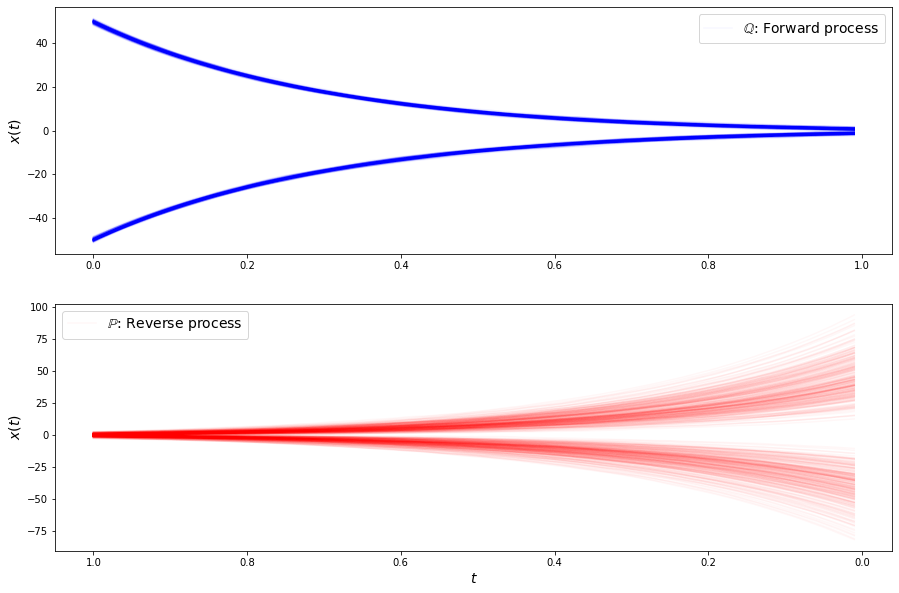

loss b 0.8129701018333435
loss b 0.7541232705116272
loss b 0.7513571381568909
loss b 0.6615751385688782
loss b 0.7054612040519714
loss b 0.8019359707832336
loss b 0.7318199276924133
loss b 0.7140901684761047
loss b 0.7892027497291565
loss b 0.7107676267623901
loss b 0.7671993970870972
loss b 0.767676055431366
loss b 0.7241284251213074
loss b 0.8076322674751282
loss b 0.8020248413085938
loss b 0.7485489249229431
loss b 0.7633407115936279
loss b 0.6892451643943787
loss b 0.7451356053352356
loss b 0.8049822449684143
loss b 0.7076253294944763
loss b 0.8409799933433533
loss f 3.5862131118774414
loss f 3.5837693214416504
loss f 3.6066555976867676
loss f 3.5822699069976807
loss f 3.6020748615264893
loss f 3.5681259632110596
loss f 3.6022698879241943
loss f 3.55184006690979
loss f 3.5836384296417236
loss f 3.5704336166381836
loss f 3.612534523010254
loss f 3.575888156890869
loss f 3.5799338817596436
loss f 3.5840046405792236
loss f 3.5739805698394775
loss f 3.569610595703125
loss f 3.586282491

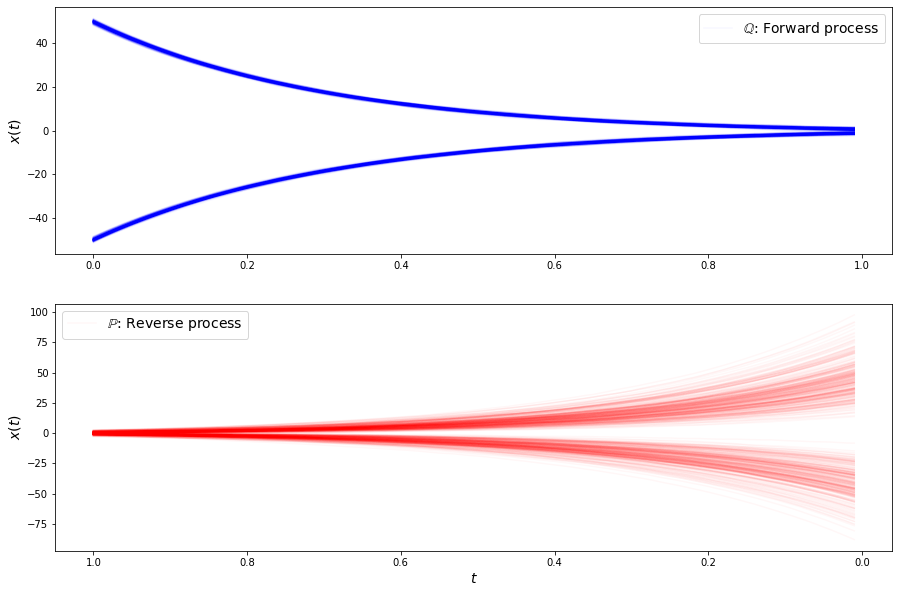

loss b 0.7280279994010925
loss b 0.8244609832763672
loss b 0.8745360374450684
loss b 0.7435521483421326
loss b 0.7115398645401001
loss b 0.7045614719390869
loss b 0.7464803457260132
loss b 0.6962036490440369
loss b 0.6909145712852478
loss b 0.7233133912086487
loss b 0.8290911316871643
loss b 0.8152313828468323
loss b 0.7418558597564697
loss b 0.7312712669372559
loss b 0.7292413711547852
loss b 0.7735804319381714
loss b 0.7154896855354309
loss b 0.6776880025863647
loss b 0.7003761529922485
loss b 0.749592125415802
loss b 0.7071417570114136
loss b 0.6755205988883972
loss f 3.586430788040161
loss f 3.5642049312591553
loss f 3.555079936981201
loss f 3.5791165828704834
loss f 3.5494329929351807
loss f 3.5627872943878174
loss f 3.6118578910827637
loss f 3.5583455562591553
loss f 3.6052889823913574
loss f 3.602766990661621
loss f 3.5667030811309814
loss f 3.588043212890625
loss f 3.5616402626037598
loss f 3.5864152908325195
loss f 3.568742275238037
loss f 3.6162426471710205
loss f 3.574239492

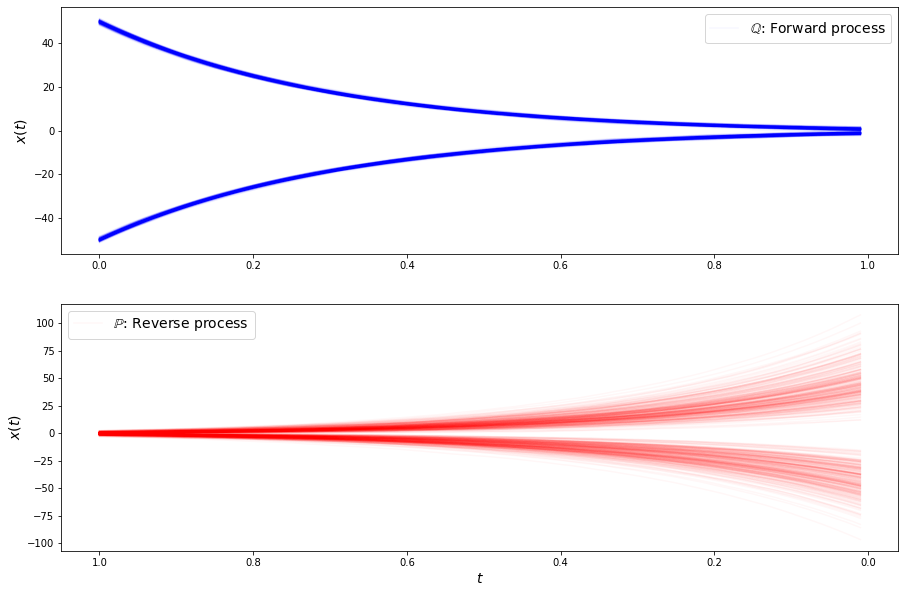

loss b 0.7577524185180664
loss b 0.7387290000915527
loss b 0.8061918616294861
loss b 0.7055686712265015
loss b 0.7647138833999634
loss b 0.6888685822486877
loss b 0.6958479881286621
loss b 0.8312984704971313
loss b 0.7716861367225647
loss b 0.677943229675293
loss b 0.6553783416748047
loss b 0.7786268591880798
loss b 0.7424241304397583
loss b 0.717269778251648
loss b 0.8165843486785889
loss b 0.6619702577590942
loss b 0.7172809839248657
loss b 0.7828015089035034
loss b 0.74847811460495
loss b 0.6922538876533508
loss b 0.8362990021705627
loss b 0.6741857528686523
loss f 3.539599895477295
loss f 3.5369720458984375
loss f 3.6127758026123047
loss f 3.579948902130127
loss f 3.577122449874878
loss f 3.54874849319458
loss f 3.5731794834136963
loss f 3.5722110271453857
loss f 3.566986560821533
loss f 3.5986950397491455
loss f 3.586944103240967
loss f 3.5632095336914062
loss f 3.6049680709838867
loss f 3.544546604156494
loss f 3.6025373935699463
loss f 3.564793348312378
loss f 3.5853464603424072

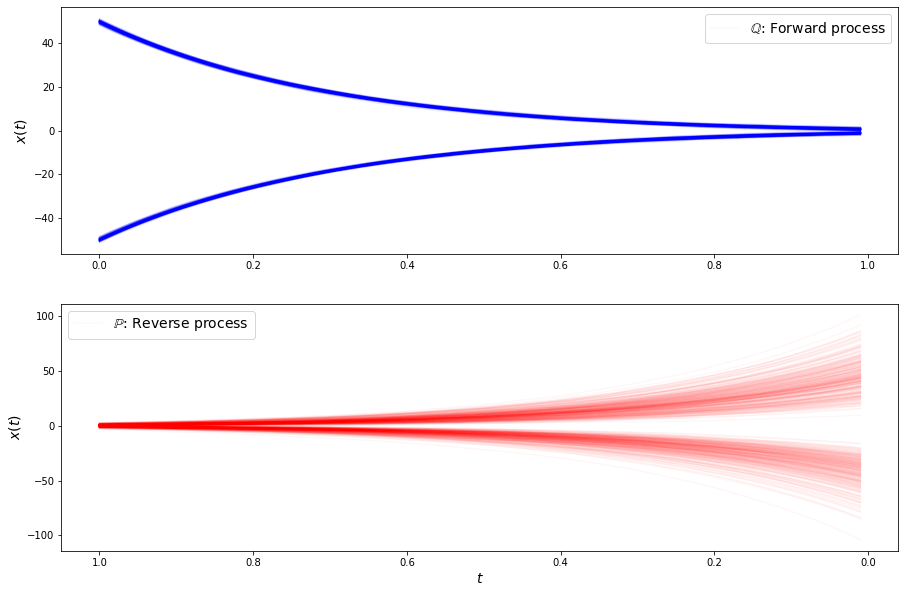

loss b 0.6563591361045837
loss b 0.7291371822357178
loss b 0.7286303043365479
loss b 0.7040444016456604
loss b 0.6861342787742615
loss b 0.7026476263999939
loss b 0.7198752164840698
loss b 0.6697766184806824
loss b 0.7773803472518921
loss b 0.78959059715271
loss b 0.7352347373962402
loss b 0.7645632028579712
loss b 0.7427334785461426
loss b 0.8206557631492615
loss b 0.6716834306716919
loss b 0.77640300989151
loss b 0.716307520866394
loss b 0.7098013758659363
loss b 0.7400144934654236
loss b 0.6588373780250549
loss b 0.7055475115776062
loss b 0.7277567386627197
loss f 3.5548384189605713
loss f 3.5805211067199707
loss f 3.575993061065674
loss f 3.547153949737549
loss f 3.54801344871521
loss f 3.583245038986206
loss f 3.574779987335205
loss f 3.589968204498291
loss f 3.5576465129852295
loss f 3.5728116035461426
loss f 3.564274311065674
loss f 3.558469295501709
loss f 3.5844168663024902
loss f 3.555907964706421
loss f 3.5597481727600098
loss f 3.557511568069458
loss f 3.5380496978759766
lo

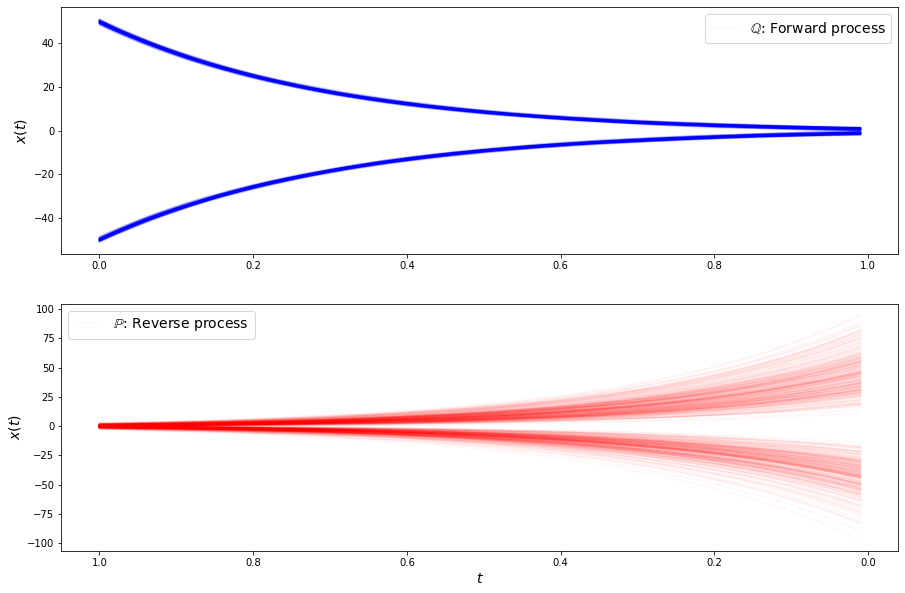

loss b 0.8140892386436462
loss b 0.7852541208267212
loss b 0.8343227505683899
loss b 0.744504988193512
loss b 0.6456699967384338
loss b 0.771061897277832
loss b 0.741708517074585
loss b 0.7495183944702148
loss b 0.7257227301597595
loss b 0.815183699131012
loss b 0.8352221846580505
loss b 0.7429594397544861
loss b 0.778897762298584
loss b 0.7290689945220947
loss b 0.7423403859138489
loss b 0.7177684307098389
loss b 0.7185304760932922
loss b 0.7144563794136047
loss b 0.7355778217315674
loss b 0.7654605507850647
loss b 0.7123866677284241
loss b 0.6740561723709106
loss f 3.5541203022003174
loss f 3.5460972785949707
loss f 3.5585269927978516
loss f 3.5439727306365967
loss f 3.5469746589660645
loss f 3.5539560317993164
loss f 3.5458855628967285
loss f 3.5579562187194824
loss f 3.5338408946990967
loss f 3.580496072769165
loss f 3.5794363021850586
loss f 3.559722423553467
loss f 3.5335445404052734
loss f 3.5272269248962402
loss f 3.5496444702148438
loss f 3.568708896636963
loss f 3.52657604217

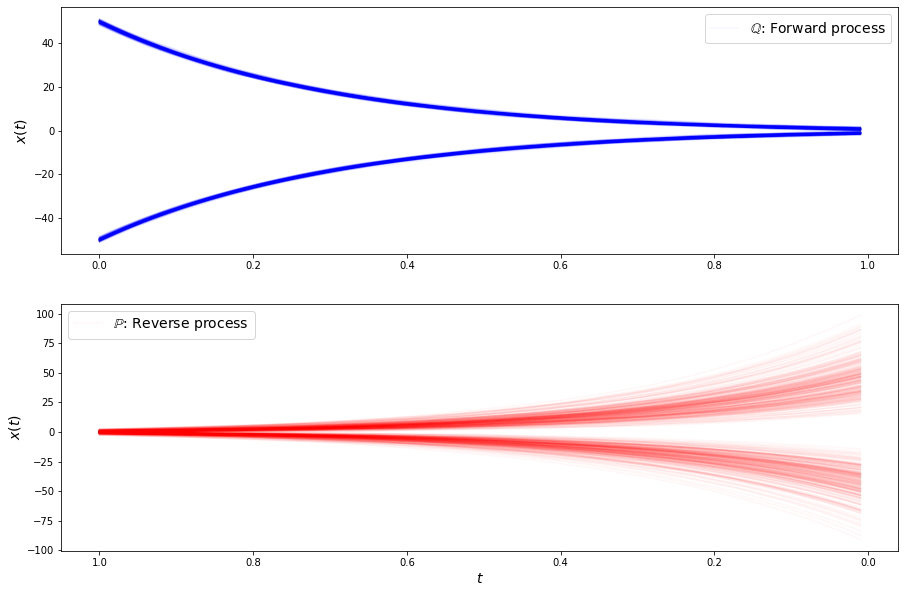

loss b 0.7709083557128906
loss b 0.8127754926681519
loss b 0.6204506158828735
loss b 0.7105101943016052
loss b 0.7266637682914734
loss b 0.7030157446861267
loss b 0.680217444896698
loss b 0.7349006533622742
loss b 0.7230095863342285
loss b 0.7510413527488708
loss b 0.7123745679855347
loss b 0.6770167350769043
loss b 0.748400866985321
loss b 0.7909799814224243
loss b 0.7272975444793701
loss b 0.7377957701683044
loss b 0.7252142429351807
loss b 0.7028360366821289
loss b 0.7184075117111206
loss b 0.7413431406021118
loss b 0.7600938677787781
loss b 0.7077645659446716
loss f 3.5699574947357178
loss f 3.5564393997192383
loss f 3.537973403930664
loss f 3.5665035247802734
loss f 3.5504229068756104
loss f 3.566190719604492
loss f 3.5638020038604736
loss f 3.5587260723114014
loss f 3.549581289291382
loss f 3.554628610610962
loss f 3.5503640174865723
loss f 3.5659992694854736
loss f 3.5339388847351074
loss f 3.5635108947753906
loss f 3.542365550994873
loss f 3.5648398399353027
loss f 3.5425770282

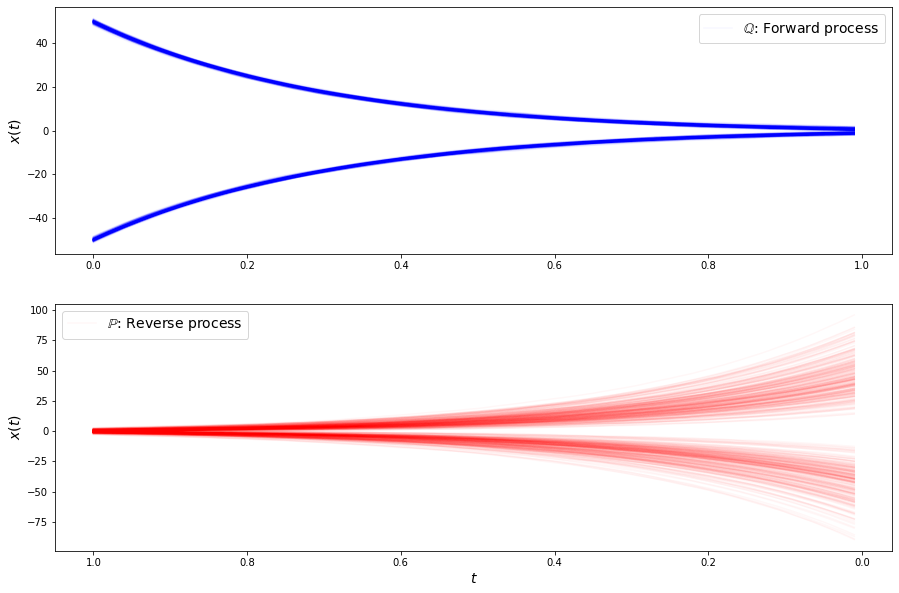

loss b 0.6687961220741272
loss b 0.6894513964653015
loss b 0.7200719714164734
loss b 0.6756399273872375
loss b 0.7223242521286011
loss b 0.6856540441513062
loss b 0.7135890126228333
loss b 0.6437934041023254
loss b 0.6970847845077515
loss b 0.7016121745109558
loss b 0.7314596176147461
loss b 0.6642277240753174
loss b 0.7732324004173279
loss b 0.6817153692245483
loss b 0.7403068542480469
loss b 0.7349421381950378
loss b 0.6639686226844788
loss b 0.6729508638381958
loss b 0.6659688949584961
loss b 0.7999828457832336
loss b 0.7274726629257202
loss b 0.7313670516014099
loss f 3.572387456893921
loss f 3.5404069423675537
loss f 3.5430030822753906
loss f 3.5165812969207764
loss f 3.5382986068725586
loss f 3.5589466094970703
loss f 3.5421512126922607
loss f 3.5681605339050293
loss f 3.545741319656372
loss f 3.5578930377960205
loss f 3.5739991664886475
loss f 3.523686170578003
loss f 3.529475450515747
loss f 3.53330397605896
loss f 3.5431320667266846
loss f 3.518220901489258
loss f 3.5621421337

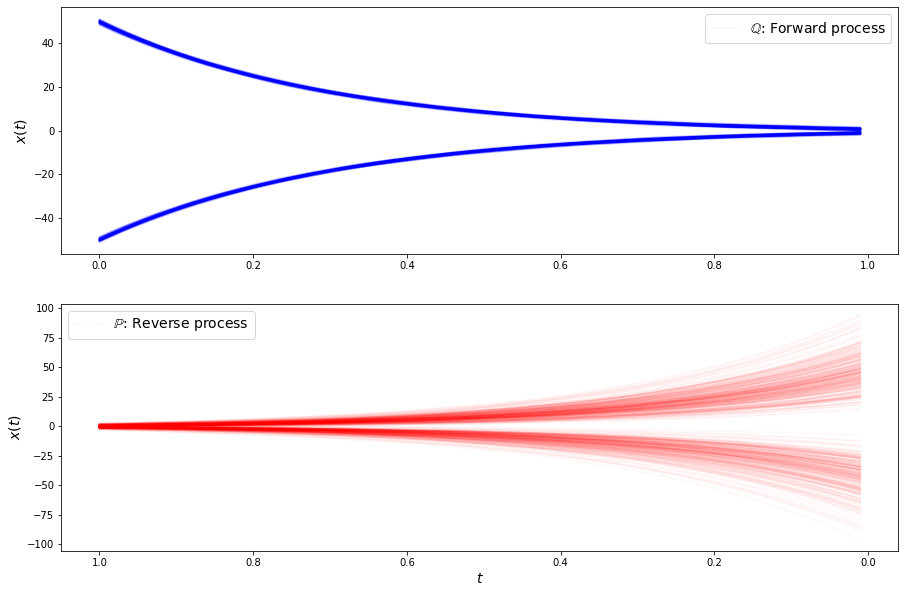

loss b 0.703986644744873
loss b 0.6986345052719116
loss b 0.7055273652076721
loss b 0.6945732235908508
loss b 0.6681228876113892
loss b 0.6481660008430481
loss b 0.7607361078262329
loss b 0.7070812582969666
loss b 0.6790333986282349
loss b 0.6066252589225769
loss b 0.6984120011329651
loss b 0.7101202607154846
loss b 0.6663960814476013
loss b 0.6680732369422913
loss b 0.722543478012085
loss b 0.678470253944397
loss b 0.68495112657547
loss b 0.7273163795471191
loss b 0.7175930738449097
loss b 0.7122294306755066
loss b 0.6487209796905518
loss b 0.6925078630447388
loss f 3.528825044631958
loss f 3.5316200256347656
loss f 3.5440049171447754
loss f 3.558467149734497
loss f 3.5567376613616943
loss f 3.5391805171966553
loss f 3.542543411254883
loss f 3.535255193710327
loss f 3.564335584640503
loss f 3.522174596786499
loss f 3.5243492126464844
loss f 3.5338921546936035
loss f 3.532006025314331
loss f 3.558201551437378
loss f 3.561356544494629
loss f 3.5524089336395264
loss f 3.5313587188720703


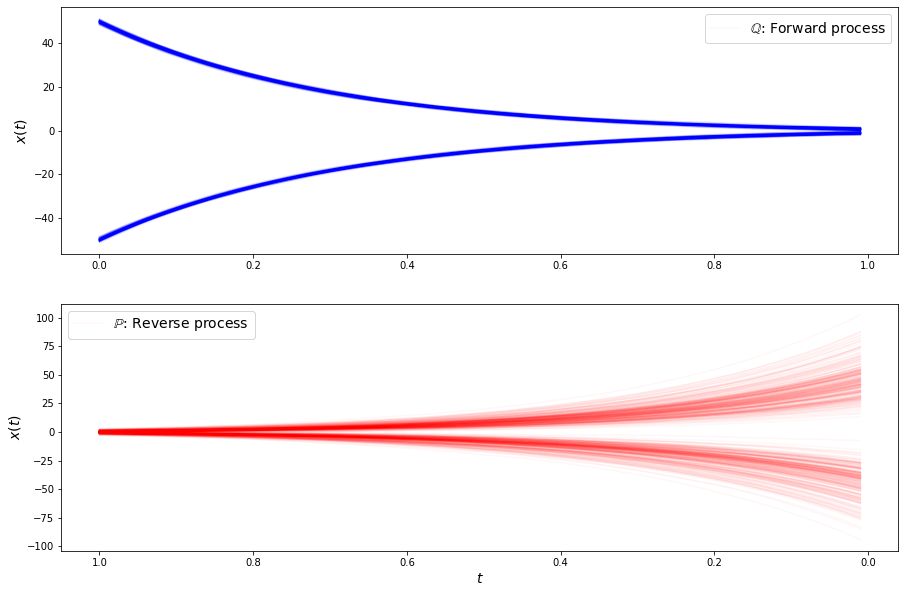

loss b 0.7697340250015259
loss b 0.6755567789077759
loss b 0.6686831116676331
loss b 0.6868739128112793
loss b 0.7575628161430359
loss b 0.7232417464256287
loss b 0.6797712445259094
loss b 0.6879943609237671
loss b 0.7596391439437866
loss b 0.6416617631912231
loss b 0.6646552681922913
loss b 0.7589190602302551
loss b 0.6925373673439026
loss b 0.63614422082901
loss b 0.7301342487335205
loss b 0.7285851240158081
loss b 0.5950182676315308
loss b 0.6771076321601868
loss b 0.6890766024589539
loss b 0.777611255645752
loss b 0.7204149961471558
loss b 0.6850050091743469
loss f 3.5372610092163086
loss f 3.5284533500671387
loss f 3.5381250381469727
loss f 3.535463571548462
loss f 3.5434868335723877
loss f 3.528959035873413
loss f 3.507723569869995
loss f 3.5174145698547363
loss f 3.519014596939087
loss f 3.5195865631103516
loss f 3.5407674312591553
loss f 3.530735969543457
loss f 3.4960684776306152
loss f 3.534423589706421
loss f 3.518676996231079
loss f 3.5539565086364746
loss f 3.4926671981811

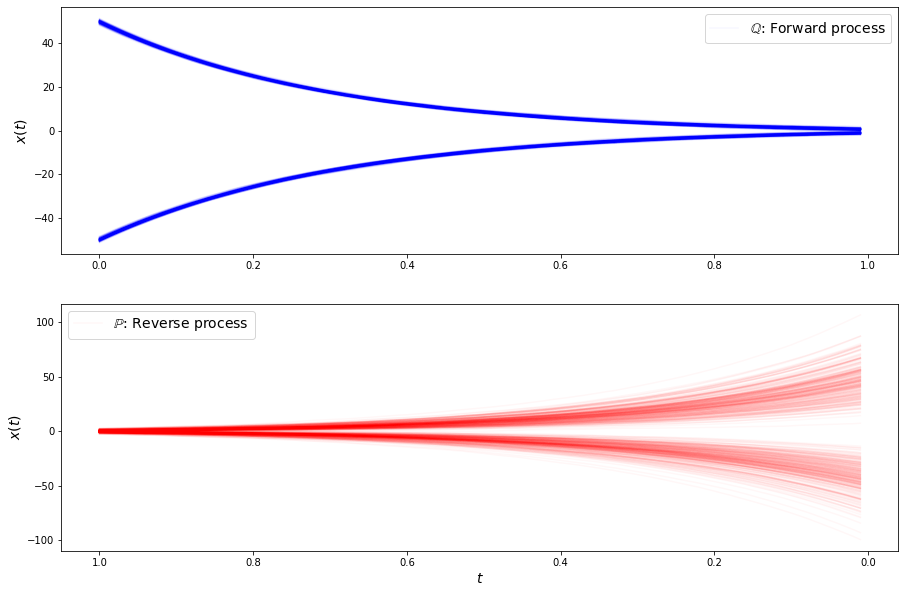

loss b 0.72767174243927
loss b 0.7673388123512268
loss b 0.6816156506538391
loss b 0.7331669926643372
loss b 0.6887367367744446
loss b 0.6569876670837402
loss b 0.7348970174789429
loss b 0.7636258602142334
loss b 0.6997737884521484
loss b 0.630329430103302
loss b 0.672380268573761
loss b 0.7155500054359436
loss b 0.6792542338371277
loss b 0.6283084154129028
loss b 0.7314950227737427
loss b 0.6208464503288269
loss b 0.6434170007705688
loss b 0.7045230269432068
loss b 0.714775562286377
loss b 0.7182096242904663
loss b 0.6546499133110046
loss b 0.7166439294815063
loss f 3.5269830226898193
loss f 3.5247063636779785
loss f 3.5014278888702393
loss f 3.5563206672668457
loss f 3.5078697204589844
loss f 3.530611991882324
loss f 3.521411180496216
loss f 3.532970905303955
loss f 3.52319073677063
loss f 3.4919235706329346
loss f 3.501894474029541
loss f 3.540419816970825
loss f 3.543097496032715
loss f 3.529705286026001
loss f 3.5226049423217773
loss f 3.5141994953155518
loss f 3.544861316680908
l

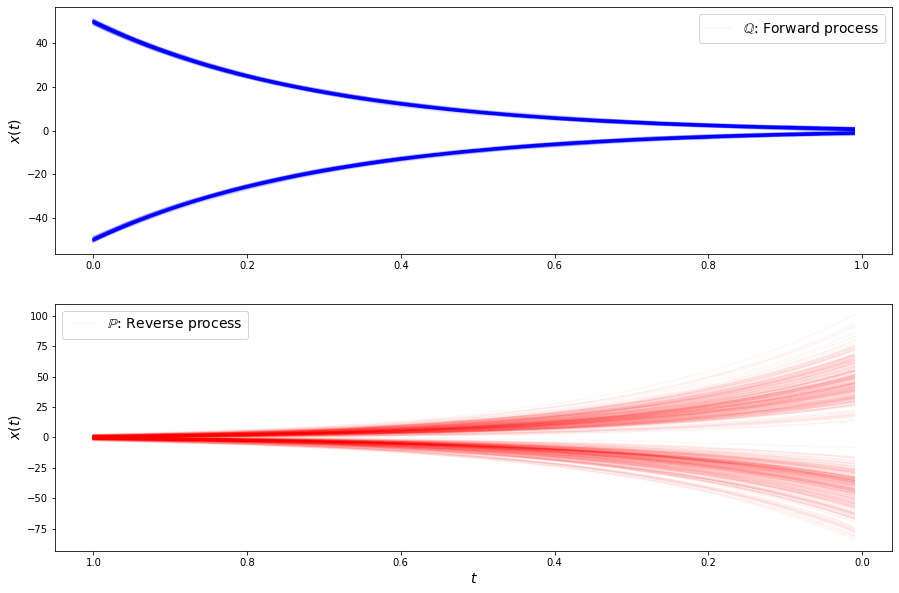

loss b 0.6096847057342529
loss b 0.6531016230583191
loss b 0.7423377633094788
loss b 0.779113233089447
loss b 0.6917656660079956
loss b 0.6768721342086792
loss b 0.5850046277046204
loss b 0.6053285002708435
loss b 0.665023148059845
loss b 0.7244786024093628
loss b 0.5605177283287048
loss b 0.7715268135070801
loss b 0.6425720453262329
loss b 0.6785062551498413
loss b 0.6648275852203369
loss b 0.6857566237449646
loss b 0.7007918953895569
loss b 0.7153913974761963
loss b 0.6829030513763428
loss b 0.6973356604576111
loss b 0.7383356094360352
loss b 0.6238567233085632
loss f 3.492654323577881
loss f 3.5363659858703613
loss f 3.4938623905181885
loss f 3.510096788406372
loss f 3.499558687210083
loss f 3.5224862098693848
loss f 3.5198025703430176
loss f 3.5161824226379395
loss f 3.5155160427093506
loss f 3.535715103149414
loss f 3.539992570877075
loss f 3.5396318435668945
loss f 3.502533197402954
loss f 3.487406015396118
loss f 3.507965564727783
loss f 3.517345905303955
loss f 3.48081803321838

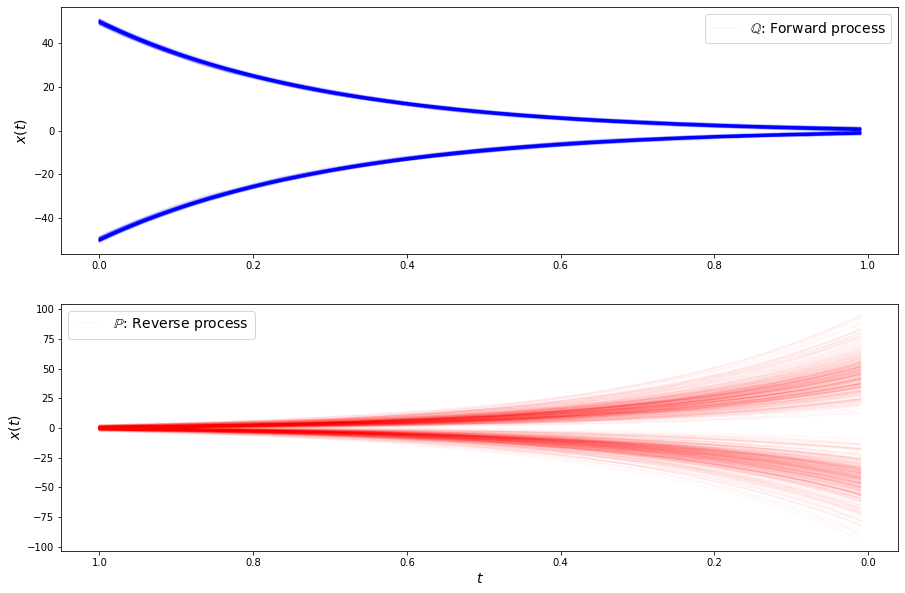

loss b 0.6769957542419434
loss b 0.6884346008300781
loss b 0.6862099766731262
loss b 0.6537882685661316
loss b 0.6730927228927612
loss b 0.6527228951454163
loss b 0.7130401134490967
loss b 0.6363548040390015
loss b 0.7073405981063843
loss b 0.7535673975944519
loss b 0.7112393975257874
loss b 0.6889899969100952
loss b 0.6933698058128357
loss b 0.5726349949836731
loss b 0.6497547626495361
loss b 0.6595476865768433
loss b 0.7344563007354736
loss b 0.7214064002037048
loss b 0.6399807929992676
loss b 0.7004220485687256
loss b 0.6481279730796814
loss b 0.6830631494522095
loss f 3.5053441524505615
loss f 3.5097179412841797
loss f 3.520479917526245
loss f 3.518293619155884
loss f 3.5322980880737305
loss f 3.531773567199707
loss f 3.5301811695098877
loss f 3.5051729679107666
loss f 3.5137887001037598
loss f 3.505584478378296
loss f 3.488562822341919
loss f 3.5017075538635254
loss f 3.4861159324645996
loss f 3.5237300395965576
loss f 3.5282797813415527
loss f 3.4693500995635986
loss f 3.50498342

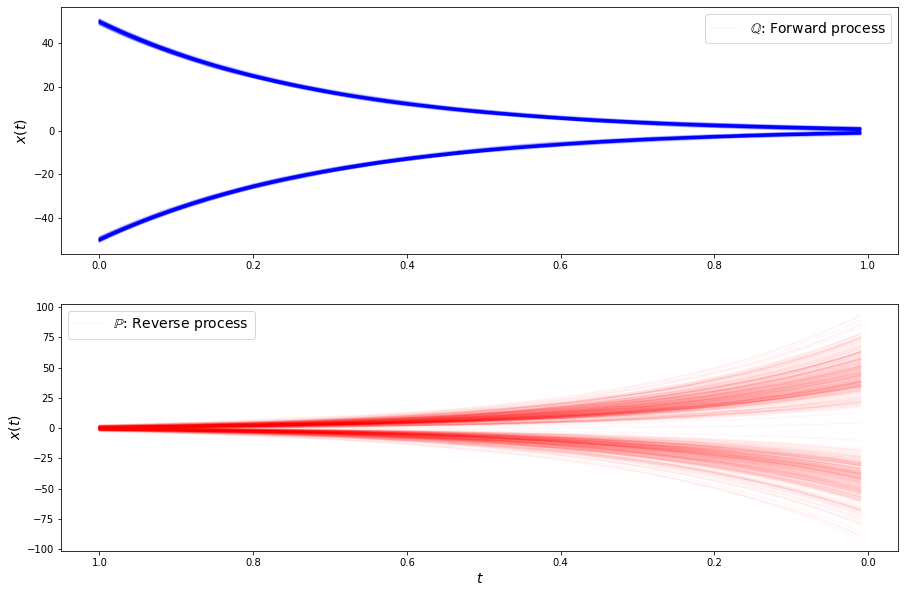

loss b 0.6540758013725281
loss b 0.7221398949623108
loss b 0.7629945874214172
loss b 0.6262270212173462
loss b 0.6947937607765198
loss b 0.619017481803894
loss b 0.6587717533111572
loss b 0.6662577986717224
loss b 0.6020534634590149
loss b 0.5821171402931213
loss b 0.6794813871383667
loss b 0.7405010461807251
loss b 0.5818591117858887
loss b 0.6240128874778748
loss b 0.6327769756317139
loss b 0.6594014763832092
loss b 0.6003813743591309
loss b 0.7153554558753967
loss b 0.739294707775116
loss b 0.7242873907089233
loss b 0.682807981967926
loss b 0.6529721021652222
loss f 3.5126988887786865
loss f 3.5507071018218994
loss f 3.4830451011657715
loss f 3.5040457248687744
loss f 3.508533477783203
loss f 3.5272321701049805
loss f 3.5024349689483643
loss f 3.5262229442596436
loss f 3.5057685375213623
loss f 3.488400459289551
loss f 3.4906959533691406
loss f 3.5261313915252686
loss f 3.4857139587402344
loss f 3.503812789916992
loss f 3.4921059608459473
loss f 3.51906156539917
loss f 3.49925994873

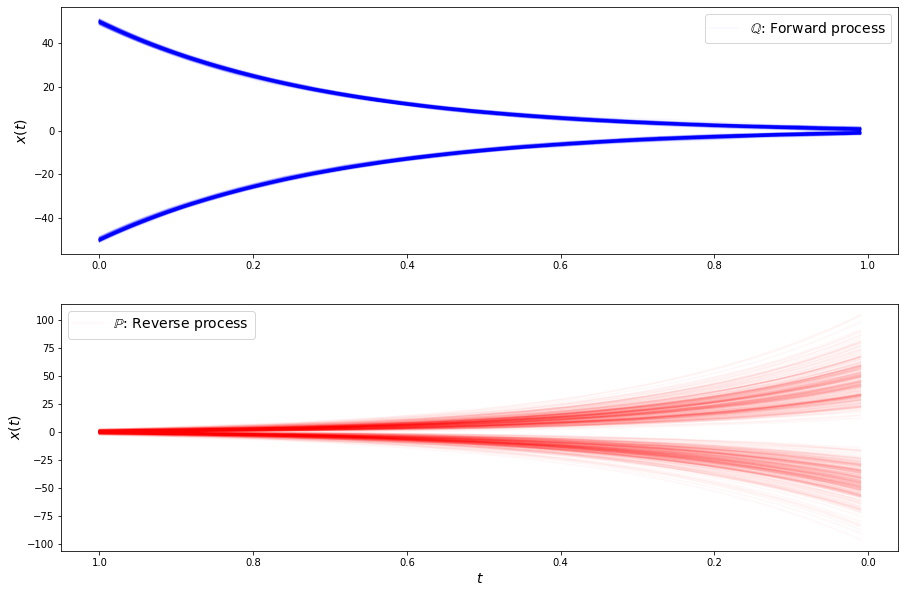

loss b 0.6119580864906311
loss b 0.6580862402915955
loss b 0.7182303667068481
loss b 0.703490138053894
loss b 0.6777265071868896
loss b 0.701124370098114
loss b 0.6390124559402466
loss b 0.6575743556022644
loss b 0.688589334487915
loss b 0.7026684880256653
loss b 0.7166985273361206
loss b 0.6220196485519409
loss b 0.6499077677726746
loss b 0.6820489764213562
loss b 0.6152232885360718
loss b 0.720843493938446
loss b 0.5831284523010254
loss b 0.6843152642250061
loss b 0.6306228637695312
loss b 0.6599308252334595
loss b 0.6453359127044678
loss b 0.6934739947319031
loss f 3.5207130908966064
loss f 3.4995803833007812
loss f 3.465444326400757
loss f 3.479356050491333
loss f 3.4549763202667236
loss f 3.4758241176605225
loss f 3.517277956008911
loss f 3.498448610305786
loss f 3.473592519760132
loss f 3.5095627307891846
loss f 3.4831955432891846
loss f 3.498908758163452
loss f 3.4783849716186523
loss f 3.491741418838501
loss f 3.497128486633301
loss f 3.4960525035858154
loss f 3.494966506958008

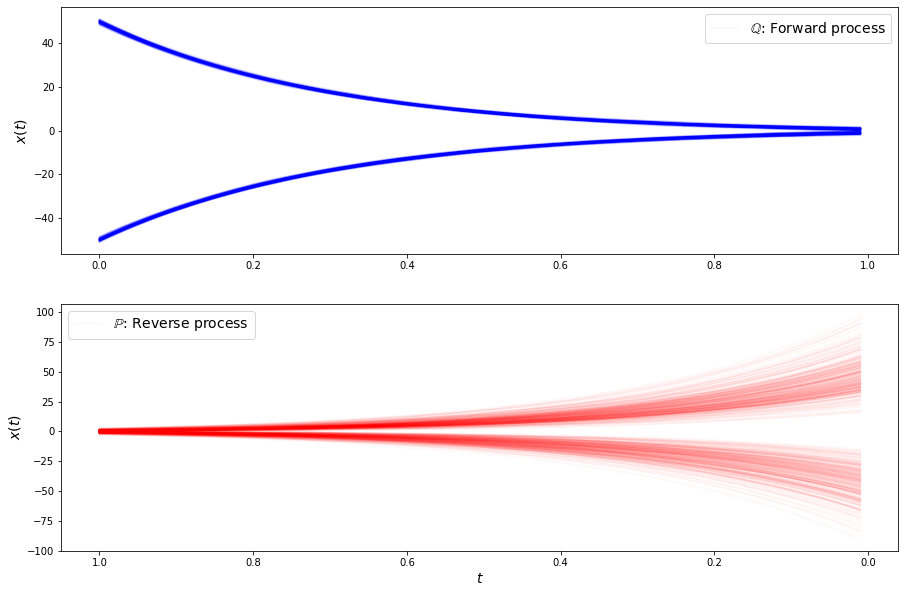

loss b 0.6453188061714172
loss b 0.6763287782669067
loss b 0.6155122518539429
loss b 0.7107484340667725
loss b 0.6358429789543152
loss b 0.6109986305236816
loss b 0.6793501377105713
loss b 0.745727002620697
loss b 0.7208690047264099
loss b 0.6898108720779419
loss b 0.6453734040260315
loss b 0.62858647108078
loss b 0.6770113706588745
loss b 0.6887381672859192
loss b 0.6850394606590271
loss b 0.6929798126220703
loss b 0.6342641115188599
loss b 0.7004714012145996
loss b 0.6950092911720276
loss b 0.580181360244751
loss b 0.6832053661346436
loss b 0.63736891746521
loss f 3.507389545440674
loss f 3.455439567565918
loss f 3.4913547039031982
loss f 3.4606740474700928
loss f 3.488811492919922
loss f 3.4920811653137207
loss f 3.4837279319763184
loss f 3.4825379848480225
loss f 3.4738640785217285
loss f 3.4940319061279297
loss f 3.500406265258789
loss f 3.4532039165496826
loss f 3.4981424808502197
loss f 3.450251817703247
loss f 3.4956746101379395
loss f 3.486037015914917
loss f 3.505391597747802

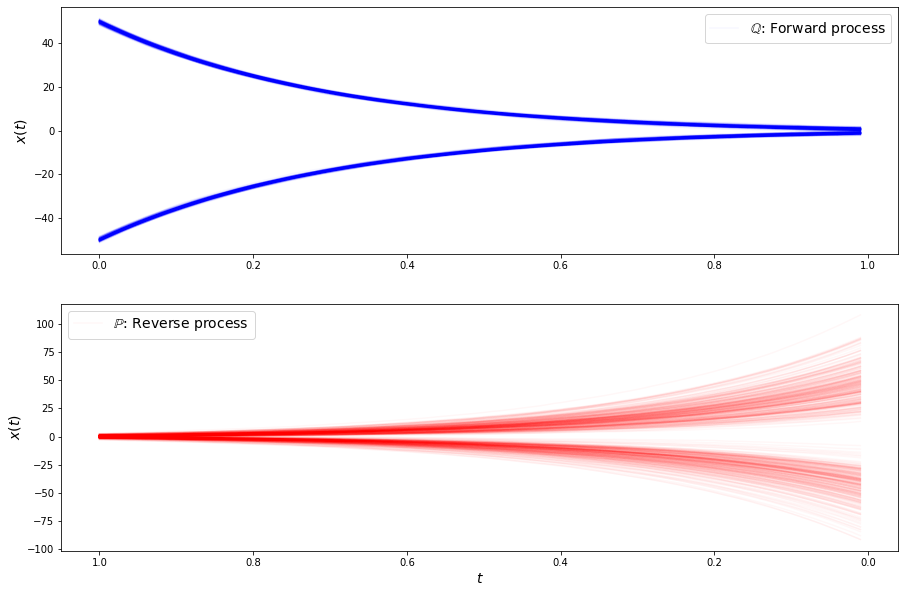

loss b 0.6881849765777588
loss b 0.6421905159950256
loss b 0.6661764979362488
loss b 0.7188315987586975
loss b 0.517036497592926
loss b 0.803543746471405
loss b 0.6960963010787964
loss b 0.6665105223655701
loss b 0.6375440955162048
loss b 0.696123480796814
loss b 0.6691160798072815
loss b 0.6649336218833923
loss b 0.6713507771492004
loss b 0.7096118927001953
loss b 0.6091452240943909
loss b 0.628402590751648
loss b 0.6590269207954407
loss b 0.7358291745185852
loss b 0.611541748046875
loss b 0.627216100692749
loss b 0.6496419310569763
loss b 0.5859106183052063
loss f 3.465393543243408
loss f 3.4774200916290283
loss f 3.488285541534424
loss f 3.508507490158081
loss f 3.4857003688812256
loss f 3.4952328205108643
loss f 3.5006282329559326
loss f 3.4634604454040527
loss f 3.4952335357666016
loss f 3.4978384971618652
loss f 3.4919683933258057
loss f 3.4949254989624023
loss f 3.4979920387268066
loss f 3.4782426357269287
loss f 3.4746956825256348
loss f 3.485938310623169
loss f 3.4623126983642

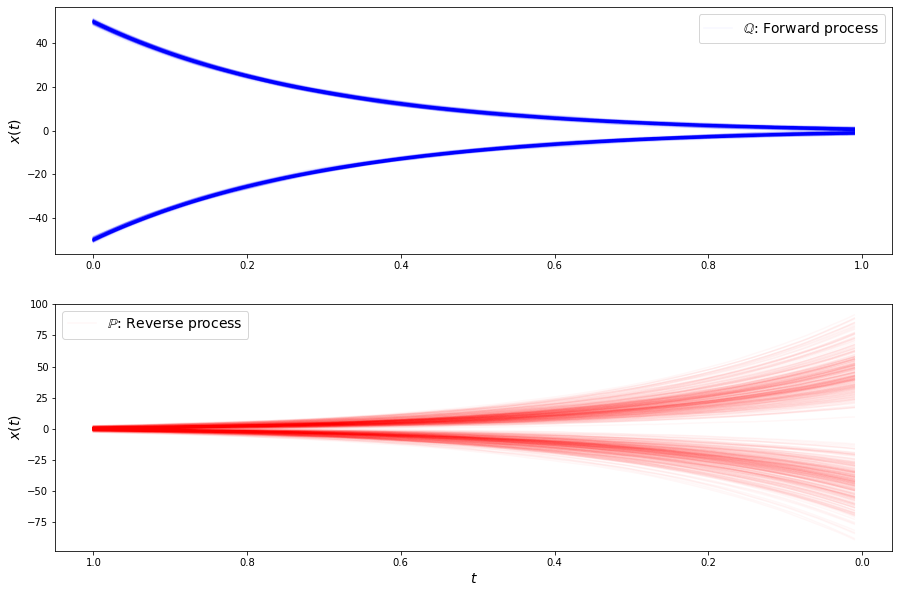

loss b 0.6128661036491394
loss b 0.6361338496208191
loss b 0.7146339416503906
loss b 0.6981992721557617
loss b 0.5920536518096924
loss b 0.6003713011741638
loss b 0.7148088216781616
loss b 0.6011888384819031
loss b 0.6067191958427429
loss b 0.6363233923912048
loss b 0.6921298503875732
loss b 0.6771878600120544
loss b 0.646156370639801
loss b 0.6516660451889038
loss b 0.7509968876838684
loss b 0.5831326842308044
loss b 0.7024353742599487
loss b 0.6386029720306396
loss b 0.6496226191520691
loss b 0.6299423575401306
loss b 0.7165789008140564
loss b 0.5922250151634216
loss f 3.4745094776153564
loss f 3.4670073986053467
loss f 3.4723281860351562
loss f 3.48653244972229
loss f 3.500014066696167
loss f 3.4915339946746826
loss f 3.471304416656494
loss f 3.483867883682251
loss f 3.447876214981079
loss f 3.477320909500122
loss f 3.4698646068573
loss f 3.4722988605499268
loss f 3.467690944671631
loss f 3.4725635051727295
loss f 3.489194393157959
loss f 3.474987030029297
loss f 3.472203016281128
l

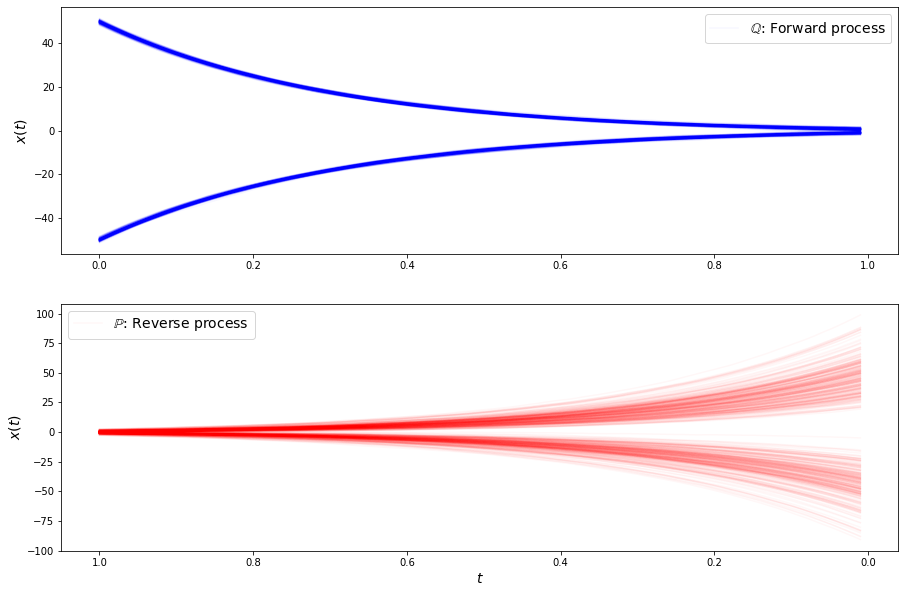

loss b 0.6660612225532532
loss b 0.6380225419998169
loss b 0.6837402582168579
loss b 0.6657830476760864
loss b 0.6447370648384094
loss b 0.6855872869491577
loss b 0.5615090131759644
loss b 0.612923264503479
loss b 0.6292318105697632
loss b 0.7626219987869263
loss b 0.7555646300315857
loss b 0.5851633548736572
loss b 0.6284651756286621
loss b 0.6601146459579468
loss b 0.7020395994186401
loss b 0.642213761806488
loss b 0.7126941084861755
loss b 0.5905788540840149
loss b 0.6388216018676758
loss b 0.6761990189552307
loss b 0.6831198930740356
loss b 0.7260241508483887
loss f 3.488013982772827
loss f 3.474980592727661
loss f 3.469151496887207
loss f 3.469419002532959
loss f 3.488102912902832
loss f 3.4570417404174805
loss f 3.4714150428771973
loss f 3.4721012115478516
loss f 3.4810447692871094
loss f 3.4760756492614746
loss f 3.4664430618286133
loss f 3.471453905105591
loss f 3.4712953567504883
loss f 3.440190315246582
loss f 3.4448044300079346
loss f 3.446410894393921
loss f 3.4639842510223

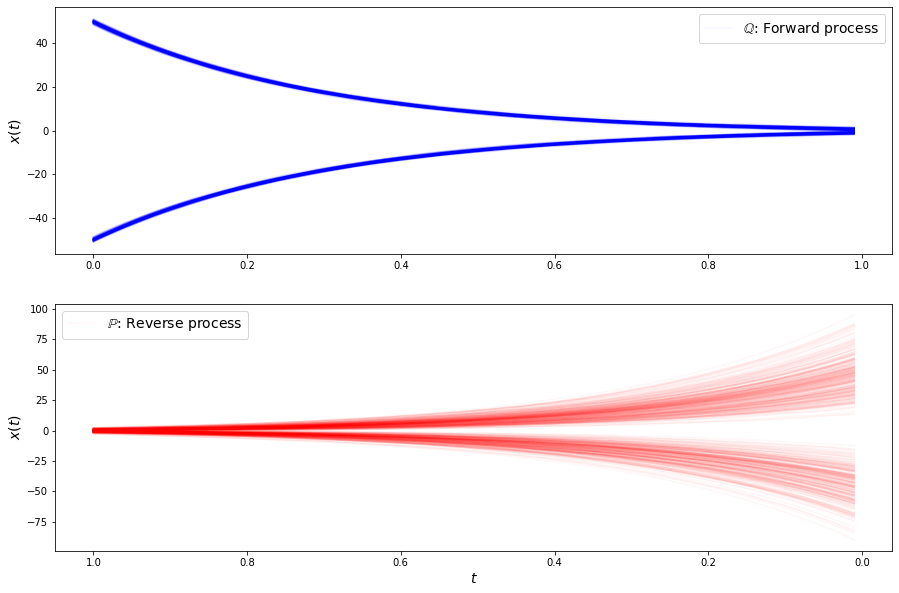

loss b 0.6555269360542297
loss b 0.6787776350975037
loss b 0.6182391047477722
loss b 0.6974506378173828
loss b 0.6632929444313049
loss b 0.7110413908958435
loss b 0.6752945184707642
loss b 0.5946547985076904
loss b 0.6497892737388611
loss b 0.6196181178092957
loss b 0.6544432640075684
loss b 0.7366854548454285
loss b 0.6805014610290527
loss b 0.6323060989379883
loss b 0.5967367887496948
loss b 0.5988824367523193
loss b 0.6243897676467896
loss b 0.6736118197441101
loss b 0.7039974927902222
loss b 0.6627426743507385
loss b 0.752328634262085
loss b 0.6550654768943787
loss f 3.480344295501709
loss f 3.4395480155944824
loss f 3.462759494781494
loss f 3.457942008972168
loss f 3.4468815326690674
loss f 3.467845916748047
loss f 3.447066068649292
loss f 3.4527390003204346
loss f 3.469069242477417
loss f 3.469249963760376
loss f 3.4301371574401855
loss f 3.4521000385284424
loss f 3.4622535705566406
loss f 3.4820640087127686
loss f 3.46697998046875
loss f 3.427440881729126
loss f 3.48242902755737

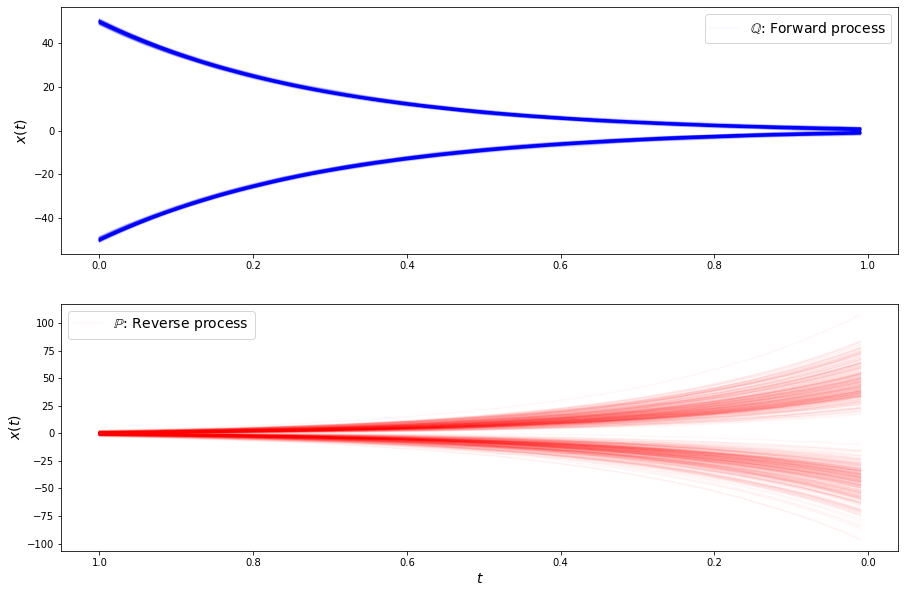

loss b 0.6554774641990662
loss b 0.6839651465415955
loss b 0.8045284152030945
loss b 0.6178668737411499
loss b 0.5890535712242126
loss b 0.6497007608413696
loss b 0.6325562596321106
loss b 0.6399537324905396
loss b 0.6543104648590088
loss b 0.6879094839096069
loss b 0.6071814298629761
loss b 0.5968867540359497
loss b 0.6024415493011475
loss b 0.6557210087776184
loss b 0.6340533494949341
loss b 0.6579698324203491
loss b 0.6761776208877563
loss b 0.6023571491241455
loss b 0.6576288342475891
loss b 0.6049891114234924
loss b 0.618698239326477
loss b 0.5788503289222717
loss f 3.5043070316314697
loss f 3.4728055000305176
loss f 3.4357714653015137
loss f 3.461467981338501
loss f 3.465461492538452
loss f 3.46758770942688
loss f 3.467872381210327
loss f 3.445436477661133
loss f 3.458888053894043
loss f 3.4750170707702637
loss f 3.424952745437622
loss f 3.4763009548187256
loss f 3.467590093612671
loss f 3.449801445007324
loss f 3.4608585834503174
loss f 3.4697277545928955
loss f 3.44086790084838

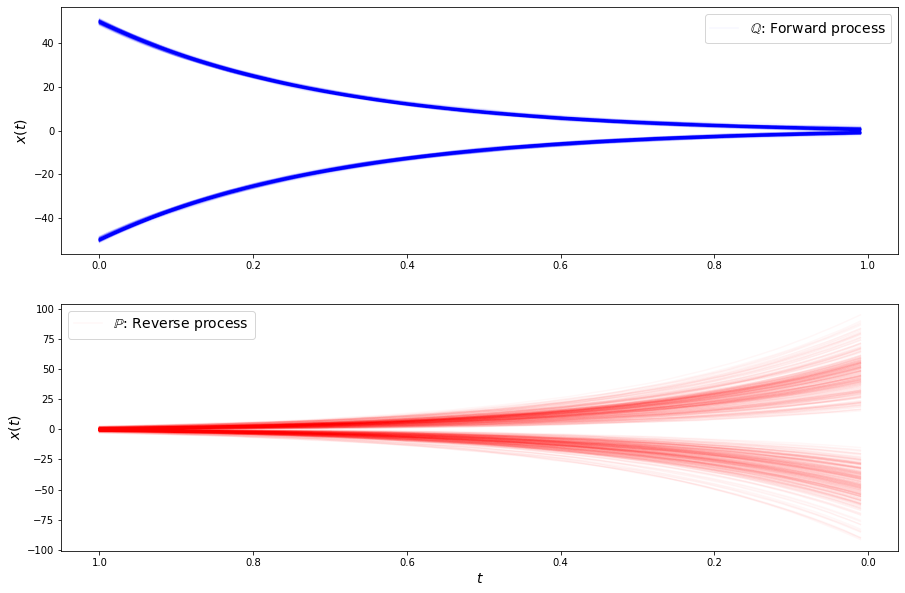

loss b 0.5839755535125732
loss b 0.6626009345054626
loss b 0.6936382055282593
loss b 0.5583328604698181
loss b 0.5769039988517761
loss b 0.6121165752410889
loss b 0.7513067722320557
loss b 0.6153812408447266
loss b 0.6794254779815674
loss b 0.5950670838356018
loss b 0.7226395010948181
loss b 0.5832933187484741
loss b 0.6772427558898926
loss b 0.6289297342300415
loss b 0.6237967014312744
loss b 0.6116772890090942
loss b 0.5775976181030273
loss b 0.6850669980049133
loss b 0.640957772731781
loss b 0.6310754418373108
loss b 0.5751742124557495
loss b 0.6292577385902405
loss f 3.4373462200164795
loss f 3.454240083694458
loss f 3.4468154907226562
loss f 3.451356887817383
loss f 3.451010227203369
loss f 3.472341299057007
loss f 3.439946413040161
loss f 3.463305950164795
loss f 3.4704430103302
loss f 3.4621710777282715
loss f 3.4594292640686035
loss f 3.439152240753174
loss f 3.4512314796447754
loss f 3.494103193283081
loss f 3.4382946491241455
loss f 3.4730753898620605
loss f 3.475170612335205

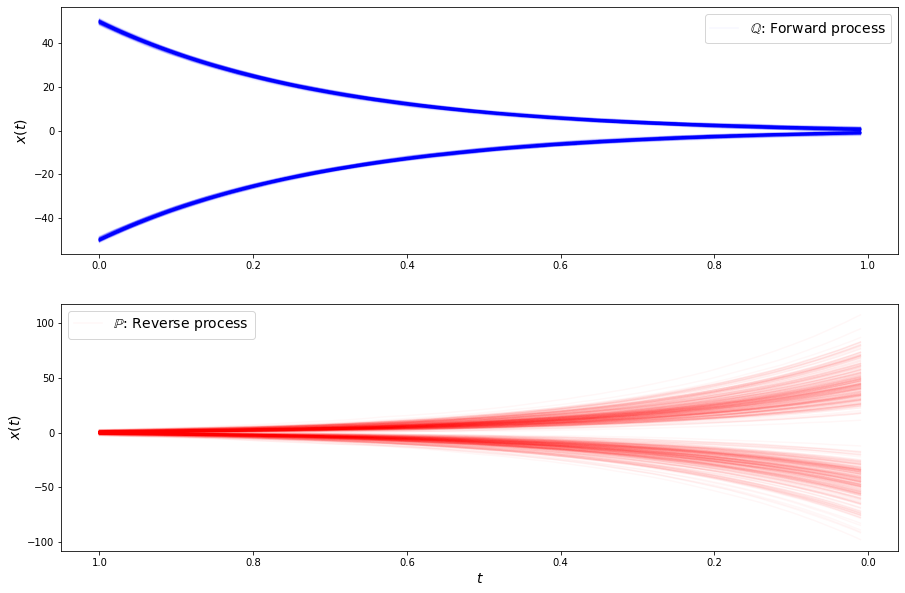

loss b 0.7332095503807068
loss b 0.598113477230072
loss b 0.6366539001464844
loss b 0.646061360836029
loss b 0.6390343308448792
loss b 0.5989078283309937
loss b 0.7022491097450256
loss b 0.5931756496429443
loss b 0.617667555809021
loss b 0.5966674089431763
loss b 0.592492401599884
loss b 0.670367956161499
loss b 0.6149046421051025
loss b 0.6347815990447998
loss b 0.6118722558021545
loss b 0.6762630343437195
loss b 0.6262028813362122
loss b 0.6239099502563477
loss b 0.6188814043998718
loss b 0.5883817672729492
loss b 0.6200961470603943
loss b 0.5530639290809631
loss f 3.456156015396118
loss f 3.4329912662506104
loss f 3.4572224617004395
loss f 3.491777181625366
loss f 3.4322712421417236
loss f 3.4427342414855957
loss f 3.439791440963745
loss f 3.458057403564453
loss f 3.4786112308502197
loss f 3.4522271156311035
loss f 3.4598374366760254
loss f 3.4657504558563232
loss f 3.4459071159362793
loss f 3.454737424850464
loss f 3.4629673957824707
loss f 3.4763529300689697
loss f 3.4455804824829

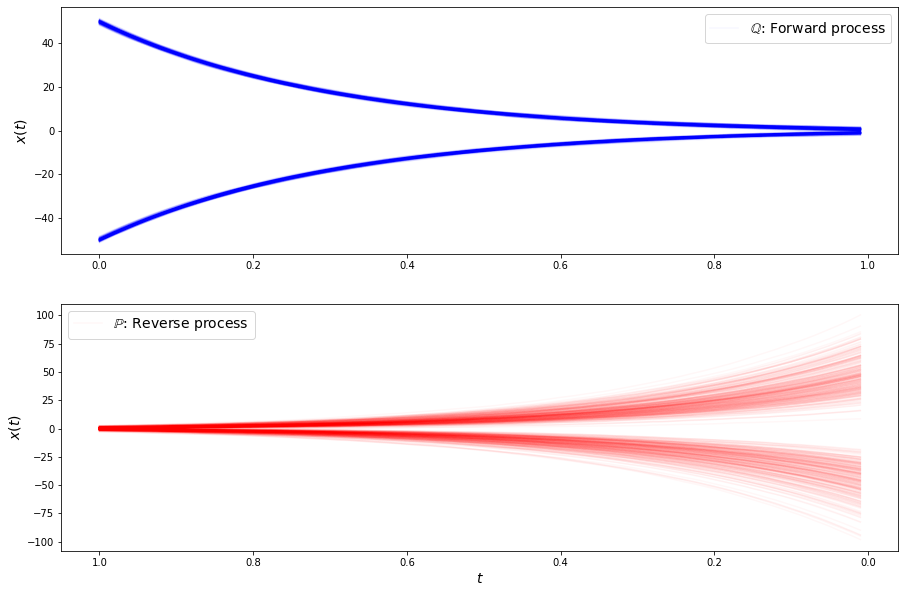

loss b 0.6604808568954468
loss b 0.6751614809036255
loss b 0.6002251505851746
loss b 0.6040742993354797
loss b 0.642806351184845
loss b 0.6402096152305603
loss b 0.602293848991394
loss b 0.651682436466217
loss b 0.6145786046981812
loss b 0.6150946617126465
loss b 0.6152682304382324
loss b 0.6386741399765015
loss b 0.6129067540168762
loss b 0.5779641270637512
loss b 0.5756067037582397
loss b 0.6035820245742798
loss b 0.6542831063270569
loss b 0.6008977293968201
loss b 0.6468856930732727
loss b 0.6203952431678772
loss b 0.6088562607765198
loss b 0.6453999876976013
loss f 3.436192750930786
loss f 3.4386794567108154
loss f 3.451908588409424
loss f 3.429713010787964
loss f 3.4612817764282227
loss f 3.465832471847534
loss f 3.432206392288208
loss f 3.4593024253845215
loss f 3.4527499675750732
loss f 3.448512077331543
loss f 3.444722890853882
loss f 3.4670791625976562
loss f 3.443669557571411
loss f 3.4493966102600098
loss f 3.4573686122894287
loss f 3.455857276916504
loss f 3.451161146163940

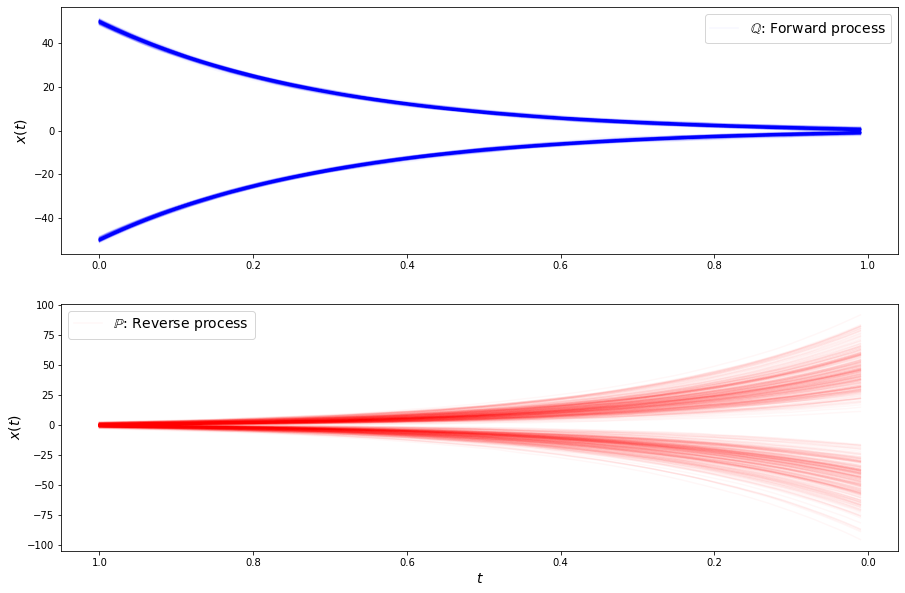

loss b 0.7158782482147217
loss b 0.6585134267807007
loss b 0.586181104183197
loss b 0.6567787528038025
loss b 0.607733428478241
loss b 0.6738883256912231
loss b 0.5962262153625488
loss b 0.6081514358520508
loss b 0.6074702739715576
loss b 0.6168181300163269
loss b 0.6983228921890259
loss b 0.586235523223877
loss b 0.5712990760803223
loss b 0.6601481437683105
loss b 0.6538379788398743
loss b 0.6632245182991028
loss b 0.556756854057312
loss b 0.6521223187446594
loss b 0.6672531366348267
loss b 0.5698767304420471
loss b 0.6406553387641907
loss b 0.6991605162620544
loss f 3.451308488845825
loss f 3.4608240127563477
loss f 3.4501044750213623
loss f 3.4194605350494385
loss f 3.459606885910034
loss f 3.4645040035247803
loss f 3.4747540950775146
loss f 3.434870481491089
loss f 3.4523744583129883
loss f 3.459567070007324
loss f 3.4304916858673096
loss f 3.434849500656128
loss f 3.43581485748291
loss f 3.4351096153259277
loss f 3.434206008911133
loss f 3.4318814277648926
loss f 3.45182204246521


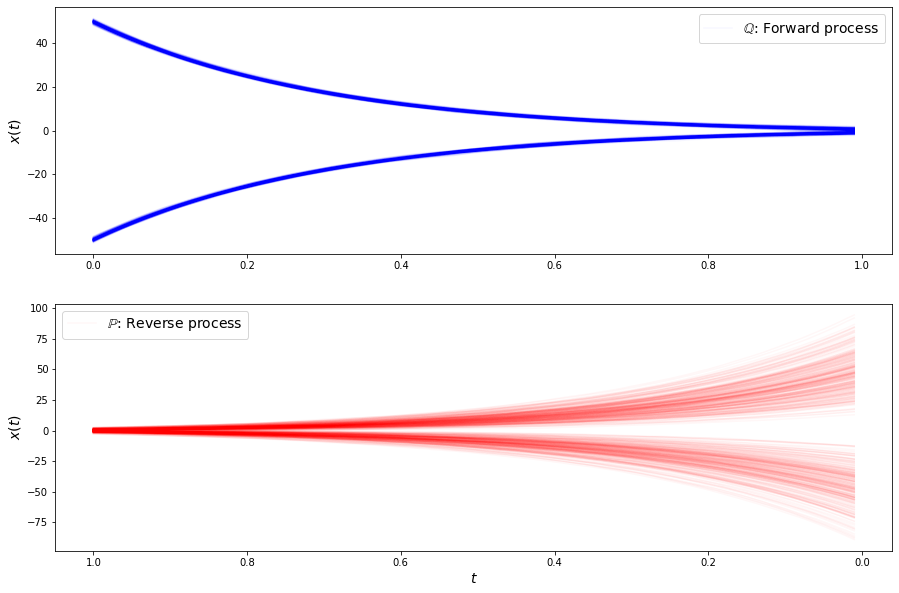

loss b 0.6868423819541931
loss b 0.604493260383606
loss b 0.6706863641738892
loss b 0.581207275390625
loss b 0.6564120650291443
loss b 0.6286236047744751
loss b 0.5708996057510376
loss b 0.613630473613739
loss b 0.553992509841919
loss b 0.666803240776062
loss b 0.6437239646911621
loss b 0.6319264769554138
loss b 0.5862805247306824
loss b 0.6172975897789001
loss b 0.5832853317260742
loss b 0.6923828125
loss b 0.656563401222229
loss b 0.6361343860626221
loss b 0.5922081470489502
loss b 0.619243860244751
loss b 0.6300251483917236
loss b 0.5966457724571228
loss f 3.415167808532715
loss f 3.4545578956604004
loss f 3.4525327682495117
loss f 3.4322328567504883
loss f 3.4538044929504395
loss f 3.4303600788116455
loss f 3.4437694549560547
loss f 3.4204418659210205
loss f 3.44983172416687
loss f 3.4339776039123535
loss f 3.433784246444702
loss f 3.445772886276245
loss f 3.4200358390808105
loss f 3.443025827407837
loss f 3.4274325370788574
loss f 3.4204013347625732
loss f 3.432068109512329
loss f

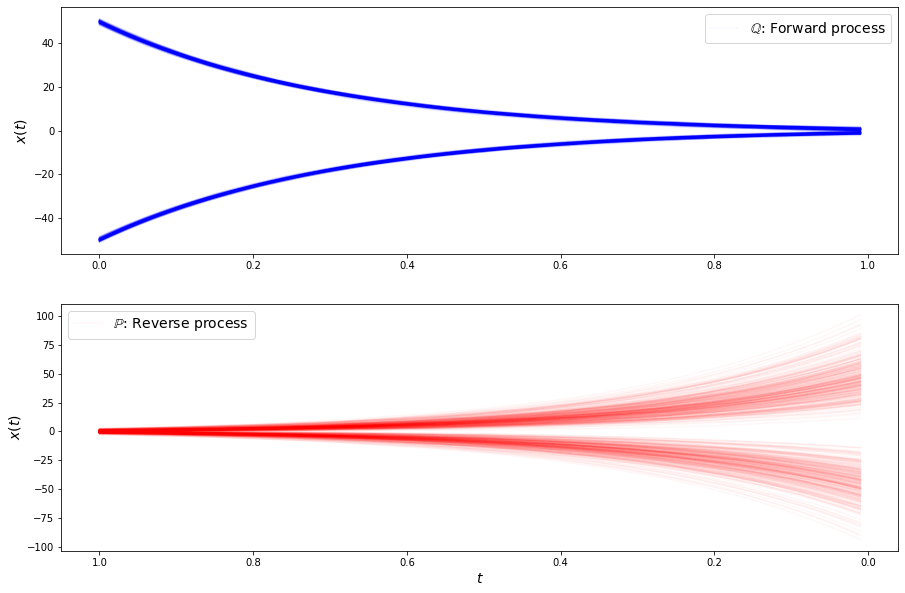

loss b 0.6640642285346985
loss b 0.654150128364563
loss b 0.6675819754600525
loss b 0.6362926959991455
loss b 0.6438406109809875
loss b 0.7064839005470276
loss b 0.6571008563041687
loss b 0.6172186136245728
loss b 0.6028634309768677
loss b 0.6207811236381531
loss b 0.6425517797470093
loss b 0.5553572773933411
loss b 0.6086547374725342
loss b 0.6985955238342285
loss b 0.6064114570617676
loss b 0.6009222269058228
loss b 0.6779175996780396
loss b 0.64954674243927
loss b 0.5576304793357849
loss b 0.6850191950798035
loss b 0.6970902681350708
loss b 0.5983323454856873
loss f 3.440516471862793
loss f 3.426612138748169
loss f 3.449392557144165
loss f 3.4143714904785156
loss f 3.4191222190856934
loss f 3.4305567741394043
loss f 3.4415273666381836
loss f 3.4106054306030273
loss f 3.4071285724639893
loss f 3.4368808269500732
loss f 3.4345030784606934
loss f 3.4494597911834717
loss f 3.433138847351074
loss f 3.4297935962677
loss f 3.4264767169952393
loss f 3.414228916168213
loss f 3.42286157608032

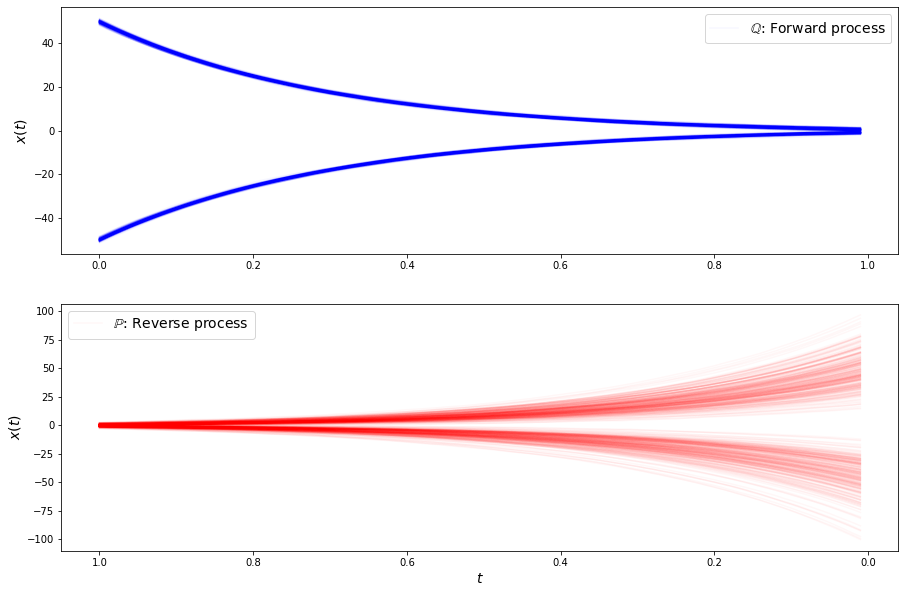

loss b 0.6667961478233337
loss b 0.677039384841919
loss b 0.6449000239372253
loss b 0.5746416449546814
loss b 0.706485390663147
loss b 0.6249838471412659
loss b 0.5679071545600891
loss b 0.6088971495628357
loss b 0.635335385799408
loss b 0.6588147282600403
loss b 0.6044824123382568
loss b 0.6692445278167725
loss b 0.6223009824752808
loss b 0.6558611392974854
loss b 0.6176122426986694
loss b 0.6891560554504395
loss b 0.5919292569160461
loss b 0.6495983600616455
loss b 0.6888414025306702
loss b 0.6360375881195068
loss b 0.6278799772262573
loss b 0.5778645277023315
loss f 3.4477779865264893
loss f 3.450965404510498
loss f 3.4300904273986816
loss f 3.44525146484375
loss f 3.4582884311676025
loss f 3.4368906021118164
loss f 3.403779983520508
loss f 3.4450480937957764
loss f 3.415241003036499
loss f 3.447746515274048
loss f 3.400864839553833
loss f 3.425065517425537
loss f 3.4375545978546143
loss f 3.477778911590576
loss f 3.444098472595215
loss f 3.451568603515625
loss f 3.440366506576538
l

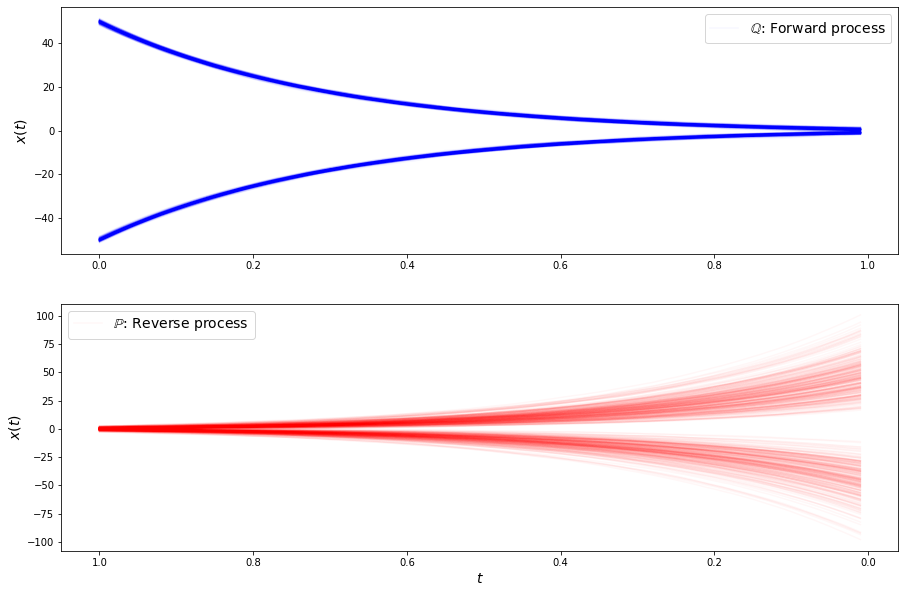

loss b 0.641099750995636
loss b 0.6328621506690979
loss b 0.6262444257736206
loss b 0.6034350991249084
loss b 0.6141587495803833
loss b 0.6047486662864685
loss b 0.5870770215988159
loss b 0.5197877883911133
loss b 0.5697097778320312
loss b 0.6006671190261841
loss b 0.6622157692909241
loss b 0.5585298538208008
loss b 0.6812482476234436
loss b 0.6684154868125916
loss b 0.6410117745399475
loss b 0.6735077500343323
loss b 0.5209032893180847
loss b 0.6319063305854797
loss b 0.6631201505661011
loss b 0.7363704442977905
loss b 0.733725368976593
loss b 0.551851749420166
loss f 3.4359774589538574
loss f 3.457594394683838
loss f 3.4188594818115234
loss f 3.4310152530670166
loss f 3.421154499053955
loss f 3.4164483547210693
loss f 3.4490504264831543
loss f 3.4356672763824463
loss f 3.426985740661621
loss f 3.457231044769287
loss f 3.4420294761657715
loss f 3.4271979331970215
loss f 3.420287609100342
loss f 3.4170591831207275
loss f 3.4323601722717285
loss f 3.431683301925659
loss f 3.464032888412

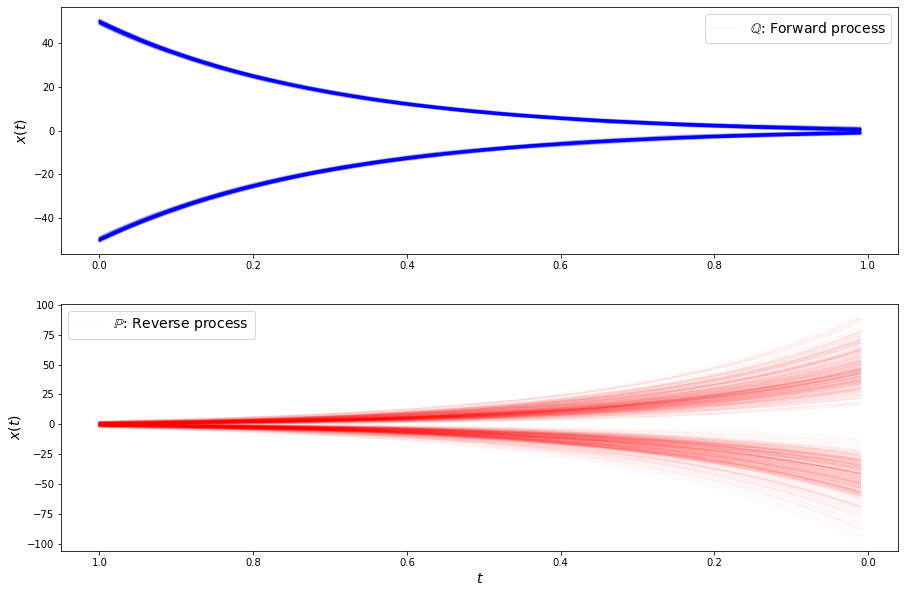

loss b 0.6783787608146667
loss b 0.6885433793067932
loss b 0.643730640411377
loss b 0.6723377108573914
loss b 0.6056671142578125
loss b 0.6607310771942139
loss b 0.6041956543922424
loss b 0.621088445186615
loss b 0.6659362316131592
loss b 0.622446596622467
loss b 0.6706463098526001
loss b 0.6387394666671753
loss b 0.6247231364250183
loss b 0.6093720197677612
loss b 0.6610293984413147
loss b 0.6196994781494141
loss b 0.5384031534194946
loss b 0.613067626953125
loss b 0.641257107257843
loss b 0.6541889309883118
loss b 0.6586774587631226
loss b 0.7110944986343384
loss f 3.4126172065734863
loss f 3.4328737258911133
loss f 3.43285870552063
loss f 3.449683904647827
loss f 3.4145596027374268
loss f 3.4048140048980713
loss f 3.4403629302978516
loss f 3.447050094604492
loss f 3.418717384338379
loss f 3.415976047515869
loss f 3.419680595397949
loss f 3.4443914890289307
loss f 3.4509990215301514
loss f 3.426941156387329
loss f 3.43447208404541
loss f 3.434537887573242
loss f 3.4175877571105957
lo

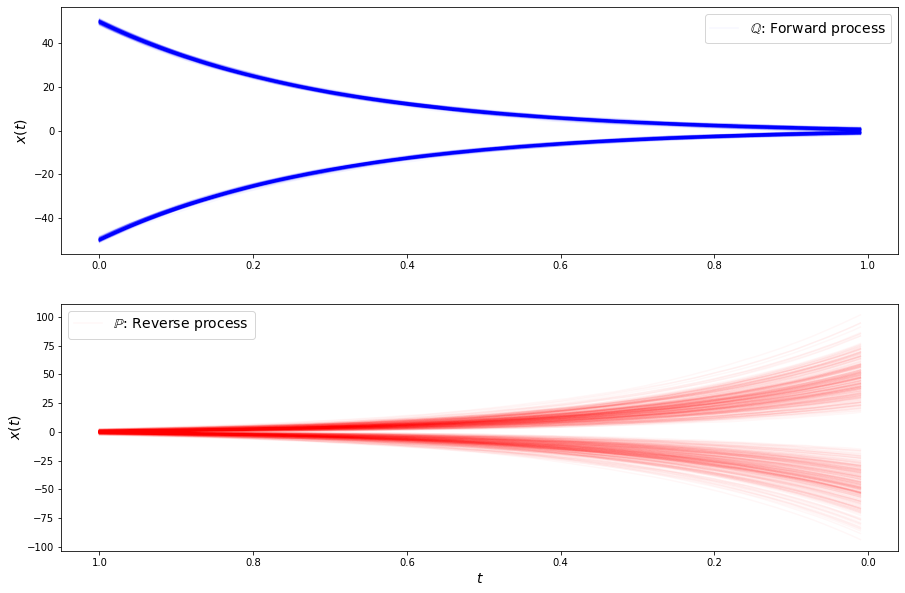

loss b 0.6780587434768677
loss b 0.5813928842544556
loss b 0.5402912497520447
loss b 0.5991033911705017
loss b 0.6259890198707581
loss b 0.6342938542366028
loss b 0.6129801273345947
loss b 0.6358333826065063
loss b 0.6756020188331604
loss b 0.5869607925415039
loss b 0.6768254041671753
loss b 0.6670647263526917
loss b 0.6853125095367432
loss b 0.6035857796669006
loss b 0.6113483905792236
loss b 0.6290947794914246
loss b 0.5595757961273193
loss b 0.5753252506256104
loss b 0.585213840007782
loss b 0.5837438702583313
loss b 0.6497212052345276
loss b 0.5941022634506226
loss f 3.434796094894409
loss f 3.429840087890625
loss f 3.436893939971924
loss f 3.425901174545288
loss f 3.418778896331787
loss f 3.4214069843292236
loss f 3.4367640018463135
loss f 3.4260001182556152
loss f 3.405949115753174
loss f 3.414715051651001
loss f 3.440979480743408
loss f 3.441547393798828
loss f 3.4165234565734863
loss f 3.426846504211426
loss f 3.422719955444336
loss f 3.4354026317596436
loss f 3.429761171340942

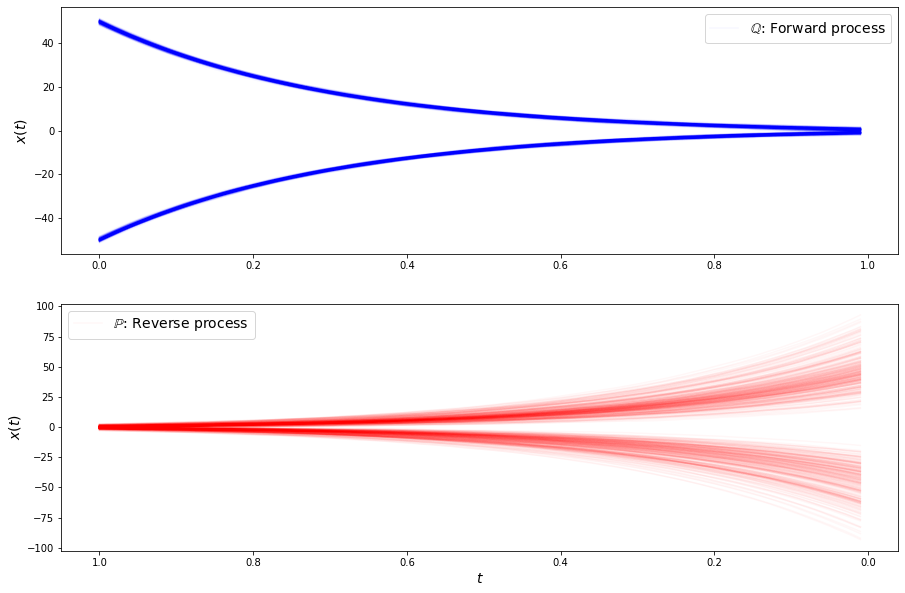

loss b 0.5452765226364136
loss b 0.589471161365509
loss b 0.6626637578010559
loss b 0.6061186194419861
loss b 0.6029959917068481
loss b 0.6271646618843079
loss b 0.5722673535346985
loss b 0.5724995136260986
loss b 0.5836225152015686
loss b 0.6112571954727173
loss b 0.6029888987541199
loss b 0.638982355594635
loss b 0.5325857996940613
loss b 0.6737574338912964
loss b 0.5921440124511719
loss b 0.6218610405921936
loss b 0.5872120261192322
loss b 0.6128982305526733
loss b 0.5896781086921692
loss b 0.5851896405220032
loss b 0.5790203809738159
loss b 0.5582529902458191
loss f 3.420652151107788
loss f 3.425154447555542
loss f 3.432093381881714
loss f 3.4044830799102783
loss f 3.432105541229248
loss f 3.4224650859832764
loss f 3.445465087890625
loss f 3.4085614681243896
loss f 3.4607105255126953
loss f 3.426851511001587
loss f 3.445700168609619
loss f 3.4382729530334473
loss f 3.4564146995544434
loss f 3.416741132736206
loss f 3.4163174629211426
loss f 3.4113614559173584
loss f 3.4043693542480

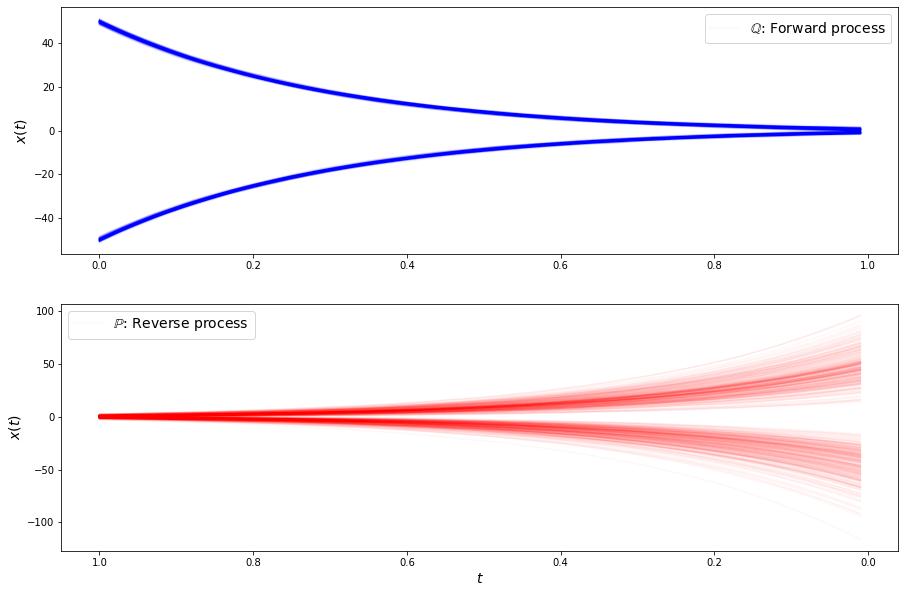

loss b 0.6530519127845764
loss b 0.7083445191383362
loss b 0.6205191016197205
loss b 0.6913108825683594
loss b 0.5864533185958862
loss b 0.619390606880188
loss b 0.6365329027175903
loss b 0.5988518595695496
loss b 0.5615573525428772
loss b 0.5482212901115417
loss b 0.5853872895240784
loss b 0.630045473575592
loss b 0.5987480282783508
loss b 0.6725431680679321
loss b 0.6189489364624023
loss b 0.6046435236930847
loss b 0.6802302598953247
loss b 0.684546947479248
loss b 0.6137628555297852
loss b 0.6610360145568848
loss b 0.6036203503608704
loss b 0.5602260231971741
loss f 3.4067487716674805
loss f 3.381967067718506
loss f 3.4294865131378174
loss f 3.440091133117676
loss f 3.433434009552002
loss f 3.4427530765533447
loss f 3.386725664138794
loss f 3.4168784618377686
loss f 3.4263861179351807
loss f 3.411065101623535
loss f 3.430299997329712
loss f 3.4157755374908447
loss f 3.421513080596924
loss f 3.420532464981079
loss f 3.4476985931396484
loss f 3.3828909397125244
loss f 3.47166490554809

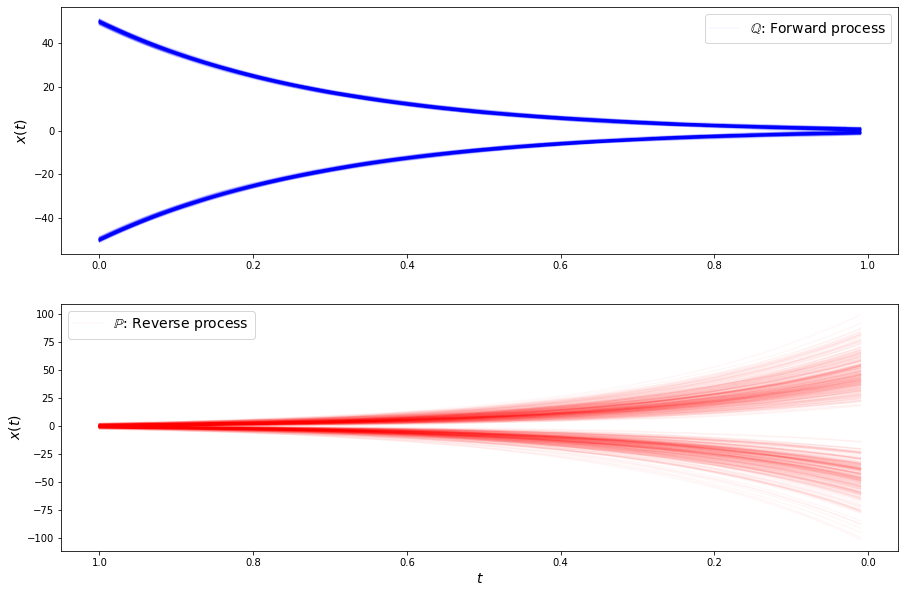

loss b 0.633466362953186
loss b 0.5657929182052612
loss b 0.5254855155944824
loss b 0.6447571516036987
loss b 0.6610756516456604
loss b 0.6232229471206665
loss b 0.5640300512313843
loss b 0.6421955227851868
loss b 0.6508159637451172
loss b 0.6327022910118103
loss b 0.6346625089645386
loss b 0.6059367656707764
loss b 0.5168184041976929
loss b 0.5542176365852356
loss b 0.725918710231781
loss b 0.5943027138710022
loss b 0.6715814471244812
loss b 0.6151294708251953
loss b 0.5990775227546692
loss b 0.6824528574943542
loss b 0.5453428626060486
loss b 0.6484346389770508
loss f 3.4173998832702637
loss f 3.3914403915405273
loss f 3.4072158336639404
loss f 3.4188029766082764
loss f 3.420971155166626
loss f 3.4578235149383545
loss f 3.43354868888855
loss f 3.414341688156128
loss f 3.4163174629211426
loss f 3.424916982650757
loss f 3.40556001663208
loss f 3.417609453201294
loss f 3.4036810398101807
loss f 3.4324557781219482
loss f 3.409715414047241
loss f 3.428968906402588
loss f 3.413990020751953

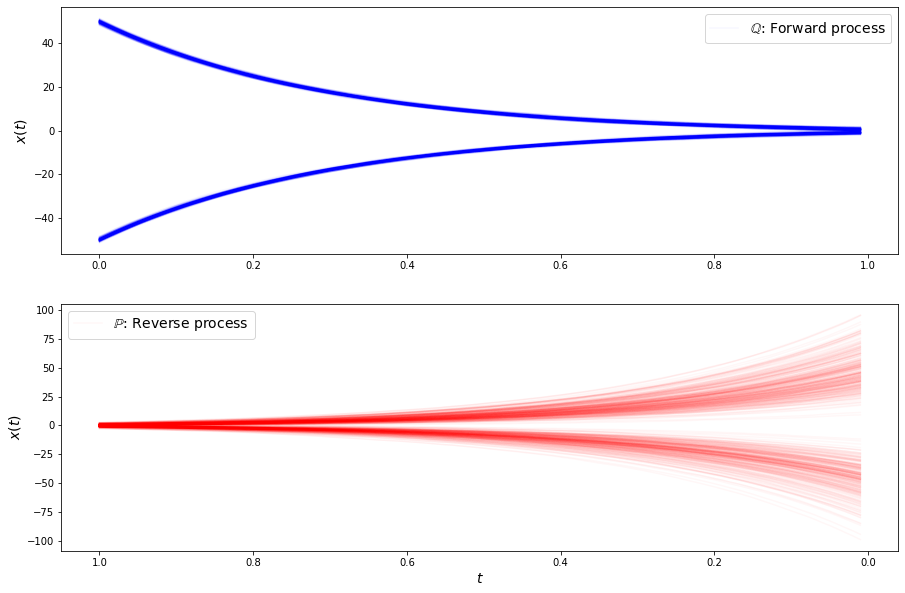

loss b 0.682262122631073
loss b 0.6109492778778076
loss b 0.6151285767555237
loss b 0.6136102080345154
loss b 0.5756058692932129
loss b 0.6132106184959412
loss b 0.5826135277748108
loss b 0.5623272061347961
loss b 0.7276097536087036
loss b 0.6989293694496155
loss b 0.6720070838928223
loss b 0.5898527503013611
loss b 0.5682379007339478
loss b 0.5785230994224548
loss b 0.6612566113471985
loss b 0.5575656294822693
loss b 0.563813328742981
loss b 0.5880522131919861
loss b 0.6205967664718628
loss b 0.6617668867111206
loss b 0.6459910869598389
loss b 0.6028158664703369
loss f 3.4029855728149414
loss f 3.4426519870758057
loss f 3.4310779571533203
loss f 3.4515225887298584
loss f 3.3901100158691406
loss f 3.417448043823242
loss f 3.406991481781006
loss f 3.423271417617798
loss f 3.4178669452667236
loss f 3.40824294090271
loss f 3.4282305240631104
loss f 3.4171698093414307
loss f 3.41090989112854
loss f 3.42751145362854
loss f 3.399555206298828
loss f 3.4145665168762207
loss f 3.419775247573852

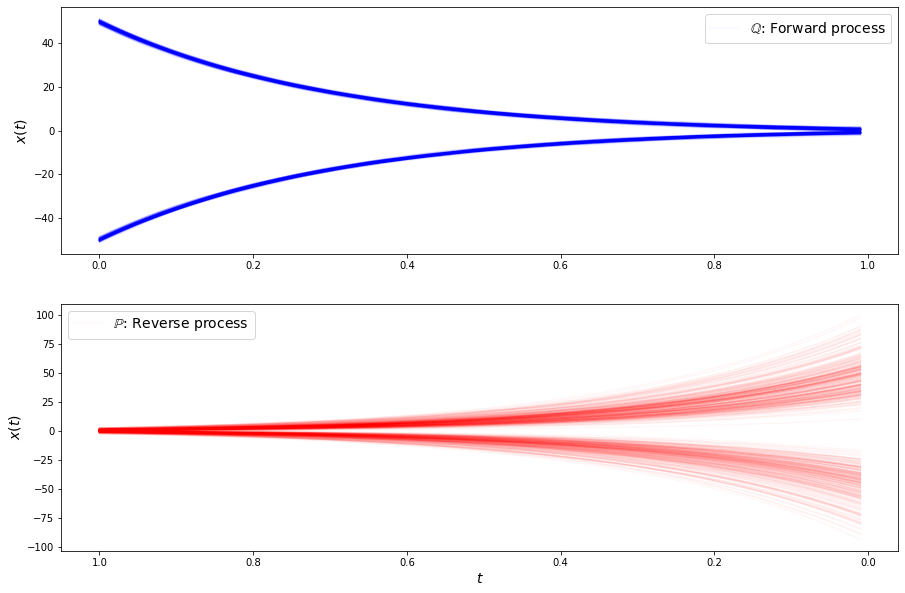

loss b 0.5549713969230652
loss b 0.6053124666213989
loss b 0.6061767339706421
loss b 0.6403043270111084
loss b 0.6265782117843628
loss b 0.6266072392463684
loss b 0.6455773711204529
loss b 0.5822650194168091
loss b 0.6433064341545105
loss b 0.5951300263404846
loss b 0.6426550149917603
loss b 0.6404076218605042
loss b 0.6551296710968018
loss b 0.6098588705062866
loss b 0.6528093218803406
loss b 0.6240165829658508
loss b 0.651276171207428
loss b 0.7114987969398499
loss b 0.6254463195800781
loss b 0.46704956889152527
loss b 0.6408992409706116
loss b 0.5869076251983643
loss f 3.409432888031006
loss f 3.3913683891296387
loss f 3.4196360111236572
loss f 3.4062652587890625
loss f 3.4296536445617676
loss f 3.4229750633239746
loss f 3.4196884632110596
loss f 3.406393051147461
loss f 3.4328572750091553
loss f 3.4193437099456787
loss f 3.423964023590088
loss f 3.4176061153411865
loss f 3.4474434852600098
loss f 3.3943417072296143
loss f 3.4019522666931152
loss f 3.3992230892181396
loss f 3.413865

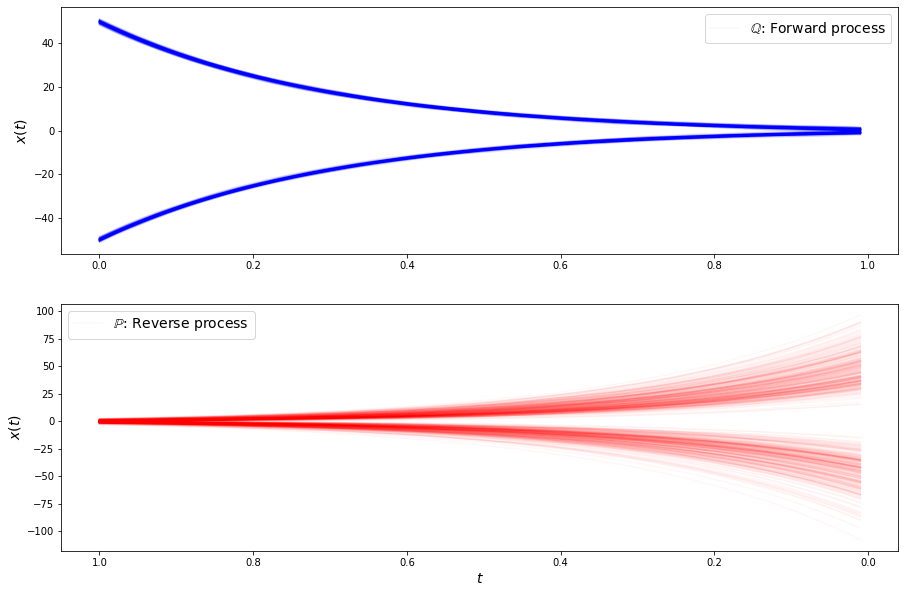

loss b 0.6679694652557373
loss b 0.7140865921974182
loss b 0.5790072083473206
loss b 0.6263933181762695
loss b 0.6366754174232483
loss b 0.6160445213317871
loss b 0.6009463667869568
loss b 0.6192676424980164
loss b 0.7094407081604004
loss b 0.6593138575553894
loss b 0.5967909097671509
loss b 0.6050444841384888
loss b 0.6106033325195312
loss b 0.5659563541412354
loss b 0.6081259846687317
loss b 0.6536317467689514
loss b 0.6334019303321838
loss b 0.6146255135536194
loss b 0.5834633111953735
loss b 0.6455435752868652
loss b 0.5369191765785217
loss b 0.5596826076507568
loss f 3.424406051635742
loss f 3.402122735977173
loss f 3.4283154010772705
loss f 3.4023165702819824
loss f 3.3989195823669434
loss f 3.4561240673065186
loss f 3.419234037399292
loss f 3.4072985649108887
loss f 3.4105610847473145
loss f 3.415008068084717
loss f 3.415083408355713
loss f 3.3927271366119385
loss f 3.4299957752227783
loss f 3.394049882888794
loss f 3.414426803588867
loss f 3.4326369762420654
loss f 3.4131400585

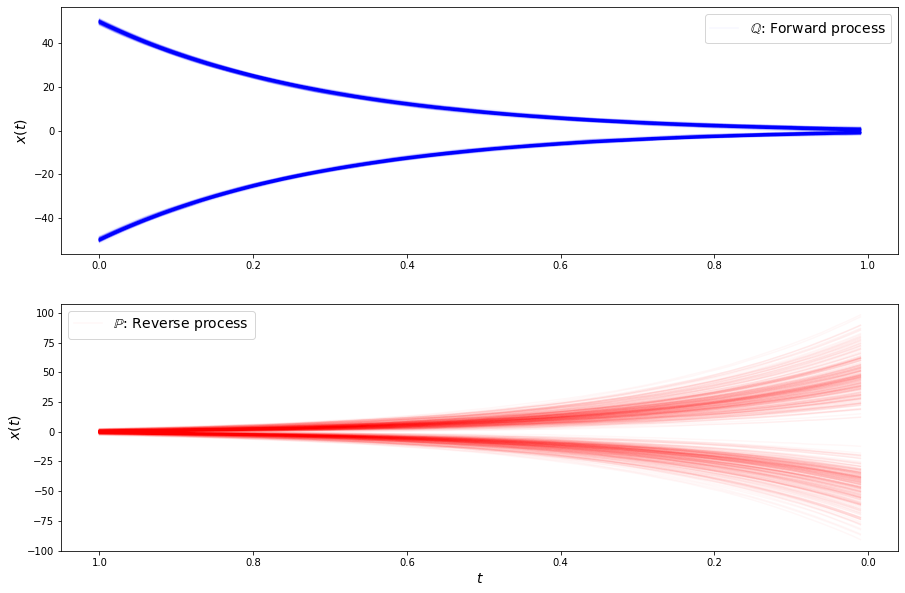

loss b 0.6694381237030029
loss b 0.6388814449310303
loss b 0.6595244407653809
loss b 0.629542887210846
loss b 0.5980136394500732
loss b 0.6619328856468201
loss b 0.6022593379020691
loss b 0.7175917625427246
loss b 0.5909831523895264
loss b 0.6990243792533875
loss b 0.6143093109130859
loss b 0.6535115838050842
loss b 0.5596152544021606
loss b 0.6128810048103333
loss b 0.6270576119422913
loss b 0.5608269572257996
loss b 0.5807914733886719
loss b 0.6228488683700562
loss b 0.6774230003356934
loss b 0.634951114654541
loss b 0.5810269713401794
loss b 0.6004785895347595
loss f 3.448761224746704
loss f 3.406911611557007
loss f 3.4101436138153076
loss f 3.4058890342712402
loss f 3.4308056831359863
loss f 3.4117236137390137
loss f 3.4243698120117188
loss f 3.418893337249756
loss f 3.417954921722412
loss f 3.4437286853790283
loss f 3.4431607723236084
loss f 3.3974814414978027
loss f 3.399019956588745
loss f 3.408243179321289
loss f 3.437831163406372
loss f 3.4086835384368896
loss f 3.420293092727

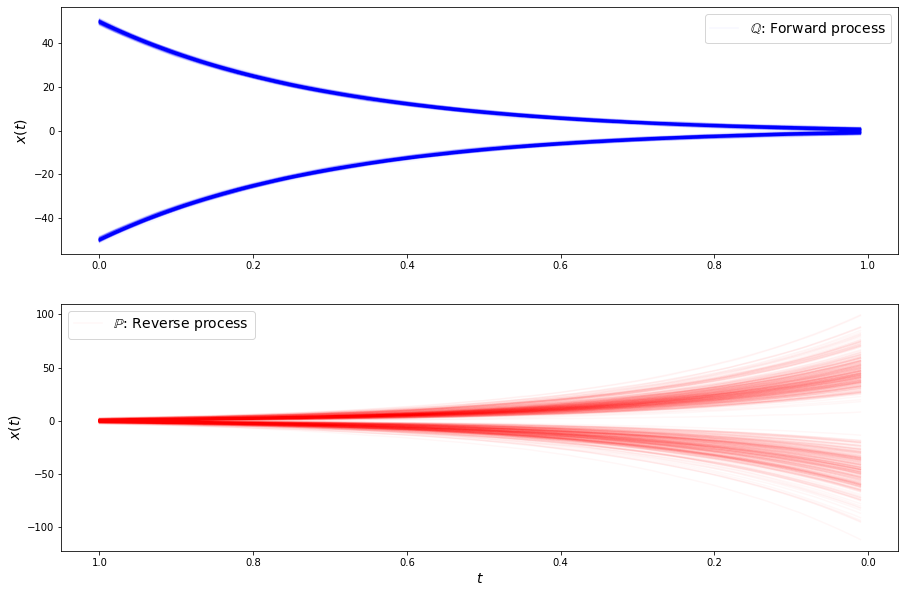

loss b 0.5073954463005066
loss b 0.6639202237129211
loss b 0.6579208374023438
loss b 0.5372291803359985
loss b 0.6089683771133423
loss b 0.5377087593078613
loss b 0.6942294836044312
loss b 0.5727631449699402
loss b 0.6511756777763367
loss b 0.5469582080841064
loss b 0.5490482449531555
loss b 0.5432313680648804
loss b 0.6378430128097534
loss b 0.6669937372207642
loss b 0.5761321187019348
loss b 0.5718984007835388
loss b 0.7161099910736084
loss b 0.6076584458351135
loss b 0.5784269571304321
loss b 0.5639858841896057
loss b 0.5935966372489929
loss b 0.58881676197052
loss f 3.4049367904663086
loss f 3.420454740524292
loss f 3.4429304599761963
loss f 3.434340715408325
loss f 3.3931634426116943
loss f 3.409069299697876
loss f 3.39565110206604
loss f 3.404022216796875
loss f 3.4560625553131104
loss f 3.4016458988189697
loss f 3.3913280963897705
loss f 3.412839889526367
loss f 3.4035696983337402
loss f 3.4010298252105713
loss f 3.40110182762146
loss f 3.390942096710205
loss f 3.413943290710449

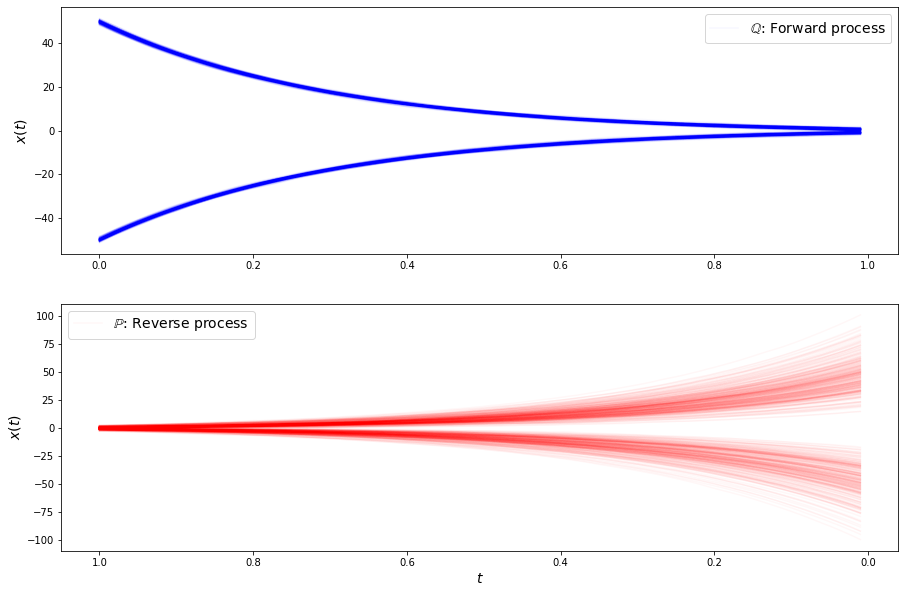

loss b 0.6099333763122559
loss b 0.639282763004303
loss b 0.7243515253067017
loss b 0.6804755330085754
loss b 0.5672557353973389
loss b 0.5963438749313354
loss b 0.6663724780082703
loss b 0.6219316124916077
loss b 0.5732380151748657
loss b 0.6936231255531311
loss b 0.5701563954353333
loss b 0.572432279586792
loss b 0.6795250177383423
loss b 0.6355453729629517
loss b 0.676698625087738
loss b 0.5644101500511169
loss b 0.5745336413383484
loss b 0.6119343638420105
loss b 0.5500488877296448
loss b 0.5405386090278625
loss b 0.6156119108200073
loss b 0.6312505006790161
loss f 3.40014910697937
loss f 3.440169334411621
loss f 3.4077916145324707
loss f 3.3968629837036133
loss f 3.408564567565918
loss f 3.3806982040405273
loss f 3.412121057510376
loss f 3.4010701179504395
loss f 3.417083263397217
loss f 3.421816349029541
loss f 3.401665449142456
loss f 3.43371844291687
loss f 3.432563304901123
loss f 3.4033589363098145
loss f 3.385741949081421
loss f 3.4092490673065186
loss f 3.3834235668182373
l

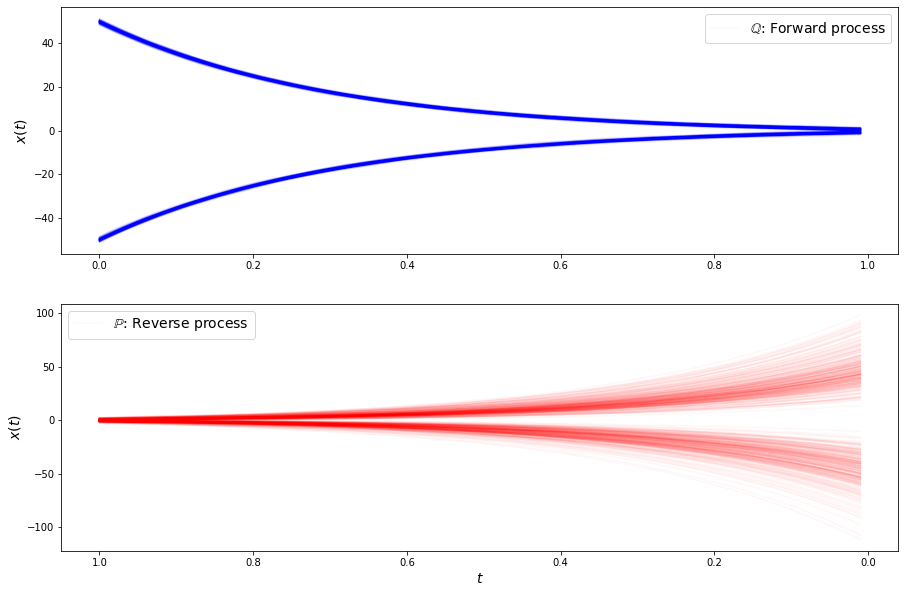

loss b 0.6702899932861328
loss b 0.5487179756164551
loss b 0.5890470147132874
loss b 0.6470929384231567
loss b 0.6060511469841003
loss b 0.5845288038253784
loss b 0.6851811408996582
loss b 0.5139796733856201
loss b 0.5776952505111694
loss b 0.5439414978027344
loss b 0.6455581784248352
loss b 0.6284741759300232
loss b 0.6538344621658325
loss b 0.6054548025131226
loss b 0.5298270583152771
loss b 0.6115177273750305
loss b 0.590042233467102
loss b 0.5912041068077087
loss b 0.6349003911018372
loss b 0.6093072295188904
loss b 0.6265997886657715
loss b 0.5738840699195862
loss f 3.404345989227295
loss f 3.401468515396118
loss f 3.380821704864502
loss f 3.4149389266967773
loss f 3.3906373977661133
loss f 3.407958507537842
loss f 3.4076461791992188
loss f 3.411088466644287
loss f 3.4014127254486084
loss f 3.404902458190918
loss f 3.417198419570923
loss f 3.401585578918457
loss f 3.4244306087493896
loss f 3.396550416946411
loss f 3.4043726921081543
loss f 3.3853819370269775
loss f 3.4213569164276

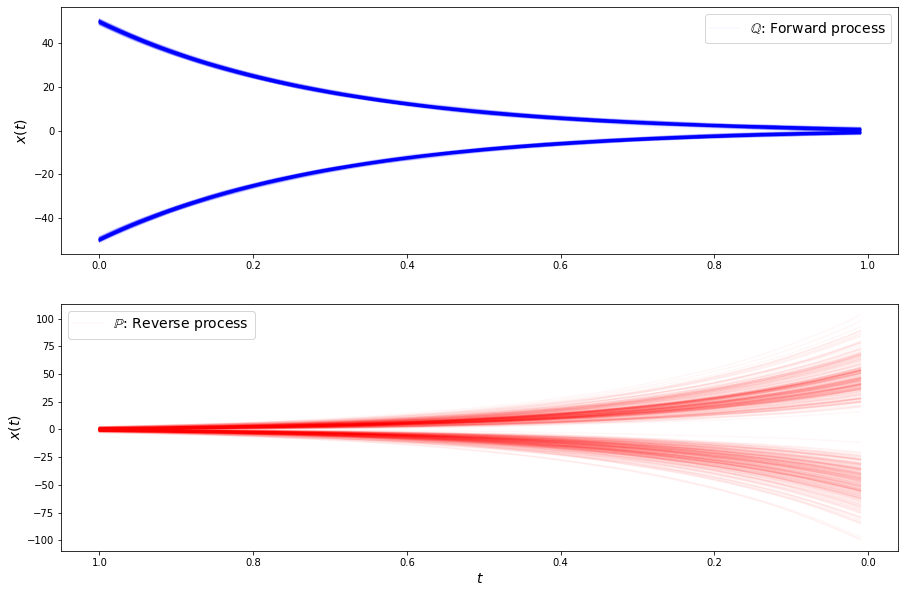

loss b 0.596458911895752
loss b 0.5647146105766296
loss b 0.6039638519287109
loss b 0.5244565010070801
loss b 0.6752462387084961
loss b 0.6701365113258362
loss b 0.5932415127754211
loss b 0.6347200870513916
loss b 0.6210634708404541
loss b 0.5894410610198975
loss b 0.6128962635993958
loss b 0.633188009262085
loss b 0.6669897437095642
loss b 0.6132990717887878
loss b 0.5828778743743896
loss b 0.6064101457595825
loss b 0.6132582426071167
loss b 0.6371143460273743
loss b 0.6346196532249451
loss b 0.5932444930076599
loss b 0.6790452599525452
loss b 0.6360088586807251
loss f 3.4252357482910156
loss f 3.402353525161743
loss f 3.4243226051330566
loss f 3.4070467948913574
loss f 3.388740062713623
loss f 3.4049510955810547
loss f 3.410832643508911
loss f 3.4143099784851074
loss f 3.4247589111328125
loss f 3.4048051834106445
loss f 3.4202189445495605
loss f 3.3824450969696045
loss f 3.388103485107422
loss f 3.385892868041992
loss f 3.4216725826263428
loss f 3.4259283542633057
loss f 3.4170284271

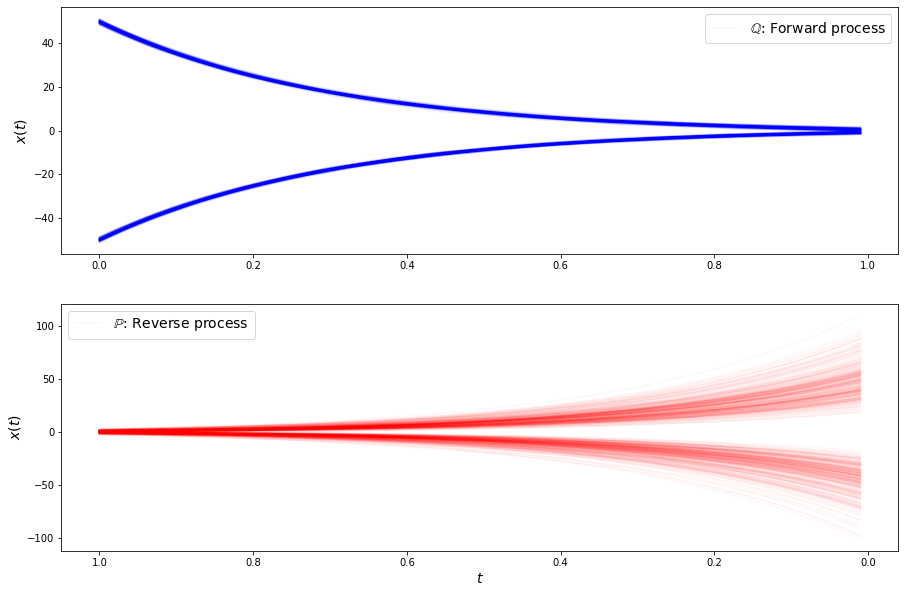

loss b 0.5313738584518433
loss b 0.6593002676963806
loss b 0.5792226195335388
loss b 0.544874370098114
loss b 0.5936076045036316
loss b 0.6873416304588318
loss b 0.5542910099029541
loss b 0.5727069973945618
loss b 0.5377535223960876
loss b 0.5651840567588806
loss b 0.6454125046730042
loss b 0.5558120608329773
loss b 0.6320180892944336
loss b 0.580809473991394
loss b 0.6207591891288757
loss b 0.581550121307373
loss b 0.6064838171005249
loss b 0.6277328133583069
loss b 0.6022707223892212
loss b 0.5382278561592102
loss b 0.544176459312439
loss b 0.437908411026001
loss f 3.409602403640747
loss f 3.4055685997009277
loss f 3.3762965202331543
loss f 3.4118077754974365
loss f 3.3853814601898193
loss f 3.3978567123413086
loss f 3.3868215084075928
loss f 3.3870723247528076
loss f 3.414015531539917
loss f 3.3827006816864014
loss f 3.412221908569336
loss f 3.4008913040161133
loss f 3.412691354751587
loss f 3.4049320220947266
loss f 3.4121949672698975
loss f 3.404998302459717
loss f 3.4149098396301

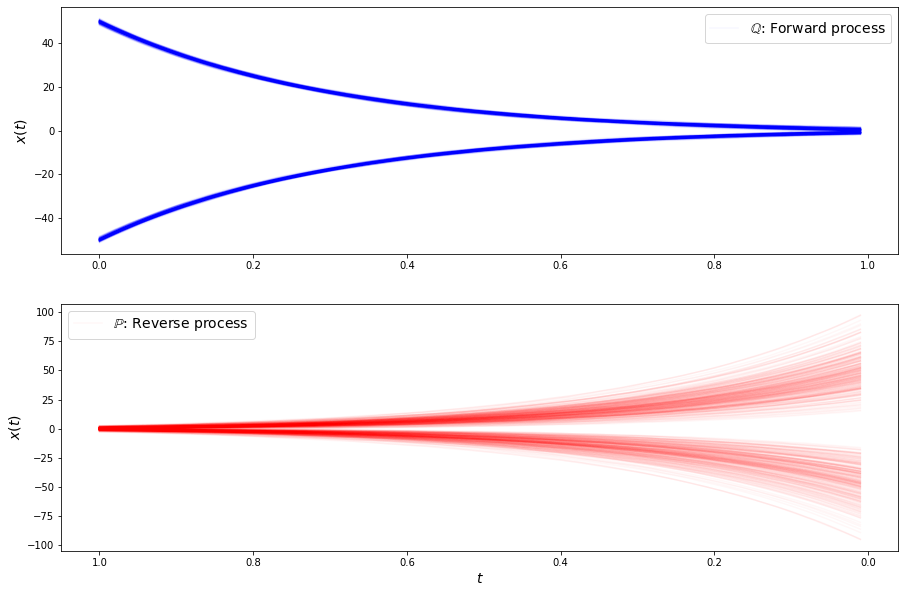

loss b 0.5629896521568298
loss b 0.6249365210533142
loss b 0.5709854960441589
loss b 0.5988529920578003
loss b 0.5356726050376892
loss b 0.5358914732933044
loss b 0.6083448529243469
loss b 0.6242853999137878
loss b 0.5528575778007507
loss b 0.5750992298126221
loss b 0.5738903284072876
loss b 0.6383901238441467
loss b 0.5502429604530334
loss b 0.5954195261001587
loss b 0.6606923937797546
loss b 0.5995627641677856
loss b 0.6722558736801147
loss b 0.6517515182495117
loss b 0.6384017467498779
loss b 0.5346682667732239
loss b 0.5304102301597595
loss b 0.5183427333831787
loss f 3.410303831100464
loss f 3.4107348918914795
loss f 3.4045395851135254
loss f 3.4186155796051025
loss f 3.413459062576294
loss f 3.4100263118743896
loss f 3.3838798999786377
loss f 3.4124770164489746
loss f 3.4034531116485596
loss f 3.3941404819488525
loss f 3.4020674228668213
loss f 3.4057905673980713
loss f 3.3895576000213623
loss f 3.392925500869751
loss f 3.3843913078308105
loss f 3.387899398803711
loss f 3.3875219

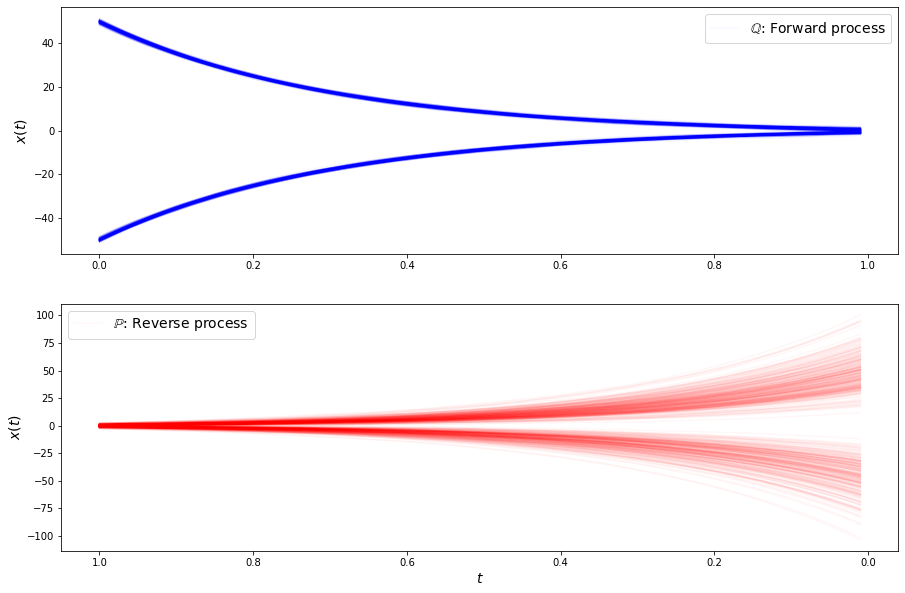

loss b 0.5600023865699768
loss b 0.5793538689613342
loss b 0.6006492376327515
loss b 0.5968689918518066
loss b 0.6354736089706421
loss b 0.5241574048995972
loss b 0.5595128536224365
loss b 0.6445132493972778
loss b 0.5944874882698059
loss b 0.5191762447357178
loss b 0.5386923551559448
loss b 0.5756111741065979
loss b 0.542496383190155
loss b 0.5717277526855469
loss b 0.6050729155540466
loss b 0.6831848621368408
loss b 0.5542932152748108
loss b 0.5003195405006409
loss b 0.5472137928009033
loss b 0.543743371963501
loss b 0.6171730160713196
loss b 0.5762926936149597
loss f 3.430880546569824
loss f 3.39922833442688
loss f 3.4135518074035645
loss f 3.4154558181762695
loss f 3.404715061187744
loss f 3.390794515609741
loss f 3.4279723167419434
loss f 3.392982006072998
loss f 3.3965518474578857
loss f 3.4196674823760986
loss f 3.401209831237793
loss f 3.4113404750823975
loss f 3.3747611045837402
loss f 3.4020509719848633
loss f 3.4153337478637695
loss f 3.3856918811798096
loss f 3.406858444213

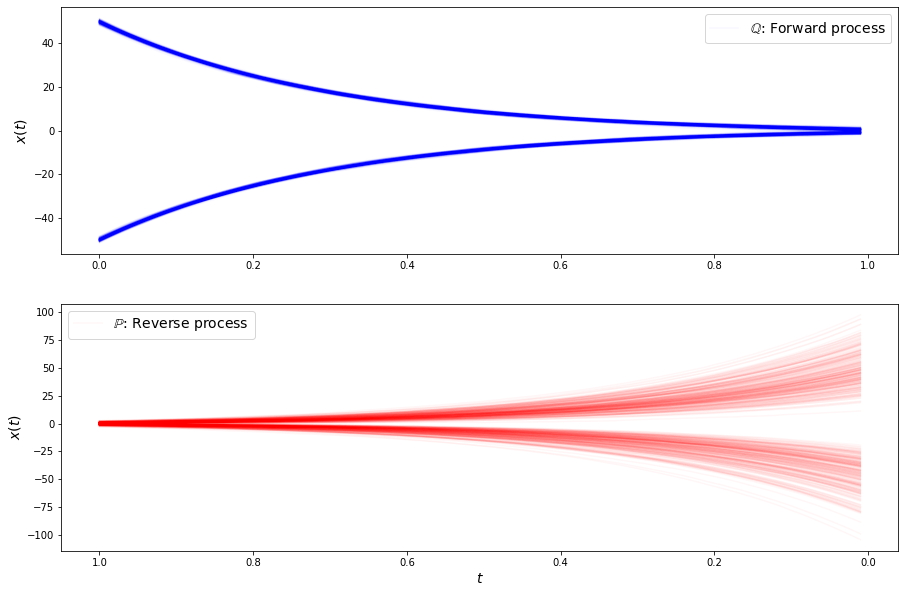

loss b 0.5907170176506042
loss b 0.6229468584060669
loss b 0.6563439965248108
loss b 0.5899561047554016
loss b 0.6900572776794434
loss b 0.66594398021698
loss b 0.5261551141738892
loss b 0.6441531181335449
loss b 0.4738914370536804
loss b 0.5670443773269653
loss b 0.6543277502059937
loss b 0.6233980655670166
loss b 0.5722497701644897
loss b 0.6075435876846313
loss b 0.5756413340568542
loss b 0.5629674792289734
loss b 0.6337578296661377
loss b 0.5999515056610107
loss b 0.6032771468162537
loss b 0.6453030109405518
loss b 0.5082195401191711
loss b 0.5700035691261292
loss f 3.413602828979492
loss f 3.4247806072235107
loss f 3.4143311977386475
loss f 3.372851610183716
loss f 3.4129230976104736
loss f 3.367985486984253
loss f 3.3880178928375244
loss f 3.39101505279541
loss f 3.408128499984741
loss f 3.385417938232422
loss f 3.4410929679870605
loss f 3.3963515758514404
loss f 3.415395498275757
loss f 3.418894052505493
loss f 3.3804190158843994
loss f 3.3669309616088867
loss f 3.41324567794799

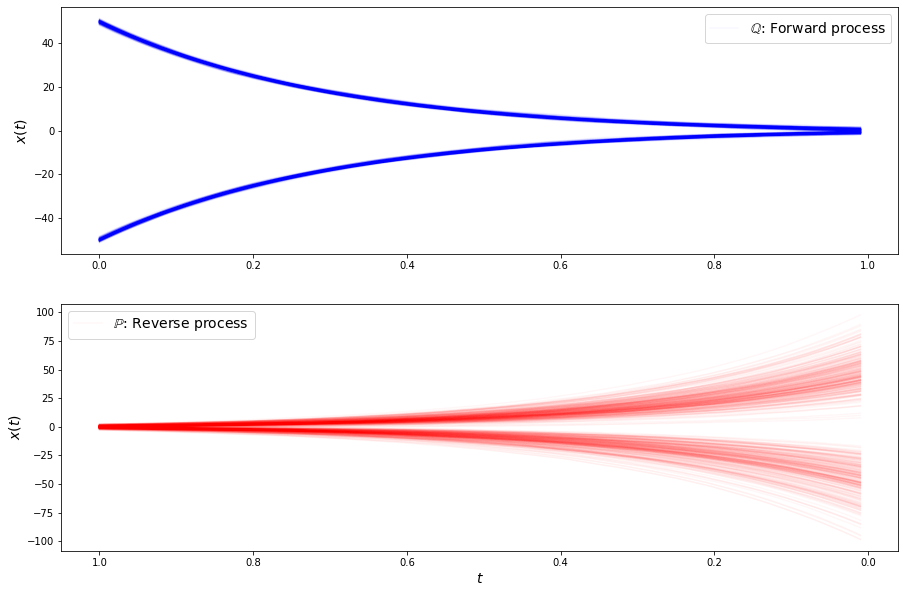

loss b 0.6252452731132507
loss b 0.5593098402023315
loss b 0.5618488788604736
loss b 0.5511149764060974
loss b 0.5734766125679016
loss b 0.6245177388191223
loss b 0.5862940549850464
loss b 0.5461678504943848
loss b 0.5554773807525635
loss b 0.5138953328132629
loss b 0.6194000244140625
loss b 0.6111584901809692
loss b 0.5648816823959351
loss b 0.5568010210990906
loss b 0.6295204162597656
loss b 0.550792932510376
loss b 0.49412819743156433
loss b 0.5427873134613037
loss b 0.580284833908081
loss b 0.5578058362007141
loss b 0.5691631436347961
loss b 0.5003669261932373
loss f 3.387826919555664
loss f 3.3920512199401855
loss f 3.3957324028015137
loss f 3.386626958847046
loss f 3.38165545463562
loss f 3.391085386276245
loss f 3.3956239223480225
loss f 3.3813319206237793
loss f 3.384056329727173
loss f 3.3880245685577393
loss f 3.4008119106292725
loss f 3.3893814086914062
loss f 3.418912887573242
loss f 3.356342315673828
loss f 3.4190149307250977
loss f 3.4099578857421875
loss f 3.353119850158

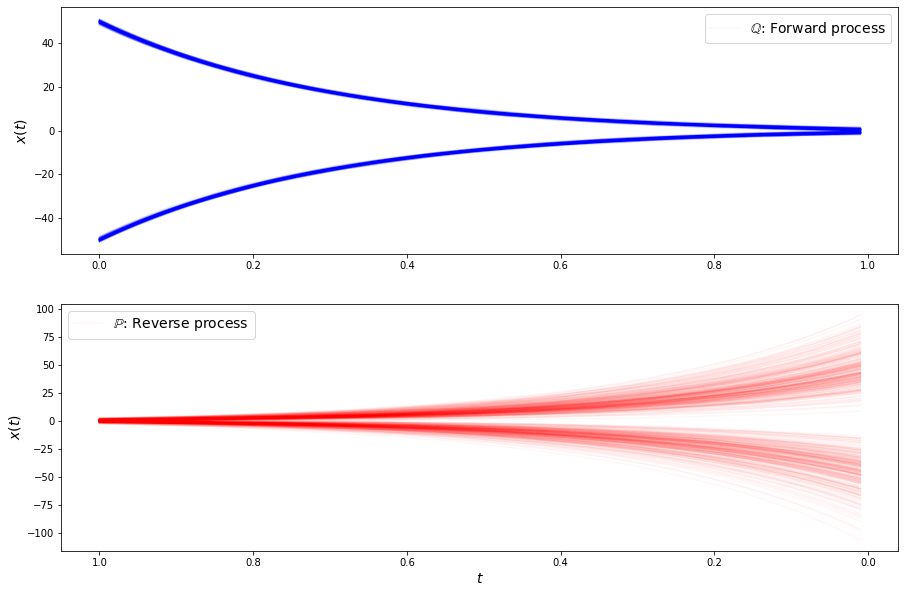

loss b 0.5615723729133606
loss b 0.562114417552948
loss b 0.620472252368927
loss b 0.6329589486122131
loss b 0.6054078340530396
loss b 0.6498420834541321
loss b 0.5313407778739929
loss b 0.6024945378303528
loss b 0.6837551593780518
loss b 0.6652188897132874
loss b 0.5311212539672852
loss b 0.5525486469268799
loss b 0.5824934840202332
loss b 0.5135009288787842
loss b 0.5327029228210449
loss b 0.5878756046295166
loss b 0.5107250809669495
loss b 0.6128553152084351
loss b 0.5827597975730896
loss b 0.6064908504486084
loss b 0.5535733699798584
loss b 0.5327545404434204
loss f 3.4150750637054443
loss f 3.3895797729492188
loss f 3.4128990173339844
loss f 3.400965690612793
loss f 3.41194486618042
loss f 3.372270107269287
loss f 3.3927059173583984
loss f 3.3947854042053223
loss f 3.351097345352173
loss f 3.3689072132110596
loss f 3.3780393600463867
loss f 3.3740060329437256
loss f 3.396984100341797
loss f 3.381068706512451
loss f 3.351588487625122
loss f 3.3713185787200928
loss f 3.4091498851776

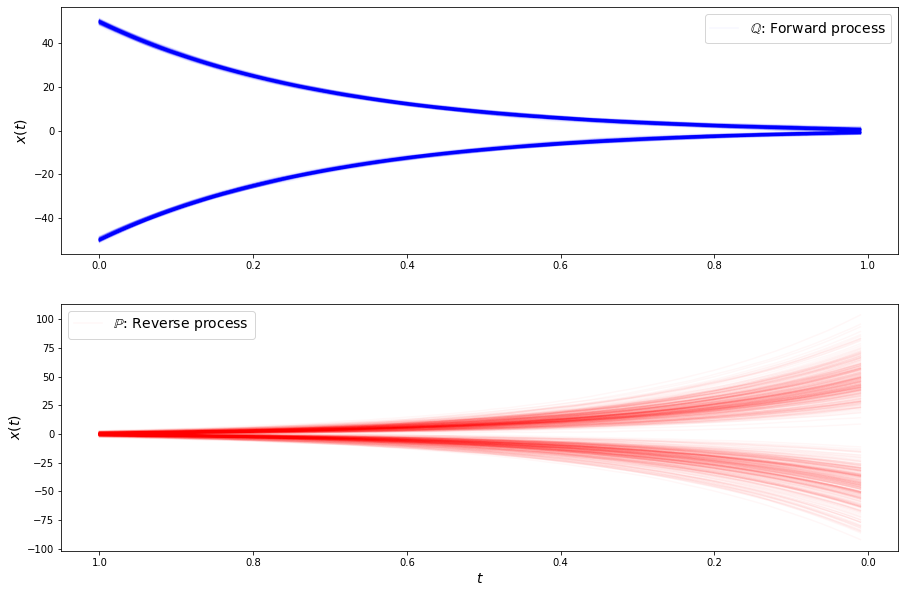

loss b 0.5934184789657593
loss b 0.6464366316795349
loss b 0.5810273885726929
loss b 0.6419572234153748
loss b 0.6595239043235779
loss b 0.5785417556762695
loss b 0.5869724750518799
loss b 0.6086678504943848
loss b 0.6897552013397217
loss b 0.5927854180335999
loss b 0.5190049409866333
loss b 0.5185665488243103
loss b 0.5835472345352173
loss b 0.5999684929847717
loss b 0.4920845329761505
loss b 0.5298300385475159
loss b 0.5998401045799255
loss b 0.5871443152427673
loss b 0.6074707508087158
loss b 0.5962905287742615
loss b 0.6034238338470459
loss b 0.5602471232414246
loss f 3.378835916519165
loss f 3.3969225883483887
loss f 3.3904292583465576
loss f 3.391911029815674
loss f 3.3887293338775635
loss f 3.415203809738159
loss f 3.390012741088867
loss f 3.367837905883789
loss f 3.3907010555267334
loss f 3.398573398590088
loss f 3.376809597015381
loss f 3.359286069869995
loss f 3.4161794185638428
loss f 3.3769333362579346
loss f 3.379629611968994
loss f 3.406242847442627
loss f 3.3896570205688

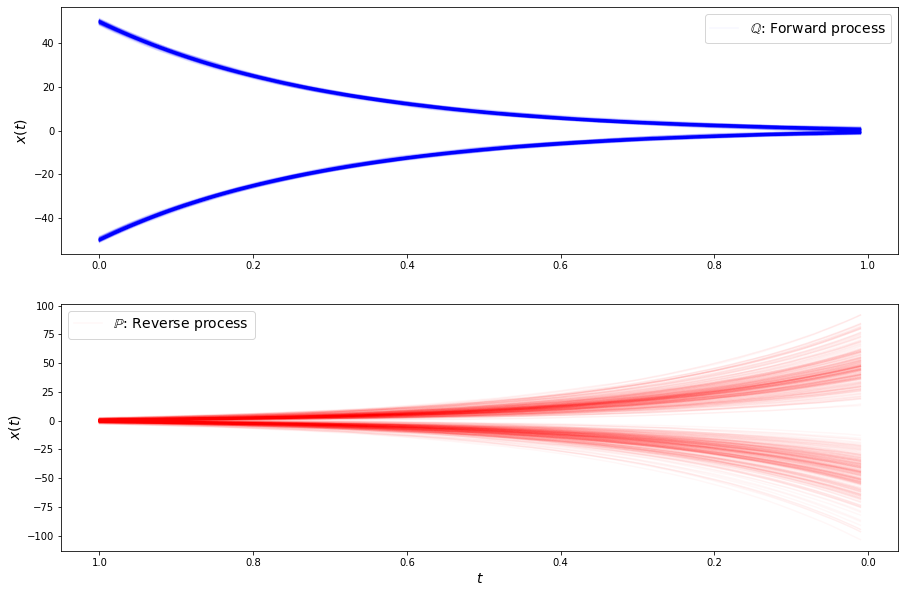

loss b 0.5648894309997559
loss b 0.595196008682251
loss b 0.6140305995941162
loss b 0.5921999216079712
loss b 0.6668499708175659
loss b 0.5710633993148804
loss b 0.5516067743301392
loss b 0.4918350577354431
loss b 0.5346857309341431
loss b 0.5337914228439331
loss b 0.548069179058075
loss b 0.5313959717750549
loss b 0.6679608225822449
loss b 0.6361715793609619
loss b 0.626851499080658
loss b 0.5366002917289734
loss b 0.4778931140899658
loss b 0.6537186503410339
loss b 0.6098150014877319
loss b 0.6806979179382324
loss b 0.5994049310684204
loss b 0.5717989802360535
loss f 3.4111149311065674
loss f 3.411121368408203
loss f 3.3861615657806396
loss f 3.3972268104553223
loss f 3.393718719482422
loss f 3.379892587661743
loss f 3.3979651927948
loss f 3.366879463195801
loss f 3.384763240814209
loss f 3.404642105102539
loss f 3.380401849746704
loss f 3.39967679977417
loss f 3.3932173252105713
loss f 3.4286673069000244
loss f 3.3741455078125
loss f 3.3882763385772705
loss f 3.407294511795044
loss 

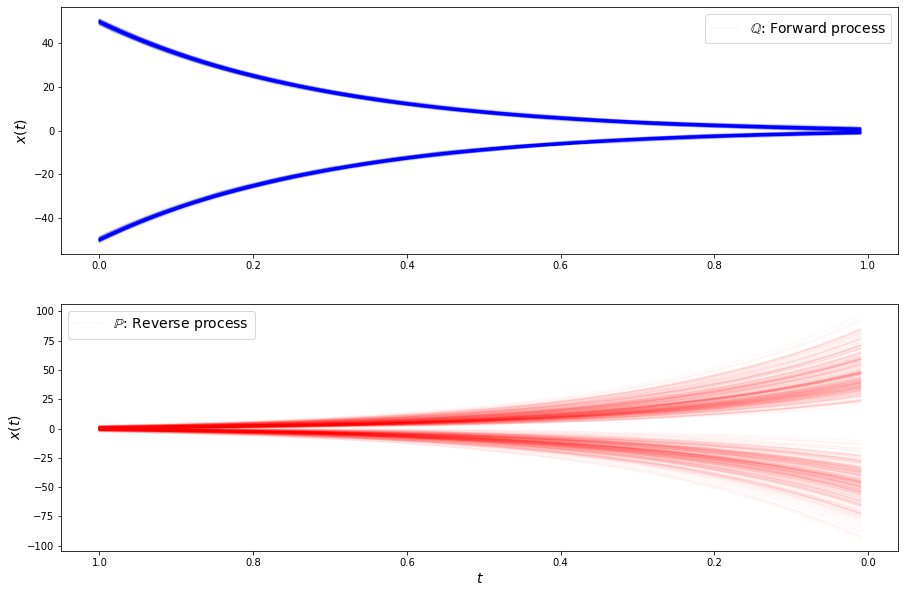

loss b 0.5015666484832764
loss b 0.643067479133606
loss b 0.46745049953460693
loss b 0.6816152930259705
loss b 0.6330660581588745
loss b 0.5990015268325806
loss b 0.5990906953811646
loss b 0.5841240882873535
loss b 0.5262560248374939
loss b 0.5467671751976013
loss b 0.6584093570709229
loss b 0.5525810122489929
loss b 0.5522612929344177
loss b 0.6579253673553467
loss b 0.6723476052284241
loss b 0.5936151742935181
loss b 0.618664562702179
loss b 0.5459430813789368
loss b 0.5543225407600403
loss b 0.5519891977310181
loss b 0.6448544263839722
loss b 0.5436557531356812
loss f 3.389957904815674
loss f 3.3909008502960205
loss f 3.398059368133545
loss f 3.3963406085968018
loss f 3.4324193000793457
loss f 3.386678457260132
loss f 3.3810946941375732
loss f 3.3985748291015625
loss f 3.414053201675415
loss f 3.404440402984619
loss f 3.3899331092834473
loss f 3.4139790534973145
loss f 3.3892569541931152
loss f 3.40362548828125
loss f 3.380901575088501
loss f 3.4003405570983887
loss f 3.393663406372

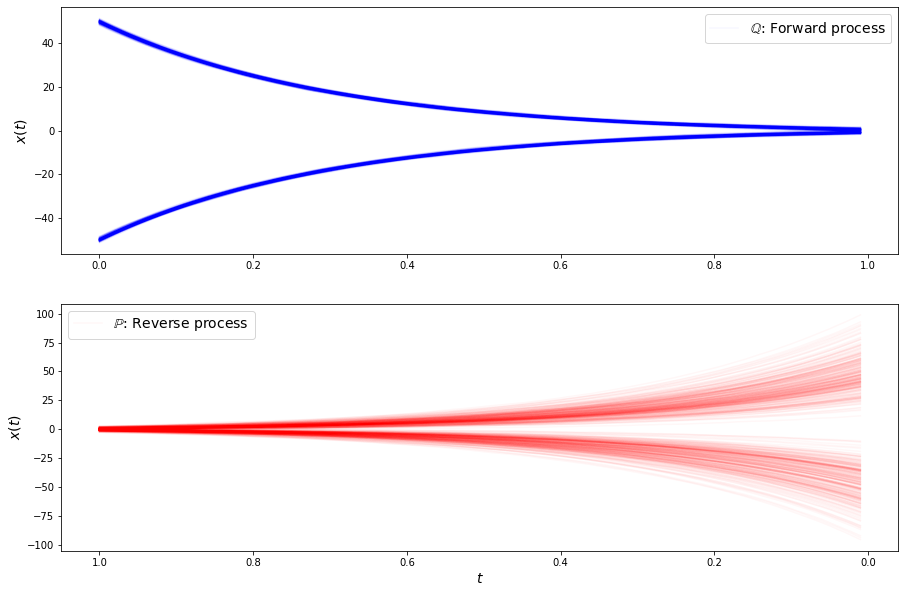

loss b 0.6792680025100708
loss b 0.5335776209831238
loss b 0.5365555286407471
loss b 0.5888538956642151
loss b 0.6401559710502625
loss b 0.6142371296882629
loss b 0.507392168045044
loss b 0.5557745099067688
loss b 0.551651120185852
loss b 0.5736478567123413
loss b 0.5534666180610657
loss b 0.5867094993591309
loss b 0.5854935050010681
loss b 0.4881962537765503
loss b 0.614965558052063
loss b 0.6401717662811279
loss b 0.5545424818992615
loss b 0.5827312469482422
loss b 0.6700509786605835
loss b 0.5770494937896729
loss b 0.530328631401062
loss b 0.5674497485160828
loss f 3.379582405090332
loss f 3.3855550289154053
loss f 3.4012954235076904
loss f 3.393152952194214
loss f 3.402299404144287
loss f 3.393120527267456
loss f 3.401348114013672
loss f 3.395385503768921
loss f 3.399341344833374
loss f 3.3925230503082275
loss f 3.387032985687256
loss f 3.402245044708252
loss f 3.3940608501434326
loss f 3.389803886413574
loss f 3.3801074028015137
loss f 3.386322259902954
loss f 3.4262168407440186
l

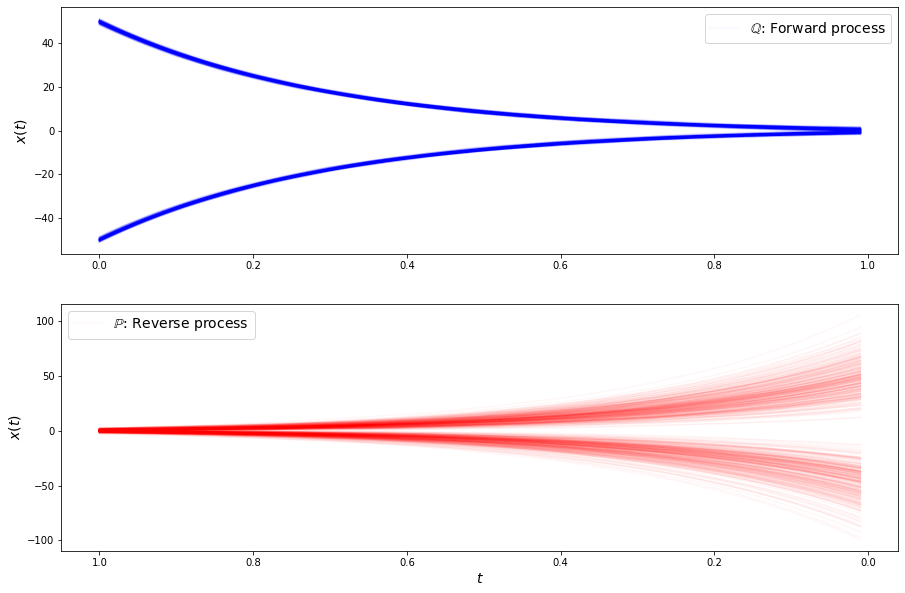

loss b 0.6016903519630432
loss b 0.6255959868431091
loss b 0.649853527545929
loss b 0.6473655700683594
loss b 0.5923773050308228
loss b 0.5622338056564331
loss b 0.5878413319587708
loss b 0.5539180636405945
loss b 0.5732548236846924
loss b 0.6205293536186218
loss b 0.540212869644165
loss b 0.6307722330093384
loss b 0.6267246007919312
loss b 0.5640816688537598
loss b 0.5906383991241455
loss b 0.473029226064682
loss b 0.4979844391345978
loss b 0.648068368434906
loss b 0.6020427942276001
loss b 0.566680371761322
loss b 0.6245779395103455
loss b 0.5195614099502563
loss f 3.3938674926757812
loss f 3.4110820293426514
loss f 3.4039595127105713
loss f 3.3908302783966064
loss f 3.3818914890289307
loss f 3.3886919021606445
loss f 3.3989155292510986
loss f 3.3800392150878906
loss f 3.4091715812683105
loss f 3.40541410446167
loss f 3.4019196033477783
loss f 3.387376070022583
loss f 3.388833522796631
loss f 3.3857381343841553
loss f 3.374279499053955
loss f 3.392733573913574
loss f 3.38403677940368

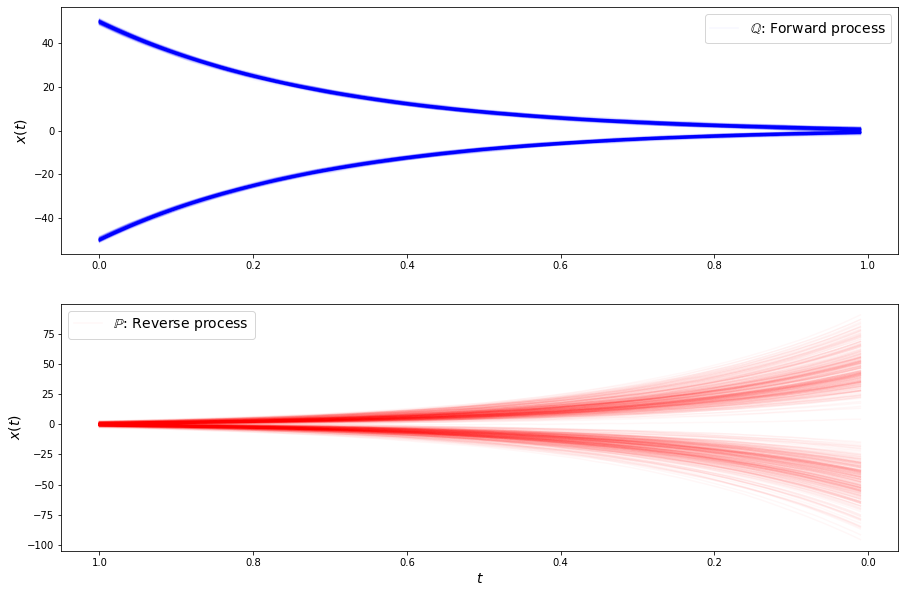

loss b 0.5687306523323059
loss b 0.6472057104110718
loss b 0.5925039649009705
loss b 0.6520643830299377
loss b 0.568389892578125
loss b 0.6753671169281006
loss b 0.6252298951148987
loss b 0.5701040625572205
loss b 0.573927104473114
loss b 0.5608668923377991
loss b 0.6552295088768005
loss b 0.6671290993690491
loss b 0.6923802495002747
loss b 0.5281431078910828
loss b 0.5561337471008301
loss b 0.5755107998847961
loss b 0.6050605773925781
loss b 0.5858320593833923
loss b 0.6442201733589172
loss b 0.6521304845809937
loss b 0.5761446356773376
loss b 0.6176087260246277
loss f 3.388631582260132
loss f 3.3764705657958984
loss f 3.3713059425354004
loss f 3.3975274562835693
loss f 3.3898110389709473
loss f 3.3640830516815186
loss f 3.4055497646331787
loss f 3.3726065158843994
loss f 3.3987536430358887
loss f 3.370187282562256
loss f 3.3936405181884766
loss f 3.388993978500366
loss f 3.4028921127319336
loss f 3.3991329669952393
loss f 3.3930370807647705
loss f 3.4033305644989014
loss f 3.39116454

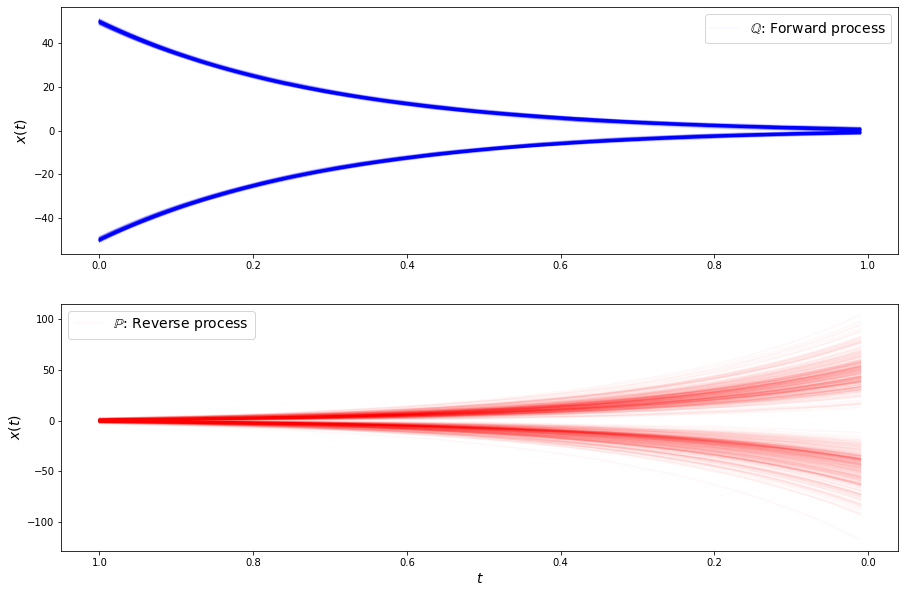

loss b 0.6377815008163452
loss b 0.6009036302566528
loss b 0.502352774143219
loss b 0.633756160736084
loss b 0.5799852609634399
loss b 0.6350076198577881
loss b 0.6239243745803833
loss b 0.5818656086921692
loss b 0.5936833024024963
loss b 0.5678969621658325
loss b 0.5784928202629089
loss b 0.6100133657455444
loss b 0.5128357410430908
loss b 0.5113571882247925
loss b 0.5716162323951721
loss b 0.5900100469589233
loss b 0.675851047039032
loss b 0.6056999564170837
loss b 0.6240569949150085
loss b 0.594666600227356
loss b 0.5132506489753723
loss b 0.5926834940910339
loss f 3.3865745067596436
loss f 3.369164228439331
loss f 3.3702878952026367
loss f 3.4186789989471436
loss f 3.3701059818267822
loss f 3.392878770828247
loss f 3.386967658996582
loss f 3.378471612930298
loss f 3.3966064453125
loss f 3.40118145942688
loss f 3.3651816844940186
loss f 3.3812358379364014
loss f 3.3779590129852295
loss f 3.4056193828582764
loss f 3.408540964126587
loss f 3.3898439407348633
loss f 3.387960910797119
l

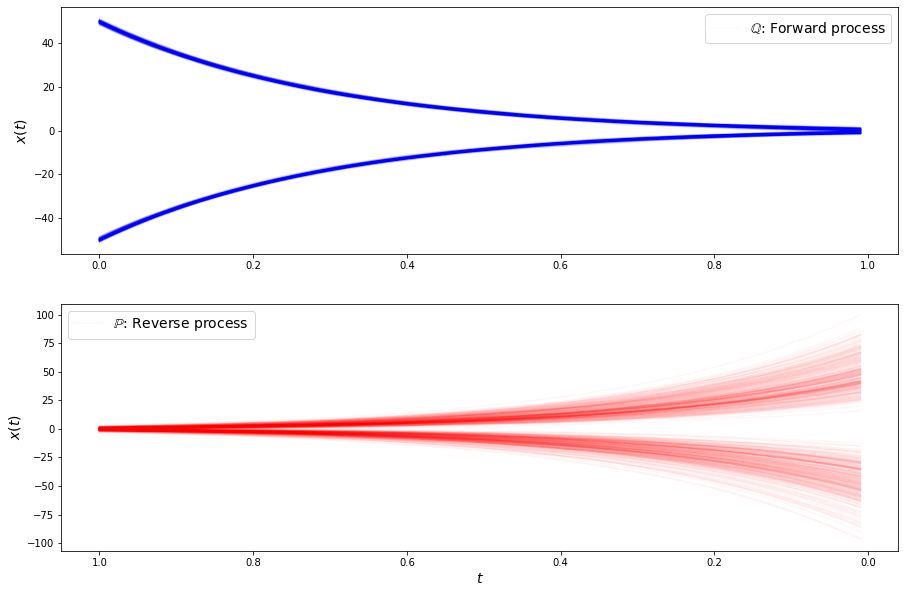

loss b 0.642096996307373
loss b 0.6227620244026184
loss b 0.6492781043052673
loss b 0.6177805662155151
loss b 0.6339332461357117
loss b 0.5862131714820862
loss b 0.6733141541481018
loss b 0.47135353088378906
loss b 0.5149837732315063
loss b 0.6159258484840393
loss b 0.600763738155365
loss b 0.688024640083313
loss b 0.5070178508758545
loss b 0.5453461408615112
loss b 0.5973085165023804
loss b 0.6201301217079163
loss b 0.6262805461883545
loss b 0.5376361012458801
loss b 0.5227560997009277
loss b 0.5676630735397339
loss b 0.6300840973854065
loss b 0.6746881008148193
loss f 3.4088900089263916
loss f 3.381791114807129
loss f 3.3761489391326904
loss f 3.3677895069122314
loss f 3.3832757472991943
loss f 3.3855063915252686
loss f 3.329871416091919
loss f 3.364933967590332
loss f 3.3896987438201904
loss f 3.3828439712524414
loss f 3.381624460220337
loss f 3.3994204998016357
loss f 3.403954267501831
loss f 3.389385938644409
loss f 3.3760969638824463
loss f 3.3891441822052
loss f 3.38272285461425

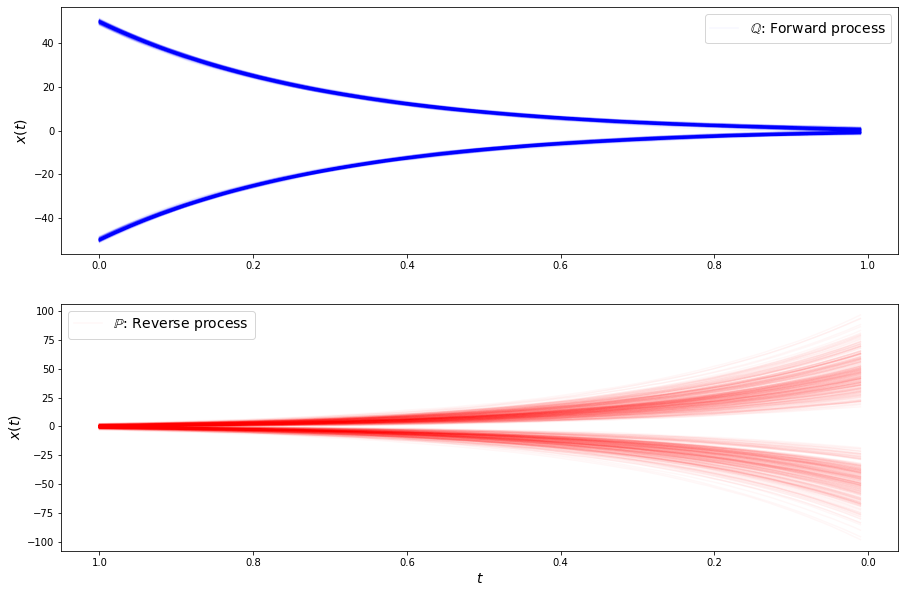

loss b 0.7064664959907532
loss b 0.7773779034614563
loss b 0.8212562203407288
loss b 0.589249312877655
loss b 0.6597378253936768
loss b 0.6537888646125793
loss b 0.6336923837661743
loss b 0.588018000125885
loss b 0.6616343259811401
loss b 0.667201042175293
loss b 0.6187372207641602
loss b 0.5075753331184387
loss b 0.6860430240631104
loss b 0.6621573567390442
loss b 0.6912760138511658
loss b 0.6853826642036438
loss b 0.7169503569602966
loss b 0.683353841304779
loss b 0.6036984920501709
loss b 0.6651951670646667
loss b 0.5593225955963135
loss b 0.6492902636528015
loss f 3.419905424118042
loss f 3.408565044403076
loss f 3.417800188064575
loss f 3.4376308917999268
loss f 3.4023280143737793
loss f 3.419248104095459
loss f 3.4246859550476074
loss f 3.4374639987945557
loss f 3.4099085330963135
loss f 3.4014339447021484
loss f 3.4230151176452637
loss f 3.389923572540283
loss f 3.421009063720703
loss f 3.4186739921569824
loss f 3.4018404483795166
loss f 3.3872251510620117
loss f 3.3831579685211

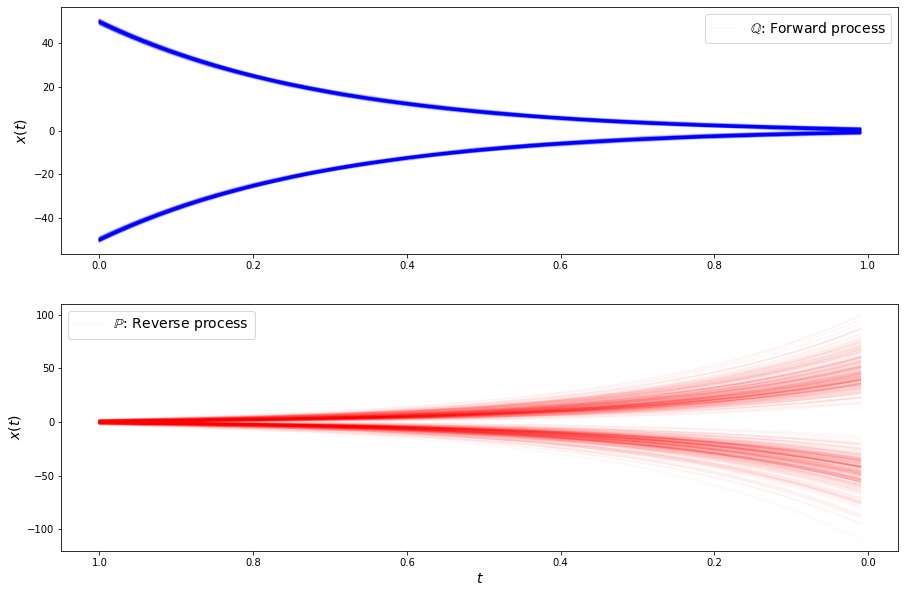

loss b 0.5764378905296326
loss b 0.6537177562713623
loss b 0.7413243651390076
loss b 0.5772606134414673
loss b 0.547171950340271
loss b 0.5820174813270569
loss b 0.60630202293396
loss b 0.6772299408912659
loss b 0.5736604332923889
loss b 0.5520039796829224
loss b 0.7117275595664978
loss b 0.5908162593841553
loss b 0.6070729494094849
loss b 0.5963135957717896
loss b 0.5461156368255615
loss b 0.539688766002655
loss b 0.6240638494491577
loss b 0.6118427515029907
loss b 0.6537840962409973
loss b 0.6092502474784851
loss b 0.5936629772186279
loss b 0.5890694856643677
loss f 3.405330181121826
loss f 3.4018020629882812
loss f 3.404841899871826
loss f 3.3964216709136963
loss f 3.3953304290771484
loss f 3.4127488136291504
loss f 3.391376256942749
loss f 3.3759703636169434
loss f 3.366800308227539
loss f 3.380722999572754
loss f 3.3887195587158203
loss f 3.399308443069458
loss f 3.4027984142303467
loss f 3.4136972427368164
loss f 3.380505084991455
loss f 3.404391050338745
loss f 3.424648284912109

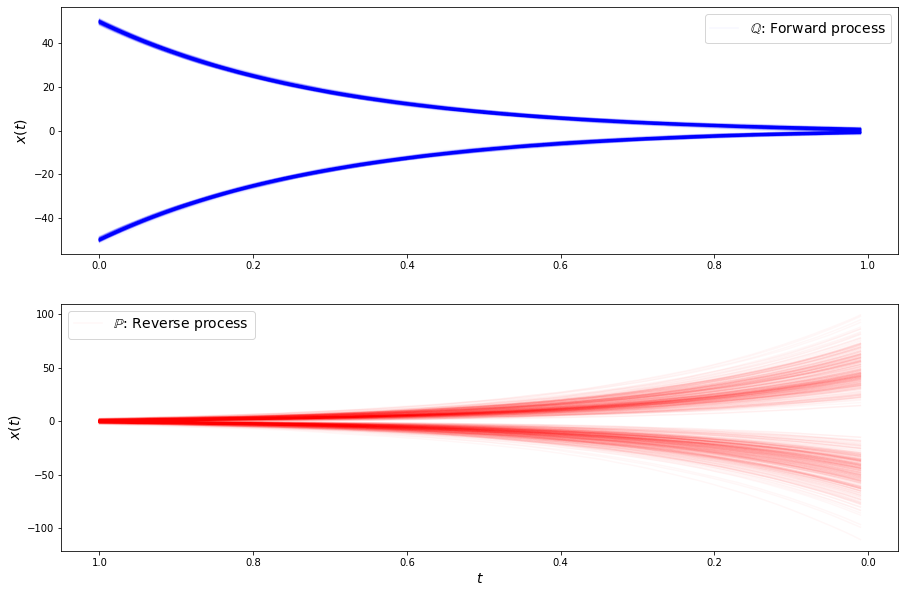

loss b 0.6656208634376526
loss b 0.6795235276222229
loss b 0.6648687720298767
loss b 0.5926766395568848
loss b 0.5832436084747314
loss b 0.6542792320251465
loss b 0.6527776718139648
loss b 0.6020413637161255
loss b 0.6652969717979431
loss b 0.6002085208892822
loss b 0.6240365505218506
loss b 0.5424299240112305
loss b 0.6356488466262817
loss b 0.5562120079994202
loss b 0.5450246334075928
loss b 0.552182137966156
loss b 0.5716671347618103
loss b 0.5729302167892456
loss b 0.6343450546264648
loss b 0.6120483875274658
loss b 0.5873302221298218
loss b 0.5971810221672058
loss f 3.3775200843811035
loss f 3.393711566925049
loss f 3.3754396438598633
loss f 3.3709664344787598
loss f 3.393533945083618
loss f 3.3909060955047607
loss f 3.3913798332214355
loss f 3.4118945598602295
loss f 3.397806406021118
loss f 3.4046690464019775
loss f 3.3946714401245117
loss f 3.3615214824676514
loss f 3.4189934730529785
loss f 3.40250825881958
loss f 3.420905351638794
loss f 3.4141249656677246
loss f 3.4167416095

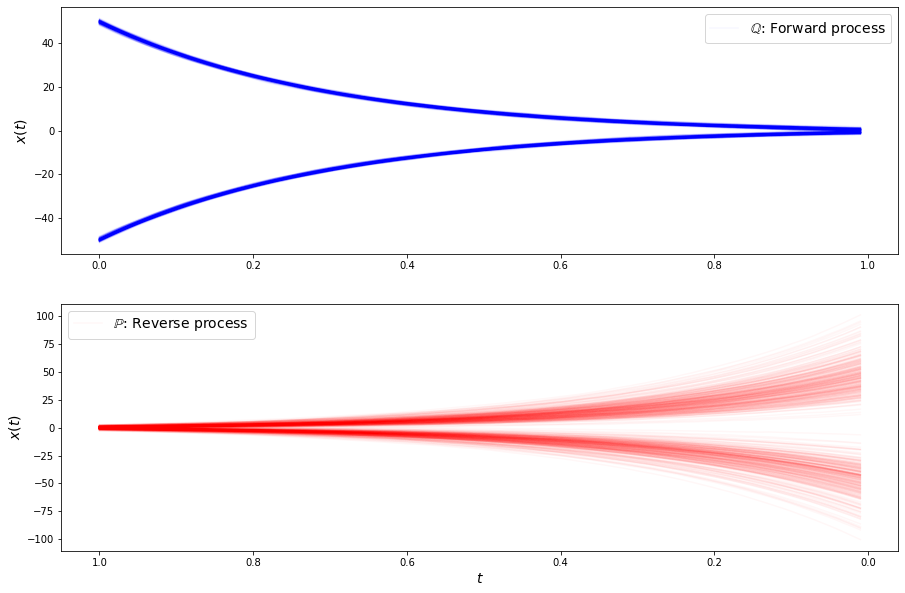

loss b 0.5235861539840698
loss b 0.6109553575515747
loss b 0.6210533976554871
loss b 0.5727437734603882
loss b 0.6315209865570068
loss b 0.6063112616539001
loss b 0.6210383772850037
loss b 0.6208136677742004
loss b 0.5755273103713989
loss b 0.6848543882369995
loss b 0.5945438742637634
loss b 0.6356303095817566
loss b 0.5810996294021606
loss b 0.6203063726425171
loss b 0.5505173802375793
loss b 0.5807633399963379
loss b 0.6271145343780518
loss b 0.640802264213562
loss b 0.5518881678581238
loss b 0.6102703809738159
loss b 0.6094530820846558
loss b 0.6143045425415039
loss f 3.397423505783081
loss f 3.358187198638916
loss f 3.3741414546966553
loss f 3.408198356628418
loss f 3.3963310718536377
loss f 3.3854384422302246
loss f 3.411202907562256
loss f 3.380314350128174
loss f 3.3885812759399414
loss f 3.370492935180664
loss f 3.38277530670166
loss f 3.3732447624206543
loss f 3.384089231491089
loss f 3.411635398864746
loss f 3.3741769790649414
loss f 3.415066957473755
loss f 3.378620386123657

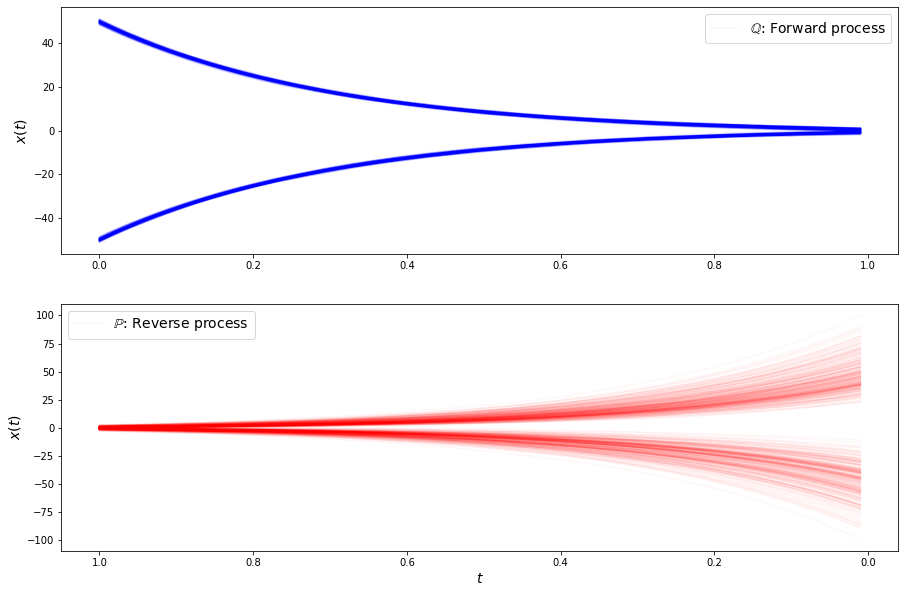

loss b 0.601554274559021
loss b 0.5330054759979248
loss b 0.6125474572181702
loss b 0.5827827453613281
loss b 0.5516803860664368
loss b 0.5926676988601685
loss b 0.6403986215591431
loss b 0.5673064589500427
loss b 0.5742596387863159
loss b 0.5768181681632996
loss b 0.6365086436271667
loss b 0.6200137734413147
loss b 0.5533885955810547
loss b 0.601361095905304
loss b 0.5615106821060181
loss b 0.6220978498458862
loss b 0.5827182531356812
loss b 0.604499101638794
loss b 0.5843580365180969
loss b 0.578557014465332
loss b 0.6326590180397034
loss b 0.6807528734207153
loss f 3.3701560497283936
loss f 3.3996880054473877
loss f 3.383174419403076
loss f 3.4017834663391113
loss f 3.36167311668396
loss f 3.3760008811950684
loss f 3.361307382583618
loss f 3.370234727859497
loss f 3.3977959156036377
loss f 3.3724262714385986
loss f 3.407898426055908
loss f 3.385507583618164
loss f 3.3973042964935303
loss f 3.372220754623413
loss f 3.366856575012207
loss f 3.4059500694274902
loss f 3.407712459564209


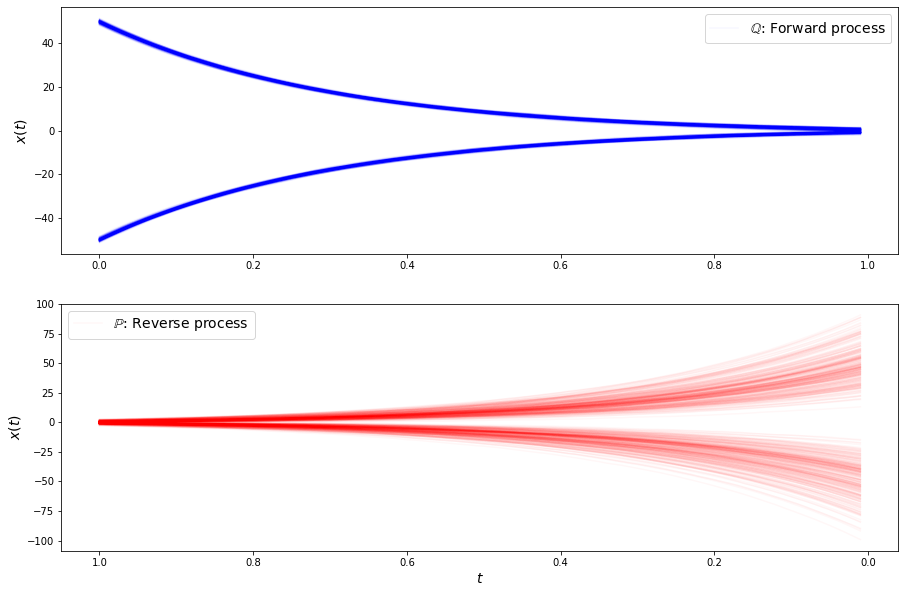

loss b 0.6182612776756287
loss b 0.6441349983215332
loss b 0.5321317911148071
loss b 0.6019961833953857
loss b 0.5507889986038208
loss b 0.5354356169700623
loss b 0.5707501769065857
loss b 0.5948022603988647
loss b 0.6431382894515991
loss b 0.6601792573928833
loss b 0.5373799800872803
loss b 0.5725138783454895
loss b 0.600976288318634
loss b 0.5743028521537781
loss b 0.6138413548469543
loss b 0.563228964805603
loss b 0.4880175292491913
loss b 0.5386075973510742
loss b 0.5687791705131531
loss b 0.6264175176620483
loss b 0.4873359203338623
loss b 0.6068006753921509
loss f 3.3756635189056396
loss f 3.3792684078216553
loss f 3.3575799465179443
loss f 3.3593902587890625
loss f 3.3655214309692383
loss f 3.3967337608337402
loss f 3.3867297172546387
loss f 3.3553104400634766
loss f 3.3947041034698486
loss f 3.3760054111480713
loss f 3.387864351272583
loss f 3.3377015590667725
loss f 3.398371934890747
loss f 3.3718087673187256
loss f 3.3913955688476562
loss f 3.358835220336914
loss f 3.34901356

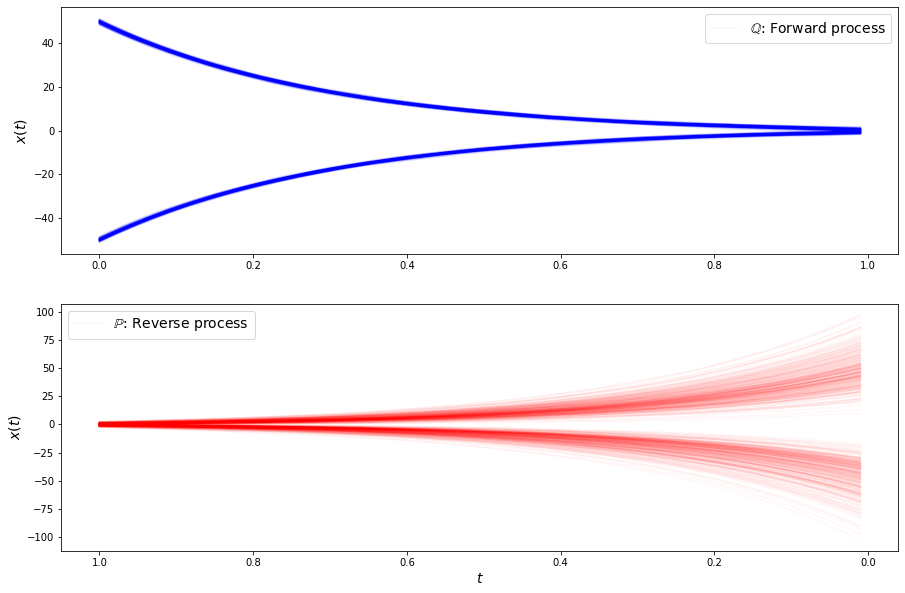

loss b 0.6772059798240662
loss b 0.44448181986808777
loss b 0.5341354608535767
loss b 0.5659541487693787
loss b 0.5999552607536316
loss b 0.6219003200531006
loss b 0.6264217495918274
loss b 0.5377126932144165
loss b 0.6021514534950256
loss b 0.5944476127624512
loss b 0.5851453542709351
loss b 0.6681867241859436
loss b 0.5462921261787415
loss b 0.6038966178894043
loss b 0.6120232343673706
loss b 0.5063126683235168
loss b 0.6130523085594177
loss b 0.57499760389328
loss b 0.5528265833854675
loss b 0.6609345078468323
loss b 0.5095505714416504
loss b 0.5566487312316895
loss f 3.386887550354004
loss f 3.3852427005767822
loss f 3.403139114379883
loss f 3.373121976852417
loss f 3.369732618331909
loss f 3.38899302482605
loss f 3.372811794281006
loss f 3.3738884925842285
loss f 3.3818259239196777
loss f 3.3871805667877197
loss f 3.401001214981079
loss f 3.34506893157959
loss f 3.3981080055236816
loss f 3.3962039947509766
loss f 3.372464895248413
loss f 3.3817598819732666
loss f 3.369605779647827

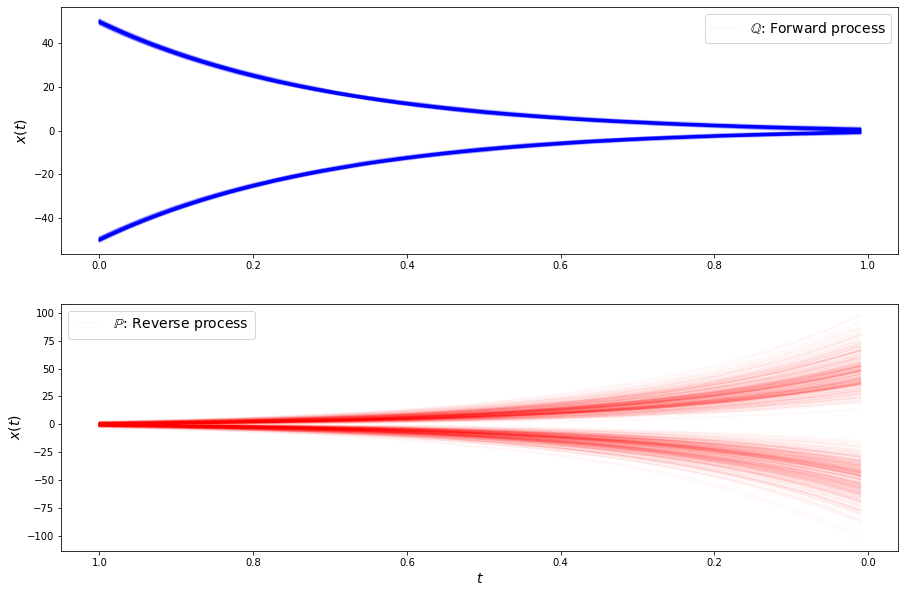

loss b 0.658421516418457
loss b 0.6455347537994385
loss b 0.547723114490509
loss b 0.6079797148704529
loss b 0.5090617537498474
loss b 0.5580331087112427
loss b 0.5506119132041931
loss b 0.510057270526886
loss b 0.5672294497489929
loss b 0.6185553669929504
loss b 0.605495810508728
loss b 0.5626105070114136
loss b 0.5885670185089111
loss b 0.6803950071334839
loss b 0.6508406400680542
loss b 0.5593198537826538
loss b 0.5666082501411438
loss b 0.6156208515167236
loss b 0.7460430860519409
loss b 0.5209645628929138
loss b 0.6244818568229675
loss b 0.5145459175109863
loss f 3.375980854034424
loss f 3.37518310546875
loss f 3.387350559234619
loss f 3.369396209716797
loss f 3.385073184967041
loss f 3.3799712657928467
loss f 3.3745954036712646
loss f 3.3541512489318848
loss f 3.3981645107269287
loss f 3.379863977432251
loss f 3.3587050437927246
loss f 3.3787825107574463
loss f 3.382152557373047
loss f 3.394890546798706
loss f 3.4002761840820312
loss f 3.3602099418640137
loss f 3.3791868686676025

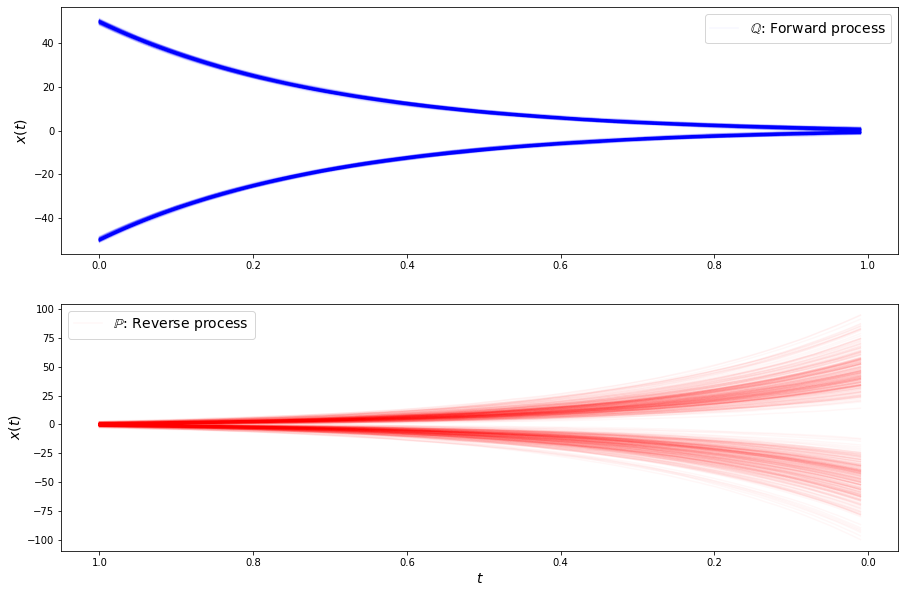

loss b 0.5852859020233154
loss b 0.5595967769622803
loss b 0.5363789796829224
loss b 0.5800362229347229
loss b 0.647011399269104
loss b 0.542401134967804
loss b 0.5083316564559937
loss b 0.5086836218833923
loss b 0.5193156003952026
loss b 0.599372148513794
loss b 0.5481444001197815
loss b 0.593897819519043
loss b 0.5528735518455505
loss b 0.536046028137207
loss b 0.5131402015686035
loss b 0.5909810066223145
loss b 0.5308775901794434
loss b 0.5758963823318481
loss b 0.5240353941917419
loss b 0.543372392654419
loss b 0.6080326437950134
loss b 0.5643941164016724
loss f 3.3809032440185547
loss f 3.3682050704956055
loss f 3.388972282409668
loss f 3.344085454940796
loss f 3.3946080207824707
loss f 3.393289089202881
loss f 3.389021396636963
loss f 3.386326789855957
loss f 3.358663558959961
loss f 3.394052505493164
loss f 3.350504159927368
loss f 3.374516248703003
loss f 3.3725903034210205
loss f 3.395557403564453
loss f 3.3852274417877197
loss f 3.382030487060547
loss f 3.375570058822632
loss

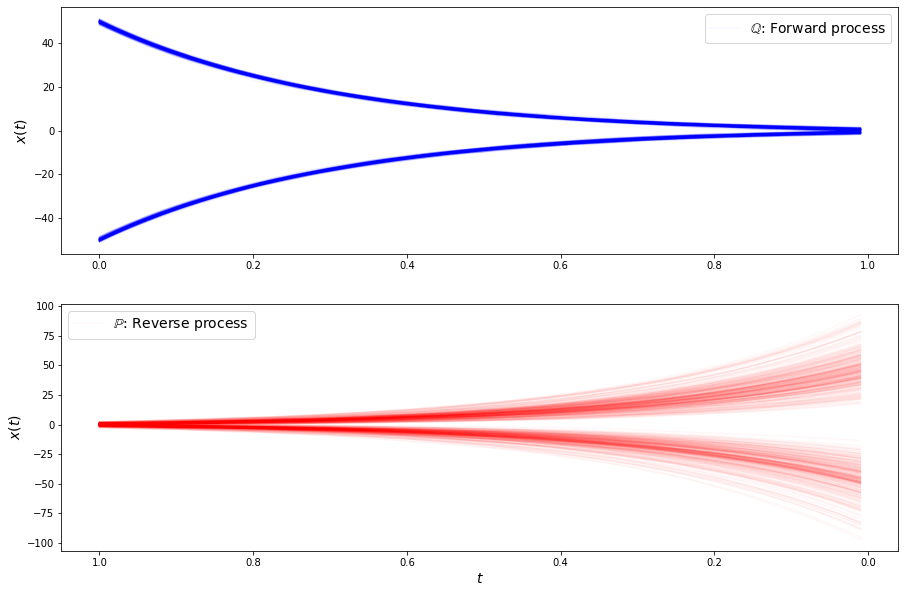

loss b 0.526552140712738
loss b 0.6054013967514038
loss b 0.5958370566368103
loss b 0.5286080241203308
loss b 0.5762893557548523
loss b 0.5360409021377563
loss b 0.5662381649017334
loss b 0.6099560260772705
loss b 0.6038630604743958
loss b 0.5829373598098755
loss b 0.5844544768333435
loss b 0.6357815861701965
loss b 0.5779693722724915
loss b 0.5447726845741272
loss b 0.5346202850341797
loss b 0.540844738483429
loss b 0.5825616121292114
loss b 0.5183685421943665
loss b 0.559677004814148
loss b 0.5993064045906067
loss b 0.654540479183197
loss b 0.6779195070266724
loss f 3.393752098083496
loss f 3.350972890853882
loss f 3.379657506942749
loss f 3.359083414077759
loss f 3.3495514392852783
loss f 3.3439786434173584
loss f 3.38985538482666
loss f 3.394230604171753
loss f 3.3836843967437744
loss f 3.3536810874938965
loss f 3.3835203647613525
loss f 3.391369581222534
loss f 3.3773415088653564
loss f 3.3587565422058105
loss f 3.357100486755371
loss f 3.3674533367156982
loss f 3.3571345806121826

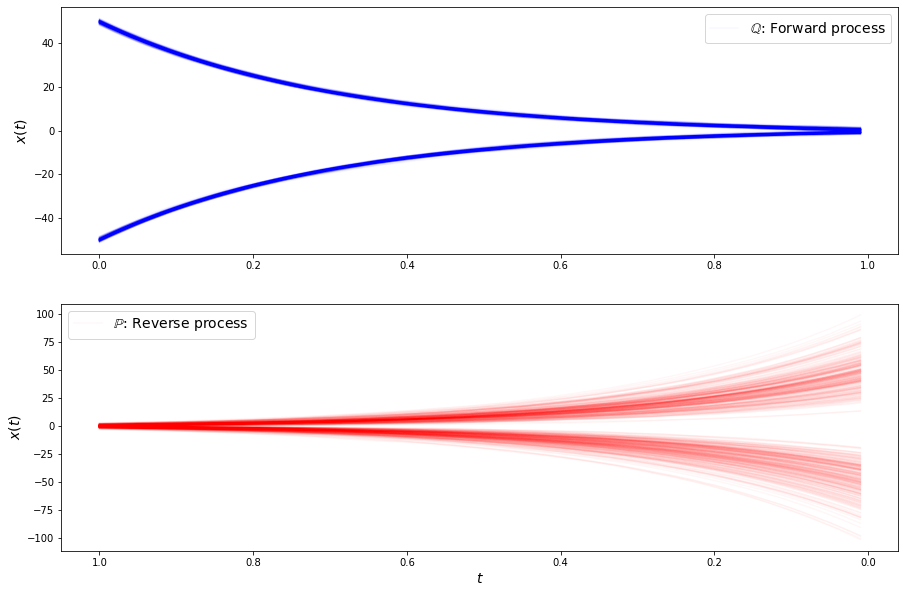

loss b 0.5424390435218811
loss b 0.5833638906478882
loss b 0.6077165603637695
loss b 0.6041730046272278
loss b 0.49361321330070496
loss b 0.5977228879928589
loss b 0.5184064507484436
loss b 0.623781144618988
loss b 0.5861179828643799
loss b 0.5439621210098267
loss b 0.5195351243019104
loss b 0.5828753113746643
loss b 0.6050080060958862
loss b 0.5517112612724304
loss b 0.5953472256660461
loss b 0.5699259042739868
loss b 0.5765487551689148
loss b 0.5687486529350281
loss b 0.6275359988212585
loss b 0.5918107628822327
loss b 0.6241917610168457
loss b 0.5186569094657898
loss f 3.3884520530700684
loss f 3.3556792736053467
loss f 3.390756368637085
loss f 3.3661766052246094
loss f 3.370256185531616
loss f 3.3689587116241455
loss f 3.3412134647369385
loss f 3.372349977493286
loss f 3.390763282775879
loss f 3.3494207859039307
loss f 3.350831985473633
loss f 3.389023542404175
loss f 3.3659839630126953
loss f 3.3590216636657715
loss f 3.354717493057251
loss f 3.391786575317383
loss f 3.39140129089

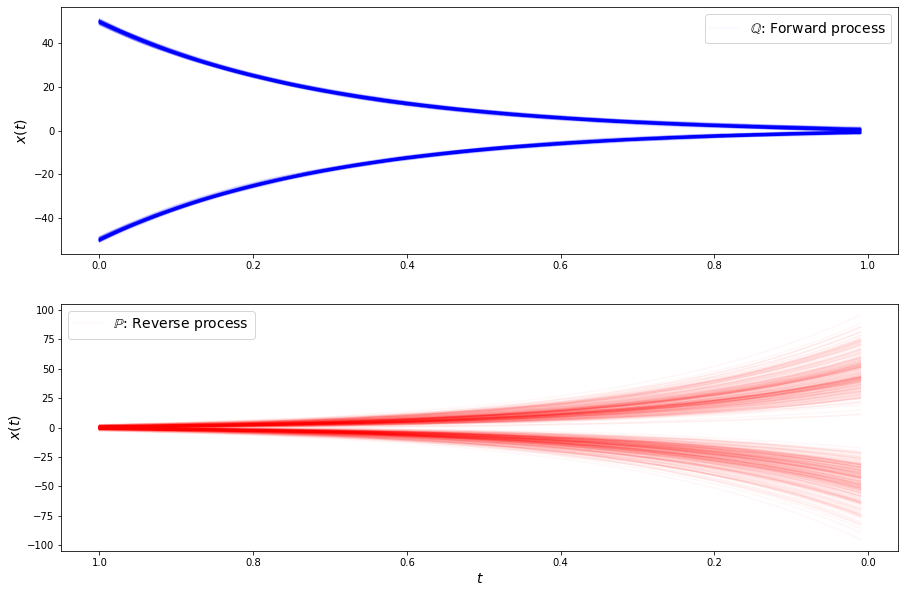

loss b 0.5071502923965454
loss b 0.5938316583633423
loss b 0.5682919025421143
loss b 0.5548569560050964
loss b 0.5933239459991455
loss b 0.4781836271286011
loss b 0.6241154670715332
loss b 0.5752859115600586
loss b 0.574192464351654
loss b 0.5797436237335205
loss b 0.5245087742805481
loss b 0.6033883690834045
loss b 0.5140969157218933
loss b 0.55119389295578
loss b 0.5648694038391113
loss b 0.5279973149299622
loss b 0.6245366930961609
loss b 0.5799447894096375
loss b 0.6339991092681885
loss b 0.482350617647171
loss b 0.6029423475265503
loss b 0.5221629738807678
loss f 3.359455108642578
loss f 3.3793137073516846
loss f 3.3720967769622803
loss f 3.3799026012420654
loss f 3.3808300495147705
loss f 3.3586490154266357
loss f 3.396467447280884
loss f 3.35589599609375
loss f 3.369514226913452
loss f 3.3927509784698486
loss f 3.4050915241241455
loss f 3.3641371726989746
loss f 3.336559295654297
loss f 3.363391399383545
loss f 3.358184337615967
loss f 3.3789970874786377
loss f 3.379195690155029

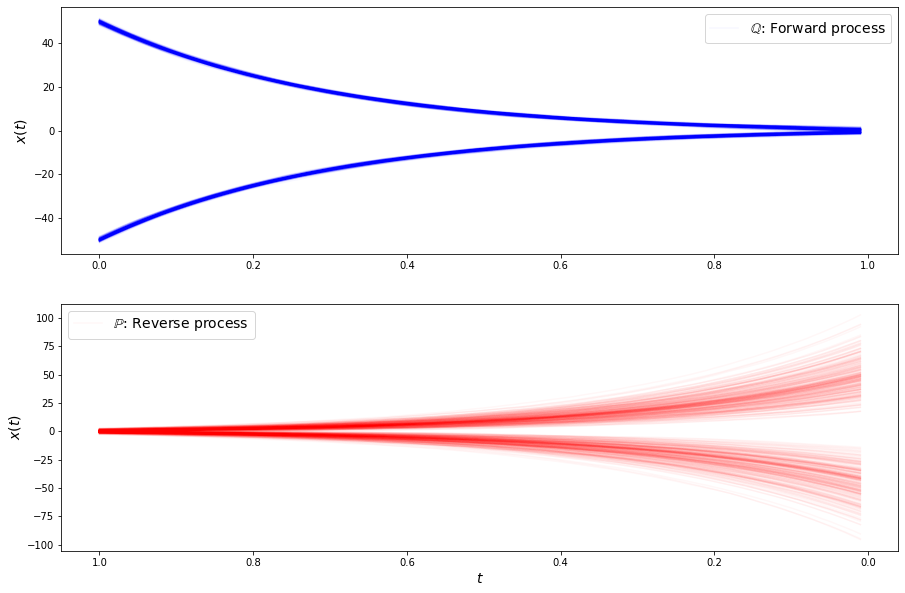

loss b 0.5431470274925232
loss b 0.5644135475158691
loss b 0.6021063923835754
loss b 0.5278811454772949
loss b 0.5462700128555298
loss b 0.5503588914871216
loss b 0.5821454524993896
loss b 0.5518355965614319
loss b 0.6416363716125488
loss b 0.5489549040794373
loss b 0.5903794765472412
loss b 0.7055469751358032
loss b 0.6482548117637634
loss b 0.6284250020980835
loss b 0.5892953276634216
loss b 0.5505669713020325
loss b 0.5740060806274414
loss b 0.5005320906639099
loss b 0.5747573971748352
loss b 0.6276364922523499
loss b 0.5561116337776184
loss b 0.5067367553710938
loss f 3.3621201515197754
loss f 3.365103006362915
loss f 3.3492867946624756
loss f 3.392129898071289
loss f 3.379000186920166
loss f 3.352062702178955
loss f 3.3648953437805176
loss f 3.3459787368774414
loss f 3.385474443435669
loss f 3.362294912338257
loss f 3.3399617671966553
loss f 3.347569465637207
loss f 3.39060378074646
loss f 3.356069326400757
loss f 3.3937466144561768
loss f 3.3625335693359375
loss f 3.3437130451202

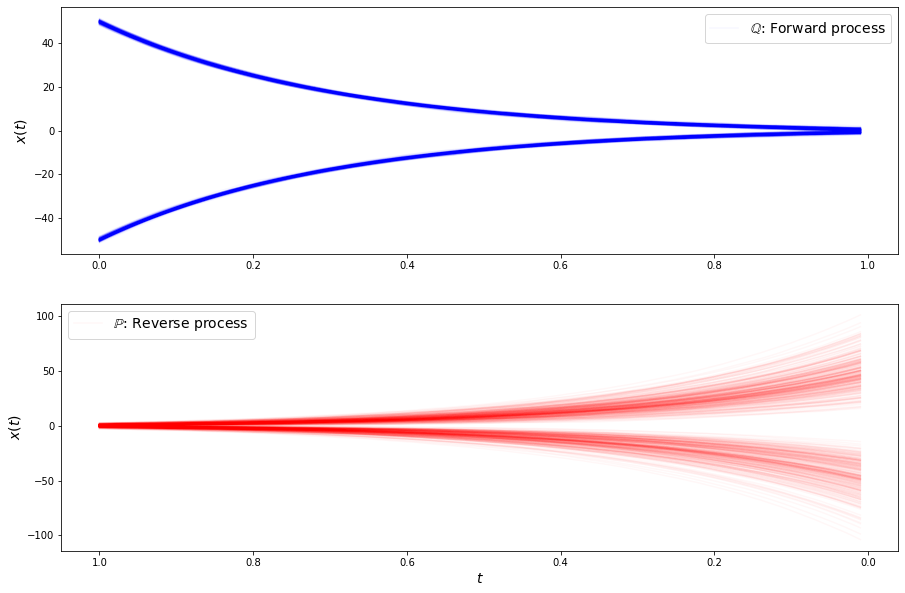

loss b 0.5975916981697083
loss b 0.5541789531707764
loss b 0.6656824946403503
loss b 0.5936310291290283
loss b 0.493928998708725
loss b 0.5470820069313049
loss b 0.5280051231384277
loss b 0.5070759654045105
loss b 0.5443700551986694
loss b 0.6167400479316711
loss b 0.6081667542457581
loss b 0.5806428790092468
loss b 0.4765670597553253
loss b 0.5107790231704712
loss b 0.5169042944908142
loss b 0.5544907450675964
loss b 0.5438458919525146
loss b 0.5298095345497131
loss b 0.5025061964988708
loss b 0.5614289045333862
loss b 0.5386379957199097
loss b 0.5135238766670227
loss f 3.372584104537964
loss f 3.3452019691467285
loss f 3.3651797771453857
loss f 3.375215530395508
loss f 3.3629379272460938
loss f 3.36637020111084
loss f 3.3544132709503174
loss f 3.3847756385803223
loss f 3.3646860122680664
loss f 3.3831074237823486
loss f 3.3522725105285645
loss f 3.3671395778656006
loss f 3.3711161613464355
loss f 3.3481645584106445
loss f 3.3823208808898926
loss f 3.3624584674835205
loss f 3.36520457

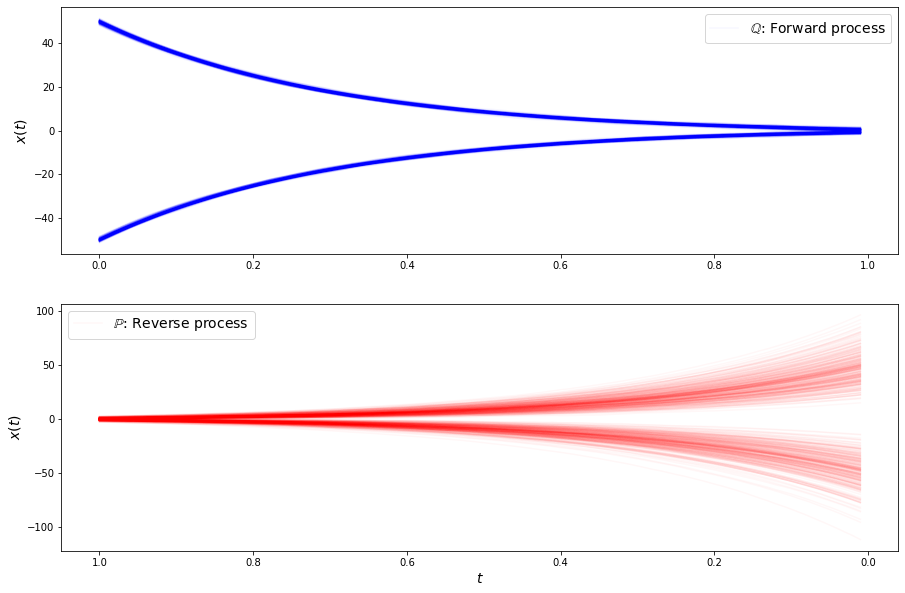

loss b 0.547439694404602
loss b 0.5729633569717407
loss b 0.57587730884552
loss b 0.5518954396247864
loss b 0.5363330245018005
loss b 0.5228403210639954
loss b 0.5377398729324341
loss b 0.5430834889411926
loss b 0.5598356127738953
loss b 0.5043095350265503
loss b 0.5976122617721558
loss b 0.5464016199111938
loss b 0.6469734907150269
loss b 0.5890310406684875
loss b 0.5225067734718323
loss b 0.5106754302978516
loss b 0.5531642436981201
loss b 0.5926104784011841
loss b 0.5141552686691284
loss b 0.5328187346458435
loss b 0.5548128485679626
loss b 0.5705100893974304
loss f 3.3722405433654785
loss f 3.360551118850708
loss f 3.3681528568267822
loss f 3.3322479724884033
loss f 3.381244659423828
loss f 3.375875473022461
loss f 3.376619815826416
loss f 3.3740110397338867
loss f 3.3522145748138428
loss f 3.359253406524658
loss f 3.3590285778045654
loss f 3.361604928970337
loss f 3.352308511734009
loss f 3.3699533939361572
loss f 3.3585331439971924
loss f 3.330631971359253
loss f 3.36076259613037

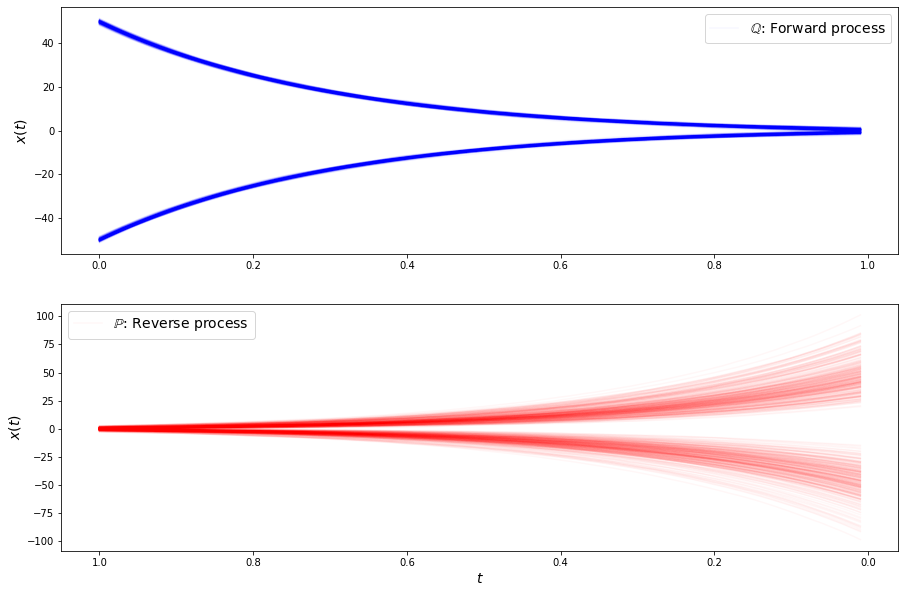

loss b 0.5827747583389282
loss b 0.5141233801841736
loss b 0.6144941449165344
loss b 0.536975622177124
loss b 0.5416451096534729
loss b 0.5993172526359558
loss b 0.5512447953224182
loss b 0.5871278643608093
loss b 0.6003701090812683
loss b 0.5263535380363464
loss b 0.5744531154632568
loss b 0.6410679817199707
loss b 0.5006715059280396
loss b 0.5176748633384705
loss b 0.5613690614700317
loss b 0.5379084944725037
loss b 0.5753144025802612
loss b 0.49538150429725647
loss b 0.5564848184585571
loss b 0.5212415456771851
loss b 0.49727243185043335
loss b 0.49720364809036255
loss f 3.366567611694336
loss f 3.354569435119629
loss f 3.391890048980713
loss f 3.35306453704834
loss f 3.379896402359009
loss f 3.33536696434021
loss f 3.353400468826294
loss f 3.3828351497650146
loss f 3.357347011566162
loss f 3.39121150970459
loss f 3.366635322570801
loss f 3.364285945892334
loss f 3.3713033199310303
loss f 3.3372280597686768
loss f 3.3659300804138184
loss f 3.33555006980896
loss f 3.374427318572998
l

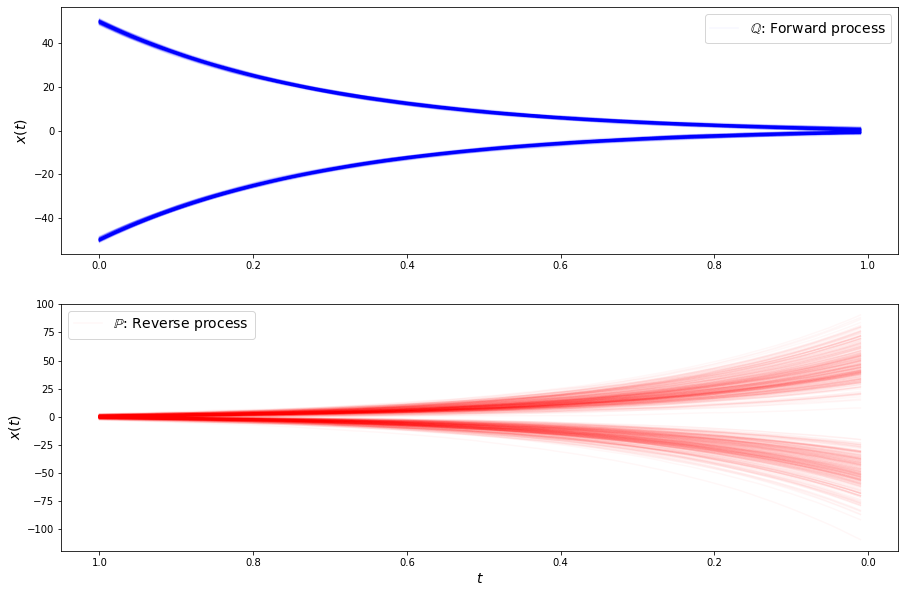

loss b 0.545541524887085
loss b 0.5279666185379028
loss b 0.5614942312240601
loss b 0.5786375403404236
loss b 0.5444381237030029
loss b 0.6155865788459778
loss b 0.468013197183609
loss b 0.5437930226325989
loss b 0.5740267038345337
loss b 0.5751211047172546
loss b 0.5169920921325684
loss b 0.5428004264831543
loss b 0.5677973031997681
loss b 0.5929433107376099
loss b 0.5803099274635315
loss b 0.5781180262565613
loss b 0.6333925127983093
loss b 0.5343390703201294
loss b 0.5750237703323364
loss b 0.5818008184432983
loss b 0.5495908856391907
loss b 0.6026656031608582
loss f 3.3316495418548584
loss f 3.362562656402588
loss f 3.3562135696411133
loss f 3.3486487865448
loss f 3.3563144207000732
loss f 3.338862419128418
loss f 3.401564836502075
loss f 3.359855890274048
loss f 3.3515515327453613
loss f 3.3425962924957275
loss f 3.3429059982299805
loss f 3.359407901763916
loss f 3.3518178462982178
loss f 3.326139450073242
loss f 3.3542447090148926
loss f 3.339426040649414
loss f 3.351272583007812

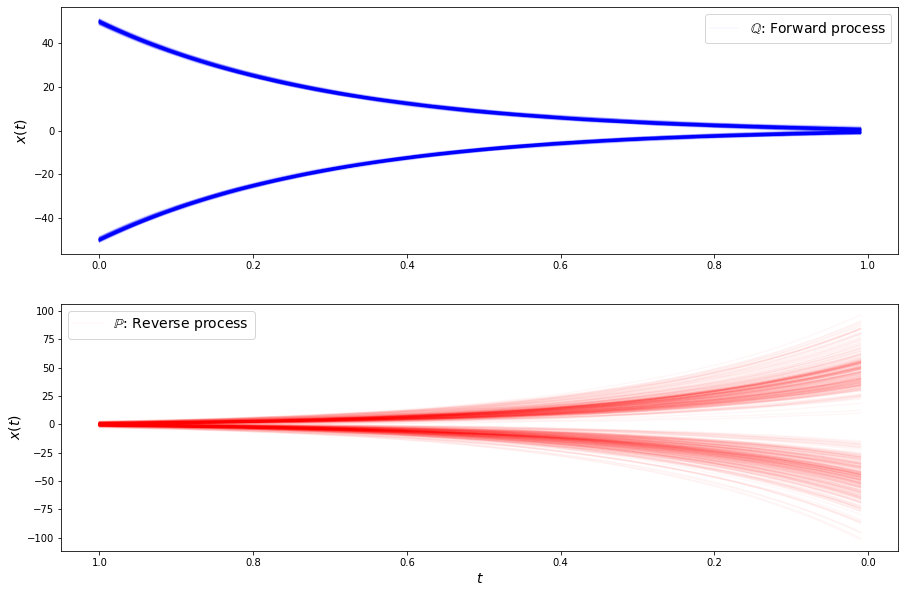

loss b 0.5170051455497742
loss b 0.5309985280036926
loss b 0.5711469650268555
loss b 0.513349175453186
loss b 0.593239426612854
loss b 0.5591627359390259
loss b 0.5673974752426147
loss b 0.49023786187171936
loss b 0.5147088766098022
loss b 0.6335991024971008
loss b 0.46000561118125916
loss b 0.5192478895187378
loss b 0.597002387046814
loss b 0.48661378026008606
loss b 0.5171259641647339
loss b 0.5108295679092407
loss b 0.5491411089897156
loss b 0.5792331099510193
loss b 0.5539576411247253
loss b 0.5866674780845642
loss b 0.6081227660179138
loss b 0.563106119632721
loss f 3.3478198051452637
loss f 3.3575220108032227
loss f 3.374844789505005
loss f 3.3327765464782715
loss f 3.3665809631347656
loss f 3.361618995666504
loss f 3.359389066696167
loss f 3.35286808013916
loss f 3.3523919582366943
loss f 3.371718406677246
loss f 3.3708155155181885
loss f 3.3501675128936768
loss f 3.3461625576019287
loss f 3.3483574390411377
loss f 3.382633924484253
loss f 3.354321002960205
loss f 3.328734636306

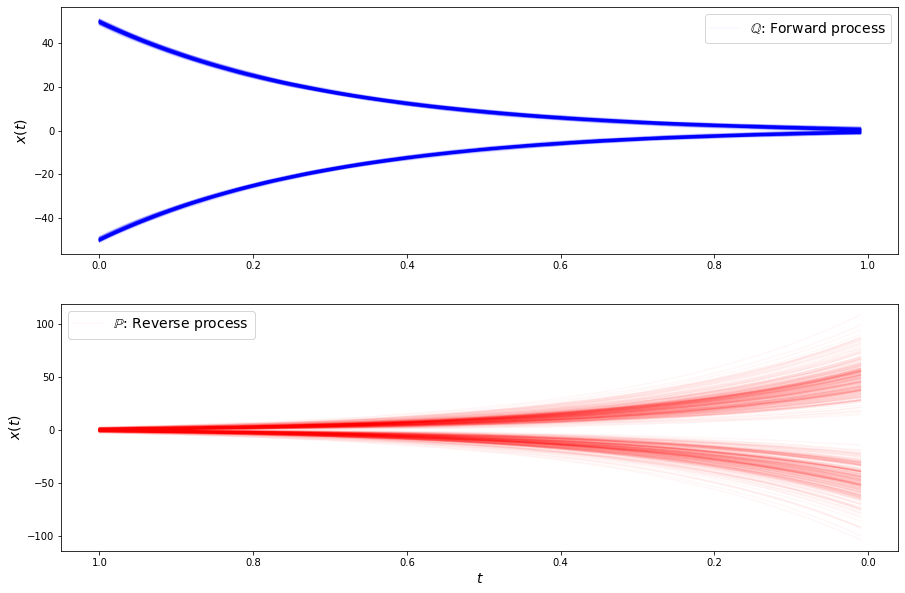

loss b 0.5607748627662659
loss b 0.5701720118522644
loss b 0.5179586410522461
loss b 0.5518247485160828
loss b 0.5823331475257874
loss b 0.5968498587608337
loss b 0.4592190980911255
loss b 0.6145355105400085
loss b 0.6002569794654846
loss b 0.5150983929634094
loss b 0.6127859950065613
loss b 0.5013900995254517
loss b 0.6271640658378601
loss b 0.45789605379104614
loss b 0.5060661435127258
loss b 0.5494992733001709
loss b 0.5412467122077942
loss b 0.5993088483810425
loss b 0.48225823044776917
loss b 0.5091140270233154
loss b 0.4717957377433777
loss b 0.5587647557258606
loss f 3.3585331439971924
loss f 3.3723695278167725
loss f 3.3575620651245117
loss f 3.3637280464172363
loss f 3.3302366733551025
loss f 3.362046480178833
loss f 3.3617727756500244
loss f 3.3331730365753174
loss f 3.3465378284454346
loss f 3.34370493888855
loss f 3.3883163928985596
loss f 3.3762166500091553
loss f 3.361051082611084
loss f 3.345726490020752
loss f 3.361887216567993
loss f 3.358814001083374
loss f 3.33377575

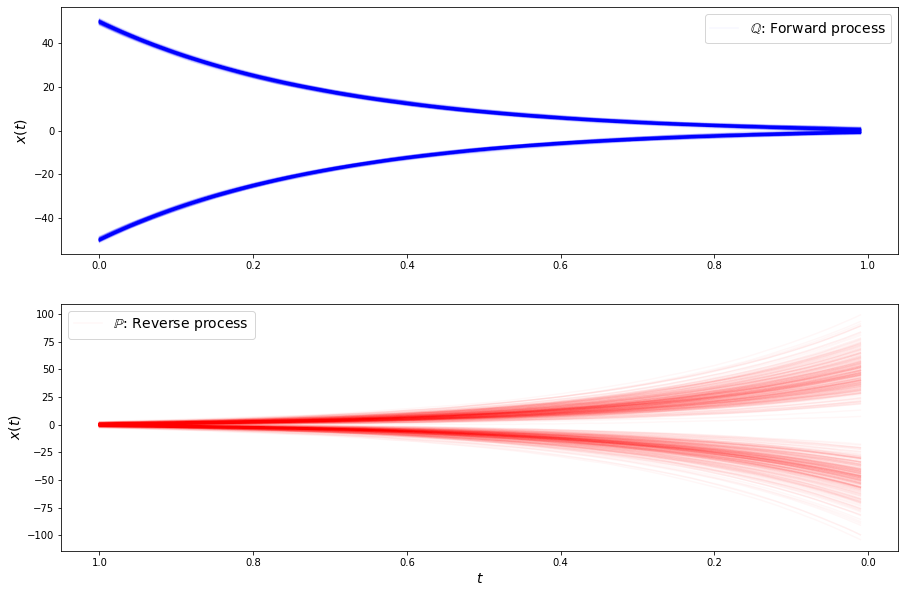

loss b 0.5993306040763855
loss b 0.5853807330131531
loss b 0.5913757681846619
loss b 0.5266144871711731
loss b 0.547497034072876
loss b 0.5930448770523071
loss b 0.5383326411247253
loss b 0.5823753476142883
loss b 0.573513388633728
loss b 0.5441607236862183
loss b 0.5109261870384216
loss b 0.5680810809135437
loss b 0.5894112586975098
loss b 0.4856814444065094
loss b 0.5160340070724487
loss b 0.48705580830574036
loss b 0.5259385108947754
loss b 0.5332318544387817
loss b 0.49986904859542847
loss b 0.5477734804153442
loss b 0.5907078981399536
loss b 0.5055719017982483
loss f 3.336963176727295
loss f 3.384037971496582
loss f 3.3638198375701904
loss f 3.347390651702881
loss f 3.331850528717041
loss f 3.3575408458709717
loss f 3.3455851078033447
loss f 3.3485724925994873
loss f 3.345909595489502
loss f 3.348896026611328
loss f 3.35855770111084
loss f 3.3412833213806152
loss f 3.350538492202759
loss f 3.3559210300445557
loss f 3.365039110183716
loss f 3.329883575439453
loss f 3.35203146934509

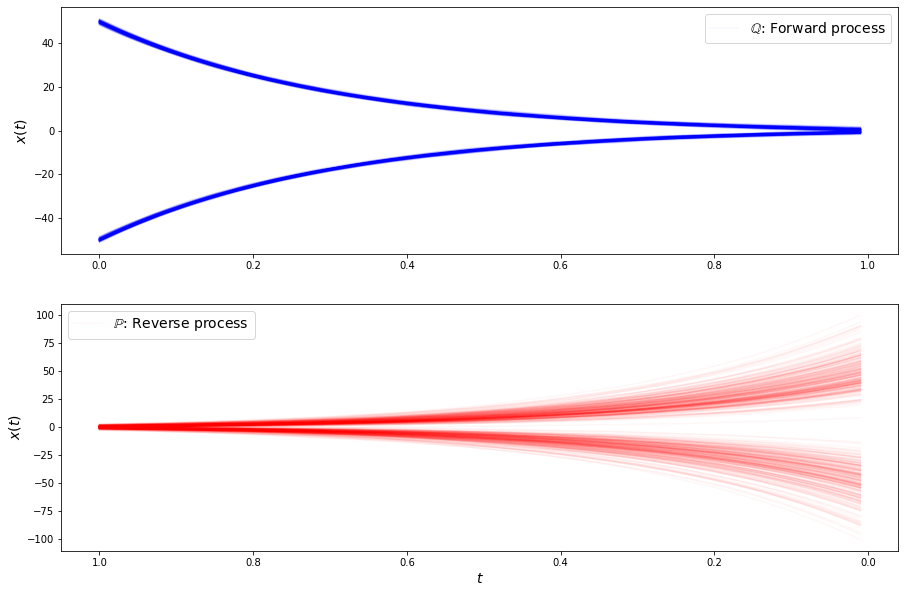

loss b 0.5150585770606995
loss b 0.6032098531723022
loss b 0.5911433696746826
loss b 0.5658591985702515
loss b 0.6011790037155151
loss b 0.610031008720398
loss b 0.42867693305015564
loss b 0.522301971912384
loss b 0.5001890063285828
loss b 0.5820072889328003
loss b 0.5201699733734131
loss b 0.5262078642845154
loss b 0.5402969121932983
loss b 0.5793433785438538
loss b 0.6060129404067993
loss b 0.5750284194946289
loss b 0.579254150390625
loss b 0.6339737772941589
loss b 0.5145211815834045
loss b 0.4979209303855896
loss b 0.5107234716415405
loss b 0.539101779460907
loss f 3.3567183017730713
loss f 3.344135284423828
loss f 3.355881929397583
loss f 3.3319060802459717
loss f 3.325204610824585
loss f 3.3587875366210938
loss f 3.3739545345306396
loss f 3.339813470840454
loss f 3.3151495456695557
loss f 3.366694927215576
loss f 3.38745379447937
loss f 3.355437994003296
loss f 3.3457000255584717
loss f 3.3905320167541504
loss f 3.366302728652954
loss f 3.3420498371124268
loss f 3.326071739196777

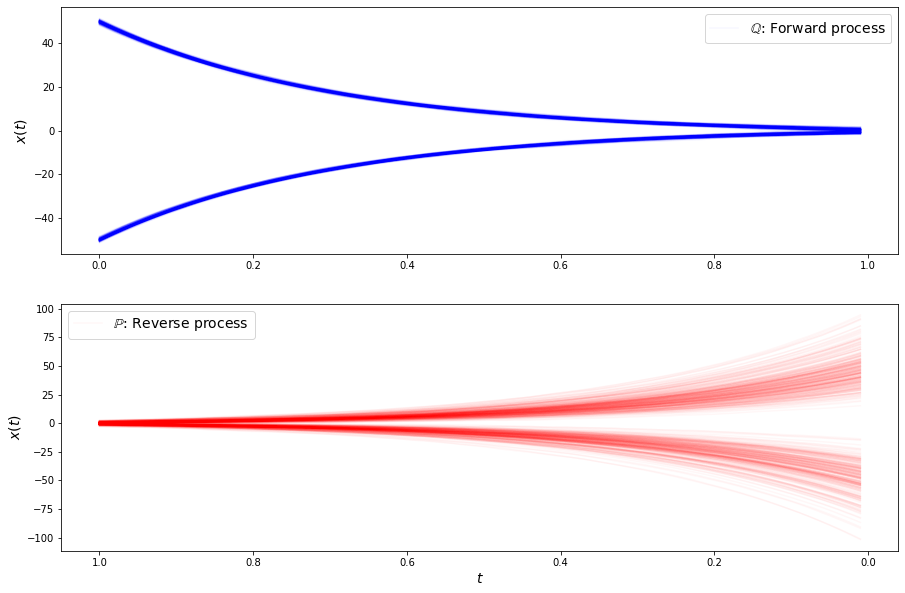

loss b 0.5582241415977478
loss b 0.533324122428894
loss b 0.580154299736023
loss b 0.5844216346740723
loss b 0.5992714166641235
loss b 0.5529378056526184
loss b 0.5450613498687744
loss b 0.5549482107162476
loss b 0.4937536418437958
loss b 0.5046777129173279
loss b 0.4552316963672638
loss b 0.5898392796516418
loss b 0.6203964948654175
loss b 0.4558251202106476
loss b 0.512887716293335
loss b 0.5399949550628662
loss b 0.5985152721405029
loss b 0.6384148597717285
loss b 0.6069625020027161
loss b 0.5506137609481812
loss b 0.5435343980789185
loss b 0.5744614601135254
loss f 3.3507919311523438
loss f 3.3578999042510986
loss f 3.337566614151001
loss f 3.328723430633545
loss f 3.338932991027832
loss f 3.353104591369629
loss f 3.361572265625
loss f 3.372781276702881
loss f 3.3392300605773926
loss f 3.3581814765930176
loss f 3.3212835788726807
loss f 3.3490304946899414
loss f 3.361510992050171
loss f 3.355041027069092
loss f 3.365612030029297
loss f 3.3334434032440186
loss f 3.344921588897705
lo

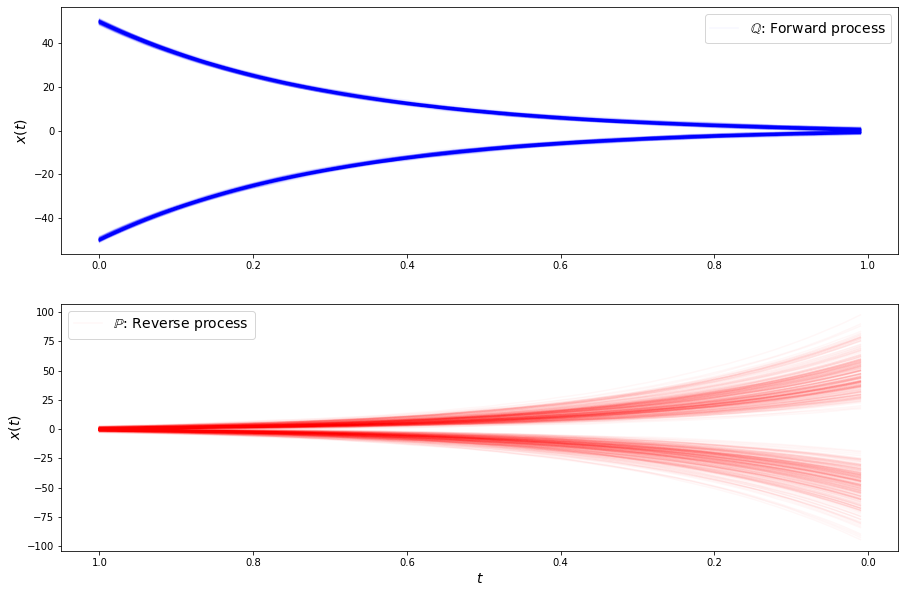

loss b 0.5595055818557739
loss b 0.5778847932815552
loss b 0.5645712614059448
loss b 0.5929571390151978
loss b 0.6913016438484192
loss b 0.5443536639213562
loss b 0.5393469929695129
loss b 0.5494705438613892
loss b 0.5852786302566528
loss b 0.480389267206192
loss b 0.5945371985435486
loss b 0.5876418352127075
loss b 0.507949709892273
loss b 0.6037673950195312
loss b 0.5407670140266418
loss b 0.4423702359199524
loss b 0.49983689188957214
loss b 0.6007140874862671
loss b 0.4898405373096466
loss b 0.5095298290252686
loss b 0.6423171162605286
loss b 0.5397025346755981
loss f 3.368415594100952
loss f 3.335167407989502
loss f 3.362093925476074
loss f 3.375123977661133
loss f 3.3612265586853027
loss f 3.3484787940979004
loss f 3.31176495552063
loss f 3.3658344745635986
loss f 3.3476641178131104
loss f 3.336106538772583
loss f 3.3507699966430664
loss f 3.3456223011016846
loss f 3.3397555351257324
loss f 3.3800365924835205
loss f 3.3416614532470703
loss f 3.3647713661193848
loss f 3.34008455276

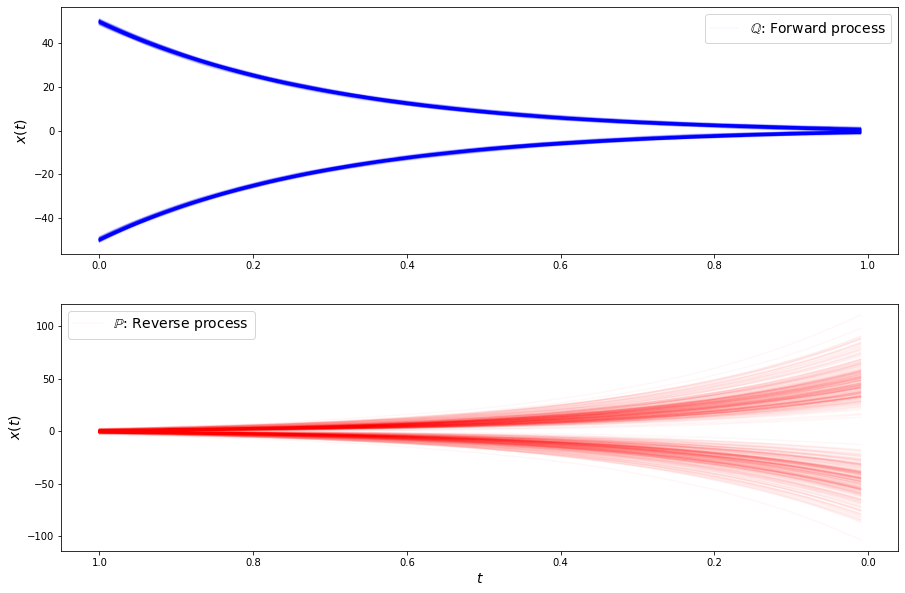

loss b 0.49573779106140137
loss b 0.49120697379112244
loss b 0.4978903532028198
loss b 0.6422907710075378
loss b 0.5664991140365601
loss b 0.5599936246871948
loss b 0.5801180601119995
loss b 0.5439720153808594
loss b 0.5340408086776733
loss b 0.5388854742050171
loss b 0.538179874420166
loss b 0.6404327750205994
loss b 0.4631750285625458
loss b 0.5388049483299255
loss b 0.5391087532043457
loss b 0.5044180750846863
loss b 0.5124529004096985
loss b 0.4722778797149658
loss b 0.5682364702224731
loss b 0.523557186126709
loss b 0.5256525874137878
loss b 0.505538284778595
loss f 3.3641514778137207
loss f 3.3457486629486084
loss f 3.374542474746704
loss f 3.3425846099853516
loss f 3.336700439453125
loss f 3.350703001022339
loss f 3.333794593811035
loss f 3.3389394283294678
loss f 3.353754997253418
loss f 3.3196444511413574
loss f 3.340451955795288
loss f 3.34568452835083
loss f 3.335252046585083
loss f 3.324995994567871
loss f 3.3654184341430664
loss f 3.3303334712982178
loss f 3.33444643020629

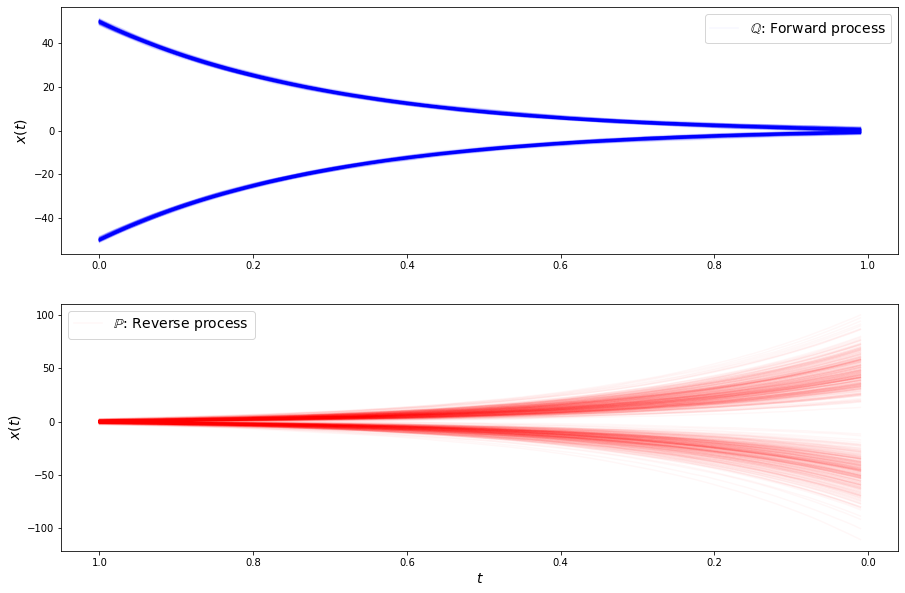

loss b 0.6036075353622437
loss b 0.5568216443061829
loss b 0.501070499420166
loss b 0.5453325510025024
loss b 0.6167154908180237
loss b 0.5465795993804932
loss b 0.5539724230766296
loss b 0.511724054813385
loss b 0.4994303584098816
loss b 0.47570908069610596
loss b 0.5524297952651978
loss b 0.6070156097412109
loss b 0.5032891035079956
loss b 0.5048084855079651
loss b 0.6070024967193604
loss b 0.6050493121147156
loss b 0.5002680420875549
loss b 0.4786120355129242
loss b 0.5850539803504944
loss b 0.5273157954216003
loss b 0.6002446413040161
loss b 0.45645731687545776
loss f 3.33235239982605
loss f 3.338207721710205
loss f 3.3434174060821533
loss f 3.3249692916870117
loss f 3.326056718826294
loss f 3.3301515579223633
loss f 3.3264262676239014
loss f 3.365267038345337
loss f 3.3534047603607178
loss f 3.362165689468384
loss f 3.3269119262695312
loss f 3.3336181640625
loss f 3.3309764862060547
loss f 3.3378515243530273
loss f 3.3443961143493652
loss f 3.319608449935913
loss f 3.3701305389404

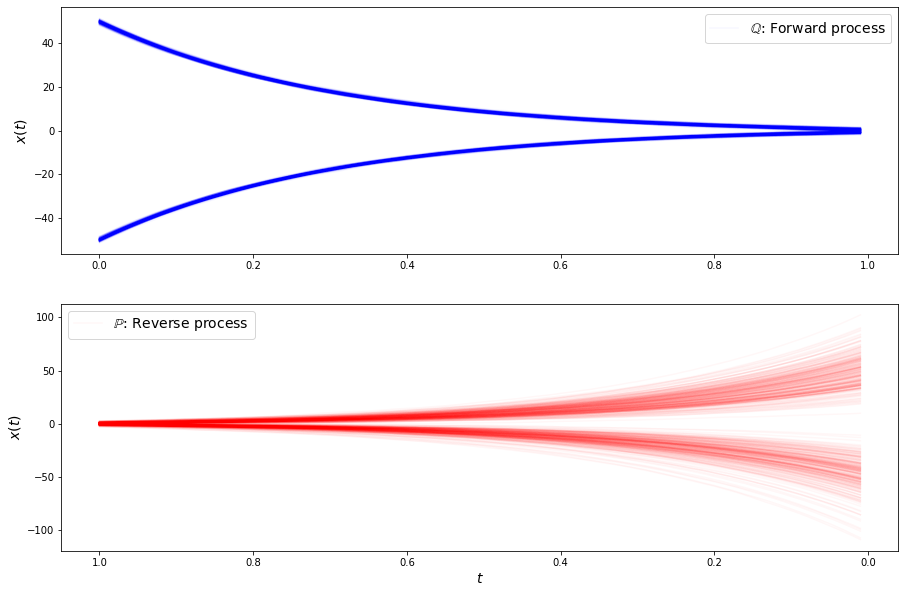

loss b 0.55894535779953
loss b 0.5148024559020996
loss b 0.5694920420646667
loss b 0.626771867275238
loss b 0.6518614888191223
loss b 0.49013257026672363
loss b 0.5468182563781738
loss b 0.6706701517105103
loss b 0.5600528717041016
loss b 0.5262593626976013
loss b 0.5546414256095886
loss b 0.49443745613098145
loss b 0.5216594934463501
loss b 0.5138917565345764
loss b 0.6037237644195557
loss b 0.4546476900577545
loss b 0.5005542039871216
loss b 0.5144596695899963
loss b 0.5116479992866516
loss b 0.5504819750785828
loss b 0.5578786134719849
loss b 0.5324105024337769
loss f 3.321634531021118
loss f 3.2902374267578125
loss f 3.3484389781951904
loss f 3.346400499343872
loss f 3.3587594032287598
loss f 3.313143253326416
loss f 3.325411319732666
loss f 3.337648868560791
loss f 3.3299200534820557
loss f 3.340381383895874
loss f 3.3575117588043213
loss f 3.3594255447387695
loss f 3.3377954959869385
loss f 3.3478894233703613
loss f 3.333483934402466
loss f 3.3418736457824707
loss f 3.33562445640

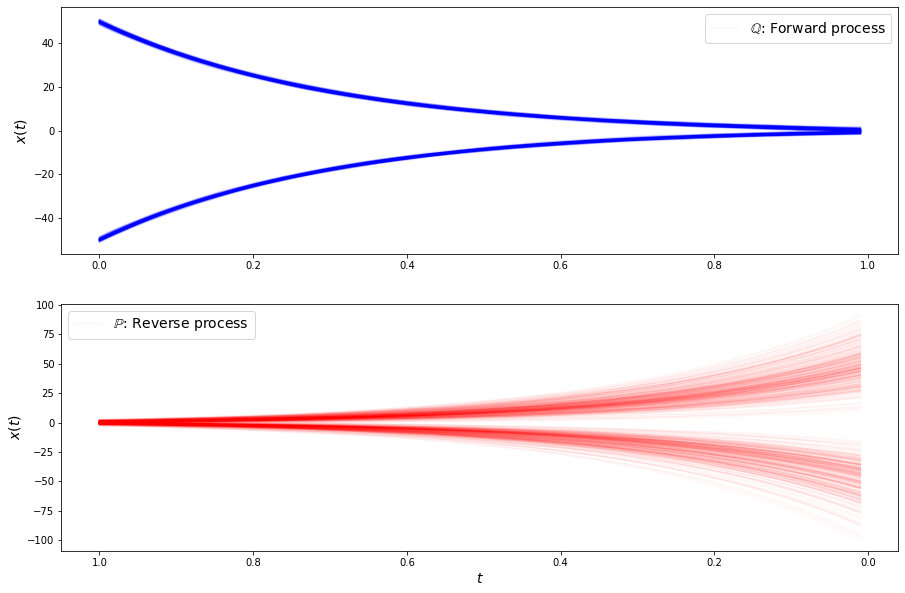

loss b 0.5223618149757385
loss b 0.5974838733673096
loss b 0.5636569857597351
loss b 0.5270026326179504
loss b 0.4990437626838684
loss b 0.5005505681037903
loss b 0.5099070072174072
loss b 0.5072546601295471
loss b 0.5880928039550781
loss b 0.5134789347648621
loss b 0.6099122166633606
loss b 0.543595552444458
loss b 0.5212673544883728
loss b 0.4963078796863556
loss b 0.4289607107639313
loss b 0.5479900240898132
loss b 0.5206648111343384
loss b 0.5846444368362427
loss b 0.5843377709388733
loss b 0.5647900700569153
loss b 0.4840308427810669
loss b 0.5862596035003662
loss f 3.3372530937194824
loss f 3.321131944656372
loss f 3.327414035797119
loss f 3.3535854816436768
loss f 3.3440091609954834
loss f 3.323664665222168
loss f 3.3570690155029297
loss f 3.3218729496002197
loss f 3.363616943359375
loss f 3.3669331073760986
loss f 3.3572134971618652
loss f 3.3419315814971924
loss f 3.3534040451049805
loss f 3.3450844287872314
loss f 3.330009937286377
loss f 3.3269360065460205
loss f 3.351843595

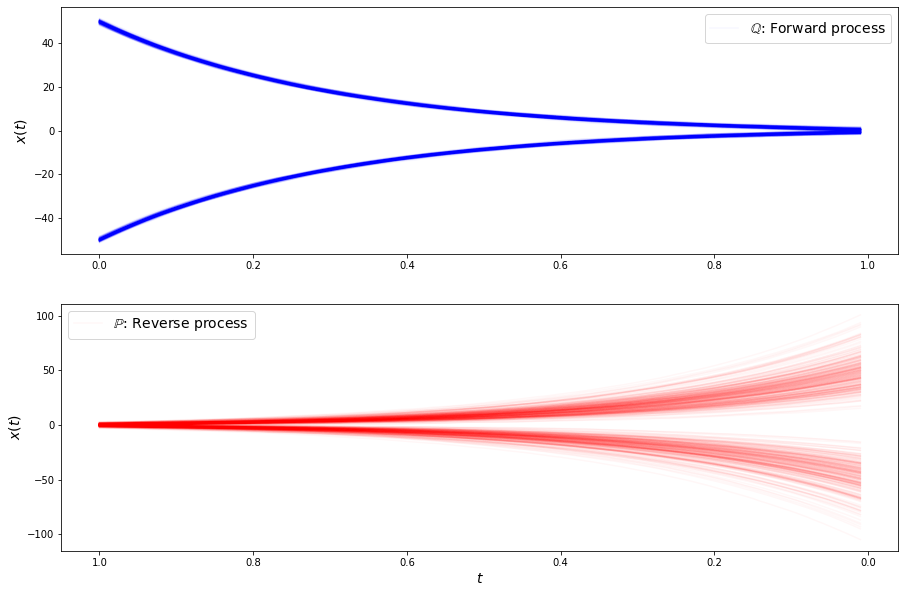

loss b 0.5250793695449829
loss b 0.480300635099411
loss b 0.5068301558494568
loss b 0.5987993478775024
loss b 0.5470907688140869
loss b 0.567234992980957
loss b 0.5478939414024353
loss b 0.5408203601837158
loss b 0.59376460313797
loss b 0.5407412648200989
loss b 0.573076605796814
loss b 0.5288216471672058
loss b 0.515759289264679
loss b 0.5424182415008545
loss b 0.536274790763855
loss b 0.5733077526092529
loss b 0.5177686810493469
loss b 0.5814052224159241
loss b 0.529088020324707
loss b 0.47341951727867126
loss b 0.5172390341758728
loss b 0.5577839612960815
loss f 3.362514019012451
loss f 3.352356433868408
loss f 3.3186264038085938
loss f 3.340083599090576
loss f 3.3395416736602783
loss f 3.3474948406219482
loss f 3.3778865337371826
loss f 3.36173939704895
loss f 3.336491346359253
loss f 3.3176870346069336
loss f 3.3418495655059814
loss f 3.36189341545105
loss f 3.330169916152954
loss f 3.3704745769500732
loss f 3.356642007827759
loss f 3.3526010513305664
loss f 3.3329110145568848
los

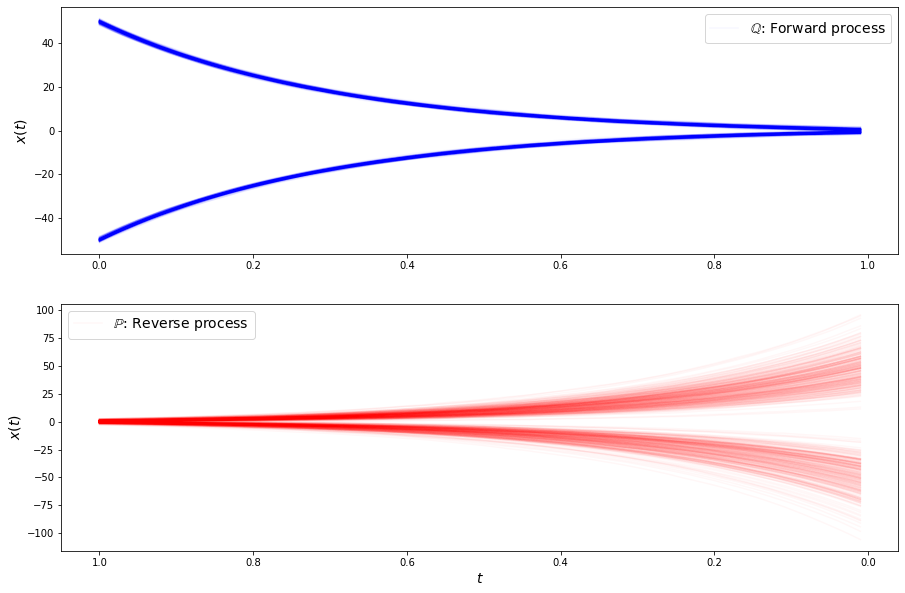

loss b 0.4930686056613922
loss b 0.5608721375465393
loss b 0.5276806354522705
loss b 0.5391188859939575
loss b 0.52501380443573
loss b 0.5543538928031921
loss b 0.5402987599372864
loss b 0.5425081253051758
loss b 0.4872579276561737
loss b 0.5939497947692871
loss b 0.5866032838821411
loss b 0.5617197751998901
loss b 0.48649054765701294
loss b 0.5092174410820007
loss b 0.5020402669906616
loss b 0.5391430258750916
loss b 0.5046062469482422
loss b 0.576993465423584
loss b 0.5571305155754089
loss b 0.5629827976226807
loss b 0.5368914008140564
loss b 0.46355754137039185
loss f 3.3306689262390137
loss f 3.335580348968506
loss f 3.336620569229126
loss f 3.3099122047424316
loss f 3.353238582611084
loss f 3.335364818572998
loss f 3.3284642696380615
loss f 3.3705475330352783
loss f 3.345651388168335
loss f 3.331733226776123
loss f 3.3461170196533203
loss f 3.3267695903778076
loss f 3.344285011291504
loss f 3.3618247509002686
loss f 3.3425683975219727
loss f 3.336122512817383
loss f 3.336685895919

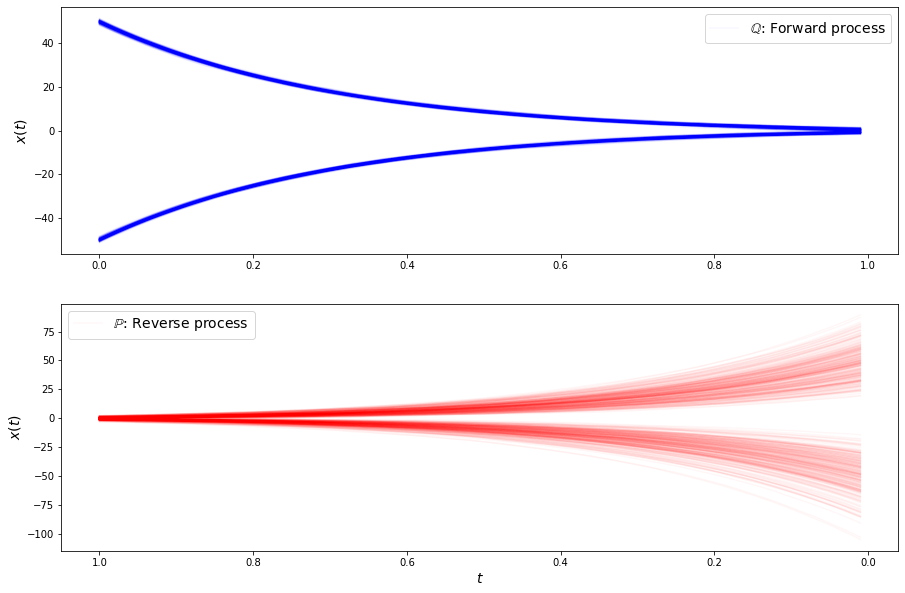

loss b 0.5501394271850586
loss b 0.5964547991752625
loss b 0.4741106927394867
loss b 0.505589485168457
loss b 0.6166532039642334
loss b 0.5844655632972717
loss b 0.4772530496120453
loss b 0.5505430698394775
loss b 0.548762857913971
loss b 0.5378590822219849
loss b 0.5995960235595703
loss b 0.5475778579711914
loss b 0.5656176209449768
loss b 0.5319461226463318
loss b 0.5480757355690002
loss b 0.4664953649044037
loss b 0.6592649221420288
loss b 0.46647804975509644
loss b 0.5115826725959778
loss b 0.5505496859550476
loss b 0.5266931056976318
loss b 0.5231271982192993
loss f 3.331929922103882
loss f 3.339614152908325
loss f 3.3498828411102295
loss f 3.3427534103393555
loss f 3.341944694519043
loss f 3.361767053604126
loss f 3.3378548622131348
loss f 3.3271193504333496
loss f 3.330101490020752
loss f 3.3376684188842773
loss f 3.3383026123046875
loss f 3.3147449493408203
loss f 3.3191986083984375
loss f 3.3423566818237305
loss f 3.3287699222564697
loss f 3.3367955684661865
loss f 3.334027767

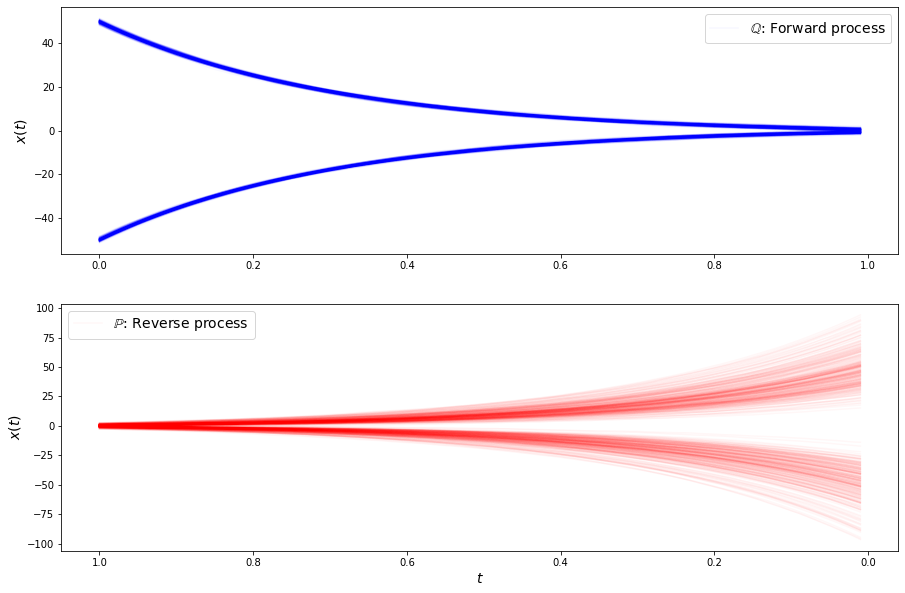

loss b 0.4918959140777588
loss b 0.5867368578910828
loss b 0.6173842549324036
loss b 0.5603301525115967
loss b 0.5102189779281616
loss b 0.5269168615341187
loss b 0.6137349605560303
loss b 0.5724108815193176
loss b 0.49192407727241516
loss b 0.5296415686607361
loss b 0.5200563073158264
loss b 0.4834928810596466
loss b 0.5659603476524353
loss b 0.4665847420692444
loss b 0.5309022665023804
loss b 0.5022664070129395
loss b 0.44081443548202515
loss b 0.47545233368873596
loss b 0.4954895079135895
loss b 0.5382790565490723
loss b 0.5477926135063171
loss b 0.5928220152854919
loss f 3.3413755893707275
loss f 3.3342676162719727
loss f 3.3441669940948486
loss f 3.340195894241333
loss f 3.3360989093780518
loss f 3.35160756111145
loss f 3.3222835063934326
loss f 3.3460514545440674
loss f 3.369541883468628
loss f 3.3317034244537354
loss f 3.3382468223571777
loss f 3.3582558631896973
loss f 3.3259117603302
loss f 3.3435306549072266
loss f 3.3689427375793457
loss f 3.327641248703003
loss f 3.36271667

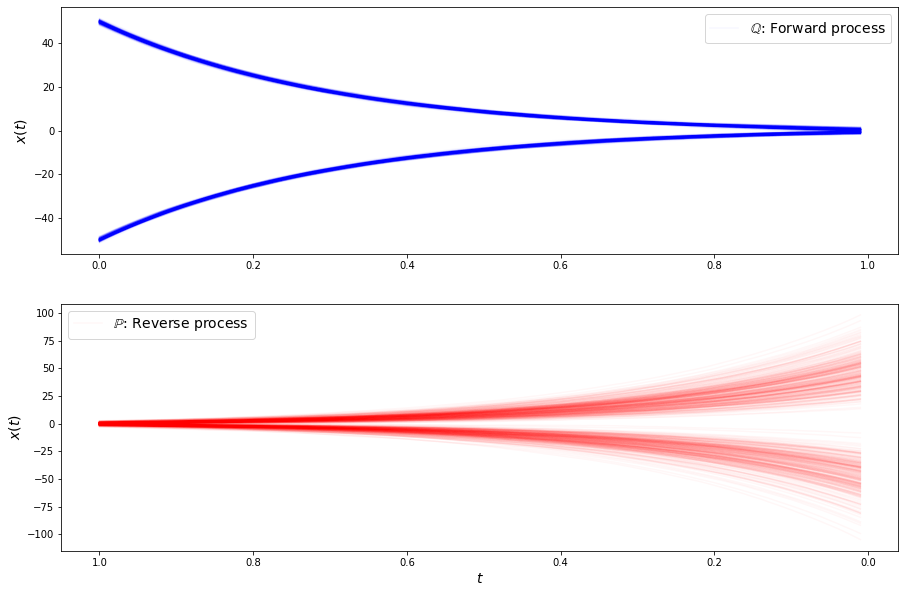

loss b 0.5568334460258484
loss b 0.5372491478919983
loss b 0.5860614776611328
loss b 0.4446312189102173
loss b 0.48204684257507324
loss b 0.6003144979476929
loss b 0.5748156905174255
loss b 0.5517324805259705
loss b 0.518979549407959
loss b 0.566657304763794
loss b 0.6205554604530334
loss b 0.4917006492614746
loss b 0.5056667327880859
loss b 0.5672087669372559
loss b 0.5074220299720764
loss b 0.5319052934646606
loss b 0.5680793523788452
loss b 0.5791033506393433
loss b 0.5810731053352356
loss b 0.607362687587738
loss b 0.4903886020183563
loss b 0.5143054127693176
loss f 3.3402419090270996
loss f 3.35070538520813
loss f 3.337123394012451
loss f 3.323665142059326
loss f 3.315355062484741
loss f 3.346646547317505
loss f 3.350430488586426
loss f 3.3308889865875244
loss f 3.326206922531128
loss f 3.317533493041992
loss f 3.3423359394073486
loss f 3.3194777965545654
loss f 3.3316643238067627
loss f 3.325157403945923
loss f 3.320709466934204
loss f 3.339103937149048
loss f 3.3312807083129883


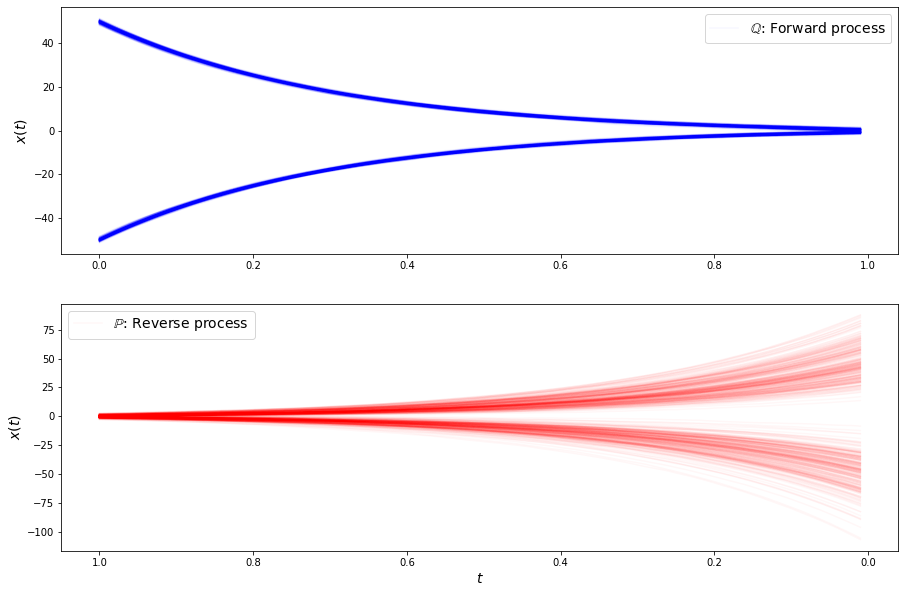

loss b 0.4967150092124939
loss b 0.4566130042076111
loss b 0.4643123745918274
loss b 0.6077233552932739
loss b 0.5345090627670288
loss b 0.5052604675292969
loss b 0.585812509059906
loss b 0.4982143044471741
loss b 0.5338339805603027
loss b 0.4391535520553589
loss b 0.5452002882957458
loss b 0.513923168182373
loss b 0.49965208768844604
loss b 0.4769288897514343
loss b 0.4754585027694702
loss b 0.48920726776123047
loss b 0.5047569870948792
loss b 0.5726516842842102
loss b 0.5384500026702881
loss b 0.5874369144439697
loss b 0.5099802613258362
loss b 0.5615246295928955
loss f 3.341418981552124
loss f 3.3425590991973877
loss f 3.3332924842834473
loss f 3.341533899307251
loss f 3.3385813236236572
loss f 3.3346774578094482
loss f 3.3406128883361816
loss f 3.3185055255889893
loss f 3.340362548828125
loss f 3.3366165161132812
loss f 3.3492815494537354
loss f 3.365039348602295
loss f 3.3585445880889893
loss f 3.3453104496002197
loss f 3.3365368843078613
loss f 3.3429360389709473
loss f 3.3483180

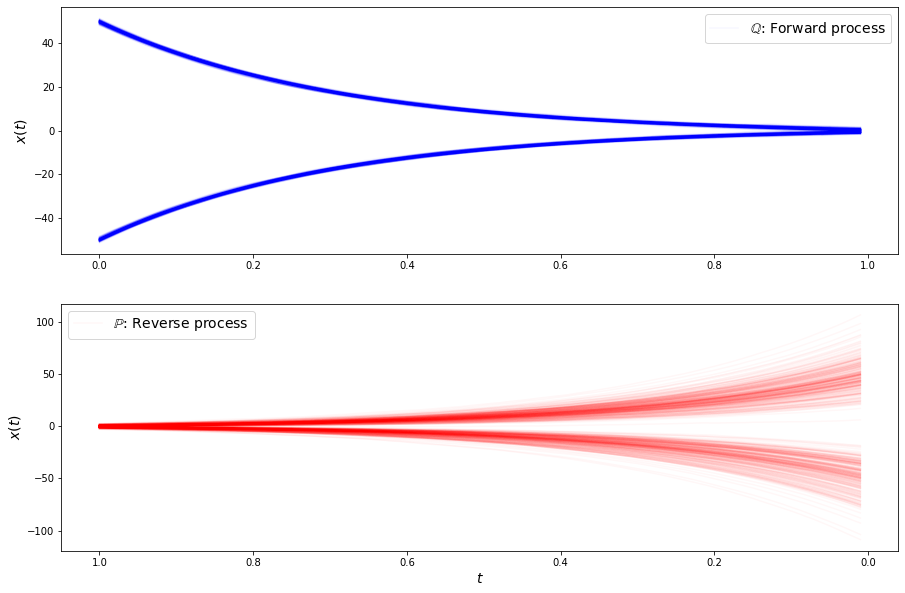

loss b 0.5276229977607727
loss b 0.519437313079834
loss b 0.5573222637176514
loss b 0.4374871253967285
loss b 0.5697183609008789
loss b 0.4933242201805115
loss b 0.6426849961280823
loss b 0.4687923192977905
loss b 0.5038104057312012
loss b 0.5584442615509033
loss b 0.5146431922912598
loss b 0.48813337087631226
loss b 0.5120331048965454
loss b 0.5572255253791809
loss b 0.5493634939193726
loss b 0.6187137961387634
loss b 0.7195217609405518
loss b 0.6236361265182495
loss b 0.5968925952911377
loss b 0.513052761554718
loss b 0.5449745059013367
loss b 0.49277347326278687
loss f 3.3535122871398926
loss f 3.312819004058838
loss f 3.325798749923706
loss f 3.348466396331787
loss f 3.309990644454956
loss f 3.326956033706665
loss f 3.3633015155792236
loss f 3.3301761150360107
loss f 3.349539041519165
loss f 3.3079564571380615
loss f 3.3545360565185547
loss f 3.3508596420288086
loss f 3.306229591369629
loss f 3.3364181518554688
loss f 3.3529715538024902
loss f 3.3500940799713135
loss f 3.3188414573

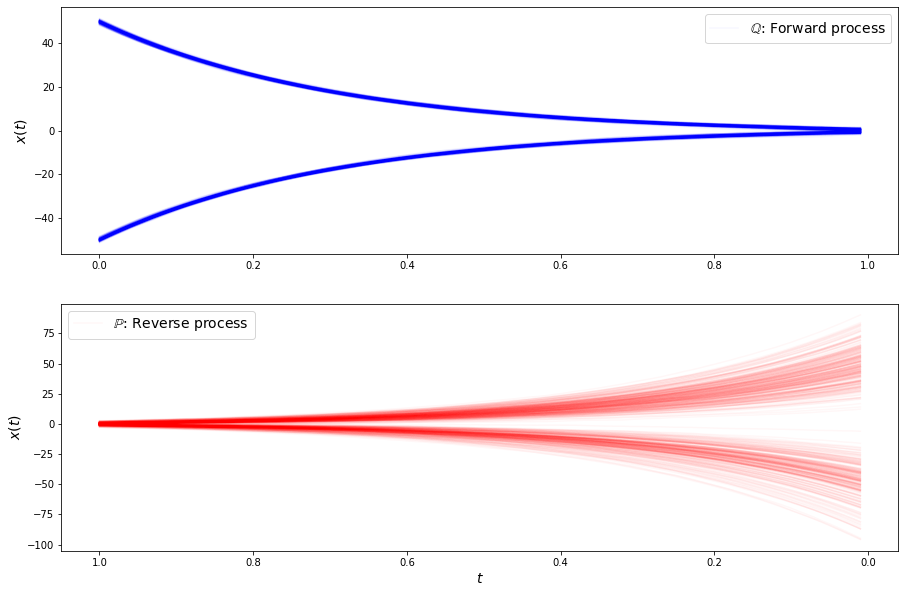

loss b 0.5746029019355774
loss b 0.6939729452133179
loss b 0.58721923828125
loss b 0.5648923516273499
loss b 0.5852169990539551
loss b 0.4413067400455475
loss b 0.5704060196876526
loss b 0.5034651160240173
loss b 0.5244061350822449
loss b 0.5258063673973083
loss b 0.48096781969070435
loss b 0.5880478024482727
loss b 0.5163734555244446
loss b 0.6064750552177429
loss b 0.5229804515838623
loss b 0.52020663022995
loss b 0.5030159950256348
loss b 0.5206300616264343
loss b 0.57212233543396
loss b 0.5507119297981262
loss b 0.5819687843322754
loss b 0.5783551335334778
loss f 3.3352415561676025
loss f 3.317979574203491
loss f 3.322566509246826
loss f 3.342576265335083
loss f 3.334874153137207
loss f 3.375911235809326
loss f 3.3276751041412354
loss f 3.333566904067993
loss f 3.3184170722961426
loss f 3.326800584793091
loss f 3.3210670948028564
loss f 3.3362956047058105
loss f 3.3196024894714355
loss f 3.3346564769744873
loss f 3.3126285076141357
loss f 3.327807903289795
loss f 3.3258376121520996

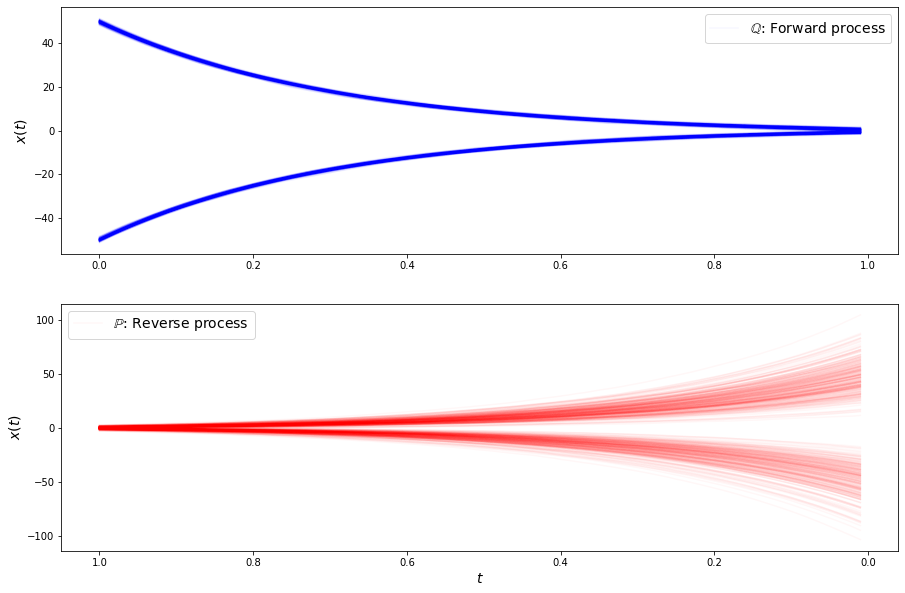

loss b 0.49588742852211
loss b 0.5335797071456909
loss b 0.5890220999717712
loss b 0.48060479760169983
loss b 0.5337382555007935
loss b 0.48608437180519104
loss b 0.504474401473999
loss b 0.499238520860672
loss b 0.5160197615623474
loss b 0.5501386523246765
loss b 0.500410795211792
loss b 0.5762911438941956
loss b 0.5106751322746277
loss b 0.5348131656646729
loss b 0.4675338864326477
loss b 0.5855321884155273
loss b 0.5452659130096436
loss b 0.553930938243866
loss b 0.5745218396186829
loss b 0.5769607424736023
loss b 0.5486055016517639
loss b 0.5266761183738708
loss f 3.3275465965270996
loss f 3.322267532348633
loss f 3.294231414794922
loss f 3.3152499198913574
loss f 3.3393054008483887
loss f 3.3410844802856445
loss f 3.325685977935791
loss f 3.3433024883270264
loss f 3.327383041381836
loss f 3.3182404041290283
loss f 3.3261067867279053
loss f 3.3428544998168945
loss f 3.3258583545684814
loss f 3.3252925872802734
loss f 3.3336575031280518
loss f 3.3203744888305664
loss f 3.31500244140

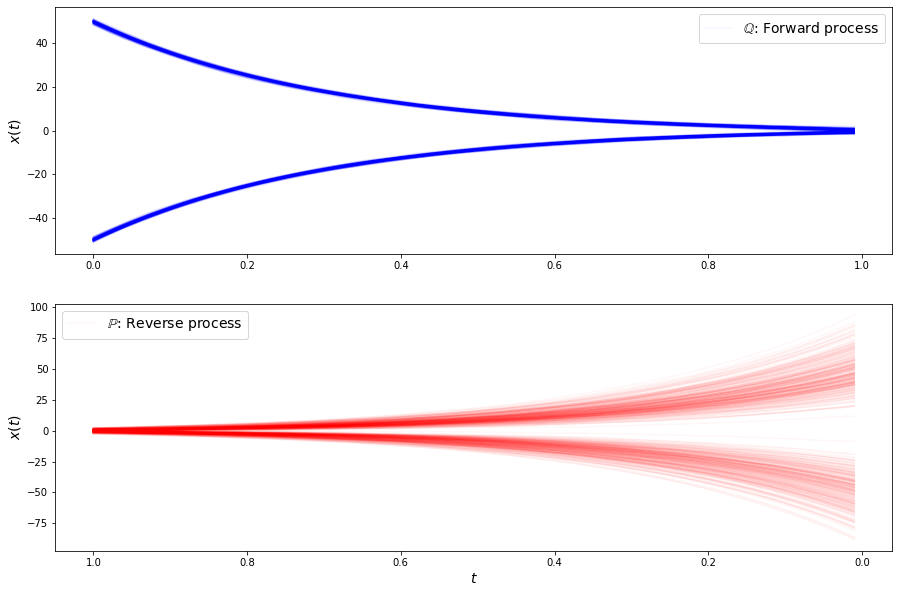

loss b 0.5355482697486877
loss b 0.487909197807312
loss b 0.5140520334243774
loss b 0.47586384415626526
loss b 0.5253505110740662
loss b 0.529502809047699
loss b 0.5323203206062317
loss b 0.6495508551597595
loss b 0.5055167078971863
loss b 0.48708152770996094
loss b 0.43528425693511963
loss b 0.5238397121429443
loss b 0.5375567674636841
loss b 0.4451374113559723
loss b 0.4707106351852417
loss b 0.4981940686702728
loss b 0.5836009979248047
loss b 0.528126060962677
loss b 0.5327156186103821
loss b 0.6064841151237488
loss b 0.5268744230270386
loss b 0.48437443375587463
loss f 3.332348346710205
loss f 3.324932813644409
loss f 3.337789535522461
loss f 3.315164566040039
loss f 3.303595542907715
loss f 3.374905824661255
loss f 3.3119585514068604
loss f 3.3371081352233887
loss f 3.3033690452575684
loss f 3.3256325721740723
loss f 3.307642936706543
loss f 3.311676502227783
loss f 3.321686029434204
loss f 3.3009519577026367
loss f 3.2981679439544678
loss f 3.335583448410034
loss f 3.319669485092

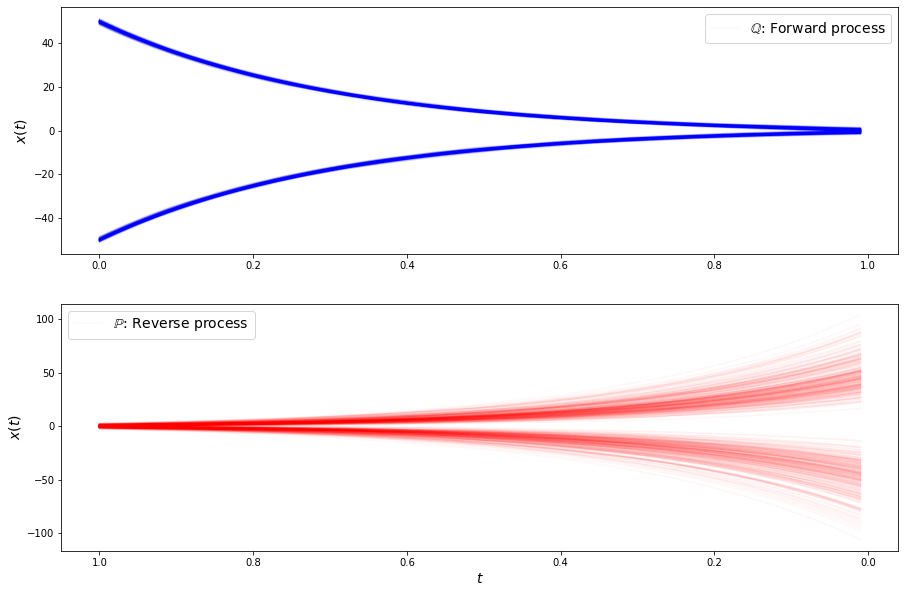

loss b 0.4391818046569824
loss b 0.5066690444946289
loss b 0.5992839932441711
loss b 0.5050515532493591
loss b 0.449632853269577
loss b 0.5707927346229553
loss b 0.49989935755729675
loss b 0.5796418786048889
loss b 0.5090411305427551
loss b 0.5655867457389832
loss b 0.516446590423584
loss b 0.4971708059310913
loss b 0.47649630904197693
loss b 0.5315796732902527
loss b 0.5372073650360107
loss b 0.6032005548477173
loss b 0.4767788052558899
loss b 0.48066872358322144
loss b 0.5264164805412292
loss b 0.5616938471794128
loss b 0.5606949329376221
loss b 0.5843894481658936
loss f 3.3031458854675293
loss f 3.314131259918213
loss f 3.3357934951782227
loss f 3.3220551013946533
loss f 3.3370652198791504
loss f 3.3283512592315674
loss f 3.298842668533325
loss f 3.310551881790161
loss f 3.3305790424346924
loss f 3.299619674682617
loss f 3.3377130031585693
loss f 3.3524169921875
loss f 3.3143019676208496
loss f 3.3201088905334473
loss f 3.311311960220337
loss f 3.325331449508667
loss f 3.30605483055

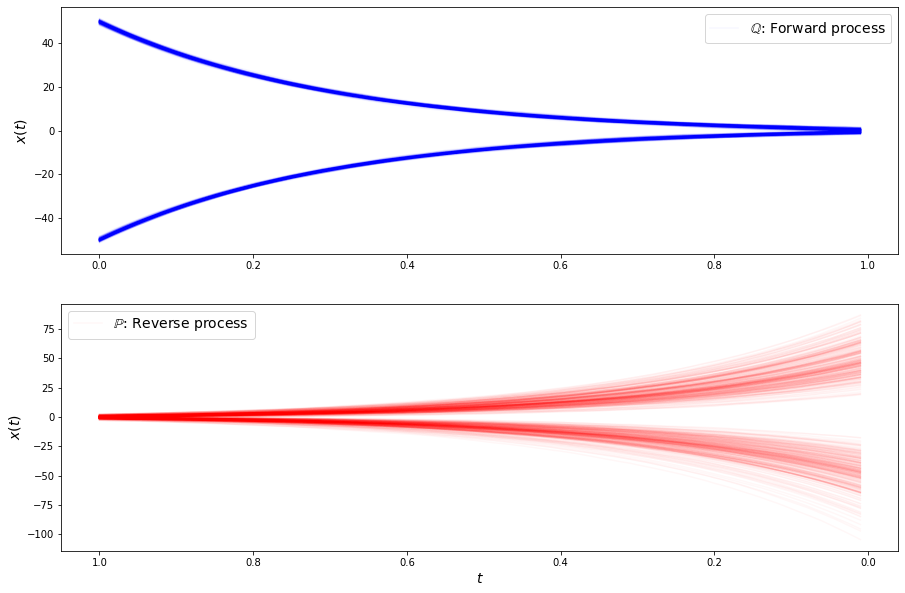

loss b 0.4803895652294159
loss b 0.5337496995925903
loss b 0.49613848328590393
loss b 0.5124445557594299
loss b 0.5450182557106018
loss b 0.575423538684845
loss b 0.5805684924125671
loss b 0.5088661909103394
loss b 0.5239421129226685
loss b 0.5681840181350708
loss b 0.5751311779022217
loss b 0.5182074904441833
loss b 0.5331234335899353
loss b 0.5524307489395142
loss b 0.527914822101593
loss b 0.5351921319961548
loss b 0.5429545044898987
loss b 0.5282371044158936
loss b 0.564735472202301
loss b 0.5189954042434692
loss b 0.4932846426963806
loss b 0.5880732536315918
loss f 3.331226110458374
loss f 3.3284873962402344
loss f 3.3179144859313965
loss f 3.3107094764709473
loss f 3.336451530456543
loss f 3.3378195762634277
loss f 3.311950445175171
loss f 3.310732841491699
loss f 3.350266933441162
loss f 3.344857931137085
loss f 3.327946901321411
loss f 3.323054313659668
loss f 3.317748546600342
loss f 3.3267745971679688
loss f 3.308387517929077
loss f 3.322249412536621
loss f 3.336745023727417


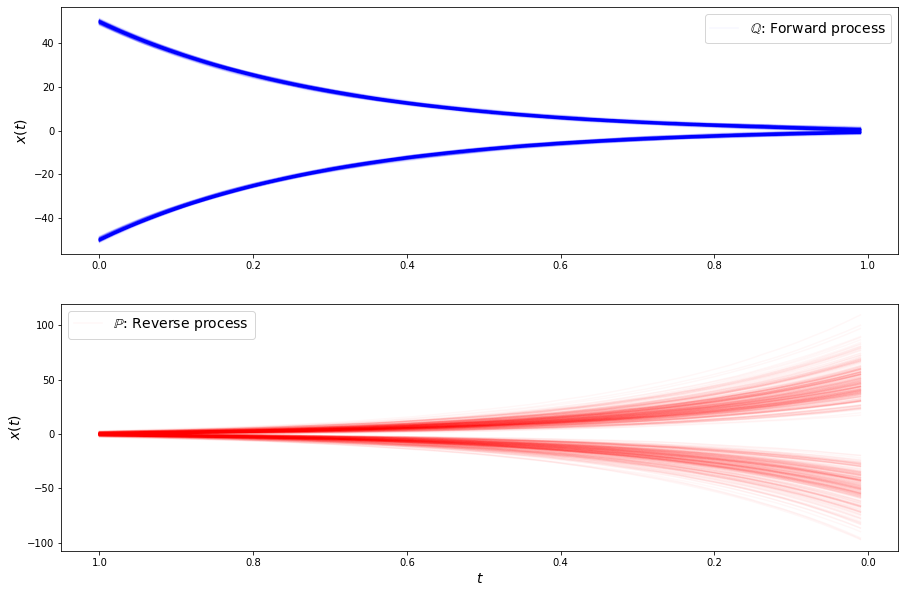

loss b 0.5491013526916504
loss b 0.5139368772506714
loss b 0.5683069229125977
loss b 0.477403461933136
loss b 0.4649936258792877
loss b 0.49877050518989563
loss b 0.5366891026496887
loss b 0.5391510128974915
loss b 0.5302621126174927
loss b 0.5226524472236633
loss b 0.5472553968429565
loss b 0.5578941106796265
loss b 0.5538171529769897
loss b 0.5359209775924683
loss b 0.5332993268966675
loss b 0.46816664934158325
loss b 0.4763469398021698
loss b 0.5072230100631714
loss b 0.49842268228530884
loss b 0.5271204113960266
loss b 0.5144995450973511
loss b 0.4697953760623932
loss f 3.3402726650238037
loss f 3.3103575706481934
loss f 3.3199260234832764
loss f 3.294153928756714
loss f 3.3334085941314697
loss f 3.327782392501831
loss f 3.338101863861084
loss f 3.329739809036255
loss f 3.3393514156341553
loss f 3.3399202823638916
loss f 3.3385109901428223
loss f 3.358834981918335
loss f 3.334774971008301
loss f 3.323009729385376
loss f 3.313054323196411
loss f 3.3362181186676025
loss f 3.322687387

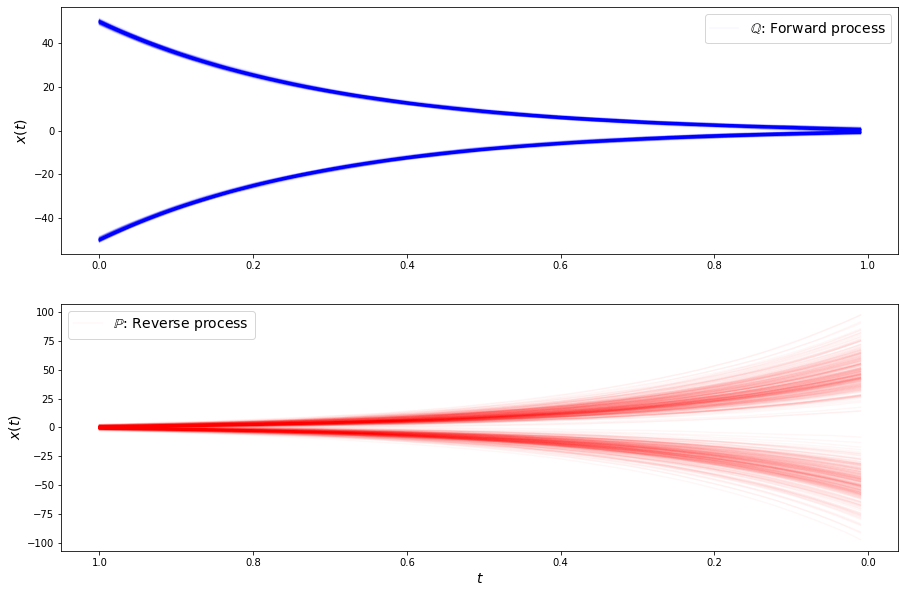

loss b 0.5765644311904907
loss b 0.5050231218338013
loss b 0.5270864367485046
loss b 0.6105967164039612
loss b 0.5420351028442383
loss b 0.5570399165153503
loss b 0.49861449003219604
loss b 0.5163333415985107
loss b 0.4524044990539551
loss b 0.4977830648422241
loss b 0.5077133774757385
loss b 0.5726376175880432
loss b 0.4886651039123535
loss b 0.5049889087677002
loss b 0.5139586925506592
loss b 0.5054397583007812
loss b 0.5571759343147278
loss b 0.6216363906860352
loss b 0.5532401204109192
loss b 0.5333500504493713
loss b 0.5000724792480469
loss b 0.4854729473590851
loss f 3.3159024715423584
loss f 3.3365540504455566
loss f 3.31630802154541
loss f 3.3319263458251953
loss f 3.3147926330566406
loss f 3.306337594985962
loss f 3.321934700012207
loss f 3.309534788131714
loss f 3.301813840866089
loss f 3.3468821048736572
loss f 3.3160996437072754
loss f 3.298999547958374
loss f 3.326266050338745
loss f 3.323197364807129
loss f 3.3396925926208496
loss f 3.3031911849975586
loss f 3.30841159820

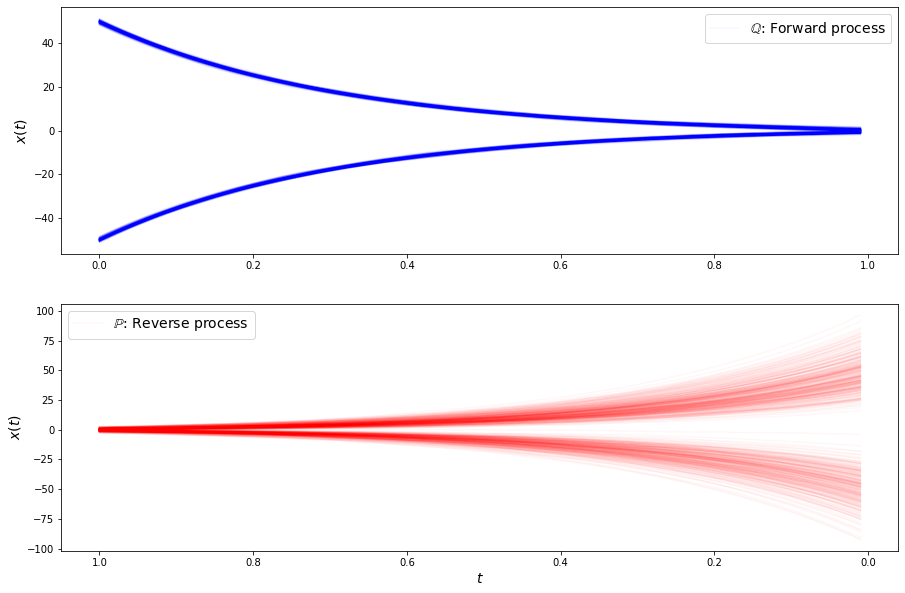

loss b 0.5517272353172302
loss b 0.608505368232727
loss b 0.5537233352661133
loss b 0.5198468565940857
loss b 0.506958544254303
loss b 0.47606325149536133
loss b 0.5008280873298645
loss b 0.5486693978309631
loss b 0.5184052586555481
loss b 0.5494457483291626
loss b 0.46869269013404846
loss b 0.6299605965614319
loss b 0.48466601967811584
loss b 0.5257010459899902
loss b 0.519070565700531
loss b 0.45021018385887146
loss b 0.485946387052536
loss b 0.533656895160675
loss b 0.49281224608421326
loss b 0.5075821280479431
loss b 0.5144632458686829
loss b 0.5470635294914246
loss f 3.3033759593963623
loss f 3.3194146156311035
loss f 3.330930233001709
loss f 3.3003764152526855
loss f 3.331880569458008
loss f 3.3066797256469727
loss f 3.305537462234497
loss f 3.31643009185791
loss f 3.3174121379852295
loss f 3.3327465057373047
loss f 3.323371171951294
loss f 3.3356380462646484
loss f 3.3101279735565186
loss f 3.321924924850464
loss f 3.3057634830474854
loss f 3.329423189163208
loss f 3.31776165962

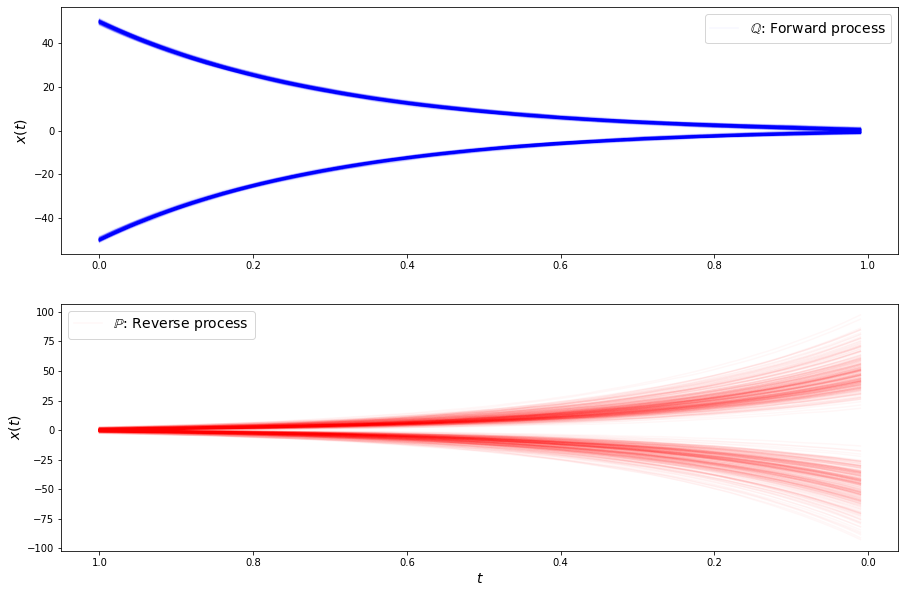

loss b 0.4998733699321747
loss b 0.5190417766571045
loss b 0.6634293794631958
loss b 0.5320786237716675
loss b 0.5120862126350403
loss b 0.5667693018913269
loss b 0.5187162756919861
loss b 0.5055878162384033
loss b 0.45072999596595764
loss b 0.47774940729141235
loss b 0.4779074788093567
loss b 0.49798792600631714
loss b 0.537260890007019
loss b 0.6294437646865845
loss b 0.5872424840927124
loss b 0.5279514193534851
loss b 0.5758343935012817
loss b 0.5226651430130005
loss b 0.48532116413116455
loss b 0.5102560520172119
loss b 0.540745735168457
loss b 0.5139408111572266
loss f 3.3434677124023438
loss f 3.335394859313965
loss f 3.3488690853118896
loss f 3.336904287338257
loss f 3.327085494995117
loss f 3.2908687591552734
loss f 3.3245227336883545
loss f 3.34499454498291
loss f 3.318218231201172
loss f 3.3430333137512207
loss f 3.3151140213012695
loss f 3.350024461746216
loss f 3.335707664489746
loss f 3.324512004852295
loss f 3.333481788635254
loss f 3.2930259704589844
loss f 3.32406091690

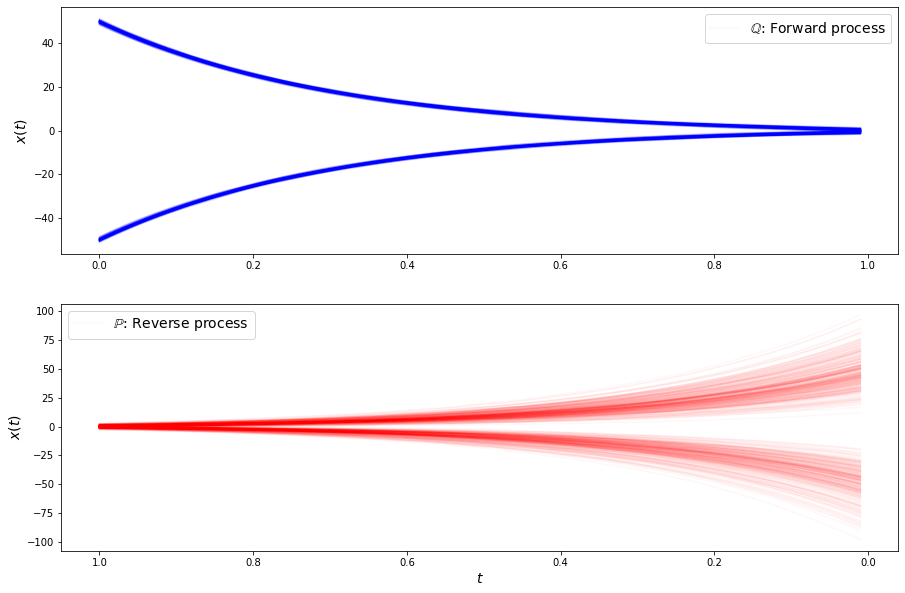

loss b 0.4888828694820404
loss b 0.5644856691360474
loss b 0.5216324329376221
loss b 0.47728171944618225
loss b 0.6689902544021606
loss b 0.4914730191230774
loss b 0.5103813409805298
loss b 0.44933387637138367
loss b 0.5099159479141235
loss b 0.5393558144569397
loss b 0.5065762400627136
loss b 0.479895681142807
loss b 0.5814710855484009
loss b 0.5085707306861877
loss b 0.4951840937137604
loss b 0.5097435712814331
loss b 0.5632877349853516
loss b 0.4886864125728607
loss b 0.5465940237045288
loss b 0.5370776653289795
loss b 0.48539289832115173
loss b 0.44711461663246155
loss f 3.324265241622925
loss f 3.3112995624542236
loss f 3.3292438983917236
loss f 3.3060457706451416
loss f 3.3124077320098877
loss f 3.3319289684295654
loss f 3.301349401473999
loss f 3.3015265464782715
loss f 3.301325798034668
loss f 3.3172404766082764
loss f 3.336092472076416
loss f 3.32079815864563
loss f 3.3181538581848145
loss f 3.3422720432281494
loss f 3.3183906078338623
loss f 3.3186588287353516
loss f 3.324974

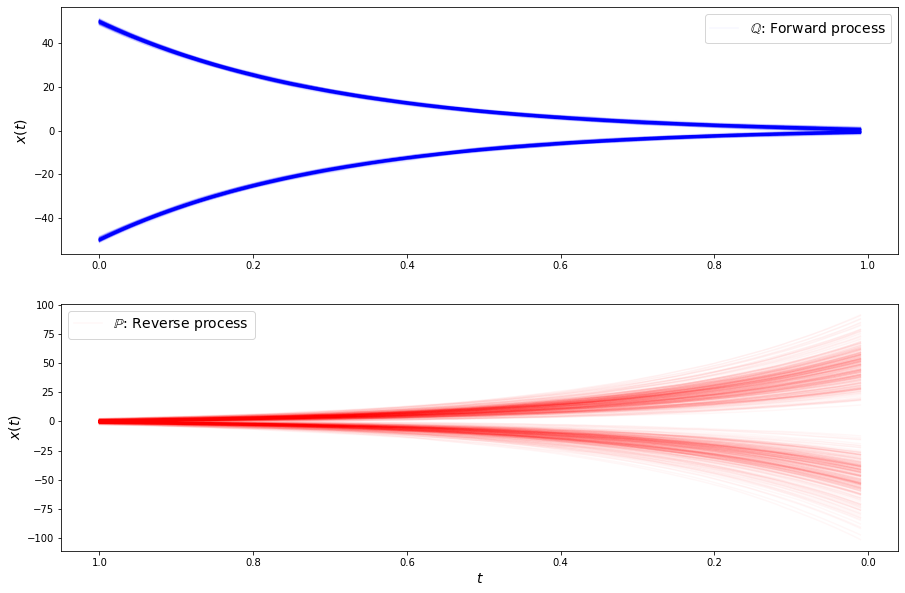

loss b 0.5374221205711365
loss b 0.5451366305351257
loss b 0.5073018670082092
loss b 0.5793690085411072
loss b 0.5507134795188904
loss b 0.4813987910747528
loss b 0.5563796758651733
loss b 0.5483278632164001
loss b 0.5412828922271729
loss b 0.5520387291908264
loss b 0.5076777338981628
loss b 0.5193860530853271
loss b 0.5258758068084717
loss b 0.4908086359500885
loss b 0.517326295375824
loss b 0.5377673506736755
loss b 0.5007957816123962
loss b 0.5198750495910645
loss b 0.5081720352172852
loss b 0.588215172290802
loss b 0.5963196158409119
loss b 0.48702138662338257
loss f 3.324331760406494
loss f 3.3208205699920654
loss f 3.319427013397217
loss f 3.3100359439849854
loss f 3.3225865364074707
loss f 3.3006772994995117
loss f 3.332235097885132
loss f 3.31608510017395
loss f 3.30743408203125
loss f 3.3250279426574707
loss f 3.3347713947296143
loss f 3.325523614883423
loss f 3.320735454559326
loss f 3.296678066253662
loss f 3.3298757076263428
loss f 3.3186564445495605
loss f 3.35544800758361

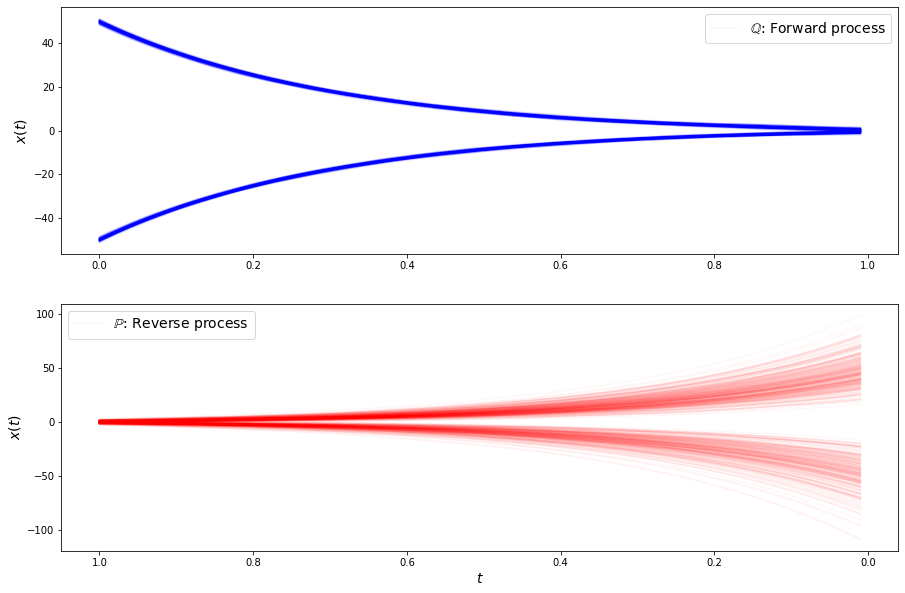

loss b 0.5443919897079468
loss b 0.4087848961353302
loss b 0.508967936038971
loss b 0.4896933138370514
loss b 0.5025098323822021
loss b 0.5672802329063416
loss b 0.469204843044281
loss b 0.4285552501678467
loss b 0.4749547243118286
loss b 0.5013574957847595
loss b 0.5209303498268127
loss b 0.5100060701370239
loss b 0.47116774320602417
loss b 0.4317358434200287
loss b 0.513903021812439
loss b 0.5269759893417358
loss b 0.46093061566352844
loss b 0.5352826714515686
loss b 0.45091480016708374
loss b 0.5229734778404236
loss b 0.501626193523407
loss b 0.5518743395805359
loss f 3.3070578575134277
loss f 3.304877996444702
loss f 3.3046364784240723
loss f 3.326798677444458
loss f 3.3472578525543213
loss f 3.3487064838409424
loss f 3.323439598083496
loss f 3.297950029373169
loss f 3.347898244857788
loss f 3.312136650085449
loss f 3.3025128841400146
loss f 3.304598569869995
loss f 3.332537889480591
loss f 3.33648681640625
loss f 3.338628053665161
loss f 3.325976610183716
loss f 3.354870557785034


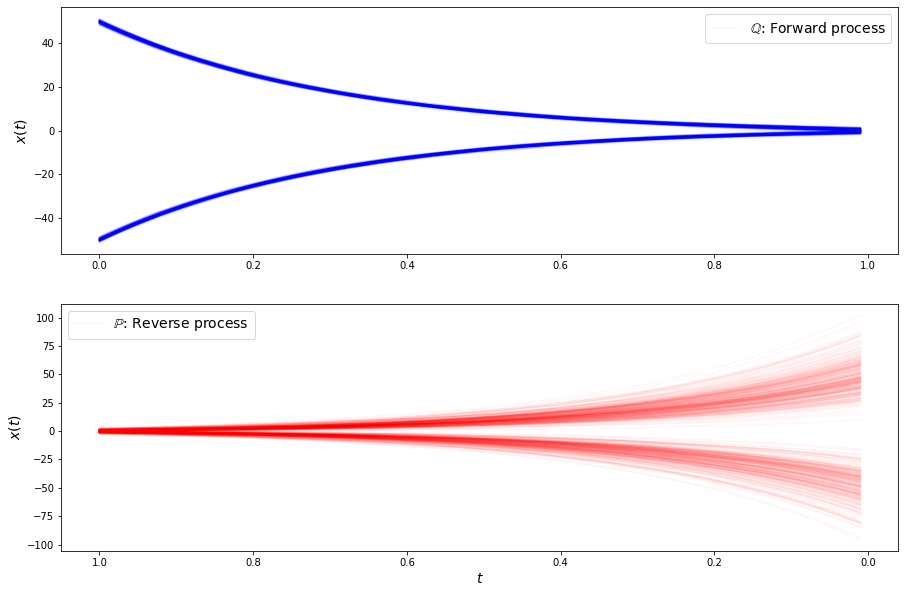

loss b 0.5319151282310486
loss b 0.5185003876686096
loss b 0.6109937429428101
loss b 0.5516915917396545
loss b 0.4616601765155792
loss b 0.4669436514377594
loss b 0.448483943939209
loss b 0.48123428225517273
loss b 0.5348532795906067
loss b 0.5144832134246826
loss b 0.5180134177207947
loss b 0.464572012424469
loss b 0.547353982925415
loss b 0.4862697422504425
loss b 0.48608213663101196
loss b 0.5035122632980347
loss b 0.5188270807266235
loss b 0.5669056177139282
loss b 0.5552976131439209
loss b 0.5168530941009521
loss b 0.5542517304420471
loss b 0.5222232937812805
loss f 3.319417953491211
loss f 3.3081018924713135
loss f 3.3198585510253906
loss f 3.316452980041504
loss f 3.333782434463501
loss f 3.3176164627075195
loss f 3.3078184127807617
loss f 3.3287200927734375
loss f 3.316438913345337
loss f 3.2881479263305664
loss f 3.3310694694519043
loss f 3.3344521522521973
loss f 3.317018508911133
loss f 3.3266589641571045
loss f 3.3102612495422363
loss f 3.3164494037628174
loss f 3.323456048

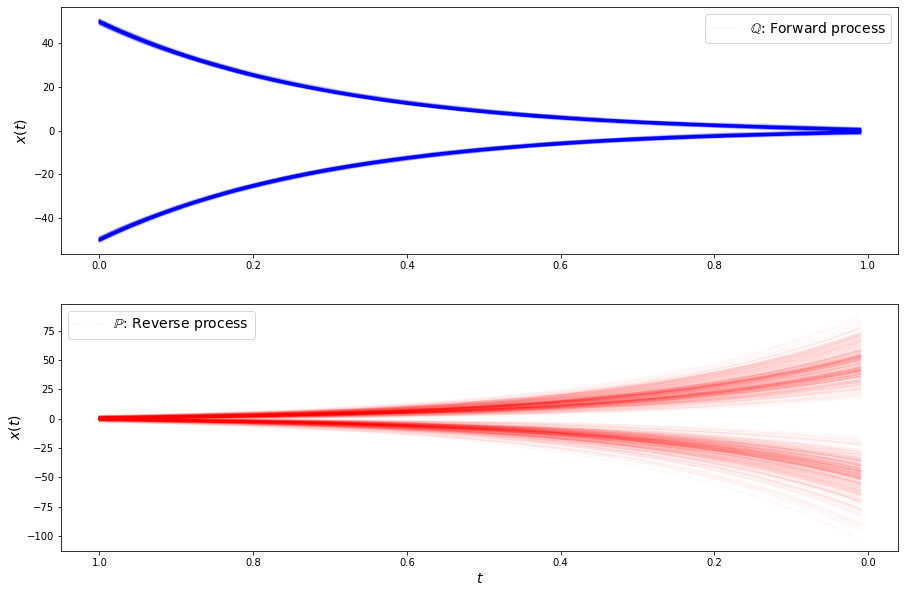

loss b 0.5613471269607544
loss b 0.5167255997657776
loss b 0.4768996834754944
loss b 0.5298604965209961
loss b 0.5202301144599915
loss b 0.4584692418575287
loss b 0.5066038966178894
loss b 0.5986769795417786
loss b 0.4848778247833252
loss b 0.46144241094589233
loss b 0.48120611906051636
loss b 0.5812001824378967
loss b 0.5128539204597473
loss b 0.47011512517929077
loss b 0.5001315474510193
loss b 0.5140685439109802
loss b 0.5098150372505188
loss b 0.4542873501777649
loss b 0.5274303555488586
loss b 0.4876869022846222
loss b 0.5576848983764648
loss b 0.5067753195762634
loss f 3.2949283123016357
loss f 3.323786735534668
loss f 3.3088154792785645
loss f 3.319382429122925
loss f 3.3056249618530273
loss f 3.325721502304077
loss f 3.2960333824157715
loss f 3.3240413665771484
loss f 3.3247179985046387
loss f 3.305220603942871
loss f 3.340864419937134
loss f 3.3344969749450684
loss f 3.3343594074249268
loss f 3.319812774658203
loss f 3.348268985748291
loss f 3.3300364017486572
loss f 3.3480648

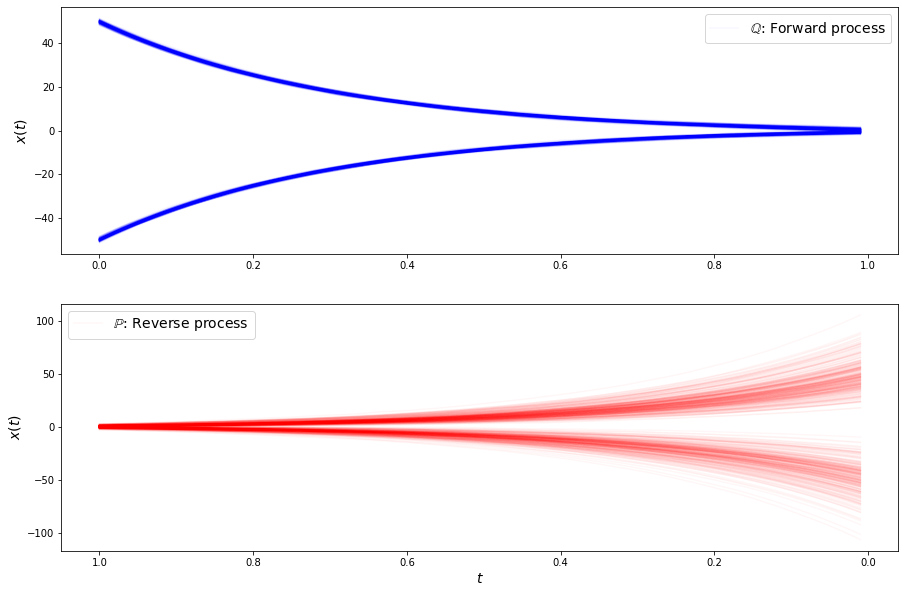

loss b 0.5293245911598206
loss b 0.5425657033920288
loss b 0.48105955123901367
loss b 0.5150493383407593
loss b 0.5257871150970459
loss b 0.5145852565765381
loss b 0.564052402973175
loss b 0.44803351163864136
loss b 0.6320701241493225
loss b 0.5058455467224121
loss b 0.45091092586517334
loss b 0.5288804173469543
loss b 0.5226796865463257
loss b 0.5204293131828308
loss b 0.48843392729759216
loss b 0.5609858632087708
loss b 0.491609662771225
loss b 0.4738633632659912
loss b 0.5204143524169922
loss b 0.565210223197937
loss b 0.46951404213905334
loss b 0.5249312520027161
loss f 3.3233416080474854
loss f 3.3093175888061523
loss f 3.3022305965423584
loss f 3.334740400314331
loss f 3.3357834815979004
loss f 3.3230814933776855
loss f 3.347860813140869
loss f 3.3019890785217285
loss f 3.314694404602051
loss f 3.329143524169922
loss f 3.327467918395996
loss f 3.334951162338257
loss f 3.2929134368896484
loss f 3.2936670780181885
loss f 3.341963529586792
loss f 3.3234426975250244
loss f 3.33579444

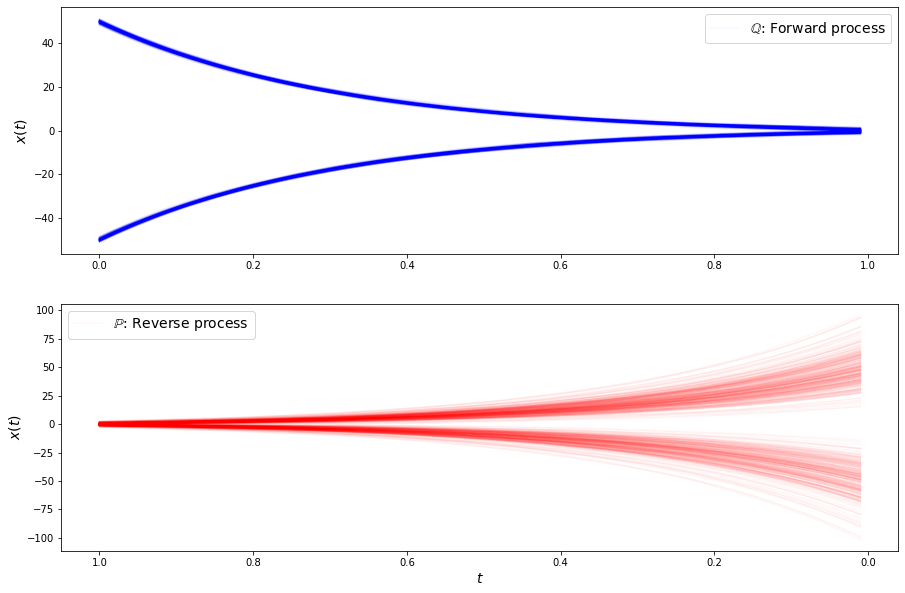

loss b 0.5445388555526733
loss b 0.4688268303871155
loss b 0.5034023523330688
loss b 0.6353358626365662
loss b 0.5019839406013489
loss b 0.5195632576942444
loss b 0.4093790054321289
loss b 0.5018550753593445
loss b 0.4765545129776001
loss b 0.5185118913650513
loss b 0.5192791819572449
loss b 0.5580403208732605
loss b 0.5535231232643127
loss b 0.5122864246368408
loss b 0.5044763684272766
loss b 0.5244583487510681
loss b 0.41241809725761414
loss b 0.5250548720359802
loss b 0.5280253887176514
loss b 0.5166391134262085
loss b 0.45839354395866394
loss b 0.5251232385635376
loss f 3.343317985534668
loss f 3.3090295791625977
loss f 3.3161542415618896
loss f 3.3206088542938232
loss f 3.3476860523223877
loss f 3.3451621532440186
loss f 3.331460952758789
loss f 3.3102633953094482
loss f 3.334538459777832
loss f 3.3488714694976807
loss f 3.3173635005950928
loss f 3.2952542304992676
loss f 3.305048942565918
loss f 3.318049430847168
loss f 3.3257694244384766
loss f 3.3180036544799805
loss f 3.285245

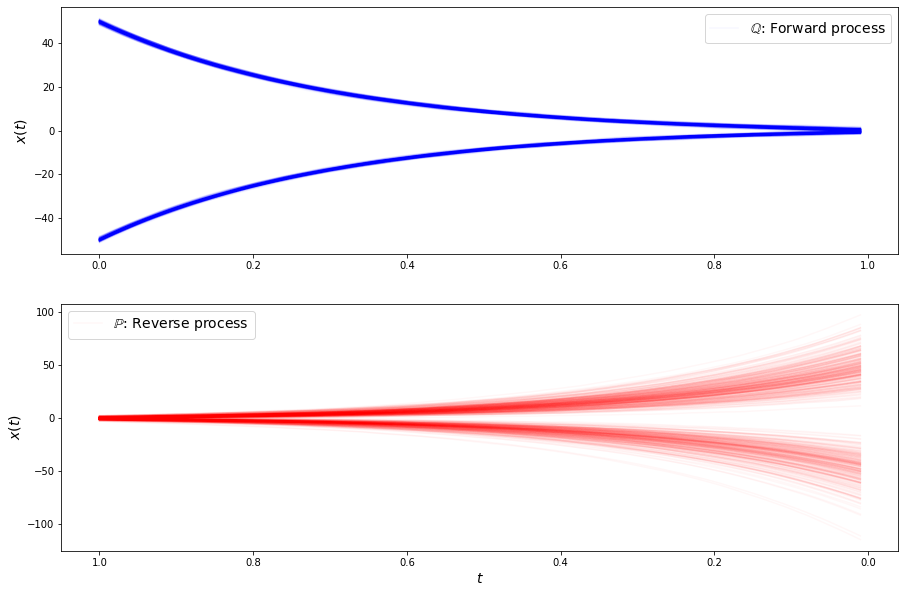

loss b 0.5416952967643738
loss b 0.5885481834411621
loss b 0.5176067352294922
loss b 0.4603673219680786
loss b 0.5700548887252808
loss b 0.5012668371200562
loss b 0.5435415506362915
loss b 0.550655722618103
loss b 0.4363528788089752
loss b 0.5310911536216736
loss b 0.583246111869812
loss b 0.5509139895439148
loss b 0.5461217761039734
loss b 0.5389090776443481
loss b 0.5207000374794006
loss b 0.5003962516784668
loss b 0.5233698487281799
loss b 0.537941038608551
loss b 0.48241716623306274
loss b 0.49262741208076477
loss b 0.4986293315887451
loss b 0.5116899013519287
loss f 3.3243331909179688
loss f 3.302412748336792
loss f 3.3168435096740723
loss f 3.3020682334899902
loss f 3.307847023010254
loss f 3.3197460174560547
loss f 3.304999351501465
loss f 3.349278211593628
loss f 3.3414199352264404
loss f 3.3194236755371094
loss f 3.297119617462158
loss f 3.320358991622925
loss f 3.305061101913452
loss f 3.3010096549987793
loss f 3.322474956512451
loss f 3.3114004135131836
loss f 3.338165521621

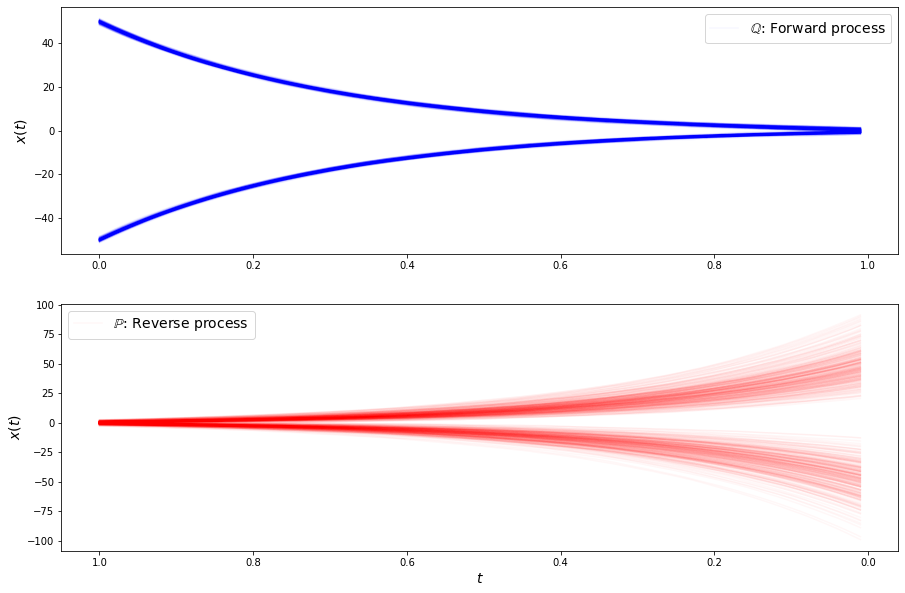

loss b 0.3936282992362976
loss b 0.510627269744873
loss b 0.5264233946800232
loss b 0.5196654796600342
loss b 0.4444335997104645
loss b 0.5094095468521118
loss b 0.5640825033187866
loss b 0.5192009806632996
loss b 0.4439716935157776
loss b 0.5217525959014893
loss b 0.4920300543308258
loss b 0.4969038963317871
loss b 0.5238406658172607
loss b 0.5222907662391663
loss b 0.4935109615325928
loss b 0.5313509702682495
loss b 0.4506559371948242
loss b 0.5680443048477173
loss b 0.4131482243537903
loss b 0.5320797562599182
loss b 0.42985740303993225
loss b 0.48044779896736145
loss f 3.318912982940674
loss f 3.2749226093292236
loss f 3.3203811645507812
loss f 3.322131395339966
loss f 3.3141119480133057
loss f 3.310126543045044
loss f 3.290600061416626
loss f 3.3280553817749023
loss f 3.310983180999756
loss f 3.339694023132324
loss f 3.3172760009765625
loss f 3.2960104942321777
loss f 3.30252742767334
loss f 3.2868216037750244
loss f 3.324892044067383
loss f 3.320260524749756
loss f 3.316562414169

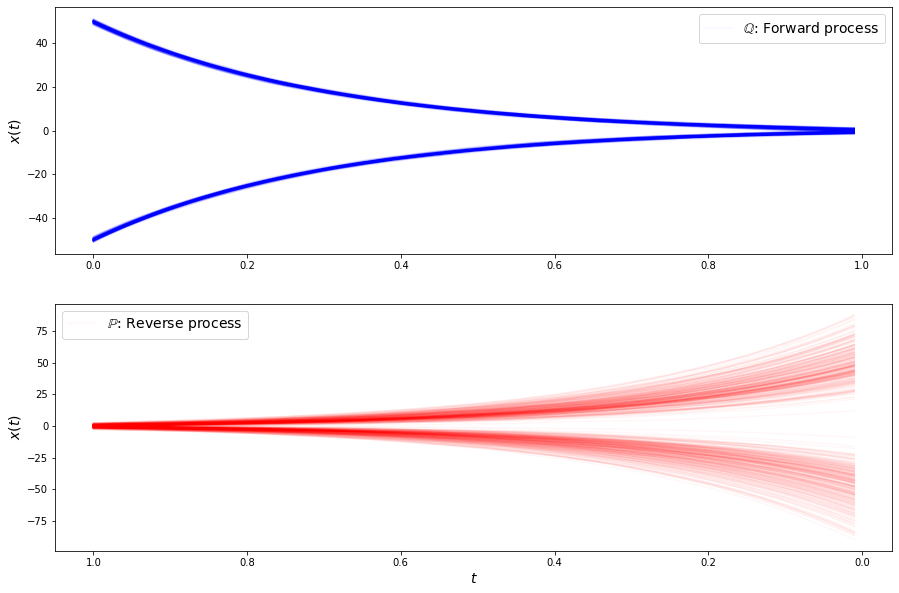

loss b 0.539501428604126
loss b 0.5468827486038208
loss b 0.528023362159729
loss b 0.5276762247085571
loss b 0.42012348771095276
loss b 0.56363844871521
loss b 0.4791063070297241
loss b 0.4630097448825836
loss b 0.5083385109901428
loss b 0.47426319122314453
loss b 0.48603352904319763
loss b 0.5020521283149719
loss b 0.47450393438339233
loss b 0.5265737771987915
loss b 0.5025807023048401
loss b 0.6030853986740112
loss b 0.45914554595947266
loss b 0.5786340236663818
loss b 0.5321469306945801
loss b 0.5967192053794861
loss b 0.48442187905311584
loss b 0.5294116139411926
loss f 3.3258800506591797
loss f 3.2875115871429443
loss f 3.3021059036254883
loss f 3.2897720336914062
loss f 3.3107895851135254
loss f 3.3097915649414062
loss f 3.314121723175049
loss f 3.331298589706421
loss f 3.348065137863159
loss f 3.323087453842163
loss f 3.3181686401367188
loss f 3.3290464878082275
loss f 3.3195364475250244
loss f 3.3418643474578857
loss f 3.3016457557678223
loss f 3.304865598678589
loss f 3.322889

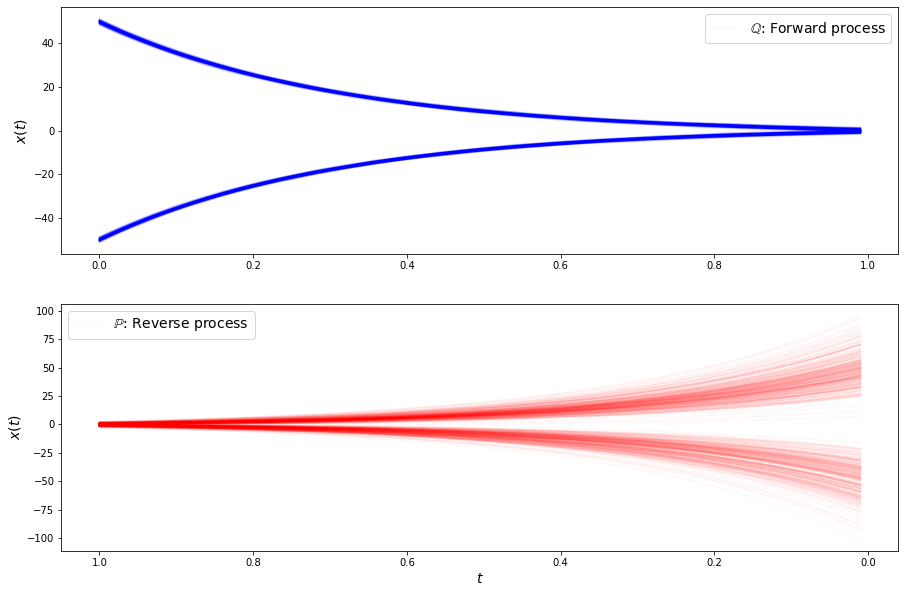

loss b 0.4930516183376312
loss b 0.5274491906166077
loss b 0.48977145552635193
loss b 0.4578910171985626
loss b 0.4687845706939697
loss b 0.4661470949649811
loss b 0.535681426525116
loss b 0.4517134428024292
loss b 0.5095081329345703
loss b 0.46507498621940613
loss b 0.49223223328590393
loss b 0.5121980905532837
loss b 0.4588567614555359
loss b 0.534369707107544
loss b 0.4989612400531769
loss b 0.5139474272727966
loss b 0.49500054121017456
loss b 0.5470409989356995
loss b 0.5090311765670776
loss b 0.4872991144657135
loss b 0.5281229019165039
loss b 0.4670877754688263
loss f 3.3067541122436523
loss f 3.3132479190826416
loss f 3.3124990463256836
loss f 3.3266735076904297
loss f 3.3086912631988525
loss f 3.3125159740448
loss f 3.343878984451294
loss f 3.310659646987915
loss f 3.318908452987671
loss f 3.325761079788208
loss f 3.3388500213623047
loss f 3.3243954181671143
loss f 3.288728952407837
loss f 3.289726972579956
loss f 3.3067073822021484
loss f 3.3027753829956055
loss f 3.3151073455

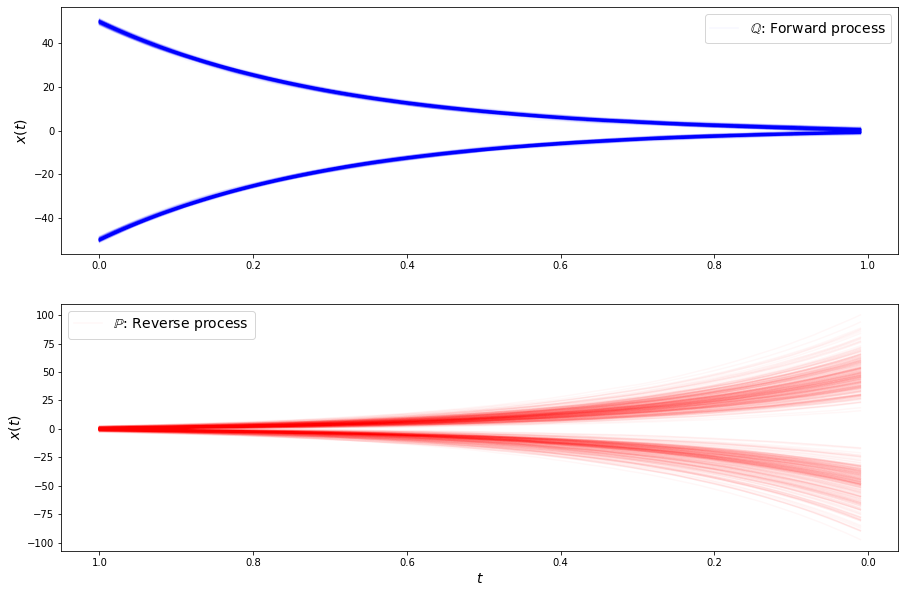

loss b 0.4419178068637848
loss b 0.48649343848228455
loss b 0.5269132256507874
loss b 0.44140422344207764
loss b 0.47565922141075134
loss b 0.41542738676071167
loss b 0.46494579315185547
loss b 0.4658444821834564
loss b 0.44746169447898865
loss b 0.5543029308319092
loss b 0.5084723234176636
loss b 0.4291658103466034
loss b 0.4189949929714203
loss b 0.506513237953186
loss b 0.5334364771842957
loss b 0.519990861415863
loss b 0.44029301404953003
loss b 0.5584232211112976
loss b 0.47180479764938354
loss b 0.5539929866790771
loss b 0.5200631022453308
loss b 0.4695601761341095
loss f 3.3179690837860107
loss f 3.3171169757843018
loss f 3.3182804584503174
loss f 3.3223469257354736
loss f 3.2872939109802246
loss f 3.3150484561920166
loss f 3.2956960201263428
loss f 3.3176190853118896
loss f 3.3078572750091553
loss f 3.298092842102051
loss f 3.3472278118133545
loss f 3.3231937885284424
loss f 3.3002045154571533
loss f 3.310525894165039
loss f 3.3238487243652344
loss f 3.3153882026672363
loss f 3

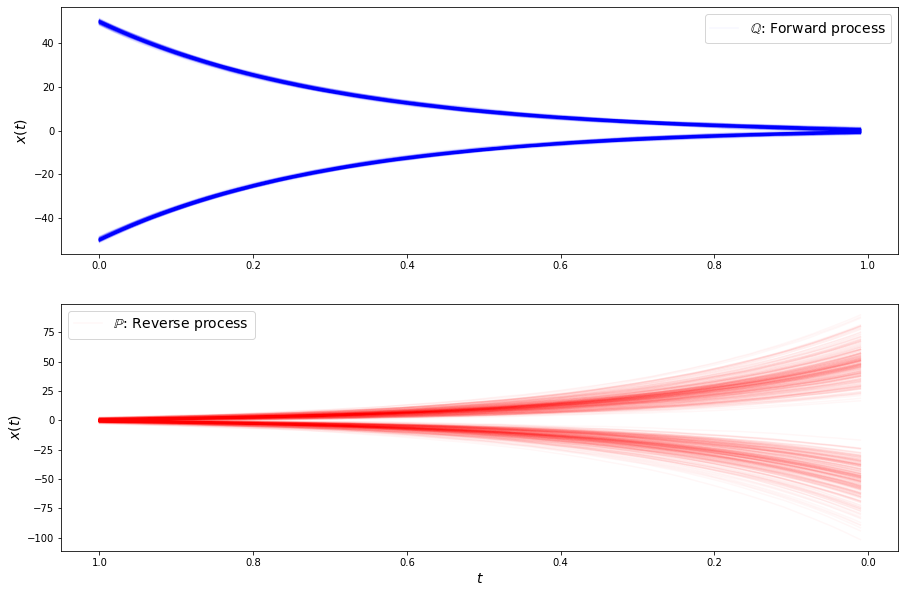

loss b 0.5301616191864014
loss b 0.5216134786605835
loss b 0.5115728378295898
loss b 0.4303370714187622
loss b 0.44634294509887695
loss b 0.4723333418369293
loss b 0.528285026550293
loss b 0.5342483520507812
loss b 0.4553004503250122
loss b 0.4440826177597046
loss b 0.45880311727523804
loss b 0.5537662506103516
loss b 0.5129587650299072
loss b 0.537192702293396
loss b 0.5700610280036926
loss b 0.5478551387786865
loss b 0.5358937978744507
loss b 0.4664422273635864
loss b 0.49336257576942444
loss b 0.4842008054256439
loss b 0.5503755211830139
loss b 0.5466384291648865
loss f 3.295100450515747
loss f 3.316899299621582
loss f 3.275547981262207
loss f 3.3435986042022705
loss f 3.3443806171417236
loss f 3.3166511058807373
loss f 3.3151817321777344
loss f 3.318507194519043
loss f 3.331644058227539
loss f 3.3226730823516846
loss f 3.321634531021118
loss f 3.2942895889282227
loss f 3.3223423957824707
loss f 3.298246383666992
loss f 3.3146579265594482
loss f 3.292587995529175
loss f 3.3271944522

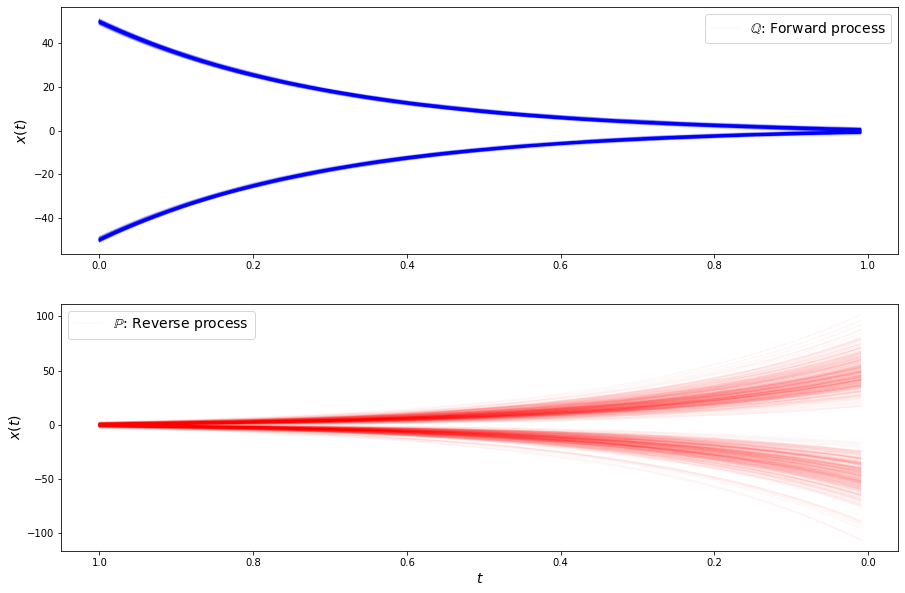

loss b 0.5838392376899719
loss b 0.5030331015586853
loss b 0.548354983329773
loss b 0.4521307647228241
loss b 0.5701788067817688
loss b 0.5409045815467834
loss b 0.4642733335494995
loss b 0.4900847375392914
loss b 0.5475947260856628
loss b 0.5183905959129333
loss b 0.5564054846763611
loss b 0.5125682950019836
loss b 0.49303099513053894
loss b 0.4974842369556427
loss b 0.5581650137901306
loss b 0.5598865151405334
loss b 0.46762728691101074
loss b 0.5560125112533569
loss b 0.5737540125846863
loss b 0.5623866319656372
loss b 0.5020007491111755
loss b 0.5256320238113403
loss f 3.3188679218292236
loss f 3.301868438720703
loss f 3.314847946166992
loss f 3.292249917984009
loss f 3.3170299530029297
loss f 3.326045036315918
loss f 3.3215932846069336
loss f 3.293490171432495
loss f 3.304853916168213
loss f 3.3010640144348145
loss f 3.3191299438476562
loss f 3.292921304702759
loss f 3.3226113319396973
loss f 3.3017897605895996
loss f 3.3048624992370605
loss f 3.3216450214385986
loss f 3.286678314

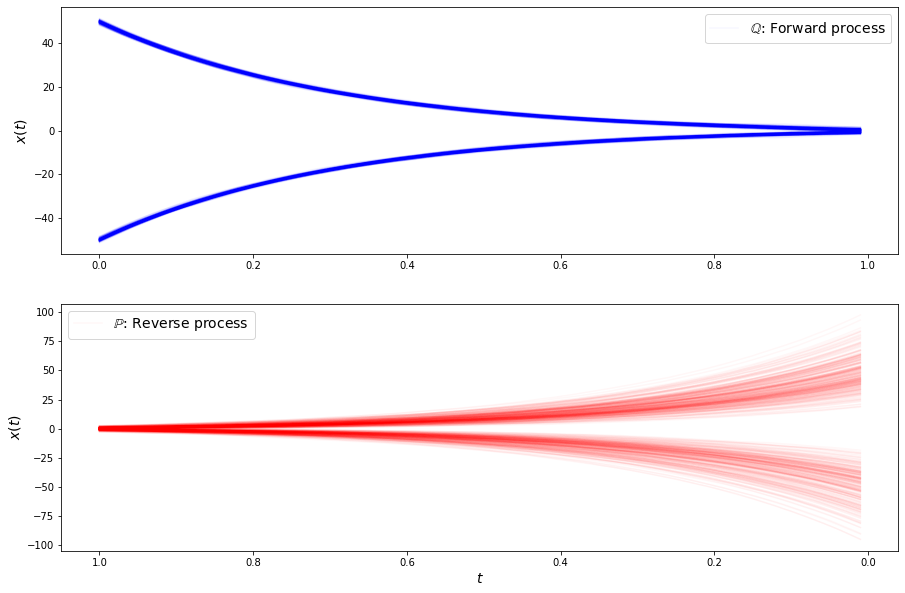

loss b 0.5343517661094666
loss b 0.4613753855228424
loss b 0.5133187770843506
loss b 0.4954754412174225
loss b 0.5105177760124207
loss b 0.5379159450531006
loss b 0.5119182467460632
loss b 0.434567928314209
loss b 0.5795487761497498
loss b 0.5409948229789734
loss b 0.5021047592163086
loss b 0.540138840675354
loss b 0.4732104241847992
loss b 0.5196049213409424
loss b 0.4281017780303955
loss b 0.47439485788345337
loss b 0.5334217548370361
loss b 0.5559449791908264
loss b 0.47097650170326233
loss b 0.4373024106025696
loss b 0.5701485276222229
loss b 0.7071279883384705
loss f 3.45455265045166
loss f 3.3963215351104736
loss f 3.3866052627563477
loss f 3.373920440673828
loss f 3.376913547515869
loss f 3.362593650817871
loss f 3.392984390258789
loss f 3.373568058013916
loss f 3.3599154949188232
loss f 3.363152027130127
loss f 3.361826181411743
loss f 3.4066975116729736
loss f 3.371645927429199
loss f 3.378323554992676
loss f 3.359097719192505
loss f 3.335901975631714
loss f 3.337061882019043


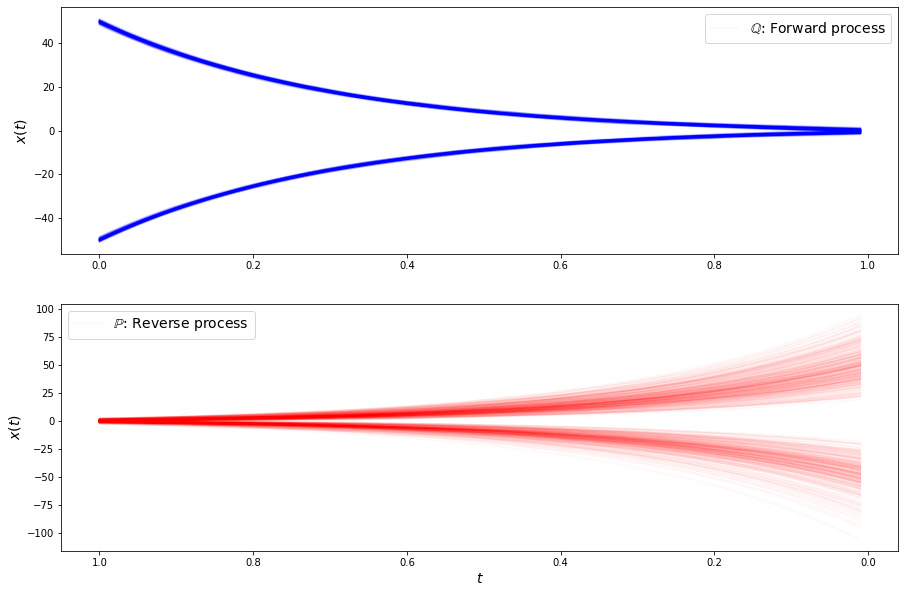

loss b 0.6039461493492126
loss b 0.6889760494232178
loss b 0.9137477874755859
loss b 0.6732121706008911
loss b 0.6646600961685181
loss b 0.5558004379272461
loss b 0.5790085196495056
loss b 0.43064337968826294
loss b 0.4689410328865051
loss b 0.5333767533302307
loss b 0.6665343642234802
loss b 0.5673903822898865
loss b 0.5066969990730286
loss b 0.5891517400741577
loss b 0.6042771339416504
loss b 0.5126630067825317
loss b 0.5072813034057617
loss b 0.4967971742153168
loss b 0.4231952726840973
loss b 0.5127171277999878
loss b 0.5256445407867432
loss b 0.5752497315406799
loss f 3.3516786098480225
loss f 3.328110933303833
loss f 3.352952241897583
loss f 3.3101699352264404
loss f 3.3228862285614014
loss f 3.329442262649536
loss f 3.3423919677734375
loss f 3.3430309295654297
loss f 3.370929002761841
loss f 3.3266963958740234
loss f 3.338560104370117
loss f 3.3149869441986084
loss f 3.3482062816619873
loss f 3.2982094287872314
loss f 3.343153238296509
loss f 3.298279285430908
loss f 3.359033107

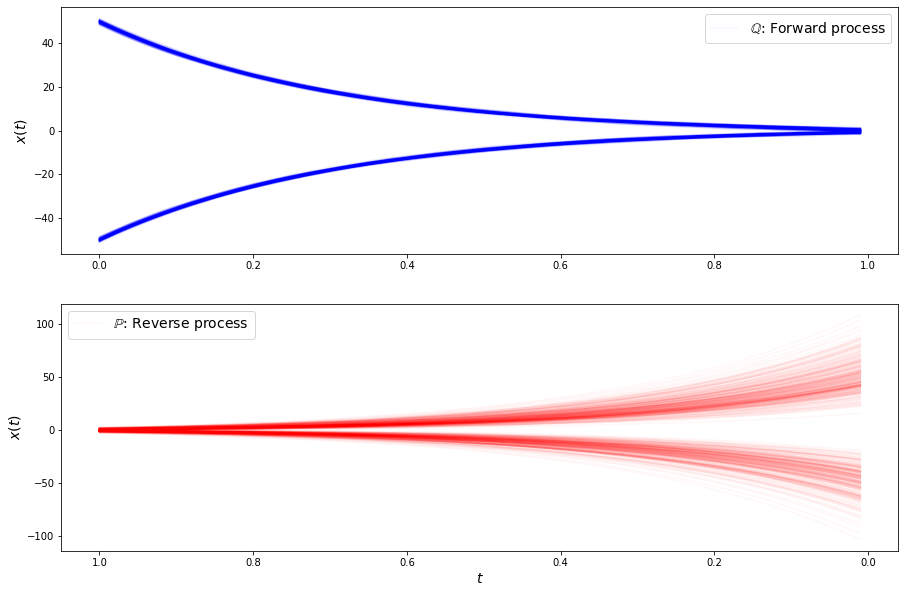

loss b 0.579422116279602
loss b 0.5198982357978821
loss b 0.48781317472457886
loss b 0.5256687998771667
loss b 0.5141832828521729
loss b 0.4507911503314972
loss b 0.5154786109924316
loss b 0.5366611480712891
loss b 0.5014138221740723
loss b 0.5120787620544434
loss b 0.5949960350990295
loss b 0.47785529494285583
loss b 0.5623019933700562
loss b 0.528150737285614
loss b 0.5377563834190369
loss b 0.48642486333847046
loss b 0.5878233909606934
loss b 0.5030210614204407
loss b 0.46037888526916504
loss b 0.48428067564964294
loss b 0.5568656325340271
loss b 0.6563431024551392
loss f 3.3170456886291504
loss f 3.3098814487457275
loss f 3.3436758518218994
loss f 3.3244240283966064
loss f 3.2946929931640625
loss f 3.3227202892303467
loss f 3.3468503952026367
loss f 3.3298277854919434
loss f 3.3481264114379883
loss f 3.3380911350250244
loss f 3.326857089996338
loss f 3.3377668857574463
loss f 3.3408420085906982
loss f 3.332524299621582
loss f 3.3263723850250244
loss f 3.3311870098114014
loss f 3.33

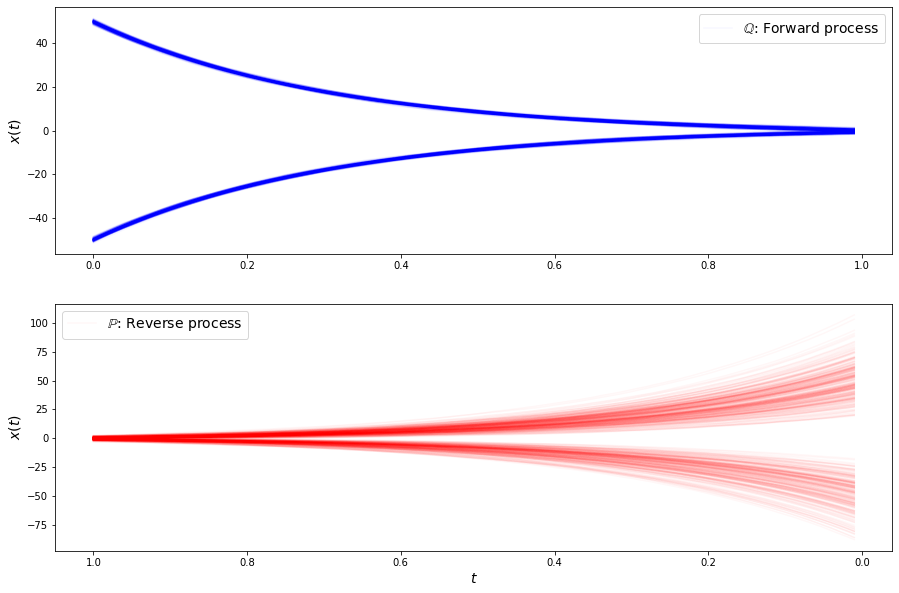

loss b 0.519822895526886
loss b 0.4963802397251129
loss b 0.5114993453025818
loss b 0.49153968691825867
loss b 0.4966323971748352
loss b 0.434497207403183
loss b 0.5298010110855103
loss b 0.5023866295814514
loss b 0.44310462474823
loss b 0.5412139296531677
loss b 0.5231397747993469
loss b 0.5139601826667786
loss b 0.5837936401367188
loss b 0.4720148742198944
loss b 0.5449731945991516
loss b 0.5237905979156494
loss b 0.3901922106742859
loss b 0.5059029459953308
loss b 0.4689033329486847
loss b 0.5419608354568481
loss b 0.465165913105011
loss b 0.5234726071357727
loss f 3.353381395339966
loss f 3.3256893157958984
loss f 3.328371524810791
loss f 3.3237171173095703
loss f 3.2850453853607178
loss f 3.3696389198303223
loss f 3.3092689514160156
loss f 3.3296194076538086
loss f 3.3281869888305664
loss f 3.3283636569976807
loss f 3.33290958404541
loss f 3.3127825260162354
loss f 3.3460872173309326
loss f 3.3206875324249268
loss f 3.3374085426330566
loss f 3.339735507965088
loss f 3.320887088775

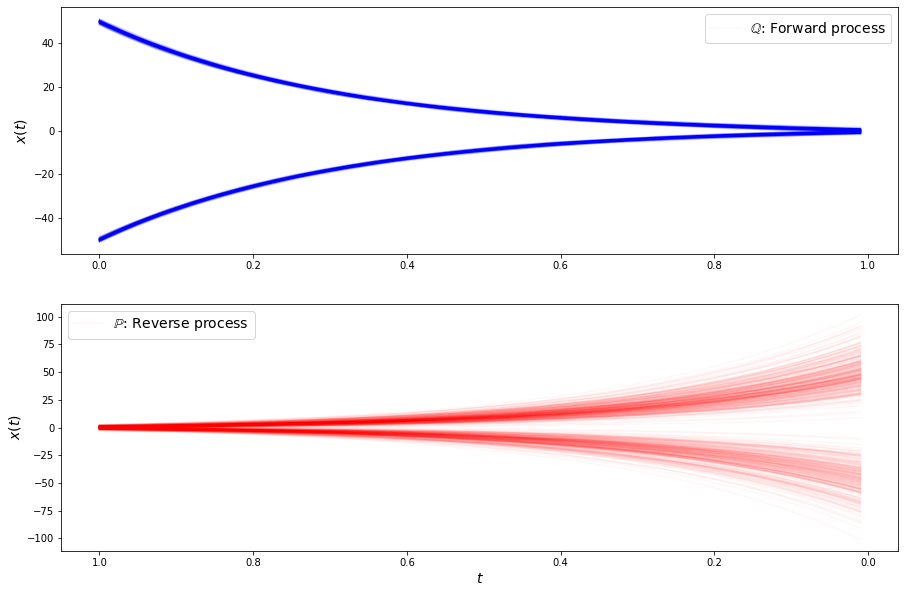

loss b 0.4754830002784729
loss b 0.4682331085205078
loss b 0.5777153372764587
loss b 0.5569277405738831
loss b 0.4362260699272156
loss b 0.5158743858337402
loss b 0.571154773235321
loss b 0.5672972202301025
loss b 0.4542291760444641
loss b 0.46866506338119507
loss b 0.49917444586753845
loss b 0.5000162720680237
loss b 0.5071077346801758
loss b 0.40867456793785095
loss b 0.48124074935913086
loss b 0.4401259422302246
loss b 0.4772548973560333
loss b 0.5873314142227173
loss b 0.5276045799255371
loss b 0.5319306254386902
loss b 0.48512279987335205
loss b 0.46842849254608154
loss f 3.3223578929901123
loss f 3.289309024810791
loss f 3.332761526107788
loss f 3.317798614501953
loss f 3.355539083480835
loss f 3.3318443298339844
loss f 3.335758686065674
loss f 3.3178088665008545
loss f 3.3372631072998047
loss f 3.301051139831543
loss f 3.2881152629852295
loss f 3.2973639965057373
loss f 3.3471662998199463
loss f 3.321854591369629
loss f 3.3338265419006348
loss f 3.3189265727996826
loss f 3.32729

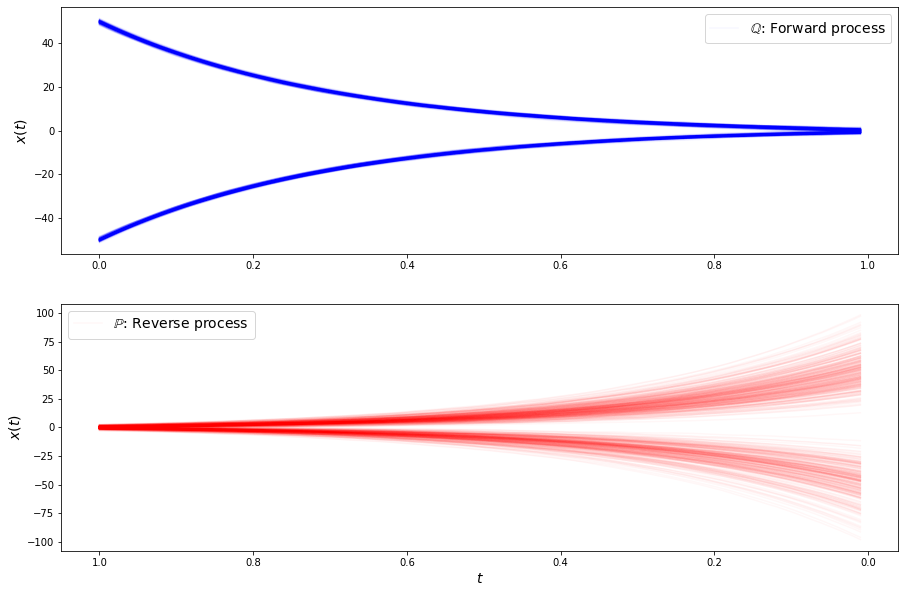

loss b 0.5463193655014038
loss b 0.43533480167388916
loss b 0.5503847002983093
loss b 0.5071334838867188
loss b 0.4295863211154938
loss b 0.48274511098861694
loss b 0.4236500561237335
loss b 0.5214272141456604
loss b 0.5402505993843079
loss b 0.4532945454120636
loss b 0.5001012682914734
loss b 0.5306922793388367
loss b 0.5281358361244202
loss b 0.6114452481269836
loss b 0.5088112354278564
loss b 0.4635767638683319
loss b 0.5336887240409851
loss b 0.5302382111549377
loss b 0.4959311783313751
loss b 0.5182192325592041
loss b 0.4654756784439087
loss b 0.48425811529159546
loss f 3.337446451187134
loss f 3.3445546627044678
loss f 3.3182432651519775
loss f 3.319451093673706
loss f 3.3266265392303467
loss f 3.3477964401245117
loss f 3.3194775581359863
loss f 3.3158576488494873
loss f 3.327967882156372
loss f 3.321958541870117
loss f 3.3290929794311523
loss f 3.324345827102661
loss f 3.3289012908935547
loss f 3.2965879440307617
loss f 3.31961989402771
loss f 3.323216438293457
loss f 3.33869004

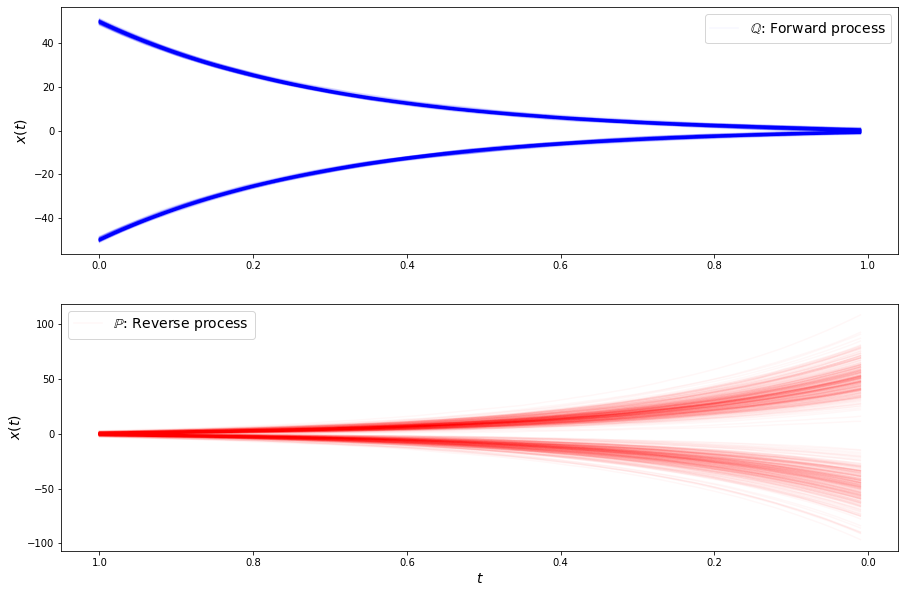

loss b 0.49671196937561035
loss b 0.4637771546840668
loss b 0.44571319222450256
loss b 0.5019184350967407
loss b 0.4700213074684143
loss b 0.5331854820251465
loss b 0.540506899356842
loss b 0.5038242936134338
loss b 0.4848231077194214
loss b 0.5108811855316162
loss b 0.47284460067749023
loss b 0.5328591465950012
loss b 0.489351749420166
loss b 0.539542555809021
loss b 0.5332653522491455
loss b 0.5583751201629639
loss b 0.47195670008659363
loss b 0.47527098655700684
loss b 0.5877782106399536
loss b 0.521248996257782
loss b 0.5342531800270081
loss b 0.4482252299785614
loss f 3.337676763534546
loss f 3.315058946609497
loss f 3.342167615890503
loss f 3.2971980571746826
loss f 3.33394455909729
loss f 3.3415684700012207
loss f 3.318341016769409
loss f 3.344411611557007
loss f 3.282165050506592
loss f 3.3215973377227783
loss f 3.3376312255859375
loss f 3.309349775314331
loss f 3.298309326171875
loss f 3.301239490509033
loss f 3.317744493484497
loss f 3.2924447059631348
loss f 3.33141088485717

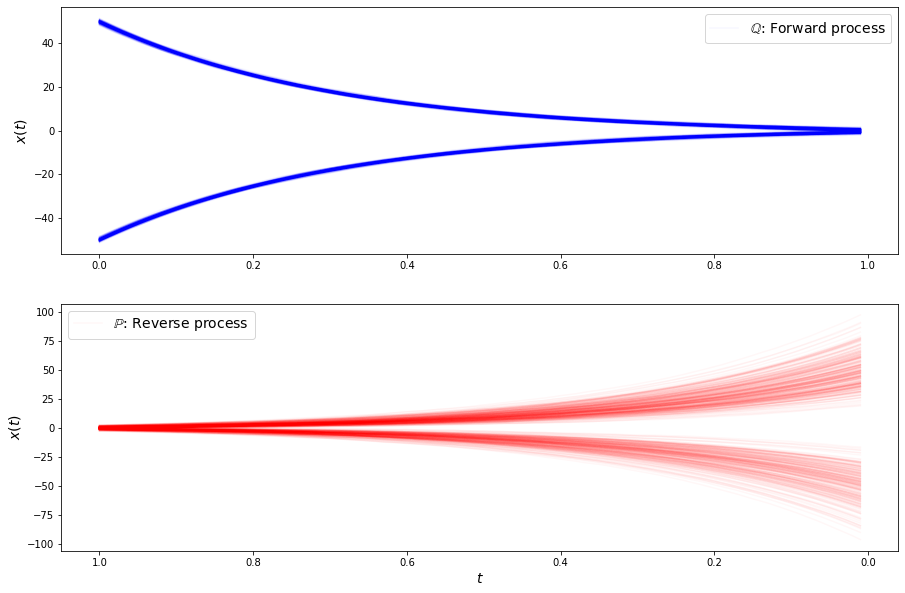

loss b 0.5303767323493958
loss b 0.44477221369743347
loss b 0.4977684020996094
loss b 0.5566646456718445
loss b 0.3857697546482086
loss b 0.5445513725280762
loss b 0.5045734643936157
loss b 0.47612500190734863
loss b 0.43492525815963745
loss b 0.40915292501449585
loss b 0.5655616521835327
loss b 0.5285458564758301
loss b 0.45444411039352417
loss b 0.470603346824646
loss b 0.5338448882102966
loss b 0.4949493110179901
loss b 0.5095707774162292
loss b 0.5810211896896362
loss b 0.45755666494369507
loss b 0.46913018822669983
loss b 0.48176783323287964
loss b 0.4913591146469116
loss f 3.3185133934020996
loss f 3.316910982131958
loss f 3.3073384761810303
loss f 3.317172050476074
loss f 3.3175275325775146
loss f 3.2916409969329834
loss f 3.2825543880462646
loss f 3.314626455307007
loss f 3.3499560356140137
loss f 3.3077657222747803
loss f 3.3265509605407715
loss f 3.3208959102630615
loss f 3.317028522491455
loss f 3.297027349472046
loss f 3.3165833950042725
loss f 3.3183670043945312
loss f 3.3

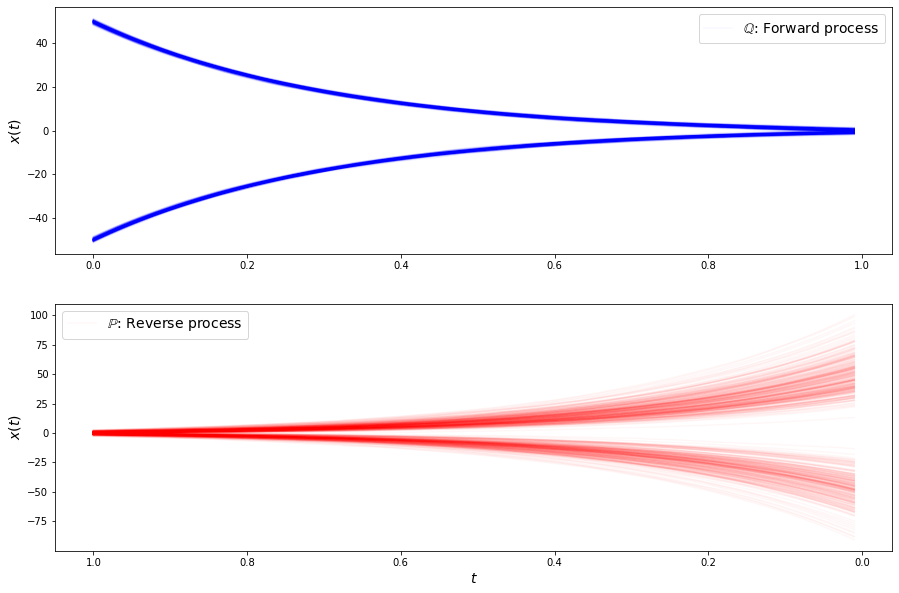

loss b 0.47193875908851624
loss b 0.4916036128997803
loss b 0.5049436688423157
loss b 0.44861170649528503
loss b 0.4898260533809662
loss b 0.46044403314590454
loss b 0.4678250551223755
loss b 0.4617778956890106
loss b 0.4827740490436554
loss b 0.5356268882751465
loss b 0.5373893976211548
loss b 0.5075854659080505
loss b 0.47267600893974304
loss b 0.49387669563293457
loss b 0.46705931425094604
loss b 0.5032464861869812
loss b 0.48752498626708984
loss b 0.4977451264858246
loss b 0.5558815598487854
loss b 0.49233531951904297
loss b 0.43726465106010437
loss b 0.4754420816898346
loss f 3.334913730621338
loss f 3.340545415878296
loss f 3.308779001235962
loss f 3.325917959213257
loss f 3.301190137863159
loss f 3.3190860748291016
loss f 3.309156656265259
loss f 3.300107955932617
loss f 3.289612054824829
loss f 3.309782028198242
loss f 3.3529884815216064
loss f 3.349595546722412
loss f 3.3149890899658203
loss f 3.3422064781188965
loss f 3.341887950897217
loss f 3.292259693145752
loss f 3.299731

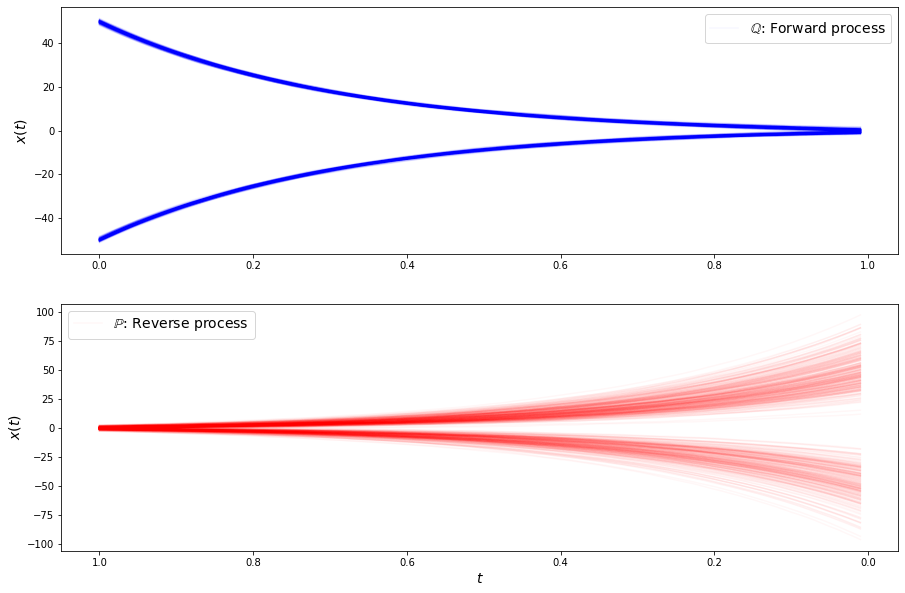

loss b 0.49002712965011597
loss b 0.4541521966457367
loss b 0.535149872303009
loss b 0.44662705063819885
loss b 0.46936580538749695
loss b 0.5752183794975281
loss b 0.504859447479248
loss b 0.5295891165733337
loss b 0.47541487216949463
loss b 0.5760831236839294
loss b 0.5372056365013123
loss b 0.42907214164733887
loss b 0.4836767613887787
loss b 0.47602230310440063
loss b 0.430517315864563
loss b 0.5849182605743408
loss b 0.5983420610427856
loss b 0.6686258912086487
loss b 0.6472552418708801
loss b 0.588408887386322
loss b 0.5734966397285461
loss b 0.5601480603218079
loss f 3.313166618347168
loss f 3.349269390106201
loss f 3.3634731769561768
loss f 3.322467565536499
loss f 3.3067948818206787
loss f 3.337528705596924
loss f 3.322862386703491
loss f 3.310124635696411
loss f 3.3325369358062744
loss f 3.3378007411956787
loss f 3.3095180988311768
loss f 3.3030130863189697
loss f 3.3223910331726074
loss f 3.32464599609375
loss f 3.3515689373016357
loss f 3.320110559463501
loss f 3.3235049247

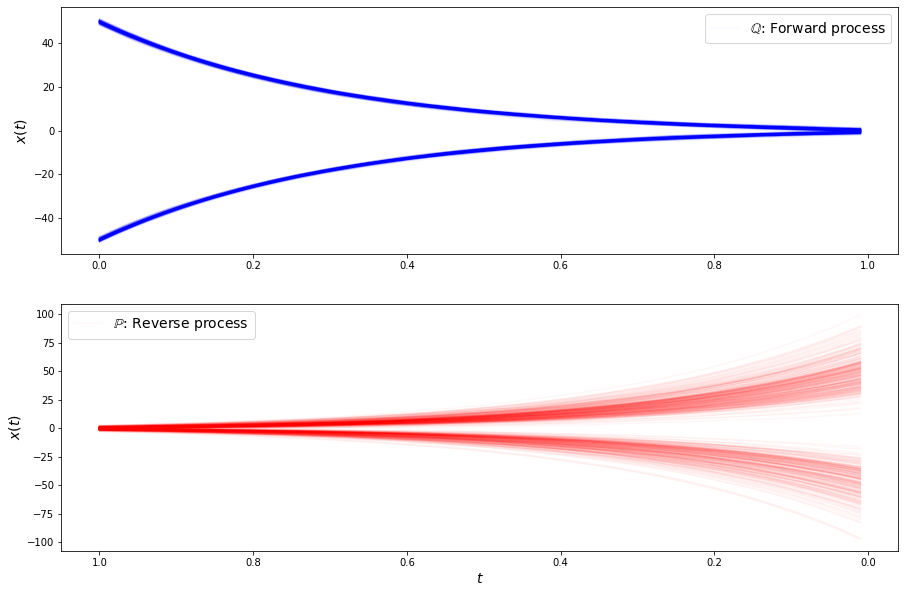

loss b 0.5666515231132507
loss b 0.5619750022888184
loss b 0.6306641101837158
loss b 0.6142594814300537
loss b 0.5557721257209778
loss b 0.5673720240592957
loss b 0.487722784280777
loss b 0.44303441047668457
loss b 0.4556697607040405
loss b 0.49112096428871155
loss b 0.46854904294013977
loss b 0.41857224702835083
loss b 0.5725740790367126
loss b 0.5368542671203613
loss b 0.5045346617698669
loss b 0.5528347492218018
loss b 0.4198319911956787
loss b 0.49005985260009766
loss b 0.5141552686691284
loss b 0.45912131667137146
loss b 0.45519205927848816
loss b 0.580053985118866
loss f 3.3177764415740967
loss f 3.3201217651367188
loss f 3.32960844039917
loss f 3.31363844871521
loss f 3.3312270641326904
loss f 3.326765298843384
loss f 3.3196089267730713
loss f 3.3003454208374023
loss f 3.3172547817230225
loss f 3.323711633682251
loss f 3.319819927215576
loss f 3.3290019035339355
loss f 3.3319804668426514
loss f 3.3211798667907715
loss f 3.313032865524292
loss f 3.32918643951416
loss f 3.31972098

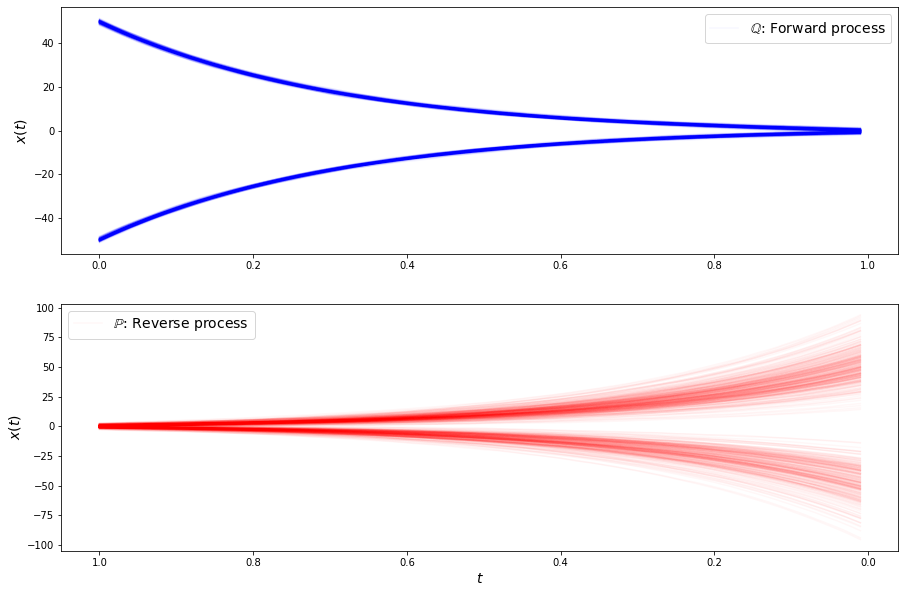

loss b 0.4319090247154236
loss b 0.571122944355011
loss b 0.546814501285553
loss b 0.5761826634407043
loss b 0.5084295868873596
loss b 0.5147150754928589
loss b 0.5515106916427612
loss b 0.5193793773651123
loss b 0.4697902798652649
loss b 0.512041449546814
loss b 0.5080707669258118
loss b 0.5040416121482849
loss b 0.5347188711166382
loss b 0.4869784712791443
loss b 0.5202329158782959
loss b 0.5795532464981079
loss b 0.5515416264533997
loss b 0.46129313111305237
loss b 0.49048060178756714
loss b 0.5028038024902344
loss b 0.4735133647918701
loss b 0.533469021320343
loss f 3.3236453533172607
loss f 3.3152689933776855
loss f 3.3556113243103027
loss f 3.3014063835144043
loss f 3.3218297958374023
loss f 3.333750009536743
loss f 3.3225200176239014
loss f 3.3436036109924316
loss f 3.341508150100708
loss f 3.3278791904449463
loss f 3.328003406524658
loss f 3.318042755126953
loss f 3.325770616531372
loss f 3.316896438598633
loss f 3.334597587585449
loss f 3.307213068008423
loss f 3.3147554397583

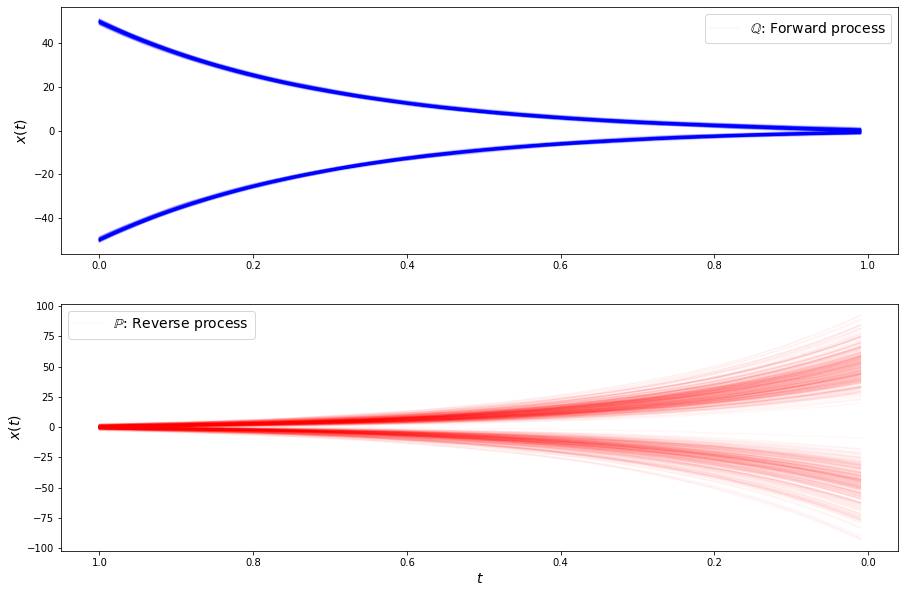

loss b 0.49265995621681213
loss b 0.46293896436691284
loss b 0.45592066645622253
loss b 0.49619555473327637
loss b 0.602438747882843
loss b 0.5003796815872192
loss b 0.4872937500476837
loss b 0.5095281004905701
loss b 0.5271968841552734
loss b 0.5505995750427246
loss b 0.5076597929000854
loss b 0.507012665271759
loss b 0.5020781755447388
loss b 0.49019667506217957
loss b 0.4581426978111267
loss b 0.5437284708023071
loss b 0.45775076746940613
loss b 0.47762787342071533
loss b 0.49927449226379395
loss b 0.5247431397438049
loss b 0.489205002784729
loss b 0.43831393122673035
loss f 3.3300397396087646
loss f 3.311156988143921
loss f 3.3173961639404297
loss f 3.3065030574798584
loss f 3.3179240226745605
loss f 3.3199331760406494
loss f 3.303658962249756
loss f 3.3040359020233154
loss f 3.3124544620513916
loss f 3.3135058879852295
loss f 3.3055362701416016
loss f 3.325960397720337
loss f 3.3173468112945557
loss f 3.2938125133514404
loss f 3.3115084171295166
loss f 3.3483846187591553
loss f 3.

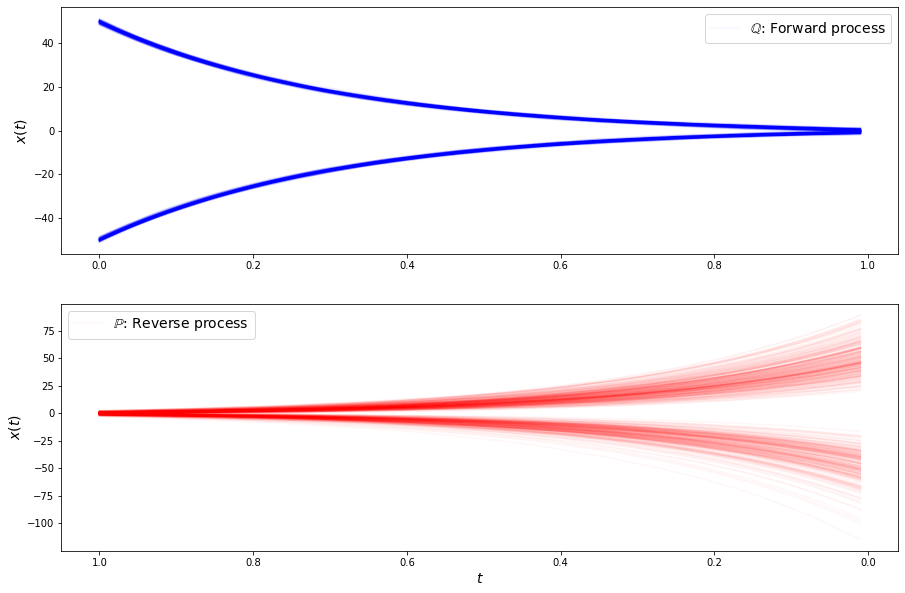

loss b 0.47264549136161804
loss b 0.44786882400512695
loss b 0.49317696690559387
loss b 0.4077114164829254
loss b 0.4450248181819916
loss b 0.4842171370983124
loss b 0.5138137340545654
loss b 0.5000784397125244
loss b 0.4352268874645233
loss b 0.4762532413005829
loss b 0.4572576880455017
loss b 0.45857125520706177
loss b 0.5169268846511841
loss b 0.4934033751487732
loss b 0.45103949308395386
loss b 0.5553176403045654
loss b 0.4678458869457245
loss b 0.5393813848495483
loss b 0.4556964635848999
loss b 0.49727123975753784
loss b 0.49604305624961853
loss b 0.5296431183815002
loss f 3.3056302070617676
loss f 3.317476511001587
loss f 3.3283193111419678
loss f 3.334362506866455
loss f 3.2947568893432617
loss f 3.304170608520508
loss f 3.343745470046997
loss f 3.3277509212493896
loss f 3.307934522628784
loss f 3.3339219093322754
loss f 3.3286097049713135
loss f 3.309917688369751
loss f 3.3274528980255127
loss f 3.299149990081787
loss f 3.329796314239502
loss f 3.303126096725464
loss f 3.31863

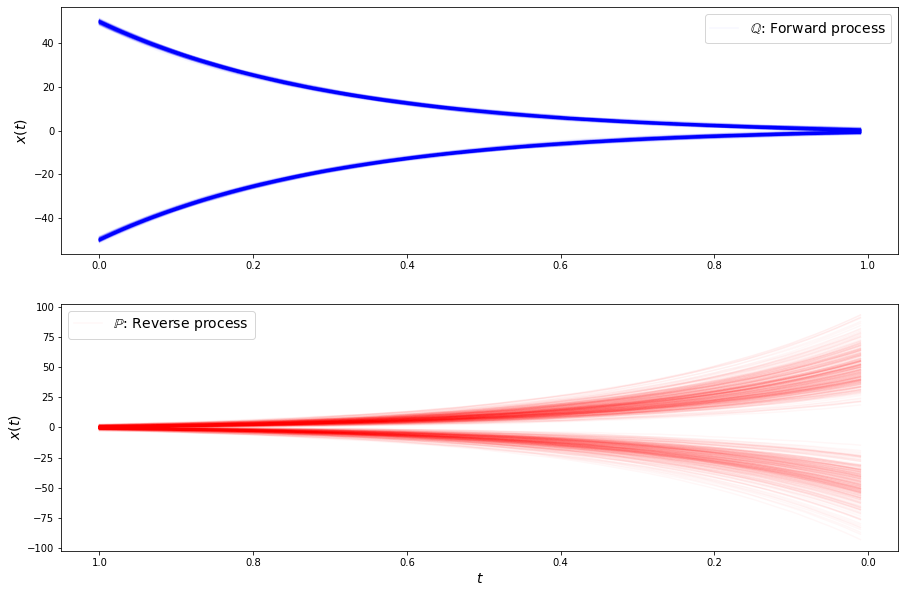

loss b 0.500206708908081
loss b 0.4750012159347534
loss b 0.567844033241272
loss b 0.5095015168190002
loss b 0.5089747309684753
loss b 0.5050564408302307
loss b 0.41047462821006775
loss b 0.5092310309410095
loss b 0.42357712984085083
loss b 0.4986741542816162
loss b 0.4889566898345947
loss b 0.5298743844032288
loss b 0.4522763788700104
loss b 0.4670102000236511
loss b 0.4185994863510132
loss b 0.5172927975654602
loss b 0.5040568709373474
loss b 0.5315964818000793
loss b 0.4554695188999176
loss b 0.48959648609161377
loss b 0.4294802248477936
loss b 0.5328285694122314
loss f 3.301219940185547
loss f 3.333094358444214
loss f 3.3008389472961426
loss f 3.3314409255981445
loss f 3.3259150981903076
loss f 3.3091788291931152
loss f 3.3034770488739014
loss f 3.344986915588379
loss f 3.3020968437194824
loss f 3.329056978225708
loss f 3.347951889038086
loss f 3.294680118560791
loss f 3.317803144454956
loss f 3.3145720958709717
loss f 3.3123350143432617
loss f 3.340346097946167
loss f 3.3207333087

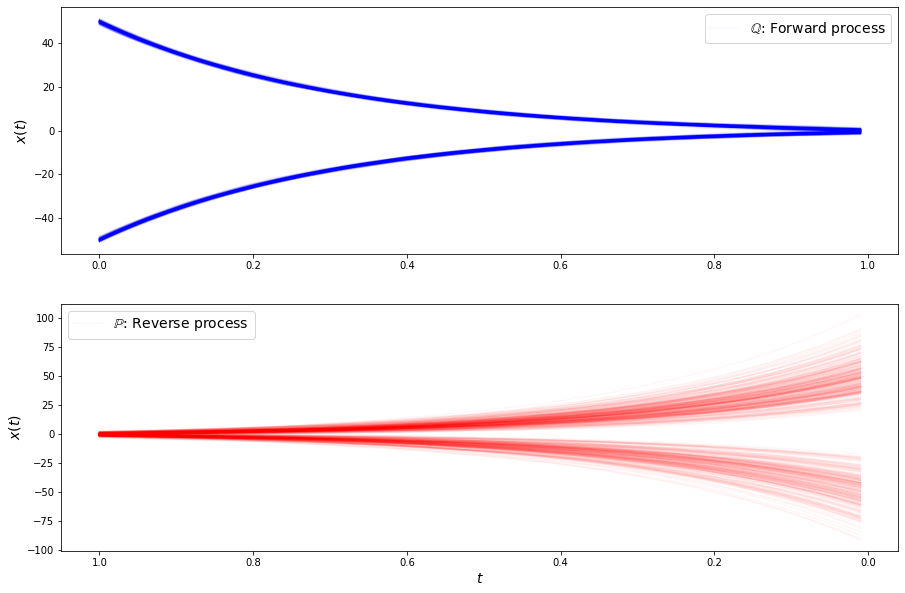

loss b 0.48033520579338074
loss b 0.45962831377983093
loss b 0.4294344484806061
loss b 0.49613156914711
loss b 0.5158852338790894
loss b 0.5300029516220093
loss b 0.5087497234344482
loss b 0.5107669234275818
loss b 0.5458611249923706
loss b 0.4598088562488556
loss b 0.491166889667511
loss b 0.5464062094688416
loss b 0.4526953399181366
loss b 0.5480820536613464
loss b 0.4856490194797516
loss b 0.5618684887886047
loss b 0.5036634206771851
loss b 0.48247790336608887
loss b 0.41991037130355835
loss b 0.5586109757423401
loss b 0.4475228786468506
loss b 0.4911206364631653
loss f 3.327104091644287
loss f 3.307950496673584
loss f 3.2982540130615234
loss f 3.3246490955352783
loss f 3.3030941486358643
loss f 3.296722173690796
loss f 3.3372528553009033
loss f 3.3231115341186523
loss f 3.3286569118499756
loss f 3.3055331707000732
loss f 3.309333086013794
loss f 3.28119158744812
loss f 3.340510606765747
loss f 3.3067171573638916
loss f 3.2988533973693848
loss f 3.2926623821258545
loss f 3.314434051

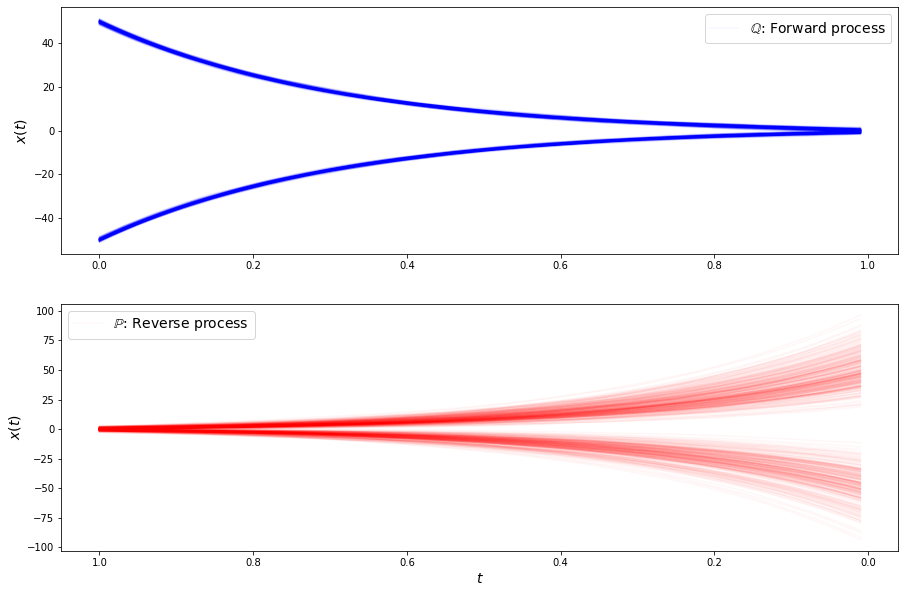

loss b 0.46955379843711853
loss b 0.46139079332351685
loss b 0.5490289926528931
loss b 0.47646087408065796
loss b 0.5083040595054626
loss b 0.4843452572822571
loss b 0.5401905179023743
loss b 0.5256612300872803
loss b 0.5482231974601746
loss b 0.4779544174671173
loss b 0.5243284702301025
loss b 0.4841361343860626
loss b 0.4621031880378723
loss b 0.5138751268386841
loss b 0.545753002166748
loss b 0.4855189323425293
loss b 0.48395413160324097
loss b 0.47716766595840454
loss b 0.5097702741622925
loss b 0.4799140691757202
loss b 0.48303455114364624
loss b 0.474177747964859
loss f 3.300504684448242
loss f 3.306051015853882
loss f 3.327636957168579
loss f 3.311746597290039
loss f 3.3085484504699707
loss f 3.3105275630950928
loss f 3.3156657218933105
loss f 3.328869342803955
loss f 3.316073417663574
loss f 3.325645685195923
loss f 3.3073625564575195
loss f 3.3023769855499268
loss f 3.3074803352355957
loss f 3.3161654472351074
loss f 3.311981439590454
loss f 3.300342082977295
loss f 3.30092716

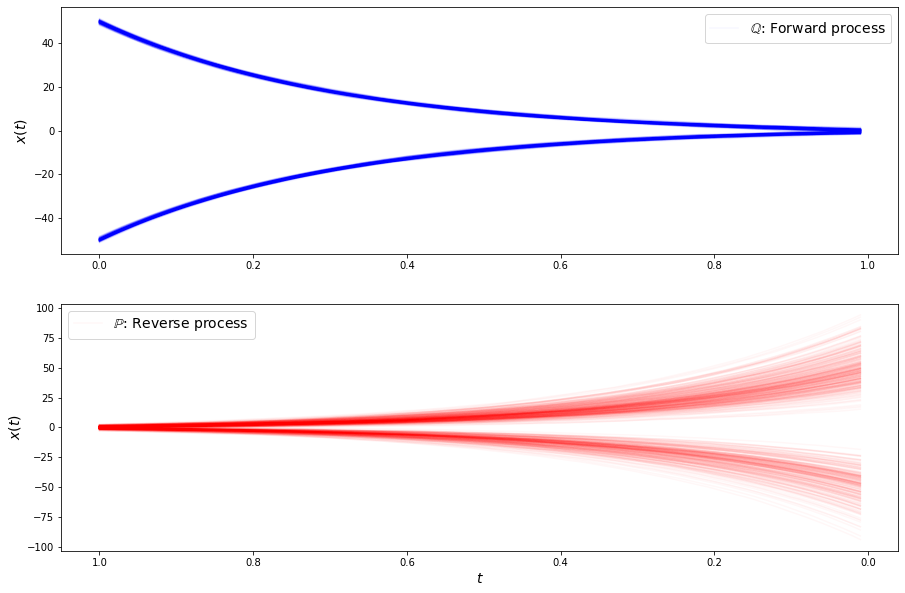

loss b 0.48905232548713684
loss b 0.5110028386116028
loss b 0.43001219630241394
loss b 0.524357259273529
loss b 0.5115851759910583
loss b 0.5468419790267944
loss b 0.4698137640953064
loss b 0.5207693576812744
loss b 0.5197733640670776
loss b 0.4825930893421173
loss b 0.42322656512260437
loss b 0.5599226355552673
loss b 0.5011317133903503
loss b 0.4980178475379944
loss b 0.5778006315231323
loss b 0.48502689599990845
loss b 0.5070017576217651
loss b 0.5125199556350708
loss b 0.45651906728744507
loss b 0.4632599949836731
loss b 0.49520888924598694
loss b 0.46006205677986145
loss f 3.316890239715576
loss f 3.320460081100464
loss f 3.3094279766082764
loss f 3.281240940093994
loss f 3.3059194087982178
loss f 3.3274824619293213
loss f 3.3190665245056152
loss f 3.2891924381256104
loss f 3.310753345489502
loss f 3.3132340908050537
loss f 3.309028387069702
loss f 3.322340965270996
loss f 3.316371440887451
loss f 3.323087453842163
loss f 3.3207645416259766
loss f 3.3268256187438965
loss f 3.32380

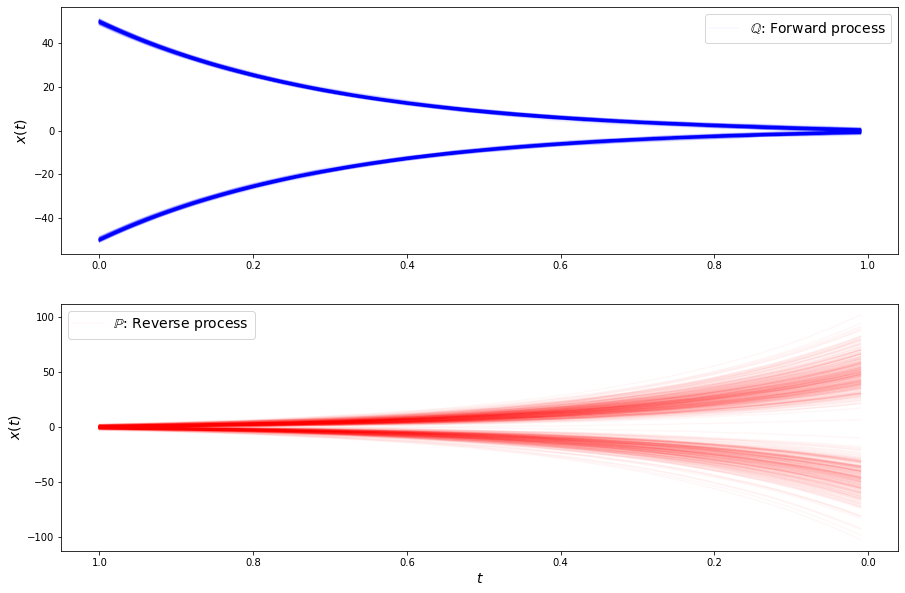

loss b 0.4680624306201935
loss b 0.4871376156806946
loss b 0.42144033312797546
loss b 0.4780258238315582
loss b 0.4975977838039398
loss b 0.5519717335700989
loss b 0.5018854737281799
loss b 0.4803665578365326
loss b 0.4918298125267029
loss b 0.5053226351737976
loss b 0.48253676295280457
loss b 0.4729258120059967
loss b 0.44602975249290466
loss b 0.5173105597496033
loss b 0.48567691445350647
loss b 0.5271234512329102
loss b 0.5521786212921143
loss b 0.4946843981742859
loss b 0.475684255361557
loss b 0.5441589951515198
loss b 0.5208739042282104
loss b 0.43813952803611755
loss f 3.314885139465332
loss f 3.3524208068847656
loss f 3.323488473892212
loss f 3.310861110687256
loss f 3.3159778118133545
loss f 3.3158345222473145
loss f 3.315579652786255
loss f 3.318467617034912
loss f 3.3195040225982666
loss f 3.3181235790252686
loss f 3.3283309936523438
loss f 3.3030455112457275
loss f 3.285011053085327
loss f 3.309861421585083
loss f 3.3219571113586426
loss f 3.307145118713379
loss f 3.2885434

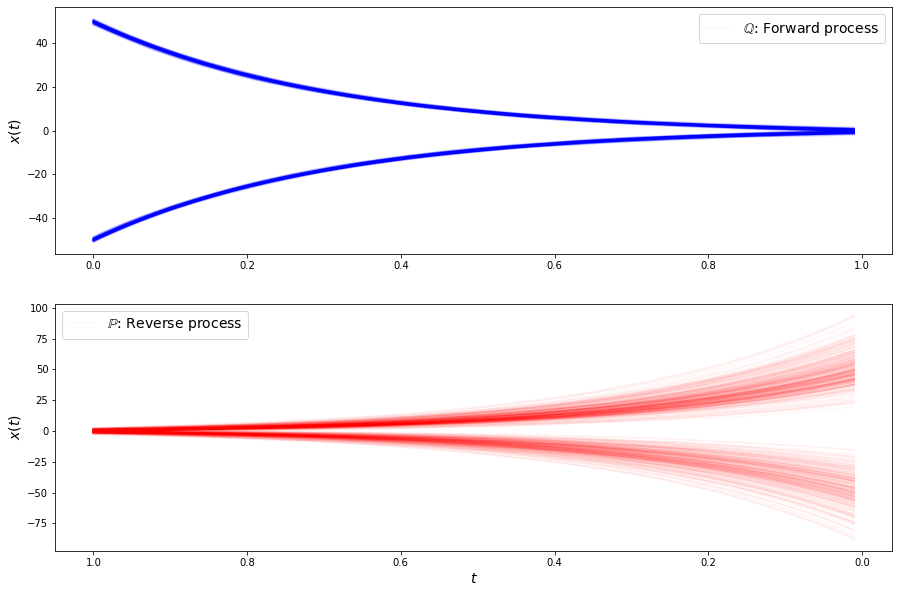

loss b 0.48590463399887085
loss b 0.38856738805770874
loss b 0.494701623916626
loss b 0.4582445025444031
loss b 0.5239555239677429
loss b 0.5522342324256897
loss b 0.462727427482605
loss b 0.43549612164497375
loss b 0.5084251761436462
loss b 0.46145567297935486
loss b 0.466230571269989
loss b 0.5008116960525513
loss b 0.47199103236198425
loss b 0.5049432516098022
loss b 0.5369497537612915
loss b 0.40582549571990967
loss b 0.4972582459449768
loss b 0.4813191294670105
loss b 0.5201876163482666
loss b 0.43889278173446655
loss b 0.4279250502586365
loss b 0.5396508574485779
loss f 3.324596405029297
loss f 3.311267852783203
loss f 3.3042726516723633
loss f 3.295764923095703
loss f 3.3050951957702637
loss f 3.3381855487823486
loss f 3.3469350337982178
loss f 3.3049631118774414
loss f 3.302093505859375
loss f 3.345522165298462
loss f 3.306769847869873
loss f 3.2908833026885986
loss f 3.324471950531006
loss f 3.299041986465454
loss f 3.3257884979248047
loss f 3.330127000808716
loss f 3.31118798

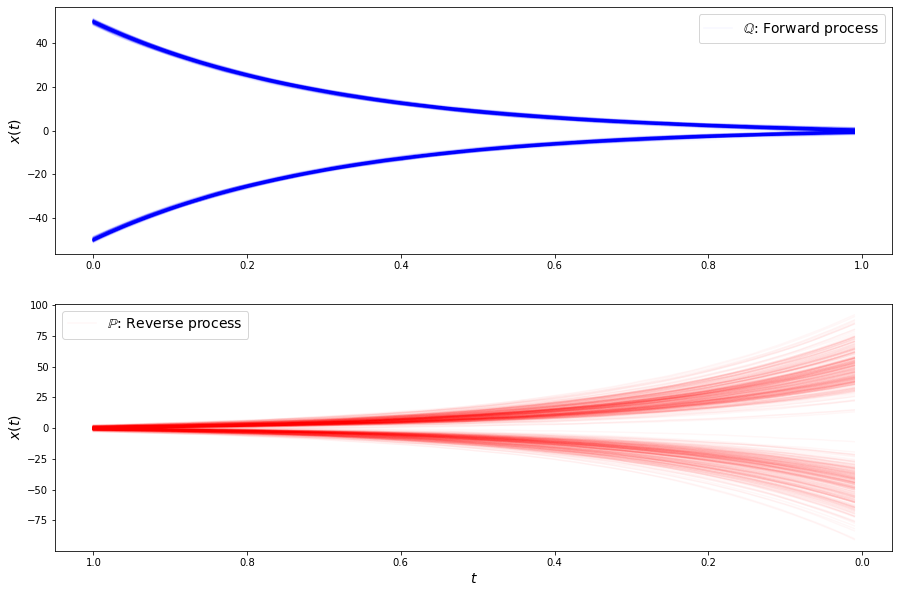

loss b 0.5747814774513245
loss b 0.5024552345275879
loss b 0.488699346780777
loss b 0.49095675349235535
loss b 0.4733961224555969
loss b 0.4892089366912842
loss b 0.5016041398048401
loss b 0.38855332136154175
loss b 0.46443110704421997
loss b 0.4788442552089691
loss b 0.5352439880371094
loss b 0.484732985496521
loss b 0.5128242373466492
loss b 0.48949041962623596
loss b 0.44427910447120667
loss b 0.45131969451904297
loss b 0.4721725285053253
loss b 0.5234659314155579
loss b 0.45962461829185486
loss b 0.4759337604045868
loss b 0.4804917573928833
loss b 0.4510035514831543
loss f 3.316965103149414
loss f 3.2939796447753906
loss f 3.309356927871704
loss f 3.3034844398498535
loss f 3.291067600250244
loss f 3.2989449501037598
loss f 3.3082990646362305
loss f 3.326667547225952
loss f 3.30721116065979
loss f 3.3071446418762207
loss f 3.308166742324829
loss f 3.308999538421631
loss f 3.3184654712677
loss f 3.27130126953125
loss f 3.311429500579834
loss f 3.3223440647125244
loss f 3.321157693862

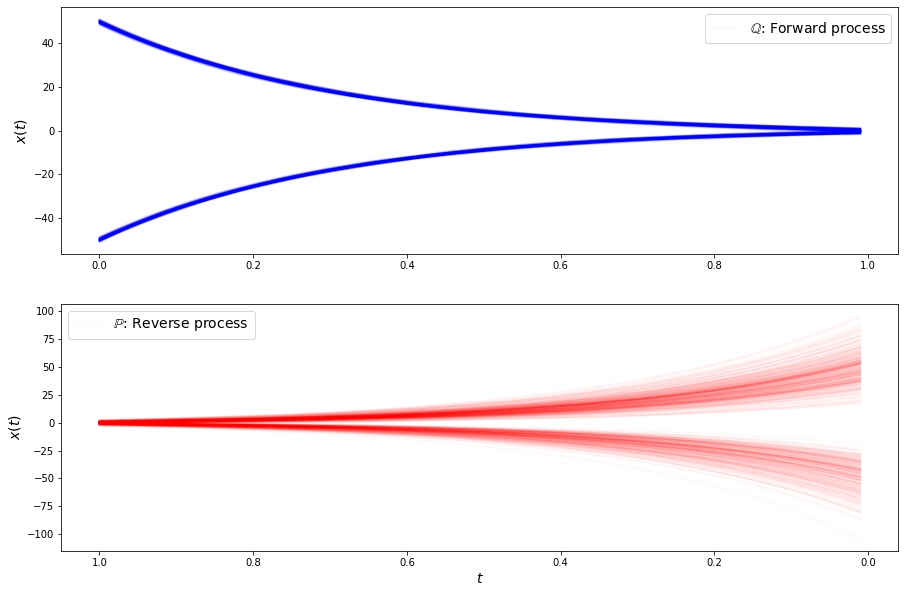

loss b 0.4311376214027405
loss b 0.513575553894043
loss b 0.47346705198287964
loss b 0.4861316978931427
loss b 0.4790906012058258
loss b 0.48071110248565674
loss b 0.455061674118042
loss b 0.477288156747818
loss b 0.4473491609096527
loss b 0.486603319644928
loss b 0.5061114430427551
loss b 0.5344412922859192
loss b 0.4798434376716614
loss b 0.5284220576286316
loss b 0.5337375402450562
loss b 0.48958325386047363
loss b 0.5296247601509094
loss b 0.4605247676372528
loss b 0.44124606251716614
loss b 0.5389606356620789
loss b 0.43738800287246704
loss b 0.493833988904953
loss f 3.3016512393951416
loss f 3.3160016536712646
loss f 3.2898364067077637
loss f 3.330751419067383
loss f 3.2970874309539795
loss f 3.3271260261535645
loss f 3.3044137954711914
loss f 3.2964699268341064
loss f 3.298024892807007
loss f 3.3132200241088867
loss f 3.30106258392334
loss f 3.3155369758605957
loss f 3.2979960441589355
loss f 3.3162496089935303
loss f 3.2964770793914795
loss f 3.332167148590088
loss f 3.30857110

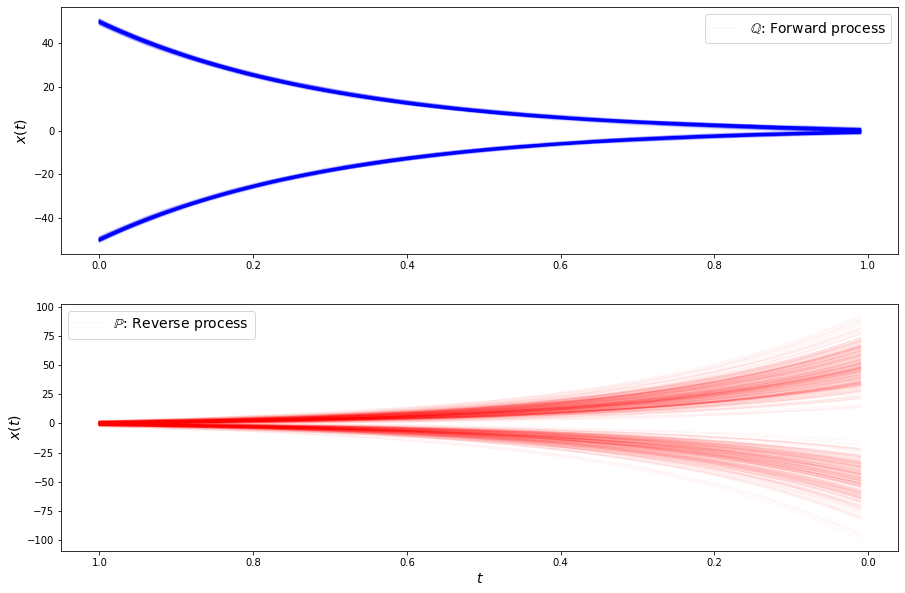

loss b 0.4739072620868683
loss b 0.48058855533599854
loss b 0.4603496491909027
loss b 0.4591388702392578
loss b 0.49289917945861816
loss b 0.5029102563858032
loss b 0.4874024987220764
loss b 0.4329657554626465
loss b 0.4668668210506439
loss b 0.5072863101959229
loss b 0.49035149812698364
loss b 0.4741457402706146
loss b 0.4706873893737793
loss b 0.5579850077629089
loss b 0.42475953698158264
loss b 0.450015664100647
loss b 0.4888570010662079
loss b 0.4668625593185425
loss b 0.4385409951210022
loss b 0.5077926516532898
loss b 0.5086948871612549
loss b 0.49389782547950745
loss f 3.3015334606170654
loss f 3.289917469024658
loss f 3.327913284301758
loss f 3.3134658336639404
loss f 3.3074452877044678
loss f 3.3092339038848877
loss f 3.3489670753479004
loss f 3.3129689693450928
loss f 3.2914209365844727
loss f 3.298811912536621
loss f 3.3071610927581787
loss f 3.3270630836486816
loss f 3.3051042556762695
loss f 3.3105311393737793
loss f 3.28413724899292
loss f 3.2982370853424072
loss f 3.3125

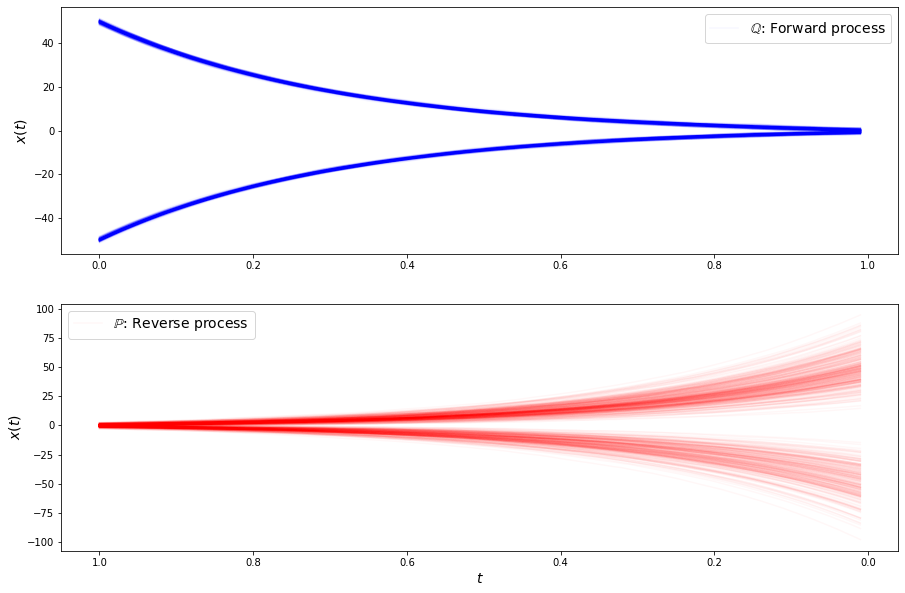

loss b 0.496114045381546
loss b 0.4933116137981415
loss b 0.508470892906189
loss b 0.5666570067405701
loss b 0.49637457728385925
loss b 0.5127941370010376
loss b 0.4882909655570984
loss b 0.4701016843318939
loss b 0.48652610182762146
loss b 0.480850487947464
loss b 0.4577586054801941
loss b 0.5209257006645203
loss b 0.4572828710079193
loss b 0.5027010440826416
loss b 0.5396865010261536
loss b 0.44811081886291504
loss b 0.5151529312133789
loss b 0.39474013447761536
loss b 0.5856247544288635
loss b 0.5076446533203125
loss b 0.49075761437416077
loss b 0.5384975075721741
loss f 3.3229238986968994
loss f 3.3443028926849365
loss f 3.3043200969696045
loss f 3.3282618522644043
loss f 3.291039228439331
loss f 3.290543556213379
loss f 3.2852859497070312
loss f 3.3061559200286865
loss f 3.3219988346099854
loss f 3.307464838027954
loss f 3.3014354705810547
loss f 3.308262586593628
loss f 3.3163857460021973
loss f 3.320572853088379
loss f 3.304943799972534
loss f 3.3279314041137695
loss f 3.3189229

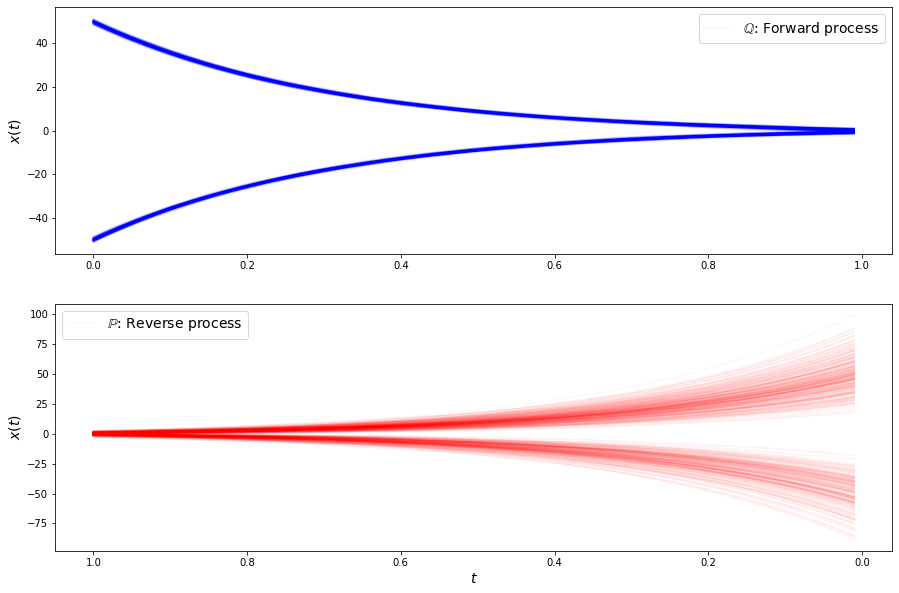

loss b 0.5399211049079895
loss b 0.42548274993896484
loss b 0.4599364399909973
loss b 0.49842461943626404
loss b 0.4898994565010071
loss b 0.4815486669540405
loss b 0.44828251004219055
loss b 0.4230952262878418
loss b 0.4347316324710846
loss b 0.43552932143211365
loss b 0.39068108797073364
loss b 0.438186377286911
loss b 0.4652576148509979
loss b 0.5216689705848694
loss b 0.45247775316238403
loss b 0.4469587802886963
loss b 0.46378540992736816
loss b 0.4389539957046509
loss b 0.556222140789032
loss b 0.40314120054244995
loss b 0.46331924200057983
loss b 0.4697706997394562
loss f 3.310553550720215
loss f 3.3226370811462402
loss f 3.313359260559082
loss f 3.2926855087280273
loss f 3.322248697280884
loss f 3.3106141090393066
loss f 3.3116395473480225
loss f 3.3218555450439453
loss f 3.2967240810394287
loss f 3.290107488632202
loss f 3.2981820106506348
loss f 3.317193031311035
loss f 3.324869394302368
loss f 3.3007006645202637
loss f 3.289491653442383
loss f 3.2974624633789062
loss f 3.314

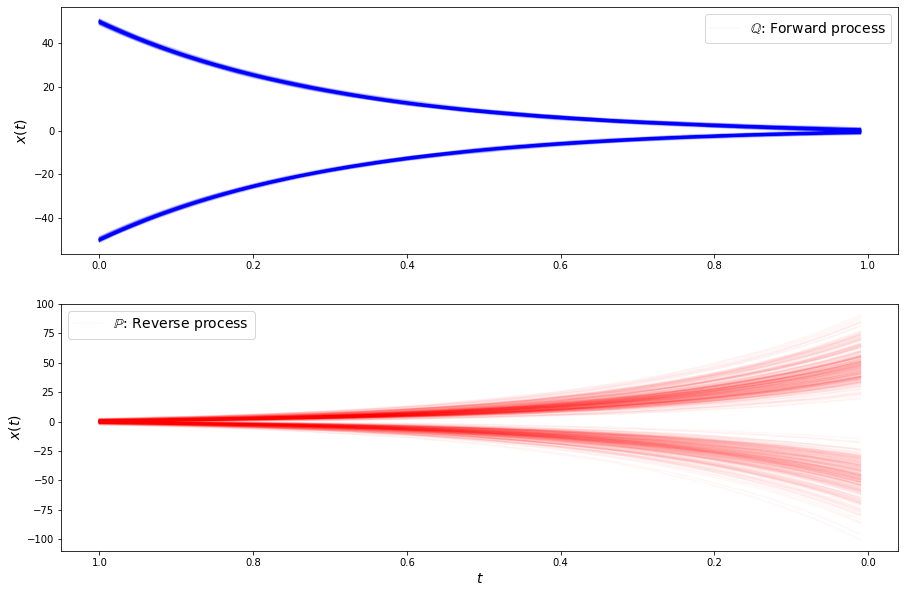

loss b 0.37366342544555664
loss b 0.48553362488746643
loss b 0.47014158964157104
loss b 0.46518075466156006
loss b 0.5459570288658142
loss b 0.4876900613307953
loss b 0.4703187942504883
loss b 0.5001876950263977
loss b 0.4714069366455078
loss b 0.5589584112167358
loss b 0.5089826583862305
loss b 0.5036327242851257
loss b 0.47943219542503357
loss b 0.48398908972740173
loss b 0.4681518077850342
loss b 0.4769197702407837
loss b 0.46817126870155334
loss b 0.5235182642936707
loss b 0.48819711804389954
loss b 0.46042144298553467
loss b 0.4646242558956146
loss b 0.43302255868911743
loss f 3.3093268871307373
loss f 3.3147175312042236
loss f 3.305189609527588
loss f 3.2879745960235596
loss f 3.324902057647705
loss f 3.306220054626465
loss f 3.273513078689575
loss f 3.3064122200012207
loss f 3.3146615028381348
loss f 3.322251558303833
loss f 3.3214709758758545
loss f 3.3015291690826416
loss f 3.2948427200317383
loss f 3.3353471755981445
loss f 3.2813587188720703
loss f 3.3129448890686035
loss f 

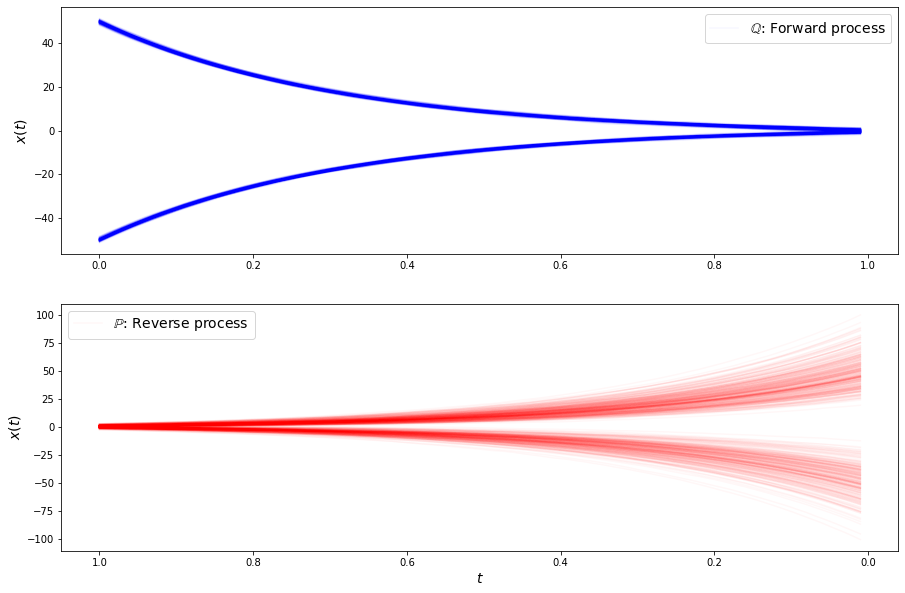

loss b 0.4636903703212738
loss b 0.5026550889015198
loss b 0.5370283722877502
loss b 0.4784070551395416
loss b 0.41624167561531067
loss b 0.43744829297065735
loss b 0.47398993372917175
loss b 0.3801895081996918
loss b 0.5595282316207886
loss b 0.4686768054962158
loss b 0.4346058666706085
loss b 0.5655361413955688
loss b 0.562387228012085
loss b 0.4971363842487335
loss b 0.45296037197113037
loss b 0.4622371792793274
loss b 0.40248164534568787
loss b 0.4923856258392334
loss b 0.4650713801383972
loss b 0.42490530014038086
loss b 0.4745262563228607
loss b 0.48650768399238586
loss f 3.3044800758361816
loss f 3.3094069957733154
loss f 3.301117181777954
loss f 3.30781888961792
loss f 3.310551643371582
loss f 3.29207181930542
loss f 3.282172918319702
loss f 3.314664602279663
loss f 3.3163914680480957
loss f 3.319179058074951
loss f 3.315073013305664
loss f 3.2815001010894775
loss f 3.3410704135894775
loss f 3.303175687789917
loss f 3.286081075668335
loss f 3.2985830307006836
loss f 3.286179542

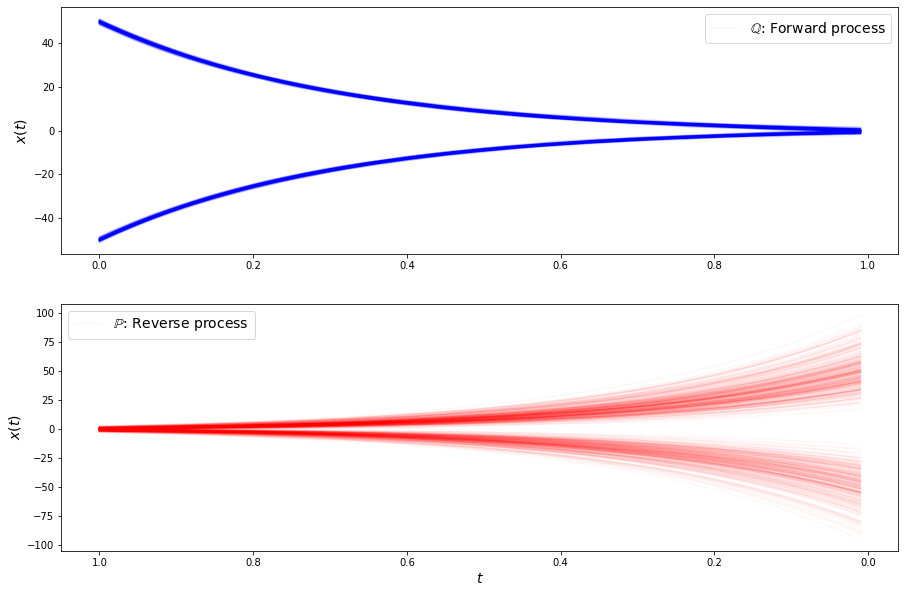

loss b 0.5276538729667664
loss b 0.5193087458610535
loss b 0.5099480748176575
loss b 0.5492560863494873
loss b 0.371349573135376
loss b 0.45862582325935364
loss b 0.4327106773853302
loss b 0.4642079770565033
loss b 0.5128048658370972
loss b 0.4607447683811188
loss b 0.45110443234443665
loss b 0.4900093078613281
loss b 0.506054699420929
loss b 0.44536957144737244
loss b 0.45536932349205017
loss b 0.5232129693031311
loss b 0.48753246665000916
loss b 0.4979729950428009
loss b 0.4223150908946991
loss b 0.4583093225955963
loss b 0.529706597328186
loss b 0.502623438835144
loss f 3.2948663234710693
loss f 3.3134632110595703
loss f 3.315361738204956
loss f 3.3204658031463623
loss f 3.300084114074707
loss f 3.3281421661376953
loss f 3.288069009780884
loss f 3.298389196395874
loss f 3.3165085315704346
loss f 3.2948460578918457
loss f 3.3165500164031982
loss f 3.3242080211639404
loss f 3.2984466552734375
loss f 3.2891855239868164
loss f 3.2899868488311768
loss f 3.3095204830169678
loss f 3.297738

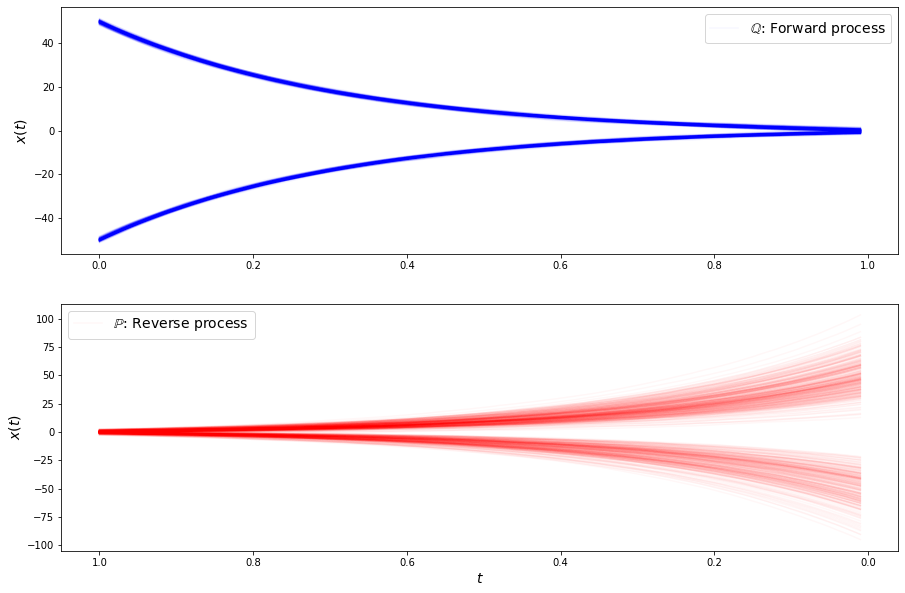

loss b 0.431285560131073
loss b 0.45124199986457825
loss b 0.521867573261261
loss b 0.4959281384944916
loss b 0.46046677231788635
loss b 0.4864218235015869
loss b 0.4903642535209656
loss b 0.4632990062236786
loss b 0.4157959520816803
loss b 0.4035971760749817
loss b 0.48806267976760864
loss b 0.48031091690063477
loss b 0.4771888852119446
loss b 0.4379989504814148
loss b 0.48904019594192505
loss b 0.4528672993183136
loss b 0.5019019842147827
loss b 0.5358348488807678
loss b 0.43636998534202576
loss b 0.5324349999427795
loss b 0.5019253492355347
loss b 0.4774318039417267
loss f 3.3100948333740234
loss f 3.2877554893493652
loss f 3.315950393676758
loss f 3.3239998817443848
loss f 3.3332526683807373
loss f 3.278426170349121
loss f 3.30987548828125
loss f 3.2945408821105957
loss f 3.3209919929504395
loss f 3.305056571960449
loss f 3.313253402709961
loss f 3.346134901046753
loss f 3.2950925827026367
loss f 3.2844505310058594
loss f 3.3043599128723145
loss f 3.3179540634155273
loss f 3.309423

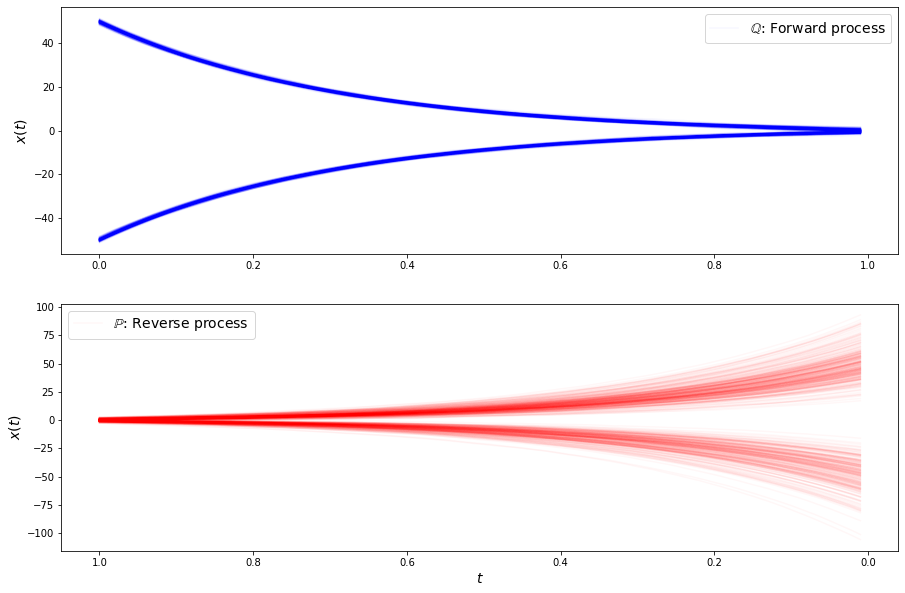

loss b 0.47522467374801636
loss b 0.459758996963501
loss b 0.5103749632835388
loss b 0.5129558444023132
loss b 0.5187771916389465
loss b 0.5420158505439758
loss b 0.4470396339893341
loss b 0.5351641178131104
loss b 0.514752984046936
loss b 0.484163373708725
loss b 0.418651282787323
loss b 0.5038248300552368
loss b 0.49342504143714905
loss b 0.5248829126358032
loss b 0.36340993642807007
loss b 0.4437043070793152
loss b 0.4448271691799164
loss b 0.3995216190814972
loss b 0.5184150338172913
loss b 0.5078577995300293
loss b 0.5086720585823059
loss b 0.49173635244369507
loss f 3.298828601837158
loss f 3.3171284198760986
loss f 3.307365894317627
loss f 3.2996599674224854
loss f 3.3109359741210938
loss f 3.336599588394165
loss f 3.293466567993164
loss f 3.3091485500335693
loss f 3.3254361152648926
loss f 3.3150203227996826
loss f 3.300943613052368
loss f 3.305659532546997
loss f 3.3069114685058594
loss f 3.299076557159424
loss f 3.296837091445923
loss f 3.270878314971924
loss f 3.314865350723

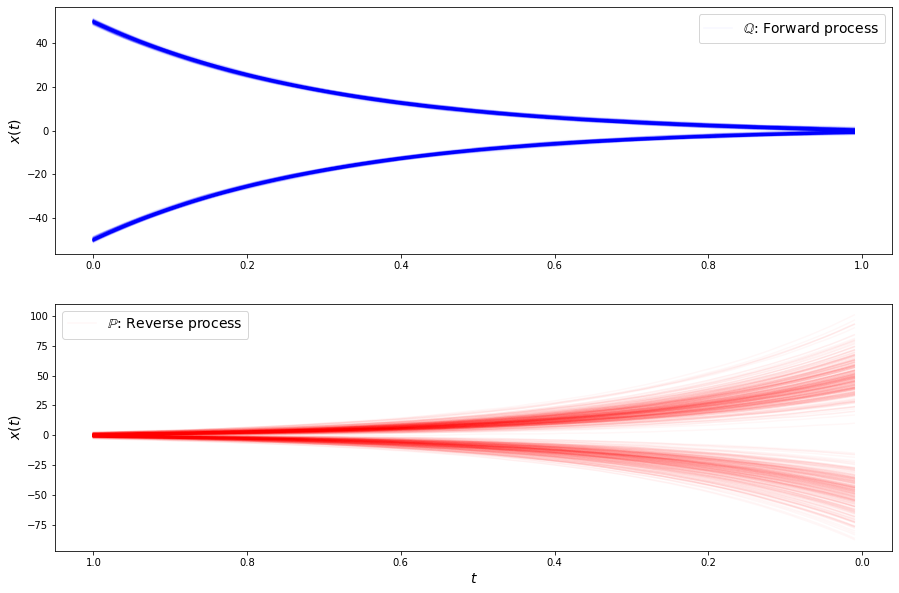

loss b 0.47510749101638794
loss b 0.4814203083515167
loss b 0.5228336453437805
loss b 0.4746609330177307
loss b 0.44957107305526733
loss b 0.4749414026737213
loss b 0.4472198784351349
loss b 0.48026731610298157
loss b 0.5095263719558716
loss b 0.5718150734901428
loss b 0.46735724806785583
loss b 0.48508304357528687
loss b 0.5180423855781555
loss b 0.43316006660461426
loss b 0.5299633145332336
loss b 0.4487019181251526
loss b 0.49897637963294983
loss b 0.4166385531425476
loss b 0.5285645723342896
loss b 0.5111134648323059
loss b 0.4260003864765167
loss b 0.4888964295387268
loss f 3.317296266555786
loss f 3.293163299560547
loss f 3.296837329864502
loss f 3.3225789070129395
loss f 3.3131940364837646
loss f 3.30867338180542
loss f 3.317324161529541
loss f 3.3114852905273438
loss f 3.3046631813049316
loss f 3.298743486404419
loss f 3.291149616241455
loss f 3.3075265884399414
loss f 3.3047633171081543
loss f 3.2949438095092773
loss f 3.279644727706909
loss f 3.308821439743042
loss f 3.324698

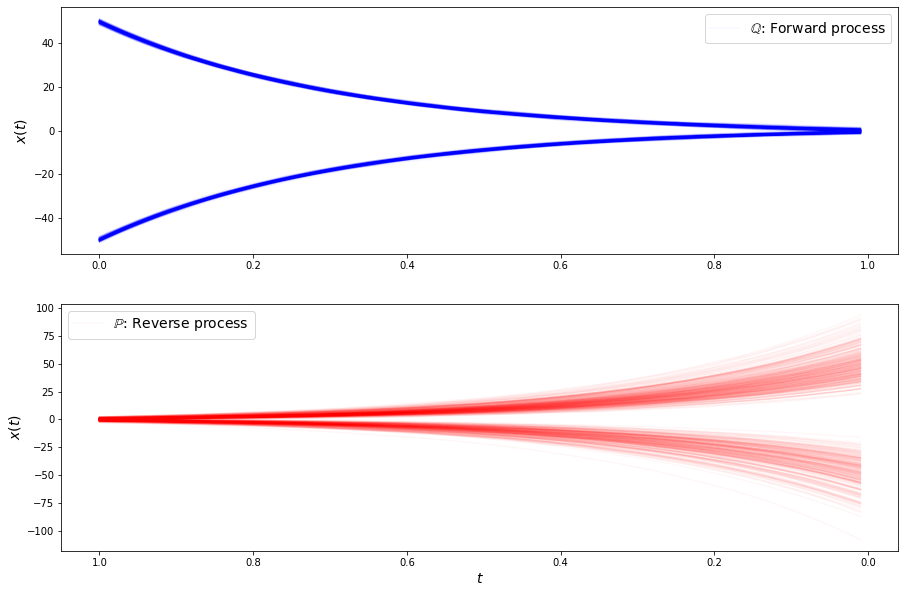

loss b 0.46041494607925415
loss b 0.5002523064613342
loss b 0.4925018846988678
loss b 0.5113110542297363
loss b 0.49411308765411377
loss b 0.5388708114624023
loss b 0.46214741468429565
loss b 0.45426738262176514
loss b 0.46863076090812683
loss b 0.5088651776313782
loss b 0.48745959997177124
loss b 0.4441171884536743
loss b 0.42785605788230896
loss b 0.4536415636539459
loss b 0.45561474561691284
loss b 0.45939481258392334
loss b 0.49615225195884705
loss b 0.4455993175506592
loss b 0.5244316458702087
loss b 0.45732638239860535
loss b 0.48240578174591064
loss b 0.461599737405777
loss f 3.3088762760162354
loss f 3.293365240097046
loss f 3.2990996837615967
loss f 3.312588930130005
loss f 3.2965517044067383
loss f 3.309746026992798
loss f 3.2846920490264893
loss f 3.3188040256500244
loss f 3.3254175186157227
loss f 3.3130054473876953
loss f 3.3040053844451904
loss f 3.2724549770355225
loss f 3.2909836769104004
loss f 3.286418914794922
loss f 3.301424980163574
loss f 3.2768919467926025
loss f

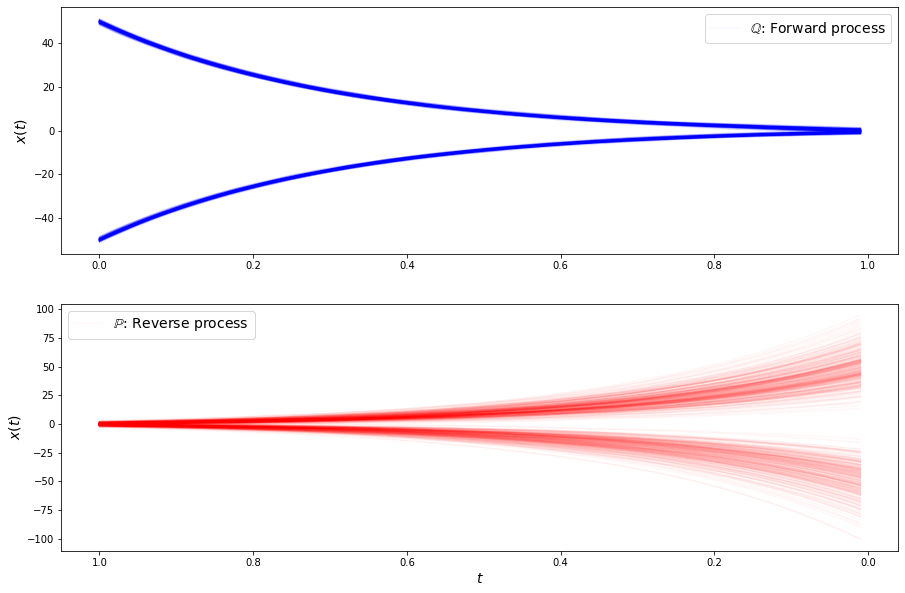

loss b 0.4895123839378357
loss b 0.4997202455997467
loss b 0.4444572329521179
loss b 0.4124445617198944
loss b 0.47251248359680176
loss b 0.4480603337287903
loss b 0.5295488834381104
loss b 0.5154036283493042
loss b 0.39774414896965027
loss b 0.42104655504226685
loss b 0.5634103417396545
loss b 0.49804359674453735
loss b 0.5208966135978699
loss b 0.5568519830703735
loss b 0.509502112865448
loss b 0.4972251057624817
loss b 0.5448545217514038
loss b 0.4650409519672394
loss b 0.41359826922416687
loss b 0.501462459564209
loss b 0.47769999504089355
loss b 0.46008914709091187
loss f 3.3101863861083984
loss f 3.3079988956451416
loss f 3.2851996421813965
loss f 3.2888784408569336
loss f 3.2817225456237793
loss f 3.3010900020599365
loss f 3.3058230876922607
loss f 3.282677412033081
loss f 3.2850234508514404
loss f 3.2796480655670166
loss f 3.2874550819396973
loss f 3.3185296058654785
loss f 3.32826566696167
loss f 3.2807254791259766
loss f 3.2702906131744385
loss f 3.3166017532348633
loss f 3.2

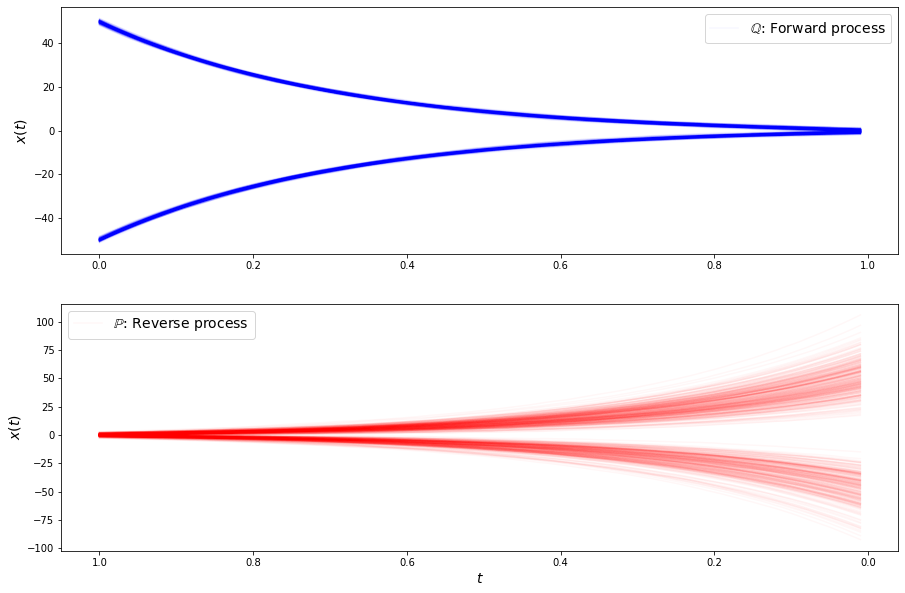

loss b 0.5005849003791809
loss b 0.4410933554172516
loss b 0.5355944037437439
loss b 0.4627578854560852
loss b 0.4818587899208069
loss b 0.5201080441474915
loss b 0.5161237716674805
loss b 0.5230895280838013
loss b 0.4944632053375244
loss b 0.5024805665016174
loss b 0.5419081449508667
loss b 0.44560956954956055
loss b 0.5274705290794373
loss b 0.44520244002342224
loss b 0.4458651840686798
loss b 0.4647045135498047
loss b 0.5014485120773315
loss b 0.4788667857646942
loss b 0.4440970718860626
loss b 0.4929080605506897
loss b 0.4360489249229431
loss b 0.42643874883651733
loss f 3.3014650344848633
loss f 3.29367733001709
loss f 3.2531144618988037
loss f 3.2905354499816895
loss f 3.3101308345794678
loss f 3.283315420150757
loss f 3.276613235473633
loss f 3.3245294094085693
loss f 3.3100287914276123
loss f 3.300262928009033
loss f 3.305501699447632
loss f 3.3010895252227783
loss f 3.29402494430542
loss f 3.2836976051330566
loss f 3.3000094890594482
loss f 3.2996253967285156
loss f 3.29574704

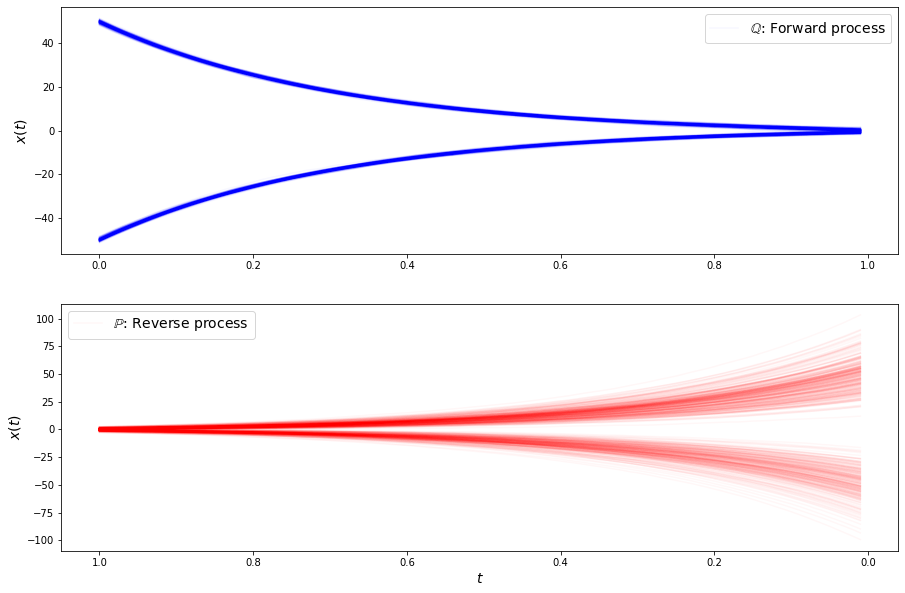

loss b 0.4449421465396881
loss b 0.4836406707763672
loss b 0.40840262174606323
loss b 0.39892280101776123
loss b 0.44323304295539856
loss b 0.4799313247203827
loss b 0.41940537095069885
loss b 0.5219773650169373
loss b 0.4078849256038666
loss b 0.5151204466819763
loss b 0.46774154901504517
loss b 0.4817517399787903
loss b 0.428213506937027
loss b 0.5698015093803406
loss b 0.5168527364730835
loss b 0.45858994126319885
loss b 0.3932284116744995
loss b 0.42613062262535095
loss b 0.45706507563591003
loss b 0.4651027023792267
loss b 0.5334081053733826
loss b 0.4680118262767792
loss f 3.2997779846191406
loss f 3.294002056121826
loss f 3.2959890365600586
loss f 3.3195395469665527
loss f 3.2587523460388184
loss f 3.279792308807373
loss f 3.2892956733703613
loss f 3.2900750637054443
loss f 3.307379961013794
loss f 3.3082730770111084
loss f 3.2944514751434326
loss f 3.2865490913391113
loss f 3.281317949295044
loss f 3.290485143661499
loss f 3.319511890411377
loss f 3.298428535461426
loss f 3.288

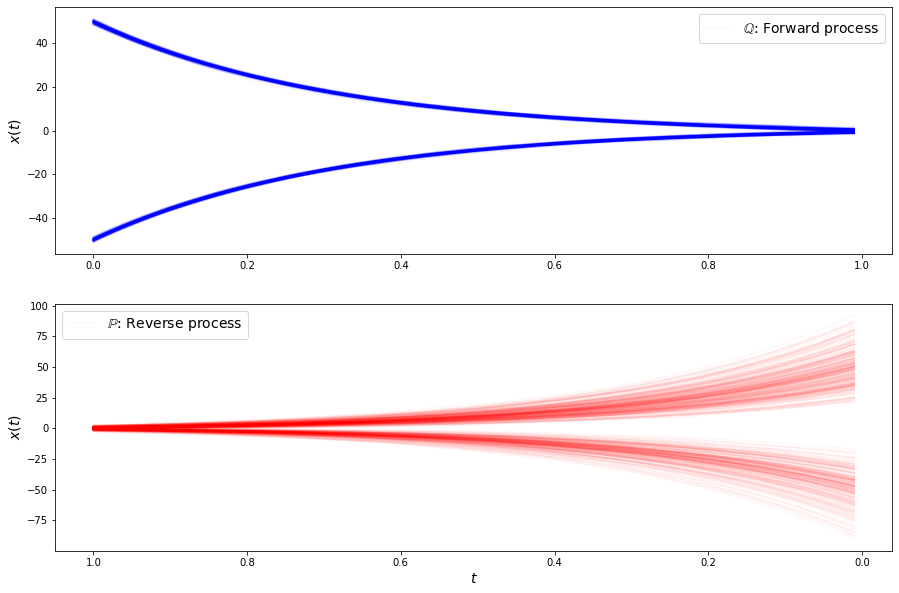

loss b 0.510320246219635
loss b 0.4689916968345642
loss b 0.46287694573402405
loss b 0.47495606541633606
loss b 0.3843334913253784
loss b 0.48704853653907776
loss b 0.4635920822620392
loss b 0.46999049186706543
loss b 0.4838768243789673
loss b 0.5289787650108337
loss b 0.4269533157348633
loss b 0.4998643100261688
loss b 0.43771669268608093
loss b 0.4568667411804199
loss b 0.44066593050956726
loss b 0.4632355570793152
loss b 0.5038210153579712
loss b 0.5007942318916321
loss b 0.4770846366882324
loss b 0.47349870204925537
loss b 0.4356051981449127
loss b 0.4591561257839203
loss f 3.2914774417877197
loss f 3.317709445953369
loss f 3.276865243911743
loss f 3.2799999713897705
loss f 3.3217520713806152
loss f 3.305602550506592
loss f 3.287487268447876
loss f 3.290415048599243
loss f 3.2824134826660156
loss f 3.2895450592041016
loss f 3.30122709274292
loss f 3.2808141708374023
loss f 3.2941365242004395
loss f 3.2840685844421387
loss f 3.2869889736175537
loss f 3.2911105155944824
loss f 3.2788

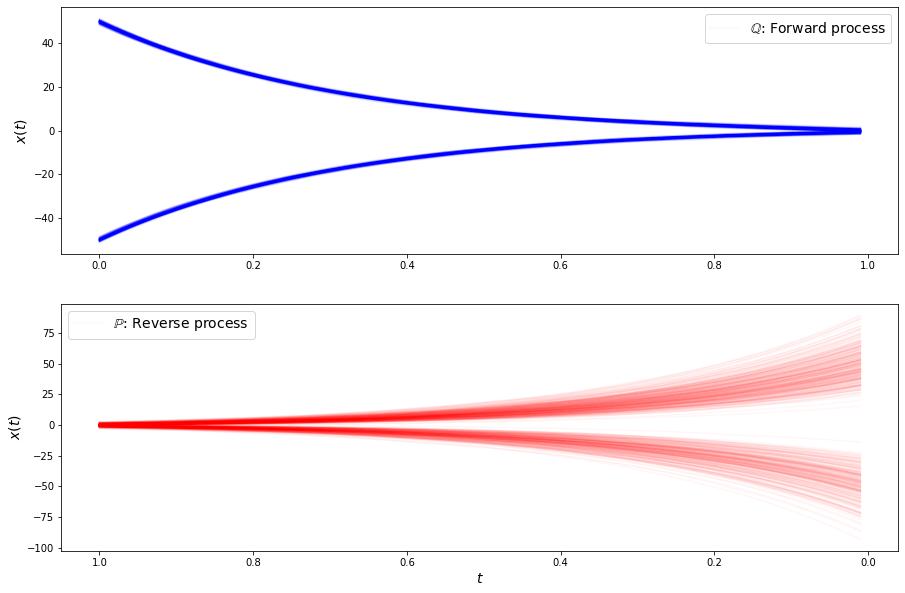

loss b 0.5189748406410217
loss b 0.4803953766822815
loss b 0.4709782600402832
loss b 0.5004203915596008
loss b 0.5017070770263672
loss b 0.4811193645000458
loss b 0.4529363512992859
loss b 0.4518912732601166
loss b 0.5013538002967834
loss b 0.43892985582351685
loss b 0.5018952488899231
loss b 0.4458383321762085
loss b 0.46306806802749634
loss b 0.4150933027267456
loss b 0.42857614159584045
loss b 0.4085646867752075
loss b 0.4786849319934845
loss b 0.4048800766468048
loss b 0.45319482684135437
loss b 0.461422860622406
loss b 0.4649740755558014
loss b 0.4632187485694885
loss f 3.299391508102417
loss f 3.3192219734191895
loss f 3.3050830364227295
loss f 3.2928450107574463
loss f 3.2899889945983887
loss f 3.295192241668701
loss f 3.3186678886413574
loss f 3.286930561065674
loss f 3.310248851776123
loss f 3.2627670764923096
loss f 3.2995097637176514
loss f 3.2963199615478516
loss f 3.312405586242676
loss f 3.297283887863159
loss f 3.3156402111053467
loss f 3.3055107593536377
loss f 3.311606

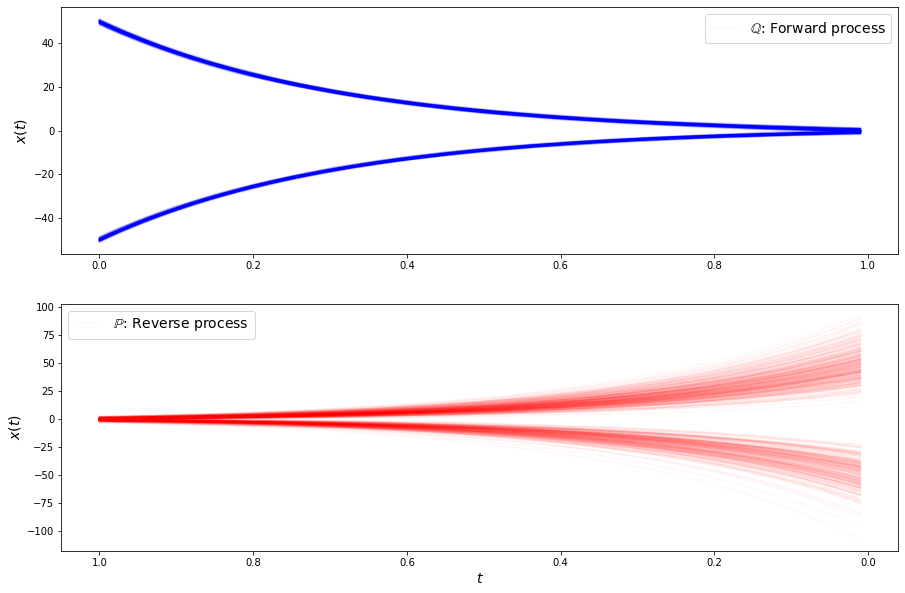

loss b 0.4598061144351959
loss b 0.4893650710582733
loss b 0.43565601110458374
loss b 0.422927588224411
loss b 0.5048098564147949
loss b 0.4621913731098175
loss b 0.4800526201725006
loss b 0.49985018372535706
loss b 0.4476219415664673
loss b 0.4696364998817444
loss b 0.48345881700515747
loss b 0.43950992822647095
loss b 0.4683876931667328
loss b 0.41025832295417786
loss b 0.3675175607204437
loss b 0.4308546185493469
loss b 0.4335959255695343
loss b 0.540809154510498
loss b 0.4581608772277832
loss b 0.4683937430381775
loss b 0.5055522322654724
loss b 0.4445934295654297
loss f 3.2663564682006836
loss f 3.333817481994629
loss f 3.3111934661865234
loss f 3.3138060569763184
loss f 3.277980327606201
loss f 3.249750852584839
loss f 3.297823429107666
loss f 3.3029816150665283
loss f 3.2825775146484375
loss f 3.3050620555877686
loss f 3.2906434535980225
loss f 3.299349784851074
loss f 3.290060043334961
loss f 3.283031940460205
loss f 3.259016752243042
loss f 3.2755815982818604
loss f 3.31278896

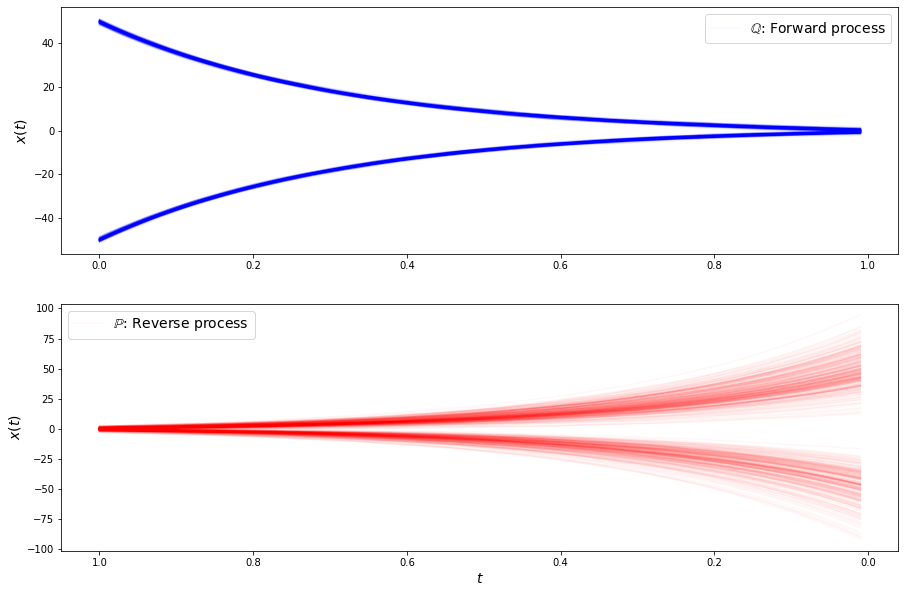

loss b 0.42423856258392334
loss b 0.44831612706184387
loss b 0.47587811946868896
loss b 0.42221957445144653
loss b 0.3864508271217346
loss b 0.3985137641429901
loss b 0.4572618007659912
loss b 0.45680585503578186
loss b 0.4762783646583557
loss b 0.511343240737915
loss b 0.4626849889755249
loss b 0.5514720678329468
loss b 0.426414430141449
loss b 0.44120925664901733
loss b 0.4546527564525604
loss b 0.412611722946167
loss b 0.48728886246681213
loss b 0.3954733610153198
loss b 0.5411855578422546
loss b 0.4610138237476349
loss b 0.47052767872810364
loss b 0.44286850094795227
loss f 3.2965617179870605
loss f 3.280308485031128
loss f 3.3088583946228027
loss f 3.298579692840576
loss f 3.3046462535858154
loss f 3.3096721172332764
loss f 3.2811875343322754
loss f 3.3142895698547363
loss f 3.227320909500122
loss f 3.291116237640381
loss f 3.265423059463501
loss f 3.268967390060425
loss f 3.294337034225464
loss f 3.2898364067077637
loss f 3.294699192047119
loss f 3.309617757797241
loss f 3.273956

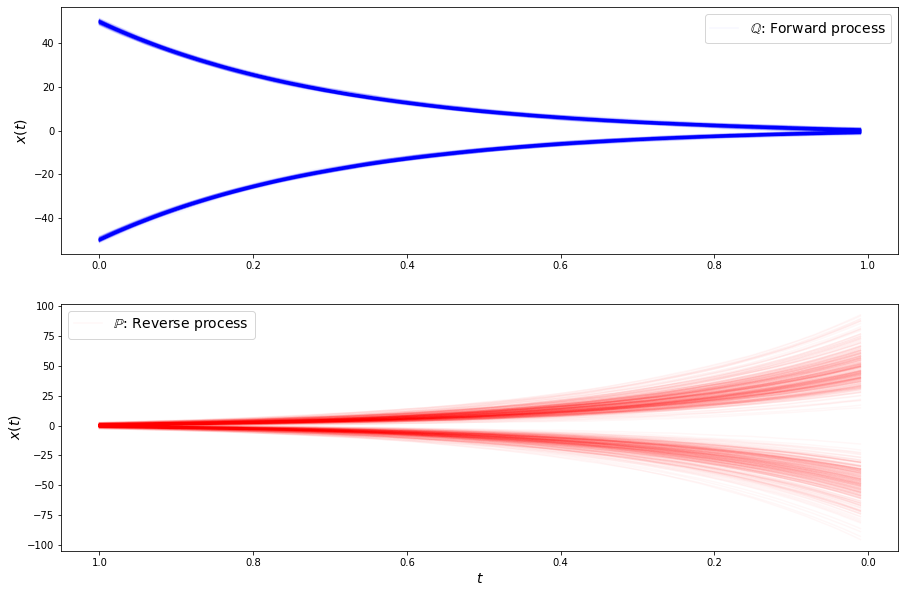

loss b 0.428226500749588
loss b 0.47191306948661804
loss b 0.4625432789325714
loss b 0.32784491777420044
loss b 0.48517119884490967
loss b 0.5549681186676025
loss b 0.565226674079895
loss b 0.5229049324989319
loss b 0.49655860662460327
loss b 0.44651031494140625
loss b 0.4291676878929138
loss b 0.4681043326854706
loss b 0.4948877692222595
loss b 0.4466545581817627
loss b 0.44854190945625305
loss b 0.4490279257297516
loss b 0.4403829872608185
loss b 0.4404110312461853
loss b 0.5019442439079285
loss b 0.5068077445030212
loss b 0.4684208929538727
loss b 0.4621087610721588
loss f 3.3017220497131348
loss f 3.257780075073242
loss f 3.288050889968872
loss f 3.300238609313965
loss f 3.26792049407959
loss f 3.2651784420013428
loss f 3.306856393814087
loss f 3.296708106994629
loss f 3.2941300868988037
loss f 3.30834698677063
loss f 3.3119640350341797
loss f 3.2778408527374268
loss f 3.2689244747161865
loss f 3.3141095638275146
loss f 3.261522054672241
loss f 3.3096227645874023
loss f 3.257867097

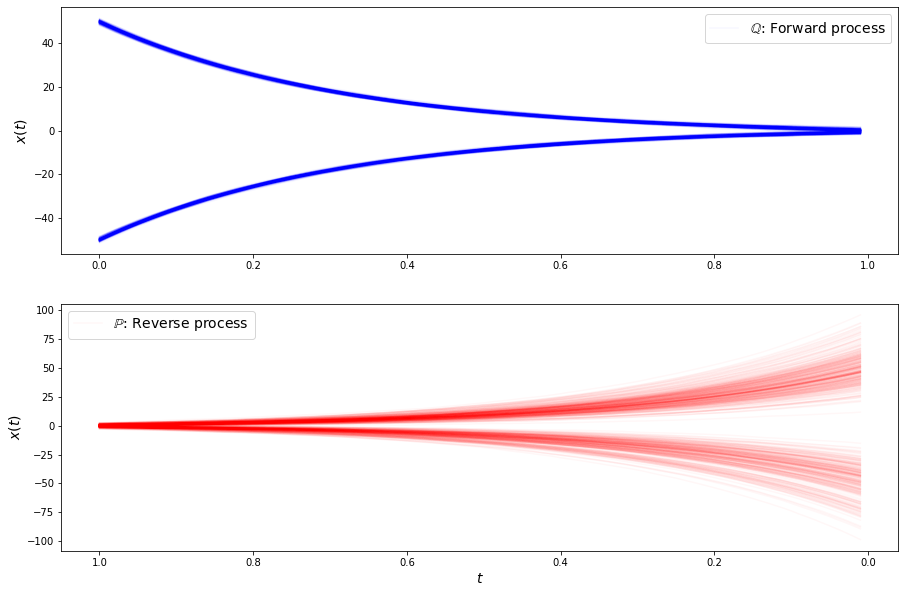

loss b 0.42229554057121277
loss b 0.49372637271881104
loss b 0.4572690725326538
loss b 0.4566348195075989
loss b 0.47680193185806274
loss b 0.44576019048690796
loss b 0.4509918987751007
loss b 0.46609893441200256
loss b 0.49315938353538513
loss b 0.49072524905204773
loss b 0.45055463910102844
loss b 0.44553256034851074
loss b 0.39641669392585754
loss b 0.5067213773727417
loss b 0.46379175782203674
loss b 0.42422956228256226
loss b 0.4556299149990082
loss b 0.5498157143592834
loss b 0.4674812853336334
loss b 0.4289645254611969
loss b 0.4688360393047333
loss b 0.384614497423172
loss f 3.3057897090911865
loss f 3.2894647121429443
loss f 3.282460927963257
loss f 3.3062500953674316
loss f 3.2969706058502197
loss f 3.2695515155792236
loss f 3.2821099758148193
loss f 3.2870748043060303
loss f 3.313992500305176
loss f 3.28289794921875
loss f 3.2736635208129883
loss f 3.2867488861083984
loss f 3.287813901901245
loss f 3.273452043533325
loss f 3.267557382583618
loss f 3.307027578353882
loss f 3.

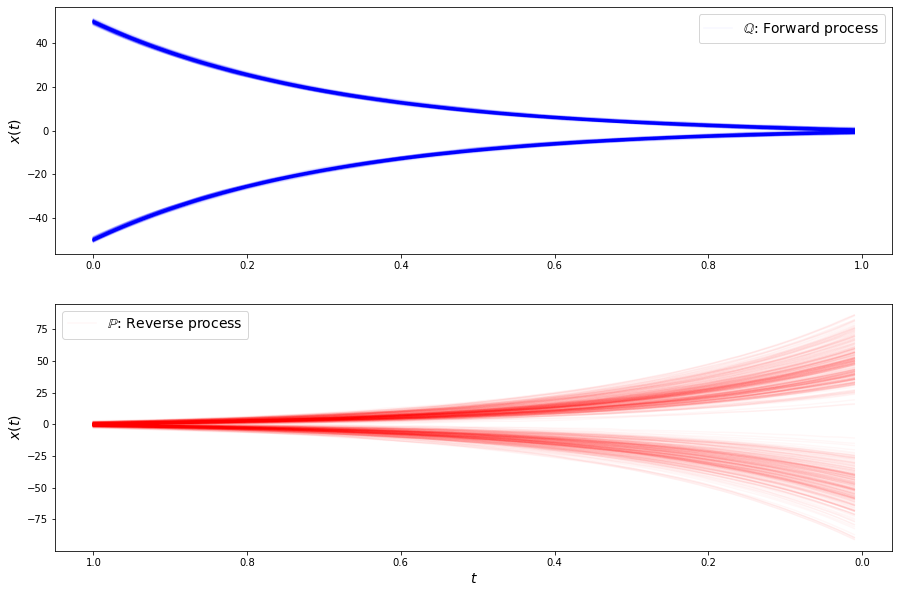

loss b 0.46286407113075256
loss b 0.40642812848091125
loss b 0.48312875628471375
loss b 0.4551325738430023
loss b 0.49849140644073486
loss b 0.4615590274333954
loss b 0.4541987180709839
loss b 0.44108811020851135
loss b 0.5125244855880737
loss b 0.4176037907600403
loss b 0.4576038122177124
loss b 0.4727495610713959
loss b 0.43565985560417175
loss b 0.47312772274017334
loss b 0.4925168752670288
loss b 0.4781474471092224
loss b 0.43458107113838196
loss b 0.44065847992897034
loss b 0.4497367739677429
loss b 0.47055619955062866
loss b 0.48767510056495667
loss b 0.4863174259662628
loss f 3.2798354625701904
loss f 3.317662477493286
loss f 3.323373556137085
loss f 3.2751522064208984
loss f 3.264146566390991
loss f 3.2858684062957764
loss f 3.2722322940826416
loss f 3.3018624782562256
loss f 3.2889397144317627
loss f 3.3161633014678955
loss f 3.3024075031280518
loss f 3.3143179416656494
loss f 3.2808220386505127
loss f 3.2991623878479004
loss f 3.3040268421173096
loss f 3.3018317222595215
loss

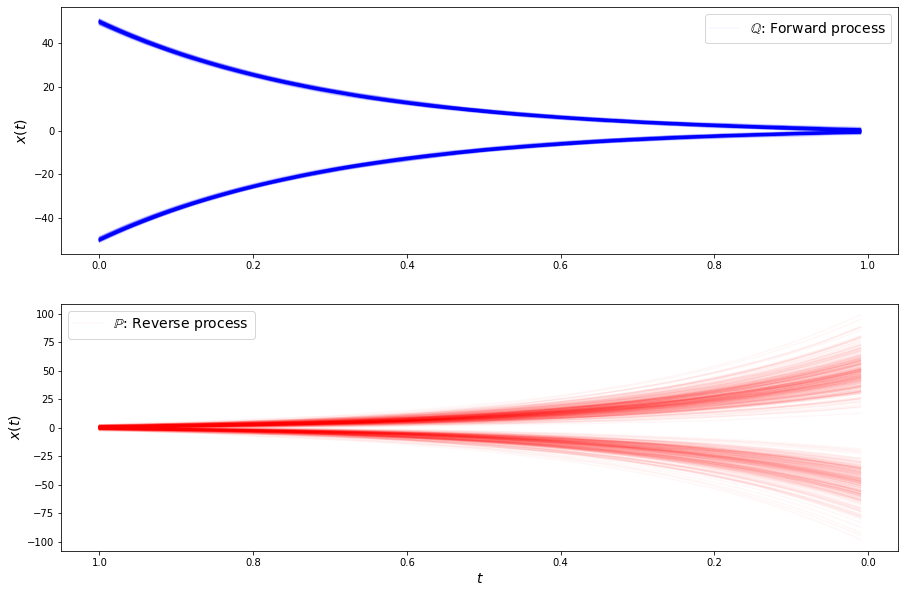

loss b 0.5262178778648376
loss b 0.4630645513534546
loss b 0.47268474102020264
loss b 0.4338369369506836
loss b 0.4944745600223541
loss b 0.48005080223083496
loss b 0.5338296294212341
loss b 0.4136049449443817
loss b 0.5257477760314941
loss b 0.47314074635505676
loss b 0.4750652015209198
loss b 0.4464553892612457
loss b 0.4113307595252991
loss b 0.4529852569103241
loss b 0.46879738569259644
loss b 0.3936469256877899
loss b 0.4490477442741394
loss b 0.4675827622413635
loss b 0.45401886105537415
loss b 0.5548331141471863
loss b 0.48284855484962463
loss b 0.5027892589569092
loss f 3.2740275859832764
loss f 3.2972114086151123
loss f 3.2778494358062744
loss f 3.2789576053619385
loss f 3.313642740249634
loss f 3.271503448486328
loss f 3.2855634689331055
loss f 3.254340410232544
loss f 3.304877758026123
loss f 3.283457040786743
loss f 3.2971739768981934
loss f 3.2814455032348633
loss f 3.2841620445251465
loss f 3.2735838890075684
loss f 3.278201103210449
loss f 3.276094436645508
loss f 3.2676

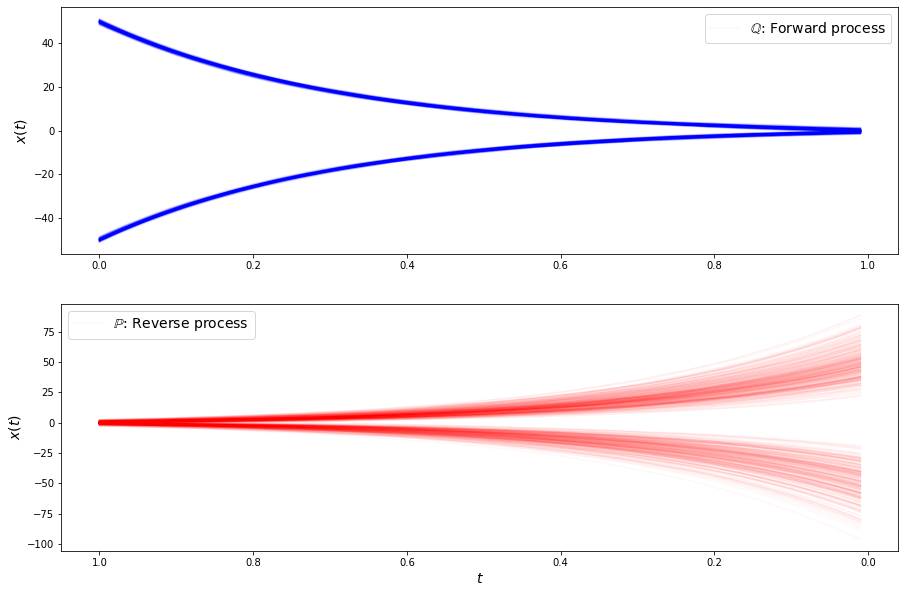

loss b 0.48354530334472656
loss b 0.3759075701236725
loss b 0.46574538946151733
loss b 0.46064433455467224
loss b 0.46834298968315125
loss b 0.4782467484474182
loss b 0.47362446784973145
loss b 0.46082863211631775
loss b 0.4511580169200897
loss b 0.4464559853076935
loss b 0.42873379588127136
loss b 0.39105743169784546
loss b 0.4988086223602295
loss b 0.4923902451992035
loss b 0.4422142803668976
loss b 0.4805940091609955
loss b 0.48988598585128784
loss b 0.4785771369934082
loss b 0.4133501350879669
loss b 0.4671069085597992
loss b 0.5381674766540527
loss b 0.4471258819103241
loss f 3.2944250106811523
loss f 3.29245924949646
loss f 3.280961513519287
loss f 3.2817699909210205
loss f 3.2906017303466797
loss f 3.3025763034820557
loss f 3.2902681827545166
loss f 3.331655502319336
loss f 3.268857717514038
loss f 3.2834529876708984
loss f 3.286081552505493
loss f 3.3099324703216553
loss f 3.287942409515381
loss f 3.289789915084839
loss f 3.284684419631958
loss f 3.279594898223877
loss f 3.3195

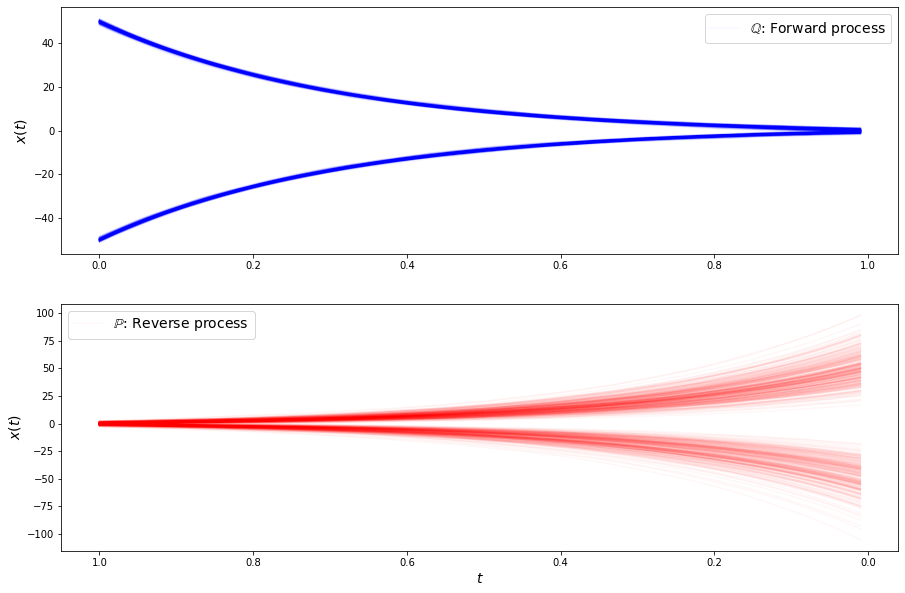

loss b 0.49306347966194153
loss b 0.45660027861595154
loss b 0.46414855122566223
loss b 0.4694291949272156
loss b 0.41827818751335144
loss b 0.43668144941329956
loss b 0.459273099899292
loss b 0.4429660141468048
loss b 0.45387494564056396
loss b 0.4519851505756378
loss b 0.4313300848007202
loss b 0.5278122425079346
loss b 0.4601631760597229
loss b 0.4904535114765167
loss b 0.5178582072257996
loss b 0.47141969203948975
loss b 0.4713187515735626
loss b 0.4176281988620758
loss b 0.4256161153316498
loss b 0.48701587319374084
loss b 0.4353260099887848
loss b 0.4220602512359619
loss f 3.3023383617401123
loss f 3.3147571086883545
loss f 3.3098385334014893
loss f 3.317596435546875
loss f 3.295975685119629
loss f 3.283889055252075
loss f 3.272369146347046
loss f 3.266228437423706
loss f 3.302286386489868
loss f 3.3109891414642334
loss f 3.283890962600708
loss f 3.2885444164276123
loss f 3.2752535343170166
loss f 3.3003125190734863
loss f 3.290485382080078
loss f 3.270214557647705
loss f 3.28335

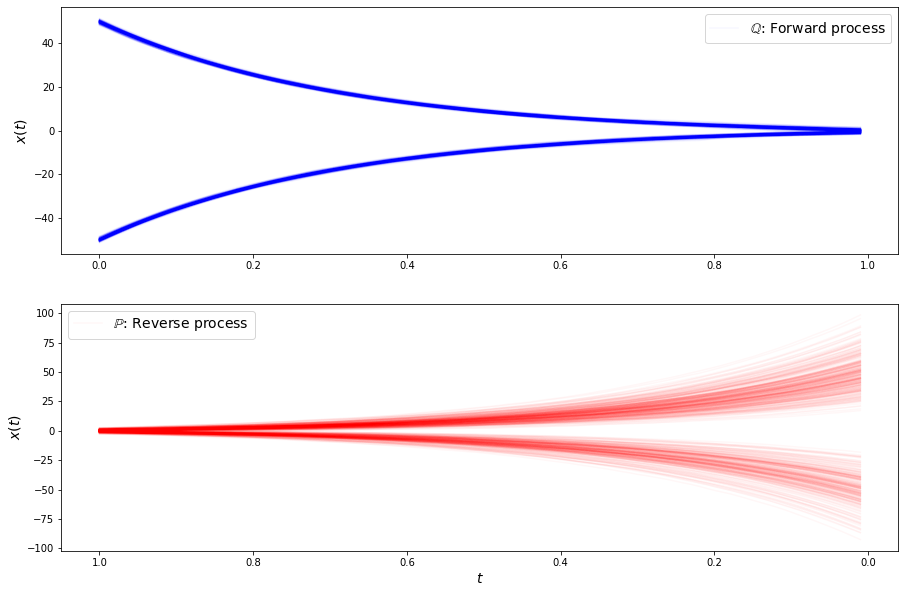

loss b 0.49010398983955383
loss b 0.48484006524086
loss b 0.454893559217453
loss b 0.46852248907089233
loss b 0.4717978835105896
loss b 0.43388500809669495
loss b 0.48894035816192627
loss b 0.4644862115383148
loss b 0.42968374490737915
loss b 0.52520352602005
loss b 0.44806742668151855
loss b 0.4649963676929474
loss b 0.4736522138118744
loss b 0.5003833770751953
loss b 0.411072313785553
loss b 0.44468072056770325
loss b 0.5274174809455872
loss b 0.43120187520980835
loss b 0.3894345164299011
loss b 0.4227934777736664
loss b 0.4326978325843811
loss b 0.4761786162853241
loss f 3.2581334114074707
loss f 3.285451889038086
loss f 3.2701826095581055
loss f 3.292099714279175
loss f 3.2704267501831055
loss f 3.2983734607696533
loss f 3.2852425575256348
loss f 3.296537160873413
loss f 3.255270004272461
loss f 3.2820279598236084
loss f 3.282165050506592
loss f 3.273749351501465
loss f 3.2835397720336914
loss f 3.2815115451812744
loss f 3.3178675174713135
loss f 3.2690060138702393
loss f 3.2813138

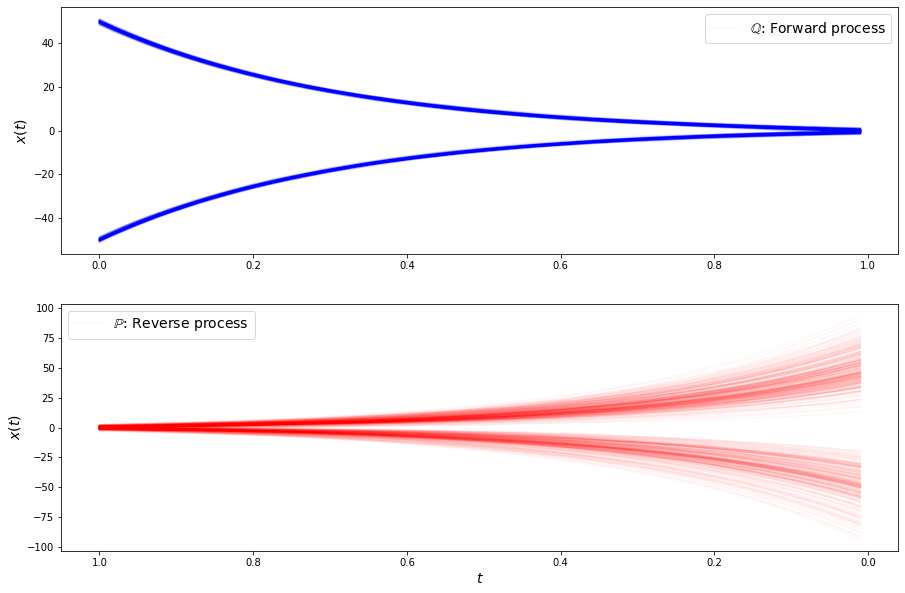

loss b 0.4404746890068054
loss b 0.48203930258750916
loss b 0.41912567615509033
loss b 0.4949963688850403
loss b 0.4509228765964508
loss b 0.5040294528007507
loss b 0.49849992990493774
loss b 0.47555312514305115
loss b 0.4335980713367462
loss b 0.3870466649532318
loss b 0.5110269784927368
loss b 0.39702466130256653
loss b 0.47811824083328247
loss b 0.41789552569389343
loss b 0.47821155190467834
loss b 0.460789293050766
loss b 0.5004448890686035
loss b 0.5003727674484253
loss b 0.43455782532691956
loss b 0.5486965179443359
loss b 0.4514632523059845
loss b 0.4426453411579132
loss f 3.2898924350738525
loss f 3.2835910320281982
loss f 3.2828636169433594
loss f 3.2497379779815674
loss f 3.273186445236206
loss f 3.282794237136841
loss f 3.2932894229888916
loss f 3.2749085426330566
loss f 3.307215929031372
loss f 3.2772223949432373
loss f 3.2763516902923584
loss f 3.27769136428833
loss f 3.3011178970336914
loss f 3.319504499435425
loss f 3.3039872646331787
loss f 3.306037664413452
loss f 3.27

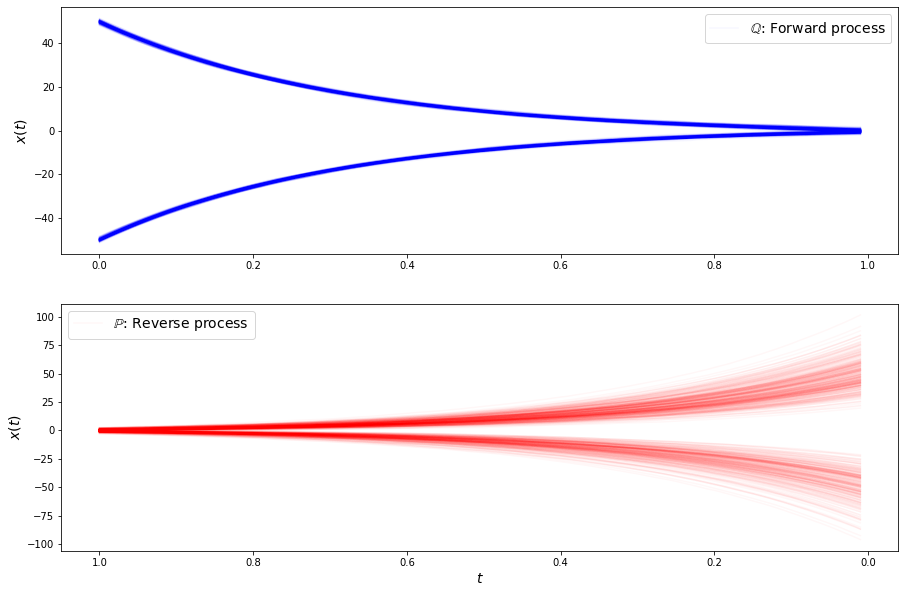

loss b 0.3858437240123749
loss b 0.44508323073387146
loss b 0.41583672165870667
loss b 0.4988262355327606
loss b 0.4383868873119354
loss b 0.4766492247581482
loss b 0.4612550139427185
loss b 0.40835294127464294
loss b 0.45416006445884705
loss b 0.5052608847618103
loss b 0.4460943639278412
loss b 0.5027250051498413
loss b 0.4958344101905823
loss b 0.3974427580833435
loss b 0.44707930088043213
loss b 0.5035133957862854
loss b 0.4956301748752594
loss b 0.5048167705535889
loss b 0.47235584259033203
loss b 0.4577460289001465
loss b 0.48789408802986145
loss b 0.5039380192756653
loss f 3.297874927520752
loss f 3.259237289428711
loss f 3.2899227142333984
loss f 3.2754602432250977
loss f 3.2942464351654053
loss f 3.276487112045288
loss f 3.280017614364624
loss f 3.2803568840026855
loss f 3.286289930343628
loss f 3.303114414215088
loss f 3.2624199390411377
loss f 3.268254518508911
loss f 3.2753779888153076
loss f 3.2472991943359375
loss f 3.3036367893218994
loss f 3.2836291790008545
loss f 3.284

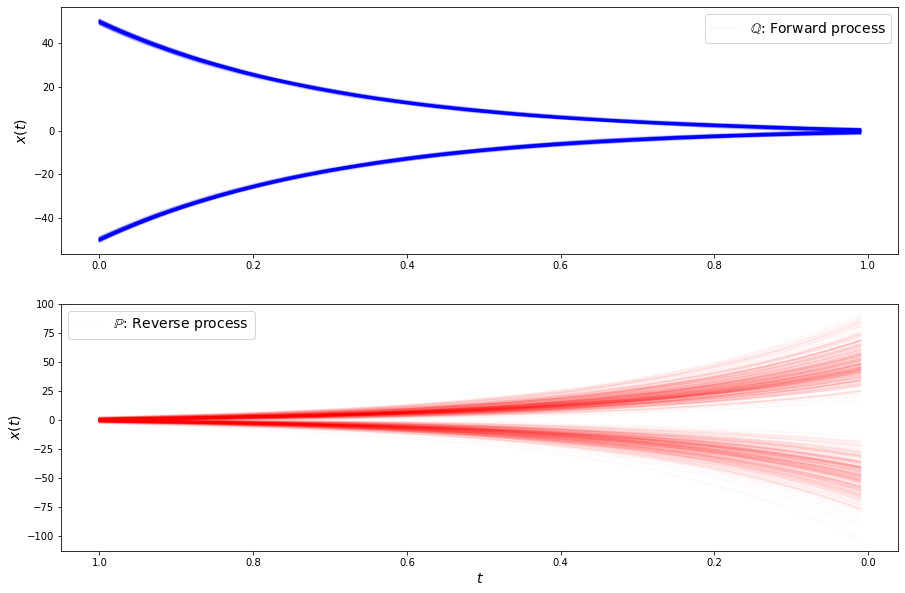

loss b 0.4709392189979553
loss b 0.4146426022052765
loss b 0.49523988366127014
loss b 0.44679737091064453
loss b 0.4640873670578003
loss b 0.41516590118408203
loss b 0.44998037815093994
loss b 0.5016871690750122
loss b 0.43750137090682983
loss b 0.49407756328582764
loss b 0.4547519385814667
loss b 0.4103225767612457
loss b 0.4897199273109436
loss b 0.48690617084503174
loss b 0.5101717114448547
loss b 0.45532599091529846
loss b 0.4356202483177185
loss b 0.4129900634288788
loss b 0.45711517333984375
loss b 0.440187931060791
loss b 0.4556553363800049
loss b 0.4765419661998749
loss f 3.2845261096954346
loss f 3.3006463050842285
loss f 3.2951345443725586
loss f 3.2745120525360107
loss f 3.2861392498016357
loss f 3.2960774898529053
loss f 3.2614951133728027
loss f 3.2892580032348633
loss f 3.2865970134735107
loss f 3.2527518272399902
loss f 3.2842366695404053
loss f 3.276040554046631
loss f 3.2910256385803223
loss f 3.276376485824585
loss f 3.311436414718628
loss f 3.2716262340545654
loss f 

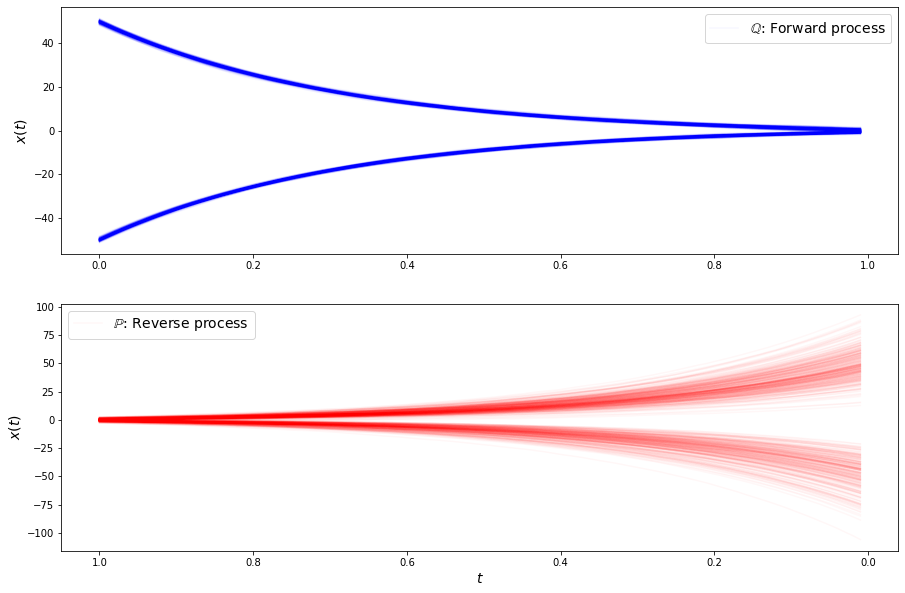

loss b 0.4584530293941498
loss b 0.4496048092842102
loss b 0.4628335237503052
loss b 0.5707020163536072
loss b 0.4849894344806671
loss b 0.5284900069236755
loss b 0.47951486706733704
loss b 0.4411832392215729
loss b 0.4485168159008026
loss b 0.4337998628616333
loss b 0.4585031270980835
loss b 0.4708244204521179
loss b 0.49438613653182983
loss b 0.44444000720977783
loss b 0.4597910940647125
loss b 0.4117228090763092
loss b 0.42525559663772583
loss b 0.42744359374046326
loss b 0.4381076693534851
loss b 0.46128904819488525
loss b 0.4618687629699707
loss b 0.44005462527275085
loss f 3.3136377334594727
loss f 3.287097454071045
loss f 3.319887399673462
loss f 3.2743582725524902
loss f 3.3014001846313477
loss f 3.287353038787842
loss f 3.3106184005737305
loss f 3.27191424369812
loss f 3.2790420055389404
loss f 3.2691776752471924
loss f 3.2777252197265625
loss f 3.3124043941497803
loss f 3.2831315994262695
loss f 3.256793975830078
loss f 3.2943665981292725
loss f 3.296328544616699
loss f 3.294

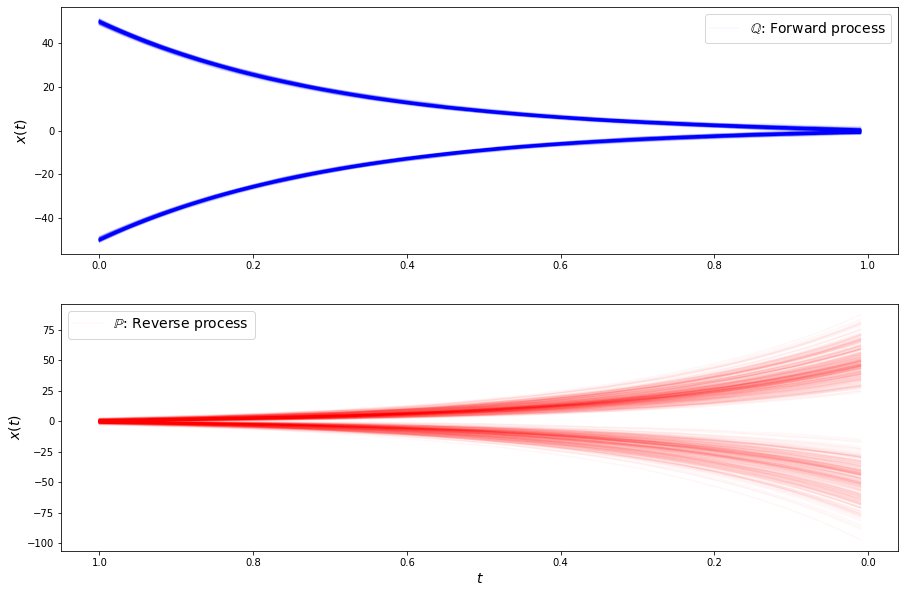

loss b 0.46013250946998596
loss b 0.4777093231678009
loss b 0.4335251450538635
loss b 0.5235643982887268
loss b 0.4238858222961426
loss b 0.4506893754005432
loss b 0.4530288875102997
loss b 0.4731978476047516
loss b 0.4829796552658081
loss b 0.41576525568962097
loss b 0.484064519405365
loss b 0.43027201294898987
loss b 0.37004226446151733
loss b 0.4537947475910187
loss b 0.42707300186157227
loss b 0.4403890073299408
loss b 0.4908224046230316
loss b 0.45766180753707886
loss b 0.37617868185043335
loss b 0.5175871849060059
loss b 0.43329739570617676
loss b 0.41147762537002563
loss f 3.2836270332336426
loss f 3.2948005199432373
loss f 3.268390417098999
loss f 3.3107750415802
loss f 3.3162124156951904
loss f 3.2879624366760254
loss f 3.3076655864715576
loss f 3.274975061416626
loss f 3.2756354808807373
loss f 3.265608549118042
loss f 3.2789831161499023
loss f 3.2757792472839355
loss f 3.292952537536621
loss f 3.277554750442505
loss f 3.2652597427368164
loss f 3.3077127933502197
loss f 3.273

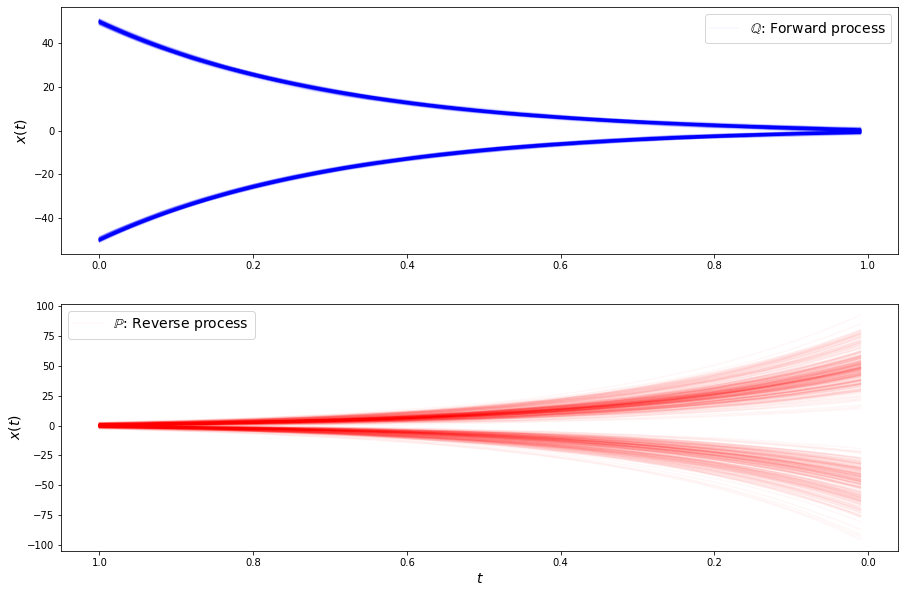

loss b 0.4498443603515625
loss b 0.5108979344367981
loss b 0.4500396251678467
loss b 0.4565875232219696
loss b 0.49858057498931885
loss b 0.43709254264831543
loss b 0.4248886704444885
loss b 0.4507468044757843
loss b 0.4519678056240082
loss b 0.4406649172306061
loss b 0.5197618007659912
loss b 0.4325549900531769
loss b 0.4342572093009949
loss b 0.4621743857860565
loss b 0.5296187400817871
loss b 0.41748225688934326
loss b 0.4750699996948242
loss b 0.4888133108615875
loss b 0.45612025260925293
loss b 0.4937747120857239
loss b 0.4652743339538574
loss b 0.43821465969085693
loss f 3.281064987182617
loss f 3.288808584213257
loss f 3.2544188499450684
loss f 3.288053035736084
loss f 3.3260624408721924
loss f 3.2725307941436768
loss f 3.273250102996826
loss f 3.3000009059906006
loss f 3.2939906120300293
loss f 3.2915680408477783
loss f 3.3088364601135254
loss f 3.3074355125427246
loss f 3.2705721855163574
loss f 3.2917098999023438
loss f 3.269941806793213
loss f 3.2710773944854736
loss f 3.285

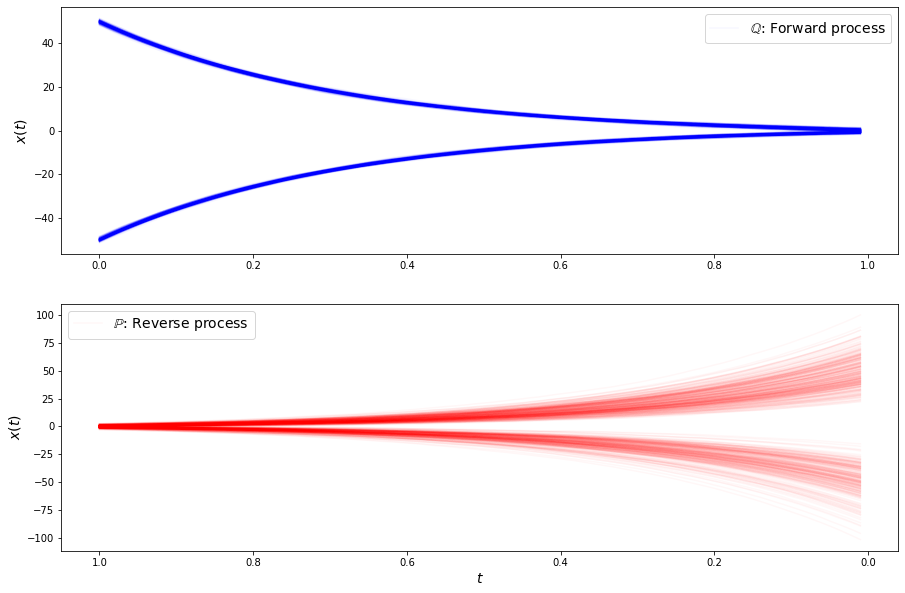

loss b 0.5150395631790161
loss b 0.45707693696022034
loss b 0.47454187273979187
loss b 0.4359191358089447
loss b 0.4879454970359802
loss b 0.4644794166088104
loss b 0.4814280569553375
loss b 0.4636303186416626
loss b 0.46962738037109375
loss b 0.3916090130805969
loss b 0.39511799812316895
loss b 0.46156322956085205
loss b 0.4640379548072815
loss b 0.46354925632476807
loss b 0.42837774753570557
loss b 0.5245680212974548
loss b 0.441312700510025
loss b 0.45458659529685974
loss b 0.5032428503036499
loss b 0.43944594264030457
loss b 0.509665310382843
loss b 0.46608102321624756
loss f 3.277985095977783
loss f 3.2801096439361572
loss f 3.2770493030548096
loss f 3.2772514820098877
loss f 3.263929605484009
loss f 3.27231502532959
loss f 3.2795441150665283
loss f 3.296125888824463
loss f 3.2899413108825684
loss f 3.2816123962402344
loss f 3.2693135738372803
loss f 3.2679367065429688
loss f 3.263530969619751
loss f 3.2920453548431396
loss f 3.292790412902832
loss f 3.3046770095825195
loss f 3.29

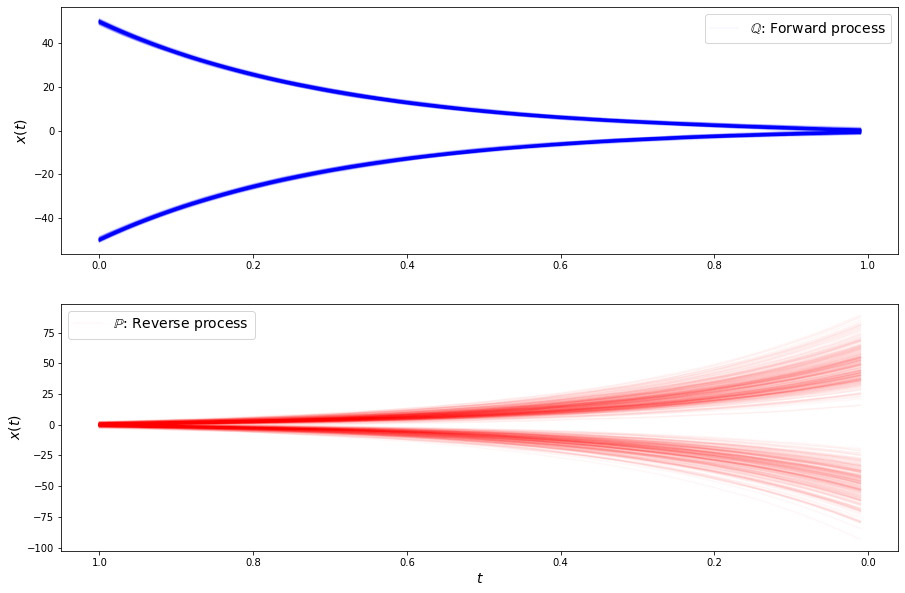

loss b 0.5254981517791748
loss b 0.5060096979141235
loss b 0.439414918422699
loss b 0.45545169711112976
loss b 0.3775465190410614
loss b 0.5027194023132324
loss b 0.5051090717315674
loss b 0.43311187624931335
loss b 0.5024433732032776
loss b 0.36708635091781616
loss b 0.386342853307724
loss b 0.3704860508441925
loss b 0.4218887686729431
loss b 0.41628995537757874
loss b 0.4337947368621826
loss b 0.4625609517097473
loss b 0.5276166200637817
loss b 0.43716317415237427
loss b 0.4708173871040344
loss b 0.48378509283065796
loss b 0.4959796667098999
loss b 0.4475501775741577
loss f 3.275650978088379
loss f 3.275996685028076
loss f 3.2694149017333984
loss f 3.278256893157959
loss f 3.2758700847625732
loss f 3.2673895359039307
loss f 3.2950055599212646
loss f 3.2985949516296387
loss f 3.2790048122406006
loss f 3.28031849861145
loss f 3.2781810760498047
loss f 3.27057147026062
loss f 3.2588937282562256
loss f 3.2757654190063477
loss f 3.271782159805298
loss f 3.2864255905151367
loss f 3.2823207

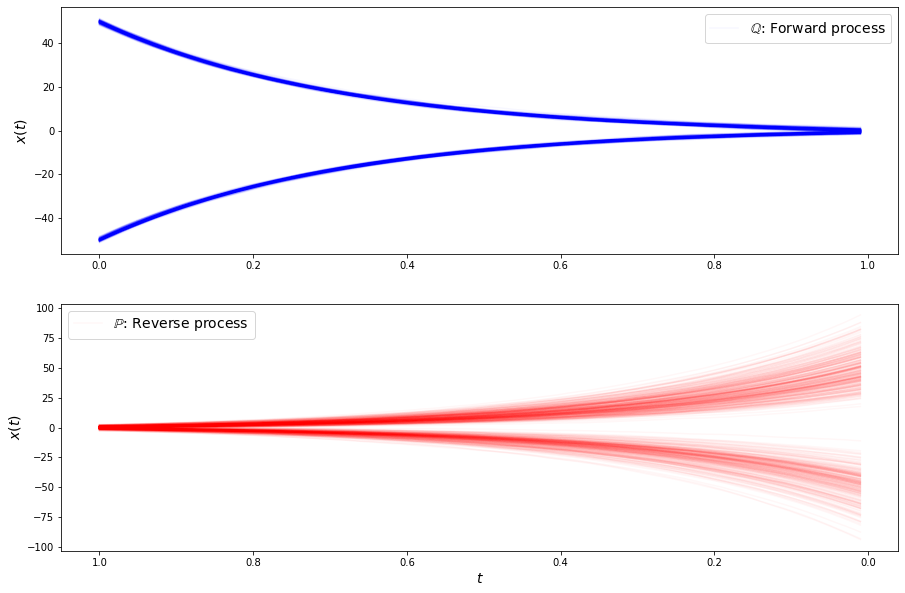

loss b 0.45255225896835327
loss b 0.3770110607147217
loss b 0.39416080713272095
loss b 0.47956961393356323
loss b 0.3968619704246521
loss b 0.44378018379211426
loss b 0.48508355021476746
loss b 0.4959009885787964
loss b 0.4721287190914154
loss b 0.47095224261283875
loss b 0.4735671579837799
loss b 0.37555575370788574
loss b 0.44575971364974976
loss b 0.49836793541908264
loss b 0.49126556515693665
loss b 0.3718535602092743
loss b 0.4242585599422455
loss b 0.4734209477901459
loss b 0.4721677601337433
loss b 0.39203348755836487
loss b 0.4540477991104126
loss b 0.45529675483703613
loss f 3.2719199657440186
loss f 3.27876353263855
loss f 3.265799045562744
loss f 3.2849295139312744
loss f 3.242161989212036
loss f 3.2957282066345215
loss f 3.285996437072754
loss f 3.2418599128723145
loss f 3.28045654296875
loss f 3.2747671604156494
loss f 3.307526111602783
loss f 3.268731117248535
loss f 3.279043197631836
loss f 3.2951295375823975
loss f 3.2769219875335693
loss f 3.296475887298584
loss f 3.27

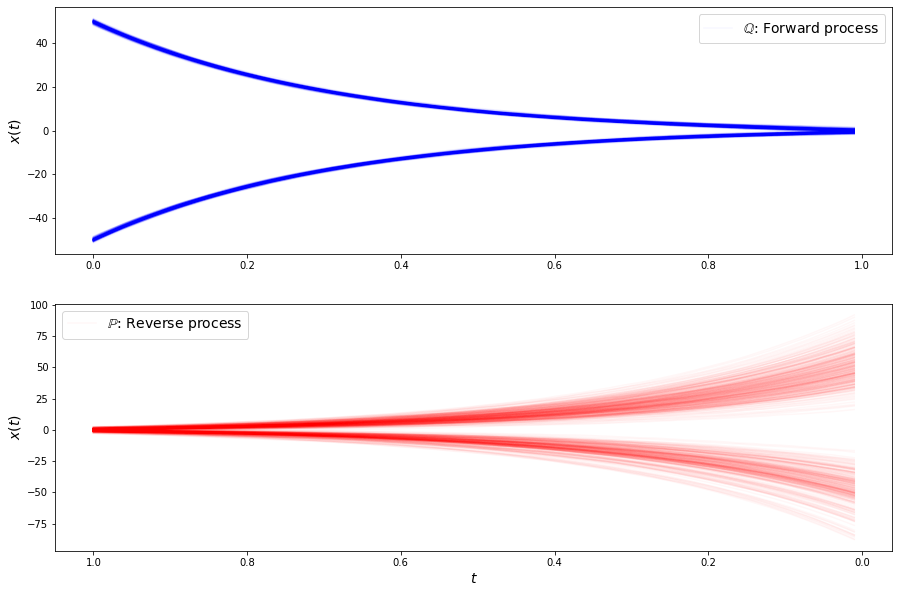

loss b 0.347274512052536
loss b 0.44274038076400757
loss b 0.45795774459838867
loss b 0.4515637457370758
loss b 0.4165540337562561
loss b 0.44088324904441833
loss b 0.37193289399147034
loss b 0.4352762699127197
loss b 0.44014912843704224
loss b 0.42032432556152344
loss b 0.4843618869781494
loss b 0.46053099632263184
loss b 0.5049933195114136
loss b 0.42181575298309326
loss b 0.4517395496368408
loss b 0.42607057094573975
loss b 0.4567749798297882
loss b 0.45699235796928406
loss b 0.4684832990169525
loss b 0.4312729835510254
loss b 0.3694269359111786
loss b 0.441301554441452
loss f 3.2756104469299316
loss f 3.2710955142974854
loss f 3.3051891326904297
loss f 3.2753708362579346
loss f 3.2692270278930664
loss f 3.273963689804077
loss f 3.266817808151245
loss f 3.2946720123291016
loss f 3.29801607131958
loss f 3.2584164142608643
loss f 3.2791192531585693
loss f 3.2892351150512695
loss f 3.270073413848877
loss f 3.2754578590393066
loss f 3.2702929973602295
loss f 3.2607977390289307
loss f 3.

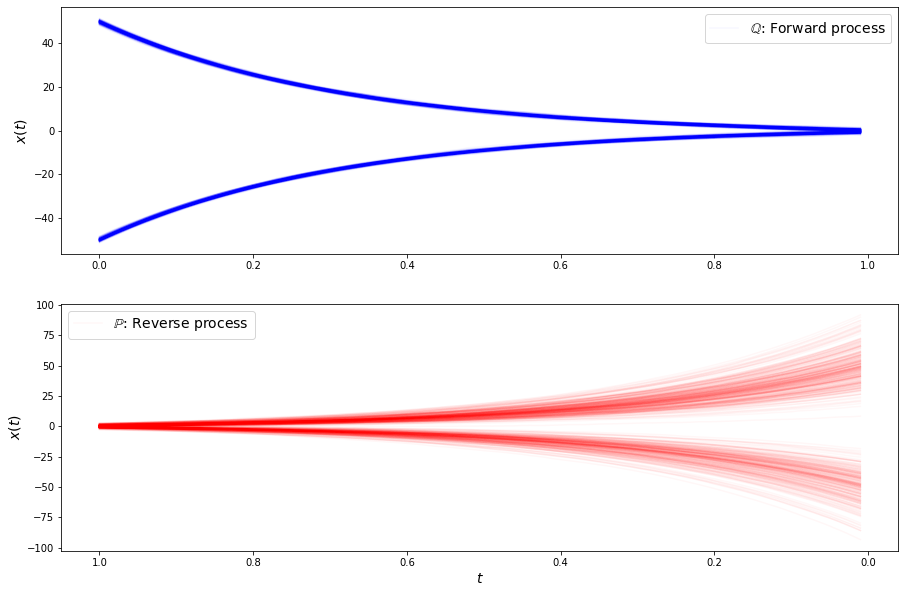

loss b 0.5132462978363037
loss b 0.45555007457733154
loss b 0.4345777928829193
loss b 0.412422239780426
loss b 0.47641488909721375
loss b 0.417595237493515
loss b 0.5084067583084106
loss b 0.48500800132751465
loss b 0.38461819291114807
loss b 0.4559846818447113
loss b 0.5036049485206604
loss b 0.476734459400177
loss b 0.3657682538032532
loss b 0.4558756947517395
loss b 0.45846325159072876
loss b 0.4512845575809479
loss b 0.5282436013221741
loss b 0.4860847592353821
loss b 0.4415671229362488
loss b 0.4222436547279358
loss b 0.45069247484207153
loss b 0.4432130753993988
loss f 3.285085916519165
loss f 3.2724575996398926
loss f 3.2499682903289795
loss f 3.25347638130188
loss f 3.2873594760894775
loss f 3.3304619789123535
loss f 3.2714130878448486
loss f 3.3056249618530273
loss f 3.30895733833313
loss f 3.2808568477630615
loss f 3.2632405757904053
loss f 3.2763354778289795
loss f 3.2995951175689697
loss f 3.2811660766601562
loss f 3.2764315605163574
loss f 3.3007755279541016
loss f 3.26631

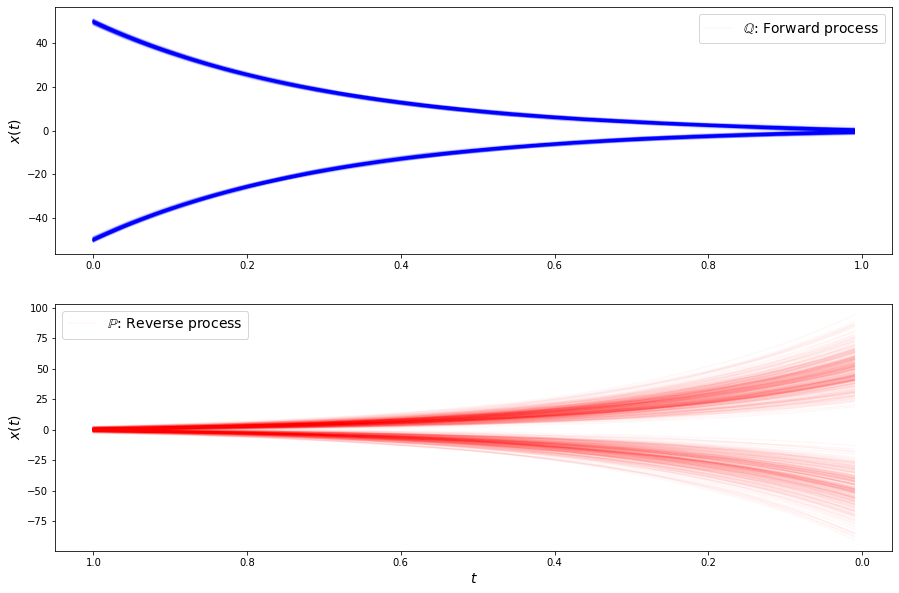

loss b 0.3898873031139374
loss b 0.40570709109306335
loss b 0.4746335744857788
loss b 0.4747570753097534
loss b 0.4765740633010864
loss b 0.44463592767715454
loss b 0.447693794965744
loss b 0.40861257910728455
loss b 0.4798063039779663
loss b 0.4416421949863434
loss b 0.46502551436424255
loss b 0.434210866689682
loss b 0.46413159370422363
loss b 0.5032487511634827
loss b 0.46008291840553284
loss b 0.40719738602638245
loss b 0.4345618486404419
loss b 0.46018078923225403
loss b 0.40418505668640137
loss b 0.379673570394516
loss b 0.43596041202545166
loss b 0.4106002449989319
loss f 3.2659144401550293
loss f 3.294987916946411
loss f 3.2719364166259766
loss f 3.3111398220062256
loss f 3.2729244232177734
loss f 3.236936330795288
loss f 3.2454497814178467
loss f 3.2761173248291016
loss f 3.2521510124206543
loss f 3.288801431655884
loss f 3.2903313636779785
loss f 3.2910680770874023
loss f 3.2835090160369873
loss f 3.287543535232544
loss f 3.2721621990203857
loss f 3.294955015182495
loss f 3.2

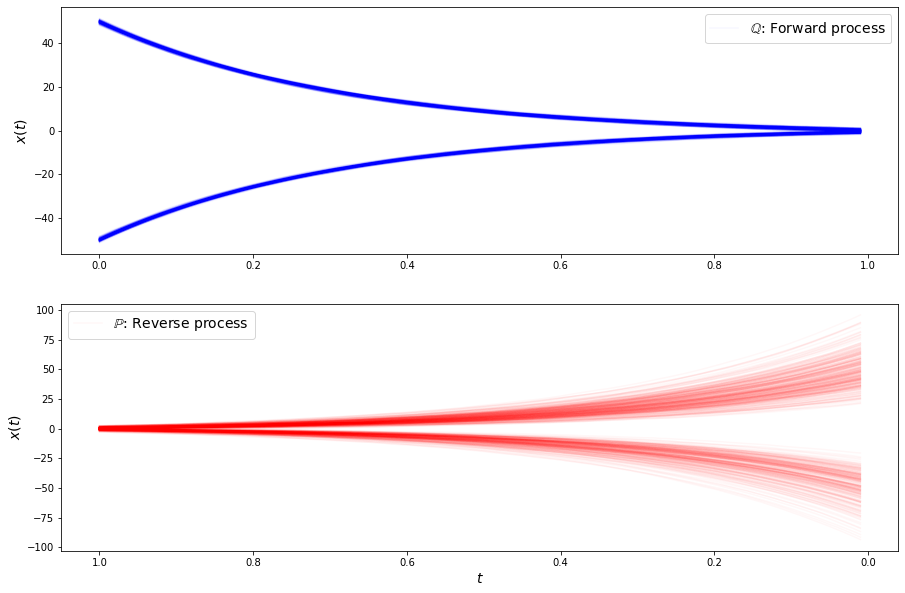

loss b 0.4428993761539459
loss b 0.40661993622779846
loss b 0.437895804643631
loss b 0.437211811542511
loss b 0.4113301932811737
loss b 0.43156537413597107
loss b 0.49140283465385437
loss b 0.4925779402256012
loss b 0.4819980561733246
loss b 0.4819662570953369
loss b 0.42885804176330566
loss b 0.4496036767959595
loss b 0.49910324811935425
loss b 0.4235338866710663
loss b 0.45845726132392883
loss b 0.44161543250083923
loss b 0.5045366287231445
loss b 0.46634912490844727
loss b 0.4891062378883362
loss b 0.4057028889656067
loss b 0.4462573826313019
loss b 0.35686612129211426
loss f 3.2561728954315186
loss f 3.2564609050750732
loss f 3.2970471382141113
loss f 3.266127109527588
loss f 3.265953779220581
loss f 3.276106119155884
loss f 3.2740585803985596
loss f 3.261765956878662
loss f 3.2887814044952393
loss f 3.260159730911255
loss f 3.253206968307495
loss f 3.2618649005889893
loss f 3.2816336154937744
loss f 3.289832353591919
loss f 3.262052059173584
loss f 3.261610507965088
loss f 3.27076

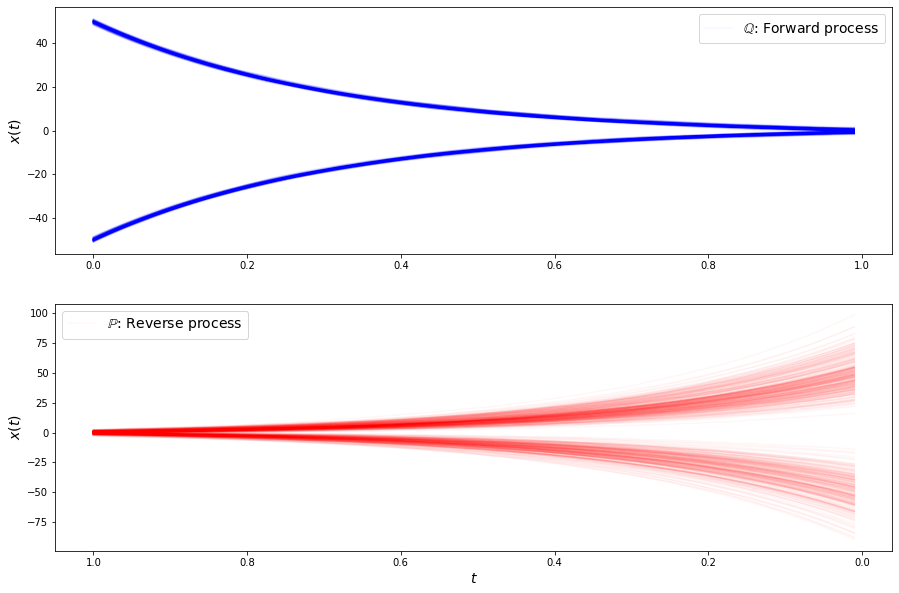

loss b 0.4873010516166687
loss b 0.503914475440979
loss b 0.4394051134586334
loss b 0.4008695185184479
loss b 0.5067687630653381
loss b 0.4540065824985504
loss b 0.425632119178772
loss b 0.4522612988948822
loss b 0.47167688608169556
loss b 0.5220065712928772
loss b 0.4631301164627075
loss b 0.42351698875427246
loss b 0.44722917675971985
loss b 0.4592553377151489
loss b 0.4316856265068054
loss b 0.44121041893959045
loss b 0.44690993428230286
loss b 0.4431666135787964
loss b 0.3775043785572052
loss b 0.4452163875102997
loss b 0.4010820984840393
loss b 0.44666069746017456
loss f 3.280468225479126
loss f 3.2497167587280273
loss f 3.284576177597046
loss f 3.238030195236206
loss f 3.2716164588928223
loss f 3.246396064758301
loss f 3.2636451721191406
loss f 3.2697625160217285
loss f 3.2909371852874756
loss f 3.2591233253479004
loss f 3.237337589263916
loss f 3.251574993133545
loss f 3.273205041885376
loss f 3.2442922592163086
loss f 3.2653539180755615
loss f 3.25016450881958
loss f 3.26481127

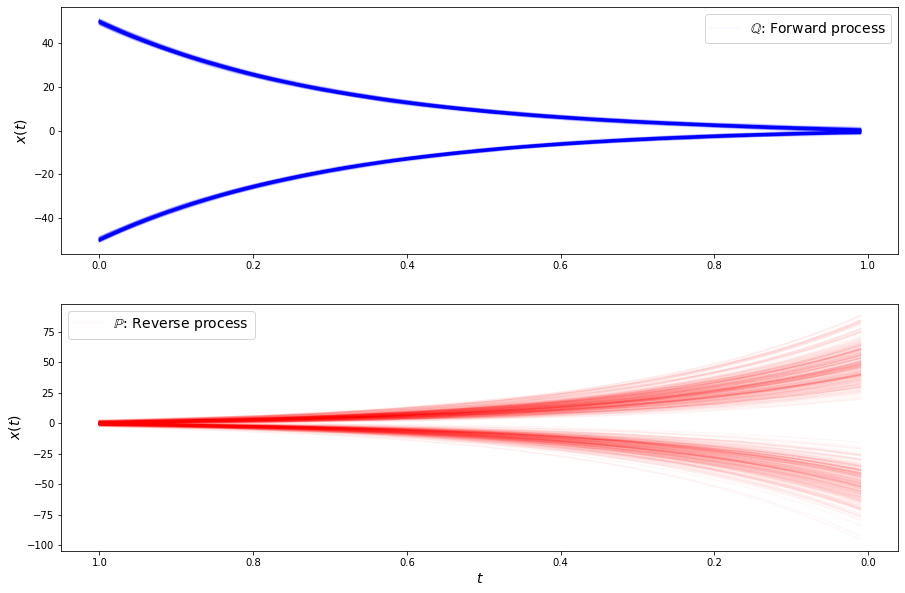

loss b 0.44224876165390015
loss b 0.4869348108768463
loss b 0.41124823689460754
loss b 0.48398736119270325
loss b 0.4394310712814331
loss b 0.45972710847854614
loss b 0.4763560891151428
loss b 0.42947301268577576
loss b 0.4383576214313507
loss b 0.39315277338027954
loss b 0.45602187514305115
loss b 0.4665220379829407
loss b 0.4235037863254547
loss b 0.442063570022583
loss b 0.440522700548172
loss b 0.4542979300022125
loss b 0.504184365272522
loss b 0.4422685503959656
loss b 0.4524011015892029
loss b 0.46069738268852234
loss b 0.4532589018344879
loss b 0.4791349768638611
loss f 3.2951512336730957
loss f 3.2735705375671387
loss f 3.278709650039673
loss f 3.2563774585723877
loss f 3.2755680084228516
loss f 3.262937068939209
loss f 3.262053966522217
loss f 3.263400077819824
loss f 3.279697895050049
loss f 3.2579751014709473
loss f 3.272336483001709
loss f 3.256866931915283
loss f 3.246952533721924
loss f 3.2810747623443604
loss f 3.2619071006774902
loss f 3.2533607482910156
loss f 3.285515

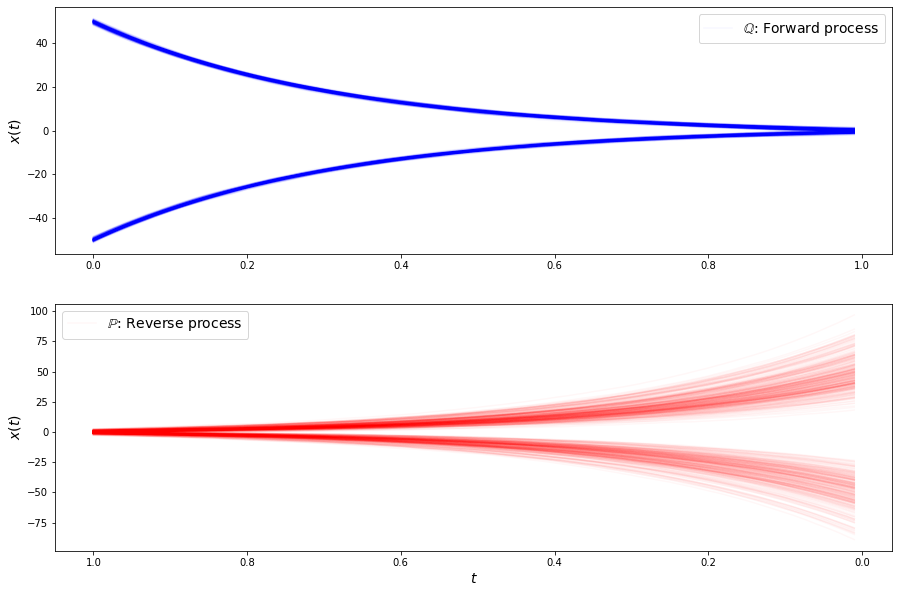

loss b 0.46470993757247925
loss b 0.4386884272098541
loss b 0.4070557951927185
loss b 0.40257903933525085
loss b 0.47741326689720154
loss b 0.41614970564842224
loss b 0.4518330693244934
loss b 0.432522177696228
loss b 0.49348530173301697
loss b 0.41695699095726013
loss b 0.39035266637802124
loss b 0.4821397066116333
loss b 0.4456992447376251
loss b 0.47499382495880127
loss b 0.4073846638202667
loss b 0.4359796345233917
loss b 0.48954907059669495
loss b 0.46403586864471436
loss b 0.4324374198913574
loss b 0.4885788559913635
loss b 0.42859888076782227
loss b 0.46913155913352966
loss f 3.2634971141815186
loss f 3.2812376022338867
loss f 3.297179937362671
loss f 3.2742483615875244
loss f 3.279454469680786
loss f 3.300330400466919
loss f 3.2784204483032227
loss f 3.3087046146392822
loss f 3.320600748062134
loss f 3.2515225410461426
loss f 3.272089958190918
loss f 3.296196937561035
loss f 3.2535531520843506
loss f 3.3105897903442383
loss f 3.2859907150268555
loss f 3.272371530532837
loss f 3

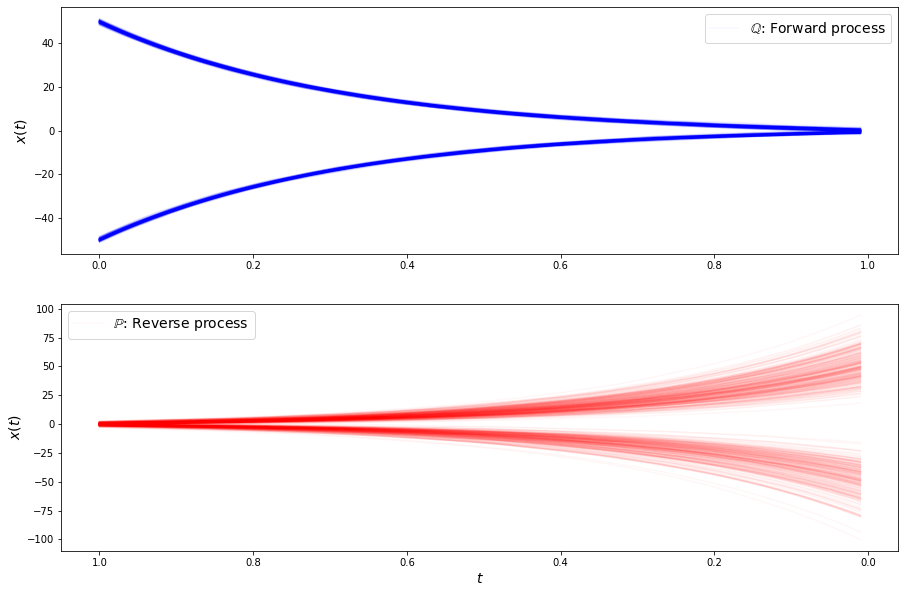

loss b 0.4439295530319214
loss b 0.4018283188343048
loss b 0.41101962327957153
loss b 0.4873448610305786
loss b 0.4287892282009125
loss b 0.446569561958313
loss b 0.39213162660598755
loss b 0.4938112497329712
loss b 0.4392580986022949
loss b 0.4825661778450012
loss b 0.481139600276947
loss b 0.4694197475910187
loss b 0.4908217489719391
loss b 0.3894946873188019
loss b 0.5072673559188843
loss b 0.40025076270103455
loss b 0.38347262144088745
loss b 0.46384042501449585
loss b 0.5065609812736511
loss b 0.38566261529922485
loss b 0.4581315517425537
loss b 0.47738027572631836
loss f 3.2947452068328857
loss f 3.2917613983154297
loss f 3.298668146133423
loss f 3.2748594284057617
loss f 3.2996010780334473
loss f 3.2361395359039307
loss f 3.2604246139526367
loss f 3.27858304977417
loss f 3.247668981552124
loss f 3.2717413902282715
loss f 3.280730962753296
loss f 3.2837345600128174
loss f 3.2787437438964844
loss f 3.2671315670013428
loss f 3.2437870502471924
loss f 3.280395746231079
loss f 3.2764

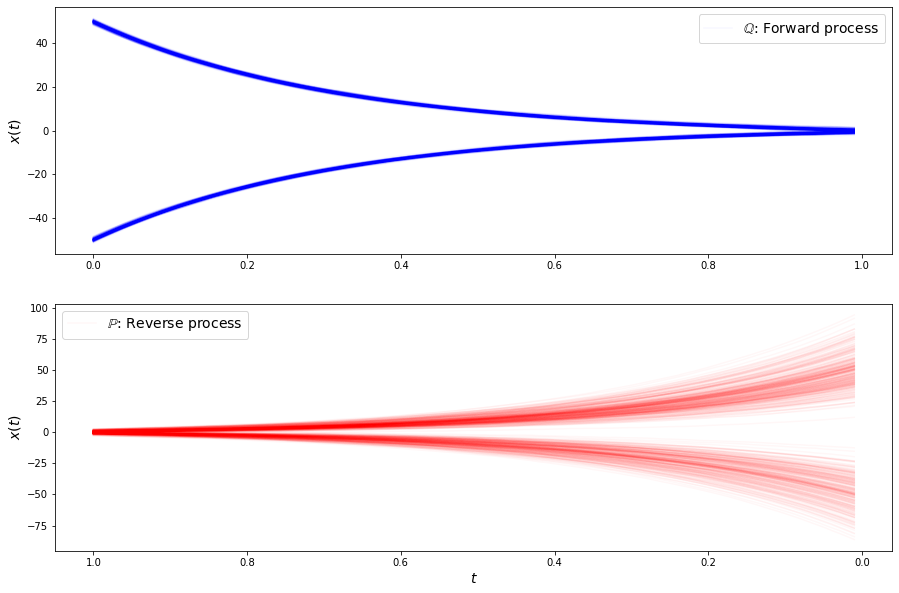

loss b 0.521833598613739
loss b 0.45141172409057617
loss b 0.4666961431503296
loss b 0.4106782376766205
loss b 0.4595505893230438
loss b 0.48354604840278625
loss b 0.4211657643318176
loss b 0.41611069440841675
loss b 0.4839354455471039
loss b 0.39471063017845154
loss b 0.5243866443634033
loss b 0.46978405117988586
loss b 0.41344383358955383
loss b 0.4225046634674072
loss b 0.4689174294471741
loss b 0.42856359481811523
loss b 0.41159486770629883
loss b 0.5157702565193176
loss b 0.5115728974342346
loss b 0.49729904532432556
loss b 0.38530105352401733
loss b 0.4091678261756897
loss f 3.249892234802246
loss f 3.261371612548828
loss f 3.268868923187256
loss f 3.2577507495880127
loss f 3.283761978149414
loss f 3.2998576164245605
loss f 3.268359422683716
loss f 3.2634353637695312
loss f 3.2325730323791504
loss f 3.252514600753784
loss f 3.276426076889038
loss f 3.2798914909362793
loss f 3.2685351371765137
loss f 3.2883641719818115
loss f 3.272801399230957
loss f 3.26837158203125
loss f 3.2776

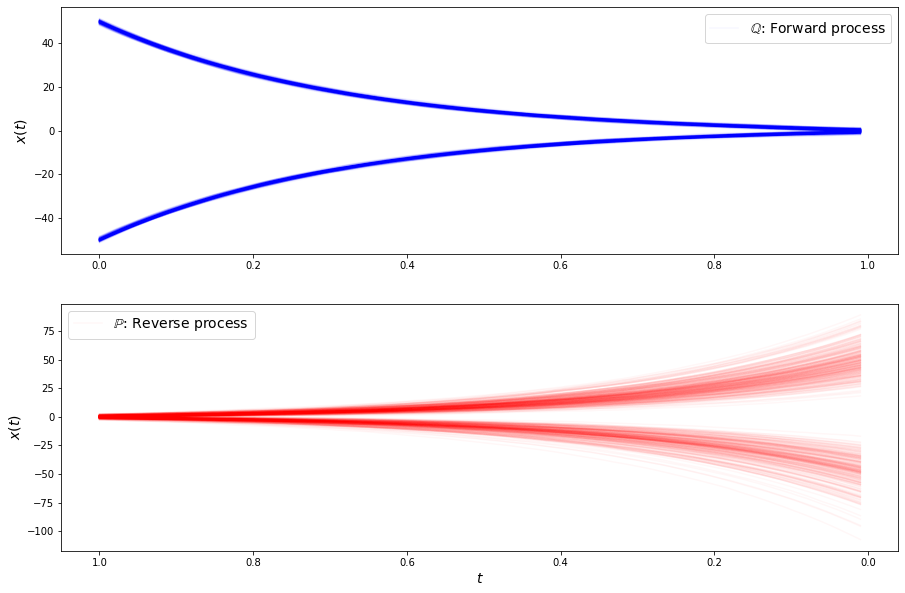

loss b 0.5007320642471313
loss b 0.42580026388168335
loss b 0.4045758843421936
loss b 0.40100938081741333
loss b 0.4022275507450104
loss b 0.4492170214653015
loss b 0.5319708585739136
loss b 0.5040236711502075
loss b 0.48135673999786377
loss b 0.44404536485671997
loss b 0.46359550952911377
loss b 0.4385393559932709
loss b 0.45807549357414246
loss b 0.38159987330436707
loss b 0.416436105966568
loss b 0.46927911043167114
loss b 0.40126216411590576
loss b 0.4332142472267151
loss b 0.40765607357025146
loss b 0.4971488118171692
loss b 0.3911275863647461
loss b 0.42552876472473145
loss f 3.2671496868133545
loss f 3.291823148727417
loss f 3.2556540966033936
loss f 3.2597732543945312
loss f 3.2710249423980713
loss f 3.254981517791748
loss f 3.259988784790039
loss f 3.2764649391174316
loss f 3.280764102935791
loss f 3.2433464527130127
loss f 3.2718265056610107
loss f 3.253561019897461
loss f 3.2719573974609375
loss f 3.2614641189575195
loss f 3.267040491104126
loss f 3.2409238815307617
loss f 3

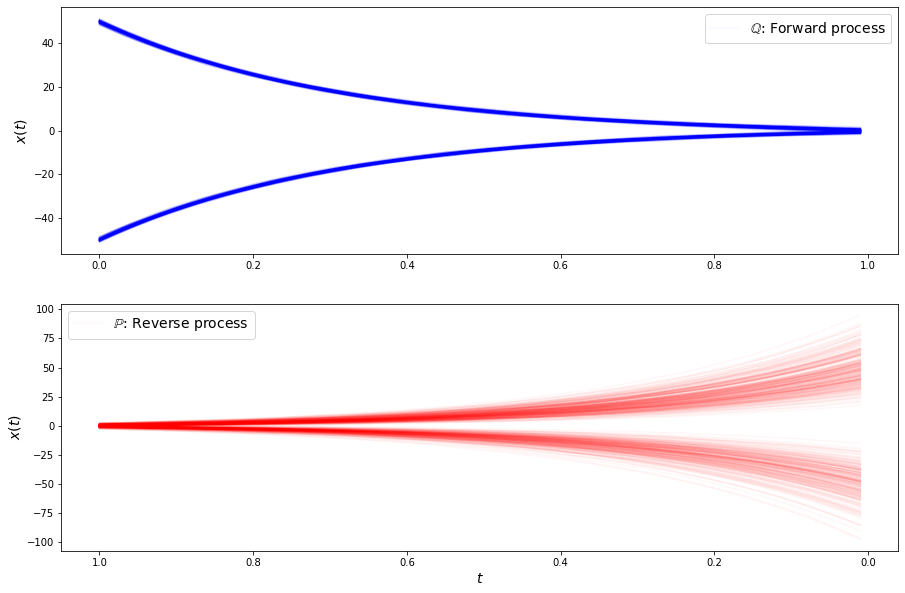

loss b 0.44677451252937317
loss b 0.4692460596561432
loss b 0.34027382731437683
loss b 0.4484991729259491
loss b 0.4453580677509308
loss b 0.49168288707733154
loss b 0.49816951155662537
loss b 0.4846336543560028
loss b 0.4802123010158539
loss b 0.5061990022659302
loss b 0.42199447751045227
loss b 0.5247803926467896
loss b 0.3672577142715454
loss b 0.41960409283638
loss b 0.48090261220932007
loss b 0.4632045328617096
loss b 0.44103360176086426
loss b 0.4264317452907562
loss b 0.45538580417633057
loss b 0.4877649247646332
loss b 0.4507105350494385
loss b 0.3827078640460968
loss f 3.26906156539917
loss f 3.2558634281158447
loss f 3.267956018447876
loss f 3.248049020767212
loss f 3.308159589767456
loss f 3.2739291191101074
loss f 3.3040599822998047
loss f 3.2449989318847656
loss f 3.2687788009643555
loss f 3.278376340866089
loss f 3.2750282287597656
loss f 3.2719085216522217
loss f 3.274585485458374
loss f 3.2721993923187256
loss f 3.2388200759887695
loss f 3.2712323665618896
loss f 3.2536

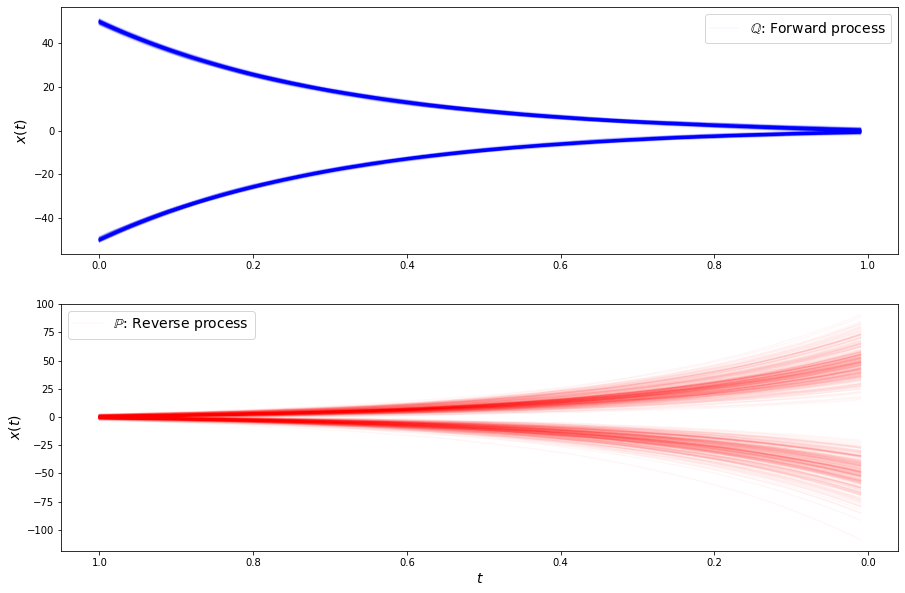

loss b 0.4348889887332916
loss b 0.3494093716144562
loss b 0.4261486530303955
loss b 0.4252336919307709
loss b 0.5141372680664062
loss b 0.44228625297546387
loss b 0.4267701804637909
loss b 0.4728713035583496
loss b 0.39348506927490234
loss b 0.4846974313259125
loss b 0.4509311318397522
loss b 0.40860769152641296
loss b 0.43926236033439636
loss b 0.47658979892730713
loss b 0.43321681022644043
loss b 0.4619349241256714
loss b 0.45433056354522705
loss b 0.4598523676395416
loss b 0.4782470762729645
loss b 0.48085924983024597
loss b 0.38664883375167847
loss b 0.503035306930542
loss f 3.276784658432007
loss f 3.2725820541381836
loss f 3.274614095687866
loss f 3.272339105606079
loss f 3.275160074234009
loss f 3.2724485397338867
loss f 3.245699167251587
loss f 3.269439220428467
loss f 3.2684929370880127
loss f 3.25030255317688
loss f 3.241560697555542
loss f 3.2950356006622314
loss f 3.246898889541626
loss f 3.2765209674835205
loss f 3.288470506668091
loss f 3.266714334487915
loss f 3.2449812

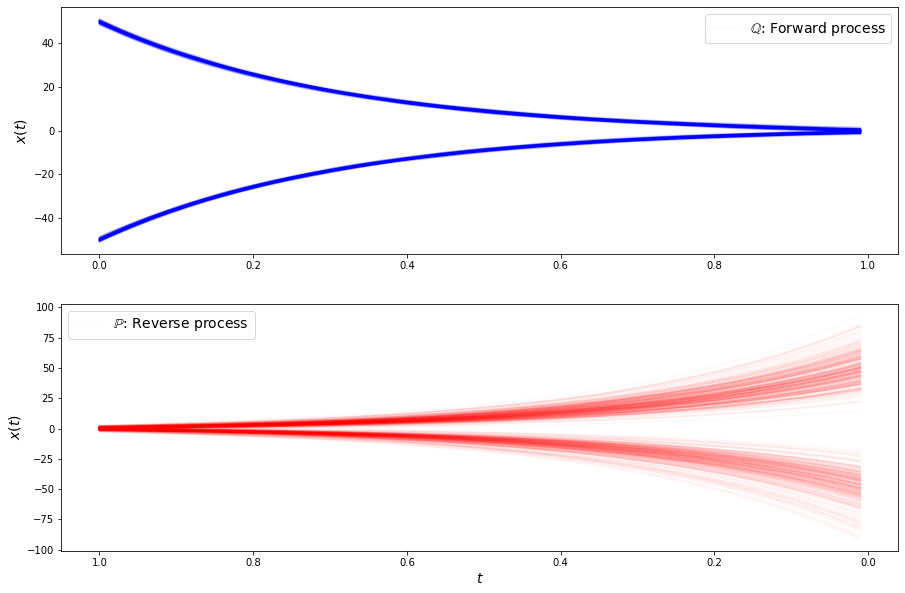

loss b 0.4798884689807892
loss b 0.49001583456993103
loss b 0.398456871509552
loss b 0.44438931345939636
loss b 0.48213502764701843
loss b 0.47939369082450867
loss b 0.3927350640296936
loss b 0.4475514888763428
loss b 0.4884527623653412
loss b 0.5160291790962219
loss b 0.4460972547531128
loss b 0.46438711881637573
loss b 0.4489789307117462
loss b 0.48841115832328796
loss b 0.4318423271179199
loss b 0.3989883065223694
loss b 0.426045298576355
loss b 0.46966075897216797
loss b 0.3992661237716675
loss b 0.40297675132751465
loss b 0.4459483027458191
loss b 0.45733487606048584
loss f 3.268808603286743
loss f 3.263902425765991
loss f 3.2698376178741455
loss f 3.2649025917053223
loss f 3.2674334049224854
loss f 3.2580459117889404
loss f 3.250134229660034
loss f 3.247310161590576
loss f 3.27288818359375
loss f 3.270700693130493
loss f 3.286649465560913
loss f 3.262640953063965
loss f 3.268968343734741
loss f 3.2450780868530273
loss f 3.2806944847106934
loss f 3.2824501991271973
loss f 3.292507

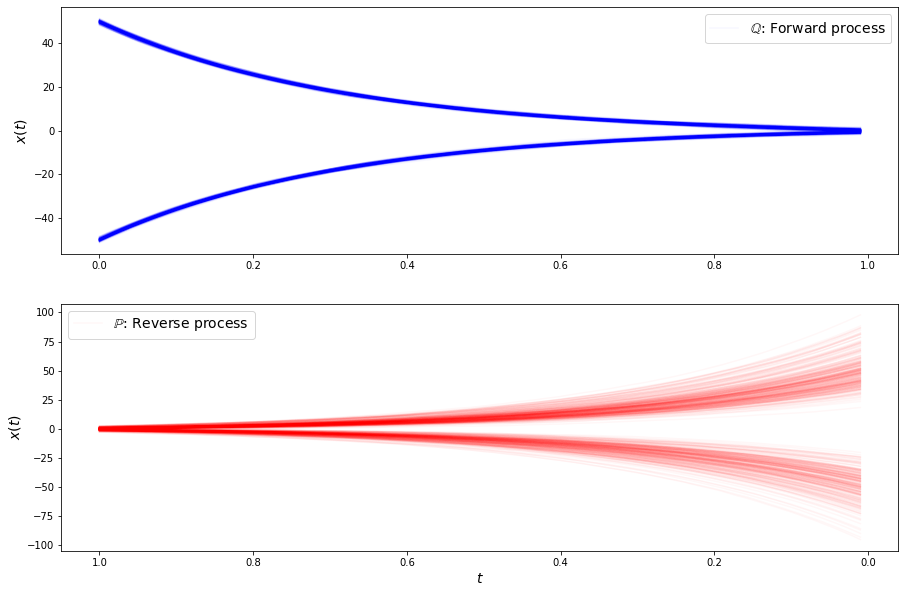

loss b 0.4432297945022583
loss b 0.4195103347301483
loss b 0.47246605157852173
loss b 0.467103511095047
loss b 0.4467426836490631
loss b 0.5125071406364441
loss b 0.4967353045940399
loss b 0.4556121826171875
loss b 0.3784504234790802
loss b 0.4606510102748871
loss b 0.49547573924064636
loss b 0.48481112718582153
loss b 0.39696407318115234
loss b 0.4923056960105896
loss b 0.42994314432144165
loss b 0.4375685751438141
loss b 0.3859333097934723
loss b 0.34493744373321533
loss b 0.3959285616874695
loss b 0.35807880759239197
loss b 0.3631218671798706
loss b 0.4506402015686035
loss f 3.252234697341919
loss f 3.252392530441284
loss f 3.3189330101013184
loss f 3.2493200302124023
loss f 3.258384943008423
loss f 3.2406015396118164
loss f 3.2303555011749268
loss f 3.2678582668304443
loss f 3.2552032470703125
loss f 3.3070504665374756
loss f 3.2604012489318848
loss f 3.2464070320129395
loss f 3.2679405212402344
loss f 3.258164405822754
loss f 3.2780213356018066
loss f 3.2529959678649902
loss f 3.2

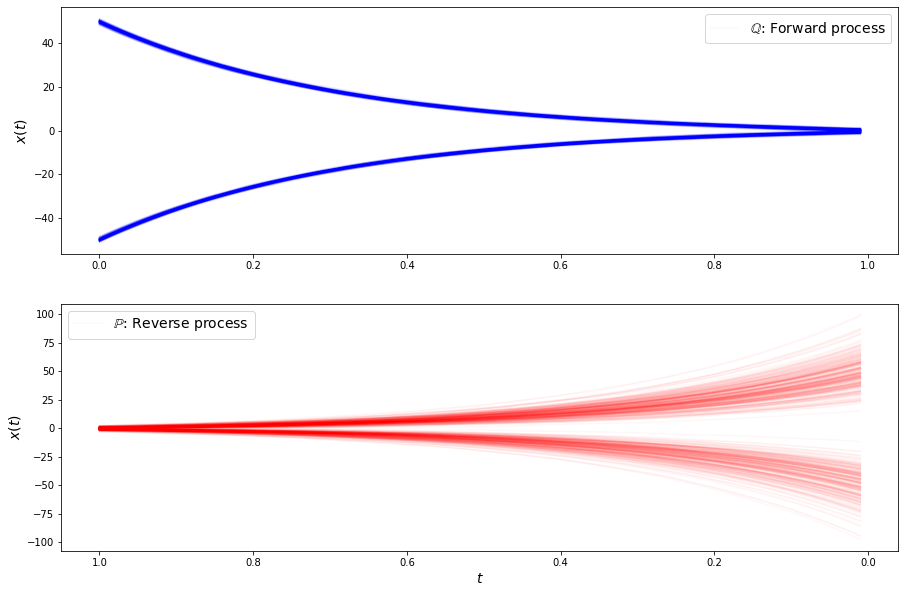

loss b 0.5000225901603699
loss b 0.48967429995536804
loss b 0.5061670541763306
loss b 0.38519778847694397
loss b 0.4068726897239685
loss b 0.4496554434299469
loss b 0.5387274026870728
loss b 0.4274553656578064
loss b 0.4539727568626404
loss b 0.47102415561676025
loss b 0.4268551766872406
loss b 0.46563443541526794
loss b 0.45798805356025696
loss b 0.4317556917667389
loss b 0.45833486318588257
loss b 0.3812177777290344
loss b 0.42079800367355347
loss b 0.45723578333854675
loss b 0.43998217582702637
loss b 0.4512035548686981
loss b 0.39320507645606995
loss b 0.36352744698524475
loss f 3.293393135070801
loss f 3.2636473178863525
loss f 3.227989673614502
loss f 3.264615297317505
loss f 3.2605509757995605
loss f 3.2681145668029785
loss f 3.2569808959960938
loss f 3.2660937309265137
loss f 3.268908977508545
loss f 3.2309141159057617
loss f 3.2433080673217773
loss f 3.262089967727661
loss f 3.2994635105133057
loss f 3.256000280380249
loss f 3.26352596282959
loss f 3.258338451385498
loss f 3.2

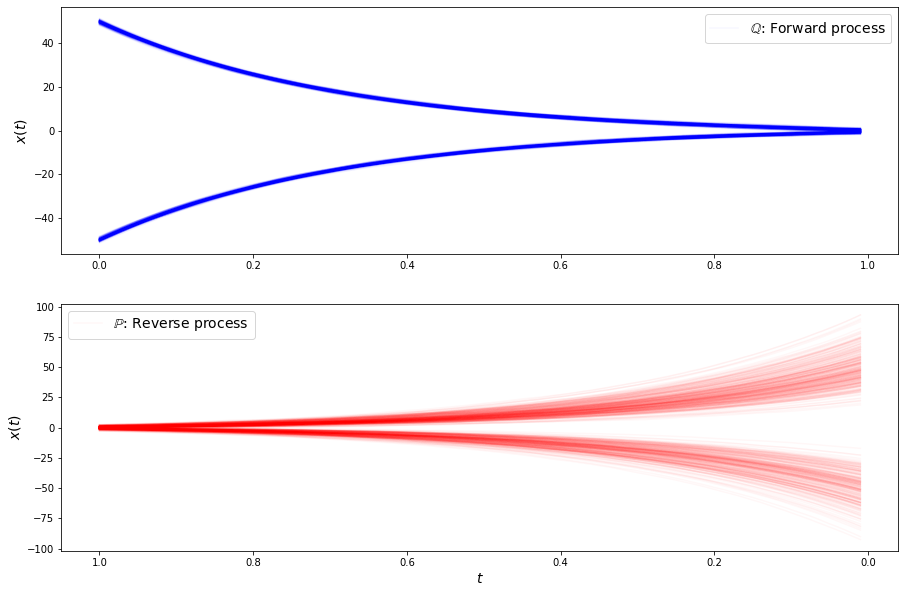

loss b 0.45880305767059326
loss b 0.4044027626514435
loss b 0.43386098742485046
loss b 0.430990993976593
loss b 0.4297008216381073
loss b 0.43081143498420715
loss b 0.43352192640304565
loss b 0.44222530722618103
loss b 0.4553444981575012
loss b 0.4286019504070282
loss b 0.44217580556869507
loss b 0.459915429353714
loss b 0.46187344193458557
loss b 0.4750756621360779
loss b 0.41684815287590027
loss b 0.458797812461853
loss b 0.43086954951286316
loss b 0.4625917375087738
loss b 0.45720648765563965
loss b 0.4862399995326996
loss b 0.4511508643627167
loss b 0.41213148832321167
loss f 3.2684326171875
loss f 3.256305456161499
loss f 3.2499451637268066
loss f 3.258181571960449
loss f 3.2477190494537354
loss f 3.267744302749634
loss f 3.2521982192993164
loss f 3.258331537246704
loss f 3.2508857250213623
loss f 3.263216018676758
loss f 3.28182053565979
loss f 3.2713539600372314
loss f 3.2841339111328125
loss f 3.2608768939971924
loss f 3.2493159770965576
loss f 3.2552249431610107
loss f 3.26721

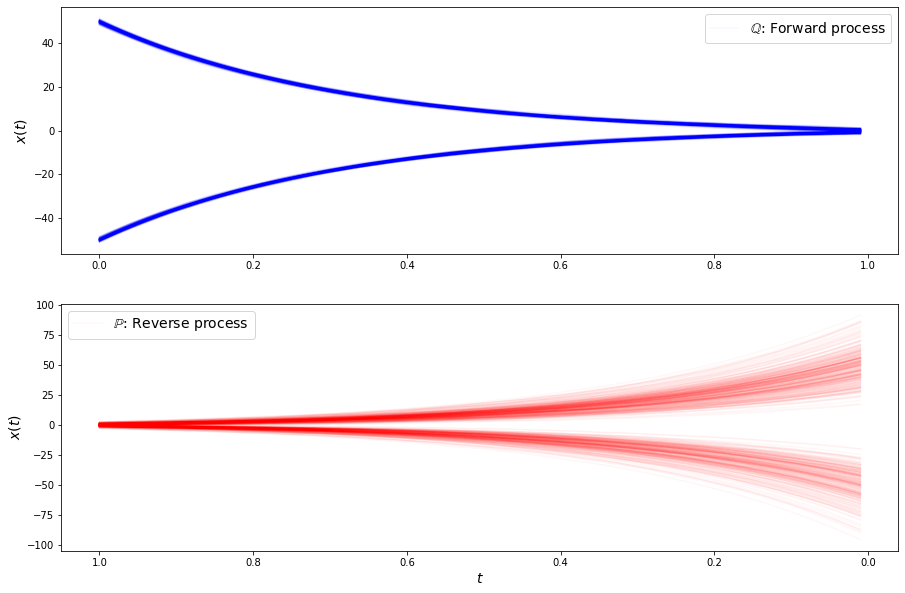

loss b 0.4895632266998291
loss b 0.40234023332595825
loss b 0.470299631357193
loss b 0.4252280294895172
loss b 0.4416044056415558
loss b 0.44766250252723694
loss b 0.47283098101615906
loss b 0.40821748971939087
loss b 0.38100671768188477
loss b 0.49413686990737915
loss b 0.39591512084007263
loss b 0.40740126371383667
loss b 0.41402092576026917
loss b 0.4424888789653778
loss b 0.3905336856842041
loss b 0.49167099595069885
loss b 0.44372209906578064
loss b 0.4185687005519867
loss b 0.42938852310180664
loss b 0.4961014986038208
loss b 0.4094961881637573
loss b 0.45283788442611694
loss f 3.249659538269043
loss f 3.255821466445923
loss f 3.246901035308838
loss f 3.269617795944214
loss f 3.2717058658599854
loss f 3.287245512008667
loss f 3.2781691551208496
loss f 3.2824575901031494
loss f 3.2830421924591064
loss f 3.2474024295806885
loss f 3.2666563987731934
loss f 3.312224864959717
loss f 3.281341314315796
loss f 3.2733962535858154
loss f 3.3150839805603027
loss f 3.2415473461151123
loss f 

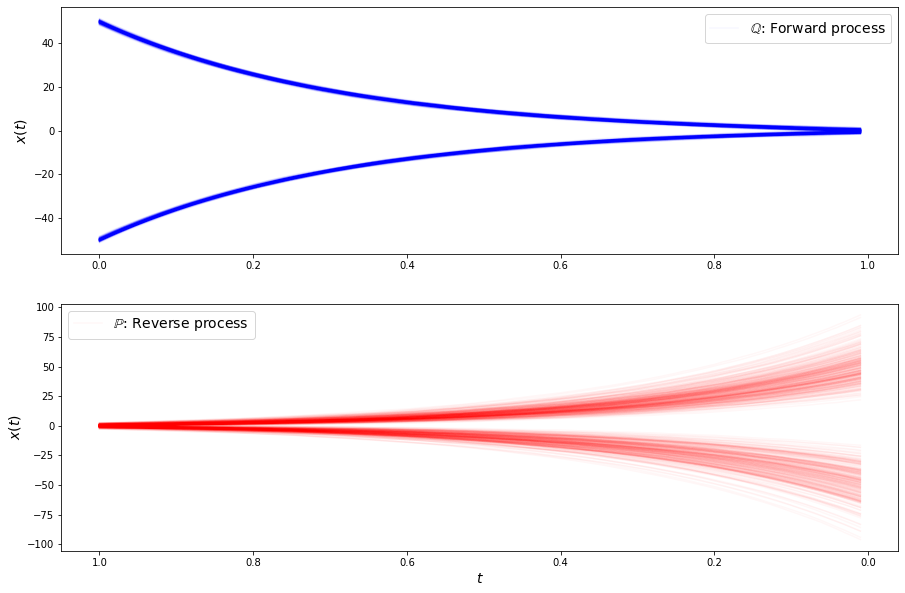

loss b 0.3579070568084717
loss b 0.4402049779891968
loss b 0.4435916244983673
loss b 0.45405665040016174
loss b 0.4216286838054657
loss b 0.4301804304122925
loss b 0.4158613681793213
loss b 0.4656408727169037
loss b 0.3907468914985657
loss b 0.4765348732471466
loss b 0.4461764395236969
loss b 0.4356948137283325


In [ ]:
c.fit(1900, 22, plot=True)

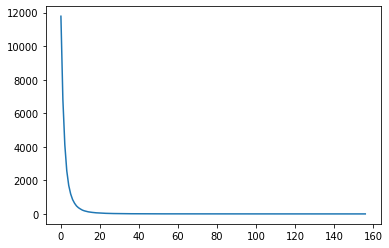

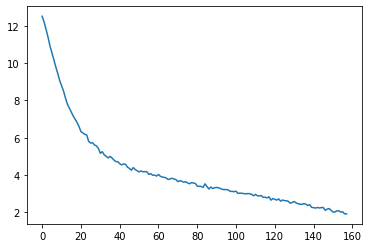

In [15]:
plt.plot(c.loss_f)
plt.show()
plt.plot(c.loss_b)

In [12]:
bb = lambda X, theta: -c.b_backward(X, theta)
t, Xts = c.sde_solver(X0=X1,dt=c.dt,  theta=c.theta_f,  beta=c.sigma, alfa=c.b_forward, N=c.number_time_steps)
t_, Xts_ = c.sde_solver(X0=X2, dt=c.dt,  theta=c.theta_b,  beta=c.sigma, alfa=bb, N=c.number_time_steps)

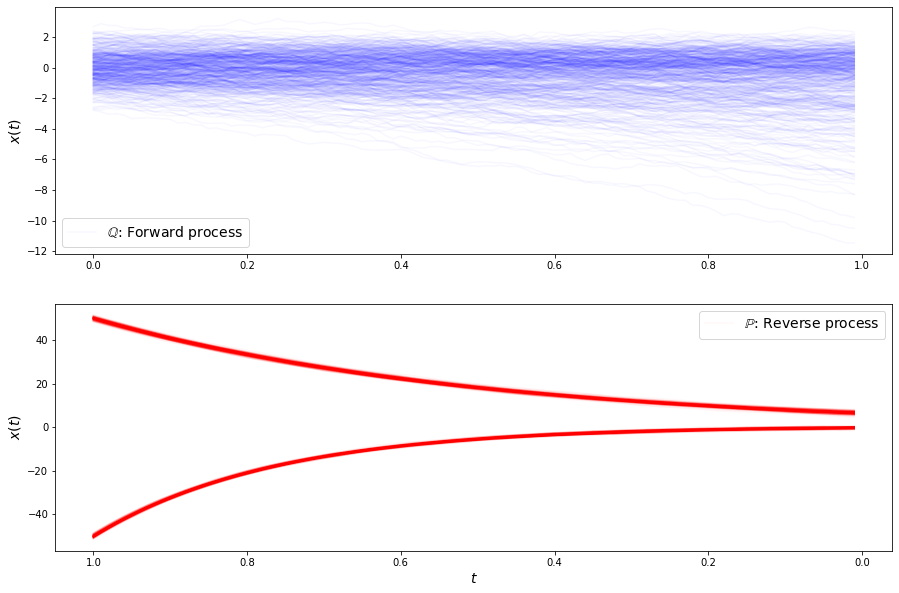

In [13]:
fn = 14
fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
axs[1].set_xlabel("$t$", fontsize=fn)
axs[1].set_ylabel("$x(t)$", fontsize=fn)
axs[0].set_ylabel("$x(t)$", fontsize=fn)

tt = axs[1].get_xticks()
axs[1].set_xticks(tt.flatten() )
axs[1].set_xticklabels(list(map (lambda x: '{0:.1f}'.format((x)), tt))[::-1])

for i in range(n):
    label = "$\mathbb{Q}$: Forward process" if i == 0 else None
    axs[0].plot(t.flatten(), Xts[i,...].flatten(), 'b', alpha=0.03,  label=label)


for i in range(n):
    label = "$\mathbb{P}$: Reverse process" if i == 0 else None
    axs[1].plot(t_.flatten(), Xts_[i,...].flatten(), 'r', alpha=0.03, label=label)
    
axs[1].legend(fontsize=fn)
axs[0].legend(fontsize=fn)

plt.savefig("pig_0")

In [38]:
list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1]

['0.00', '0.20', '0.40', '0.60', '0.80', '1.00']

In [ ]:
batch_terminal_empirical_f = next(c.data_stream(forward=True))

In [ ]:
xx = np.linspace(-10, 10).reshape(-1,1)

kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_f, c.H_0))
plt.plot(xx, kd)
plt.plot(batch_terminal_empirical_f , [0] * len(batch_terminal_empirical_f), ".")

In [ ]:
batch_terminal_empirical_b = next(c.data_stream(False))

In [ ]:
xx = np.linspace(-10, 10).reshape(-1,1)

kd_b  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_b, c.H_1))
plt.plot(xx, kd_b)
plt.plot(batch_terminal_empirical_b , [0] * len(batch_terminal_empirical_b), ".")

In [ ]:
    def plot_trajectories(self):
        bb = lambda X, theta: -self.b_backward(X, theta)
        t, Xts = c.sde_solver(
            X0=self.X1,dt=self.dt,  theta=self.theta_f,
            beta=self.sigma, alfa=self.b_forward, N=self.number_time_steps
        )
        t_, Xts_ = c.sde_solver(
            X0=self.X2, dt=self.dt,  theta=self.theta_b,
            beta=self.sigma, alfa=bb, N=self.number_time_steps
        )
        
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

        tt = axs[1].get_xticks()
        axs[1].set_xticks(tt.flatten() )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.1f}'.format((x)), tt))[::-1])

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.flatten(), Xts[i,...].flatten(), 'b', alpha=0.03,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.flatten(), Xts_[i,...].flatten(), 'r', alpha=0.03, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)

        plt.show()    